In [146]:
function spike(t,a,e,tcrit)
   return 1.0/(((t-tcrit)^2.0+1)^(e))*a
end
function detect(t,a,e,tcrit)
   y = spike(t,a,e,tcrit) 
   return y
end

SPEC = [
    [1.0,50.0,0.8],
    [0.1,500.0,0.25],
    [0.1,8000.0,0.05],
    [1.0,8000.0,0.4],
    [1.0,8000.0,0.6]
]
function eval_func(t,is_x)
    result = 0.0
    for row in SPEC
        ampl,expo,tcrit = row
        if is_x
            value = spike(t,ampl,expo,tcrit)
        else
            value = detect(t,ampl,expo,tcrit)
        end
        result += value
    end
    return result
end


eval_func (generic function with 1 method)

In [147]:
using DifferentialEquations

In [166]:
function model(du,u,p,t)
  y,x = u 
  sig = eval_func(t,true)
  a1,b1,c1,a2,b2,c2,d,e,f = p
  du[3] = dx = a1*sig - b1*x - c1*x*y
  du[2] = dy = a2*sig - b2*y - c2*x*y
  du[1] = dz = d*x + e*y - f*z
end

model (generic function with 1 method)

In [163]:
using Flux, DiffEqFlux


In [164]:
using Plots

In [173]:
parvals = [10.0,0.001,0.001,10.0,0.001,0.001,1.0,1.0,0.1]
x0 = [0.0,0.0,0.0]
pars = param(parvals)
tspan = (0.0,1.0)
prob = ODEProblem(model,x0,tspan,parvals)
datasize = 1000
sol = solve(prob,Tsit5())
t = range(tspan[1],tspan[2],length=datasize)
display(size(t))
params = Flux.Params([pars])

function predict_rd() # Our 1-layer neural network
  sln = diffeq_rd(pars,prob,Tsit5(),saveat=t)
  Tracker.collect(sln[1,:])
end

function loss_rd() # Our 1-layer neural network
    pred = predict_rd()
    loss = 0.0
    for (i,px) in enumerate(pred)
        ox = eval_func(t[i],false)
        loss += abs(ox-px)
    end
    return loss
end

(1000,)

loss_rd (generic function with 1 method)

178.11941366727018 (tracked)

Tracked 9-element Array{Float64,1}:
 10.0               
  0.001             
  0.001             
 17.039310352079674 
  2.7197047636416745
 10.601379739948703 
  5.451464724705955 
 -9.16260261686442  
  0.1               

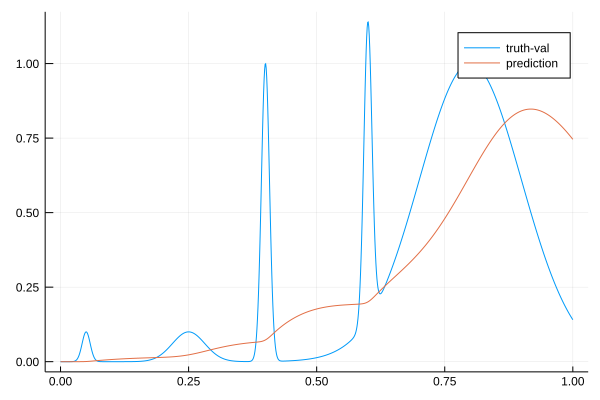

177.58609034234968 (tracked)

Tracked 9-element Array{Float64,1}:
 10.0               
  0.001             
  0.001             
 17.139310347711504 
  2.6197047700832563
 10.70137973938444  
  5.551464723138802 
 -9.262602616116771 
  0.1               

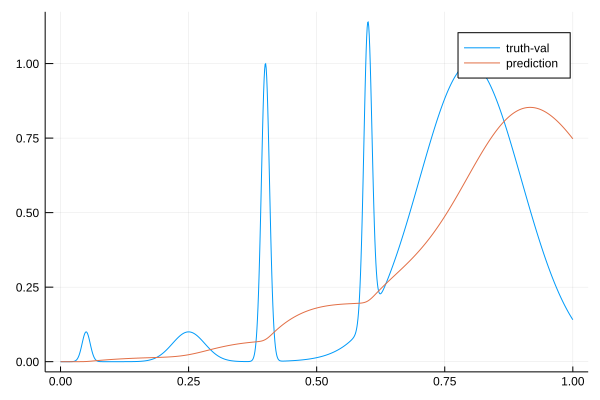

177.81918660139468 (tracked)

Tracked 9-element Array{Float64,1}:
 10.0               
  0.001             
  0.001             
 17.22658355396766  
  2.5345077933035376
 10.80147931153262  
  5.638858073707155 
 -9.362731273395205 
  0.1               

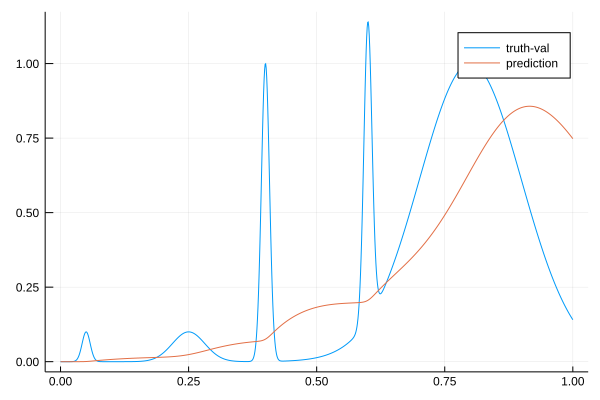

177.4773097648587 (tracked)

Tracked 9-element Array{Float64,1}:
 10.0               
  0.001             
  0.001             
 17.308039727935594 
  2.4508959994449016
 10.901606147435217 
  5.719813075075524 
 -9.463003797153664 
  0.1               

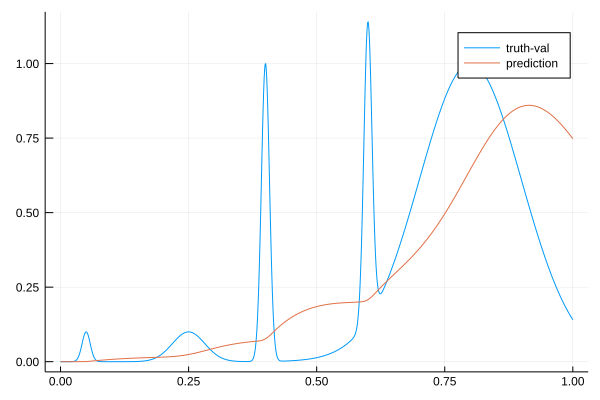

176.5999610155613 (tracked)

Tracked 9-element Array{Float64,1}:
 10.0               
  0.001             
  0.001             
 17.360663278538652 
  2.3994792771533238
 11.001848530745713 
  5.7726075912980575
 -9.56356768451794  
  0.1               

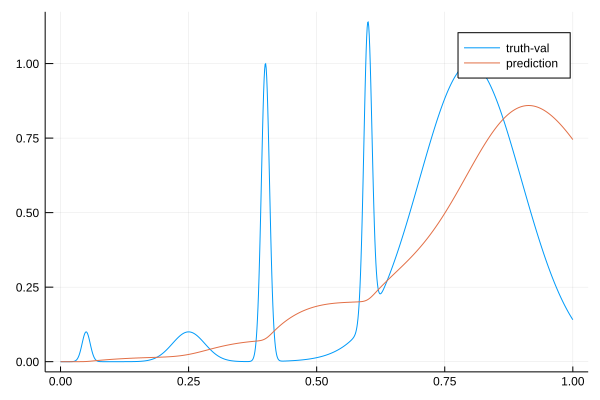

176.29605490016692 (tracked)

Tracked 9-element Array{Float64,1}:
 10.0               
  0.001             
  0.001             
 17.39503678455851  
  2.3776988362683036
 11.10209168758413  
  5.8085458781695625
 -9.664308970135513 
  0.1               

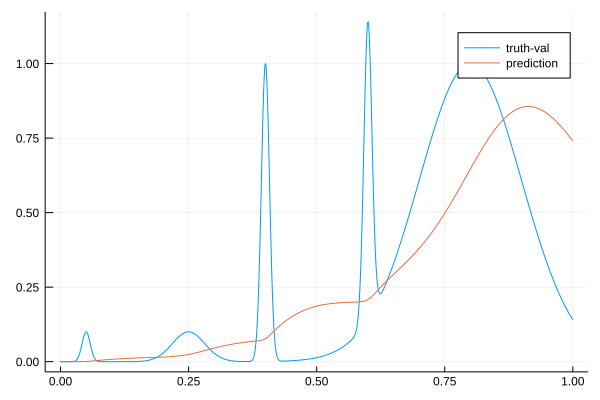

175.59090700678027 (tracked)

Tracked 9-element Array{Float64,1}:
 10.0               
  0.001             
  0.001             
 17.417275700165522 
  2.3761211899574115
 11.202260433683412 
  5.833436135983707 
 -9.765116986636937 
  0.1               

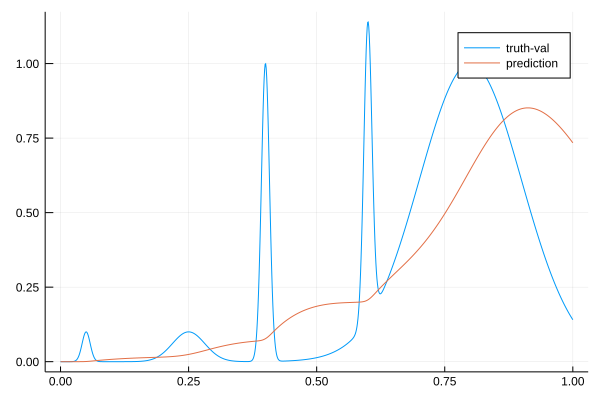

175.30528875836265 (tracked)

Tracked 9-element Array{Float64,1}:
 10.0               
  0.001             
  0.001             
 17.451280789169697 
  2.3766327234845295
 11.302134163250761 
  5.870785085778372 
 -9.865558914193235 
  0.1               

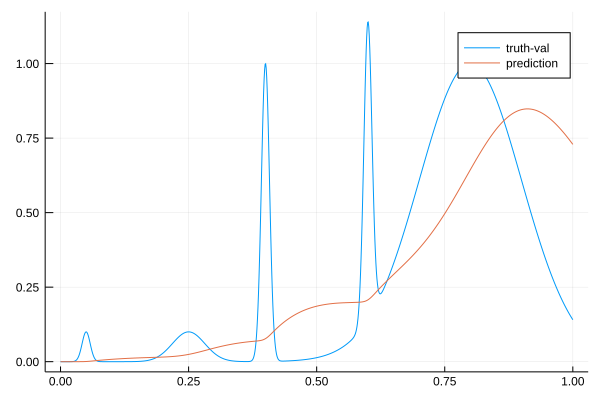

175.18570116710654 (tracked)

Tracked 9-element Array{Float64,1}:
 10.0               
  0.001             
  0.001             
 17.495439128831553 
  2.3785567480103325
 11.401708530810728 
  5.918573325952294 
 -9.965663075493831 
  0.1               

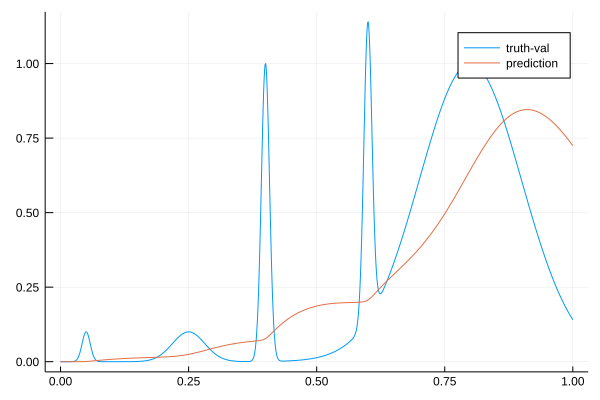

174.76218363196085 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  17.54342329137301  
   2.3846439430510187
  11.5009654828466   
   5.970452861608251 
 -10.065548793060502 
   0.1               

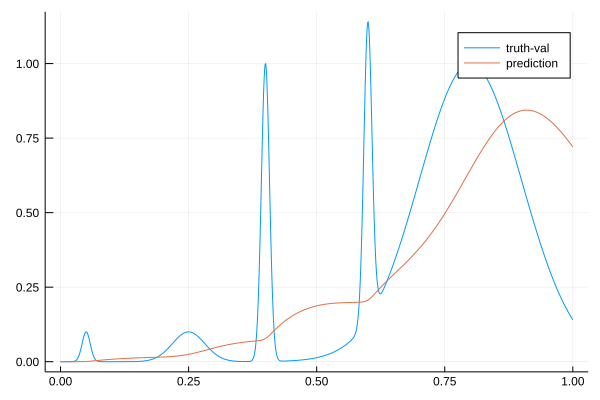

174.47200987320127 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  17.596256810976783 
   2.3944047375185495
  11.599882370473845 
   6.027311470600668 
 -10.16518695870493  
   0.1               

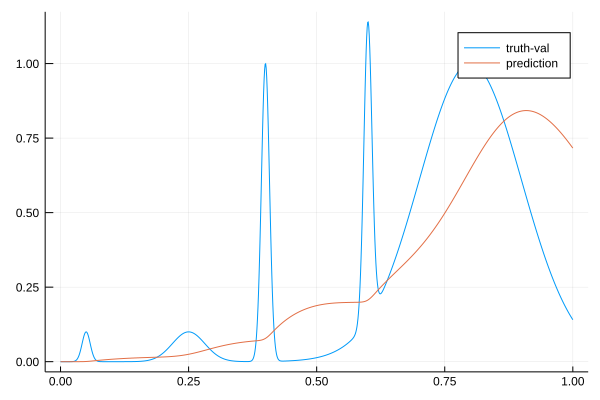

174.10999034660327 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  17.654202059166987
   2.407362205861475
  11.698448922239903
   6.089263724584932
 -10.264572057534545
   0.1              

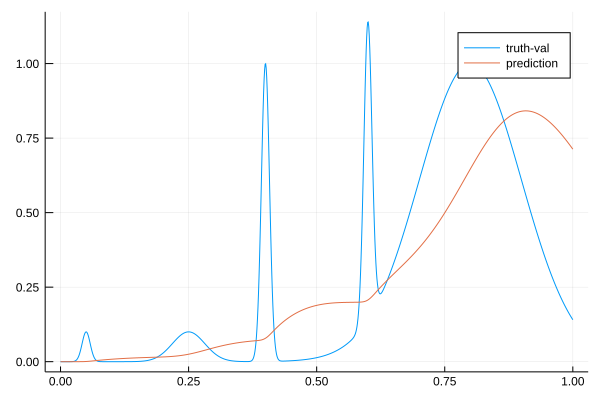

173.7435793917164 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  17.71715311498307 
   2.423769351061881
  11.796645982354775
   6.15611566348856 
 -10.36370150639929 
   0.1              

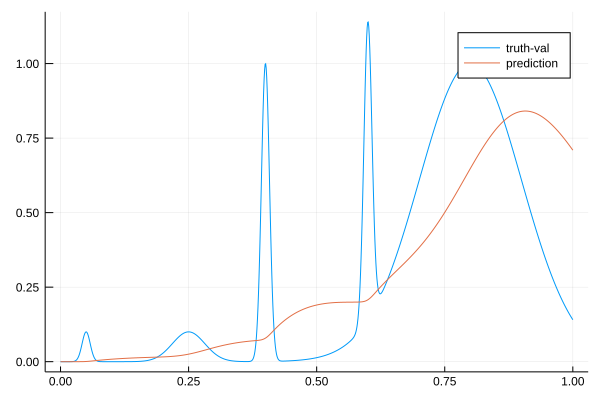

173.3920903357322 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  17.78302389940782  
   2.4490259859311543
  11.894487525184786 
   6.226111232149927 
 -10.462664592153004 
   0.1               

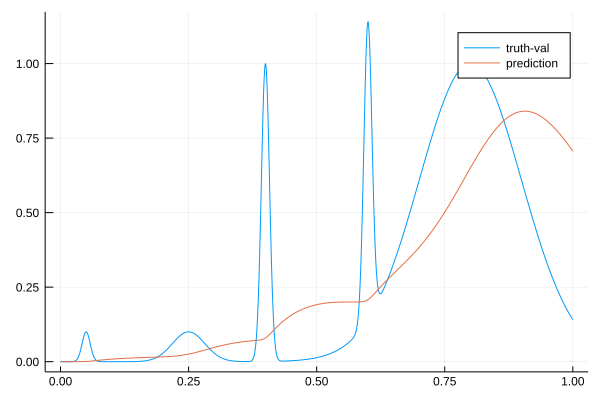

173.0698608809317 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  17.85247800953468 
   2.482232388360466
  11.9919461795212  
   6.299737919917316
 -10.561428370172269
   0.1              

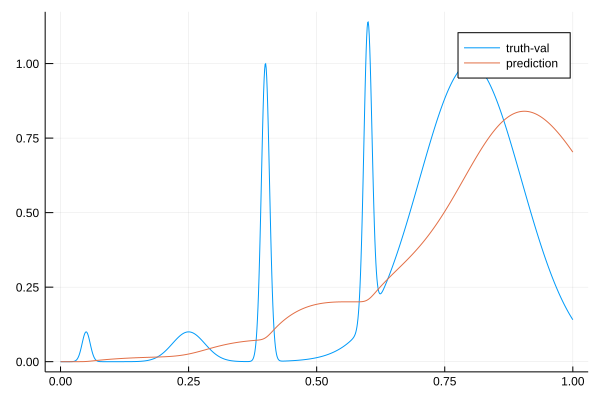

173.01001917685113 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  17.92584117707672 
   2.522773678635171
  12.08899950820621 
   6.377181160163633
 -10.659972639632699
   0.1              

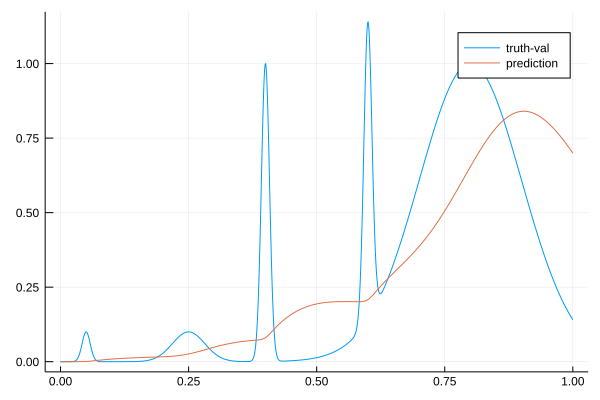

172.63773467309375 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  18.002333886550897 
   2.5699014899202592
  12.185644951532458 
   6.457624411991144 
 -10.758329144431885 
   0.1               

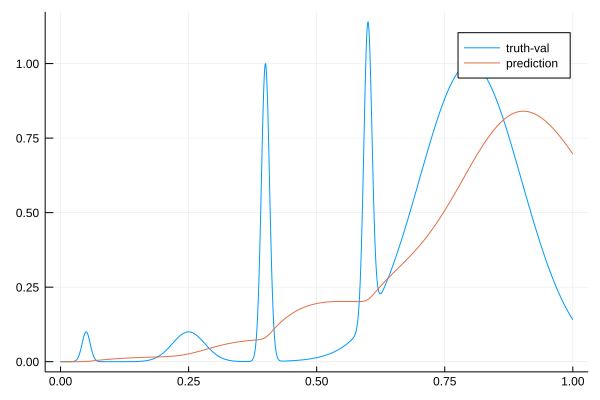

172.38021089592652 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  18.073512059095716 
   2.6311070115027473
  12.282092179856178 
   6.534394241042404 
 -10.8568820703579   
   0.1               

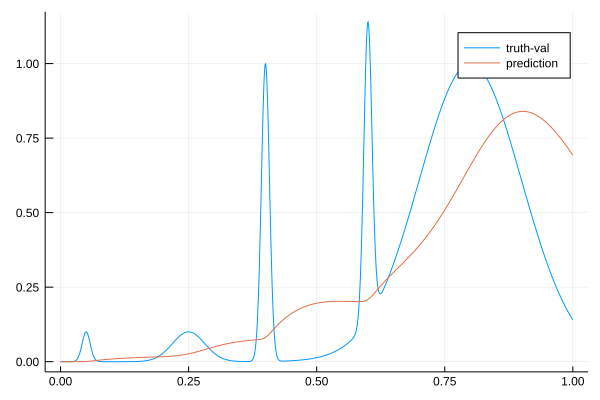

172.01180891889803 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  18.140904846904103
   2.70311328417719 
  12.37829336367051 
   6.608871504580615
 -10.95555878784799 
   0.1              

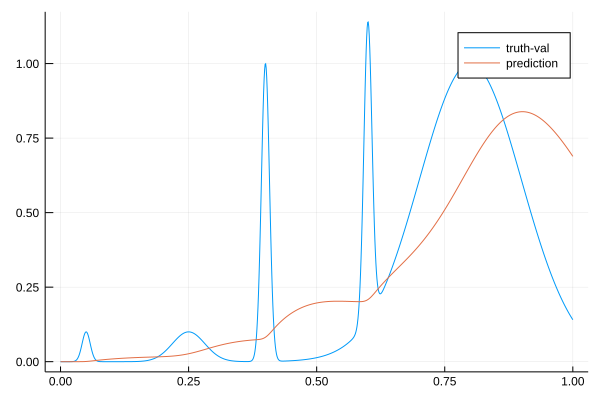

171.66716306717905 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  18.206287767431856 
   2.7837258984433846
  12.47419031816624  
   6.682630594189097 
 -11.054271383334795 
   0.1               

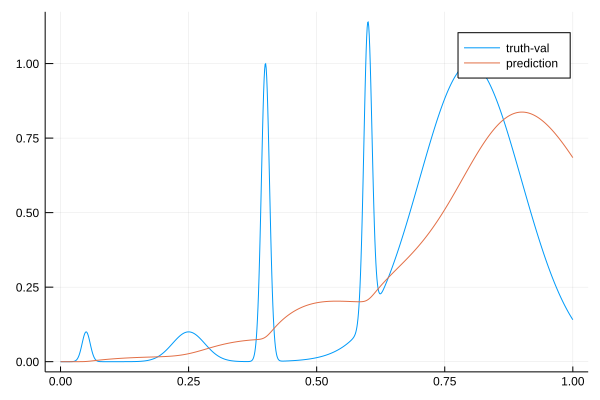

171.33356285891304 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  18.271112796491494 
   2.8713860053632385
  12.569734561303893 
   6.756926255432225 
 -11.152947981894462 
   0.1               

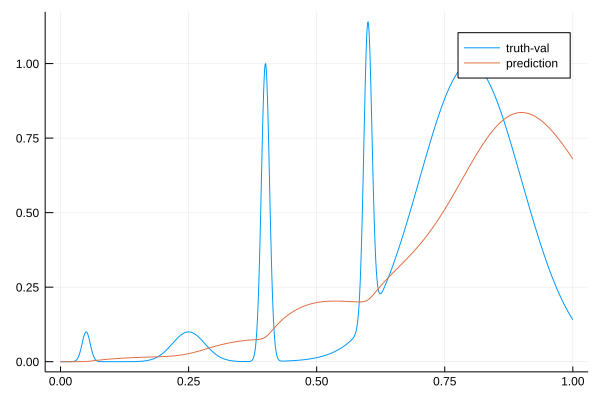

171.00774158795133 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  18.336565024485434 
   2.9649386418571573
  12.664882928619072 
   6.832742569249535 
 -11.251527192025335 
   0.1               

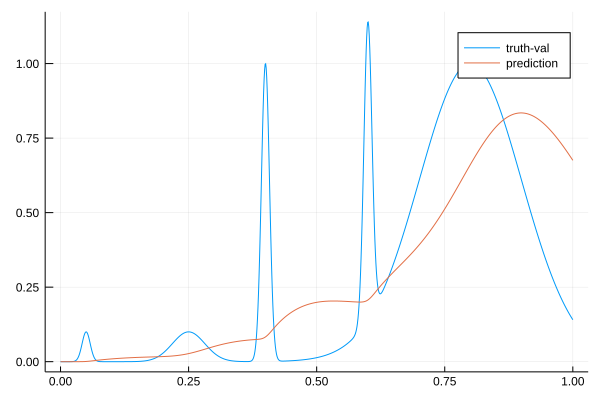

170.9411630887908 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  18.40363314627858  
   3.0635071993583405
  12.759598568853592 
   6.910857351803069 
 -11.349957290247598 
   0.1               

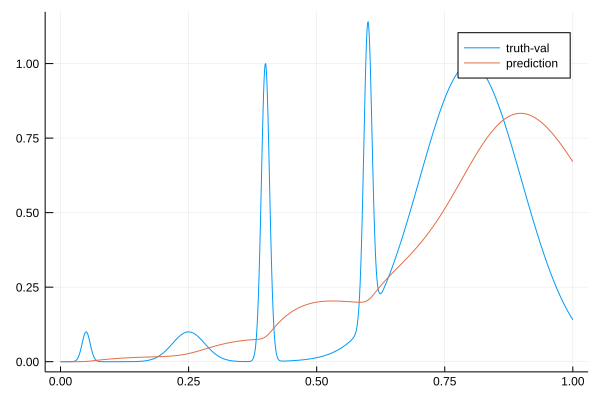

170.64804447206765 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  18.472369419670688 
   3.1664361818163216
  12.853892782836397 
   6.991298564044058 
 -11.448252526664172 
   0.1               

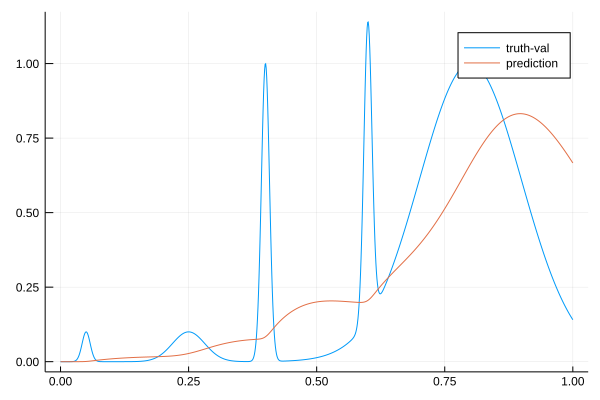

170.35852691350274 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  18.542795372327777 
   3.2732666808200603
  12.94773848017804  
   7.074107722751893 
 -11.546398766549917 
   0.1               

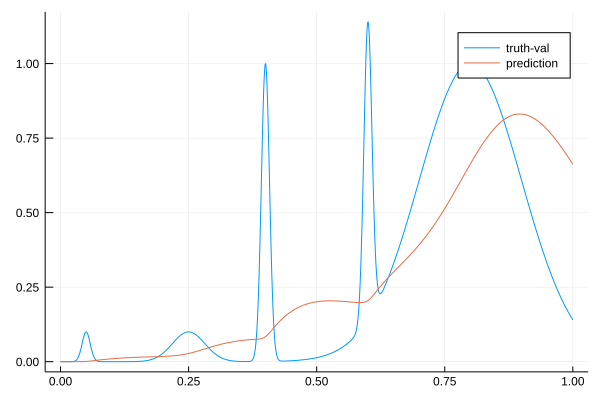

170.02307484072335 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  18.61561784708504  
   3.3835366681628685
  13.041111704269293 
   7.159773722797065 
 -11.644358786608574 
   0.1               

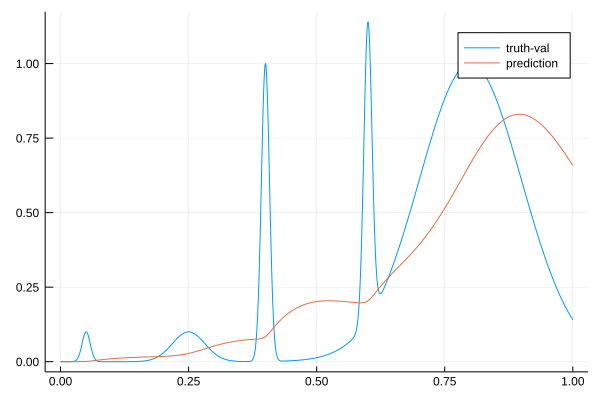

169.79016749491188 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  18.691543040925595
   3.496878033756791
  13.133984423379701
   7.248744686665476
 -11.742089780308813
   0.1              

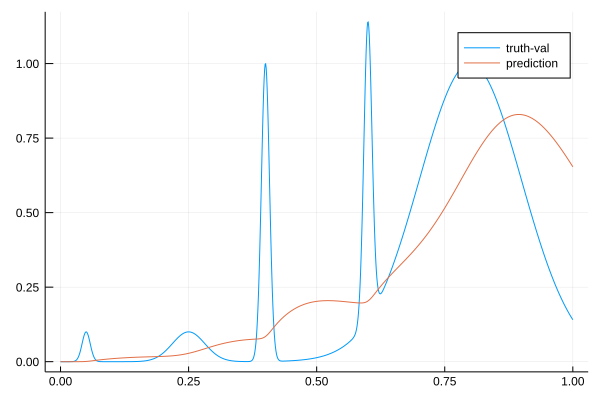

169.4743366770932 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  18.77280729638441  
   3.6123159534244325
  13.226300758130705 
   7.342180432178609 
 -11.83947005326014  
   0.1               

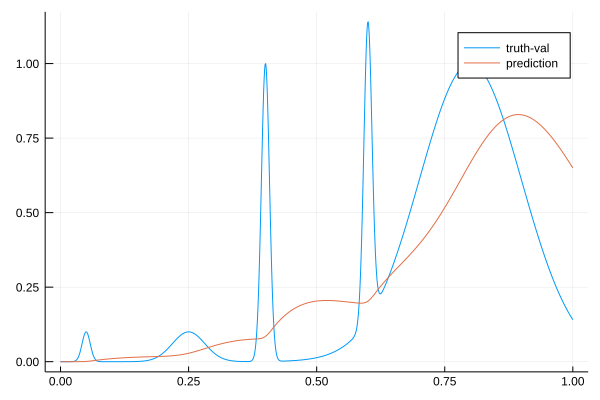

169.1522533134393 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  18.85930678838939 
   3.729825984189138
  13.318047376366904
   7.439941365842422
 -11.936485048093031
   0.1              

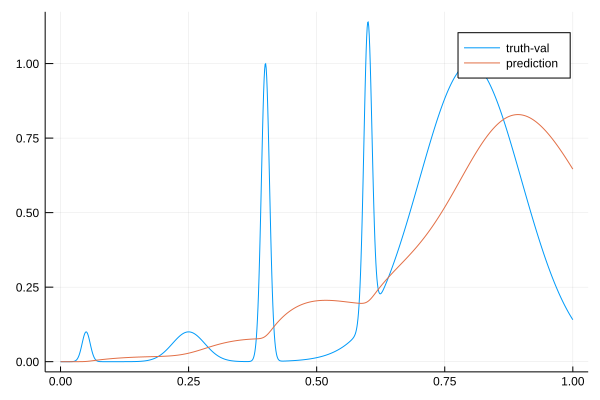

168.80416840543361 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  18.948259039179035 
   3.8501028802163666
  13.40926360911956  
   7.540464006836625 
 -12.033273665996703 
   0.1               

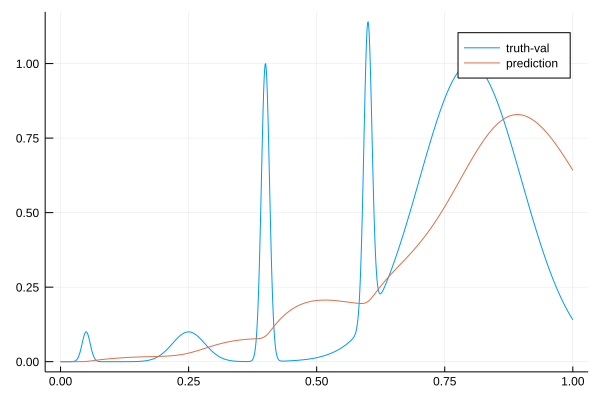

168.45693377794328 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  19.03977861640503  
   3.9729202122290093
  13.499929121432224 
   7.6437723818504075
 -12.129815722627464 
   0.1               

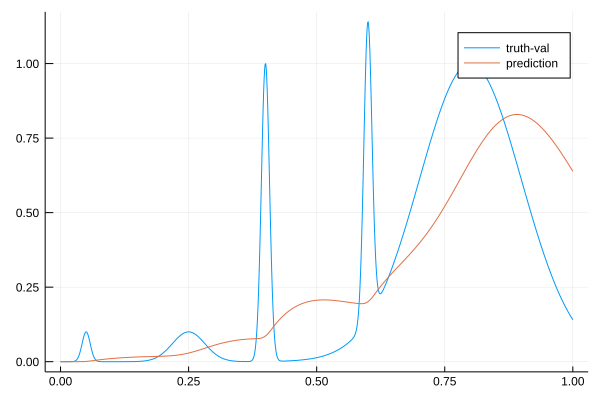

168.10937784161854 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  19.13417218812426 
   4.098058469995128
  13.590025433731457
   7.749981925639023
 -12.22608307894059 
   0.1              

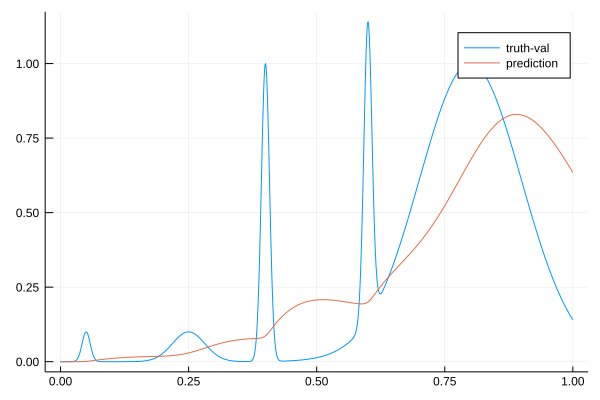

167.76107627930745 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  19.231777272229312
   4.225321408331296
  13.679536117994507
   7.859205702927121
 -12.322040879381193
   0.1              

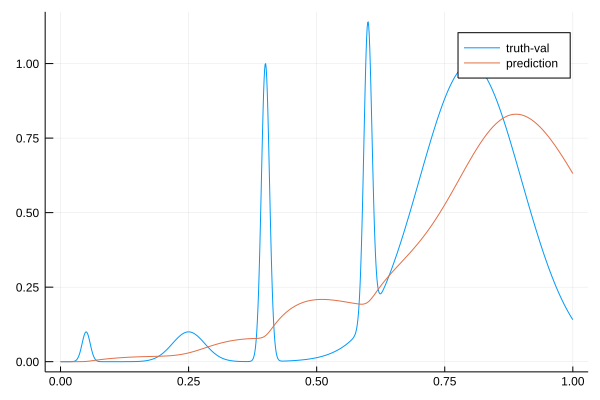

167.3894444992185 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  19.3287326891436  
   4.354974316086975
  13.768685716302969
   7.969487319001821
 -12.417962408692663
   0.1              

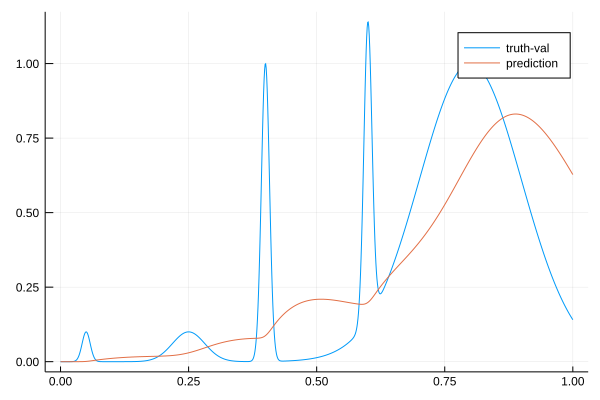

167.07282976898597 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  19.42599269641741 
   4.486749971445294
  13.857424004892094
   8.081320770422181
 -12.513771868534011
   0.1              

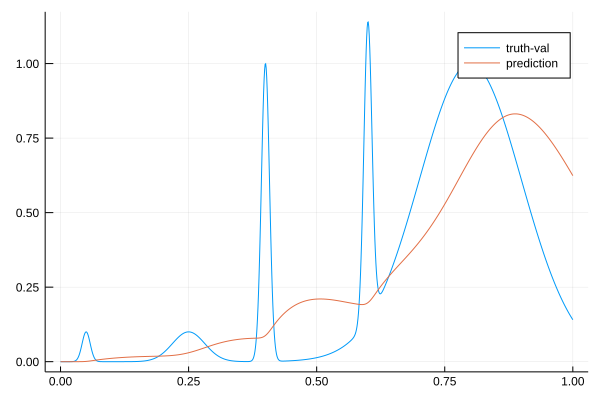

166.54571926914906 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  19.523904143139706
   4.620469982967098
  13.945725889052655
   8.194876131343873
 -12.609434397534786
   0.1              

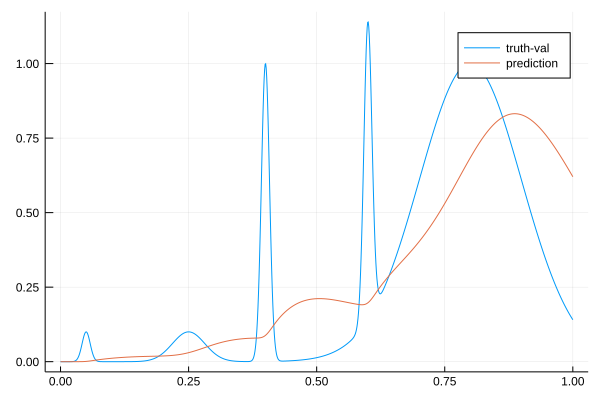

166.56459656323935 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  19.62167735119141 
   4.756203252425238
  14.033575276445427
   8.30996706473532 
 -12.704940641428468
   0.1              

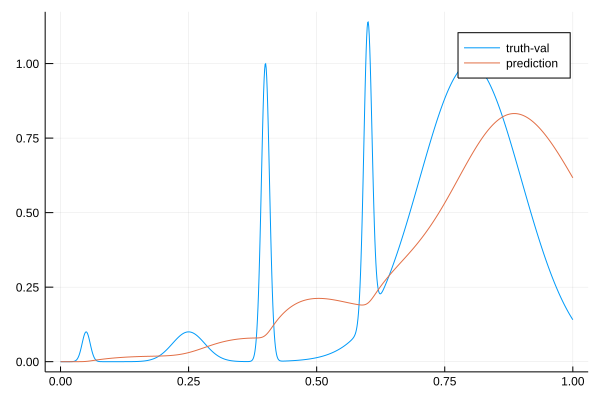

165.76890567123283 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  19.72113179828391 
   4.893474503225354
  14.12096363125423 
   8.427162317394245
 -12.800231354775828
   0.1              

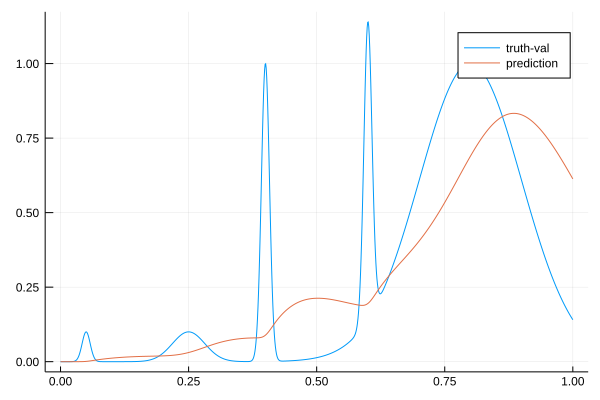

165.36139771299636 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  19.8172834138905  
   5.032725607999866
  14.208073841140559
   8.544698460434233
 -12.89553591325103 
   0.1              

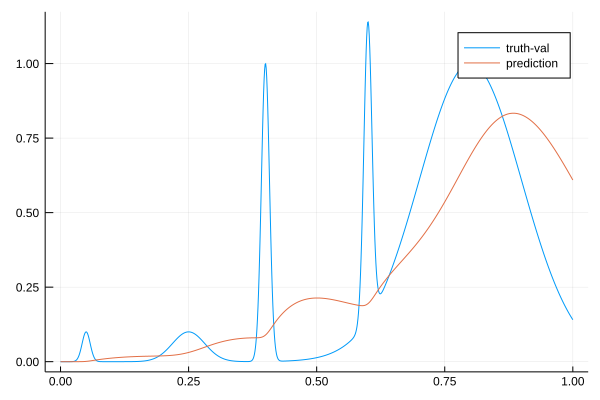

165.0641360046205 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  19.909169486356745
   5.173904397359027
  14.294892231499615
   8.662474505522402
 -12.990840378832377
   0.1              

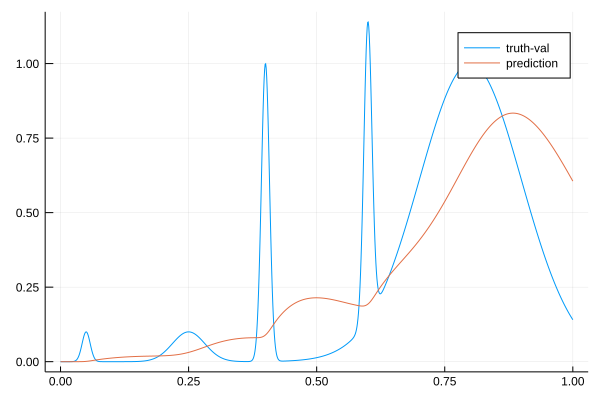

164.55502227316677 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  19.99900388933983 
   5.316605391911692
  14.3813391000571  
   8.78119073716185 
 -13.08598845662055 
   0.1              

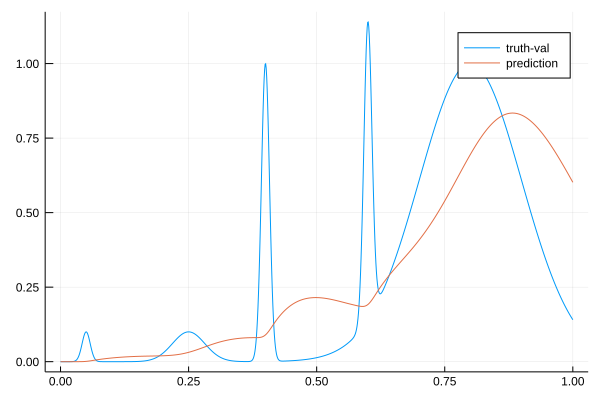

164.3814796947145 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  20.08844365229216 
   5.460646291512603
  14.46734584470869 
   8.901479994848232
 -13.180855799164856
   0.1              

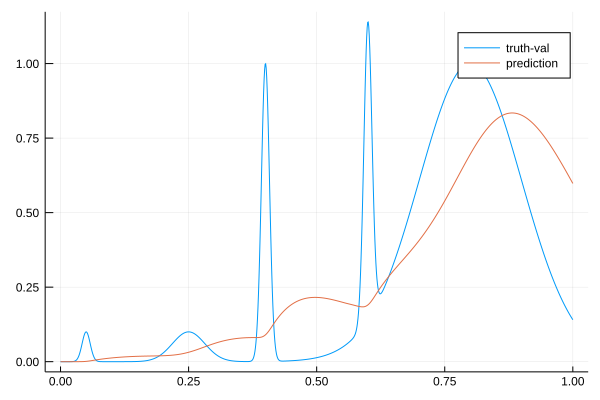

164.03947501998667 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  20.178014697376632
   5.605877201220777
  14.552910590741053
   9.023466643676013
 -13.275419736291983
   0.1              

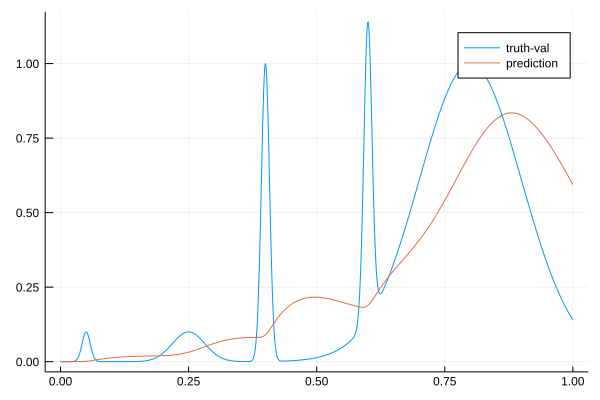

163.67894192264723 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  20.26338370103622 
   5.752487257478777
  14.638255315986294
   9.145842813482915
 -13.36991915618804 
   0.1              

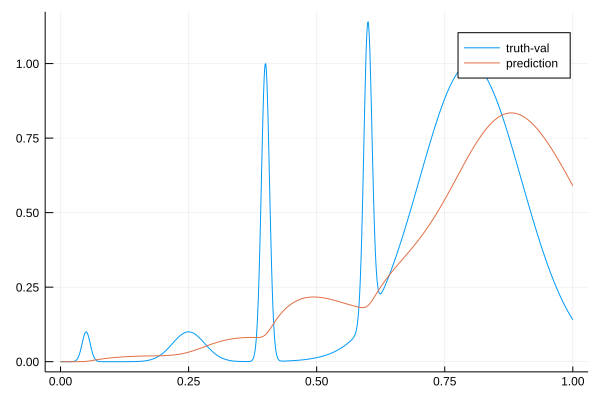

163.31030980361115 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  20.34848327185051 
   5.900040670718271
  14.72327080896574 
   9.269719497683889
 -13.46416133245458 
   0.1              

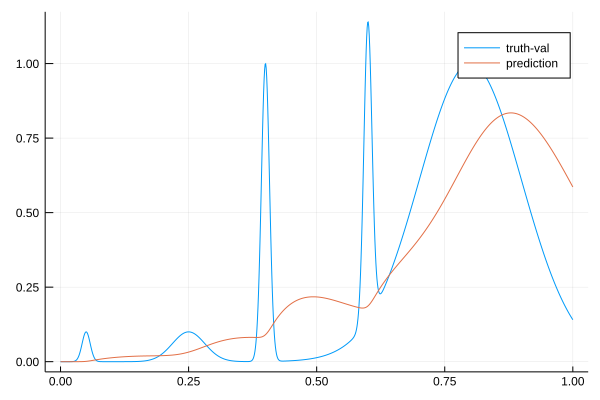

162.9388359036314 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  20.435938476009316
   6.048170668170826
  14.807861992910558
   9.395685102289814
 -13.557991874690423
   0.1              

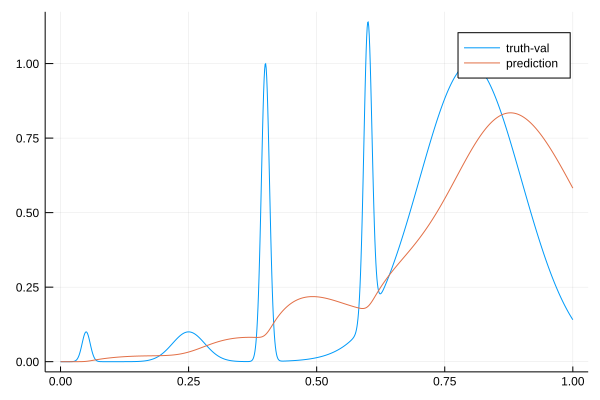

162.57291819145505 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  20.525907651048332
   6.196880264744853
  14.891989068271522
   9.523721612282129
 -13.65135963714138 
   0.1              

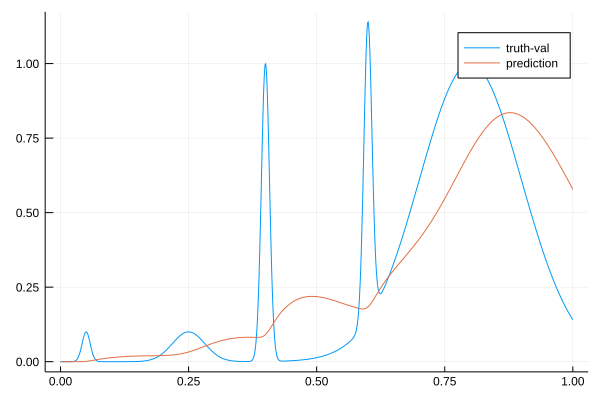

162.23120846295507 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  20.61896178778399 
   6.346132822804271
  14.975616544653079
   9.653912677635578
 -13.744199168782517
   0.1              

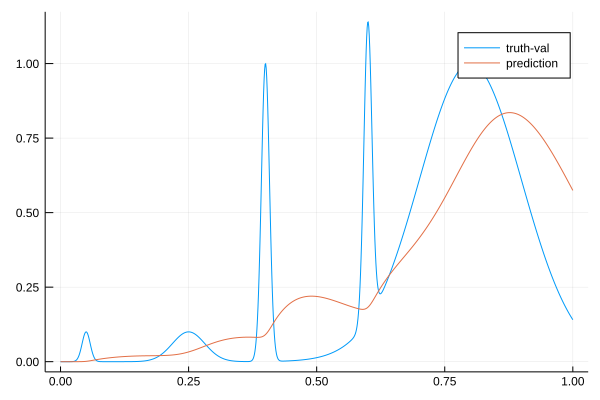

161.848293838805 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  20.71546905405942 
   6.495896152388723
  15.058716093626295
   9.786266485399473
 -13.836457350058398
   0.1              

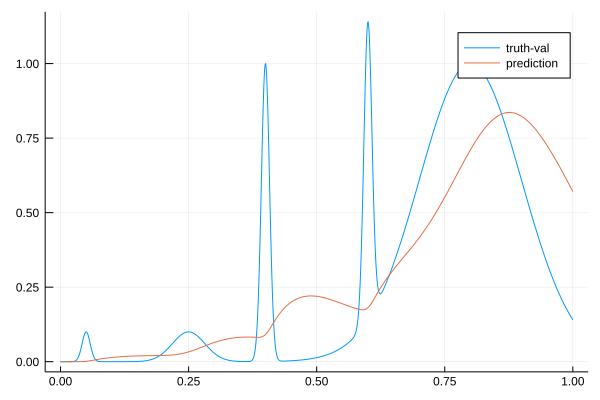

161.42038995779 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  20.81578231039359 
   6.646140891092891
  15.141255221398152
   9.920785948174636
 -13.928073977883612
   0.1              

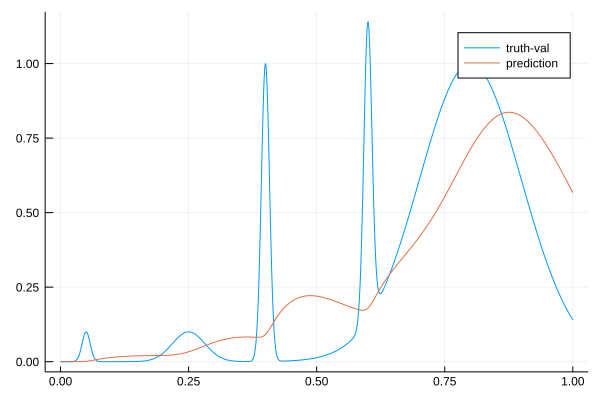

160.98765771149485 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  20.915960265471007
   6.797216083193335
  15.223454829513459
  10.056423044440466
 -14.019292732154046
   0.1              

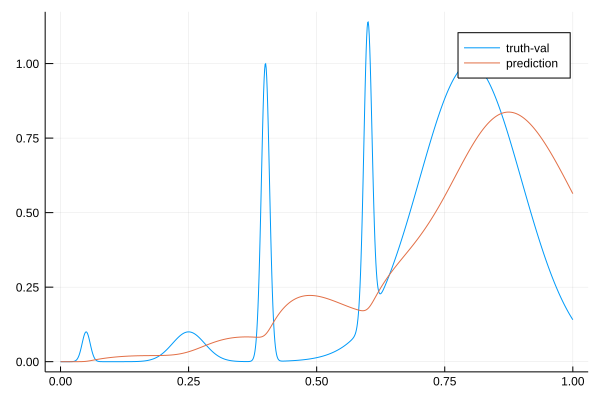

160.56854779608415 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  21.014872859612215
   6.949276961710248
  15.305297706663875
  10.192998994863938
 -14.110091564865147
   0.1              

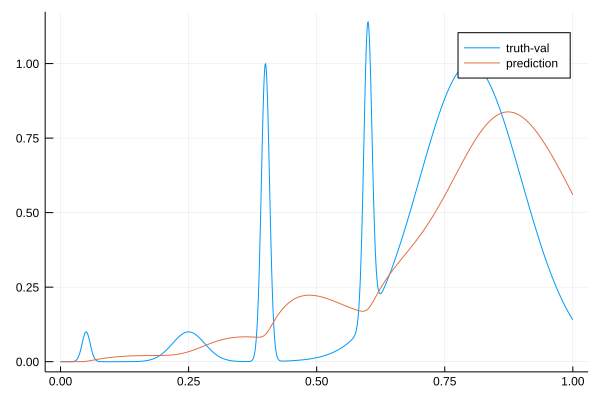

160.04952408217187 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  21.113115010675298
   7.102206626266671
  15.386722757710713
  10.330624651394592
 -14.200392768944678
   0.1              

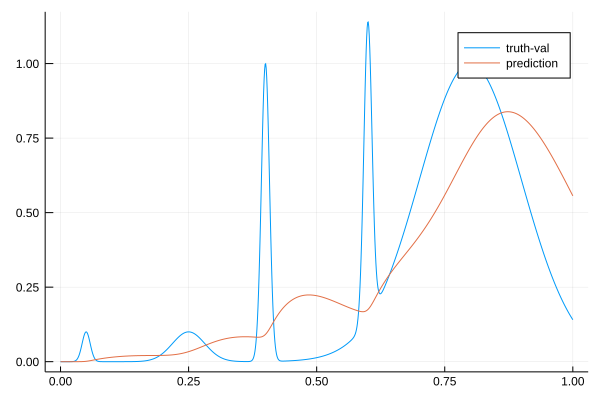

159.935674559374 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  21.211858709810667
   7.255853358517215
  15.467647036255704
  10.469511841999669
 -14.290074787398929
   0.1              

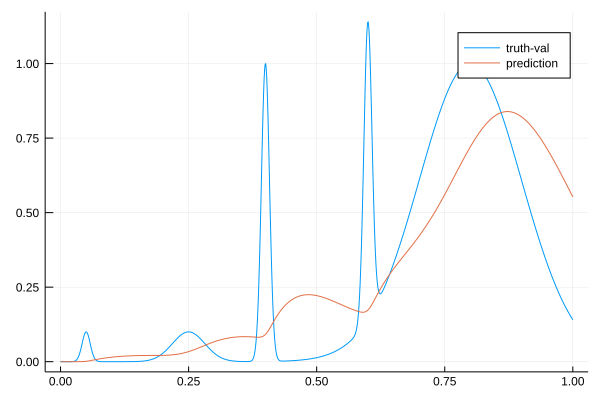

159.5038905759143 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  21.313384223318856
   7.409871422422933
  15.548048627072188
  10.60998691996554 
 -14.379072749440063
   0.1              

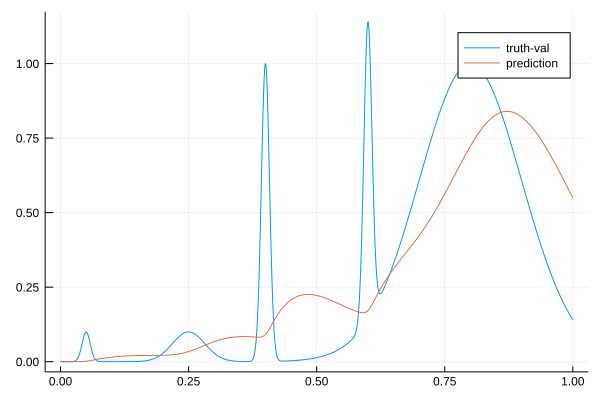

158.7624860012239 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  21.413560619652824
   7.564585237631017
  15.628145170630109
  10.751147676696336
 -14.467634621531488
   0.1              

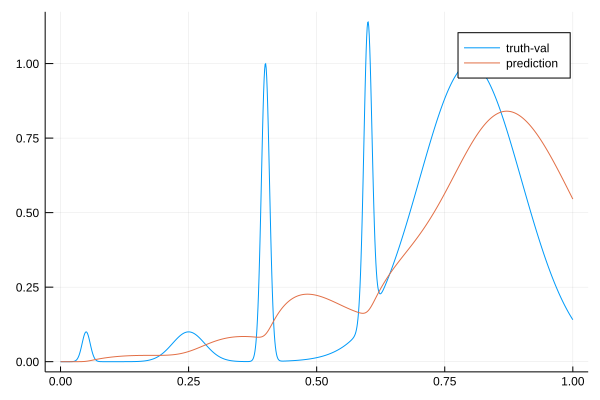

158.3353089110888 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  21.509488906126077
   7.720317790414324
  15.70787663413165 
  10.892615678639467
 -14.555701672439328
   0.1              

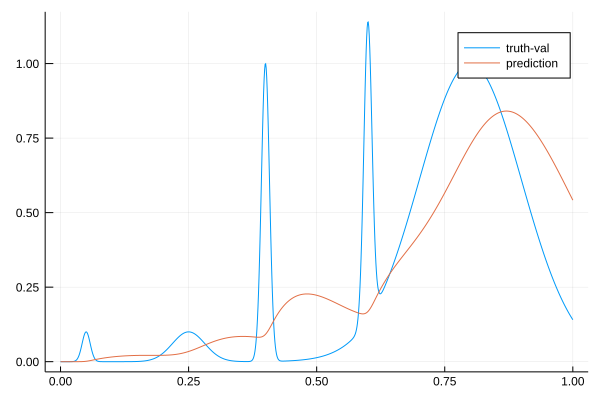

157.90245595257468 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  21.603677707187668 
   7.8766410555236055
  15.787131564320104 
  11.034700317917675 
 -14.64309777380249  
   0.1               

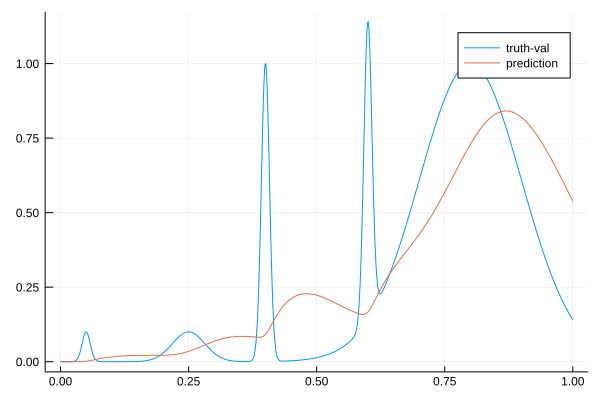

157.49282278578053 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  21.69725363615034 
   8.033428705580883
  15.865850654248732
  11.177587108580054
 -14.729731628888496
   0.1              

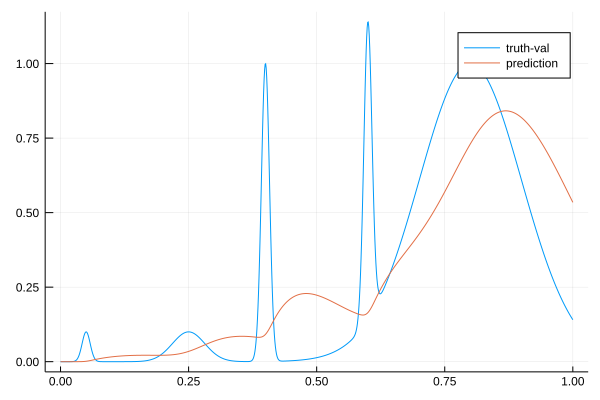

157.0676072376377 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  21.79055638737214 
   8.190611533173069
  15.94398698817911 
  11.32129631475116 
 -14.815547039105294
   0.1              

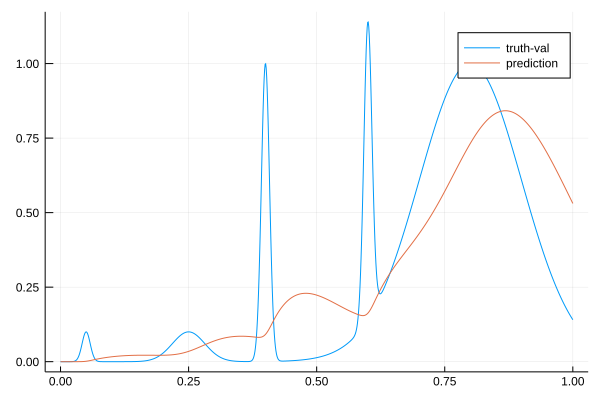

156.63500820734177 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  21.886201336997303
   8.34784628431326 
  16.02145596367321 
  11.466128917103585
 -14.900419643469204
   0.1              

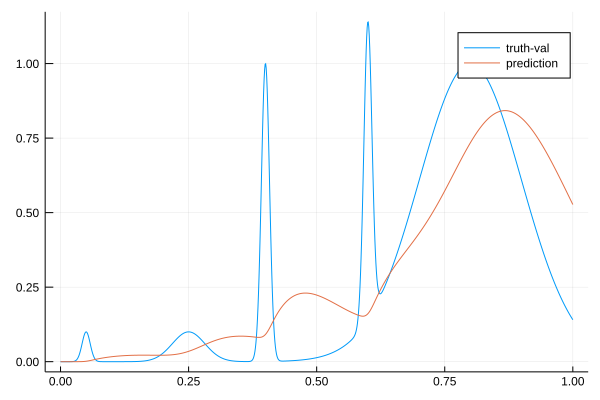

156.1984181769207 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  21.984697600958004
   8.505088932417557
  16.09821419120831 
  11.612112812393626
 -14.984283301089757
   0.1              

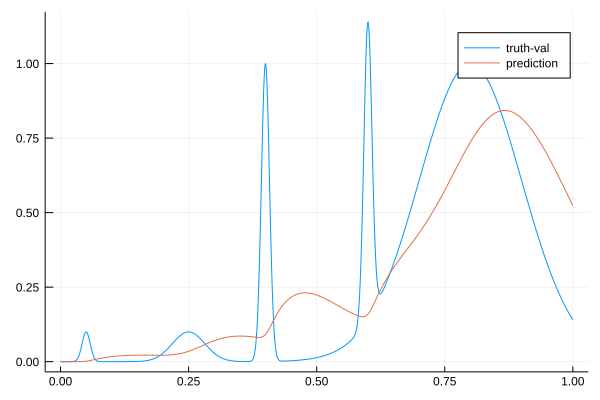

155.7564686383134 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  22.086441639449802
   8.662300033922149
  16.174220683426306
  11.759251372655202
 -15.067076805709968
   0.1              

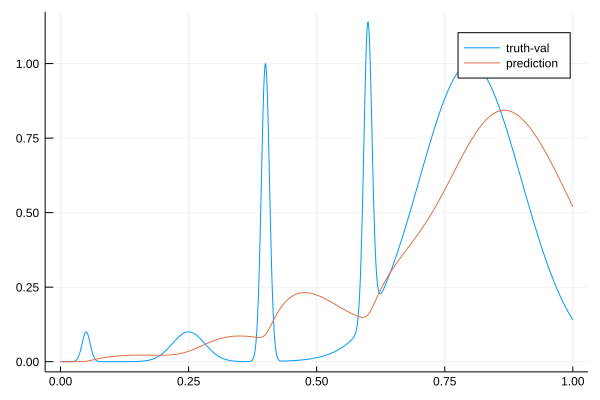

155.29667132302632 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  22.187341077756113
   8.819793559116242
  16.24970890715597 
  11.906821856413595
 -15.149059066919849
   0.1              

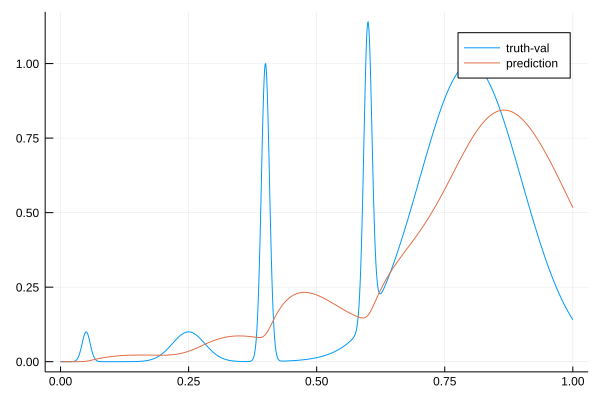

154.89922789045417 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  22.28597961980781 
   8.9776946304513  
  16.324647025678434
  12.054639666704619
 -15.230197110538906
   0.1              

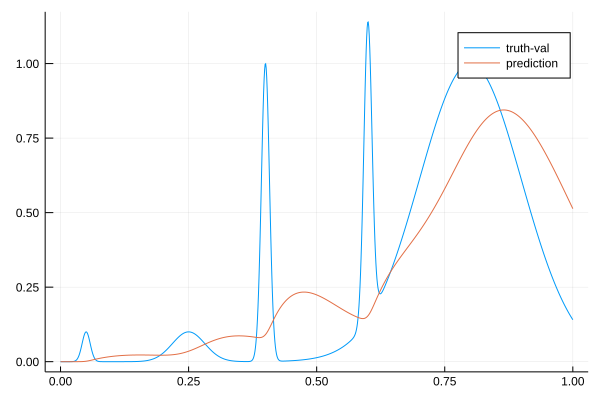

154.5257159853918 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  22.38339271864065 
   9.135891093283497
  16.3989896053866  
  12.20284949039082 
 -15.31041965520002 
   0.1              

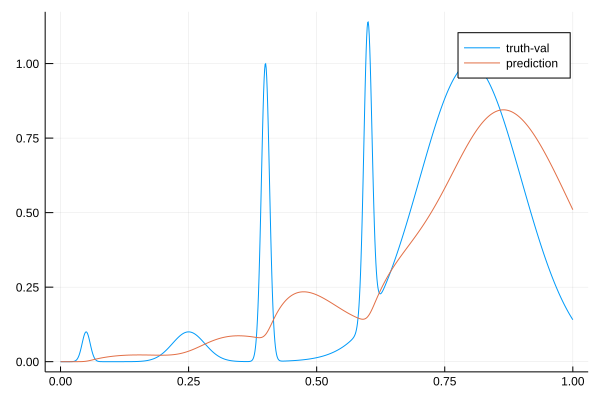

154.0891651471334 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  22.4803482343668  
   9.294280715247812
  16.47269241105388 
  12.351527145905145
 -15.389666871589872
   0.1              

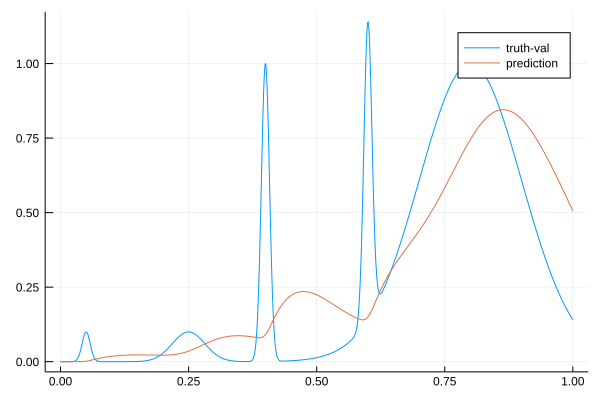

153.6802730431979 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  22.57465008871156 
   9.453011809960529
  16.54573521580741 
  12.500369366057127
 -15.467945618585551
   0.1              

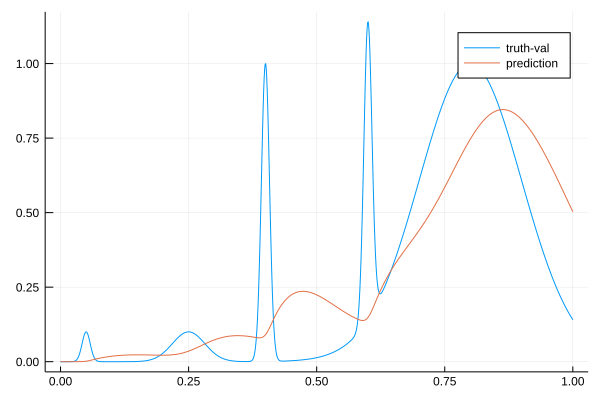

153.2437382908001 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  22.668214605908606
   9.611736583832872
  16.618030900026923
  12.649465365667536
 -15.545137227595943
   0.1              

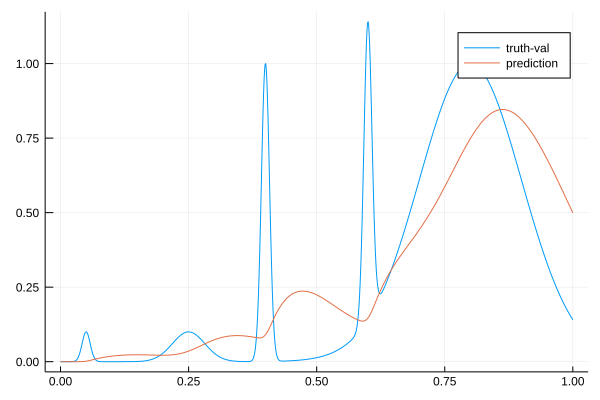

152.74236295012787 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  22.76185455598371 
   9.77037810232935 
  16.689532184034185
  12.798899927851078
 -15.621177053794339
   0.1              

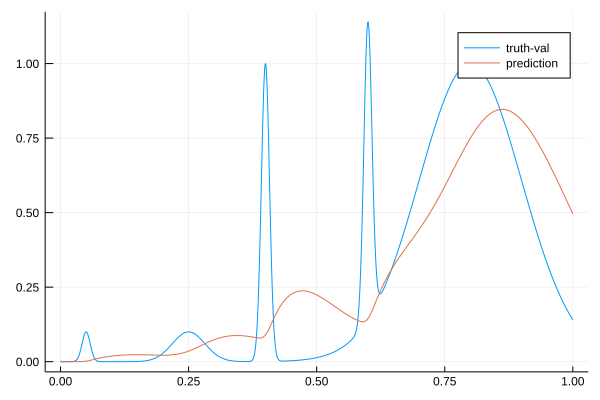

152.37923740808648 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  22.85397891603756 
   9.929071972288504
  16.760219558234443
  12.94847918292485 
 -15.696040339892736
   0.1              

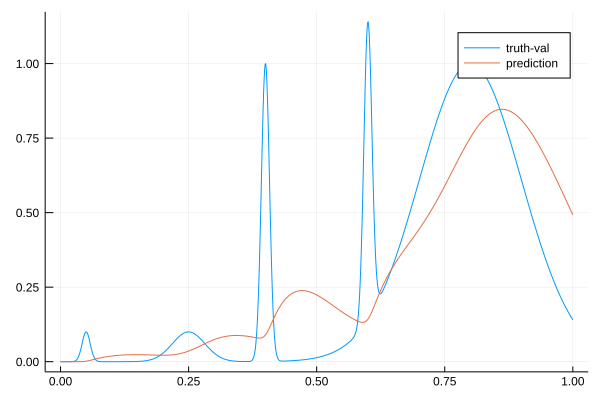

151.92314712593048 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  22.942861695202183
  10.087862787732847
  16.830309335018104
  13.097940792179207
 -15.76995609656964 
   0.1              

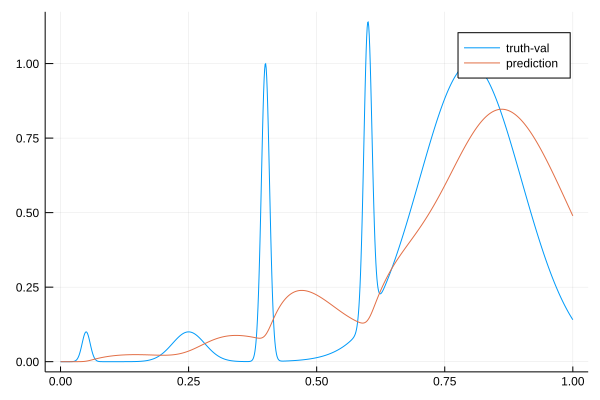

151.6317024274134 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  23.02889426460193 
  10.24663635226374 
  16.899736108239868
  13.247281094059998
 -15.842859959942583
   0.1              

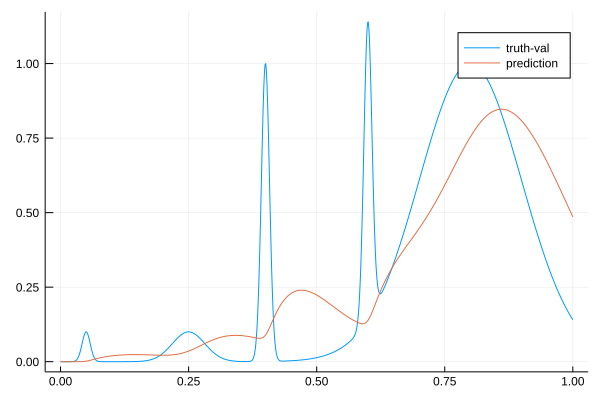

151.00703264615262 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  23.11543847426923 
  10.405127792349782
  16.968447295803507
  13.396871060004862
 -15.914671265389384
   0.1              

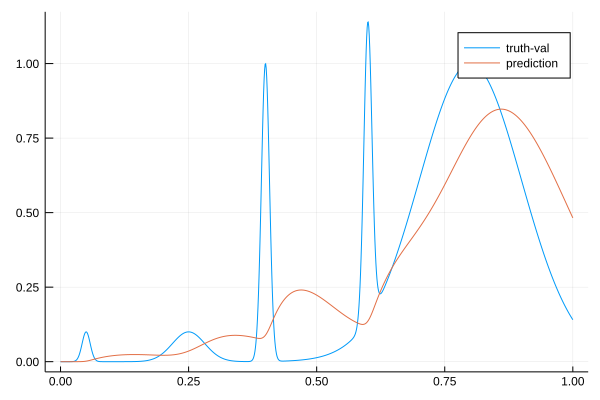

150.57858642510553 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  23.198248384585696
  10.563644747451637
  17.036405874161794
  13.54624072951343 
 -15.985367131486882
   0.1              

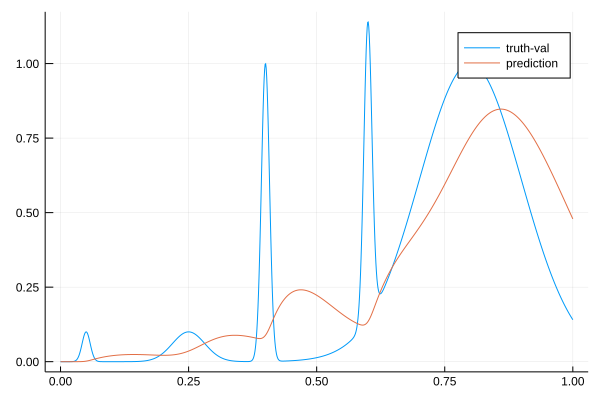

150.1417698703198 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  23.27923907283344 
  10.721866664310674
  17.103521892602   
  13.695445633107008
 -16.054844653461327
   0.1              

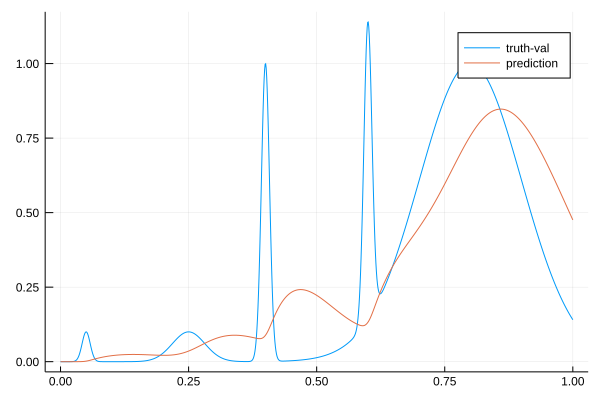

149.7278563988465 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  23.356544690297845
  10.87992695810589 
  17.169785607662128
  13.844308290013956
 -16.12309634268278 
   0.1              

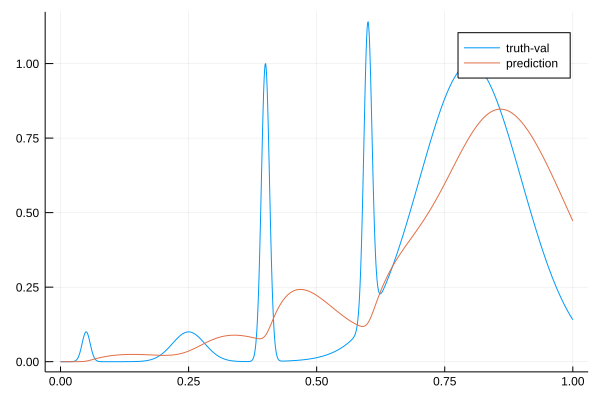

149.31832231162227 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  23.430597194061342
  11.037780625288407
  17.235159207231796
  13.992882035718406
 -16.190089487232765
   0.1              

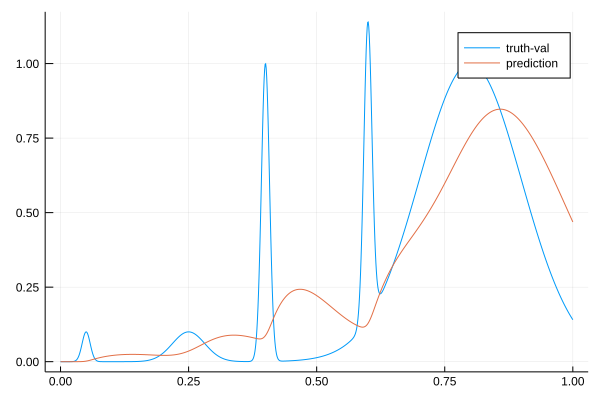

148.88928720353994 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  23.502399893070354
  11.195353578855618
  17.299609222245067
  14.141274208573956
 -16.25577685518493 
   0.1              

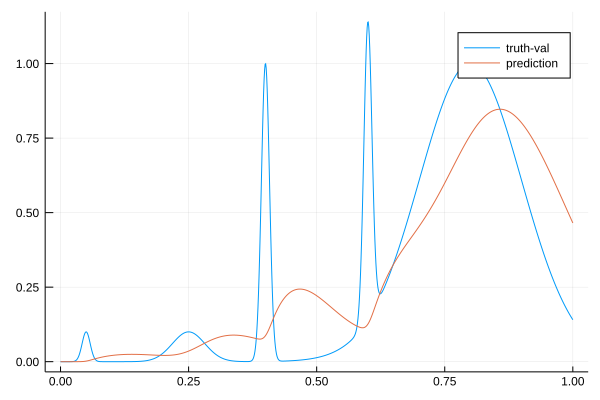

148.47473569121962 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  23.56997284400472 
  11.352758238503975
  17.36313338354771 
  14.289294713891609
 -16.320160596589382
   0.1              

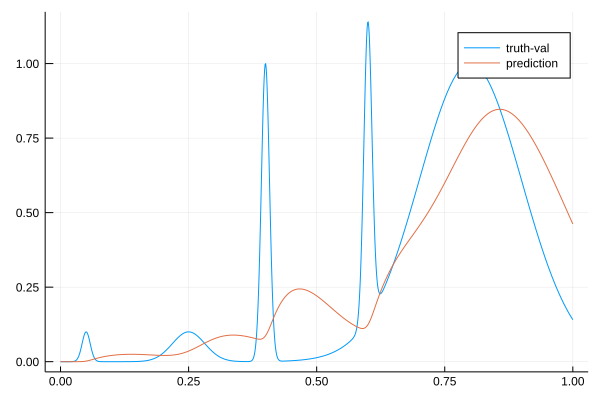

148.06270640401007 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  23.634394217768456
  11.509903365247371
  17.42569677383837 
  14.437046484277042
 -16.383194408264274
   0.1              

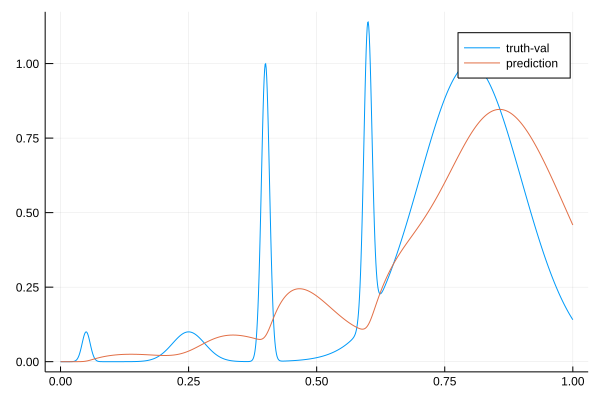

147.68613659288502 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  23.69461972242394 
  11.666660136089119
  17.48726586691779 
  14.584268706907151
 -16.44485011735535 
   0.1              

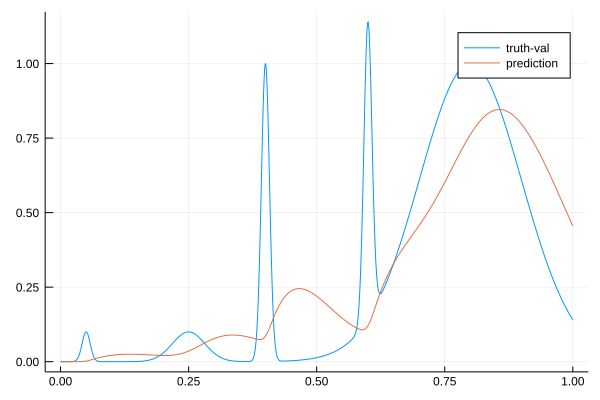

147.3026007627845 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  23.75700655552598 
  11.822640072084546
  17.547539257156625
  14.731551516361028
 -16.504782752382695
   0.1              

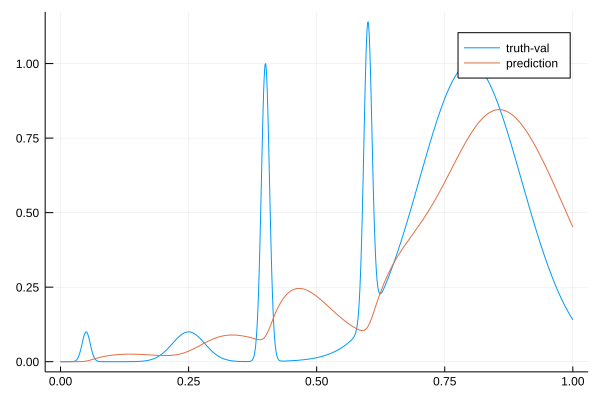

146.8659028073878 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  23.823837989641127
  11.977647508554266
  17.60649534716459 
  14.879022204533433
 -16.56298900250788 
   0.1              

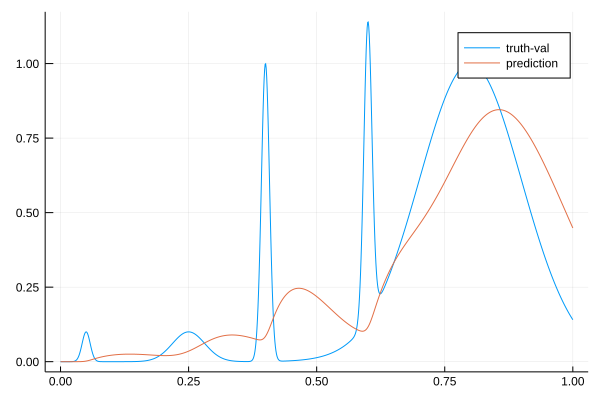

146.47801617088746 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  23.890360051176692
  12.132054465364373
  17.664184495706856
  15.026270071184035
 -16.619516955278705
   0.1              

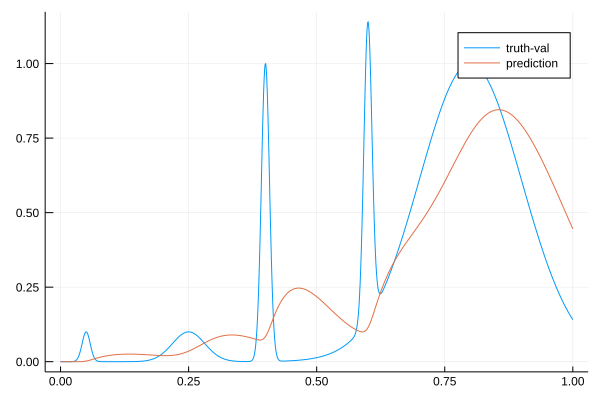

146.0941194264351 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  23.959809000845638
  12.285429789301942
  17.720543838808094
  15.173355389585257
 -16.674346970561576
   0.1              

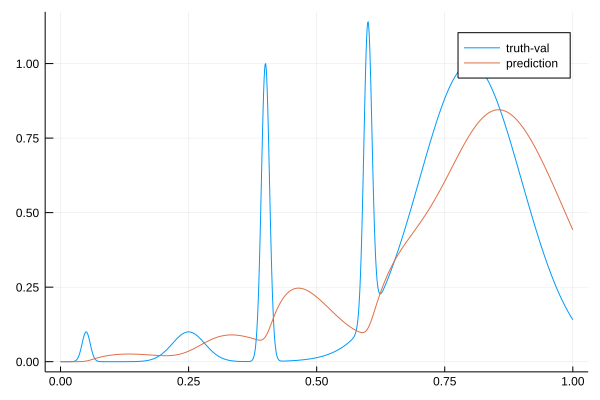

145.7126091102748 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.029444477577258
  12.437977473782567
  17.775614991731523
  15.32003069151105 
 -16.727540783606475
   0.1              

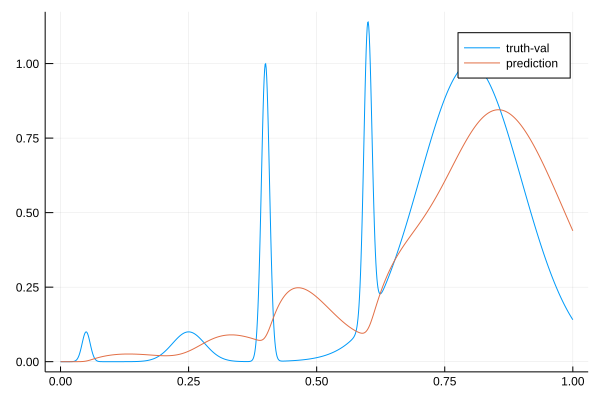

145.31980181795052 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.099751362227757
  12.589696528143083
  17.829398355651712
  15.46634634979965 
 -16.779099654537102
   0.1              

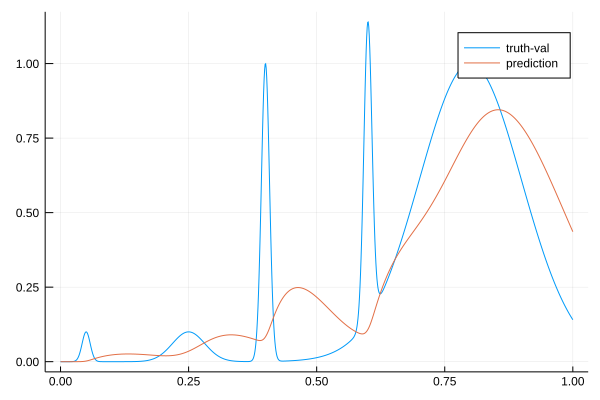

144.9496791172868 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.168193364719055
  12.740759253611055
  17.881933264489355
  15.612087278723266
 -16.829081580129188
   0.1              

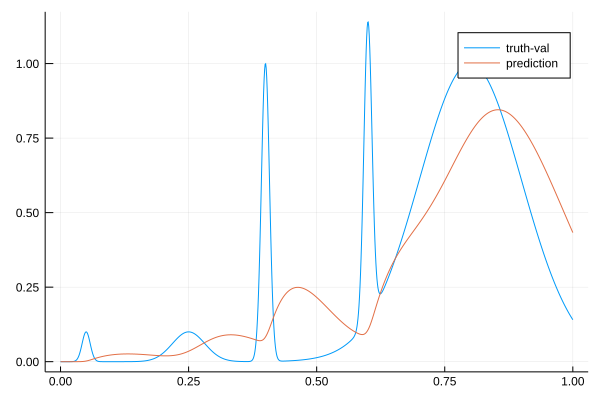

144.59700619045103 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.236070270523783
  12.890934352469873
  17.93318325655759 
  15.7572153993983  
 -16.877475227555355
   0.1              

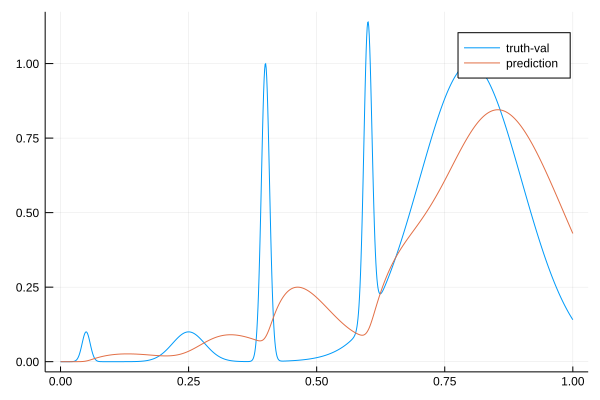

144.25111278820927 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.300655042147383
  13.040391947557945
  17.983186295658015
  15.901508557599092
 -16.92434791280371 
   0.1              

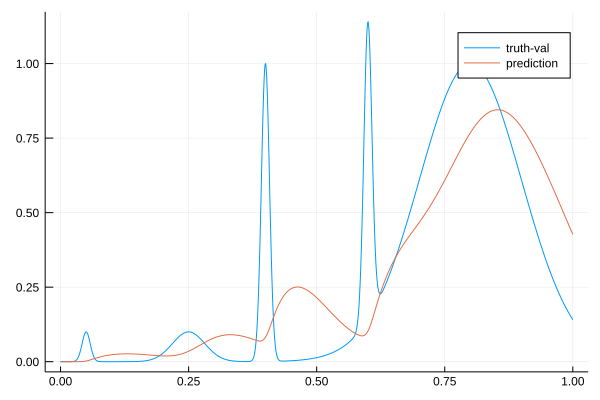

143.92623546926103 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.35893735591526 
  13.18929447229394 
  18.031984288313765
  16.0447326182106  
 -16.969769040855088
   0.1              

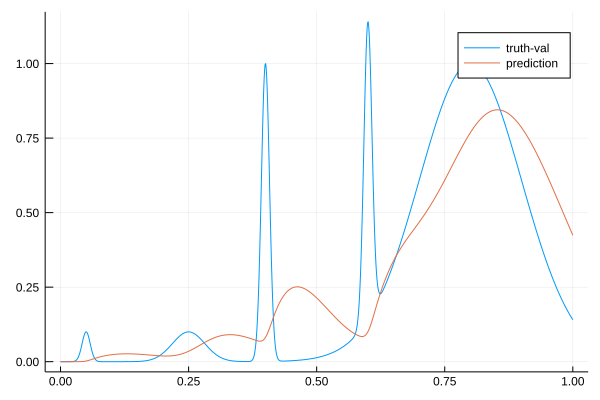

143.58433234276654 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.412492667487644
  13.337399040195827
  18.07954507753849 
  16.18688766329428 
 -17.0137393528117  
   0.1              

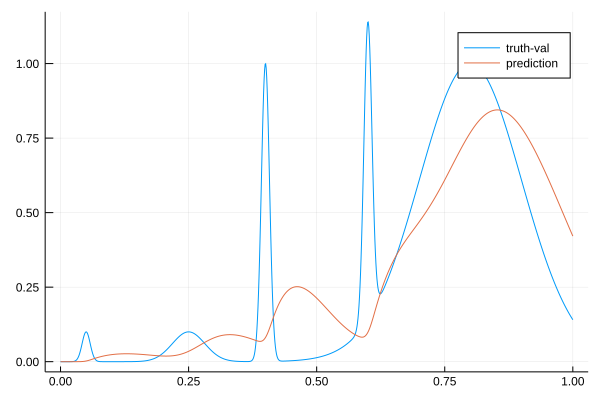

143.24866158022525 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.458763592593424
  13.484856022880331
  18.12590906188766 
  16.327805906103762
 -17.056324463166035
   0.1              

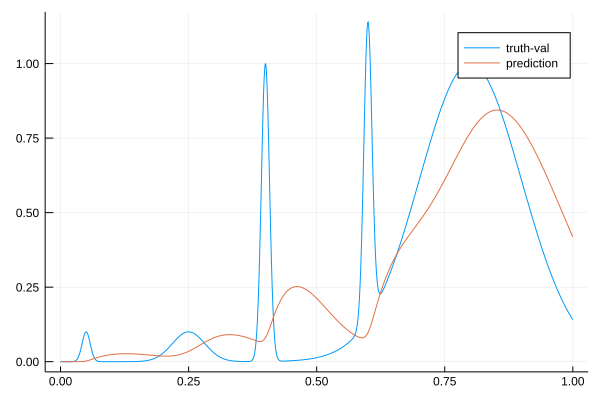

142.91748738015397 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.499457135310852
  13.631432916632626
  18.171043785996535
  16.467508545626583
 -17.097516477088227
   0.1              

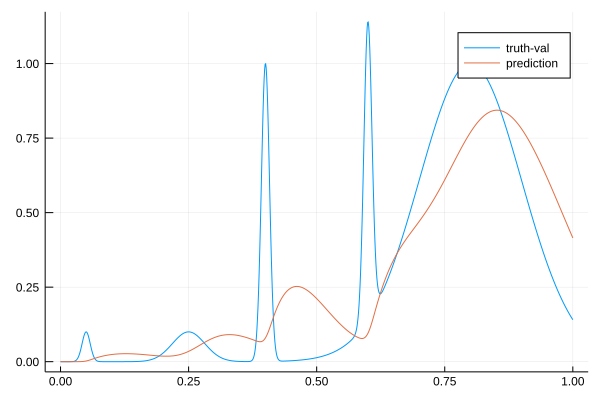

142.5959913183415 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.531945924977094
  13.777279286280567
  18.214989270627573
  16.60582805626945 
 -17.137384585471956
   0.1              

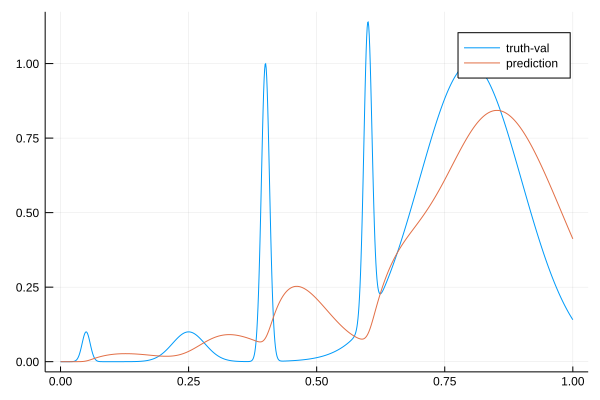

142.28415710865517 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.55796933803464 
  13.922171032657722
  18.257715796412782
  16.742791410962067
 -17.175923531868126
   0.1              

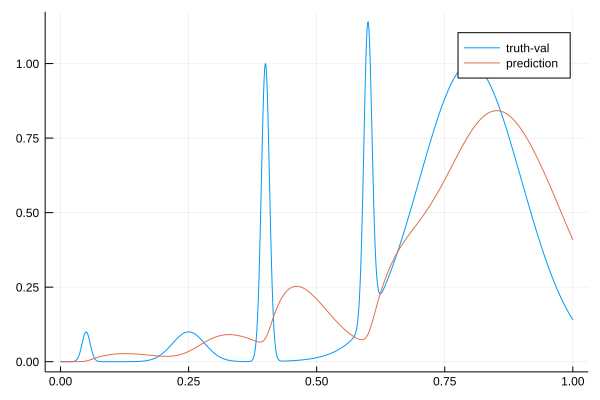

141.98170185690714 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.580851334038776
  14.065916369674133
  18.29898402952411 
  16.8786423091892  
 -17.21289155615959 
   0.1              

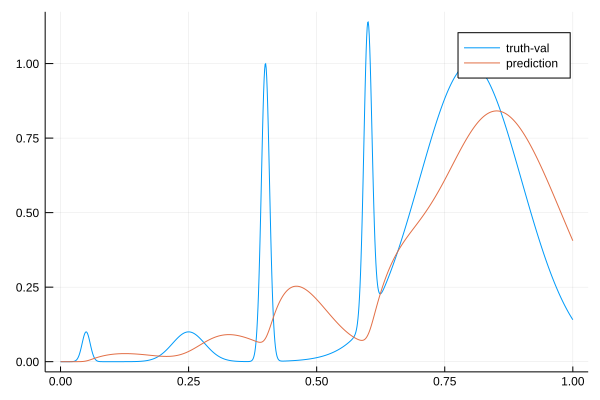

141.68316325563214 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.60198255156628 
  14.208313965925429
  18.338793149999557
  17.013357239783602
 -17.248306804514247
   0.1              

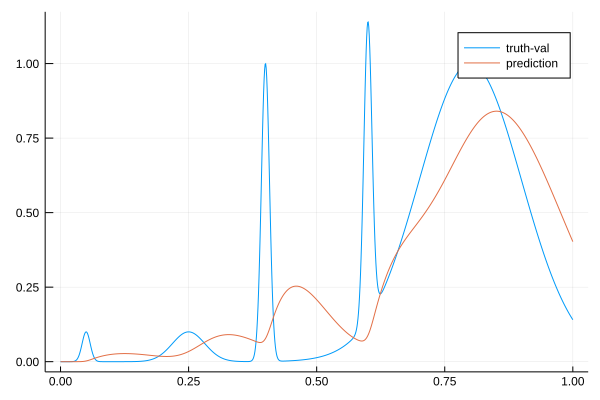

141.39499029020334 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.6218918064683  
  14.349419167660928
  18.377176965515638
  17.14704667507656 
 -17.2821959403863  
   0.1              

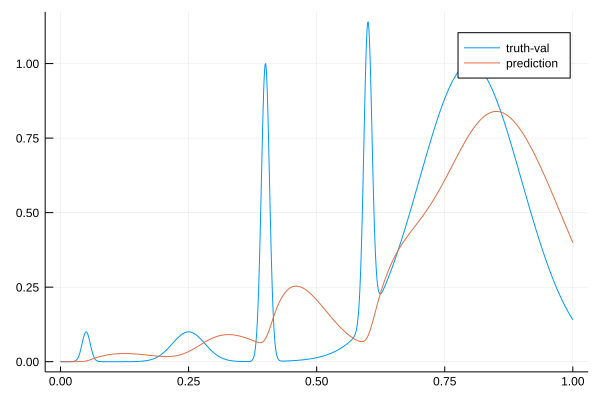

141.11391458268668 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.637858624151647
  14.489225916930327
  18.414175405201558
  17.27936503003747 
 -17.31467369918657 
   0.1              

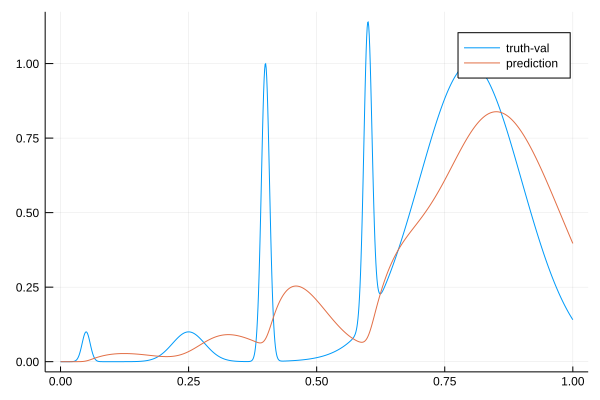

140.84676772263356 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.657127823925485
  14.627226411972453
  18.44950588095528 
  17.410696127698913
 -17.34545570296703 
   0.1              

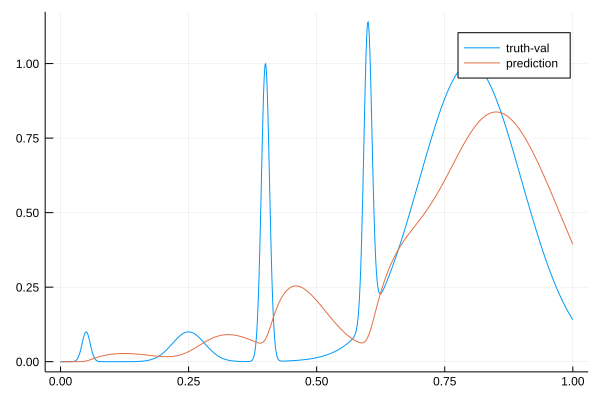

140.58434113618208 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.679686893711565
  14.763535398830921
  18.483228730779683
  17.541120614742344
 -17.37459693652226 
   0.1              

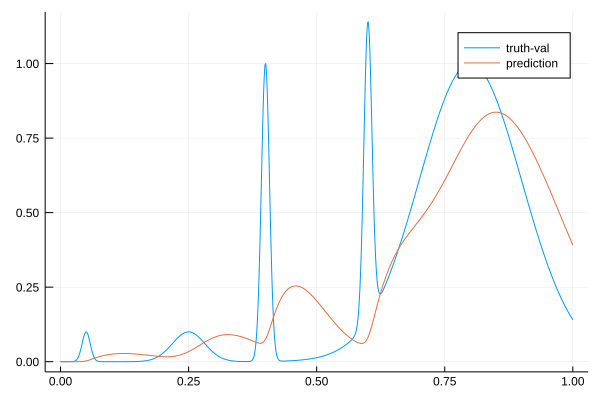

140.32931030258416 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.702244963859297
  14.898194973976683
  18.515407676159413
  17.670259365074124
 -17.40224565213438 
   0.1              

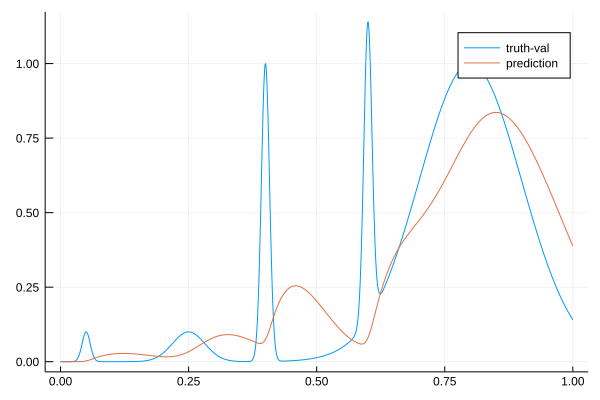

140.0832852862162 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.725760794652327
  15.031073858709245
  18.54606378628749 
  17.798084677833426
 -17.42844630006504 
   0.1              

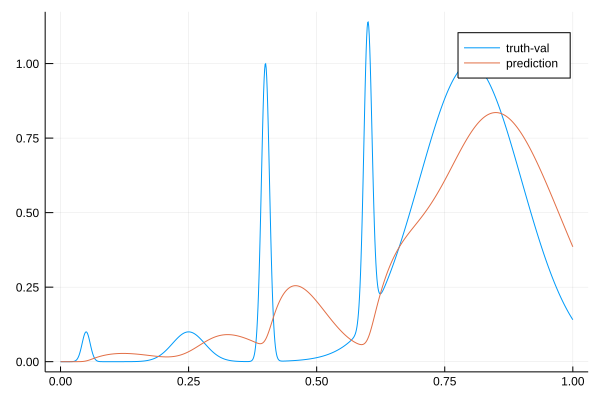

139.84538953092235 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.7465414689744  
  15.162430787217232
  18.575288545955377
  17.92439469128662 
 -17.453336561388056
   0.1              

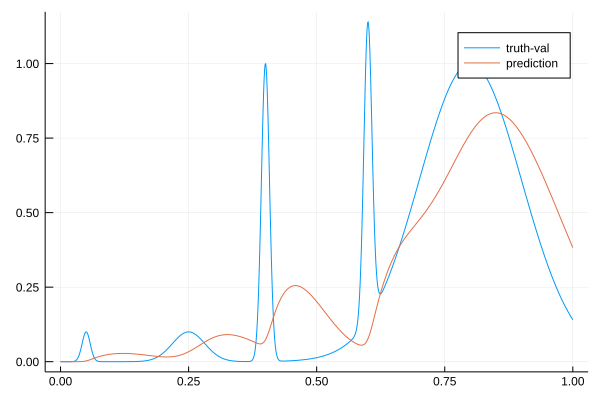

139.6157311202985 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.771661365289127
  15.291776766903256
  18.602812131024244
  18.04954138541677 
 -17.476651827347336
   0.1              

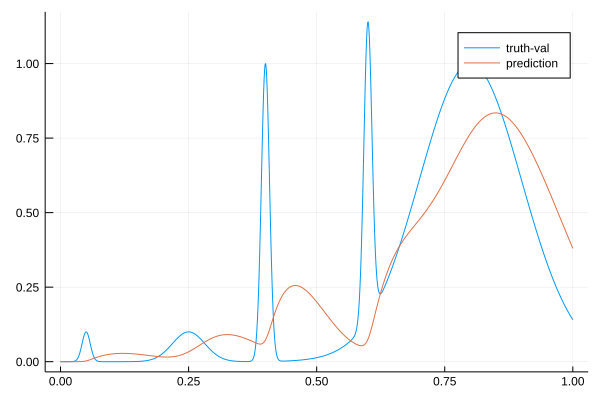

139.39535606406517 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.80141644206156 
  15.419056104596947
  18.628679967052655
  18.173482304164516
 -17.498471673875777
   0.1              

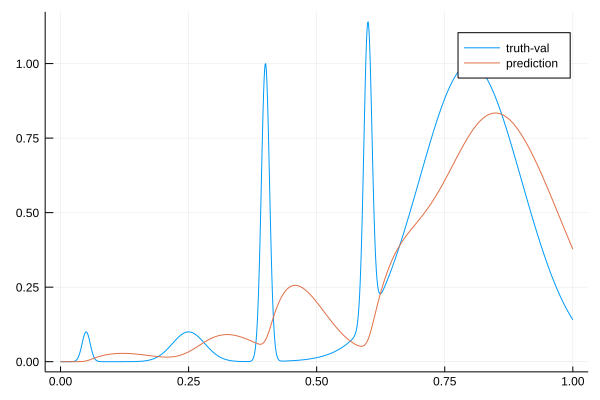

139.18926252141827 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.832285999309146
  15.544474719653621
  18.65299433257435 
  18.2959783107309  
 -17.518932715222245
   0.1              

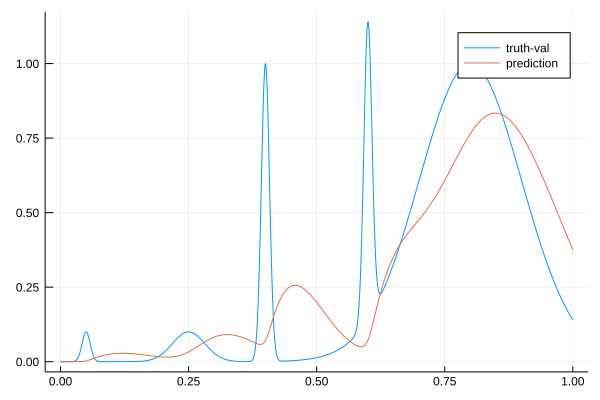

138.98436211135282 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.864790719873643
  15.6679660604606  
  18.67579011852245 
  18.417010839887404
 -17.538104761145156
   0.1              

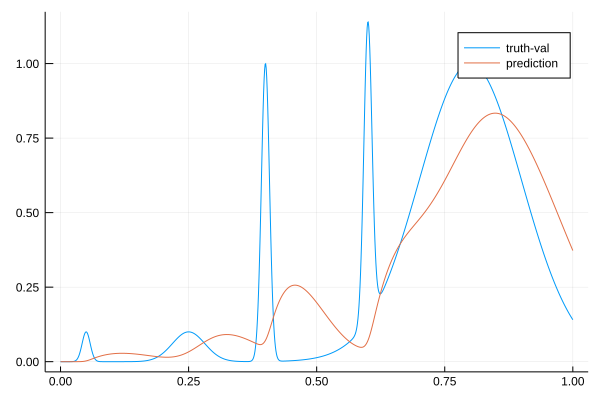

138.79143506217264 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.895572463642946
  15.789575047458793
  18.69713970514298 
  18.536218556871656
 -17.5561514474036  
   0.1              

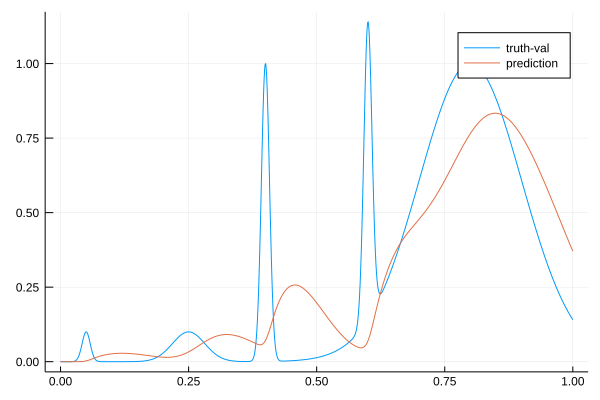

138.6038228563491 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.9248877793829  
  15.909430006140576
  18.71709494369439 
  18.653747748951893
 -17.573121616080094
   0.1              

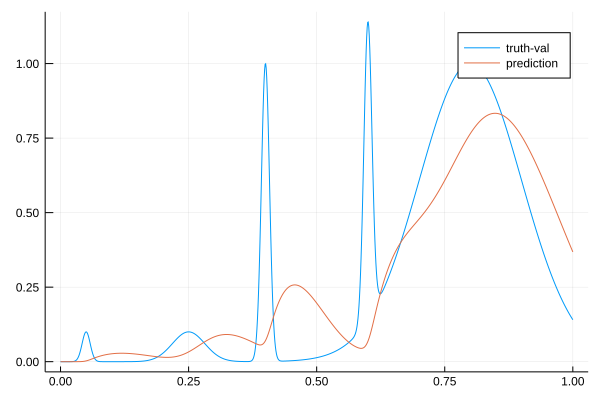

138.422689226709 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.9493246428605  
  16.027583890878276
  18.735722733912866
  18.76925352502552 
 -17.589185329062392
   0.1              

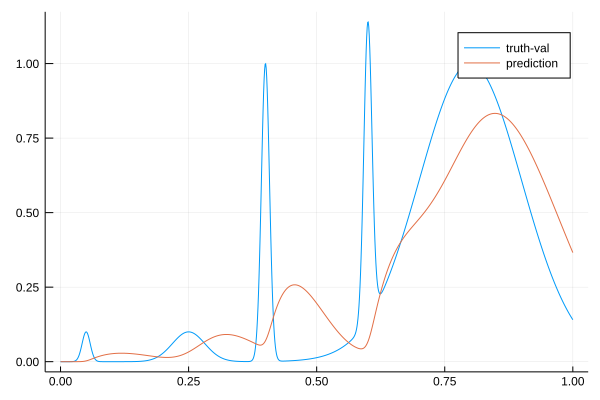

138.24836922457678 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.96989141819816 
  16.1439500582456  
  18.753043360456942
  18.882765699717616
 -17.60438895005664 
   0.1              

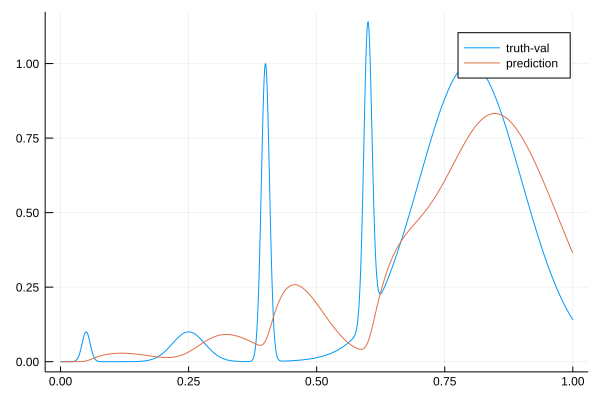

138.08244902040138 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.98285433020641 
  16.258792980491357
  18.76914969030365 
  18.994119181547422
 -17.61887932379089 
   0.1              

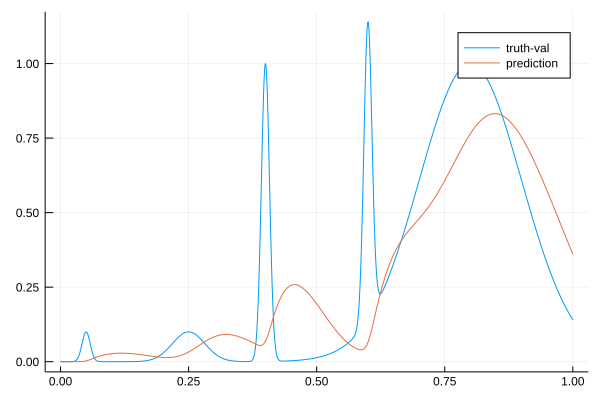

137.91163757006296 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.995870772923528
  16.371617479725526
  18.78377472884535 
  19.10369730604657 
 -17.63238304154047 
   0.1              

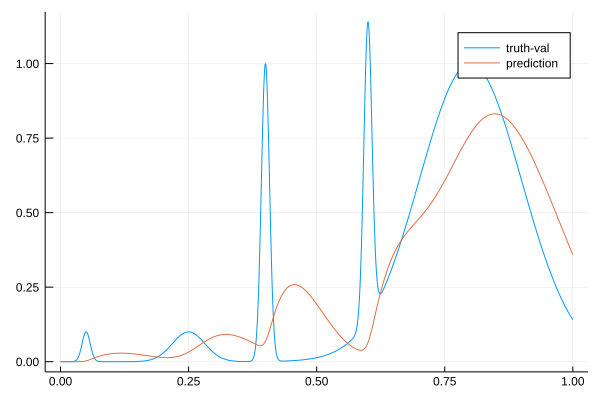

137.75888589046534 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.00967428648281 
  16.48233865986215 
  18.796958469139973
  19.211490152789906
 -17.644953958092426
   0.1              

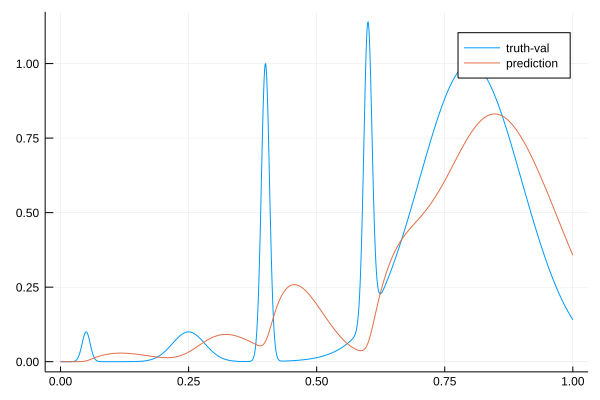

137.61206229323568 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.02000459565606 
  16.591256452657774
  18.808815146194142
  19.31730255285644 
 -17.656764641723527
   0.1              

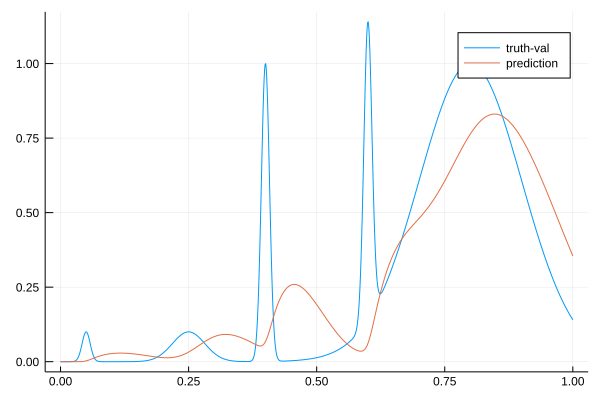

137.4721415407542 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.02752410500881 
  16.6982969575211  
  18.819376788054072
  19.421132730761062
 -17.667869077389497
   0.1              

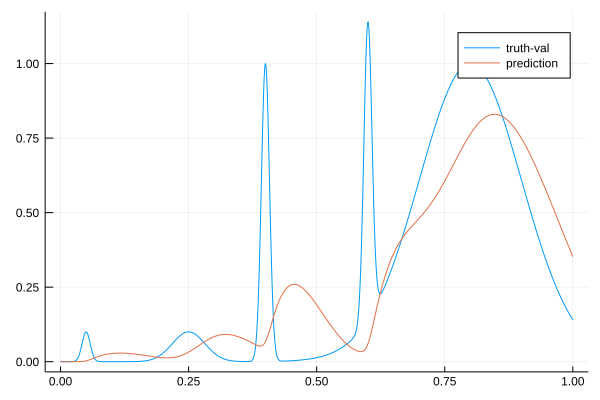

137.34179783446535 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.032575069582617
  16.80360675650296 
  18.828701702204437
  19.52315856562311 
 -17.678296860177127
   0.1              

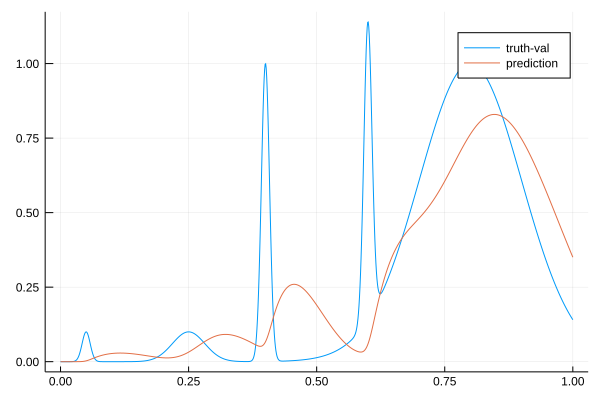

137.21300732473222 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.03584538603968 
  16.9071086837162  
  18.83681906087103 
  19.623375938708072
 -17.68809769126449 
   0.1              

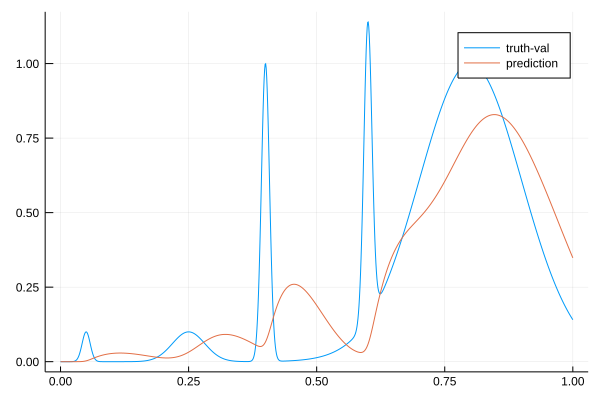

137.09163250676136 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.040187466068172
  17.00846264494672 
  18.843528059804658
  19.721760043412026
 -17.697154327700858
   0.1              

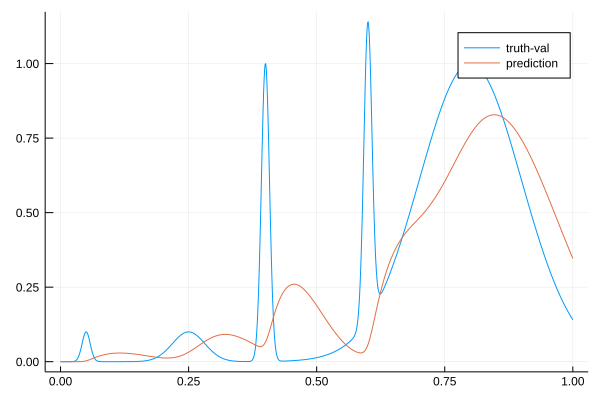

136.97325185473343 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.045729796758568
  17.107813674917328
  18.848902228175383
  19.818457643924383
 -17.7055012643225  
   0.1              

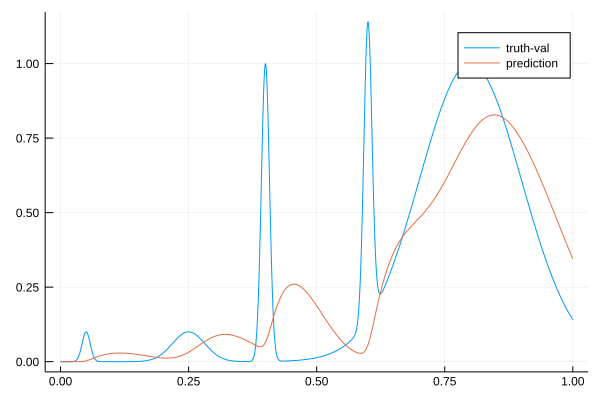

136.86002788486806 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.052029148249883
  17.205143457389255
  18.852985544324916
  19.9133927605218  
 -17.71321192979127 
   0.1              

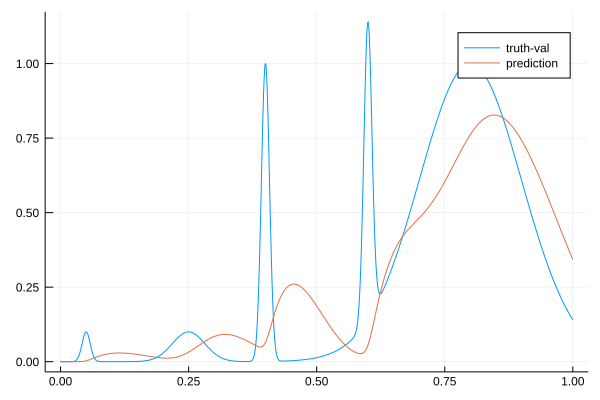

136.7512522916231 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.05908661350749 
  17.30062093351249 
  18.85584543503569 
  20.006722861910415
 -17.720324398057983
   0.1              

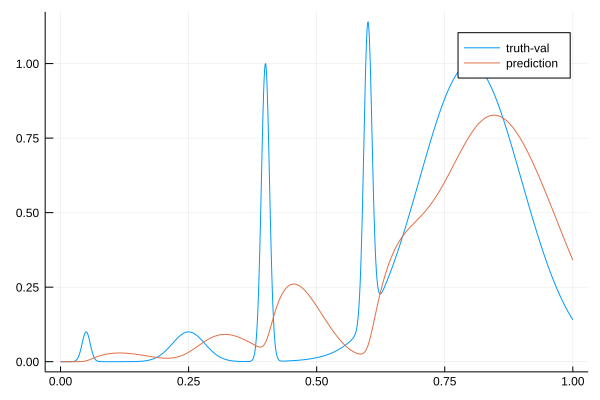

136.6474497689083 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.062736942097814
  17.3943135972556  
  18.857568836472392
  20.098053589326437
 -17.72704470401092 
   0.1              

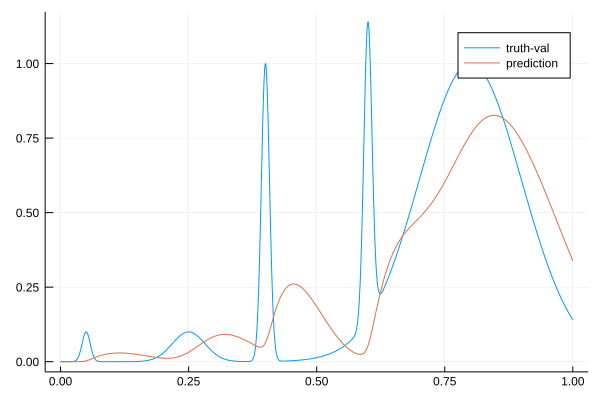

136.5466162488335 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.063352618349082
  17.48636809533945 
  18.858211317022363
  20.187566964646678
 -17.733391595838782
   0.1              

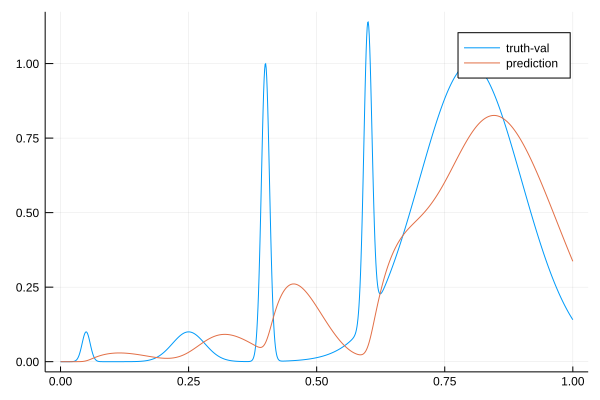

136.45099704702204 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.06163504009756 
  17.57670061907064 
  18.857798898246532
  20.275252633328485
 -17.739406133384236
   0.1              

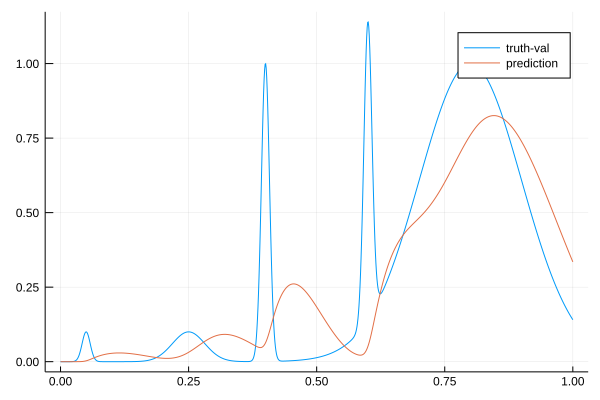

136.35929069568712 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.06481851732971 
  17.665000726041622
  18.85610113559416 
  20.36157845634158 
 -17.744791197900465
   0.1              

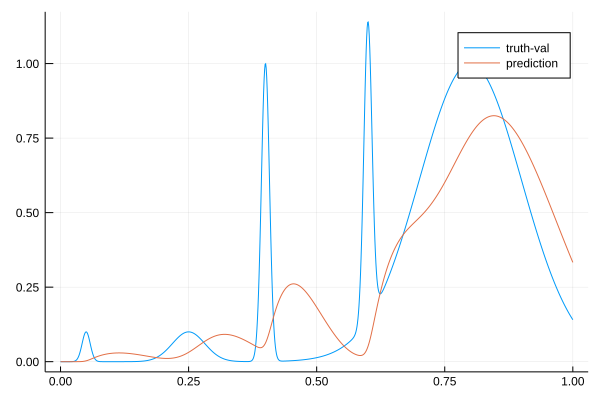

136.2731795148761 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.06822349415049 
  17.75135603683217 
  18.853220488347134
  20.44611794021595 
 -17.74977559890447 
   0.1              

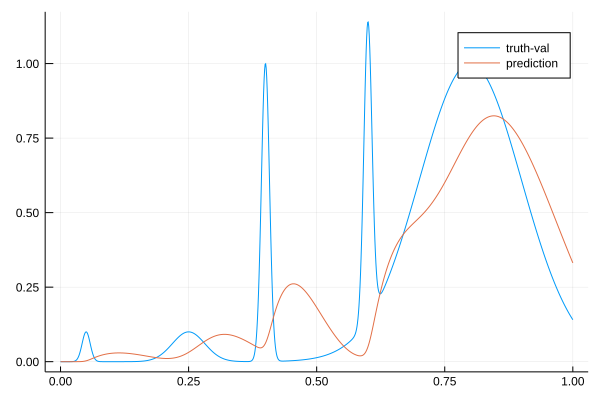

136.18918765138812 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.069085620322802
  17.836037687921294
  18.849226113205134
  20.528836854542266
 -17.754345085110817
   0.1              

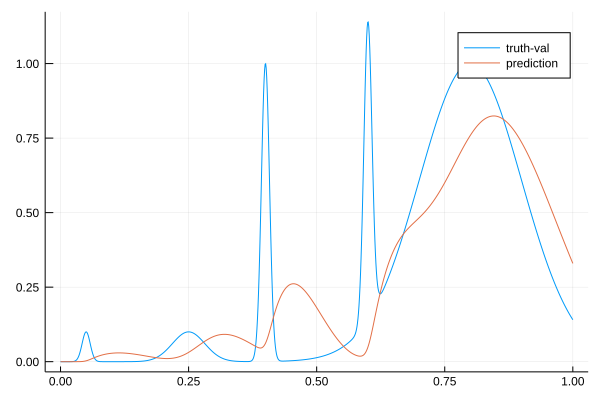

136.1093008766323 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.067689197084277
  17.919184438706033
  18.844178400033247
  20.609899467197877
 -17.758529409832313
   0.1              

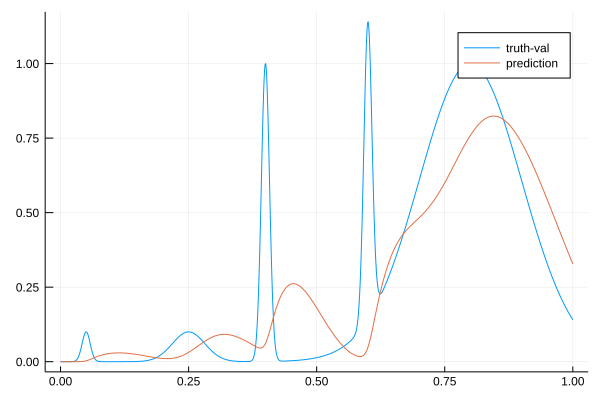

136.03022528486548 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.06463300321158 
  18.000702440609423
  18.83810793251752 
  20.689272979967985
 -17.76238178806943 
   0.1              

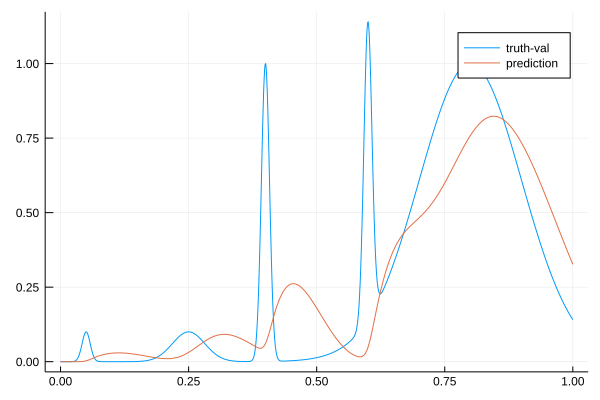

135.9581557120155 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.06013023524856 
  18.080728478039298
  18.831069290941368
  20.767111816365354
 -17.765925930705972
   0.1              

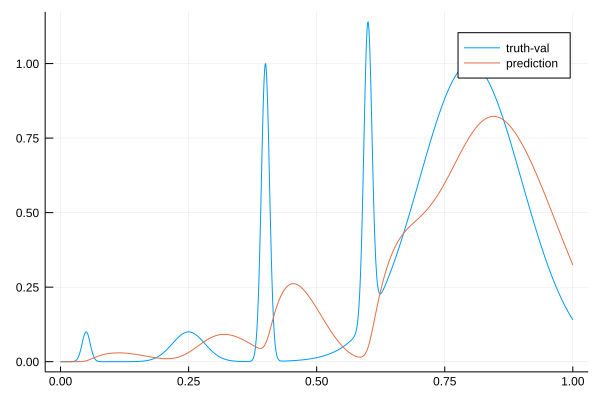

135.88872294215167 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.054844126971865
  18.159131017190592
  18.82308709149904 
  20.84335175866654 
 -17.769205330666665
   0.1              

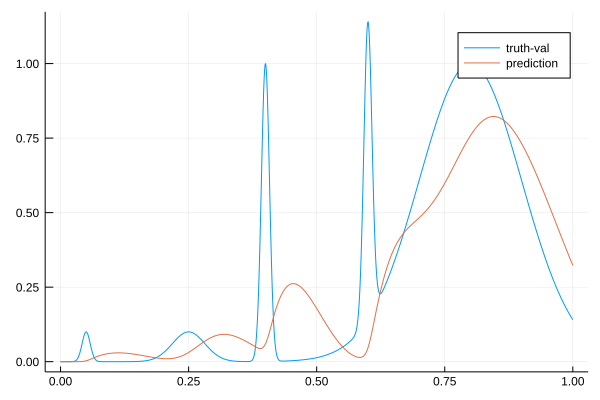

135.8212766336616 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.051114012005648
  18.235745600465975
  18.8139876682691  
  20.91807155188299 
 -17.7721049820576  
   0.1              

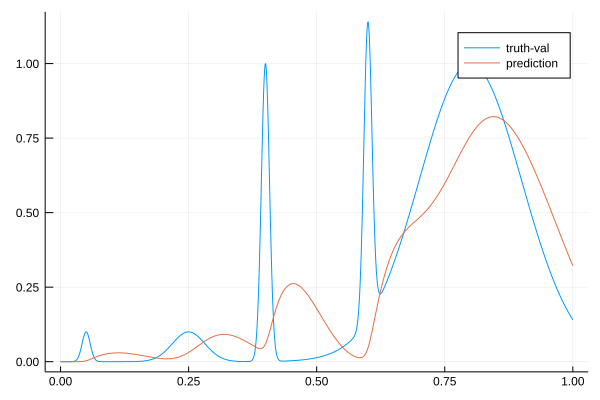

135.75744771677958 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.04917355882367 
  18.310503412289506
  18.803812946795393
  20.99122143851944 
 -17.774683991936403
   0.1              

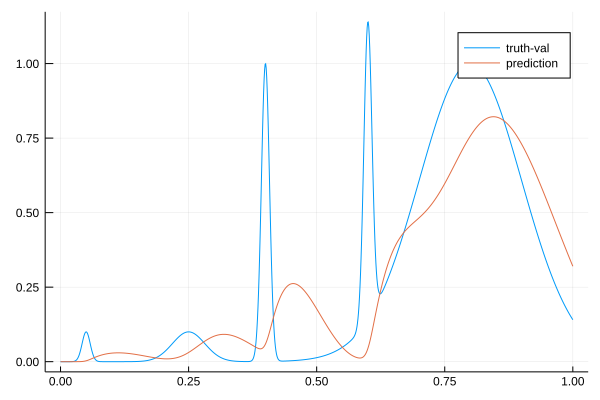

135.69500375500792 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.048897677412963
  18.383566805433276
  18.79262696813465 
  21.062943288315726
 -17.776971600228155
   0.1              

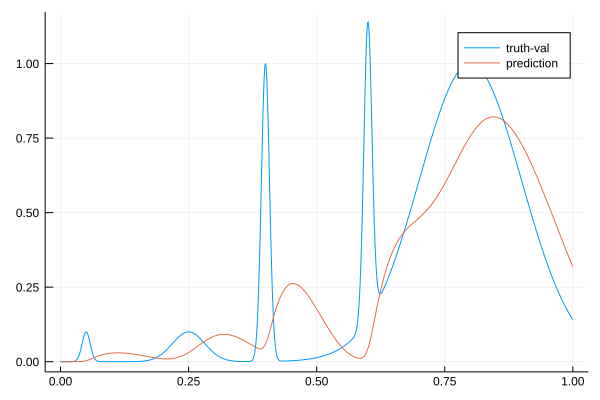

135.63483578093465 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.050174433078798
  18.455083359589487
  18.78048814210097 
  21.13336610502336 
 -17.778994989609494
   0.1              

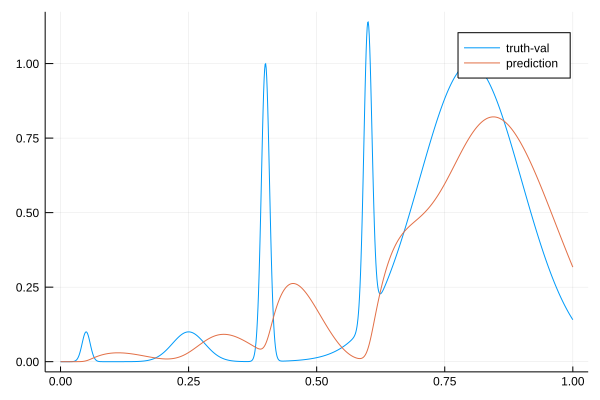

135.57699904425542 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.053222724589254
  18.52496260366598 
  18.767424747870255
  21.20241743881259 
 -17.780806877087127
   0.1              

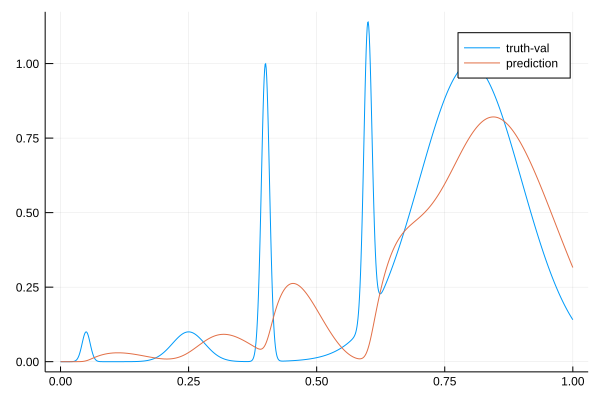

135.52124822107447 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.057914835841654
  18.593348955468713
  18.75348813243756 
  21.270222026494793
 -17.78242947337507 
   0.1              

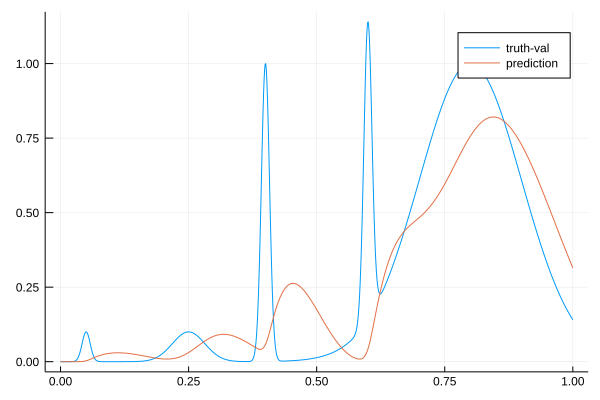

135.46837568281342 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.05934613451886 
  18.6604749901191  
  18.738786442485313
  21.336499256519204
 -17.784065635038527
   0.1              

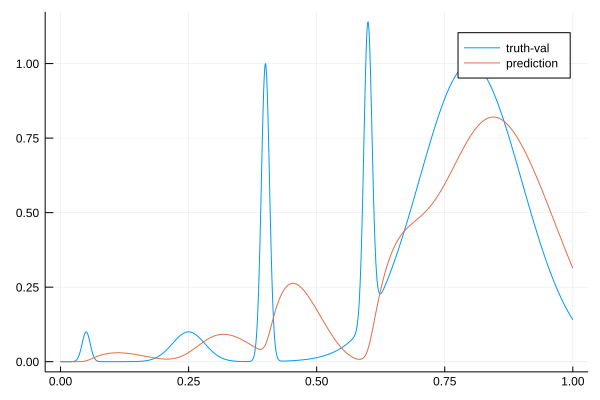

135.4173167771327 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.0581732156716  
  18.72622288293628 
  18.7233326995627  
  21.401197561163013
 -17.785745939149173
   0.1              

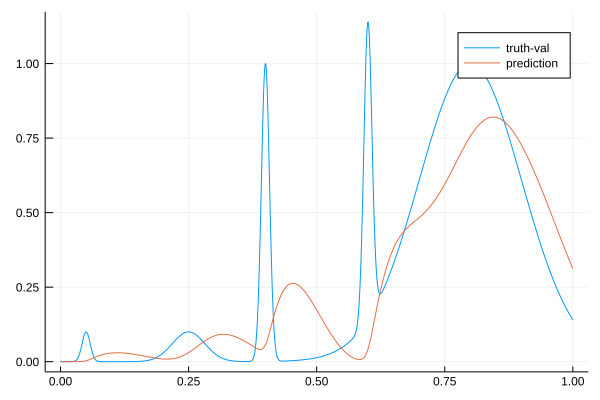

135.36764391927966 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.054681009749537
  18.790713571061605
  18.70716510149514 
  21.4644646503213  
 -17.787470572886985
   0.1              

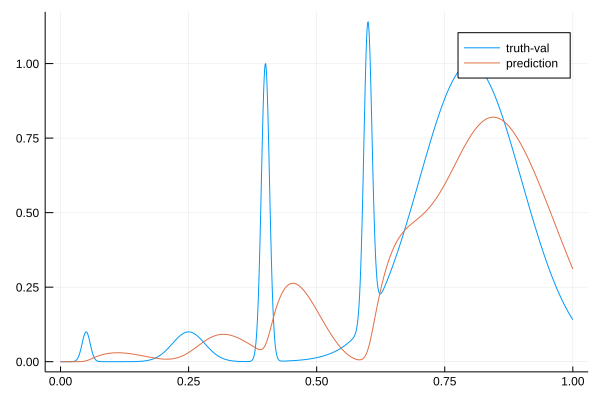

135.3202525282711 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.056416669394785
  18.853601701833682
  18.690036253810227
  21.526728955055543
 -17.788931414842068
   0.1              

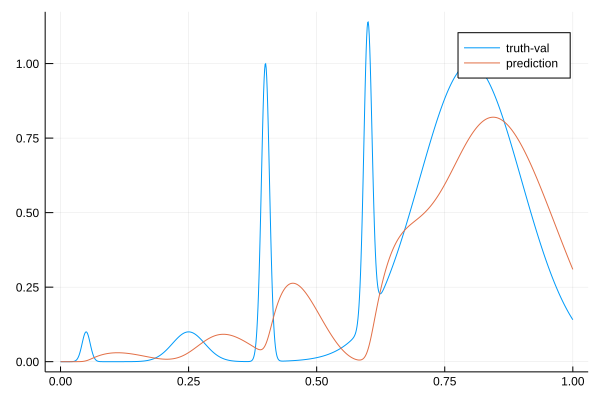

135.27524108504045 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.063236895233548
  18.914801674058513
  18.671980216717387
  21.58788565885155 
 -17.790187748856926
   0.1              

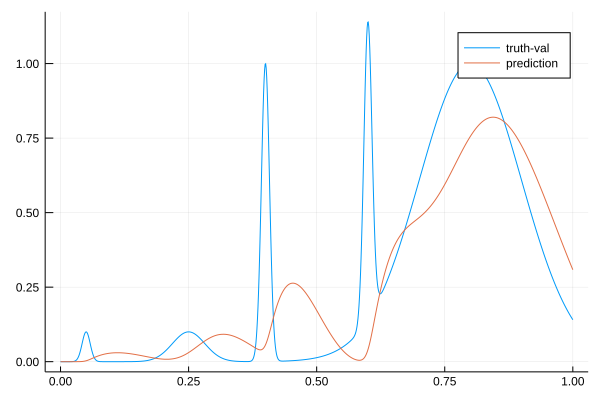

135.23159901864742 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.07522639992485 
  18.974366078794272
  18.65304665613005 
  21.64799118299097 
 -17.791250090621627
   0.1              

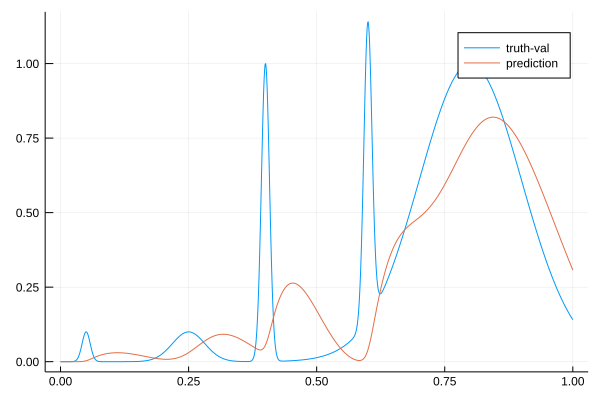

135.19018785571967 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.08686330731991 
  19.032585606816713
  18.633352154487735
  21.706764300662172
 -17.792345659743447
   0.1              

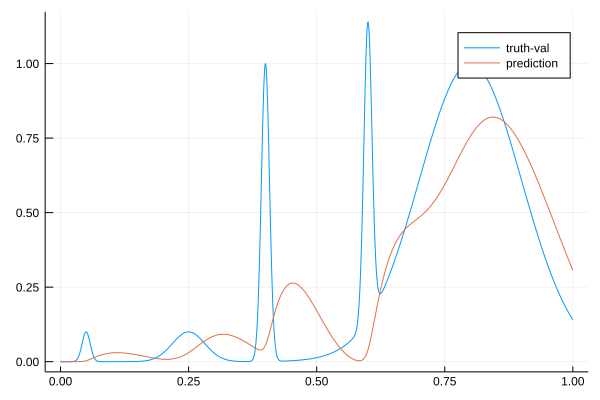

135.15136734135385 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.09850268065973 
  19.089350286366606
  18.61291179515202 
  21.764128836183932
 -17.793510742215524
   0.1              

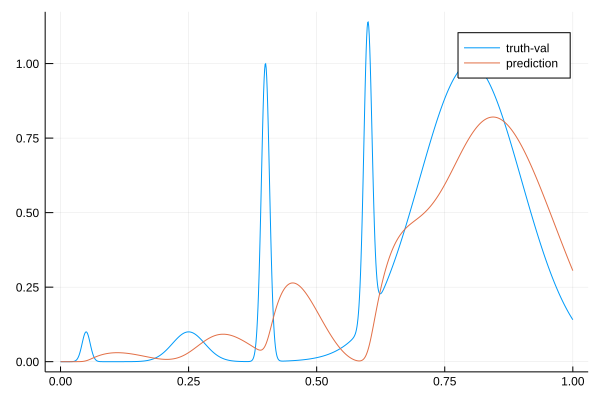

135.1120065858969 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.110305116012682
  19.144756724087813
  18.591764320447673
  21.82019447121074 
 -17.794746755948747
   0.1              

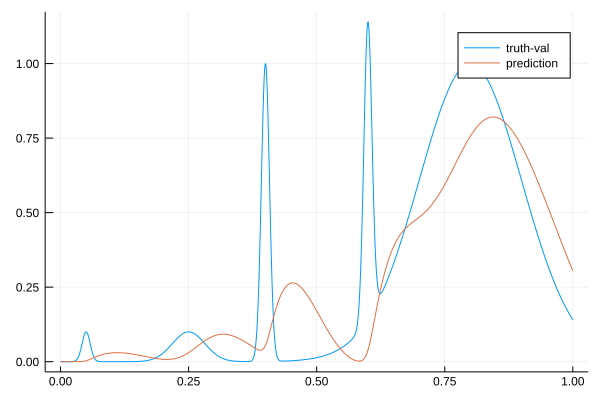

135.0734622150076 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.122286010421924
  19.19892990993756 
  18.569946127310637
  21.875084509551343
 -17.796058617423007
   0.1              

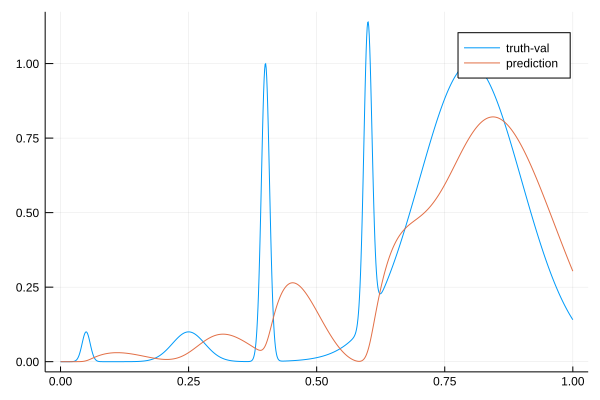

135.0365540241189 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.134461205692144
  19.2519826459547  
  18.54749048074892 
  21.928910362274372
 -17.797450481034353
   0.1              

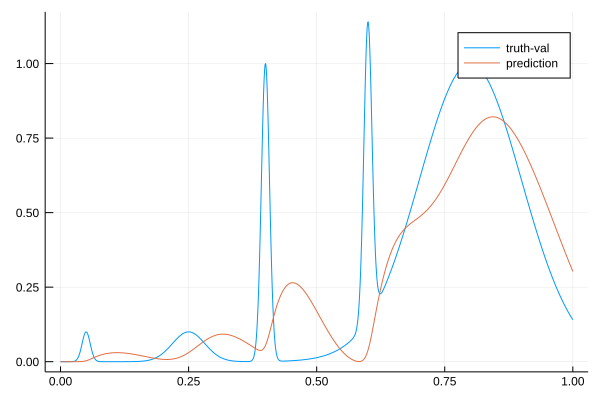

135.00180947254148 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.147137686568247
  19.30378275655966 
  18.524402803576866
  21.981568977204727
 -17.79895612031819 
   0.1              

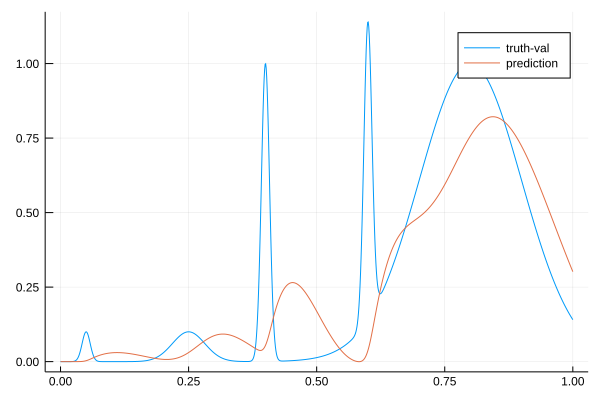

134.96760679248814 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.14754596036643 
  19.355068311079446
  18.5010724756613  
  22.03250343843568 
 -17.80110236583857 
   0.1              

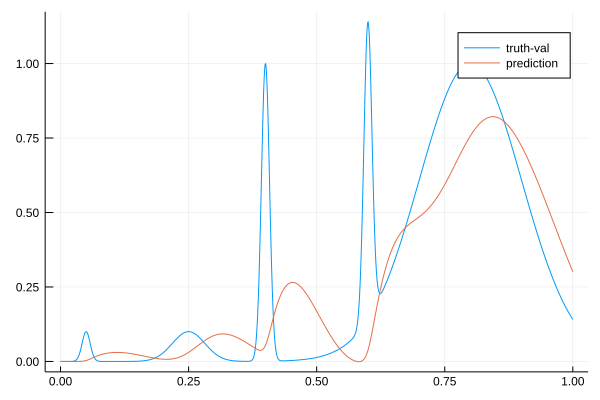

134.93420051606512 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.144476715695234
  19.405408132365196
  18.477207304977643
  22.082171436188577
 -17.803525533595074
   0.1              

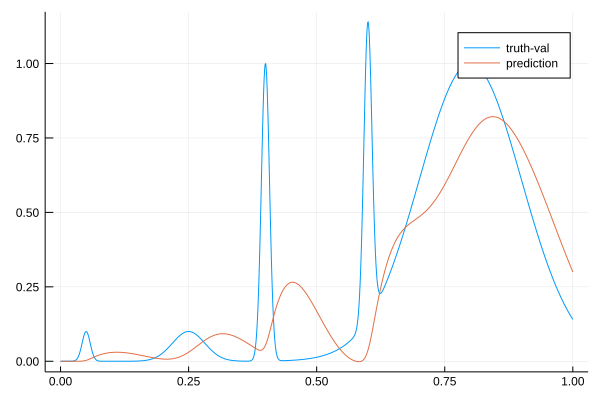

134.90218908224094 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.138321743564582
  19.45488800226331 
  18.452832859615075
  22.13069790632688 
 -17.806208510329743
   0.1              

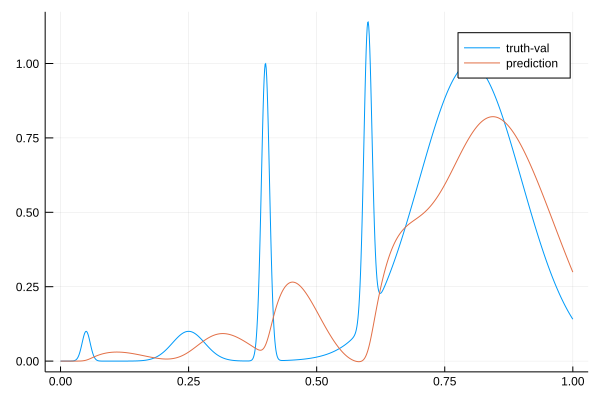

134.87141339060767 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.129728643551957
  19.50334829673596 
  18.427948227191358
  22.177988165358578
 -17.809165614213676
   0.1              

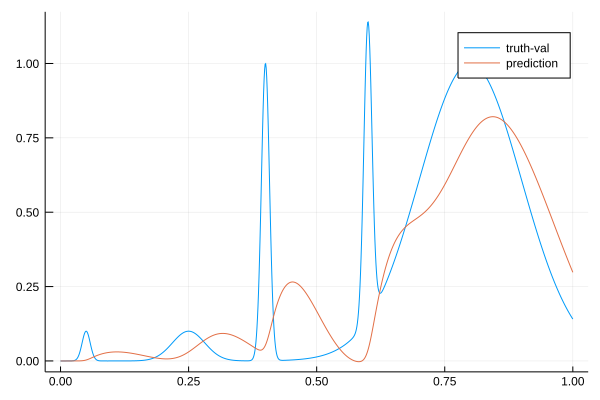

134.84136240327402 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.119000885675053
  19.550882341064035
  18.402578764097495
  22.224165652344375
 -17.812379012152846
   0.1              

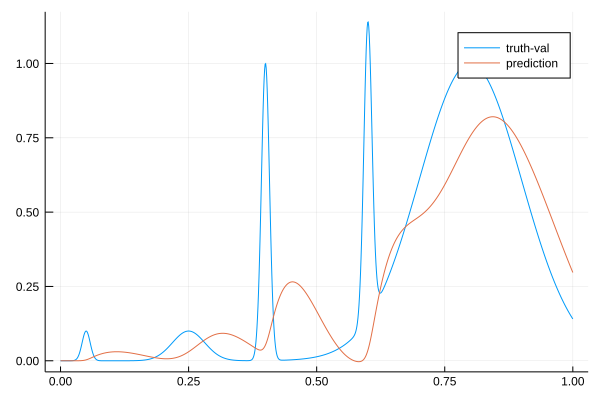

134.81144460625003 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.106419281497395
  19.597574602011168
  18.376748221415216
  22.269342690962223
 -17.815831827578812
   0.1              

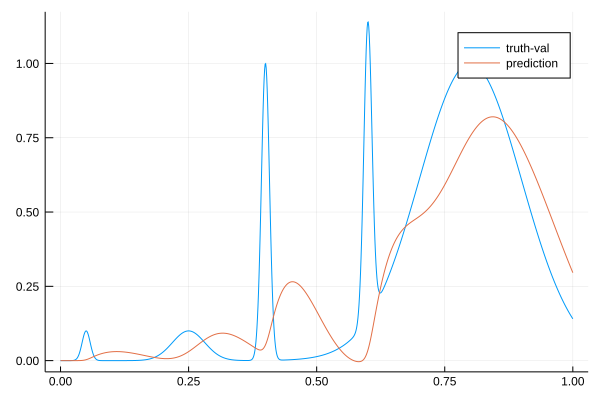

134.78125444285644 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0             
   0.001           
   0.001           
  25.09238707709783
  19.64346418199688
  18.35047820108062
  22.31359850146898
 -17.81950564082825
   0.1             

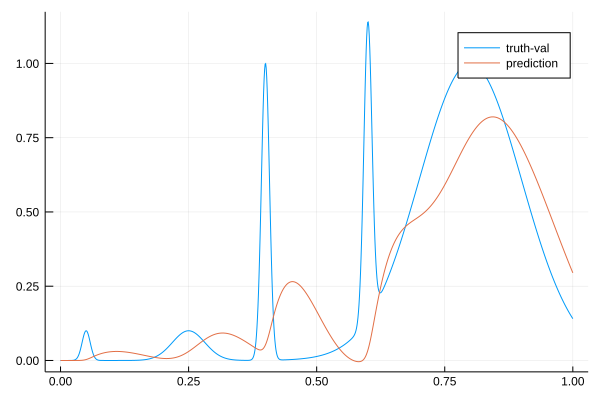

134.75268225179943 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.077426331844123
  19.688384543567373
  18.323764547551715
  22.356818037249294
 -17.823416676144554
   0.1              

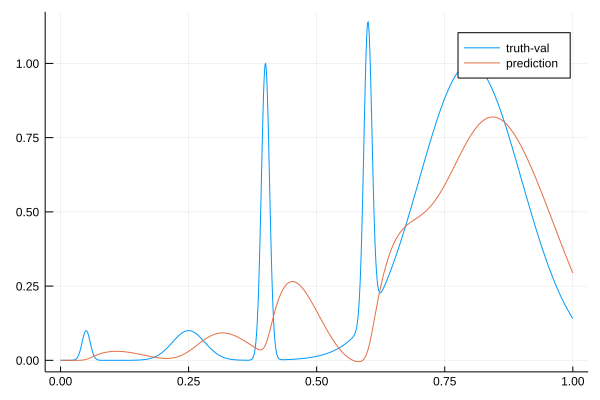

134.72459032319148 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.06172564030667 
  19.732425327858518
  18.29662933827594 
  22.39910927137997 
 -17.82754876715968 
   0.1              

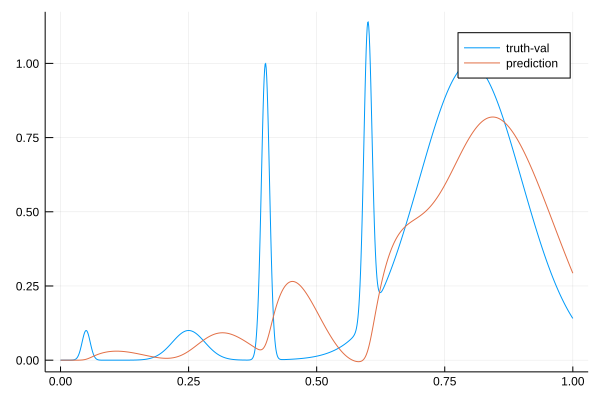

134.69519140446886 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.045460072717766
  19.775667747104134
  18.269093028896066
  22.440570370126547
 -17.831886851705352
   0.1              

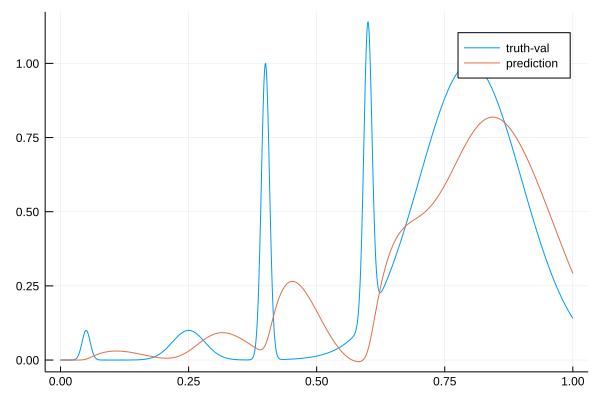

134.66849475437152 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.028795918331845
  19.818184749005844
  18.241173815427253
  22.481290324685713
 -17.836416190833578
   0.1              

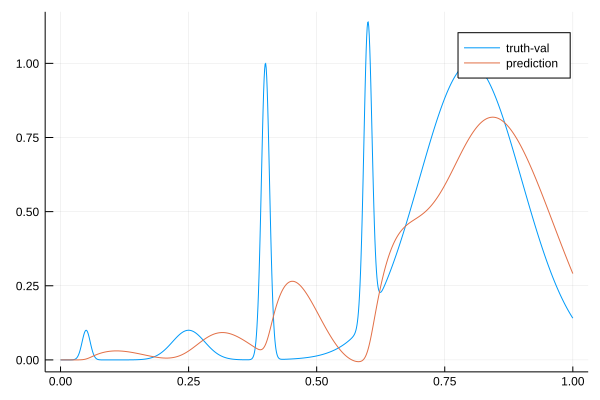

134.6429539817077 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.0197325390515  
  19.859546417842125
  18.21259627575735 
  22.52162982166712 
 -17.840808999740286
   0.1              

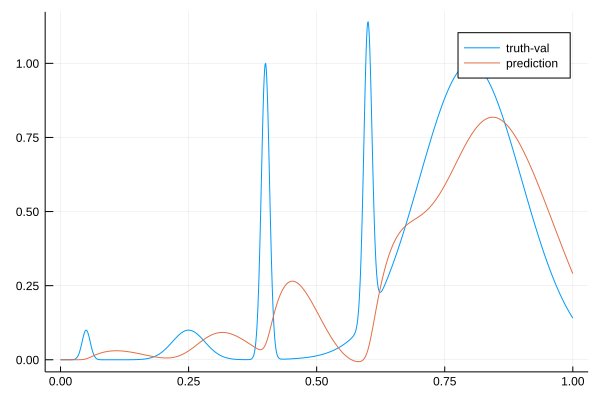

134.61868086177392 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.014696322651556
  19.899673329599935
  18.183375199815927
  22.561153477384554
 -17.845070168453727
   0.1              

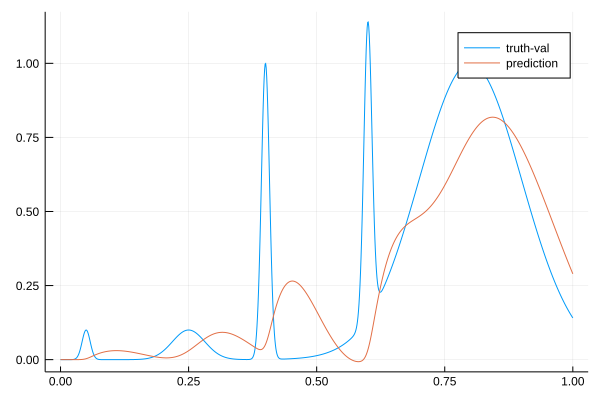

134.59350528567265 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.01339500045645 
  19.938680589985516
  18.153551164091155
  22.59994552313754 
 -17.849221027213755
   0.1              

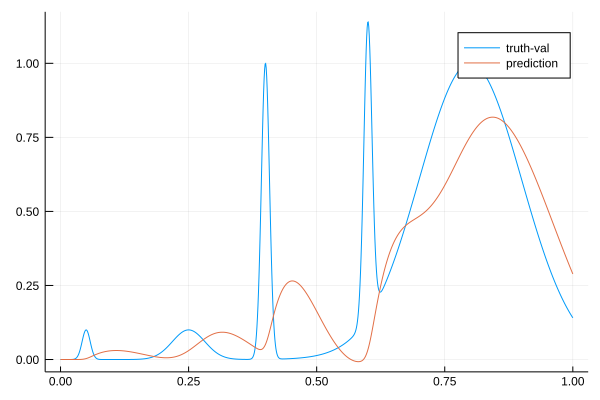

134.56919225998712 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.015564425968897
  19.976673101872006
  18.123160056289628
  22.63808292824755 
 -17.85328113161197 
   0.1              

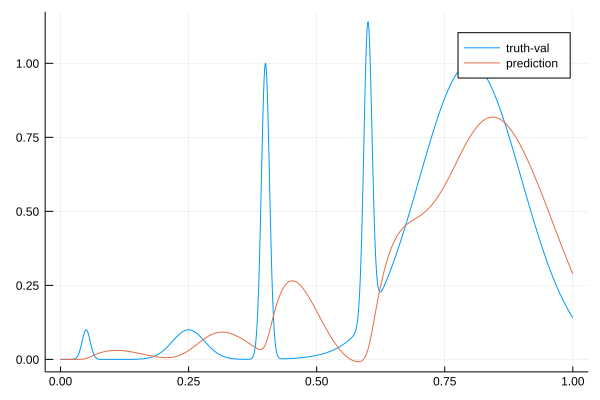

134.54543193857512 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.02095737234749 
  20.013746014364934
  18.09223387909816 
  22.67563473167894 
 -17.85726879709501 
   0.1              

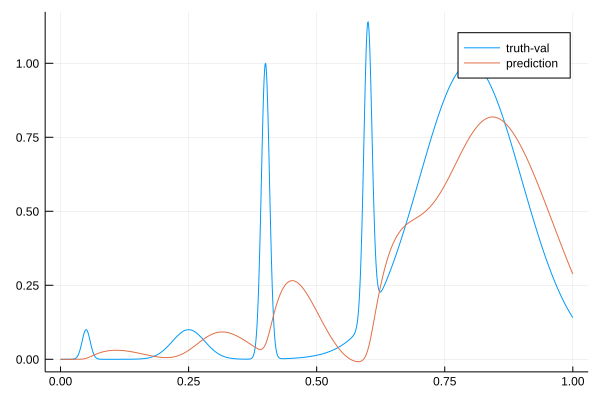

134.5214036304832 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.029342671147035
  20.0499855948287  
  18.06080100468889 
  22.71266282086249 
 -17.861201275012007
   0.1              

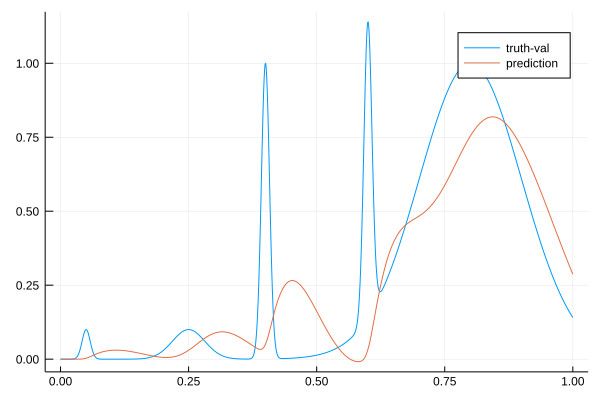

134.49971552097028 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.035125162051767
  20.08559473355444 
  18.02896549686651 
  22.748817631314875
 -17.865332586932325
   0.1              

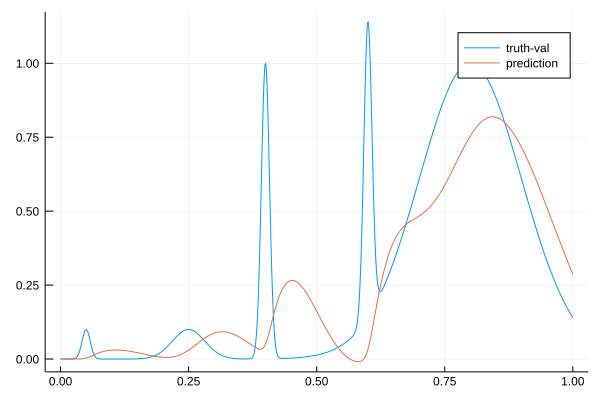

134.47742702954628 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.038909187099836
  20.120386235626338
  17.99671910589881 
  22.783970038475033
 -17.86968792431437 
   0.1              

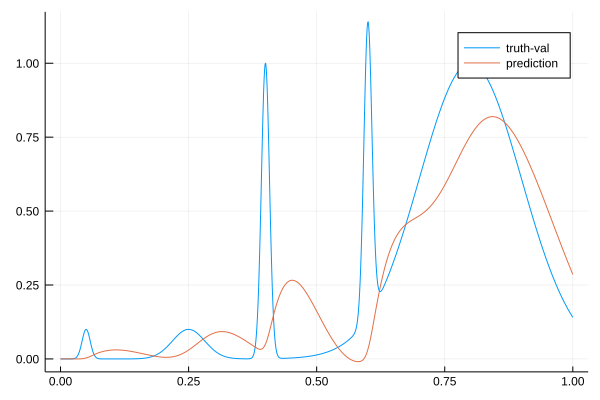

134.4552971932887 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.04097451538752 
  20.15443836423325 
  17.964080130582705
  22.818225438340452
 -17.874256490515354
   0.1              

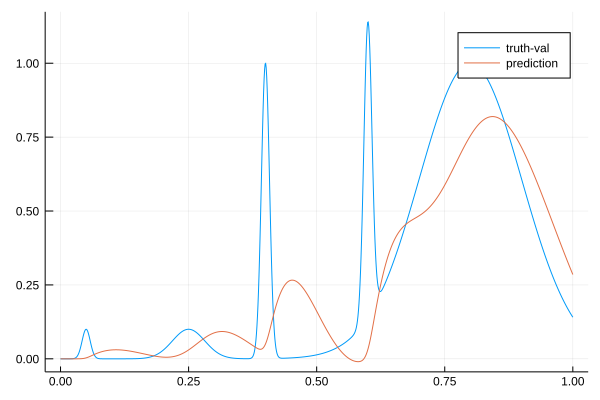

134.43341095497902 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.041580530887533
  20.187821889321018
  17.93106562056962 
  22.851679747210177
 -17.87902757478551 
   0.1              

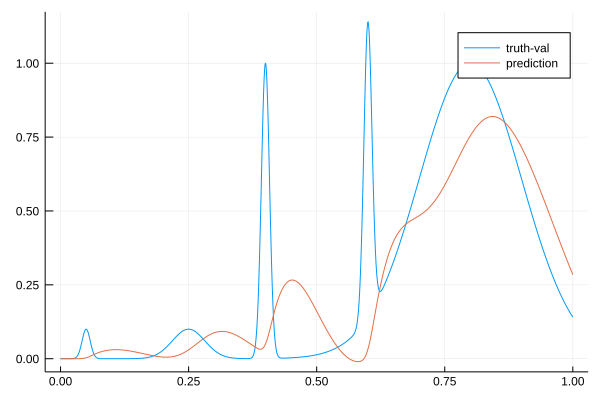

134.41139560105887 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.032856494916356
  20.221118281276198
  17.897991914360016
  22.884142873482695
 -17.88431005503504 
   0.1              

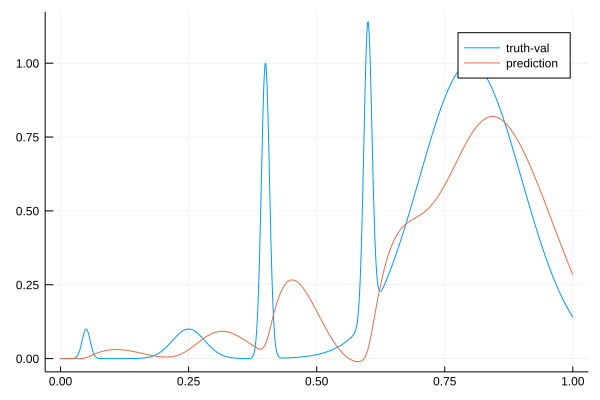

134.3894755231331 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.02394925449403 
  20.2538167339147  
  17.86454574655817 
  22.916000425053948
 -17.889741187852998
   0.1              

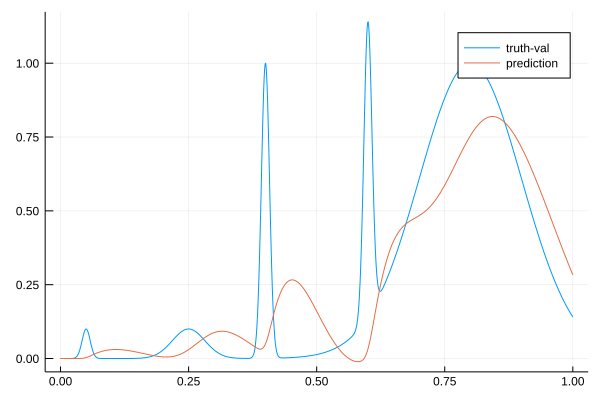

134.36761397253338 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.015006600009674
  20.285974128584833
  17.830745309857257
  22.947323574216437
 -17.8953124236164  
   0.1              

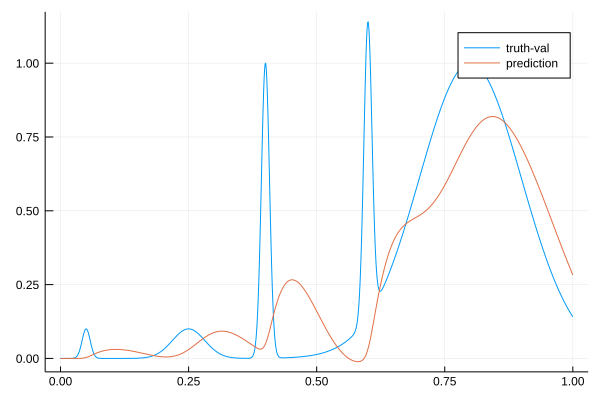

134.3460059200612 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.006165707248314
  20.31764203941663 
  17.796607211298944
  22.978177097502243
 -17.901015705323825
   0.1              

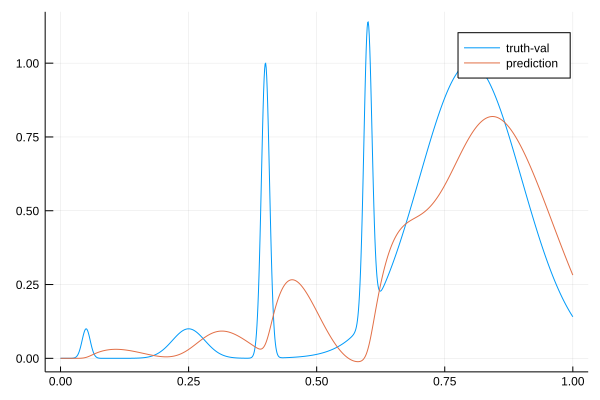

134.32524330838731 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.99782702357269 
  20.348615396237587
  17.762120856955466
  23.00839336941605 
 -17.9068767924789  
   0.1              

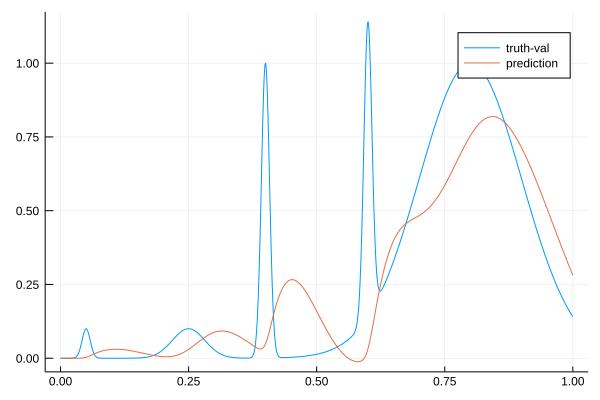

134.29988562045926 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.990077321344494
  20.378960850412188
  17.727302600946185
  23.038047243506732
 -17.912885959182475
   0.1              

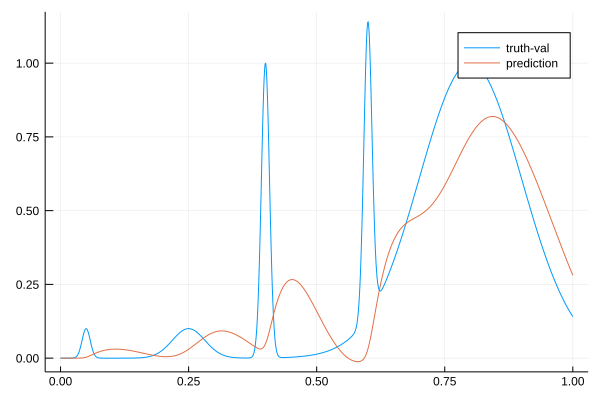

134.28248112241542 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.983036779185905
  20.408741260741508
  17.69216778062995 
  23.067213000362496
 -17.919034922258575
   0.1              

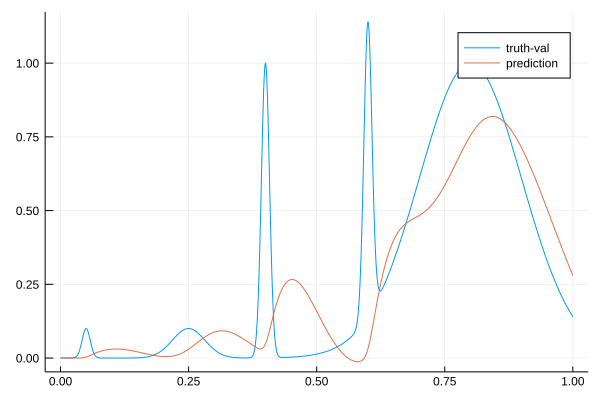

134.26202295024788 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.975777279228776
  20.438031649816754
  17.65673017309059 
  23.095875287601743
 -17.925329684838932
   0.1              

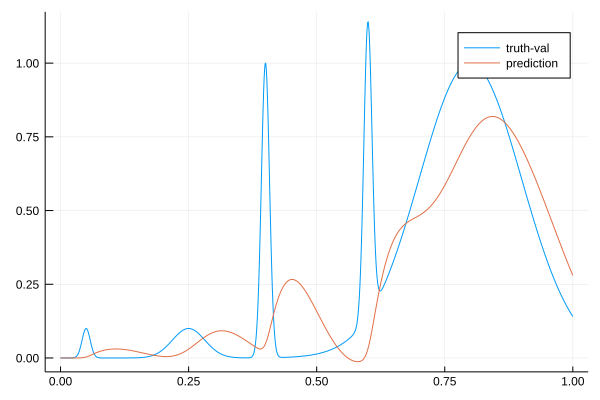

134.24150525161198 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.968459754813903
  20.46687950150643 
  17.62100201061369 
  23.12409707812245 
 -17.93176092738029 
   0.1              

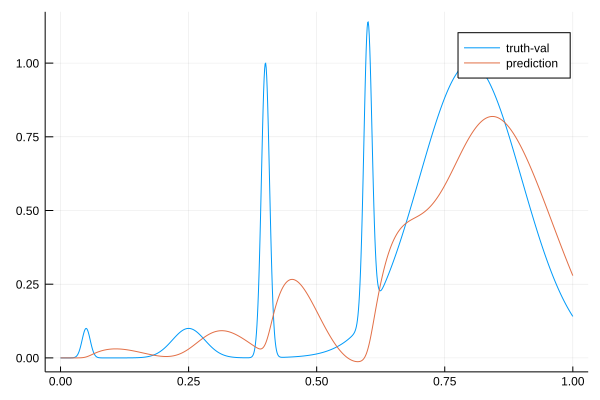

134.22113064802136 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.961365147912886
  20.49528810543297 
  17.584993845523005
  23.151908464504032
 -17.93831890698915 
   0.1              

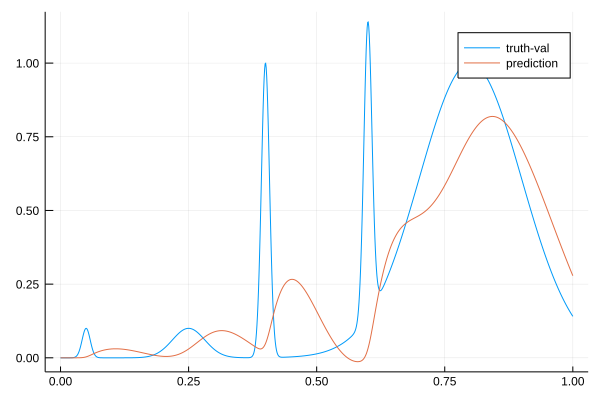

134.20104723293014 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.95461767670097 
  20.523300317000366
  17.548715914352346
  23.179364129023966
 -17.944995728560027
   0.1              

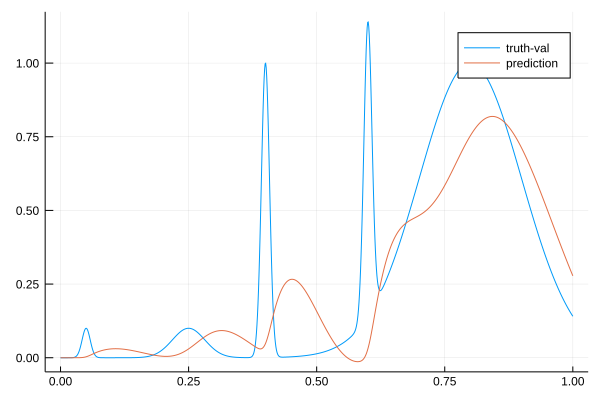

134.18154253321248 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.948605865297118
  20.55069829228555 
  17.512151735675555
  23.206281768863093
 -17.951818719506857
   0.1              

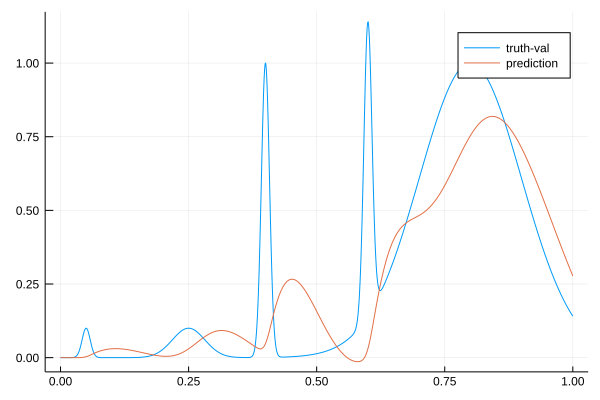

134.16205999474576 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.94340474063333 
  20.57754198877549 
  17.475312278310376
  23.232728408003165
 -17.95877831909472 
   0.1              

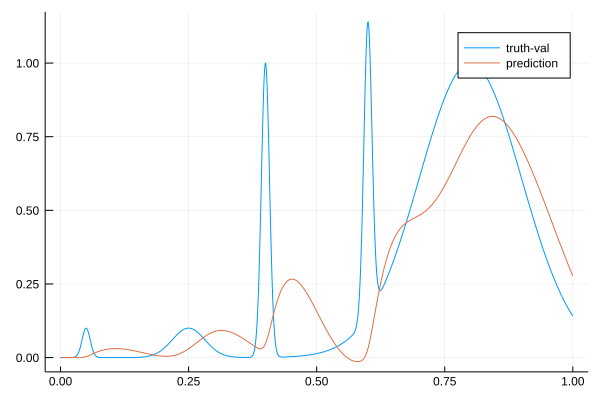

134.14258435291922 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.9390835176447  
  20.603885808167934
  17.438207417464923
  23.258764912391847
 -17.965865754420335
   0.1              

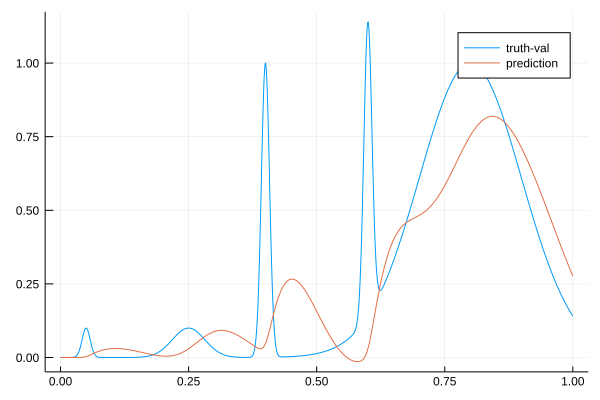

134.12310128558042 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.93570584742568 
  20.629779123899816
  17.400846004649864
  23.284446547661254
 -17.973073019249814
   0.1              

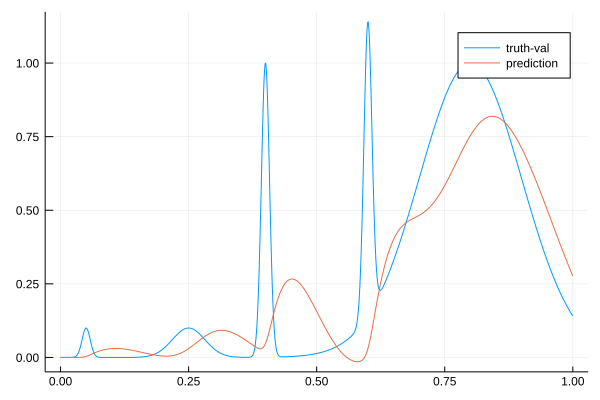

134.1035892378822 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.93333006615843 
  20.655266759345857
  17.363235933535844
  23.30982348731272 
 -17.980392850703915
   0.1              

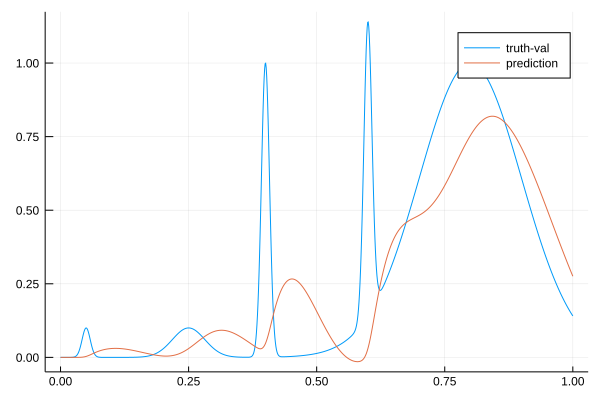

134.08403644620725 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.932009496457223
  20.680389424439554
  17.325384201244976
  23.33494128408377 
 -17.98781870101226 
   0.1              

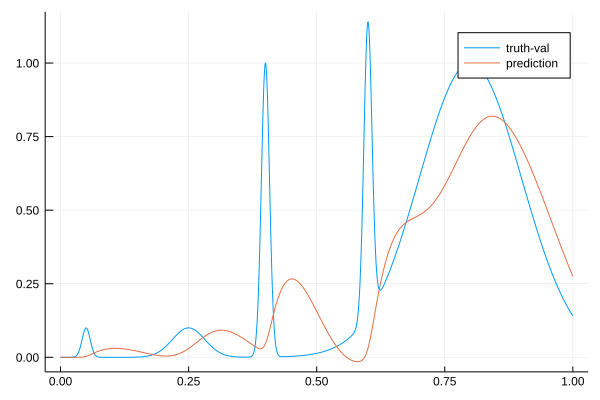

134.06443678020986 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.931792682530197
  20.705184107819765
  17.287296966814214
  23.359841290144473
 -17.995344711823247
   0.1              

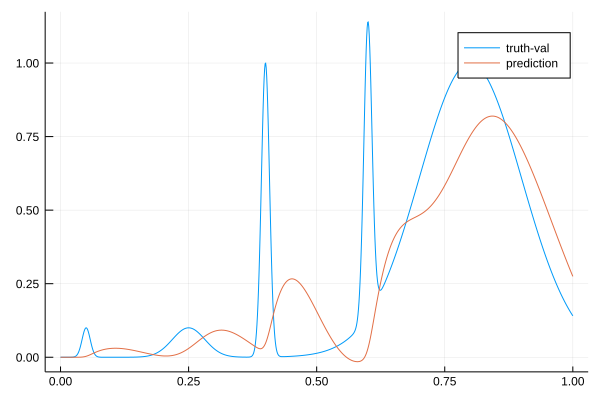

134.04477874527228 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.932723590370877
  20.729684430276272
  17.24897960657844 
  23.384561034928083
 -18.002965689554014
   0.1              

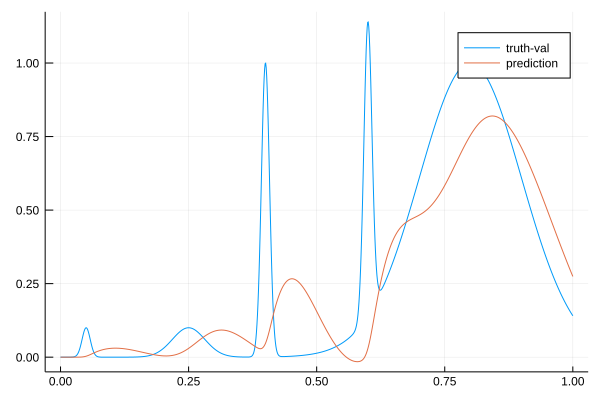

134.02510628157052 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.93484184766296 
  20.753920967385216
  17.21043676568892 
  23.409134575668805
 -18.010677077564665
   0.1              

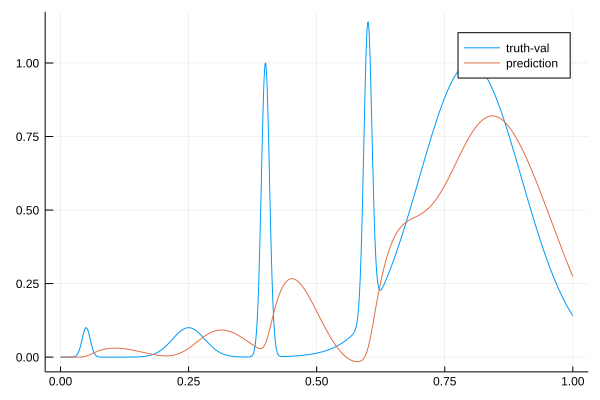

134.0064016643351 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.938459289416784
  20.77765855164086 
  17.171646222389885
  23.433354187363673
 -18.018510746495803
   0.1              

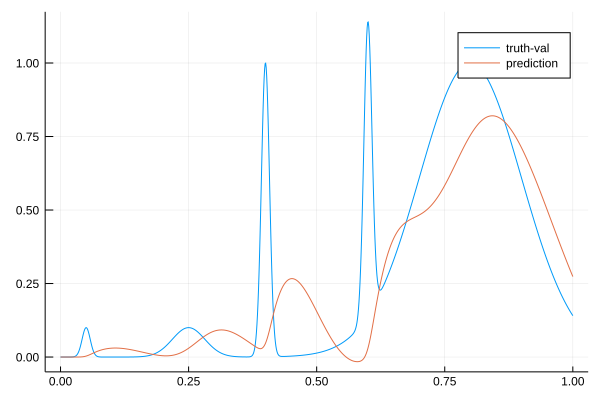

133.98767958520318 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.93753999884403 
  20.801131707075733
  17.132703711716125
  23.4568795507714  
 -18.026731202052726
   0.1              

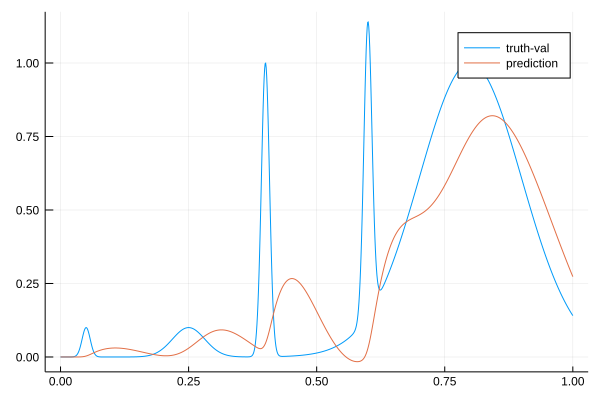

133.96885290775379 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.93267344033774 
  20.8243686697832  
  17.09360741895945 
  23.47979531088199 
 -18.035305501222833
   0.1              

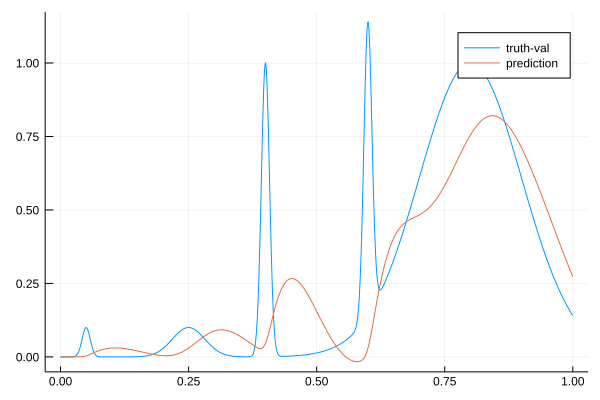

133.949934647356 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.924405185922154
  20.847394800998813
  17.054356872526704
  23.5021791528447  
 -18.044202305534345
   0.1              

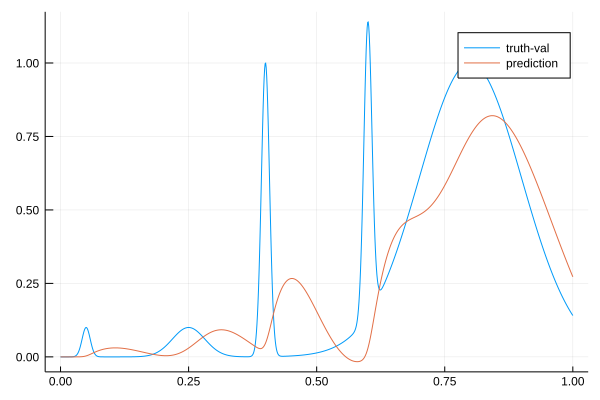

133.93093688579583 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.913239738394633
  20.870232889103793
  17.014952669932857
  23.5241023356078  
 -18.0533919223857  
   0.1              

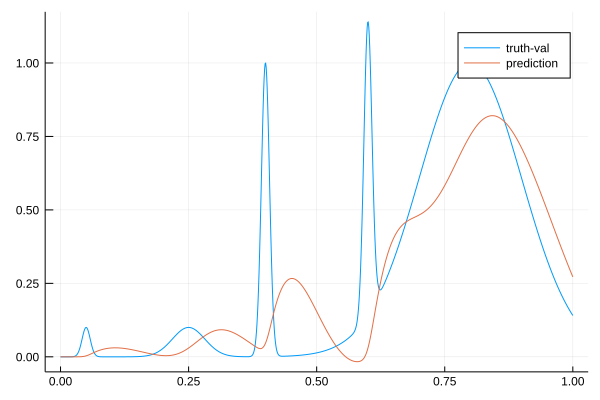

133.91189079830994 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.899643196707256
  20.892903422051024
  16.975396240107543
  23.545630185273744
 -18.062846329313796
   0.1              

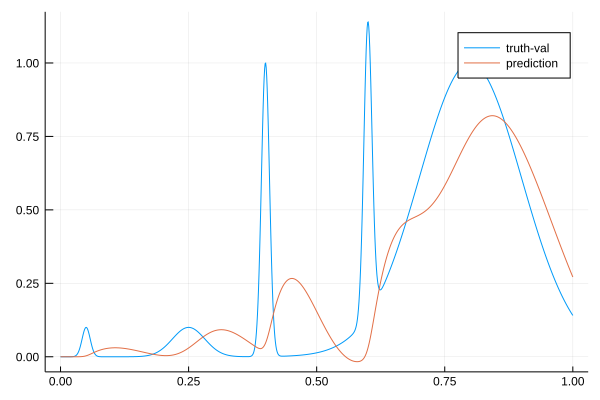

133.89288154232207 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.884174498999364
  20.915383619059167
  16.935689017264973
  23.566793215935345
 -18.072538910219894
   0.1              

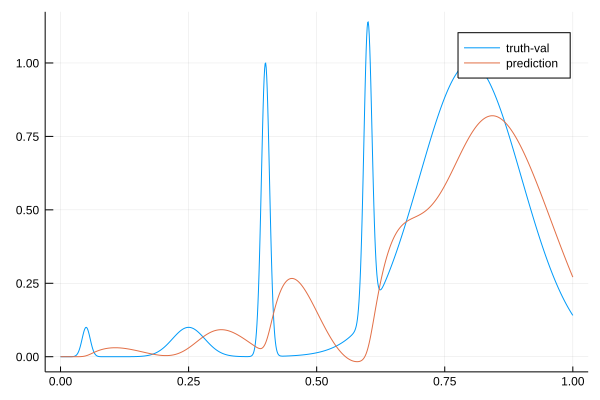

133.87383142389345 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.86721697283669 
  20.937694074613493
  16.89583354428264 
  23.587648959919225
 -18.08244510520427 
   0.1              

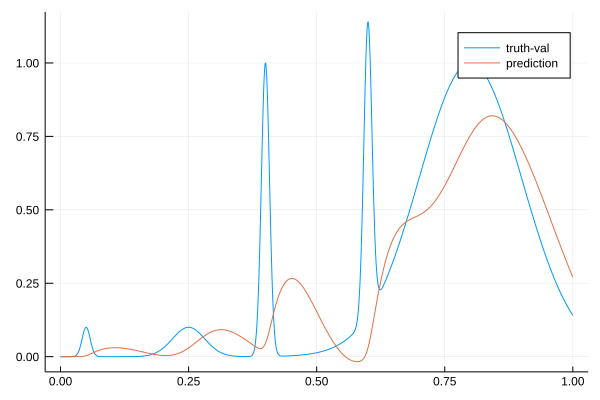

133.85475281685055 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.849123689936928
  20.95985337828615 
  16.855832636566802
  23.60825000882362 
 -18.092542017312343
   0.1              

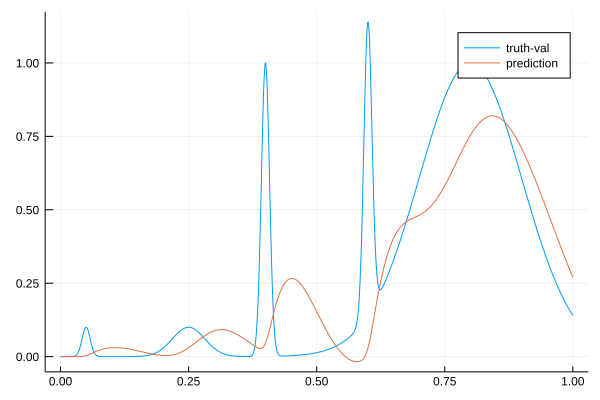

133.83590590827728 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.830219432422194
  20.98187831910482 
  16.815689259435953
  23.62864439207259 
 -18.10280839207518 
   0.1              

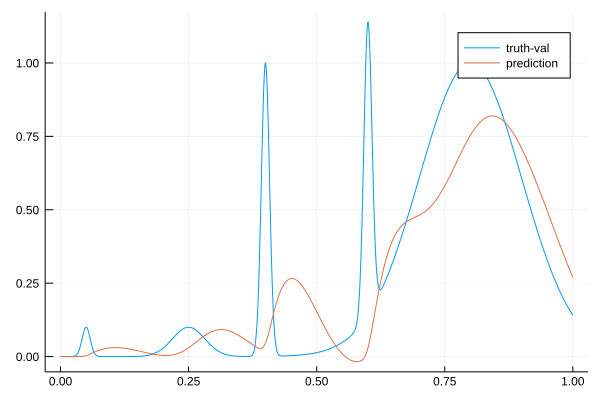

133.81705596007328 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.817012336393557
  21.003594073579155
  16.77531411040955 
  23.64927055684396 
 -18.112945502483043
   0.1              

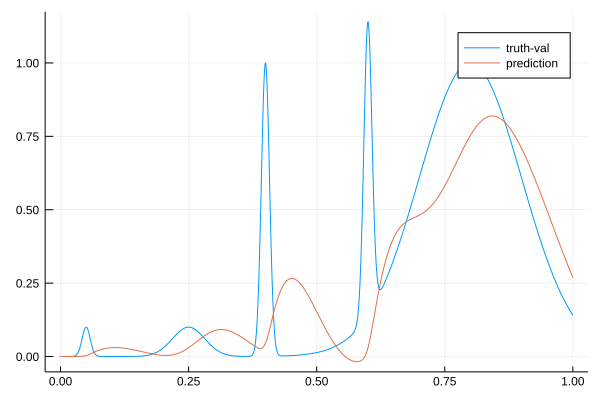

133.79849250018526 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.809451822086753
  21.02476322616499 
  16.73469073188241 
  23.66988331601031 
 -18.123001022686385
   0.1              

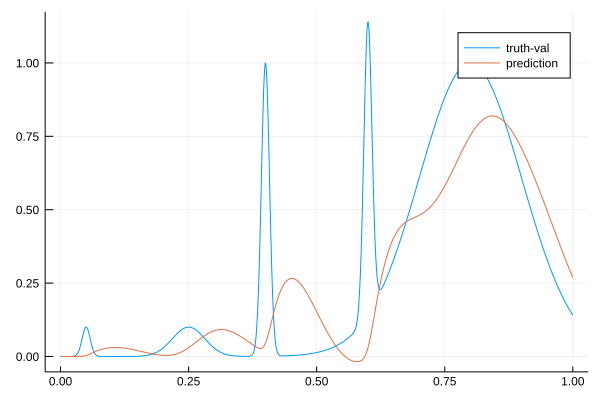

133.779723310526 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.80719455039324 
  21.04544119394403 
  16.693829493823895
  23.69050571140486 
 -18.13298249228759 
   0.1              

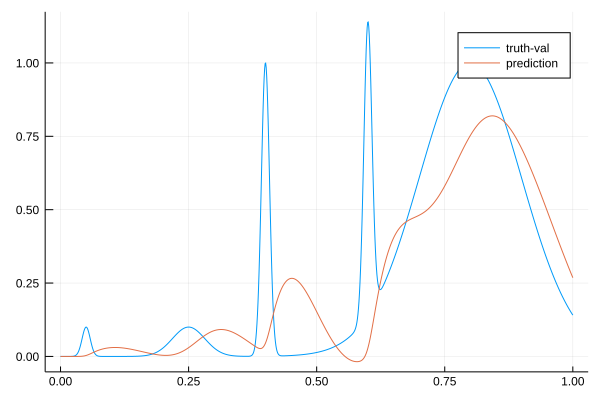

133.7609615262778 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.809918116483193
  21.065678472984768
  16.65273839102428 
  23.71115791887157 
 -18.14289805987625 
   0.1              

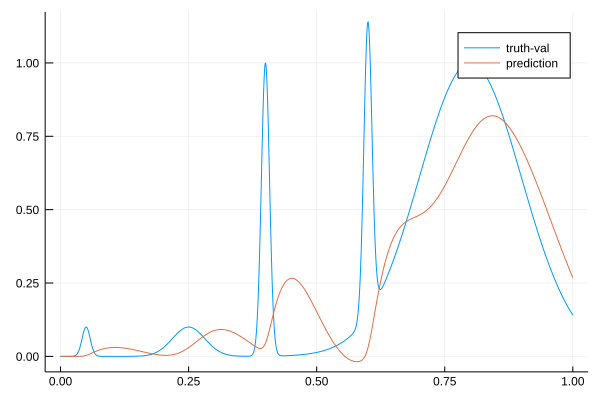

133.73819607830342 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.811049317217996
  21.0857141378135  
  16.611516887142574
  23.73146108969624 
 -18.153039206663895
   0.1              

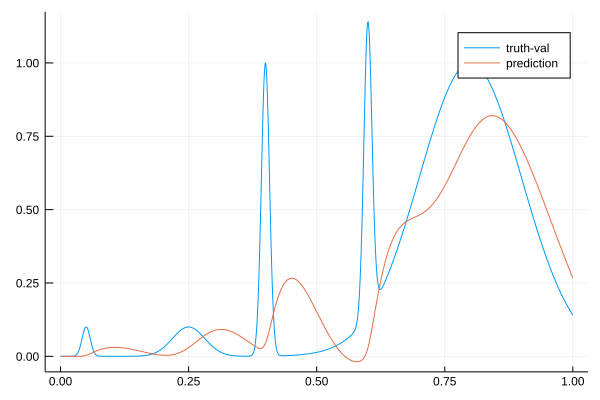

133.7246028379603 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.81095693880384 
  21.105574140741407
  16.57016229811923 
  23.75147602398601 
 -18.163385780574345
   0.1              

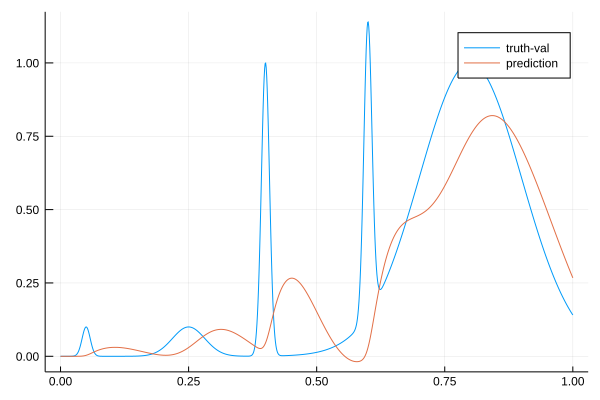

133.70606361245856 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.809902188494796
  21.125277082505125
  16.52867215988169 
  23.771245957841906
 -18.173920630329924
   0.1              

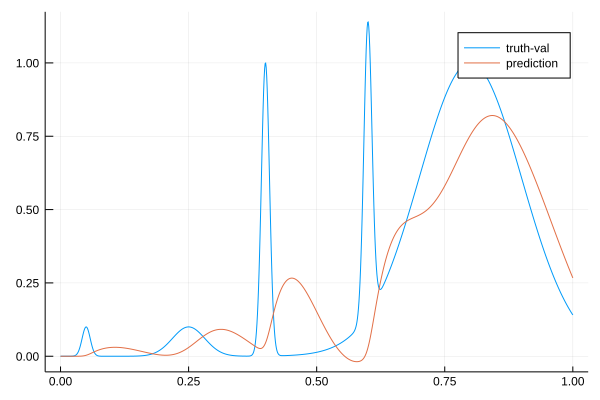

133.6656581068327 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.808167046411025
  21.14484210026672 
  16.487044778640282
  23.790816617680207
 -18.18462656514421 
   0.1              

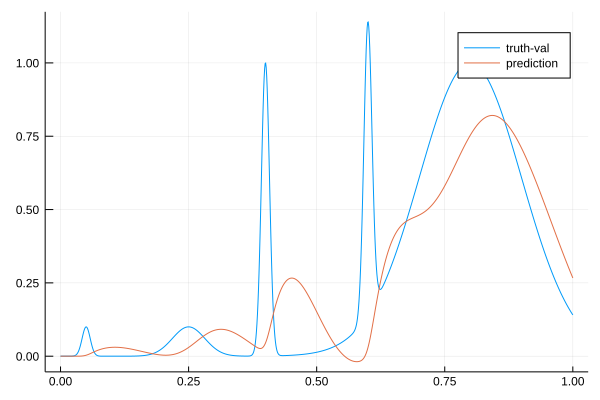

133.64669772963478 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.80611968226878 
  21.164278656893988
  16.44527258846287 
  23.810232028566492
 -18.19547235267225 
   0.1              

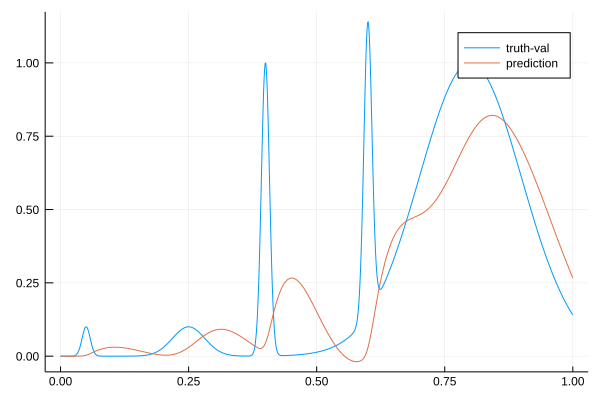

133.62819475888674 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.80398830192845 
  21.18360299273412 
  16.40335504285784 
  23.82952987821923 
 -18.206444409987398
   0.1              

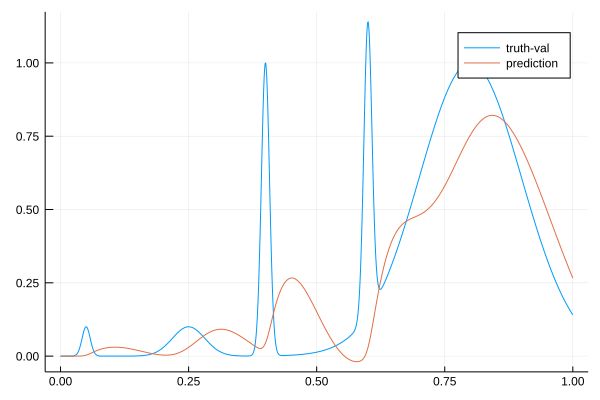

133.63023582291518 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.801980081483915
  21.202830144611735
  16.361291959962717
  23.848744637002145
 -18.217530656266643
   0.1              

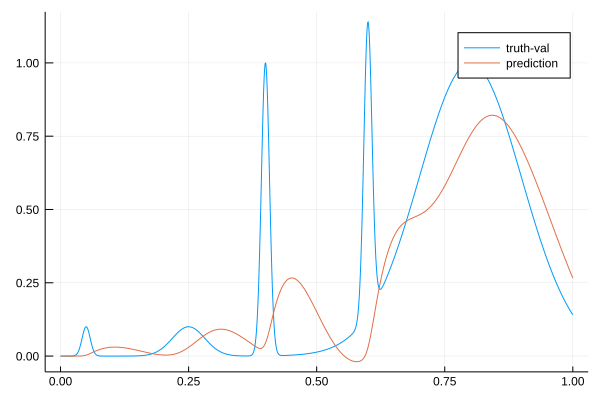

133.61226368573895 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.800183444585308
  21.22198225727668 
  16.319089506775192
  23.867906808895146
 -18.228735228992335
   0.1              

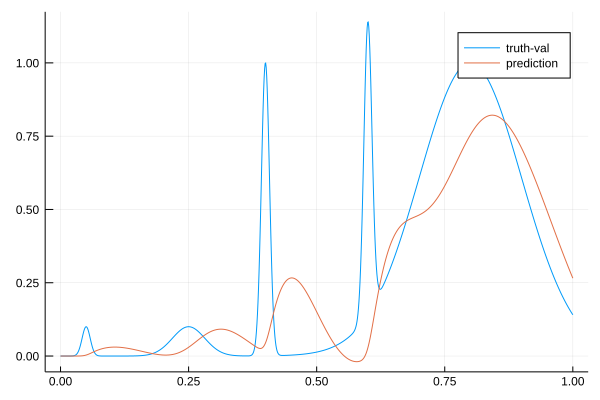

133.59176564305062 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.798775965072167
  21.241070469130737
  16.276746981610454
  23.88704410624886 
 -18.240046880185773
   0.1              

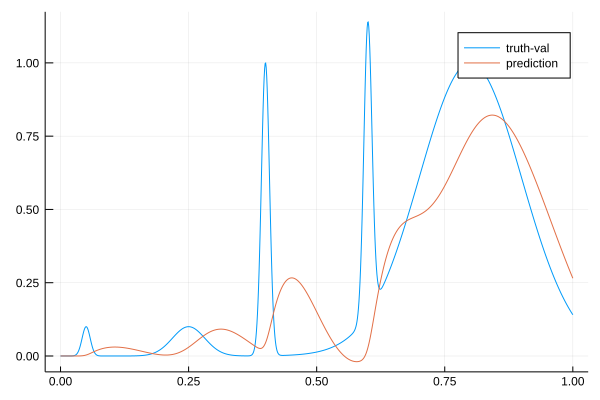

133.57249202562642 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.788491679862446
  21.26071157586817 
  16.234603299433456
  23.905911982493404
 -18.25178773601447 
   0.1              

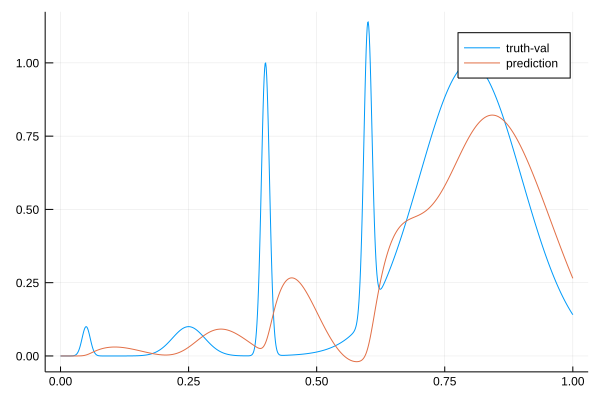

133.5538784055213 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.770715404026532
  21.280579238281017
  16.19260032541823 
  23.92430835355078 
 -18.263952396809504
   0.1              

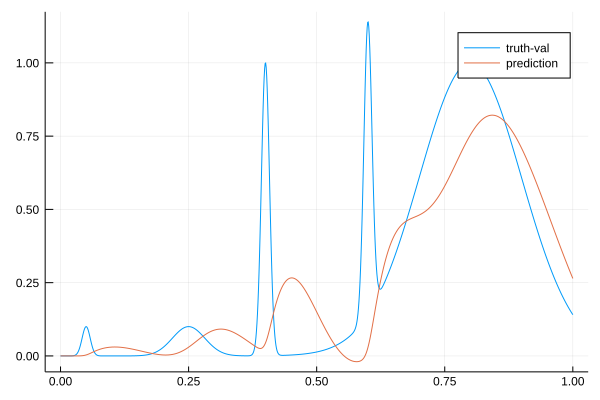

133.53551592530056 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.75636695394656 
  21.299923163406778
  16.150367286489203
  23.94249953205866 
 -18.276153613266032
   0.1              

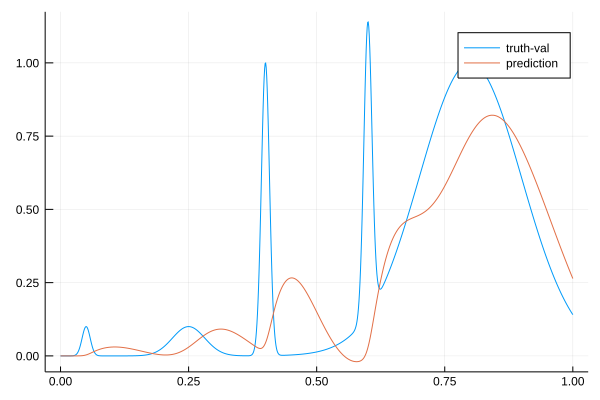

133.51718882464127 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.745360955151686
  21.318797675751966
  16.107916239923902
  23.960532058885978
 -18.28838358941906 
   0.1              

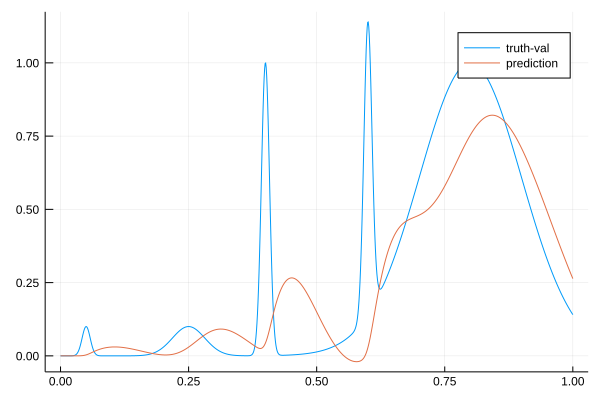

133.49884176001444 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.73774081719852 
  21.337209489283293
  16.06525662595703 
  23.97841632722631 
 -18.300636485220235
   0.1              

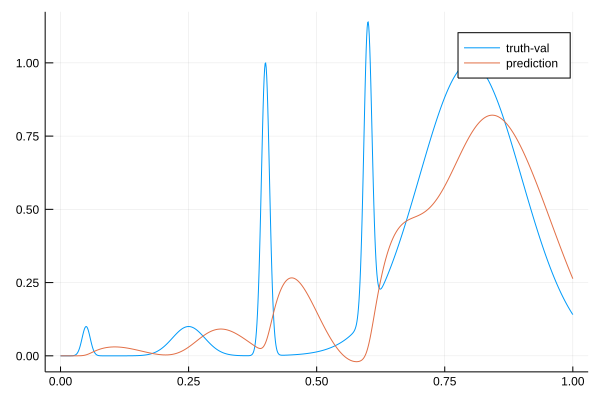

133.4804554586732 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.733411291856065
  21.355207578926258
  16.022396728962853
  23.9961925586413  
 -18.31290729598795 
   0.1              

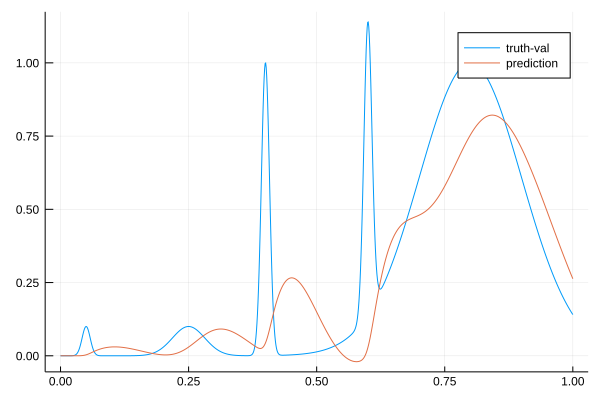

133.4619808027371 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.732279405755325
  21.372836445167426
  15.979343178738855
  24.013896695370402
 -18.325192234735365
   0.1              

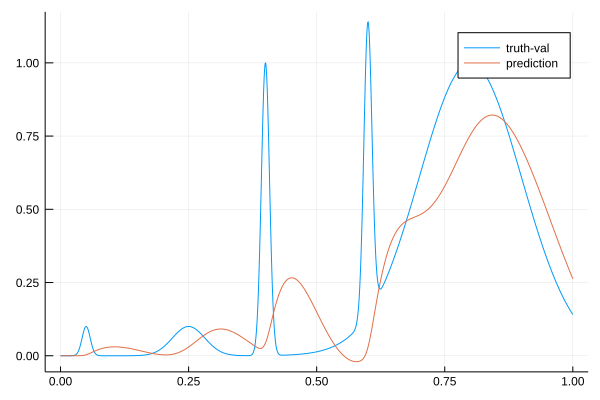

133.4436385155046 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.734254912486566
  21.390136585313098
  15.936101146671506
  24.031560928165298
 -18.33748863833263 
   0.1              

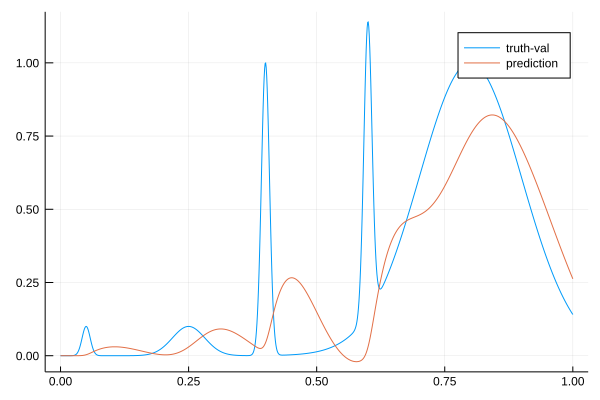

133.4252067707658 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.729571283234414
  21.40776778335543 
  15.893022837985313
  24.048942767392354
 -18.35013049319365 
   0.1              

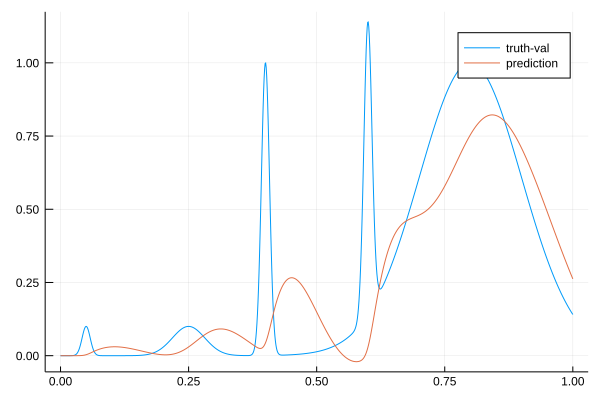

133.40656606769997 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.719098785036437
  21.425704151486123
  15.850080391301152
  24.066096618178026
 -18.36308151612235 
   0.1              

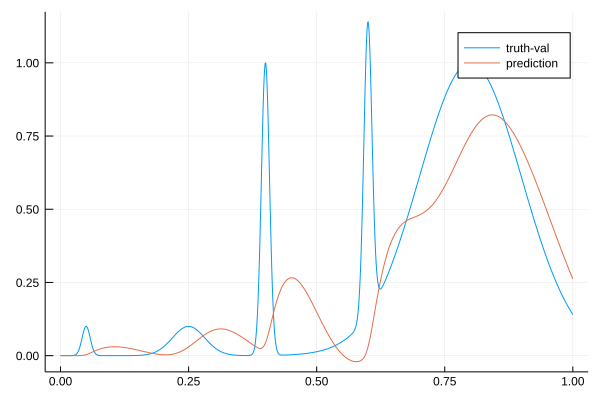

133.38776155140783 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.70363816761305 
  21.44392195811492 
  15.807250338904117
  24.083072996507617
 -18.376306991285862
   0.1              

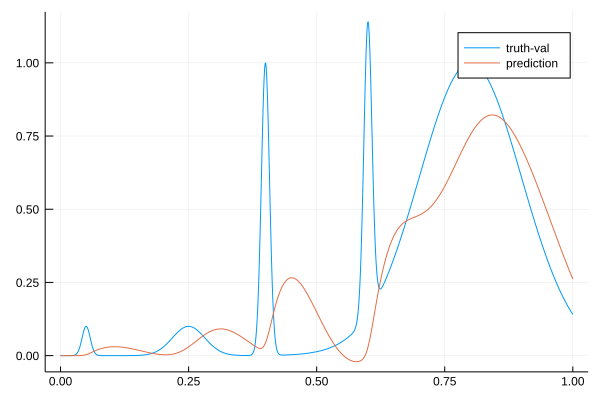

133.36929305351754 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.683925559514982
  21.46239947494318 
  15.76451297109222 
  24.09991872884129 
 -18.389773899649168
   0.1              

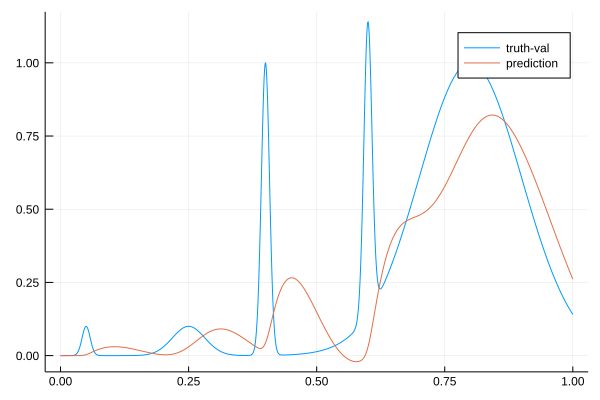

133.35075512867138 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.67041125307211 
  21.480486112286265
  15.721499392950971
  24.116948120356486
 -18.40311491152444 
   0.1              

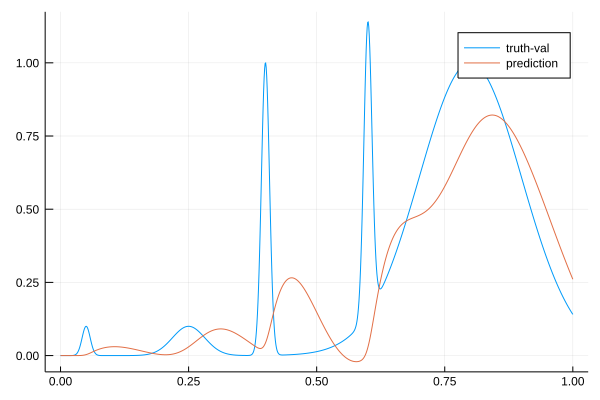

133.33203594897907 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.662759081106625
  21.498224329462776
  15.678226991761955
  24.134172544548694
 -18.41633651891234 
   0.1              

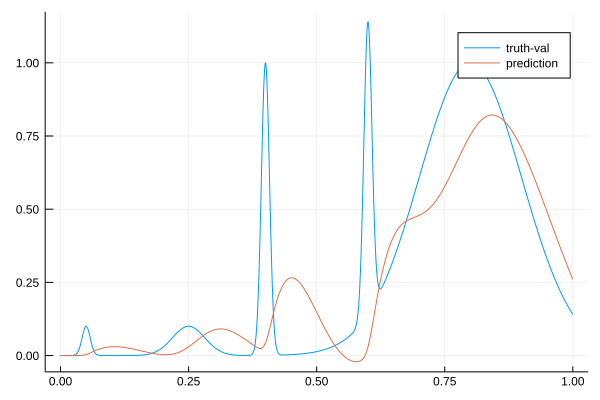

133.31381374978818 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.660650420836554
  21.51565290030027 
  15.634709755990547
  24.151601401170833
 -18.429446282384138
   0.1              

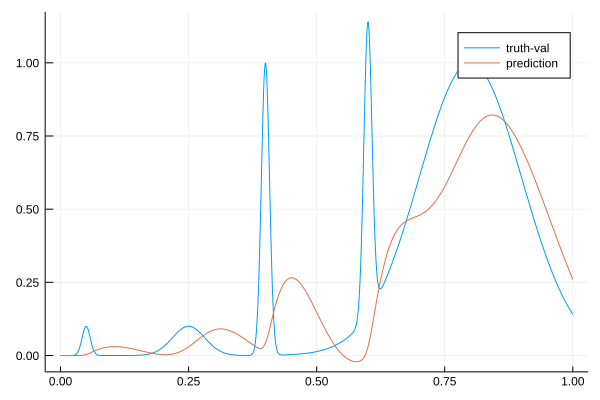

133.2948981510708 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.66378094291406 
  21.532807438433636
  15.590959029603683
  24.169242347288904
 -18.4424536878325  
   0.1              

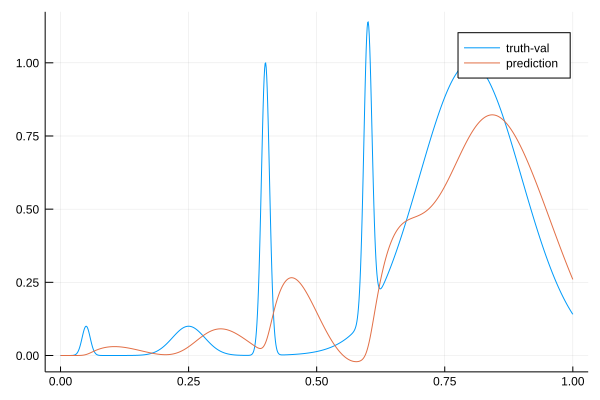

133.27650439222626 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.661975429926752
  21.550359652157532
  15.547339927733068
  24.186831014991885
 -18.455704808454698
   0.1              

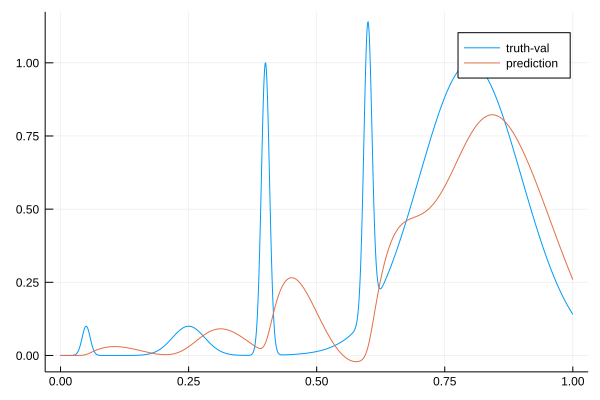

133.25808296258919 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.656231417190757
  21.567990746108258
  15.503799259524948
  24.204136865163957
 -18.469215617881616
   0.1              

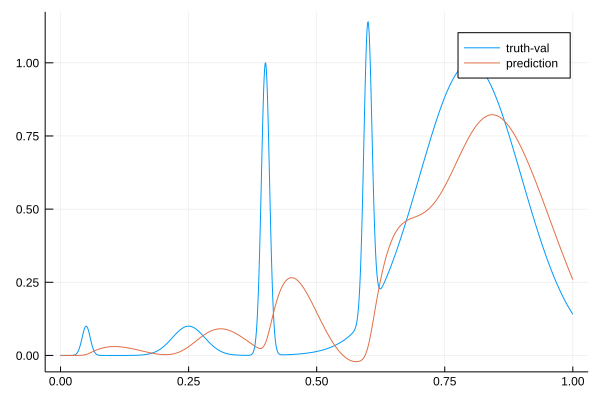

133.23962850521343 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.64716565914399 
  21.585699742081957
  15.460318317984308
  24.2212162567614  
 -18.482957427273963
   0.1              

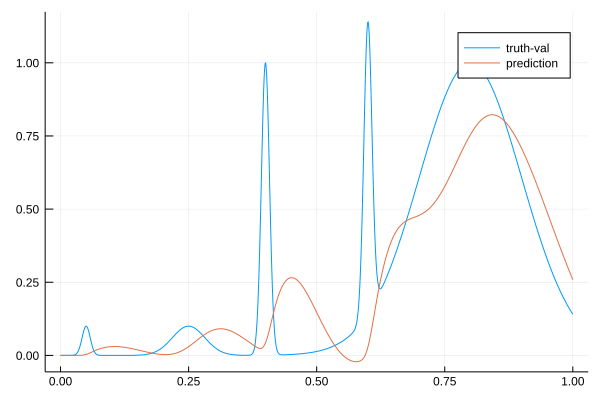

133.22123020171935 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.63534515562654 
  21.603485632696163
  15.416881297017234
  24.2381209859041  
 -18.496903124887666
   0.1              

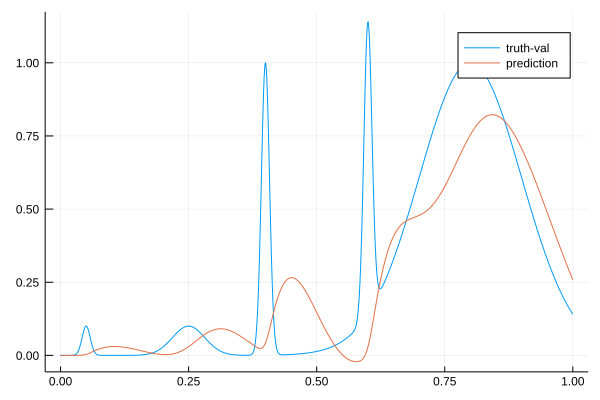

133.20266377874464 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.62129115463614 
  21.621347341881368
  15.373474967095566
  24.25489857471229 
 -18.51102713598509 
   0.1              

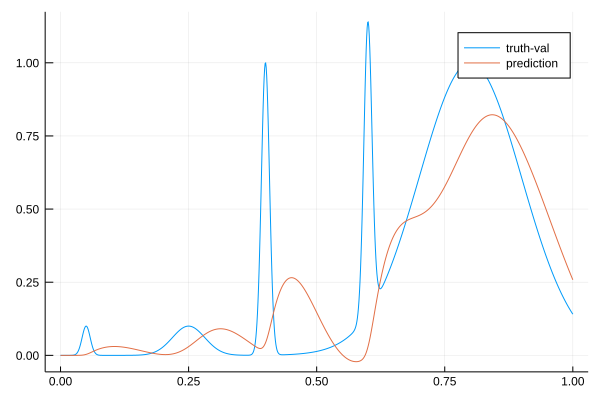

133.18406500641433 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.605482685346324
  21.63928403493253 
  15.330088104775012
  24.27159287811064 
 -18.525305792232803
   0.1              

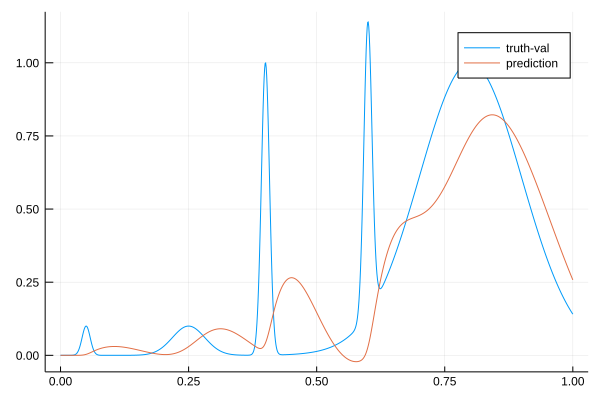

133.165268178519 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.59844004249116 
  21.656643103040278
  15.286347873758778
  24.288513859244233
 -18.539379207387842
   0.1              

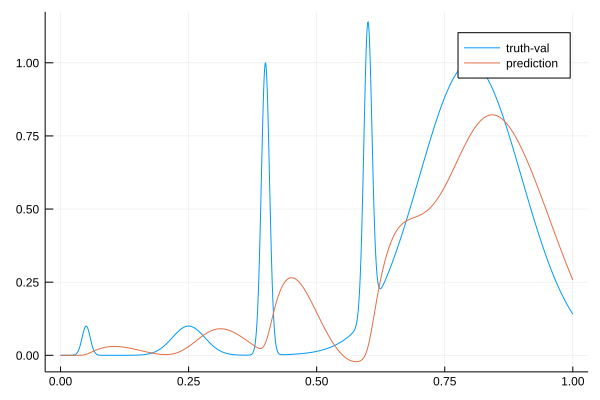

133.14648533124895 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.599565325407312
  21.67348632194128 
  15.24227804234897 
  24.305669735163914
 -18.55326287743497 
   0.1              

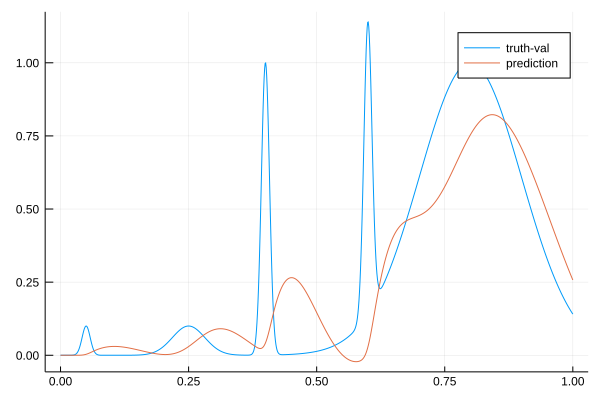

133.12765007918682 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.59819346150024 
  21.690526229933404
  15.198263087827199
  24.322797115473737
 -18.567311226247917
   0.1              

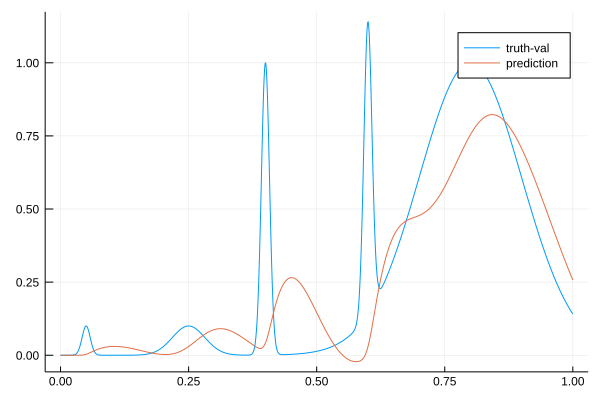

133.10879089568817 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.594804163559772
  21.707751413719855
  15.154285803992085
  24.339928808980055
 -18.58150520513813 
   0.1              

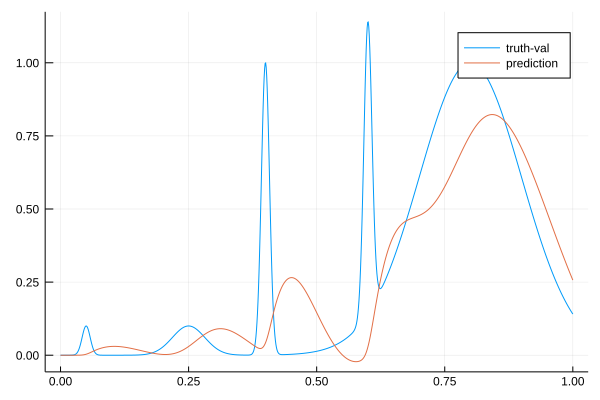

133.0899074415075 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.58983744324516 
  21.72515150093486 
  15.110331323081121
  24.35709501700962 
 -18.595826954809613
   0.1              

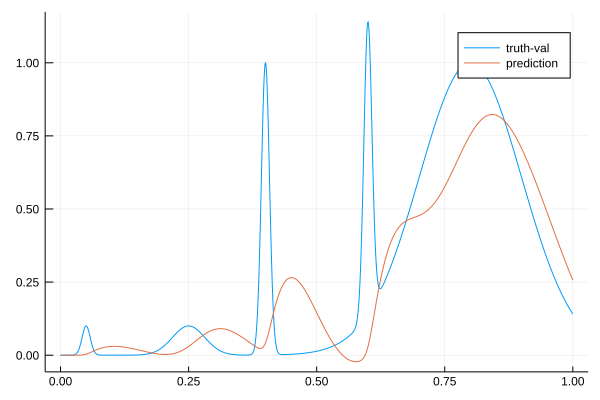

133.07099752640642 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.58382129556217 
  21.742673194831763
  15.066386124180234
  24.374290487414726
 -18.610261103045406
   0.1              

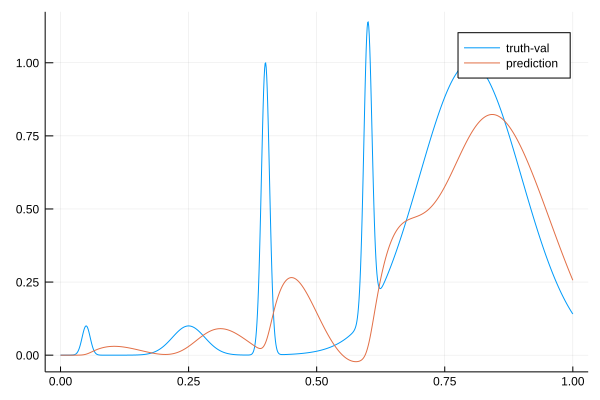

133.0520319776839 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.577112085445414
  21.760312308038014
  15.02243898841879 
  24.39154390519894 
 -18.624792204629717
   0.1              

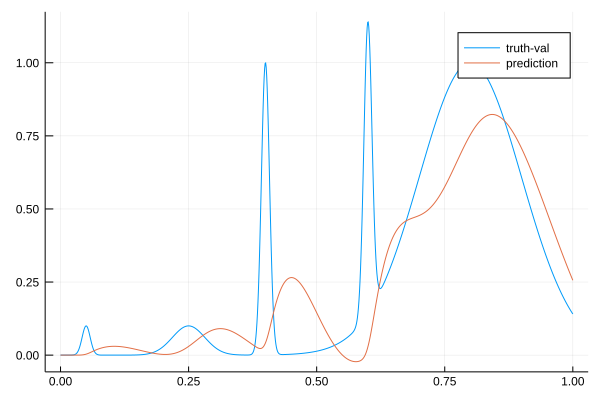

133.03300432229236 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.570035431868757
  21.77806511197557 
  14.978480050390614
  24.408881538973272
 -18.639406087362815
   0.1              

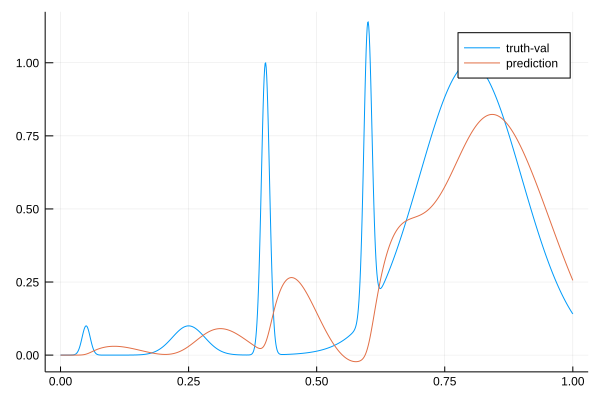

133.01392248564906 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.562888480529207
  21.79592832986604 
  14.93450057386264 
  24.426327438474658
 -18.65408985066653 
   0.1              

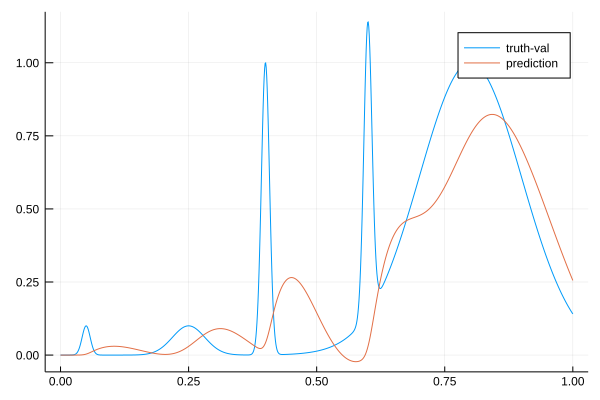

132.9947841777449 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.55594162518748 
  21.813899089091016
  14.890492729808331
  24.443903543143048
 -18.668831848711395
   0.1              

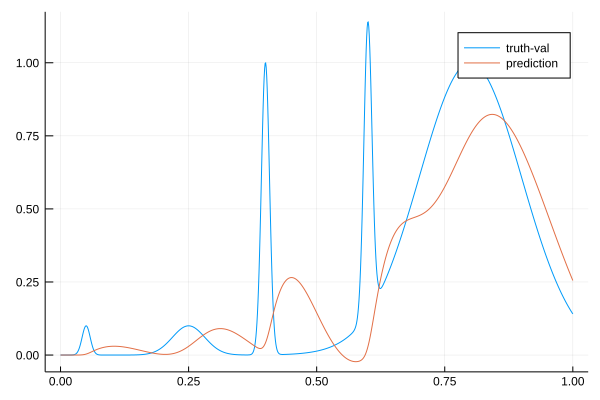

132.97593214679924 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.549440361240393
  21.831974901325335
  14.846449420334217
  24.461629833672323
 -18.683621669284925
   0.1              

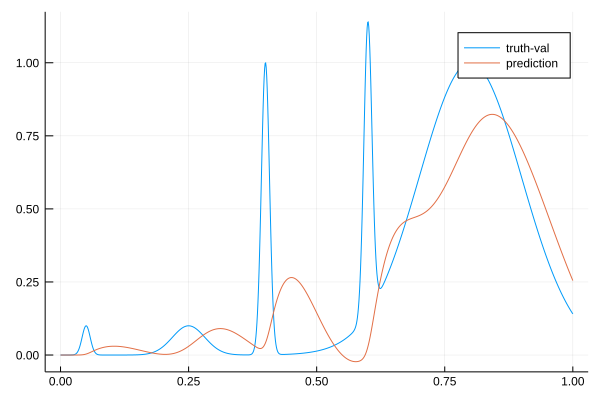

132.95841208493215 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.54391149194303 
  21.849857527565206
  14.802335375712232
  24.479251786139592
 -18.698494674822513
   0.1              

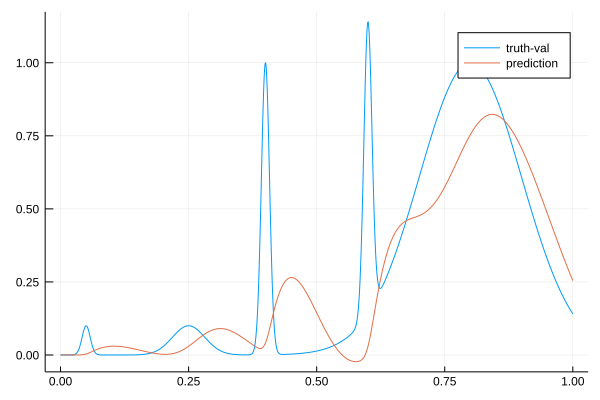

132.93963985291808 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.539514923466314
  21.867573227645437
  14.758147594497098
  24.496810544901056
 -18.71343912915766 
   0.1              

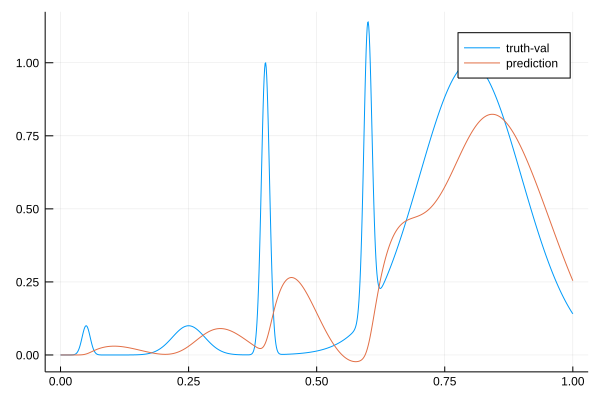

132.9209285591839 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.536402962513787
  21.885146490496876
  14.713882912008618
  24.51434472160367 
 -18.728444227867918
   0.1              

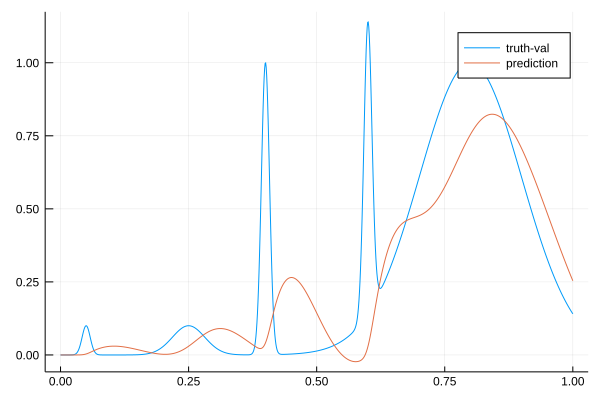

132.90234150255168 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.530573169263295
  21.902602437133925
  14.669532122364393
  24.531513692005433
 -18.743463021805017
   0.1              

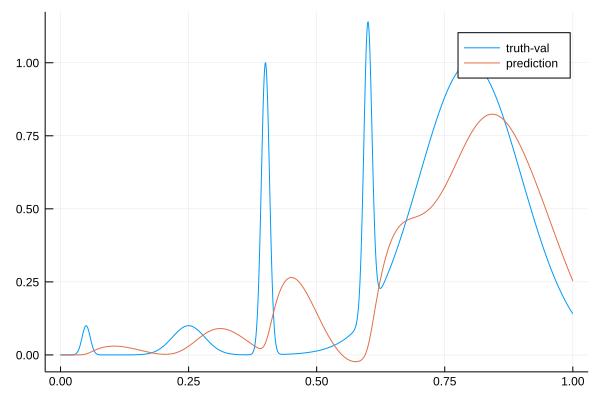

132.88371096654072 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.52255284935096 
  21.9199603273677  
  14.625093870501962
  24.548385358551617
 -18.758489616630612
   0.1              

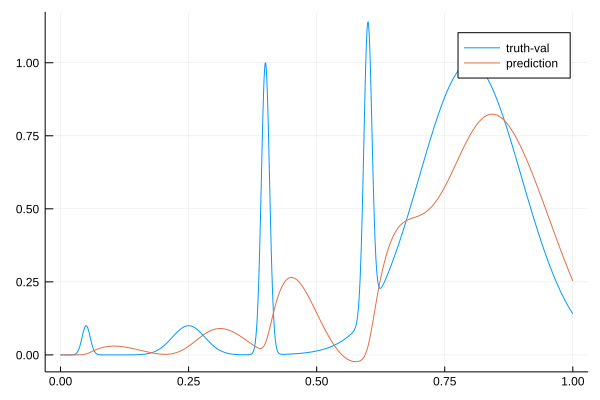

132.86504607097345 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.512826006977807
  21.937237462473338
  14.580567684978964
  24.565021678234288
 -18.773517637815278
   0.1              

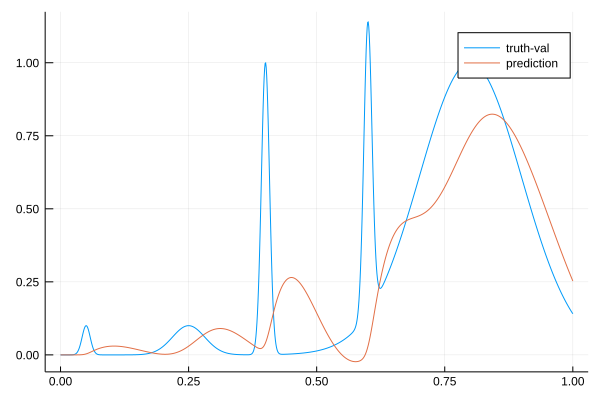

132.846353575171 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.501836254038757
  21.954449406202194
  14.535953738253134
  24.581479129586818
 -18.7885404833342  
   0.1              

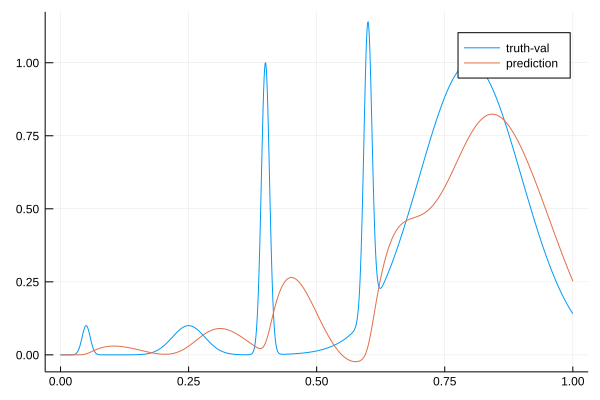

132.8276743365439 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.489989533466098
  21.971610182118233
  14.491252641344294
  24.59780914435956 
 -18.80355153472553 
   0.1              

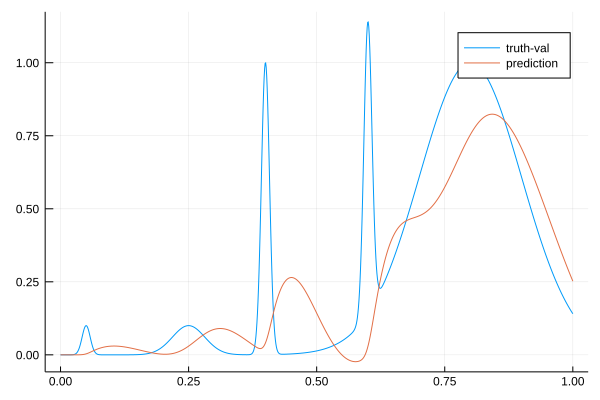

132.8089731270764 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.4848074704405  
  21.98850193002528 
  14.446356975454746
  24.614474474744828
 -18.81822180529578 
   0.1              

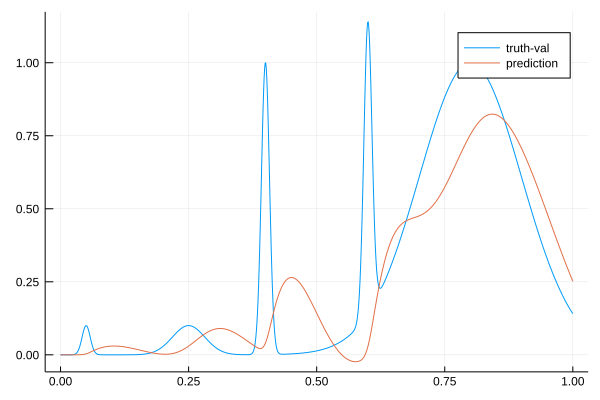

132.79019244305533 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.485916989103792
  22.005158342979396
  14.401275809764204
  24.63147543725193 
 -18.832578606264704
   0.1              

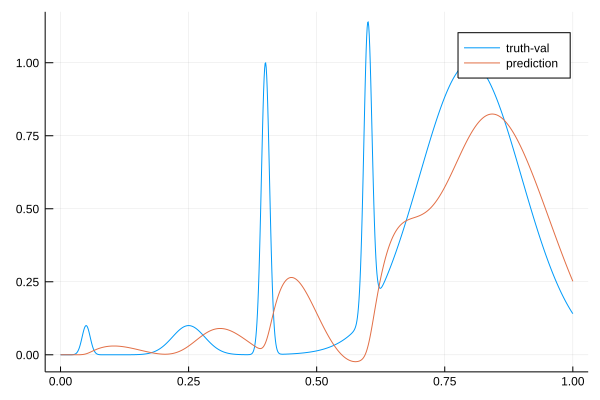

132.77217029772237 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.48579233966895 
  22.021842358764804
  14.356124110645592
  24.648394573328588
 -18.84697270364589 
   0.1              

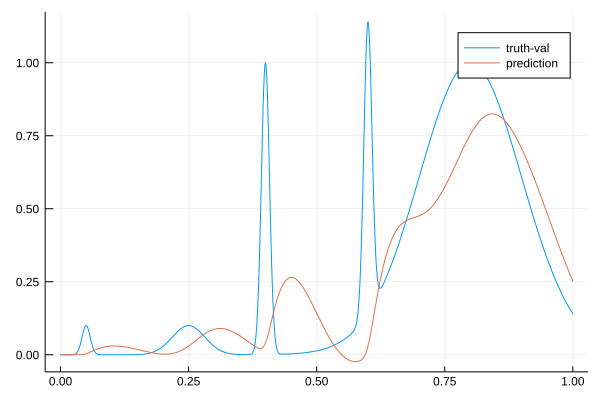

132.75140512508835 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.48481589291343 
  22.038561121530982
  14.310898431209155
  24.665273872967266
 -18.861398322545842
   0.1              

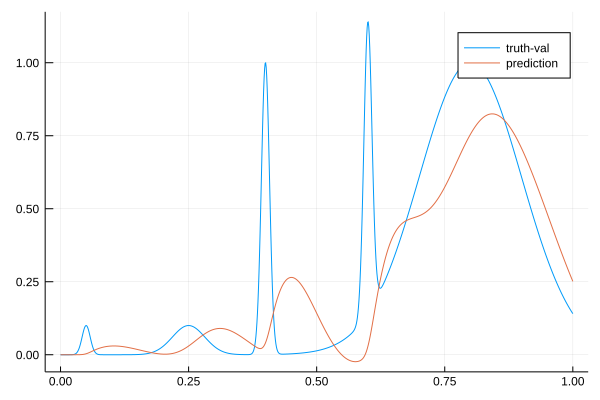

132.7325103943844 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.483337579472366
  22.055317786743696
  14.265593379123624
  24.68214829760165 
 -18.87584449286154 
   0.1              

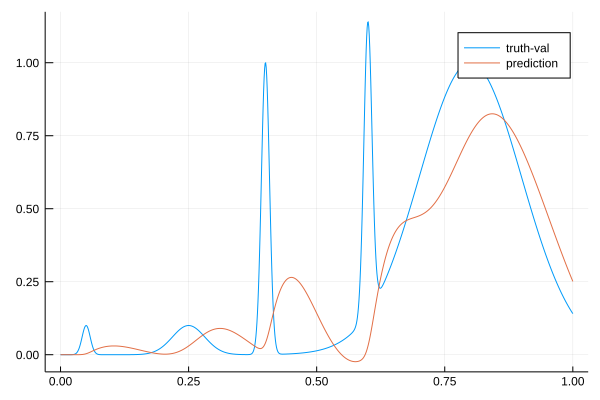

132.7135491689969 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.48167245880484 
  22.072117204335004
  14.22020568959245 
  24.699051329517594
 -18.890304688712057
   0.1              

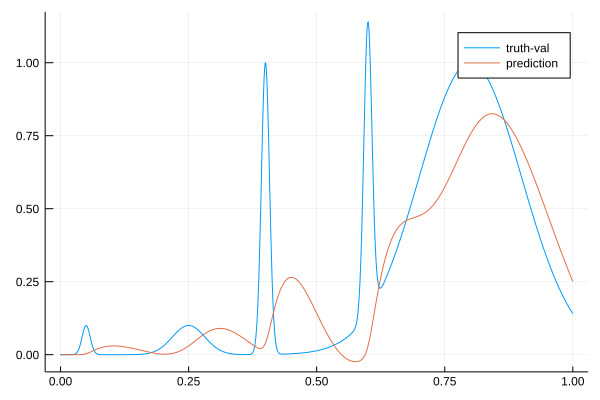

132.6945180222704 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.48010748659743 
  22.088963819141725
  14.174732489193003
  24.71601345091975 
 -18.904772881070908
   0.1              

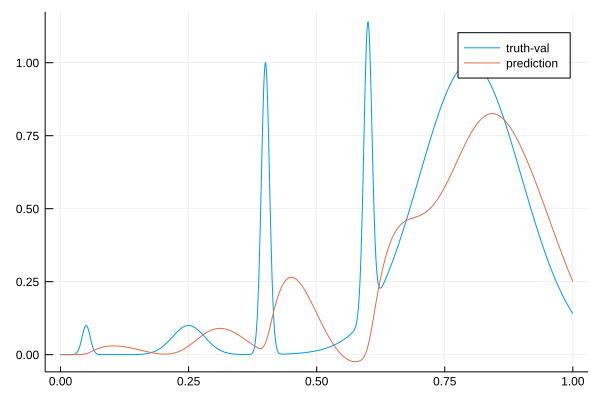

132.67541226877862 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.47890342260308 
  22.10586173024503 
  14.129171159107972
  24.733062377727602
 -18.91924360440453 
   0.1              

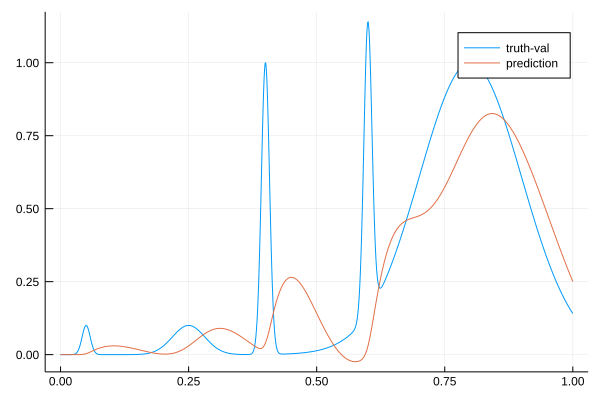

132.65654159527992 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.478296618848084
  22.122814743185373
  14.083519219263543
  24.75022327736651 
 -18.933712006280288
   0.1              

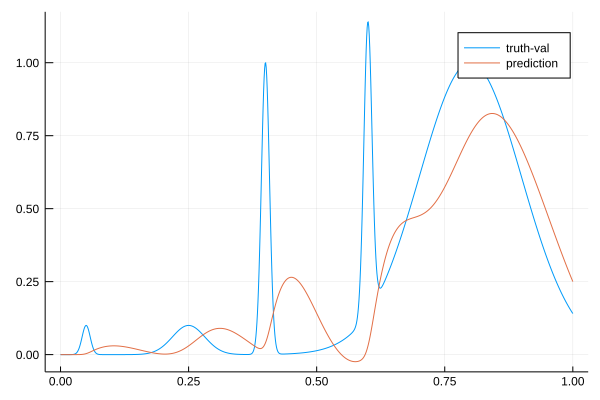

132.63923124075896 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.47881709677654 
  22.1395206017011  
  14.037744636531894
  24.767236720406594
 -18.948221315861478
   0.1              

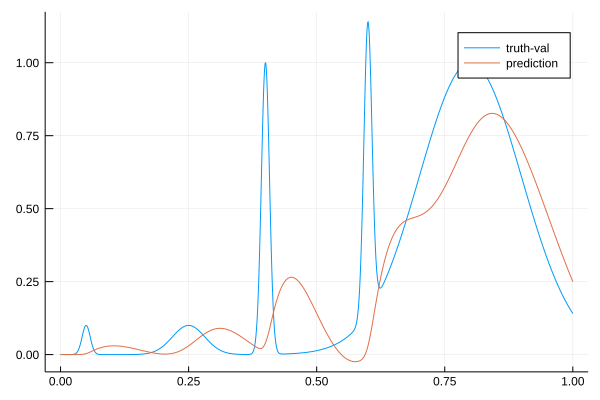

132.6206229914555 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.480736559086377
  22.15596780843837 
  13.99184756887519 
  24.784115413103205
 -18.962767580293896
   0.1              

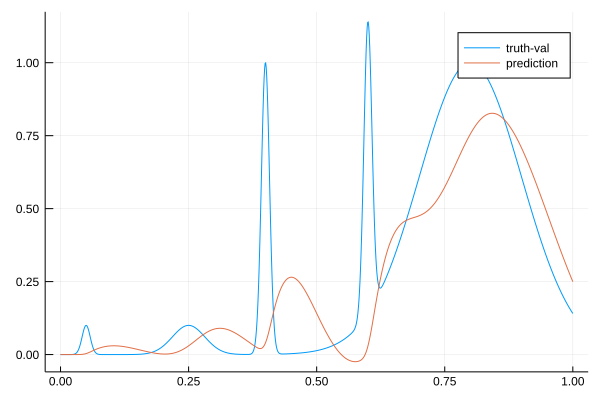

132.60299423059843 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.473149556017706
  22.172907119770628
  13.946228162295522
  24.800636243747032
 -18.977685760880007
   0.1              

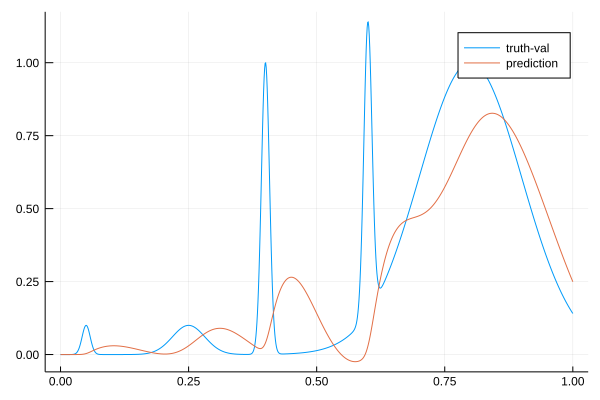

132.58396575339026 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.457275195348913
  22.190300289139483
  13.900851486240187
  24.816868895753558
 -18.992932666154157
   0.1              

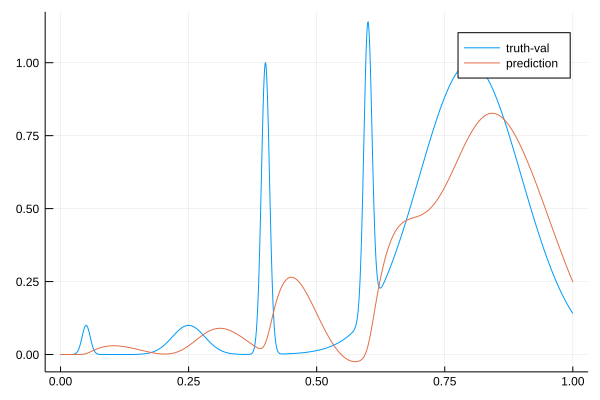

132.56520186827464 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.43424000761505 
  22.20811293703869 
  13.855688558317185
  24.8328795811271  
 -19.008466112248342
   0.1              

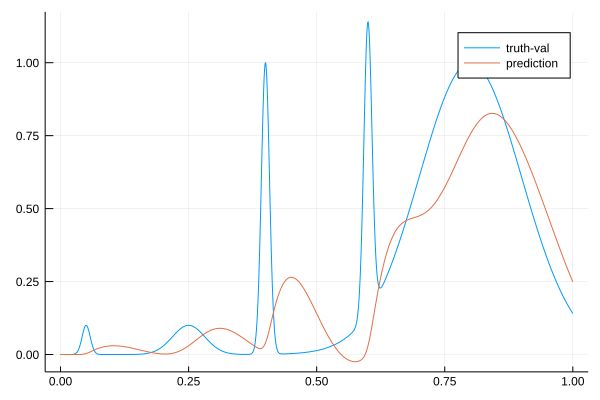

132.54767438992477 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.416138443835944
  22.22559107498954 
  13.810312275038381
  24.848998613099702
 -19.02390344343824 
   0.1              

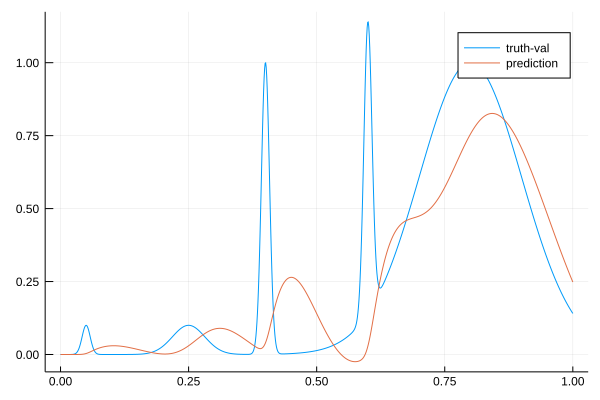

132.52852917685547 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.41021873473093 
  22.242534247865173
  13.76462714741235 
  24.865675196803977
 -19.03891172010304 
   0.1              

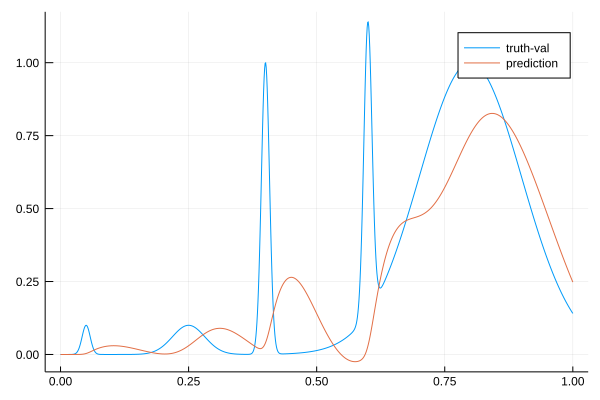

132.508950664511 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.41555812249459 
  22.259003291444525
  13.71865436741429 
  24.8828912372594  
 -19.05352552177073 
   0.1              

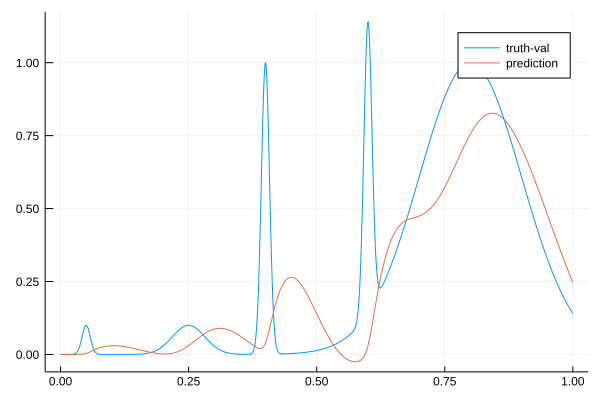

132.48993503811514 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.41278890638029 
  22.27602764735935 
  13.672929490401525
  24.899939798654632
 -19.068456858029343
   0.1              

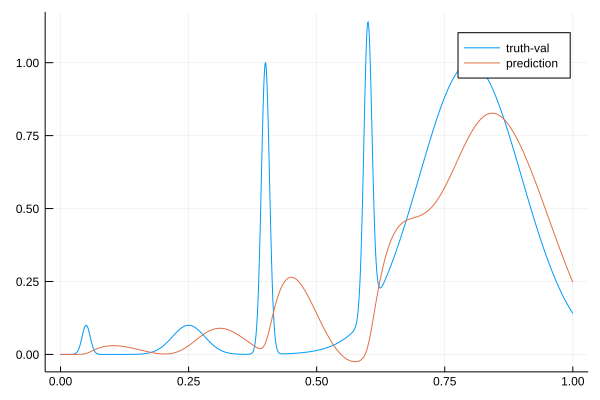

132.47067072258315 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.402985281008124
  22.29356446873982 
  13.627418919343553
  24.91687382800122 
 -19.0836688681639  
   0.1              

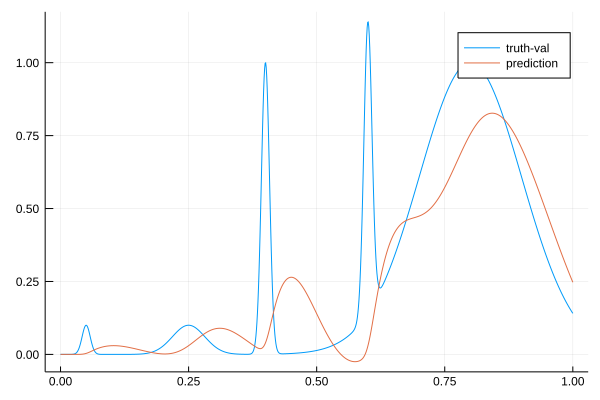

132.45147876831282 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.387133658561172
  22.311574717545348
  13.582094680618976
  24.933742787431196
 -19.099125948283287
   0.1              

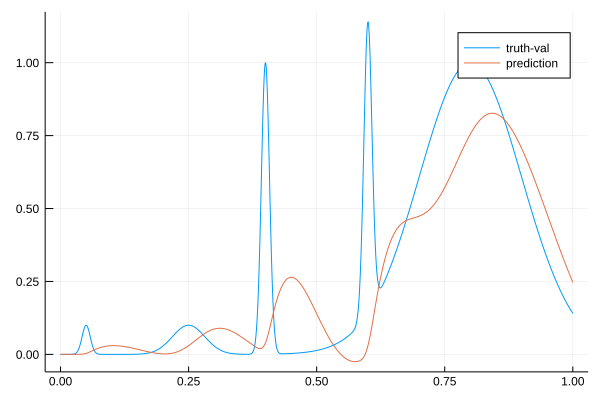

132.43266035683345 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.373543090004365
  22.329776186448402
  13.536819190893729
  24.951013953689316
 -19.114457182681058
   0.1              

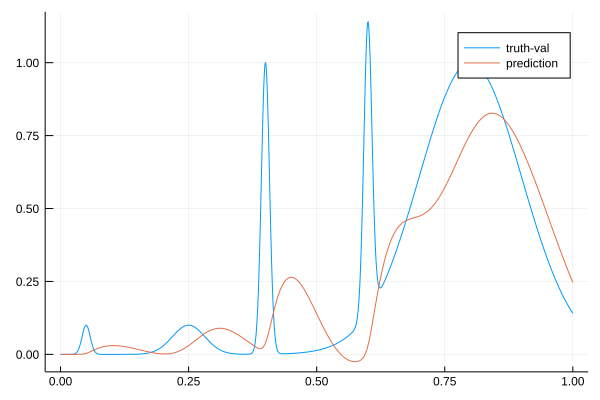

132.41325714774703 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.373561963419117
  22.347422345950616
  13.49117021842686 
  24.968953654418826
 -19.129323355564285
   0.1              

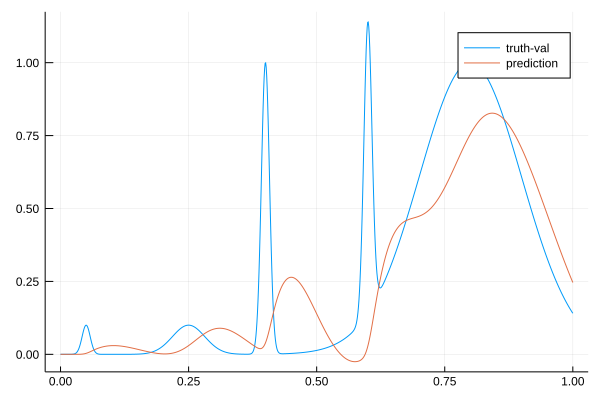

132.3939692394795 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.374871888651942
  22.365317395468008
  13.445586094907737
  24.987266226010995
 -19.144107390228513
   0.1              

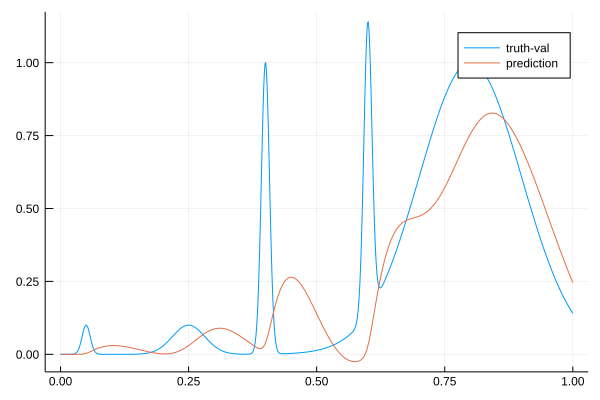

132.37461910920106 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.377619856191185
  22.383448399777187
  13.400049448291487
  25.00595157467851 
 -19.158813223952823
   0.1              

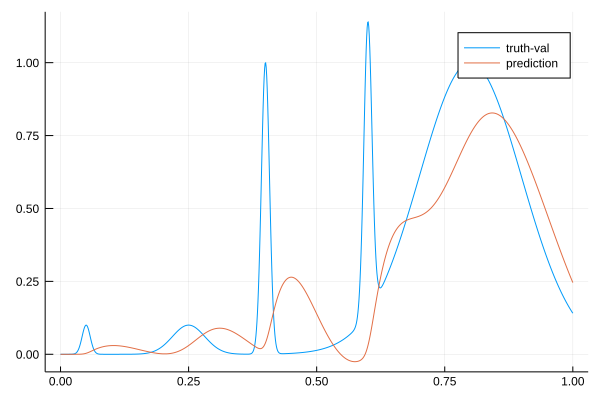

132.35529363493592 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.374462422251487
  22.402054037029643
  13.354659705052372
  25.024587659786004
 -19.17378501844881 
   0.1              

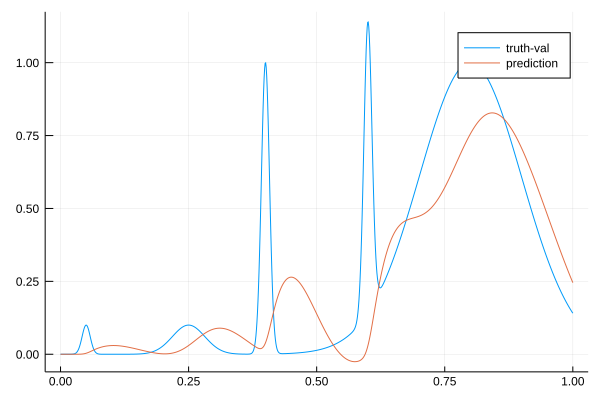

132.33624665675575 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.366255984073447
  22.421099951322887
  13.309393089148351
  25.043217053883357
 -19.188992150530915
   0.1              

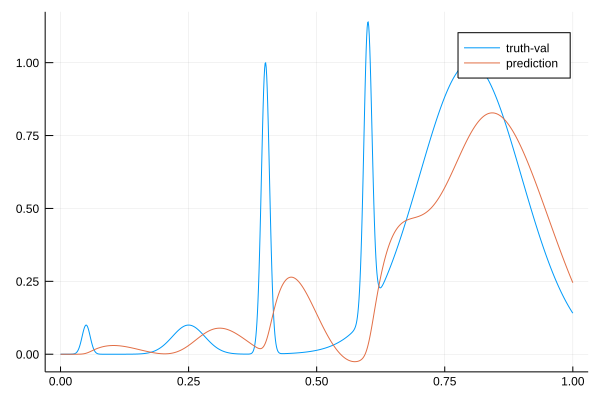

132.31725723273388 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.361608951729274
  22.439988585343617
  13.264083215260236
  25.062010514127742
 -19.20411439919216 
   0.1              

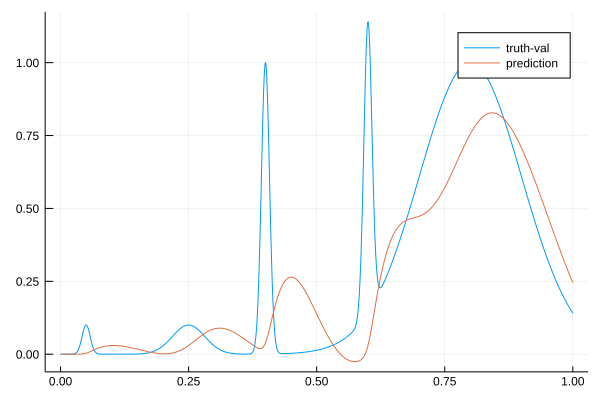

132.2982579039519 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.360465725620724
  22.458746618374978
  13.218725403312327
  25.080989857255982
 -19.219154928985002
   0.1              

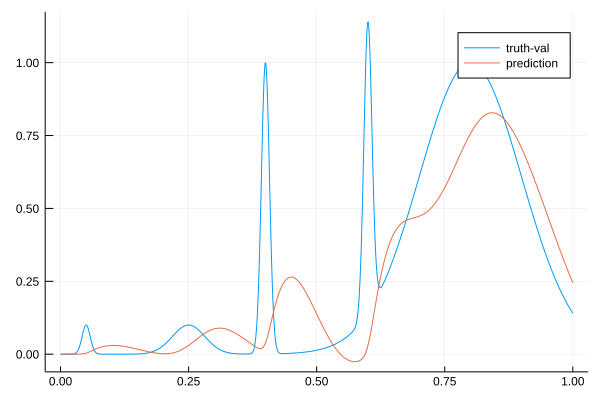

132.2791982050294 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.355230986106804
  22.47765214541206 
  13.173431187065361
  25.099751978819953
 -19.234460469227336
   0.1              

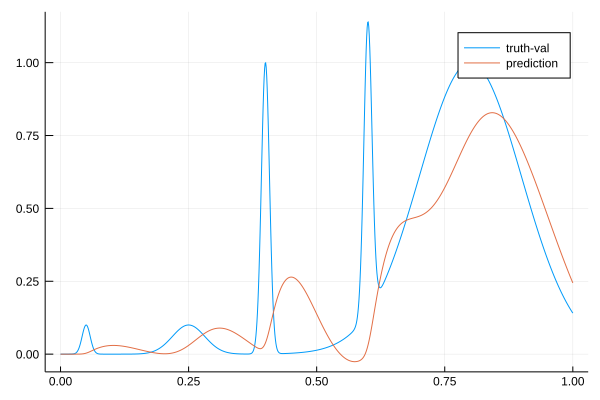

132.26015254896222 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.34659053281033 
  22.496703009813096
  13.128185932593043
  25.11835684325671 
 -19.25000009133505 
   0.1              

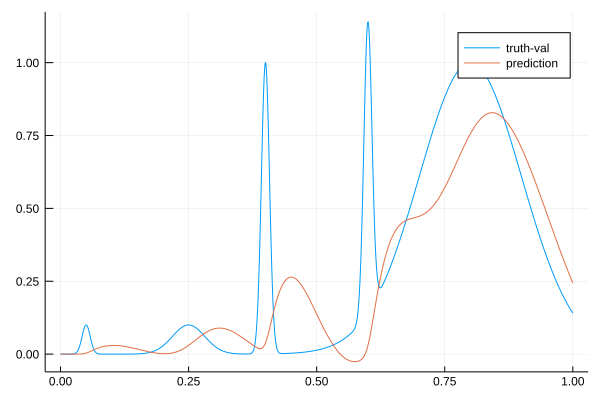

132.24102080101747 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.342744092962306
  22.515641787456133
  13.082860187741447
  25.137282010787324
 -19.265400509405783
   0.1              

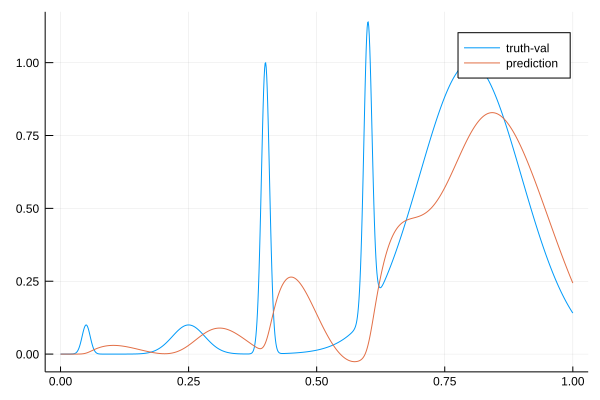

132.22183575496763 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.343518890386726
  22.53449134816203 
  13.037452922412147
  25.156534909824444
 -19.280670232656895
   0.1              

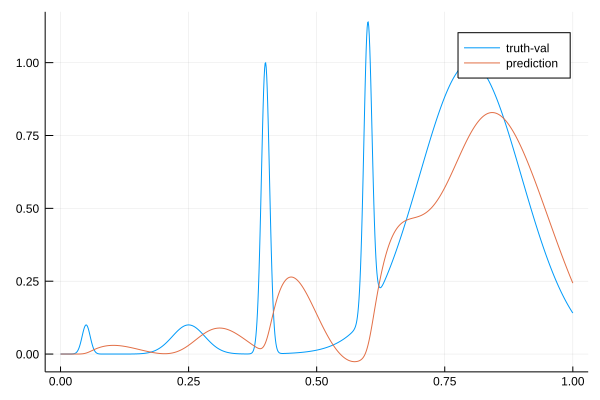

132.20268884154154 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.341145318362848
  22.553529972278106
  12.992079779150636
  25.175698982285578
 -19.296164150711277
   0.1              

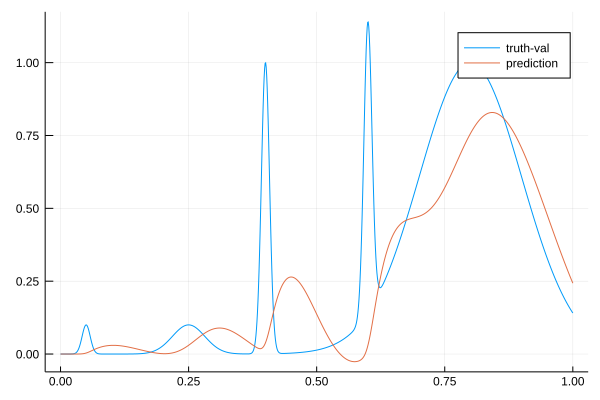

132.1833998425183 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.3363334223841  
  22.572706181251654
  12.94672761151664 
  25.19478589548567 
 -19.311859167793127
   0.1              

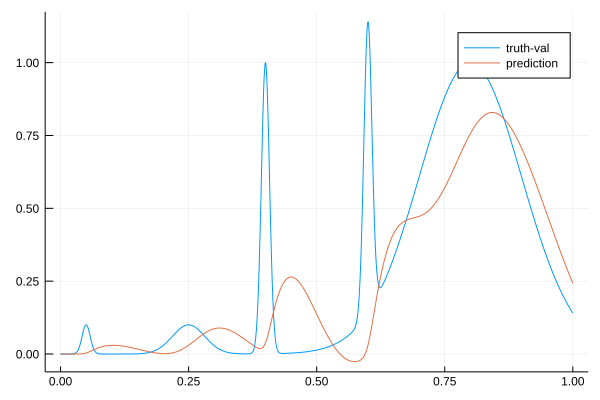

132.1639885387271 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.329614433373372
  22.592019582733027
  12.901386084367177
  25.213843271233873
 -19.32773060095936 
   0.1              

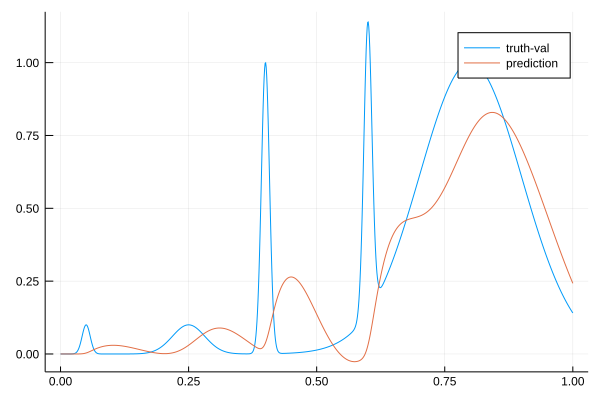

132.14459563522445 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.321475395800398
  22.61146988835844 
  12.856046608898618
  25.23291483436859 
 -19.343755406122852
   0.1              

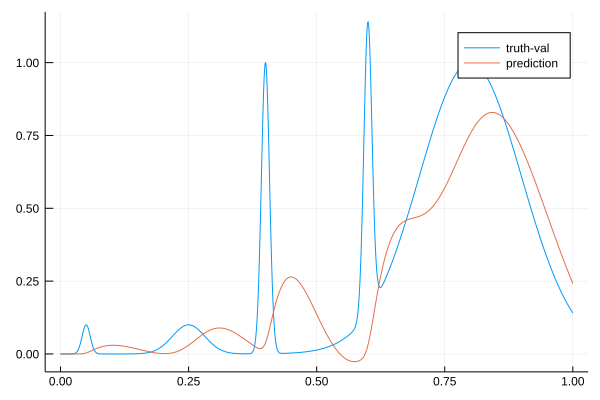

132.12502227637336 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.32003746496704 
  22.630796085649916
  12.810582552549363
  25.252463311706215
 -19.359563954100423
   0.1              

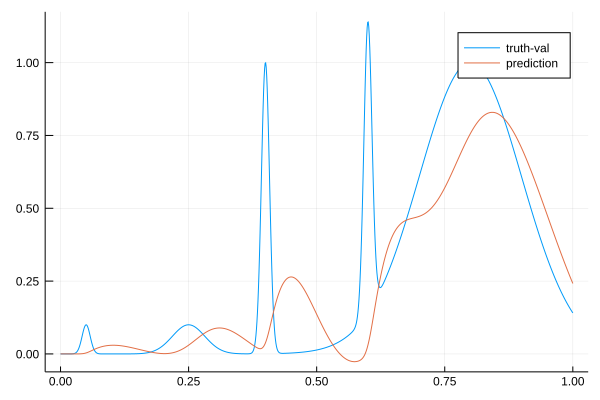

132.10547747311844 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.317255908938517
  22.650285086914   
  12.765116384182509
  25.272059385335524
 -19.3755220973528  
   0.1              

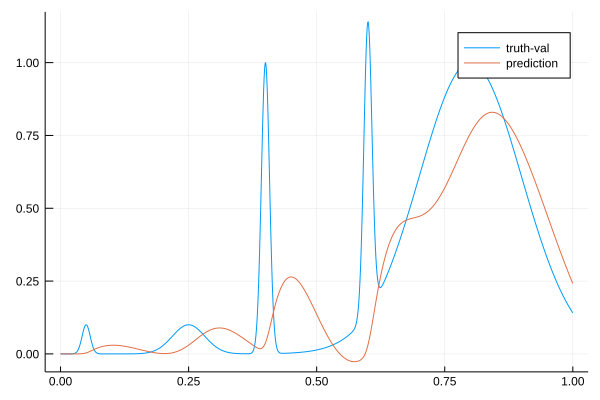

132.085941280911 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.313557194787826
  22.66993482000567 
  12.71963947640587 
  25.291739286763374
 -19.39161092599018 
   0.1              

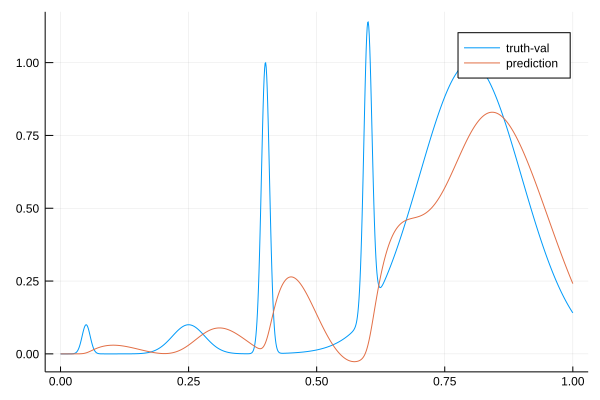

132.06641035271377 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.30933011452892 
  22.689743513054847
  12.674144430405494
  25.311536124225587
 -19.407813127046115
   0.1              

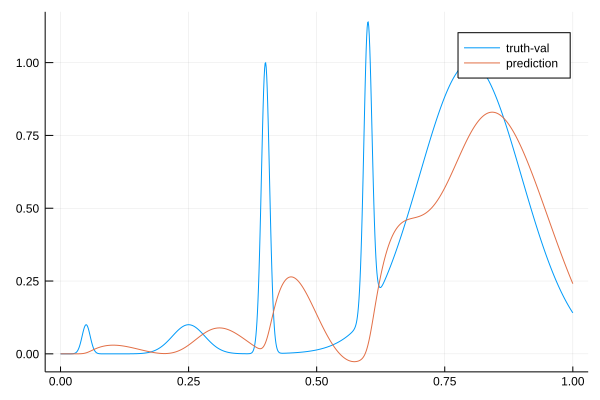

132.04718726707057 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.304928484541826
  22.709709705129782
  12.628624818885536
  25.331480129198905
 -19.424112986405078
   0.1              

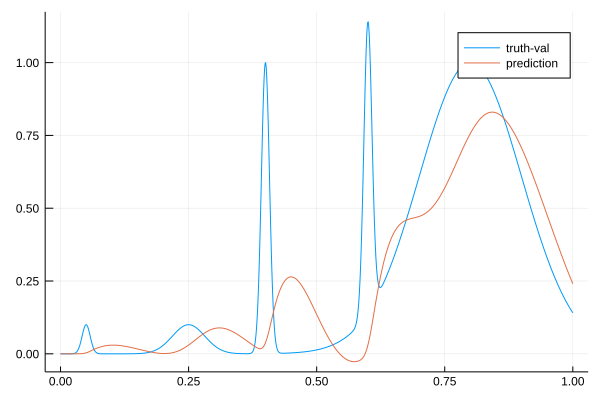

132.02801813939377 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.301006988030093
  22.729510079467243
  12.583043911972787
  25.351300145383554
 -19.44054905316759 
   0.1              

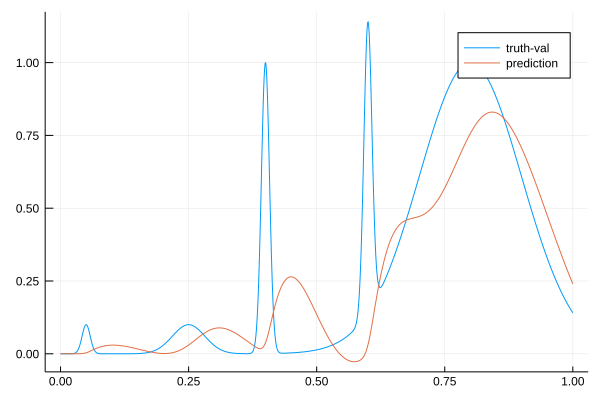

132.0087989370094 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.29782264993088 
  22.749175203569518
  12.537399675552903
  25.37105021555552 
 -19.45710369686405 
   0.1              

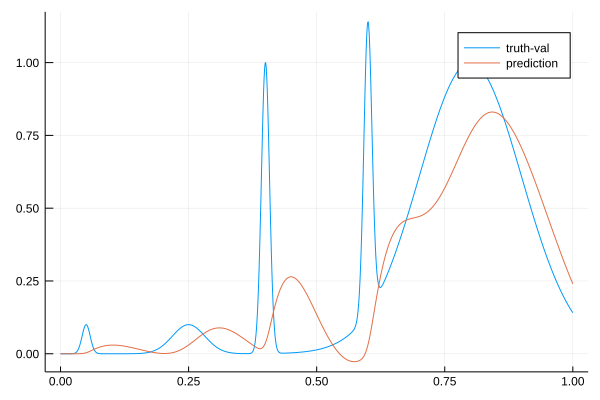

131.98952087573386 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.295608149118607
  22.76873288822936 
  12.49169015270422 
  25.390779342127434
 -19.473761010172307
   0.1              

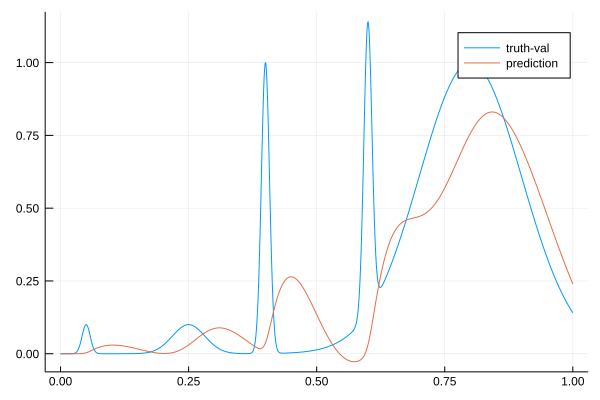

131.97017584948964 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.294573415549017
  22.788208470154608
  12.445913351399522
  25.41053192655285 
 -19.490506768689194
   0.1              

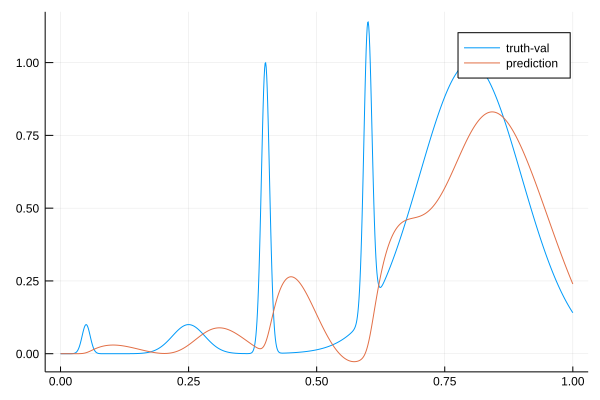

131.9507598598935 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.294907170830108
  22.807625072763855
  12.400067157590936
  25.430348182372104
 -19.507328389210763
   0.1              

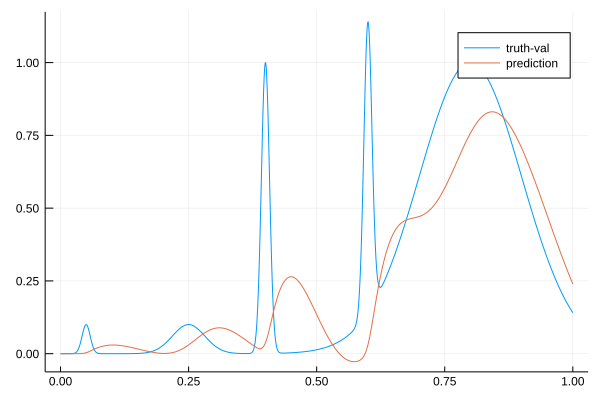

131.9317814939385 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.29677850148779 
  22.827003863828264
  12.354149285707924
  25.450264548518437
 -19.524214906361927
   0.1              

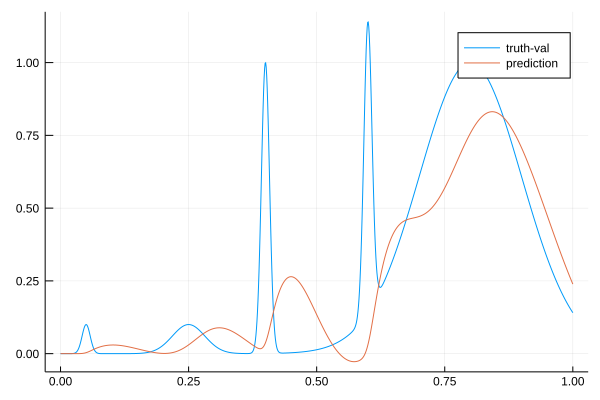

131.91227600425614 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.28825655287962 
  22.84716066589522 
  12.30860337640366 
  25.470051564760773
 -19.54149930406803 
   0.1              

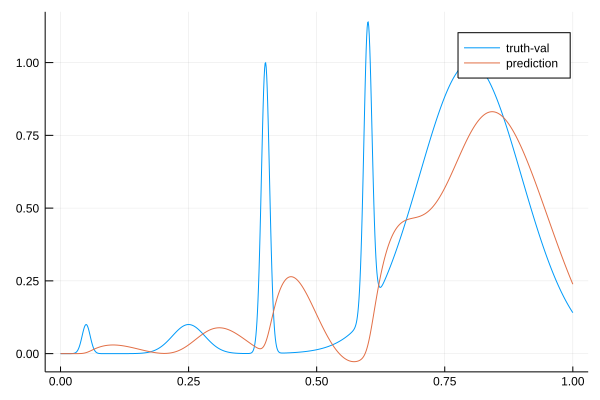

131.89260333003594 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.270695250193473
  22.868036282885864
  12.263387842069953
  25.4897676174236  
 -19.559135795986066
   0.1              

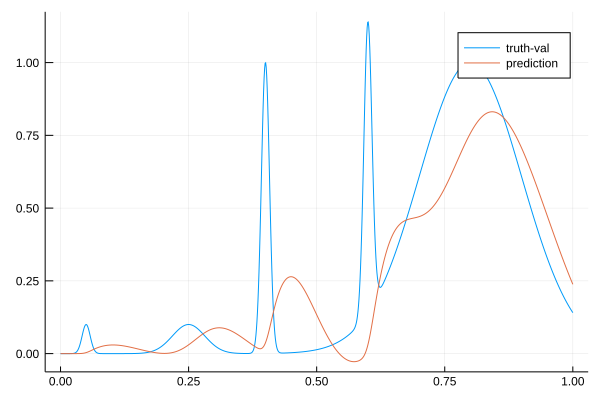

131.8733019309624 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.26530583376194 
  22.888503229415917
  12.217896109174843
  25.510150906543213
 -19.576381024775277
   0.1              

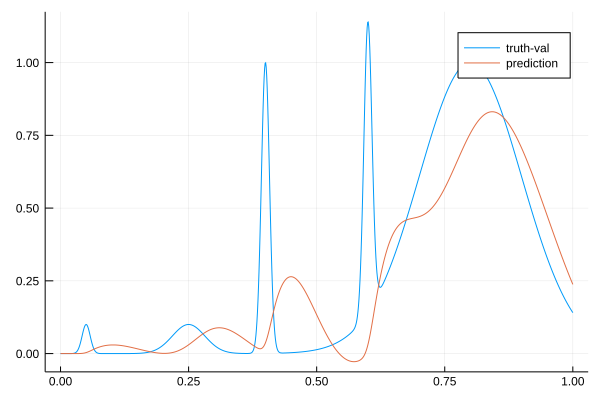

131.8540217268472 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.25906675136705 
  22.90941966554151 
  12.172597874698877
  25.53091970860464 
 -19.593609940472483
   0.1              

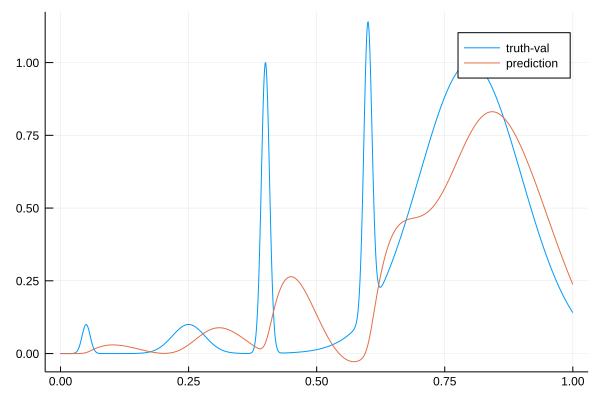

131.8346667669362 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.252370996245556
  22.930758506761183
  12.127467999487232
  25.552081517034445
 -19.610818801805532
   0.1              

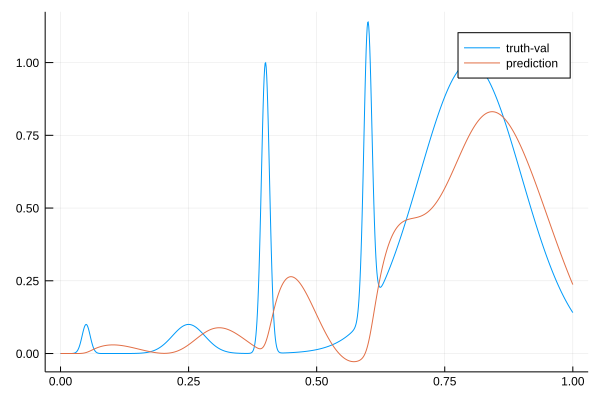

131.81525039333715 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.245574644054727
  22.952495460285185
  12.082483855136472
  25.573643310295196
 -19.628004555621953
   0.1              

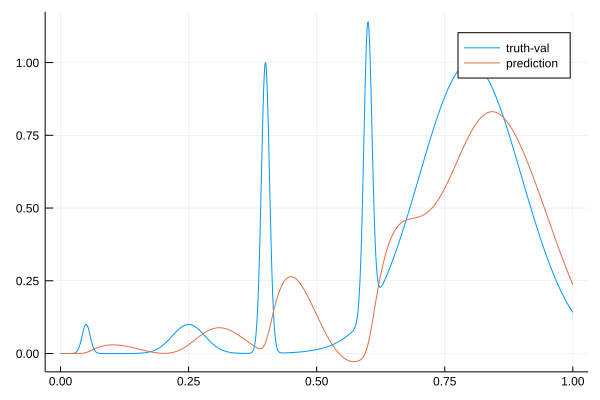

131.79583036435238 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.2391139632817  
  22.974562170255226
  12.037624353581682
  25.595574102052616
 -19.645168534826595
   0.1              

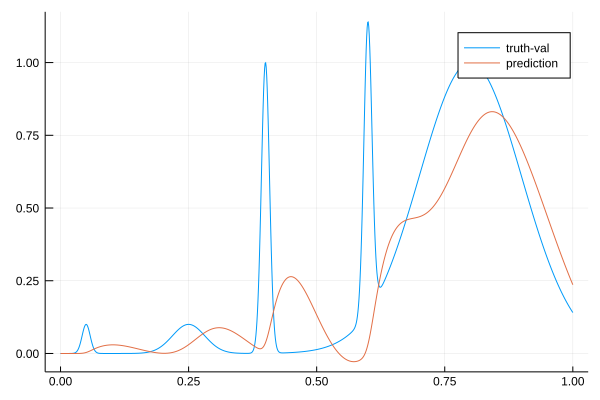

131.77664255857408 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.233267405273917
  22.996943812886798
  11.992870864014334
  25.61788344996854 
 -19.662308876364015
   0.1              

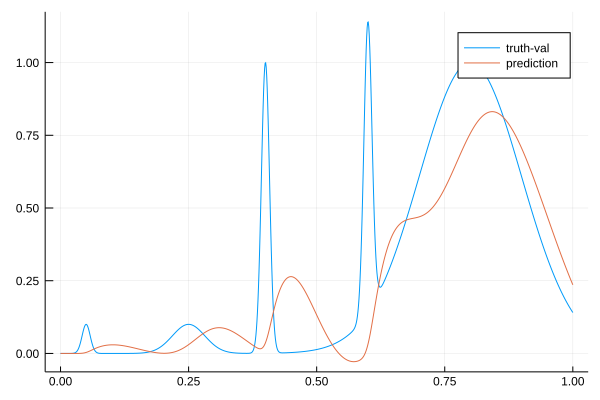

131.75765422466552 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.22862537539747 
  23.01929862387223 
  11.948174627750575
  25.640274603420693
 -19.679479448881793
   0.1              

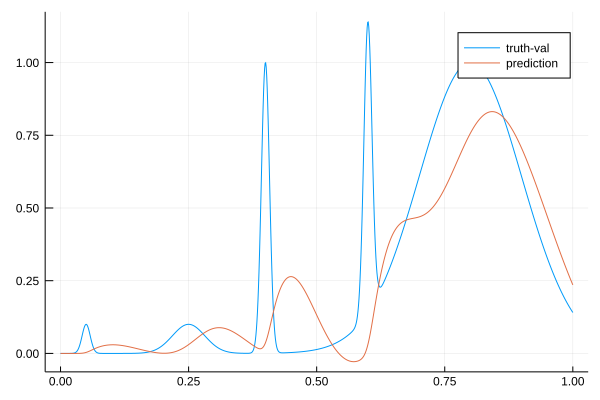

131.73861801997975 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.22537551995802 
  23.041647116623817
  11.90352300981198 
  25.662784940352147
 -19.696674806380244
   0.1              

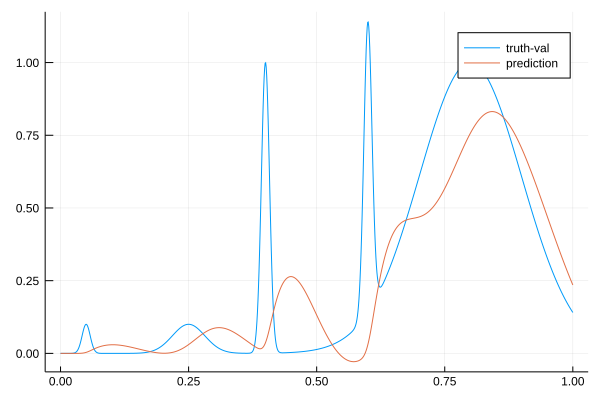

131.71907842132248 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.223684922970335
  23.06400806473671 
  11.858904156751272
  25.685448188821457
 -19.71389053135984 
   0.1              

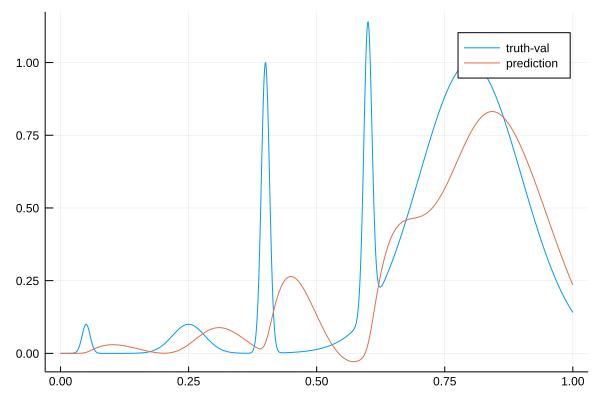

131.6994218778381 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.223696170645443
  23.08639863334729 
  11.81430555277173 
  25.708294226916017
 -19.731121823949447
   0.1              

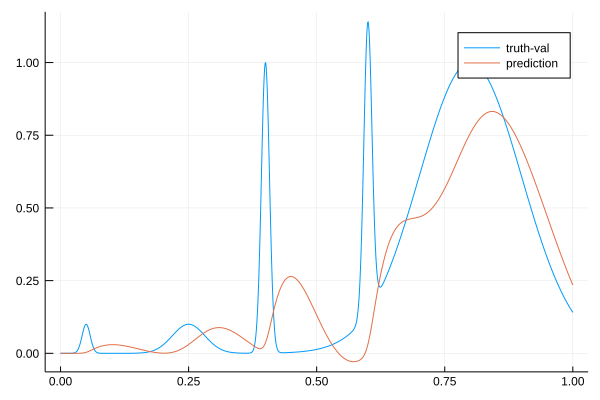

131.67966793715257 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.225544048092324
  23.10883471735163 
  11.769716460649061
  25.73135091302837 
 -19.748366061939194
   0.1              

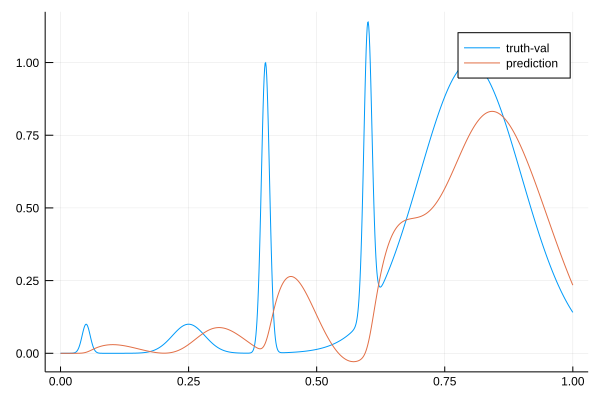

131.65992175647995 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.229346812640813
  23.131330983435593
  11.725126531360116
  25.75464337067748 
 -19.765621599384346
   0.1              

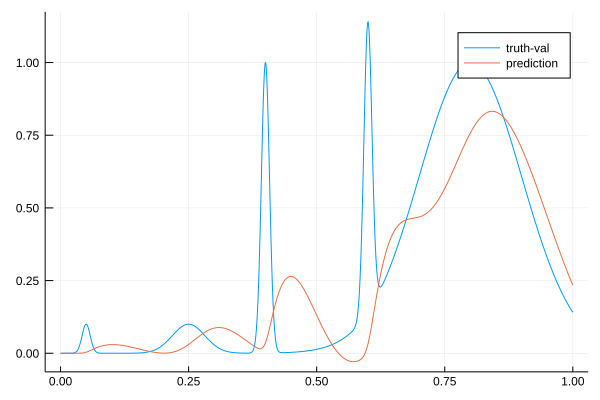

131.64019891065786 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.235638299412475
  23.153760034888187
  11.680520043765762
  25.778088203475633
 -19.782896216743993
   0.1              

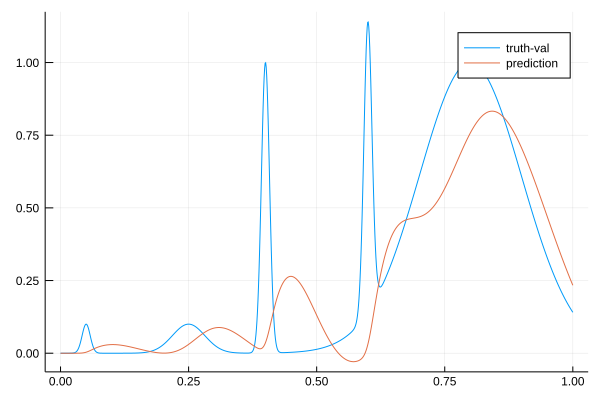

131.6205712474286 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.236366940469672
  23.176434666181457
  11.636016104215976
  25.801296901897267
 -19.800555584367995
   0.1              

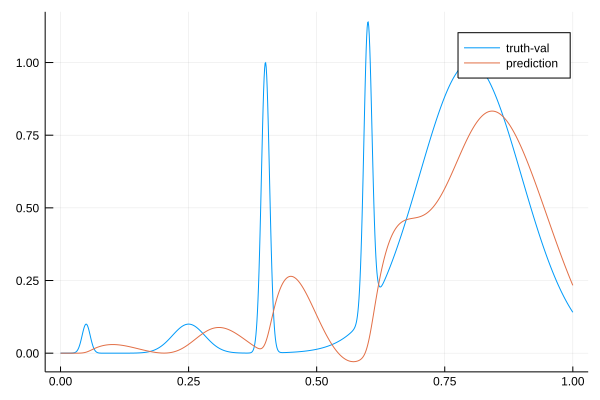

131.60077146974717 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.232374041476813
  23.19935153998222 
  11.591596109665034
  25.824340180311353
 -19.81856182806278 
   0.1              

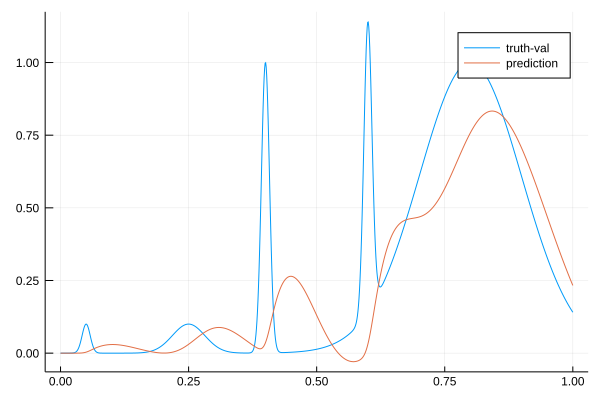

131.5809122093995 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.224432569577587
  23.222507665611957
  11.547245148685793
  25.847283252108856
 -19.836878929991542
   0.1              

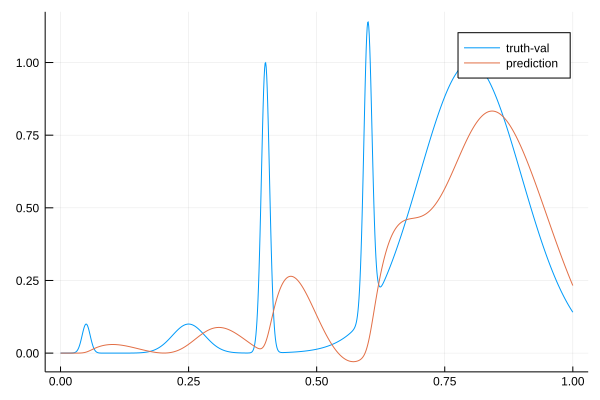

131.56098221425341 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.22139084337948 
  23.245610751529274
  11.502821760774323
  25.87060407118068 
 -19.855104828580792
   0.1              

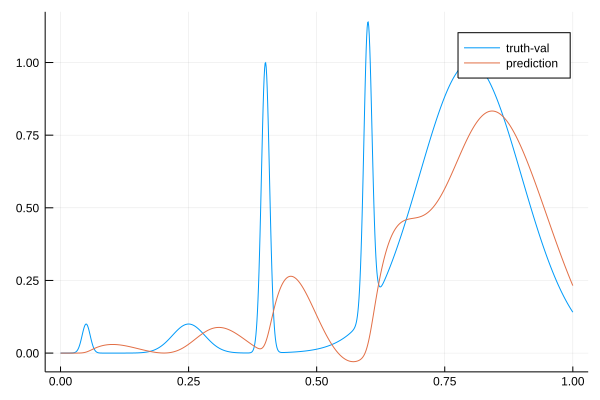

131.540866385067 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.22308969359784 
  23.268686458334756
  11.458325940586803
  25.89431454968153 
 -19.87324635319847 
   0.1              

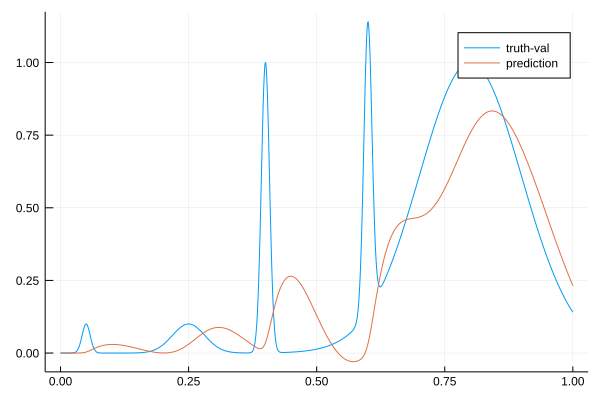

131.52129251640045 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.22120531675042 
  23.292050320056195
  11.413886205062168
  25.918007853174824
 -19.891680852340123
   0.1              

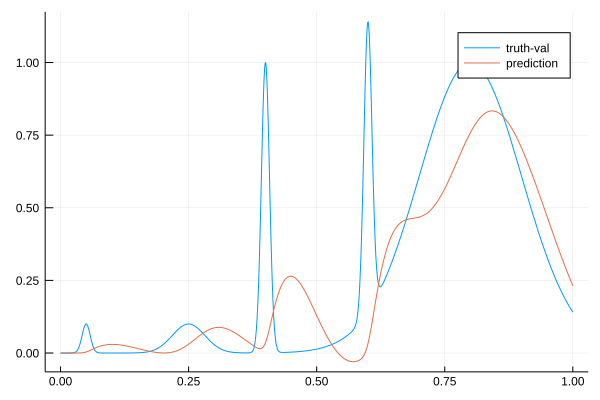

131.5017391244097 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.21674302884851 
  23.315361182003016
  11.369457586419365
  25.94142355778638 
 -19.91043579509984 
   0.1              

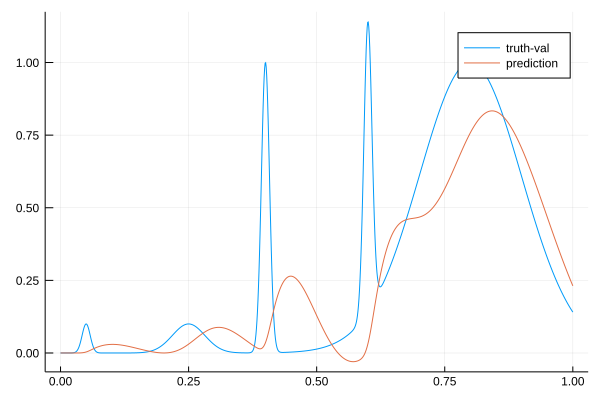

131.48635919995718 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.218475470748732
  23.338352176778265
  11.324901961228269
  25.965056133368776
 -19.929107226207012
   0.1              

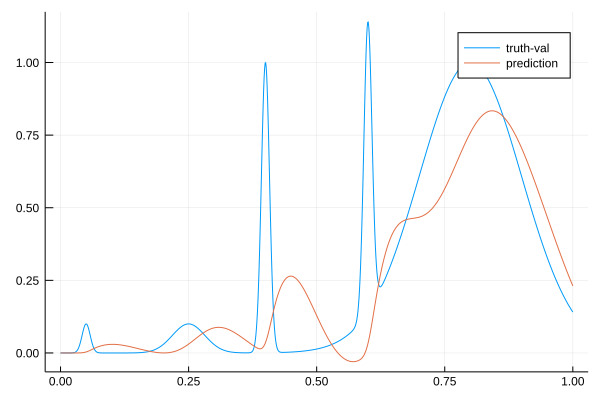

131.466557696385 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.217858560184403
  23.36136988505631 
  11.280355998461989
  25.98851282977908 
 -19.948077154769898
   0.1              

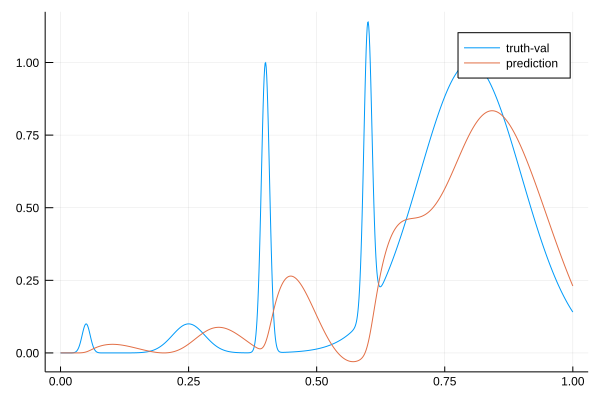

131.44673526258026 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.21554514495418 
  23.38438742670901 
  11.235810995209969
  26.011823373787973
 -19.967319708688475
   0.1              

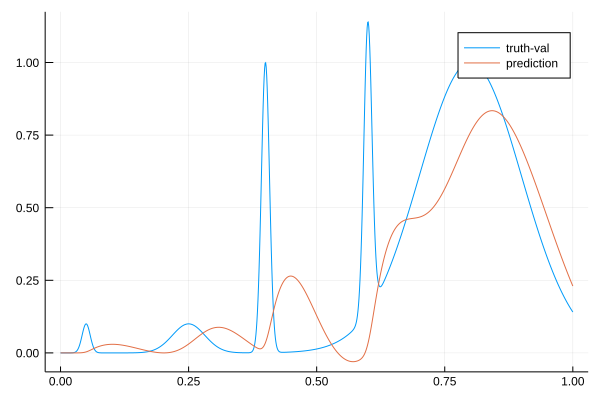

131.4268175913808 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.21202135582719 
  23.407427895805828
  11.191260513081046
  26.035053972340094
 -19.986806240409074
   0.1              

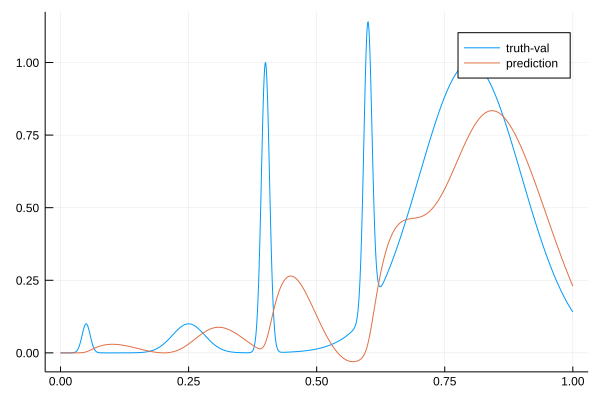

131.40684173433235 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.207731838236157
  23.430512358172564
  11.14669935560402 
  26.058265077817886
 -20.00651021147991 
   0.1              

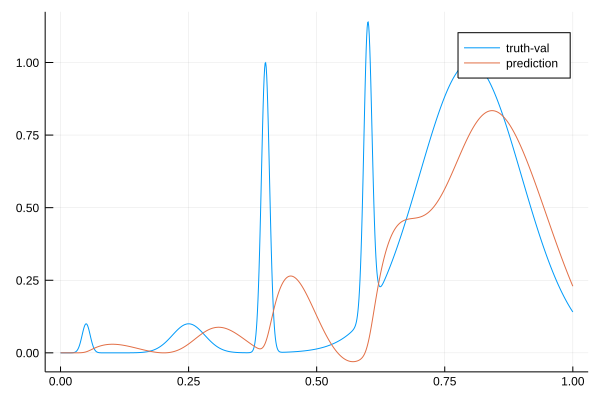

131.38675373614865 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.21136527442147 
  23.453360150328724
  11.101990267850958
  26.0819260626337  
 -20.02603342169454 
   0.1              

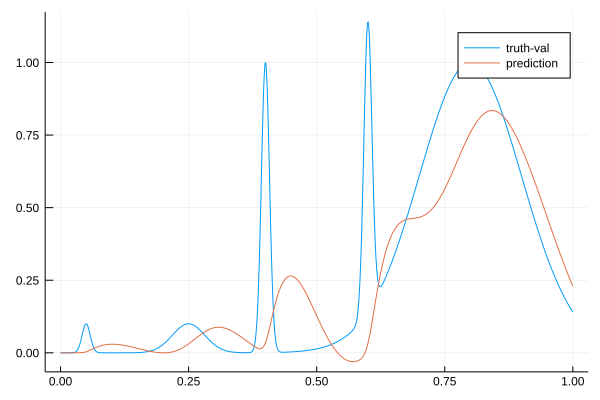

131.36657887005185 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.214171111978413
  23.47631885865196 
  11.057272628105101
  26.1056304600429  
 -20.045767430677255
   0.1              

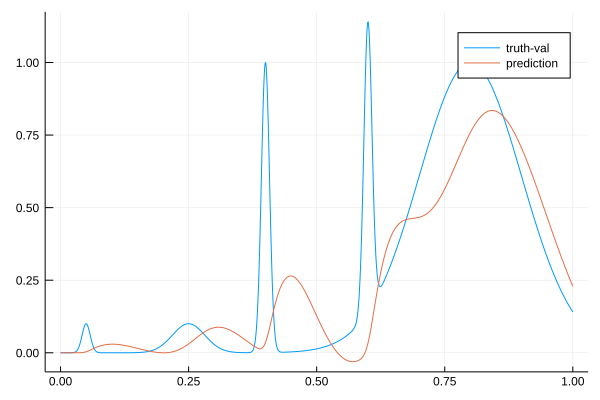

131.34632649642654 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.21654709566761 
  23.499402150329406
  11.012539372722854
  26.129426842134745
 -20.06569096483948 
   0.1              

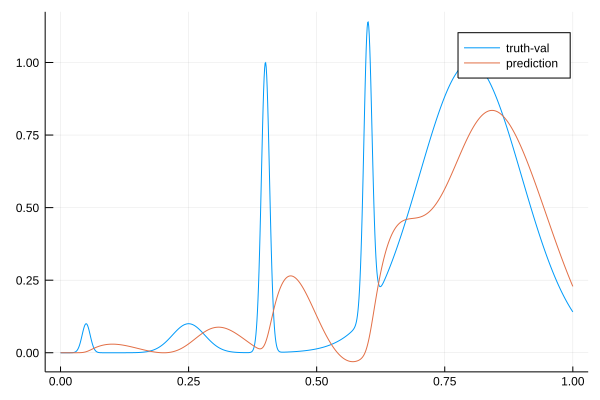

131.32596125263933 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.218855564447953
  23.522622629770854
  10.967784391131328
  26.15335956202013 
 -20.08578461525229 
   0.1              

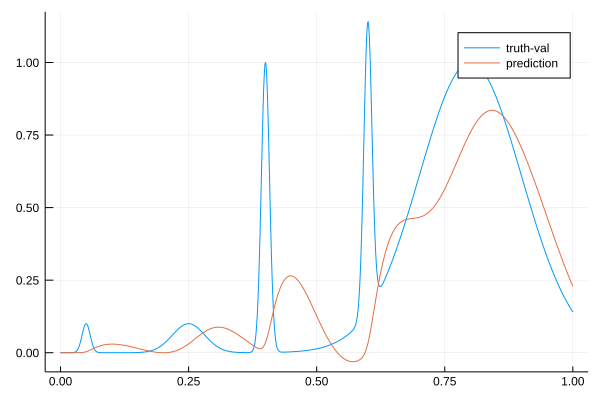

131.3054708351117 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.2214261140905  
  23.545991999634367
  10.923002263227342
  26.177469149558398
 -20.106030820443202
   0.1              

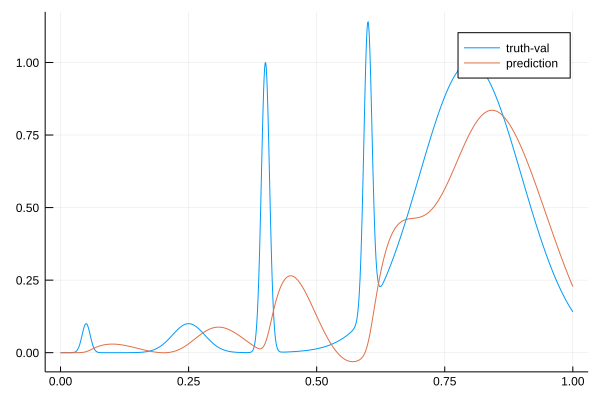

131.28508257669492 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.224557915210283
  23.5695211799408  
  10.878188045812346
  26.201792637146394
 -20.126413837867158
   0.1              

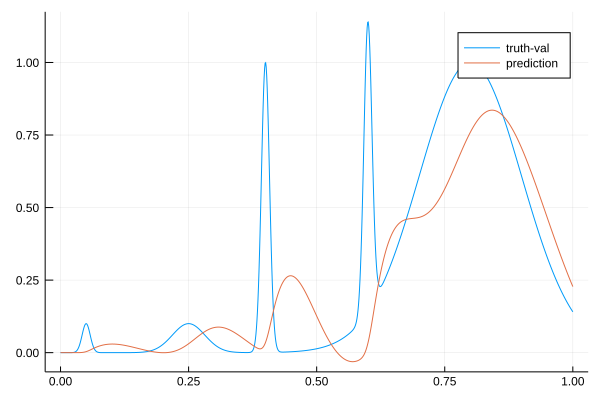

131.26530028206267 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.22887056999787 
  23.59287959810856 
  10.833304315002808
  26.226045479919588
 -20.146978869666405
   0.1              

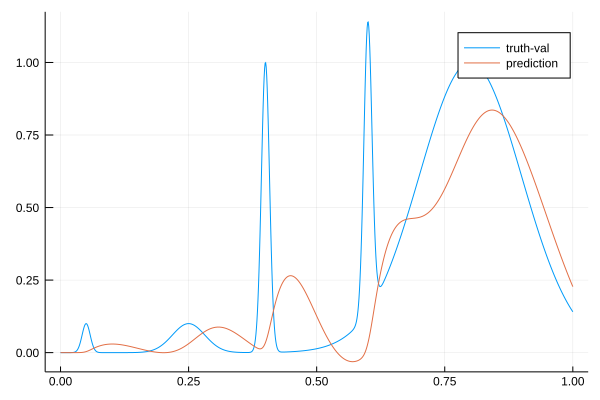

131.2449812003934 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.221404094967227
  23.61698315561218 
  10.788841376621843
  26.2500415885118  
 -20.168045550875316
   0.1              

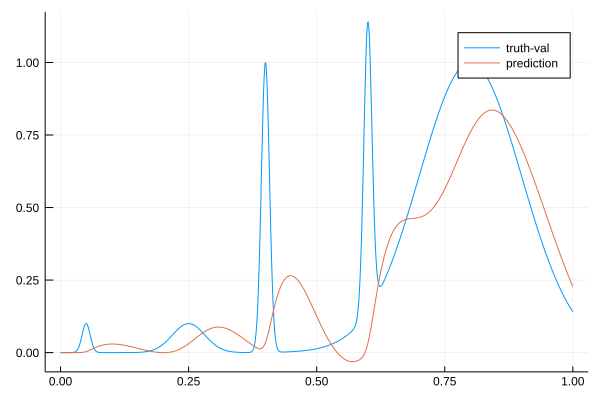

131.22481084141438 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.203682999017175
  23.64178622195633 
  10.744755172800478
  26.273864256131343
 -20.189560035711406
   0.1              

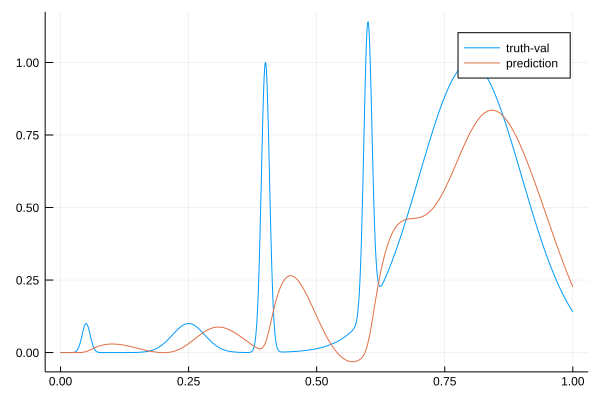

131.205569252327 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.18534433841374 
  23.6663250149874  
  10.70050926261067 
  26.297365461075234
 -20.211127101688273
   0.1              

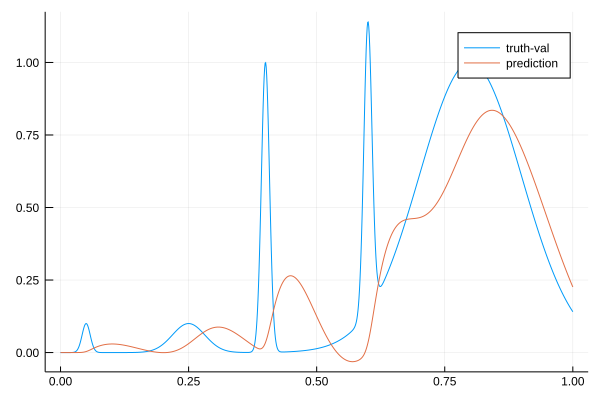

131.18608801809046 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.175242182019538
  23.690339232776296
  10.65598381693891 
  26.321044917103123
 -20.2323544774925  
   0.1              

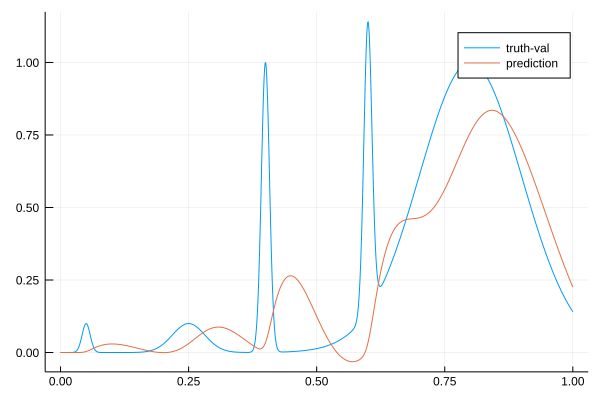

131.16633135717493 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.17292724586883 
  23.713905255932296
  10.611204196478251
  26.344941798391517
 -20.25327024185595 
   0.1              

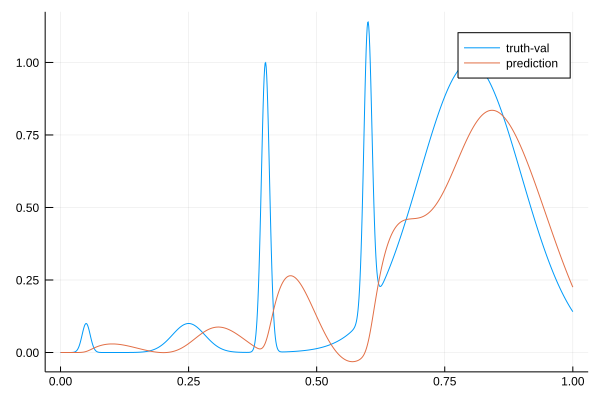

131.14627941019526 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.177973655276848
  23.737092362272147
  10.566190145916465
  26.369090262147157
 -20.273902129494267
   0.1              

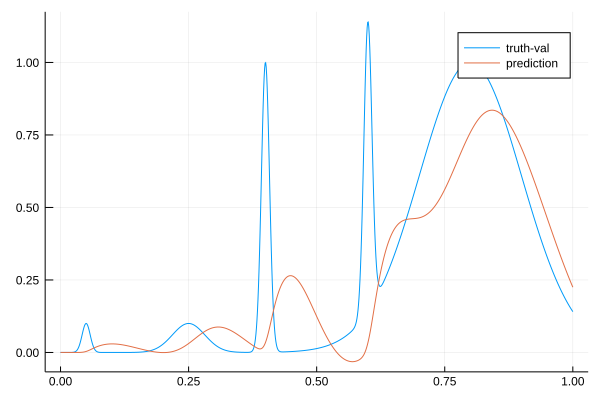

131.1259095555481 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.189977825752806
  23.759963444261473
  10.520956486775582
  26.39352008019851 
 -20.294277471712345
   0.1              

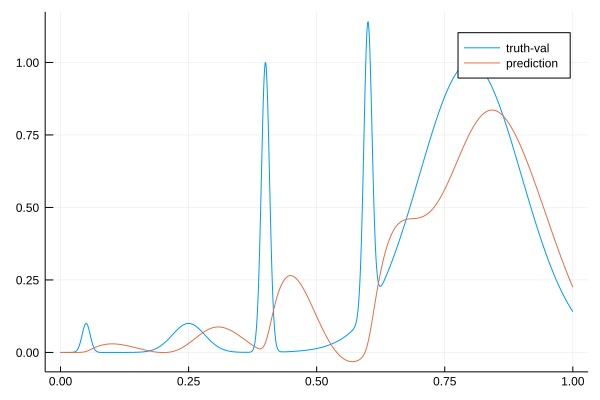

131.10654927354943 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.20855747950252 
  23.78257565746033 
  10.47551373186547 
  26.418257206563943
 -20.31442314043819 
   0.1              

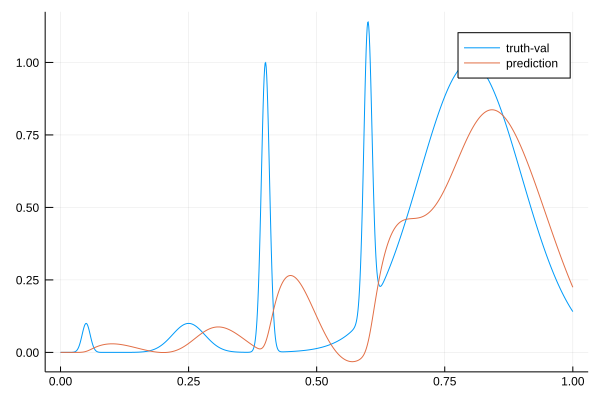

131.08689036056217 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.211664304001072
  23.806143335057254
  10.430509050776891
  26.44263621409653 
 -20.33508864795407 
   0.1              

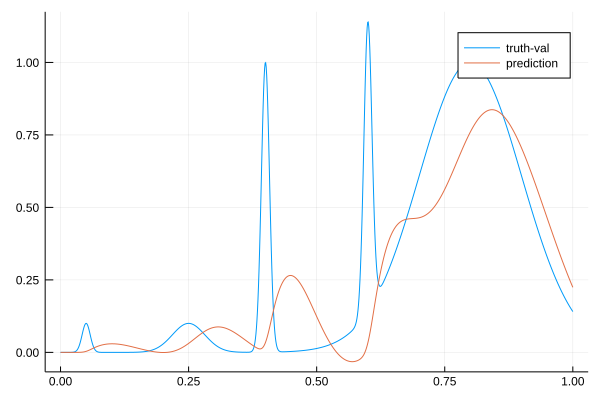

131.0664209068404 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.20119761481957 
  23.830601935051682
  10.385893086283243
  26.46674967038281 
 -20.35622175365221 
   0.1              

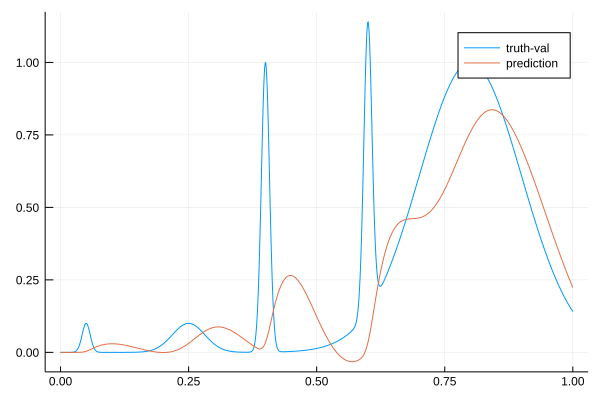

131.04600918629404 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.18727588039026 
  23.855572535406584
  10.341486551385088
  26.49108954180073 
 -20.37738686229274 
   0.1              

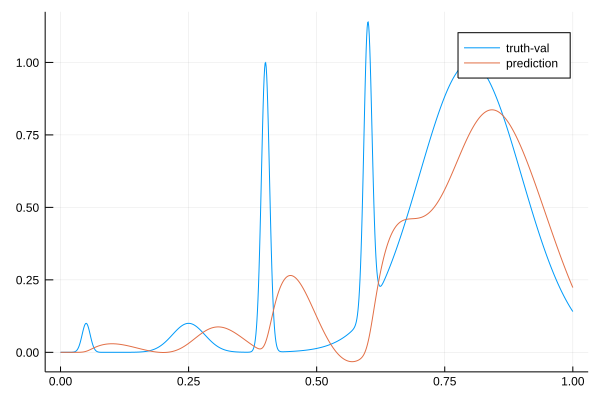

131.02614335617284 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.170944129364692
  23.88068731902751 
  10.29723535267688 
  26.515370538583266
 -20.398634872948534
   0.1              

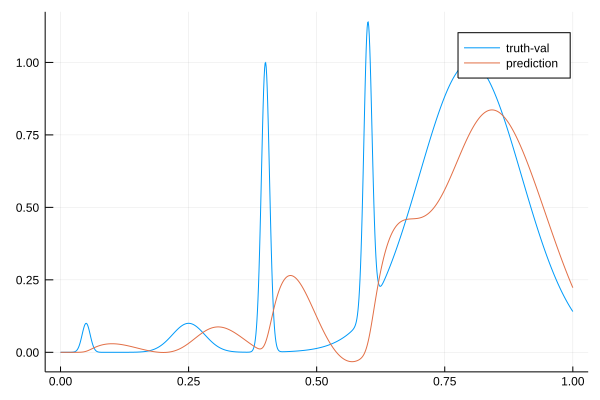

131.00625646343158 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.16620404552683 
  23.905059975897252
  10.252618458258127
  26.539898187963807
 -20.419616906965445
   0.1              

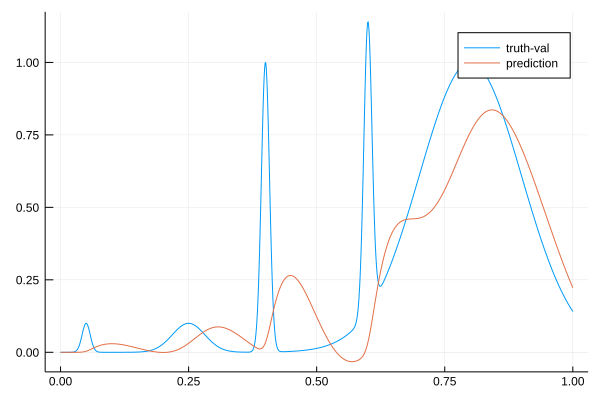

130.9861483881498 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.172246933032586
  23.928790822792955
  10.20766777671286 
  26.5647069152767  
 -20.440355930015773
   0.1              

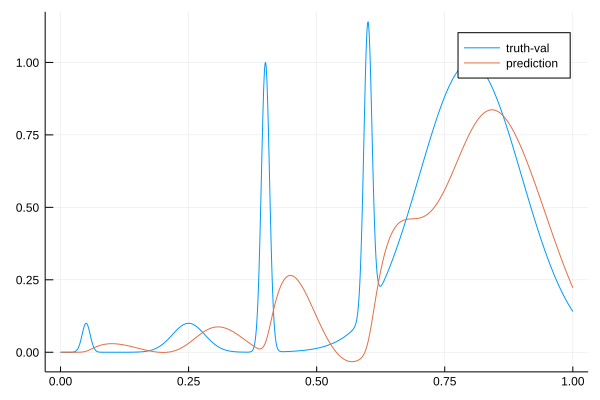

130.96613006775755 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.174922518750066
  23.95287650452036 
  10.162917164194488
  26.589589520076807
 -20.461208806406752
   0.1              

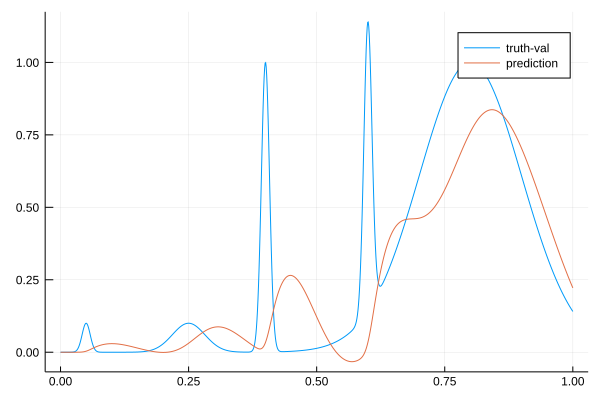

130.94597935622195 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.174881360327397
  23.977312278002717
  10.118340754910777
  26.614597745142007
 -20.482163041963986
   0.1              

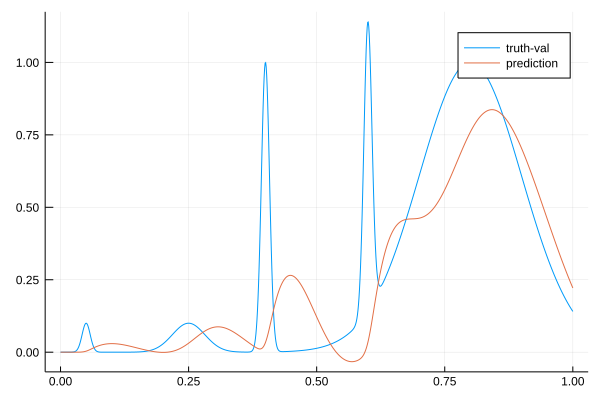

130.92570217611106 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.17271751651132 
  24.002094017723802
  10.073916206658794
  26.639779065449947
 -20.503206585832398
   0.1              

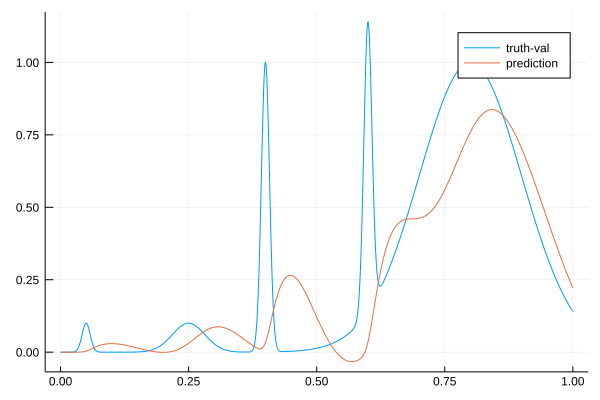

130.90530093154916 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.168972795323622
  24.027218200361496
  10.029624120065813
  26.665177011190888
 -20.524328028105657
   0.1              

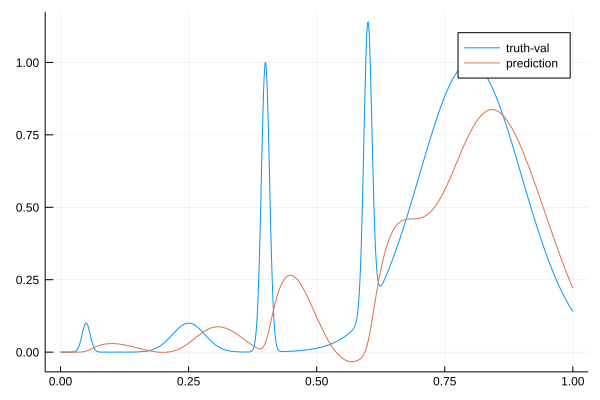

130.88477499952788 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.164140700545197
  24.052681887841807
   9.985447532605486
  26.690831470662093
 -20.54551675559891 
   0.1              

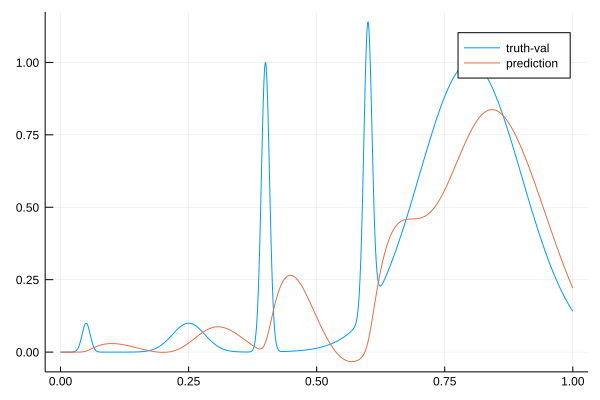

130.8641212300144 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.158670095753845
  24.078482709632354
   9.941371479213629
  26.716778974683073
 -20.56676307151862 
   0.1              

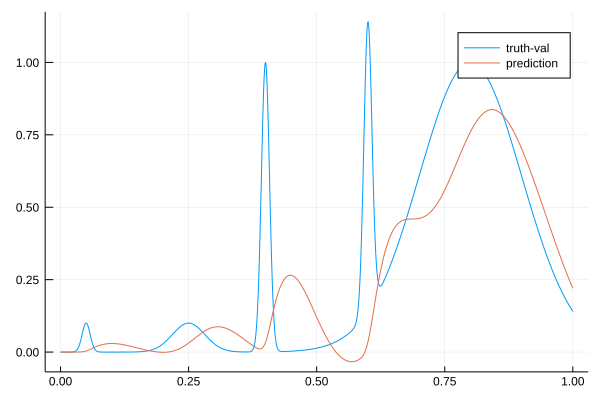

130.84333440750072 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.152968603776646
  24.10461884479066 
   9.89738261204338 
  26.743052963729003
 -20.58805828414789 
   0.1              

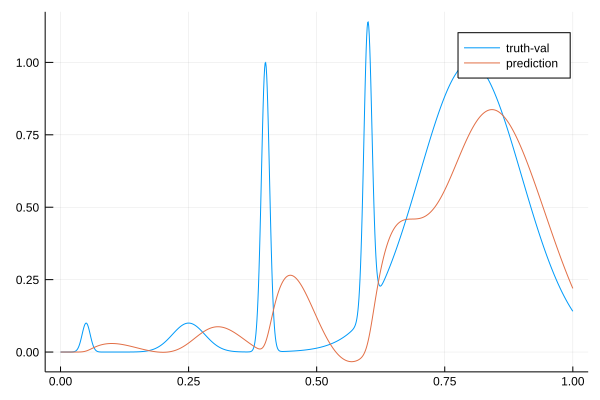

130.82240694292784 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.147405758698245
  24.13108900409271 
   9.85346887260137 
  26.769684038740845
 -20.60939476895265 
   0.1              

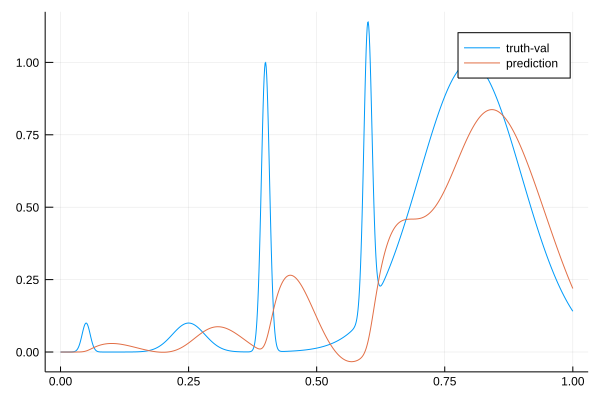

130.80162463422792 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.14231593409208 
  24.157892412423273
   9.809619210113297
  26.796700197022066
 -20.630766007918773
   0.1              

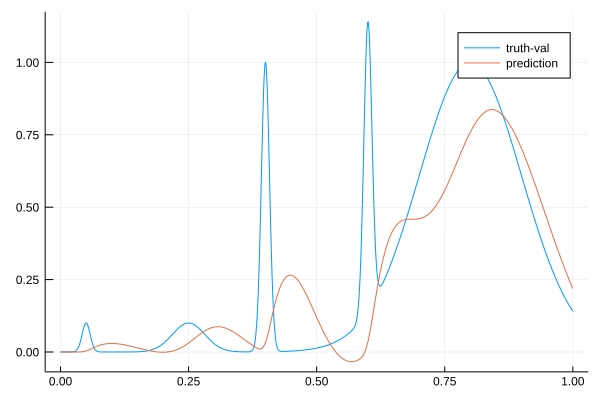

130.78031006574167 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.138353100608338
  24.184678623412122
   9.765789682191933
  26.823798254606064
 -20.652229756443706
   0.1              

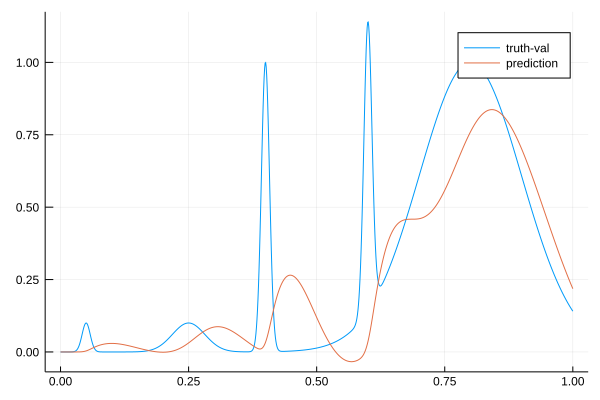

130.75975315041924 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.14958466162233 
  24.21050755377672 
   9.721451467192319
  26.851223477696383
 -20.673453020544386
   0.1              

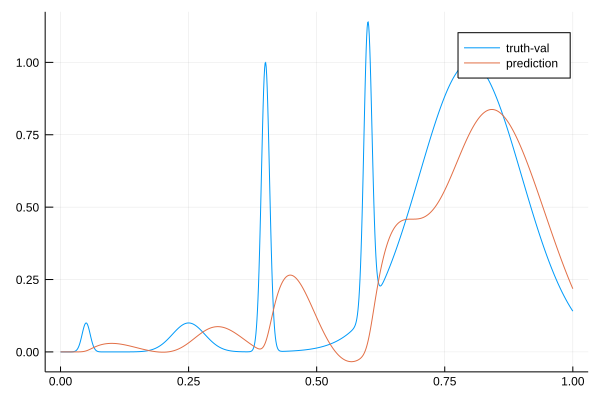

130.73901878832186 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.161092151606486
  24.23643648436753 
   9.677167479549786
  26.878777118910627
 -20.694792485605767
   0.1              

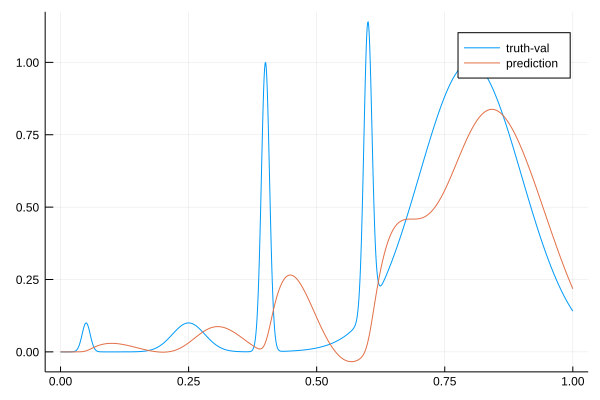

130.71813217571818 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.173159416759496
  24.262489779170036
   9.632922302097276
  26.906508319109122
 -20.716240273360764
   0.1              

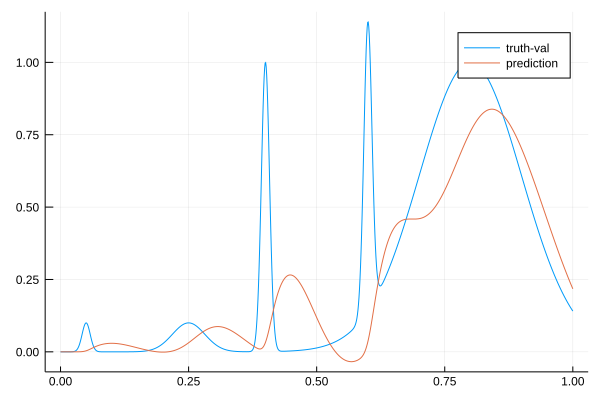

130.6969932829765 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.18604311090625 
  24.28869026494765 
   9.58870179454529 
  26.934462288097116
 -20.737789835379658
   0.1              

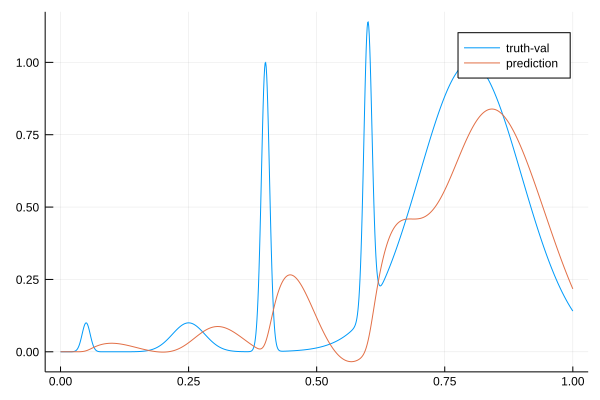

130.67560763060476 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.19997546654326 
  24.315059000979353
   9.544492815682425
  26.9626803116528  
 -20.75943549230187 
   0.1              

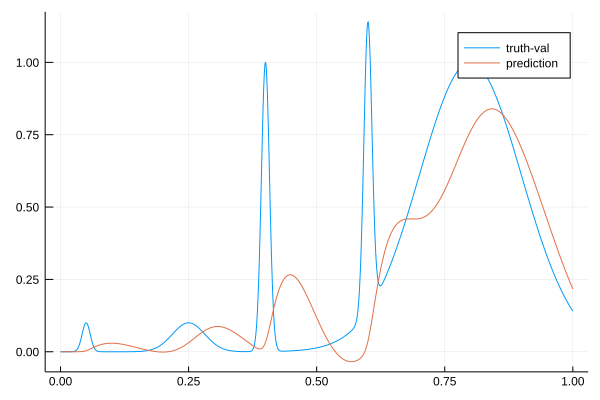

130.65398793497832 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.21516598676067 
  24.341615492875217
   9.500283021481936
  26.9912001220309  
 -20.781172482226715
   0.1              

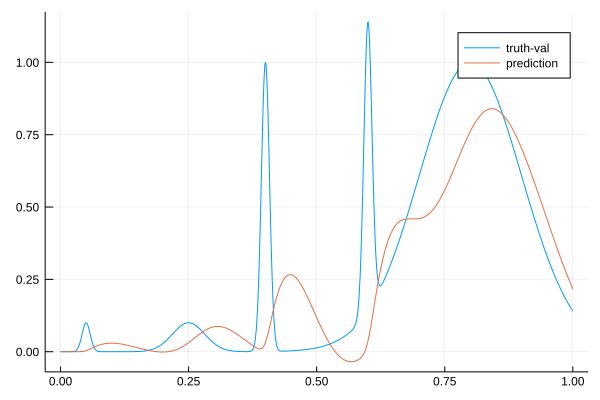

130.6323966926808 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.2318030134626  
  24.3683778768264  
   9.456060703480789
  27.020056228250954
 -20.80299700033643 
   0.1              

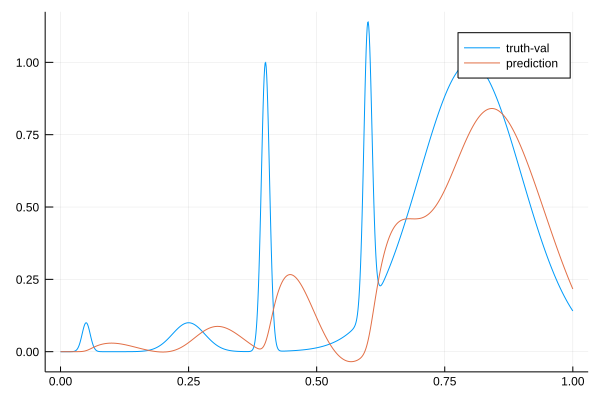

130.61080057585409 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.241338889242538
  24.395711693739923
   9.411963419246483
  27.048891501946795
 -20.825301379598503
   0.1              

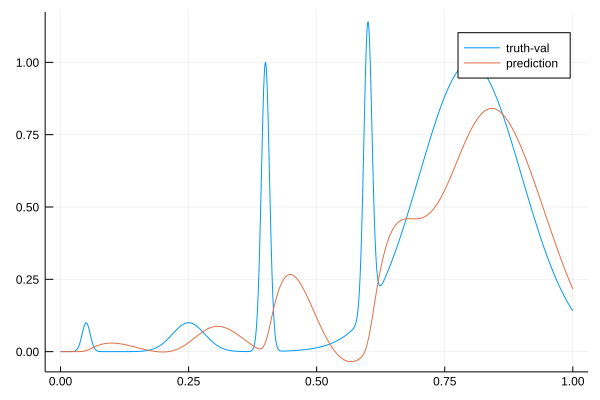

130.5882120343451 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.230856253880237
  24.424545563920894
   9.368506425996413
  27.07754806594395 
 -20.848371105143965
   0.1              

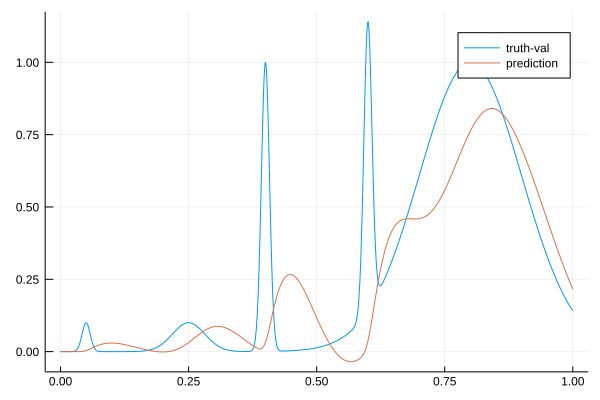

130.56649686415724 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.216668587237876
  24.453823063035372
   9.325088054515541
  27.10634292630071 
 -20.87179858081138 
   0.1              

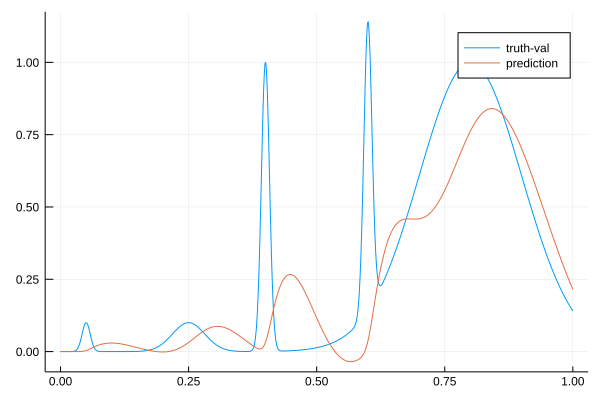

130.54490177368743 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.208568440062823
  24.482830550650867
   9.281520443063945
  27.13538571440588 
 -20.89521333559111 
   0.1              

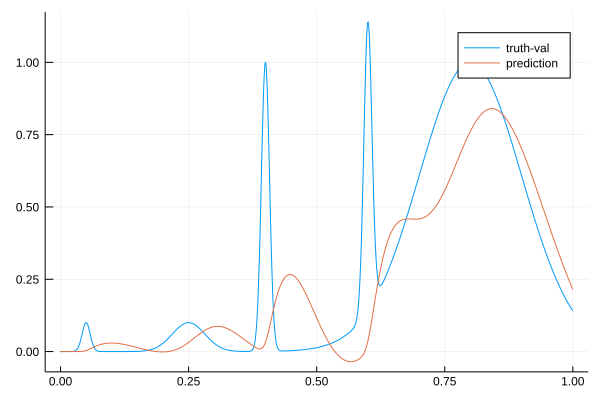

130.52303620176946 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.206327937480832
  24.511632687446745
   9.237816004776013
  27.164722726067353
 -20.918614667000917
   0.1              

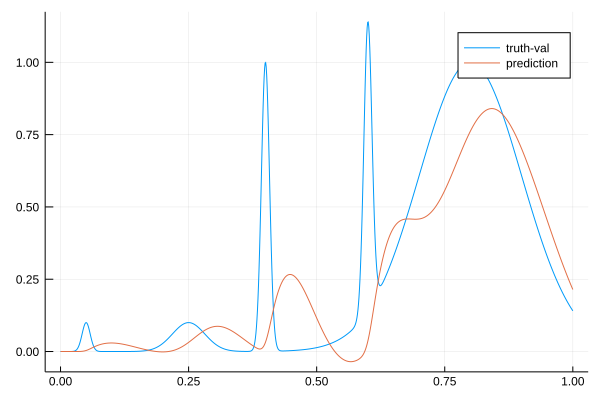

130.50086879330317 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.209729898036347
  24.54028846725705 
   9.1939835880929  
  27.194395448826878
 -20.942003795282787
   0.1              

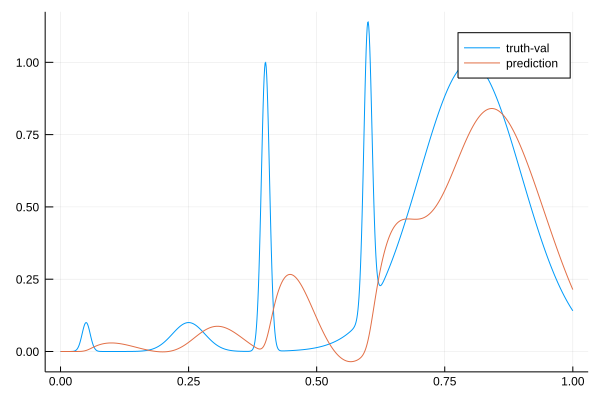

130.47833096575863 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.218567274031628
  24.568851807005807
   9.150028877663981
  27.224441134994972
 -20.9653836473127  
   0.1              

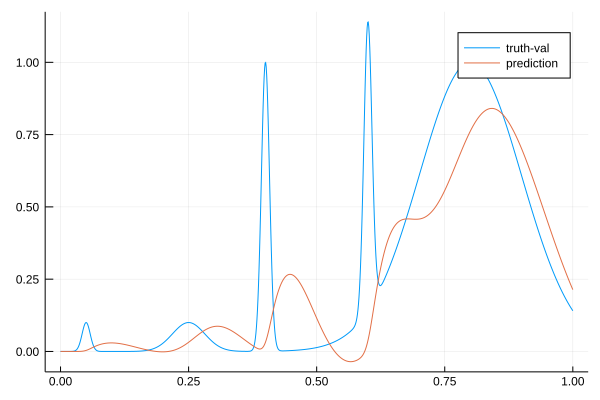

130.45540600739955 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.23264275150363 
  24.597372156937467
   9.105954699190404
  27.254893404356327
 -20.988758702069326
   0.1              

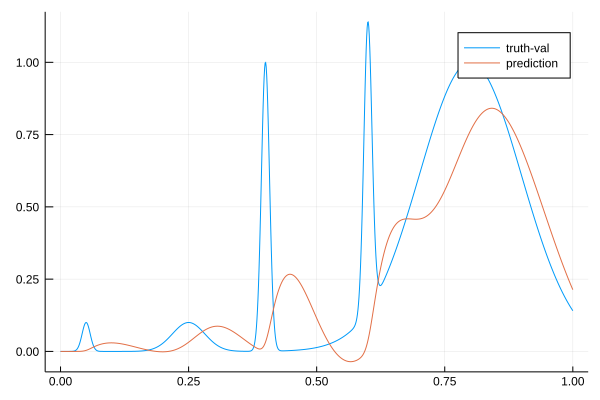

130.43280612975795 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.251859145388988
  24.625847160600205
   9.061760731195085
  27.28574148090961 
 -21.012141486945367
   0.1              

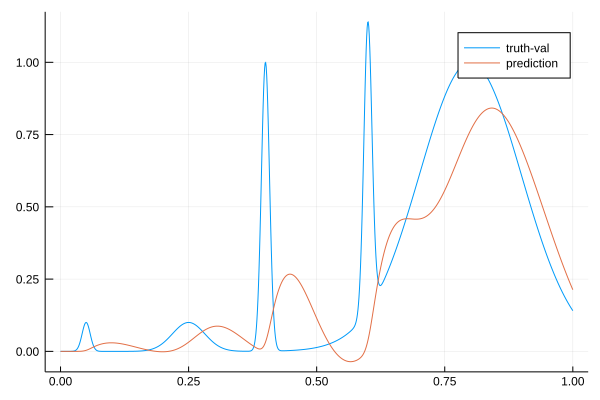

130.41211163978053 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.261895002126604
  24.655288756444705
   9.017992499678599
  27.316797879000926
 -21.035863945505046
   0.1              

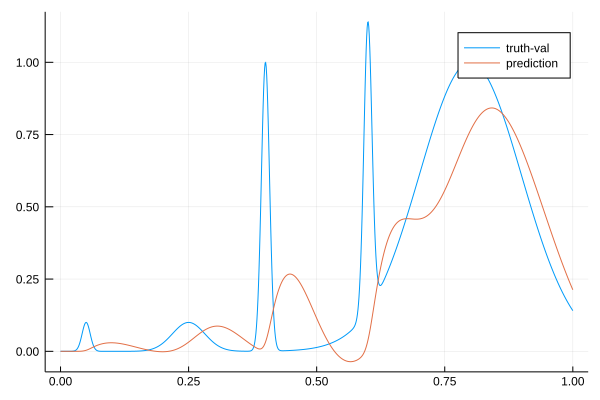

130.38787130812455 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.255225648854125
  24.68601011119394 
   8.97475420481974 
  27.347738218177824
 -21.060298112060327
   0.1              

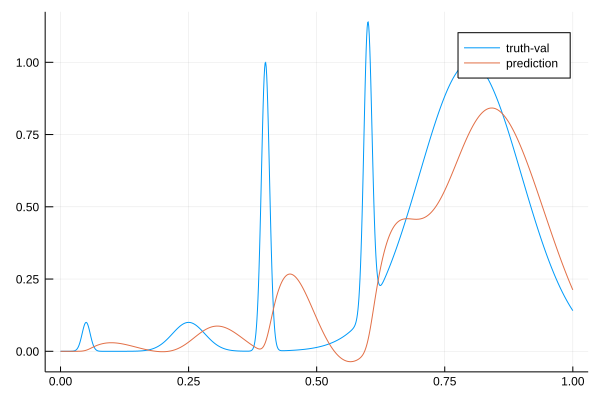

130.36375450487841 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.242970564931355
  24.717420084278434
   8.93183210738977 
  27.378908207474886
 -21.084995542585954
   0.1              

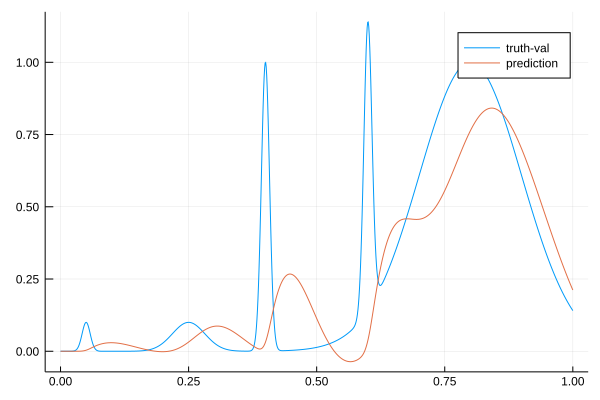

130.3410063416951 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.226056589737315
  24.74949482652146 
   8.889194233377504
  27.41036394411446 
 -21.109926953271383
   0.1              

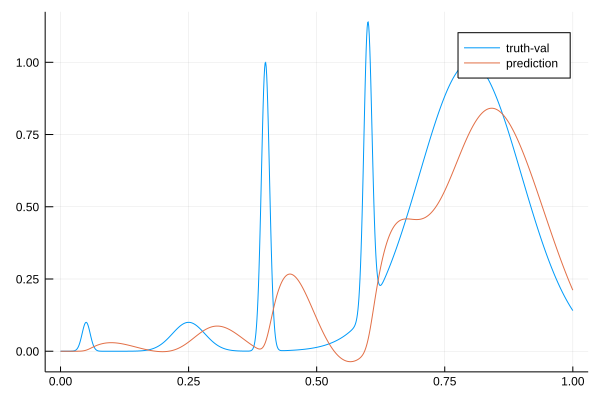

130.3180196810535 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.21986731077012 
  24.780880202107067
   8.846226937619543
  27.442031811114724
 -21.13480860718938 
   0.1              

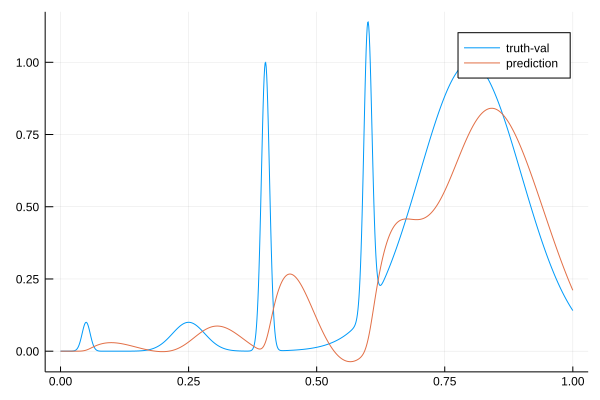

130.29453475923668 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.223711125022913
  24.81168800675383 
   8.802959135494232
  27.473968025294347
 -21.159645394310807
   0.1              

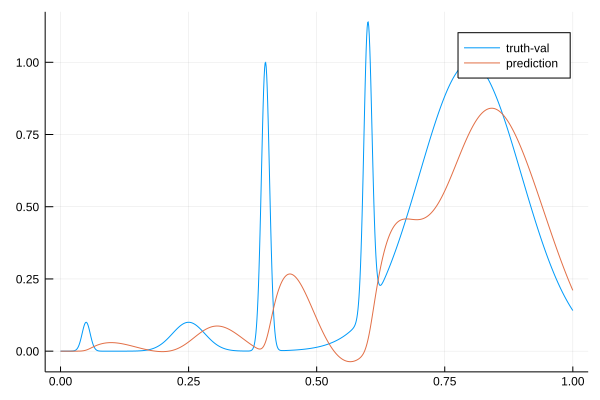

130.2705156618904 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.236942412978443
  24.842019792350236
   8.759412854261969
  27.506222556631975
 -21.18444463529158 
   0.1              

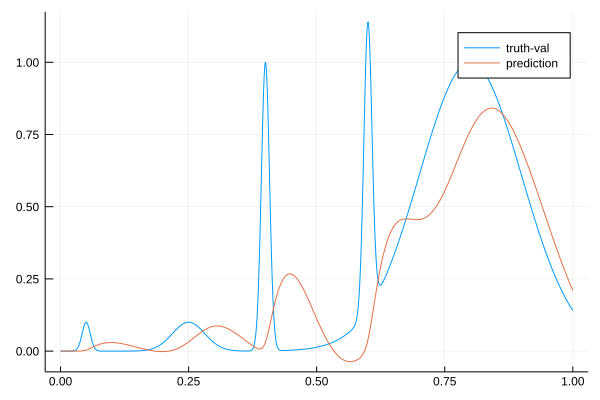

130.24595401933763 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.257526034451825
  24.87198545466433 
   8.715605483110492
  27.538734460213362
 -21.209252260412892
   0.1              

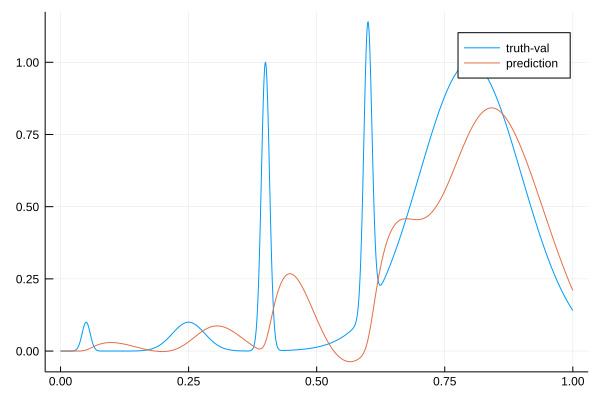

130.22173495913927 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.270839328318317
  24.902651147741274
   8.672105779646555
  27.571344766710236
 -21.234396533200506
   0.1              

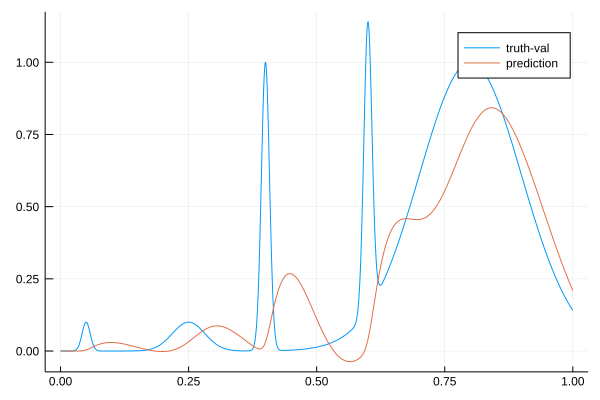

130.19803148010246 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.277933896856272
  24.933996630358244
   8.628872947424224
  27.604122873280257
 -21.25984893946191 
   0.1              

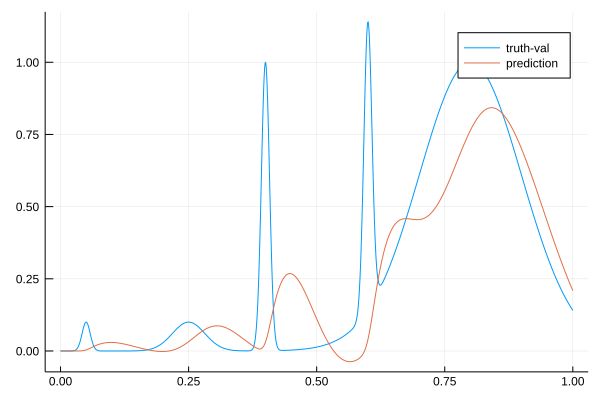

130.17387016857037 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.279763388966426
  24.96600360093945 
   8.58587272816085 
  27.637132019030034
 -21.285582411600082
   0.1              

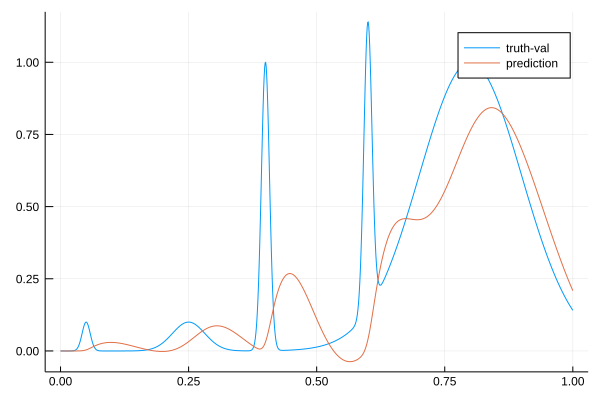

130.14938305644543 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.277200641423793
  24.998655853402568
   8.54307613309372 
  27.67043081575934 
 -21.31157085464906 
   0.1              

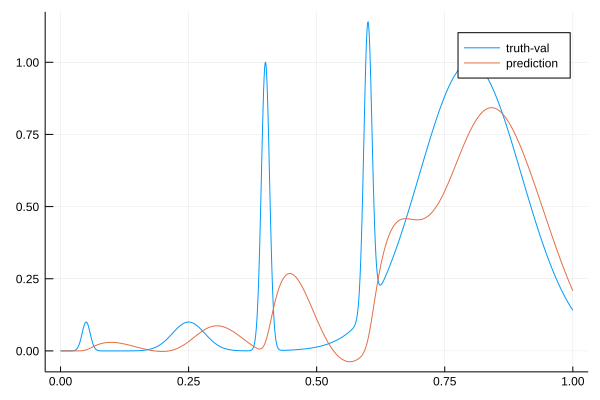

130.12491803068716 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.271127960015562
  25.031891413564214
   8.500457998994701
  27.70403169550225 
 -21.33779682571801 
   0.1              

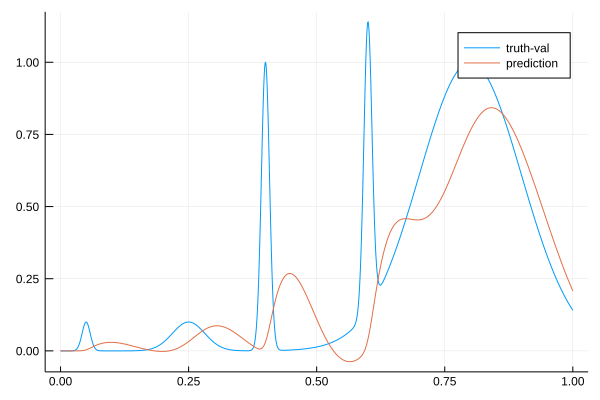

130.10134938670618 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.262607402674707
  25.06533961270306 
   8.457962338519248
  27.73764511945113 
 -21.36430489675042 
   0.1              

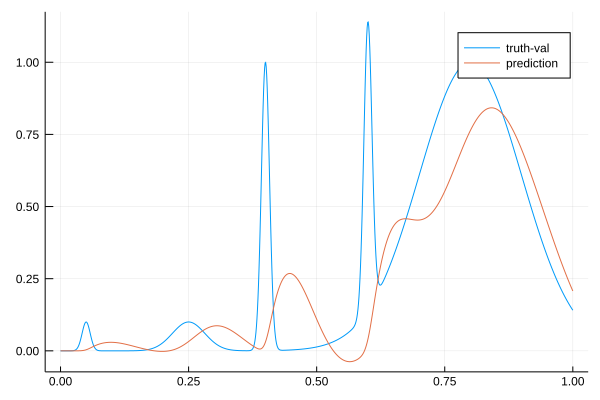

130.0770499345551 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.26666146703767 
  25.098032995857448
   8.415009726386621
  27.77155643617809 
 -21.39074818705433 
   0.1              

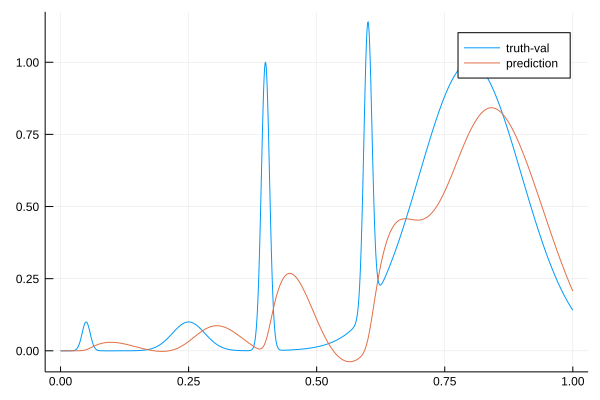

130.0519606294716 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.282383501634595
  25.130095841806376
   8.371637534518811
  27.805818742218502
 -21.41713640742777 
   0.1              

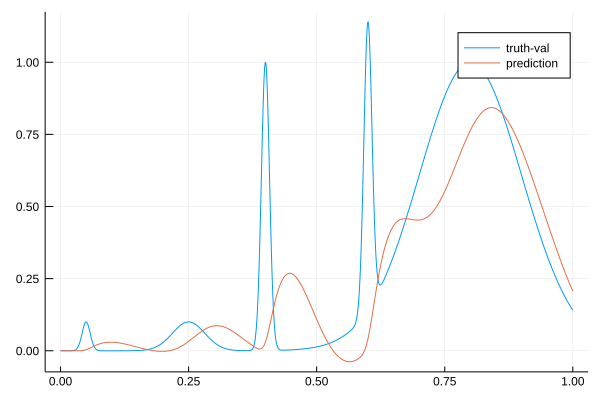

130.02719451035603 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.29457942550891 
  25.16264330426914 
   8.328442739483068
  27.8402801392944  
 -21.44379872722484 
   0.1              

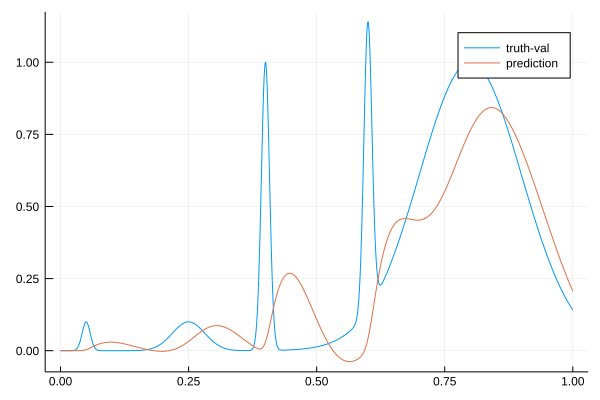

130.00235635727202 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.30394182963416 
  25.195681123073626
   8.285397819506668
  27.875005761804122
 -21.47071303332226 
   0.1              

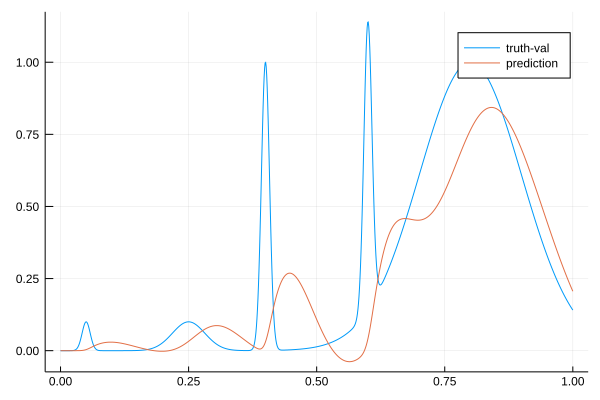

129.97782674396024 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.305819193098998
  25.229131556840134
   8.242472861764053
  27.909520441107283
 -21.497891953348056
   0.1              

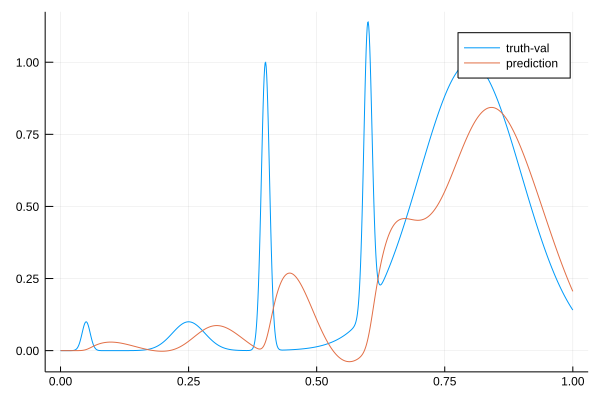

129.95291489615127 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.301313518406822
  25.263007181754563
   8.199650037494198
  27.943931352651916
 -21.52531154375838 
   0.1              

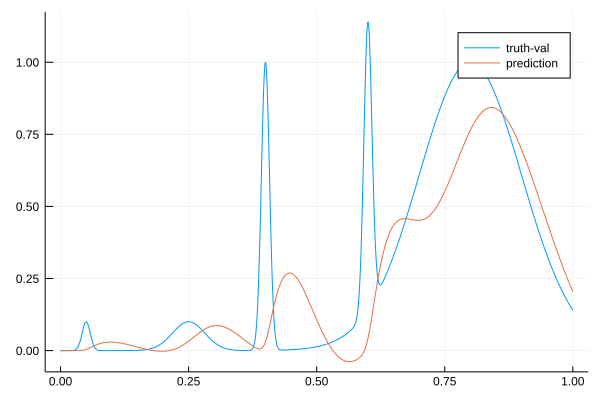

129.9284293492634 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.291431949385647
  25.297319318144734
   8.156915789721424
  27.978336577742876
 -21.552947720534956
   0.1              

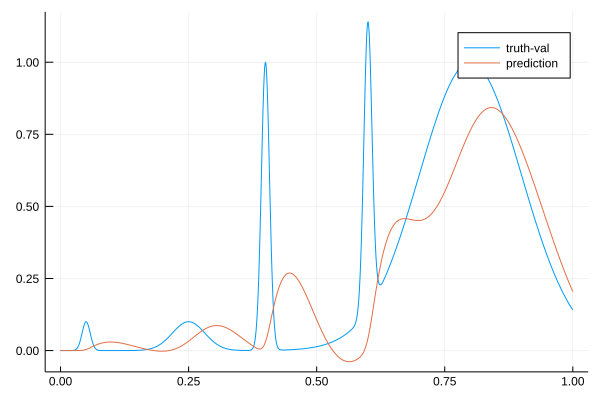

129.9039693462974 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.291634473217886
  25.331065358525606
   8.113685546391789
  28.013018404797215
 -21.58046277004231 
   0.1              

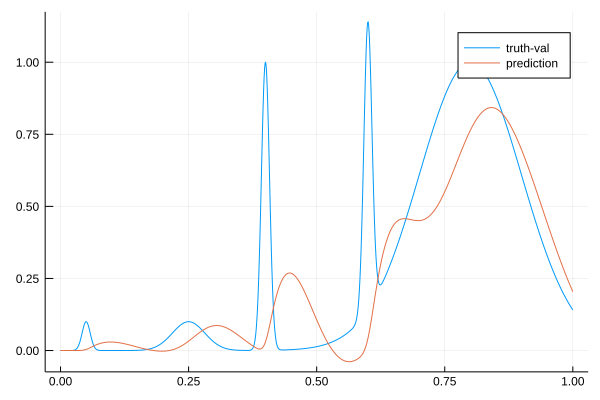

129.87921741978934 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.301640831641134
  25.36398736954857 
   8.06996697169241 
  28.047688902276093
 -21.60794028355612 
   0.1              

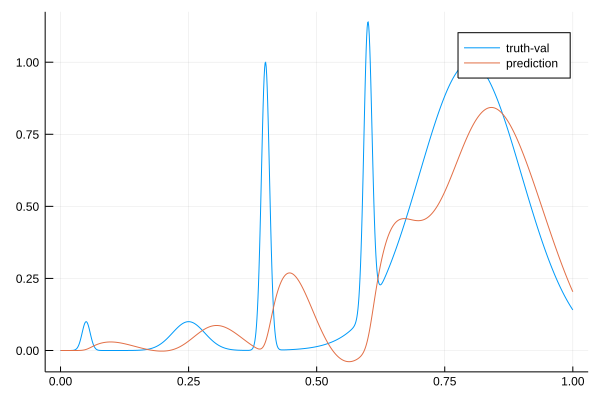

129.85414053018212 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.320833829554473
  25.3962202317195  
   8.02579845974054 
  28.08243548956626 
 -21.635388252606244
   0.1              

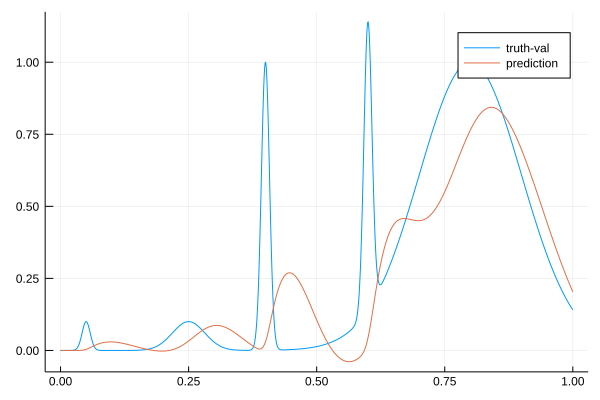

129.82940731852636 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.334184706122706
  25.42885986400645 
   7.981789171491338
  28.117105772672893
 -21.663136474754765
   0.1              

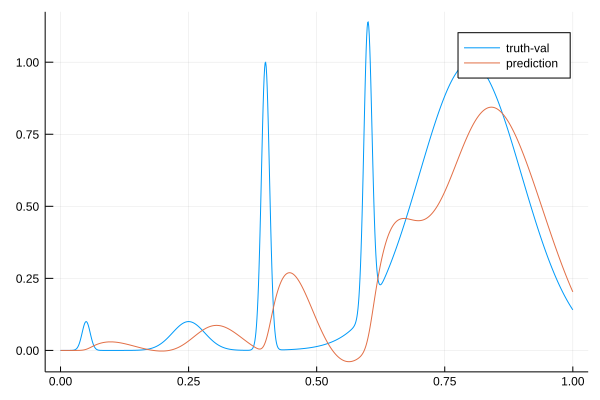

129.80431761809828 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.342621733130265
  25.46192313951291 
   7.93791357611909 
  28.15179619925285 
 -21.691159048262726
   0.1              

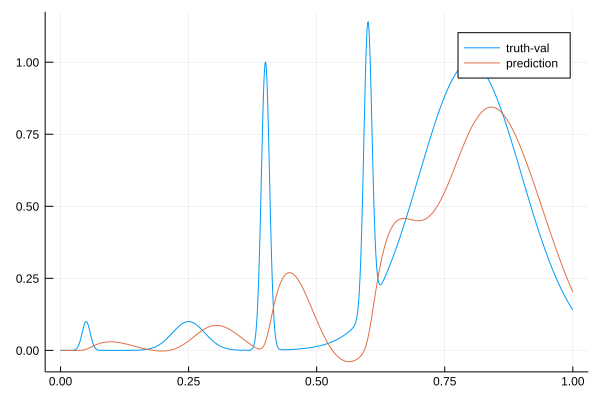

129.7788521622384 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.34699400800577 
  25.495425527250404
   7.894150600092501
  28.186595143758414
 -21.719430697207628
   0.1              

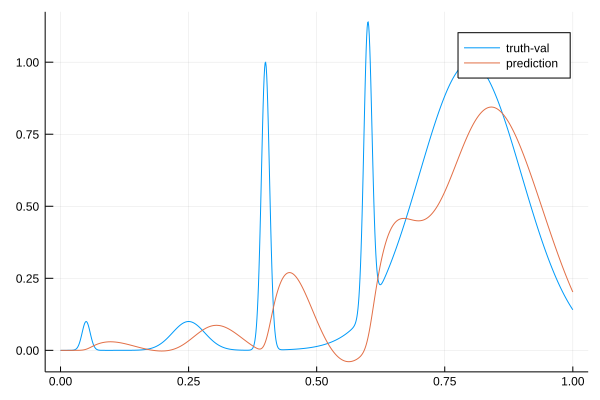

129.75298362520658 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.34807792357455 
  25.529381273946743
   7.850482785974904
  28.221583579075887
 -21.747927046369952
   0.1              

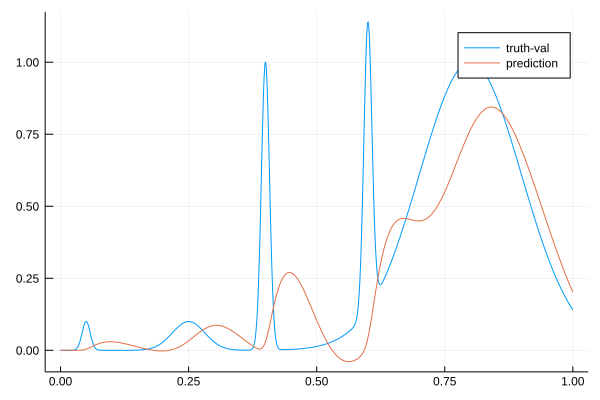

129.72675313887035 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.34658358555823 
  25.563803747977907
   7.806895643607712
  28.256835922553584
 -21.776624936668536
   0.1              

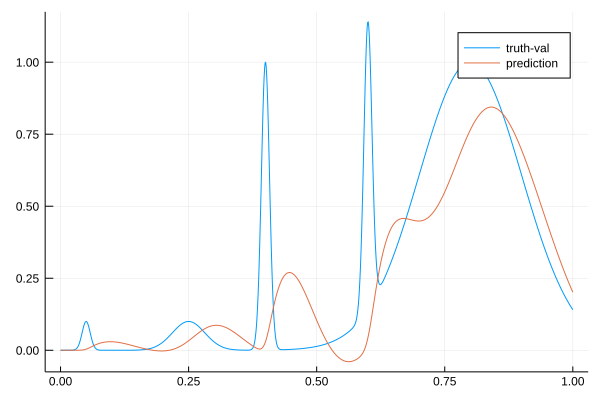

129.7003570591199 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  24.343159609919923 
  25.59870554988827  
   7.7633770205990045
  28.29242051593908  
 -21.805502612034935 
   0.1               

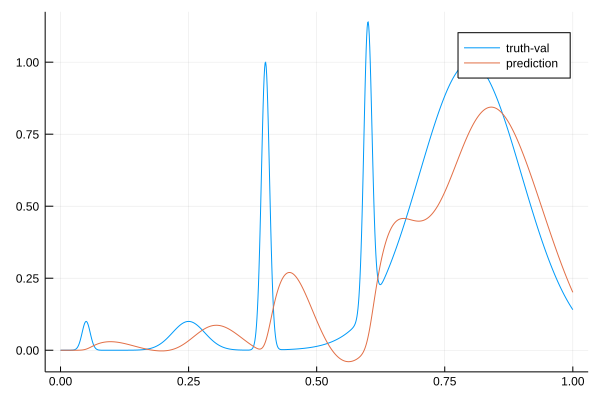

129.67612607307285 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  24.353126924241923 
  25.633063924934433 
   7.7193295355310685
  28.328580092848988 
 -21.83423144687758  
   0.1               

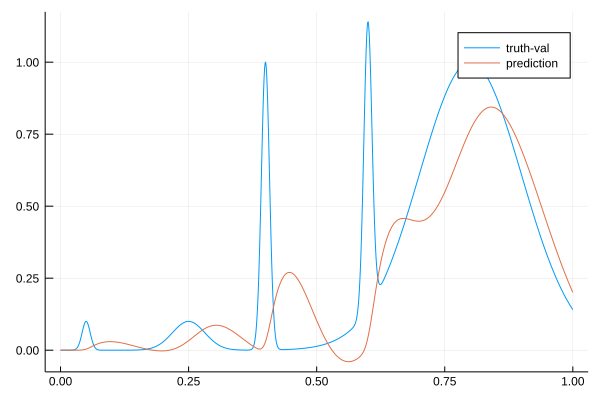

129.65013629915828 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.361128805655227
  25.66765639796456 
   7.675347711382433
  28.36481621971638 
 -21.863208610676754
   0.1              

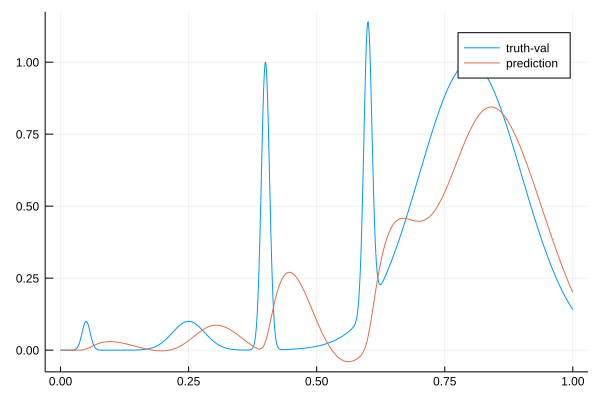

129.62385811096473 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.367737457376563
  25.702521256754302
   7.631416989805696
  28.4012167454856  
 -21.89241119817217 
   0.1              

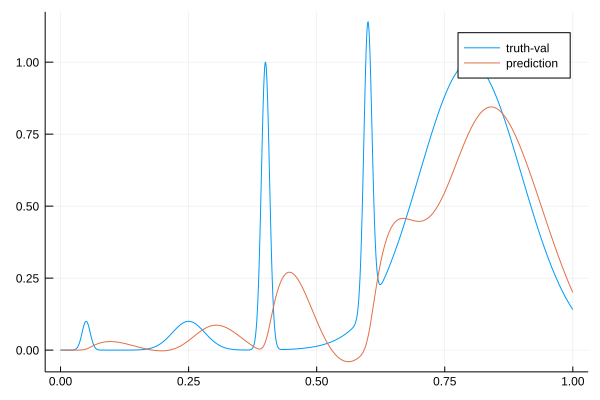

129.59711118761473 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.373475390330878
  25.737693664283334
   7.587524856843833
  28.437862022442957
 -21.921817882593956
   0.1              

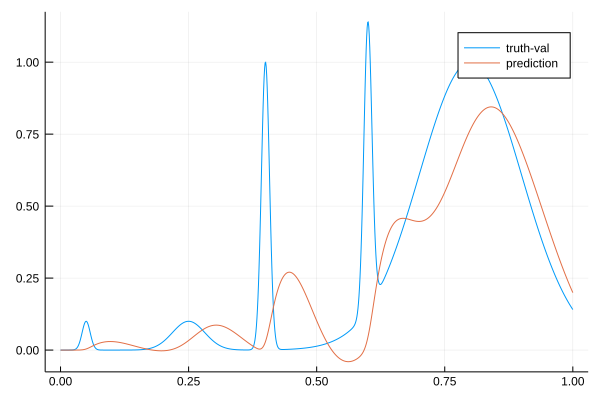

129.56980465118096 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.37882044846506 
  25.773205965987824
   7.543660235510612
  28.474825636654806
 -21.95140886729396 
   0.1              

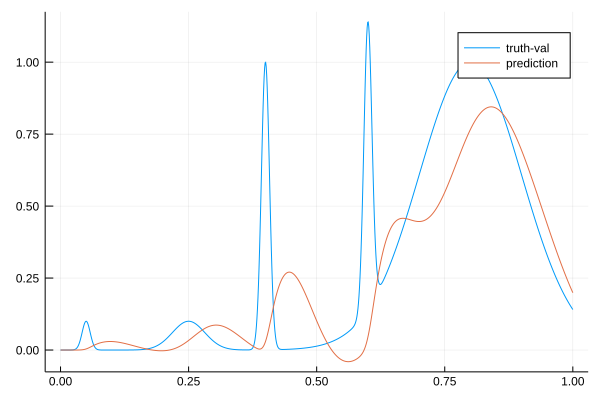

129.54220367087333 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.38393431369079 
  25.80904187393456 
   7.499812516448563
  28.512104482862718
 -21.981179863780437
   0.1              

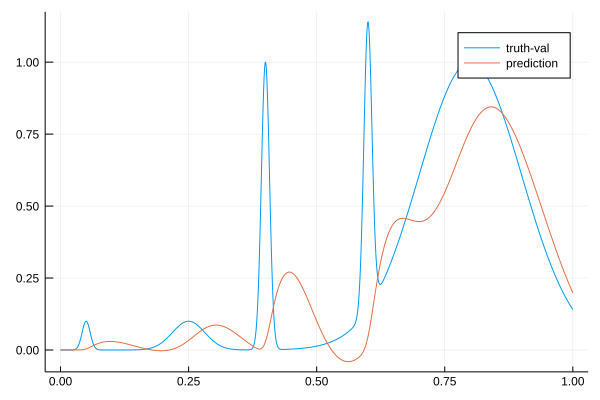

129.51422741020502 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.389241751490022
  25.84523363552542 
   7.455972576021439
  28.54976740268016 
 -22.01111286060554 
   0.1              

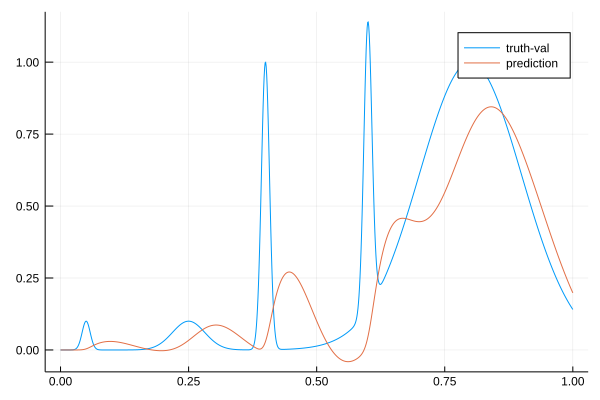

129.48625446294471 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  24.395129483974177 
  25.881811102387527 
   7.4121319246052115
  28.587877462170255 
 -22.041191593848172 
   0.1               

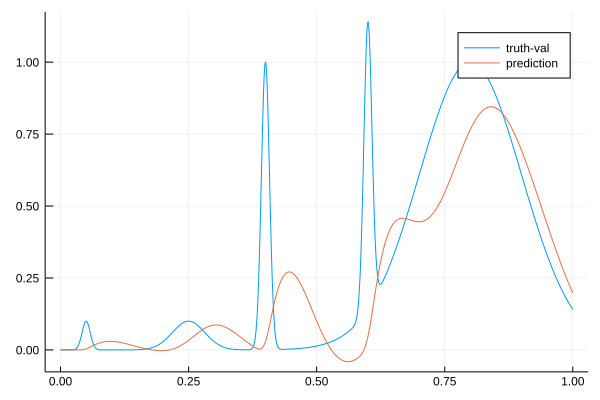

129.4579325209027 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.41682433868688 
  25.917748071941475
   7.367684468595588
  28.626659924078716
 -22.071098932319636
   0.1              

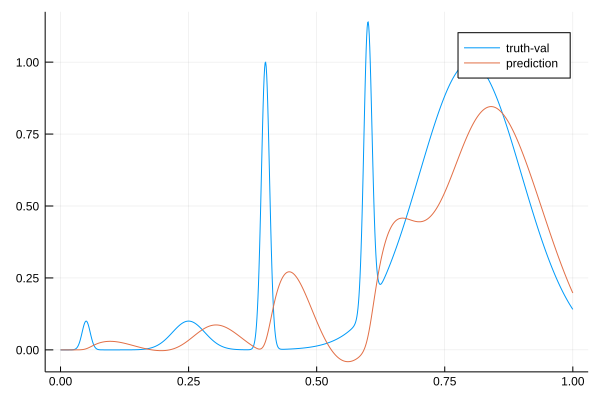

129.42981451800563 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.43859698978721 
  25.953857088764252
   7.323238011680471
  28.665626687862378
 -22.101233237943557
   0.1              

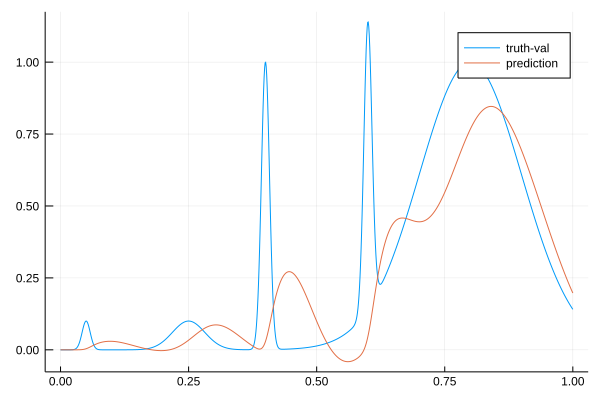

129.401513390886 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.460818648803876
  25.990189833479015
   7.278777875339452
  28.704861848454673
 -22.13157747523108 
   0.1              

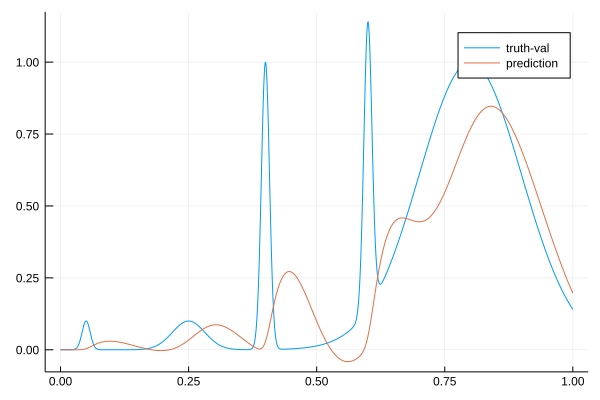

129.37296399320758 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.484059037699335
  26.02665120556191 
   7.234286098831054
  28.74431522136048 
 -22.162151505823722
   0.1              

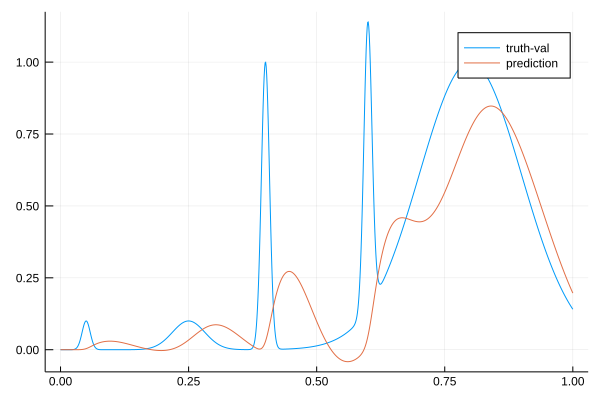

129.34554013965163 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.508599366842677
  26.063299085683717
   7.189750550139574
  28.784069664812034
 -22.19293814977608 
   0.1              

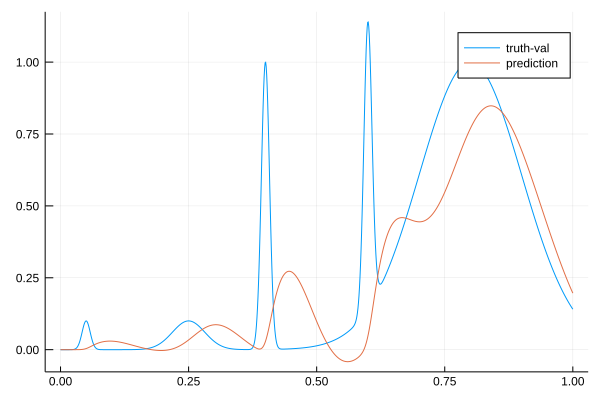

129.31636334624673 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.53468295598399 
  26.100187022978634
   7.14516065684371 
  28.824200385701175
 -22.22392338225695 
   0.1              

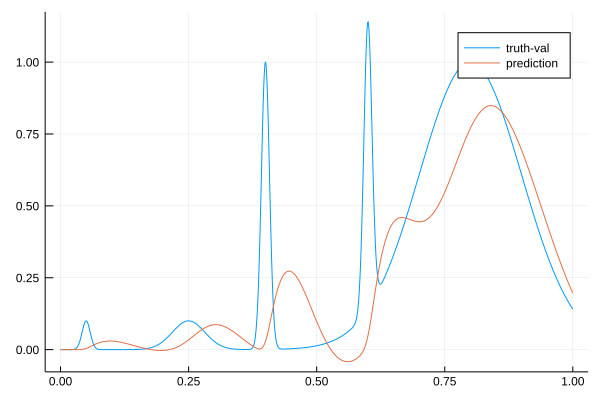

129.2872339266888 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.562541456365935
  26.13736409565638 
   7.100505370753456
  28.864777007433904
 -22.255093671482673
   0.1              

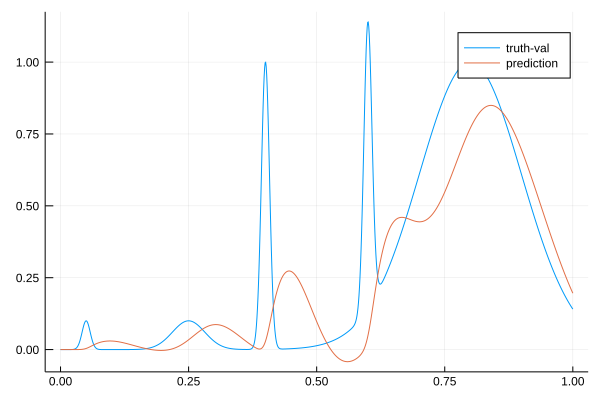

129.25754774479586 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.577239475408255
  26.175945756688435
   7.056386156661867
  28.905699258858025
 -22.28673868936313 
   0.1              

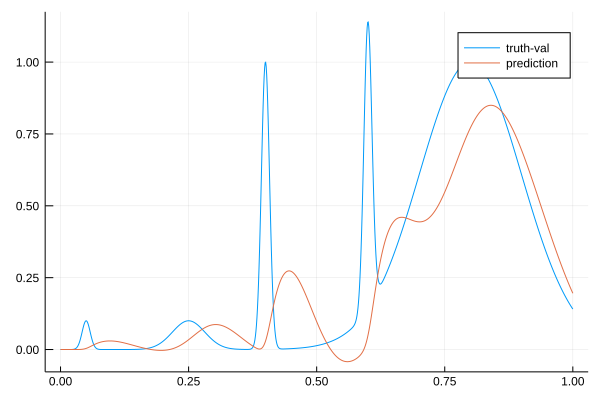

129.22690510493103 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.577343399890903
  26.215891885420735
   7.012740411258386
  28.946804839581574
 -22.318796866359577
   0.1              

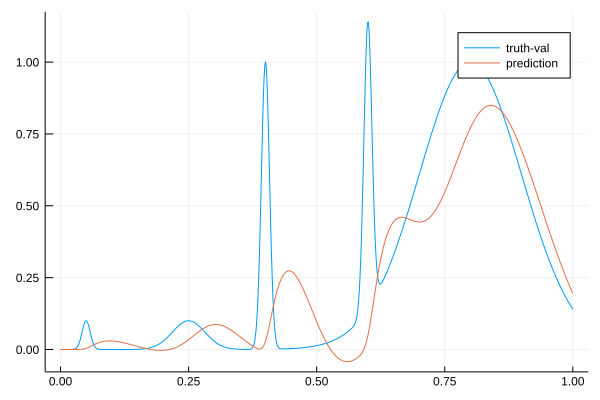

129.19680352229028 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.565089710895506
  26.256764707387184
   6.969478181051162
  28.98782848302787 
 -22.351299432175228
   0.1              

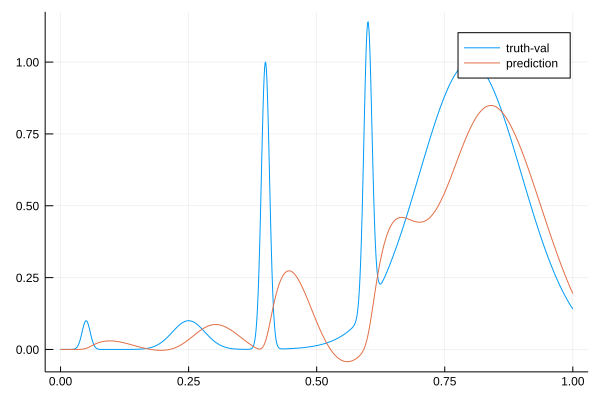

129.16676866589557 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.557254013996427
  26.29747060408979 
   6.925944120575503
  29.02905254384158 
 -22.383896462292128
   0.1              

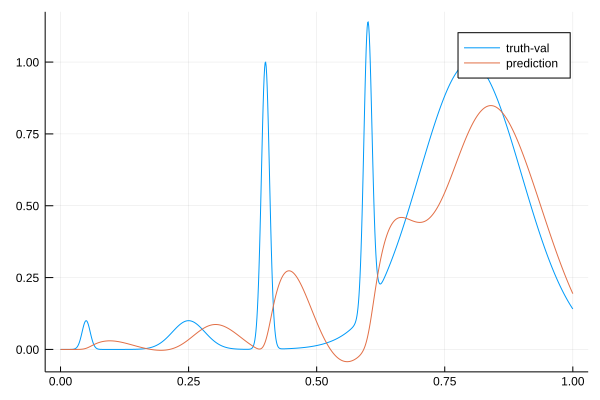

129.13624909190025 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.553853139192526
  26.338099982142214
   6.882161423894644
  29.07057094958682 
 -22.41657343214279 
   0.1              

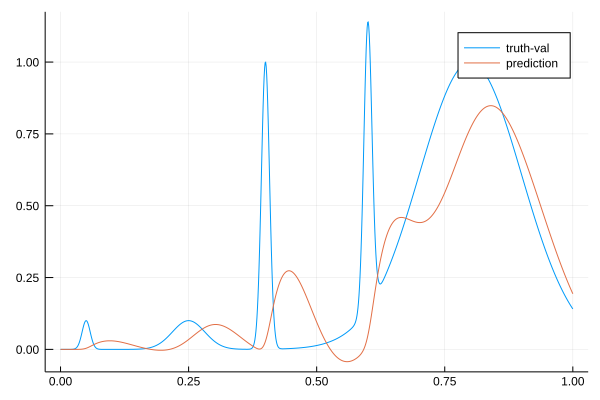

129.1052007811751 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.5548999399384  
  26.37873524853694 
   6.838149024512418
  29.112468989413237
 -22.449318084352342
   0.1              

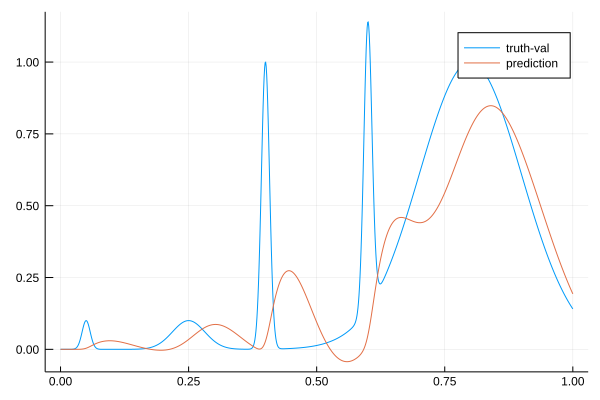

129.07357578211682 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.56040354505994 
  26.419451713809014
   6.793921938199828
  29.154824297419516
 -22.482120305693115
   0.1              

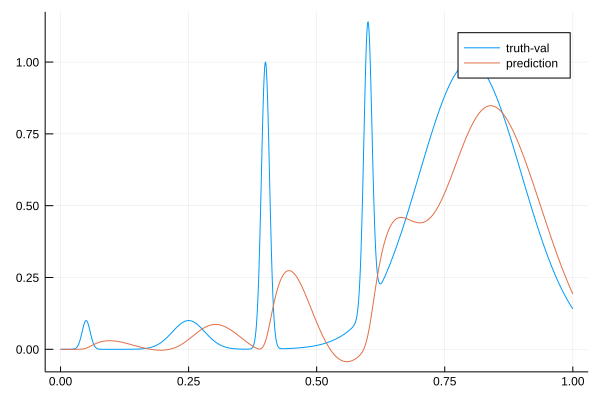

129.04132252749096 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.57036966864877 
  26.460318403936707
   6.749491577386974
  29.1977077434258  
 -22.514971996699455
   0.1              

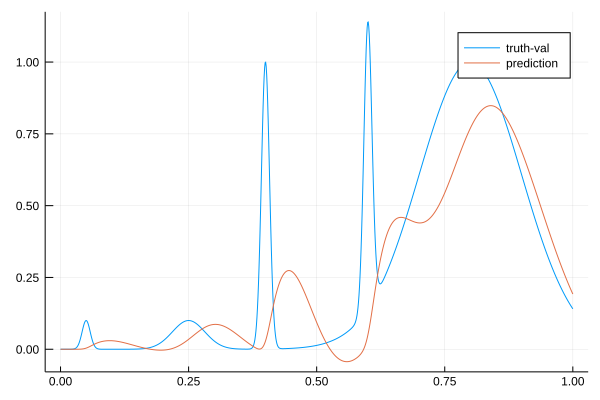

129.0101520372955 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.584800964660385
  26.501398790488466
   6.704866039220053
  29.24118424009293 
 -22.547866936684365
   0.1              

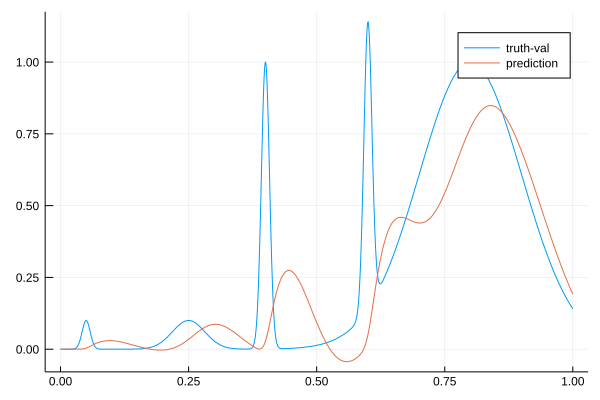

128.9772740553902 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.603686036990457
  26.542755319219566
   6.660052255568342
  29.28531650905293 
 -22.580803685249315
   0.1              

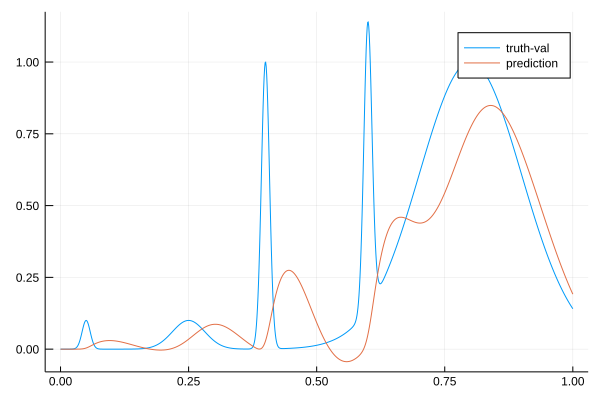

128.94392322982287 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.627404869705877
  26.584015133888624
   6.615014838510552
  29.329752309023963
 -22.613866411179753
   0.1              

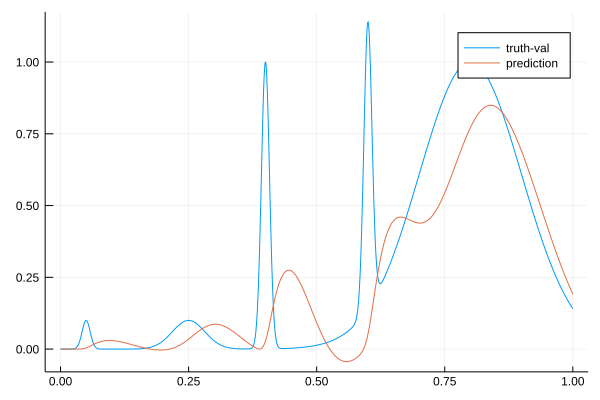

128.90992575517058 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.65590592737642 
  26.625270475150163
   6.569757354576416
  29.374582025676006
 -22.647045642246137
   0.1              

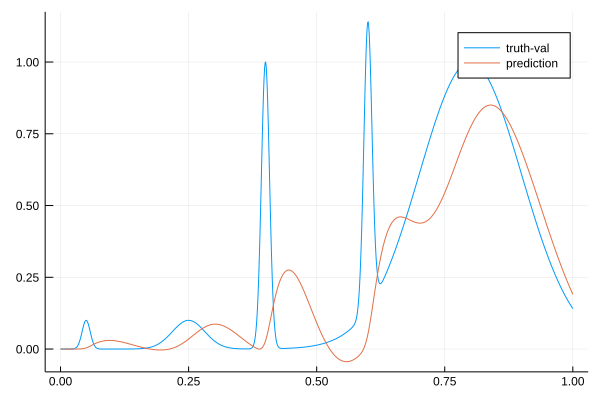

128.87644456467834 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.689139292233975
  26.666605772364917
   6.52428083154572 
  29.419888257862112
 -22.6803337580442  
   0.1              

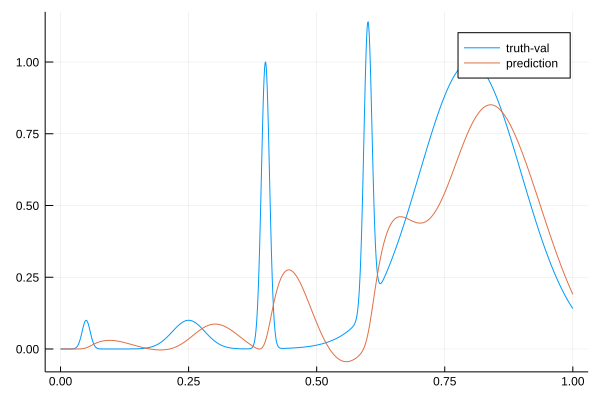

128.8408665703488 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.71018627926238 
  26.709218999190895
   6.47921684251787 
  29.465500085214288
 -22.714060863100137
   0.1              

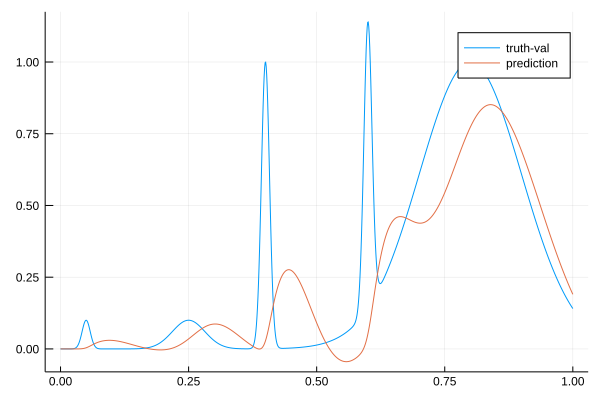

128.8049734073844 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.720712376163146
  26.75307145590262 
   6.434507256733136
  29.51151574312886 
 -22.748182945924373
   0.1              

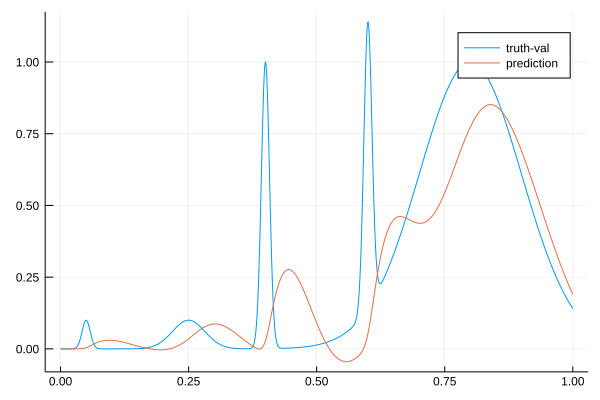

128.76938394412642 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.716602348365985
  26.79801785902831 
   6.390099167682108
  29.557444341193932
 -22.782736919456923
   0.1              

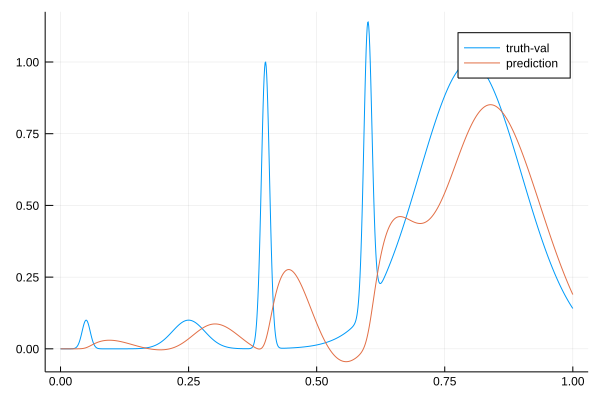

128.73456432705254 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.715153976314156
  26.84292844122473 
   6.345320342183495
  29.603558709193525
 -22.817384810029992
   0.1              

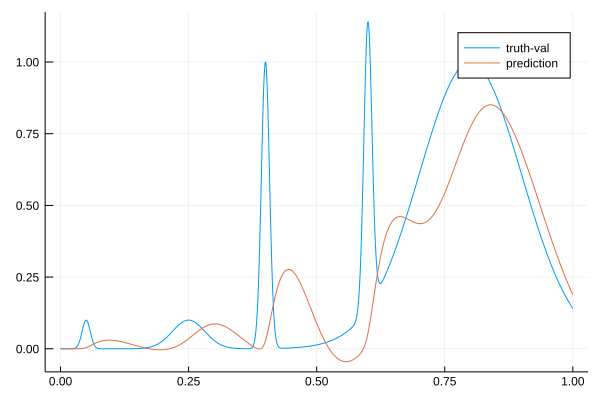

128.70081634354142 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.716914168022964
  26.887509498030685
   6.3001602869916  
  29.64960152034976 
 -22.852189842412418
   0.1              

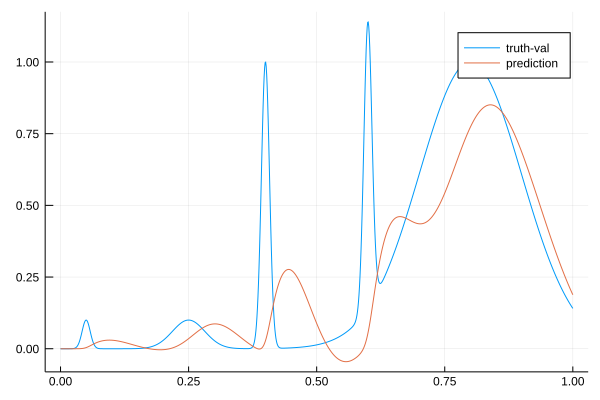

128.66486968533934 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.722043233297146
  26.93188002630917 
   6.25464639593316 
  29.695708122785714
 -22.88713147471856 
   0.1              

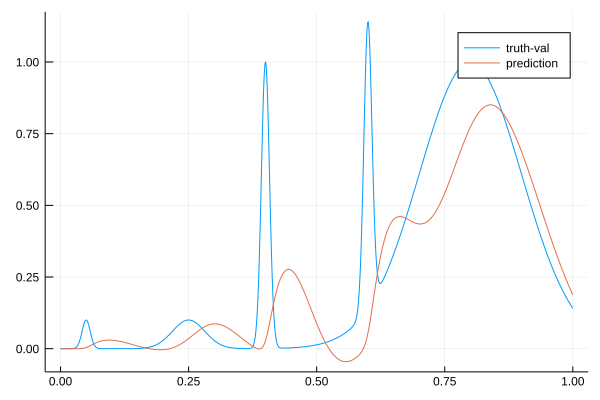

128.63010927648983 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.73075291709807 
  26.9760964364503  
   6.208798637451164
  29.741953601940352
 -22.92219792169558 
   0.1              

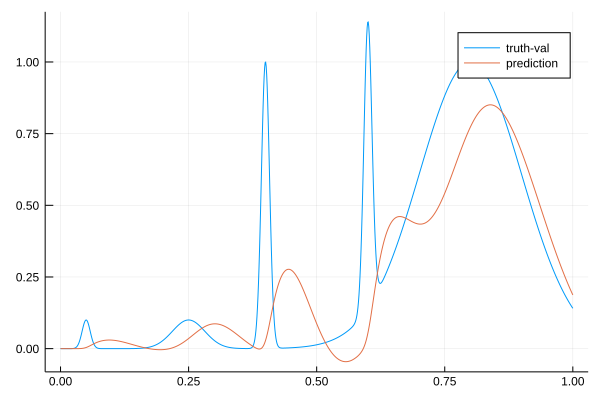

128.59479427057585 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.74316926587216 
  27.02026202393619 
   6.162636829917402
  29.78845416421329 
 -22.957372029046255
   0.1              

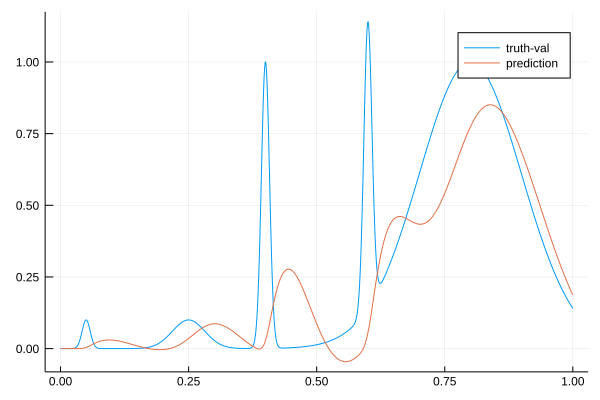

128.55922124745365 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.75956721926974 
  27.064333117754966
   6.116173240874187
  29.835187030252854
 -22.99268249088718 
   0.1              

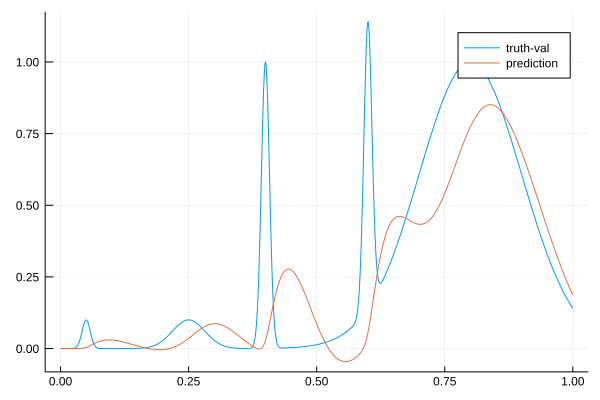

128.5229477147245 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.780030074145213
  27.10840981671477 
   6.069421140836799
  29.882261599581067
 -23.02811214887225 
   0.1              

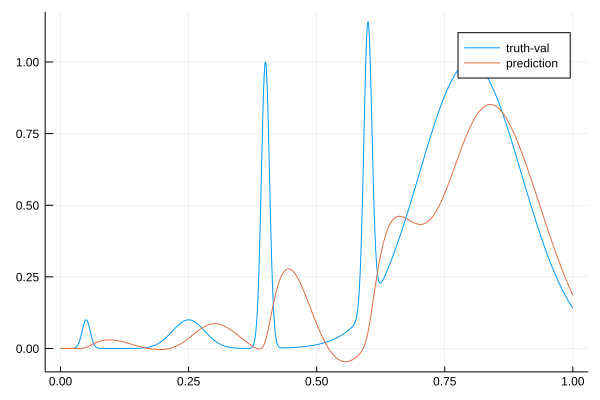

128.48688553754712 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.804633091403623
  27.152583607241386
   6.022390562678346
  29.92977777649039 
 -23.063646013307338
   0.1              

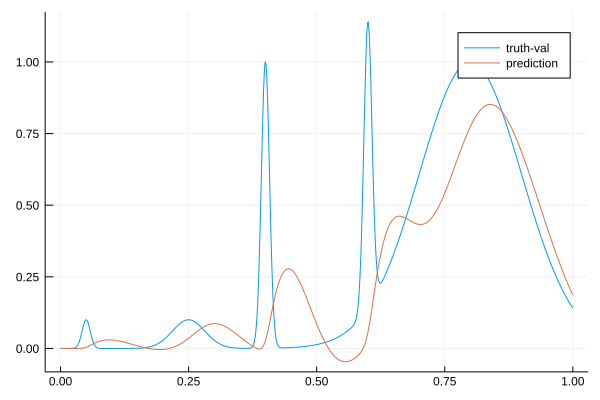

128.45023720197966 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.833749874369648
  27.196552595570015
   5.975050703848134
  29.977455518604675
 -23.099352131878653
   0.1              

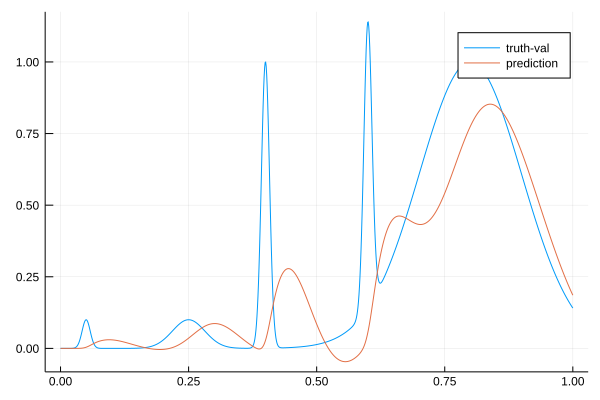

128.41345021266054 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.867399140177444
  27.240431632214467
   5.9274096631962  
  30.02541445478249 
 -23.135212335470175
   0.1              

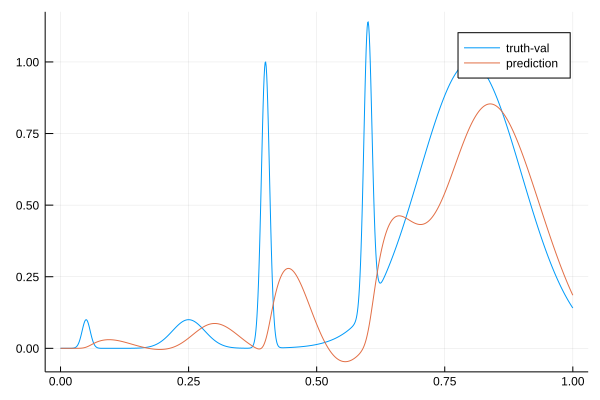

128.37621182138557 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.890023482259537
  27.28546001633838 
   5.880121558228458
  30.073651347956304
 -23.17148794824191 
   0.1              

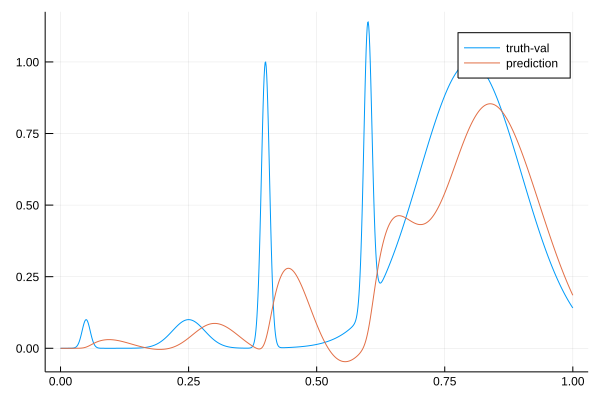

128.33837532594723 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.903199249120703
  27.33162193263586 
   5.833132773496005
  30.122279842975612
 -23.208132251267777
   0.1              

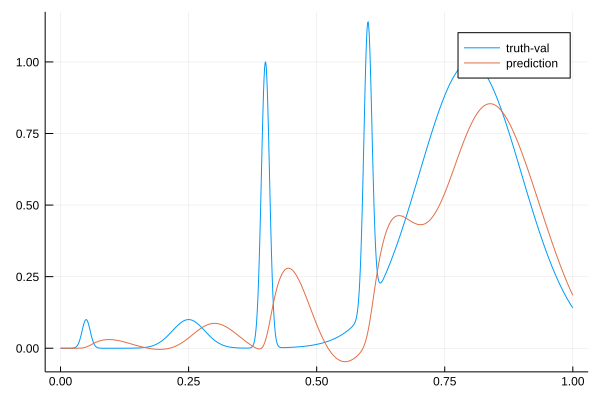

128.29762011557952 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.90841272710087 
  27.37885608627994 
   5.786397964838131
  30.171359870853944
 -23.245110685496332
   0.1              

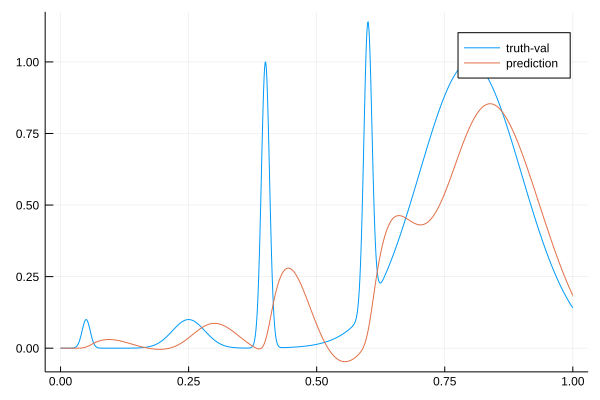

128.25844060631553 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.906988589499235
  27.427156957138045
   5.739880191955701
  30.220995893436235
 -23.282378370220638
   0.1              

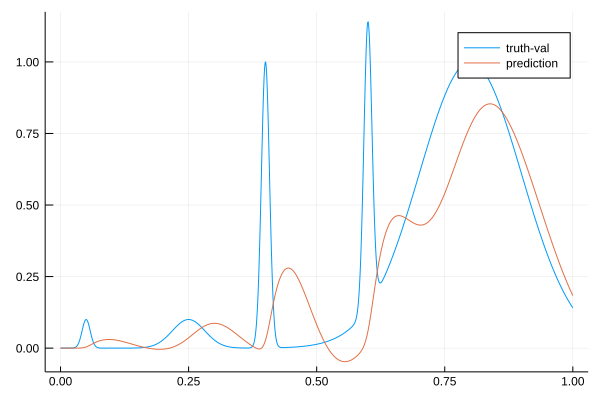

128.2202150669155 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.916064138694576
  27.47498514925166 
   5.692854544887861
  30.27100688304624 
 -23.31970173411136 
   0.1              

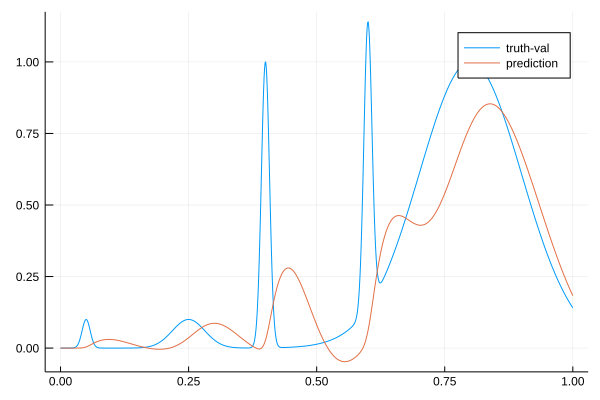

128.180707790304 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.935105012236654
  27.522490485682066
   5.645357229513776
  30.321503831734603
 -23.35706802264683 
   0.1              

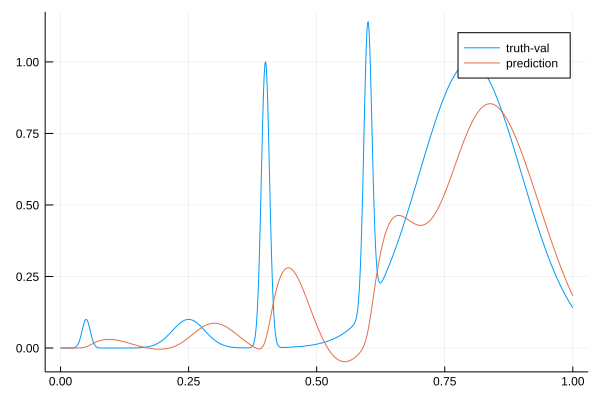

128.13967859070834 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.963615807351875
  27.5698058092989  
   5.597414685678082
  30.37258380573498 
 -23.394465755553085
   0.1              

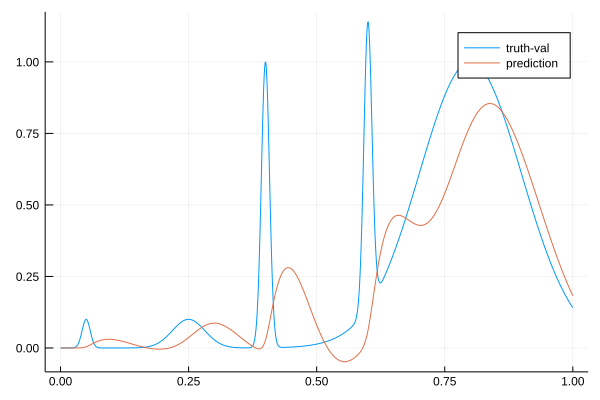

128.09839886662502 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  24.985548023657987
  27.618204403805265
   5.549704806205531
  30.424240273788612
 -23.432155234939113
   0.1              

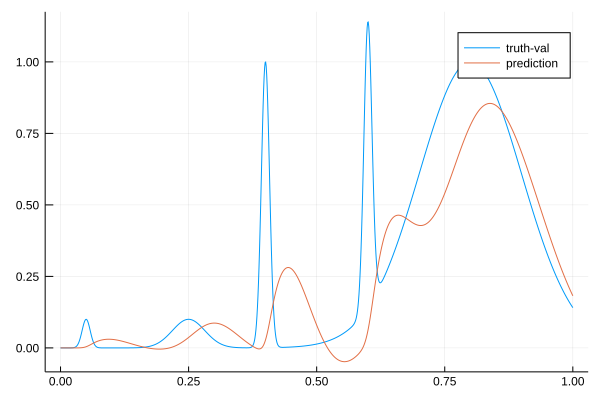

128.05611896961395 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.002070143797663
  27.667684329284384
   5.502183230609549
  30.476567738980542
 -23.470098552833672
   0.1              

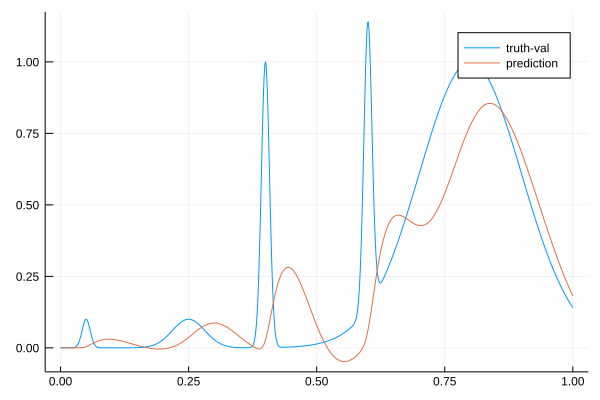

128.0130398126578 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.014250147525004
  27.718244380440435
   5.454811445664104
  30.52965320579467 
 -23.50825951735372 
   0.1              

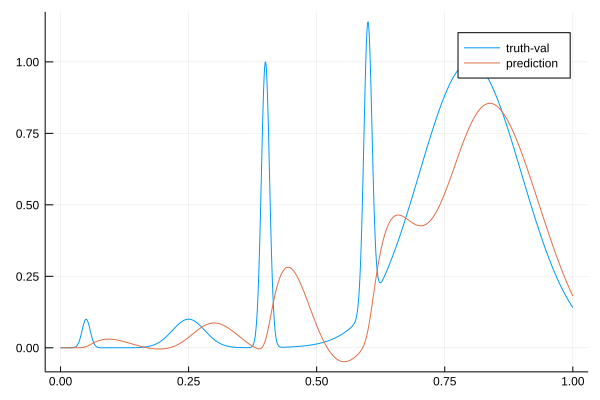

127.97191413661113 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.038787686928952
  27.76867920738825 
   5.406892069677495
  30.58362112679277 
 -23.54634984100586 
   0.1              

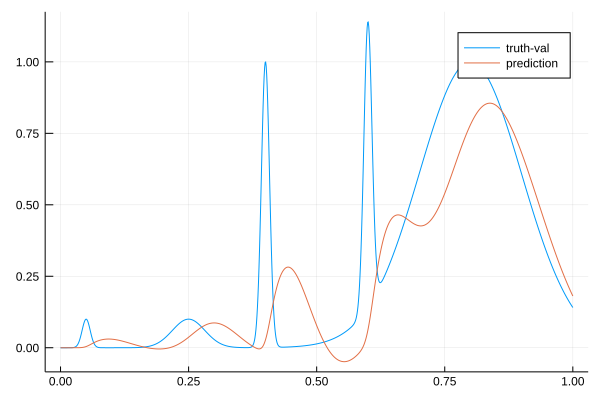

127.92740723878971 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.059612253708227
  27.81988217828985 
   5.359081627493376
  30.638076093392435
 -23.5847189522259  
   0.1              

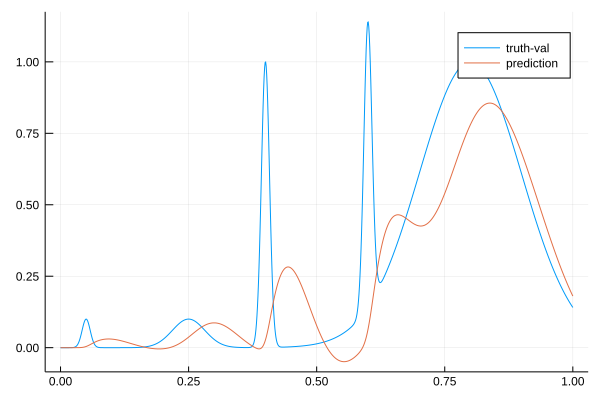

127.88264583738237 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.07764046640123 
  27.871888517354442
   5.311345534203086
  30.693129701463842
 -23.62332870991415 
   0.1              

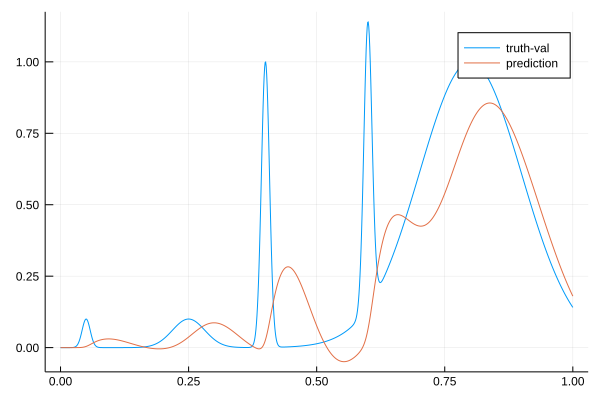

127.83761762831466 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.093705075908613
  27.924730531082346
   5.263653485796808
  30.748883500933115
 -23.662143599913342
   0.1              

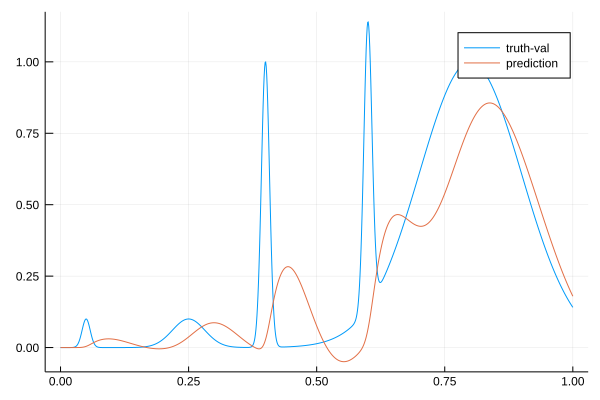

127.79186746320228 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.117824839630778
  27.97777371429577 
   5.215776623372266
  30.805499284057476
 -23.70078350134415 
   0.1              

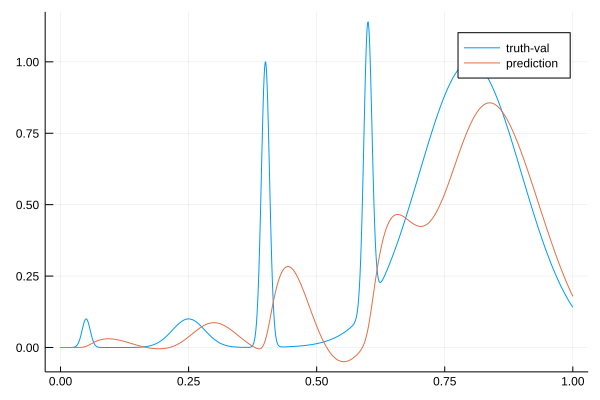

127.74481459551616 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  25.149743332073342 
  28.03111161952863  
   5.1677058475071025
  30.863052366957724 
 -23.739256274996176 
   0.1               

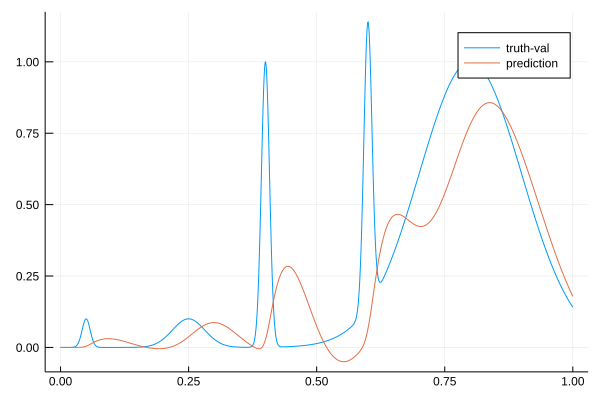

127.69776016295977 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.18922440816365 
  28.084830964880318
   5.119428691684326
  30.921612933798055
 -23.777570766342613
   0.1              

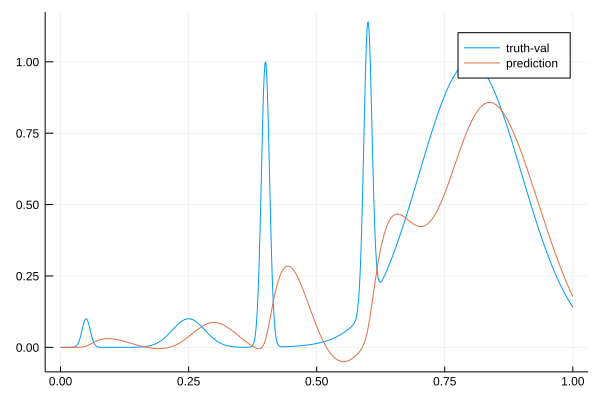

127.65003156421473 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  25.227299729475792 
  28.13911430610812  
   5.0710910215956755
  30.980636307359276 
 -23.816230011316506 
   0.1               

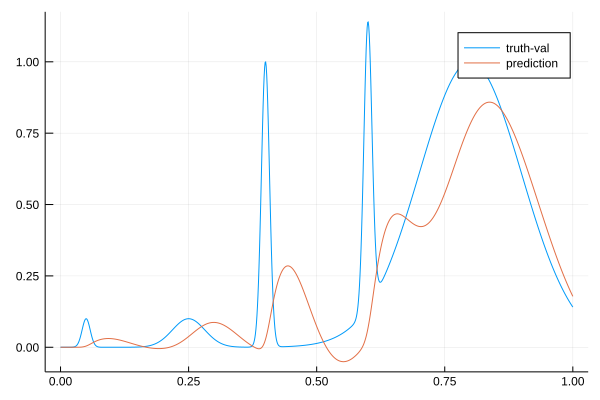

127.60114923930716 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.264666669151147
  28.194028518869693
   5.022663969498457
  31.040247852346216
 -23.855193174211532
   0.1              

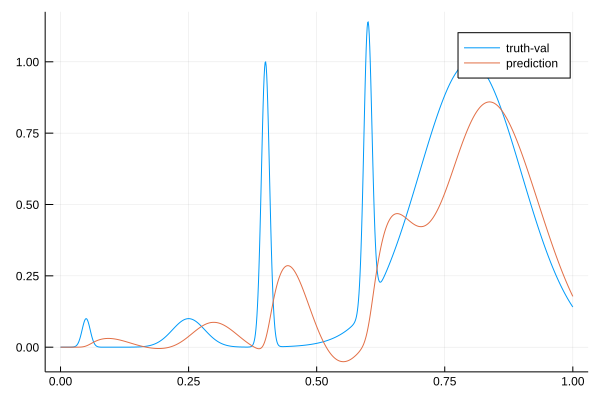

127.55166807221698 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.301966726494122
  28.249635156093223
   4.974121288329061
  31.100562753410074
 -23.894422113335096
   0.1              

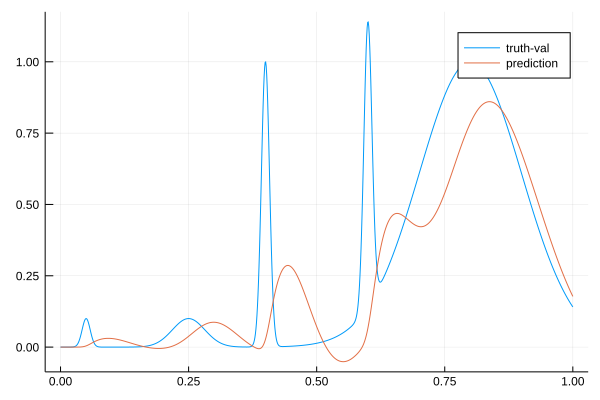

127.49828948773887 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.33823186299994 
  28.306012788379014
   4.925440819642268
  31.161583081596344
 -23.933931582090196
   0.1              

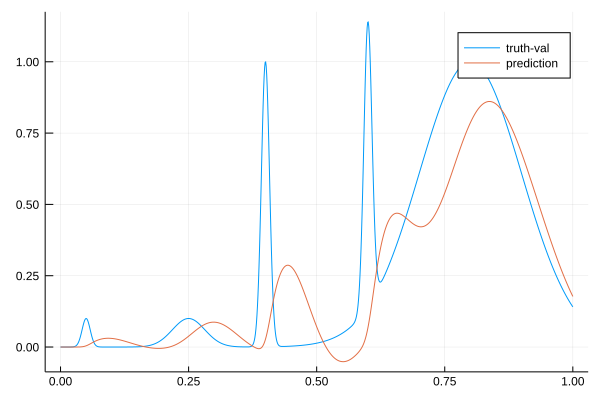

127.44569035314463 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.358208314897468
  28.364395804670913
   4.877281005369197
  31.22335263644304 
 -23.973936395430375
   0.1              

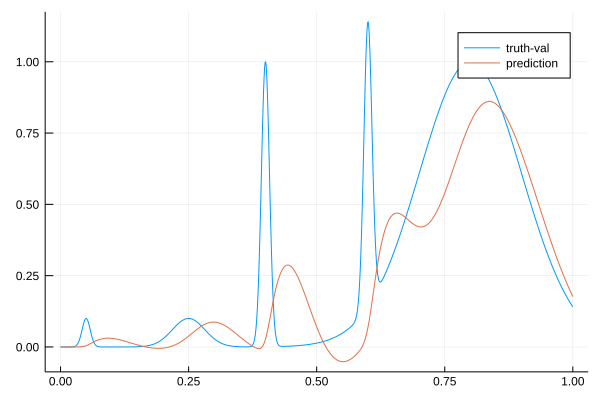

127.39434700194053 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.364463265691107
  28.42431551049857 
   4.829520955350661
  31.285595634326203
 -24.014456790873876
   0.1              

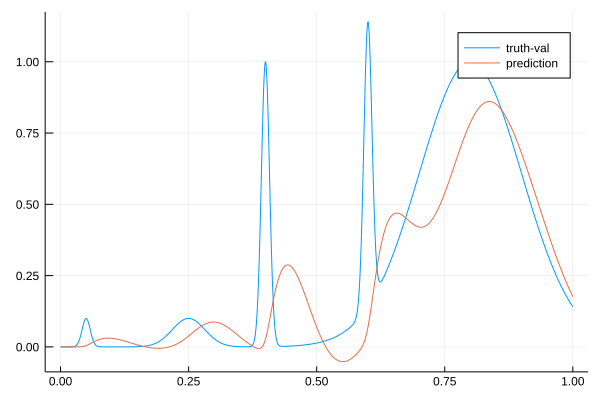

127.34196903782623 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.384060985819715
  28.483950387772744
   4.781204792726615
  31.348625416508863
 -24.054790293395214
   0.1              

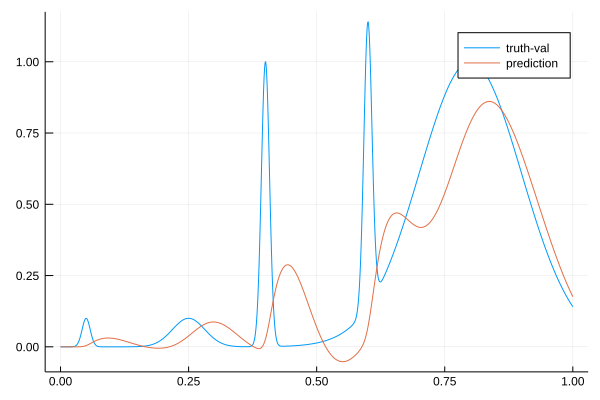

127.29016550840916 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.410353062387127
  28.54333302948945 
   4.732355908019726
  31.411936220003433
 -24.09507456499297 
   0.1              

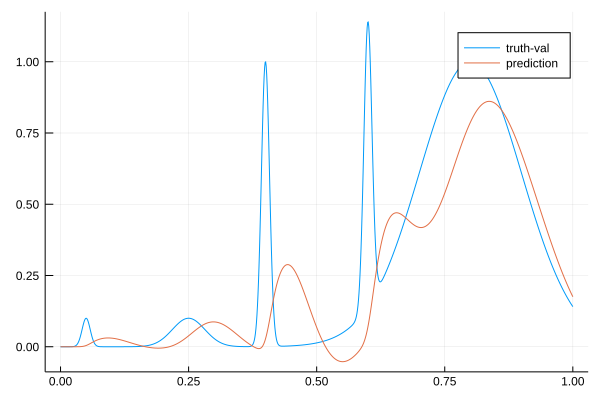

127.23741850167652 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.443282090966783
  28.602616482990513
   4.68299225901935 
  31.475680555645454
 -24.1353015139738  
   0.1              

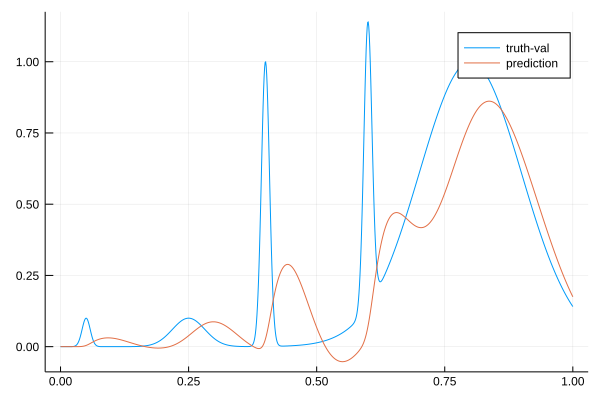

127.1861674772996 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.48286384195285 
  28.66181194148913 
   4.633123393002713
  31.53987128569027 
 -24.175518718307654
   0.1              

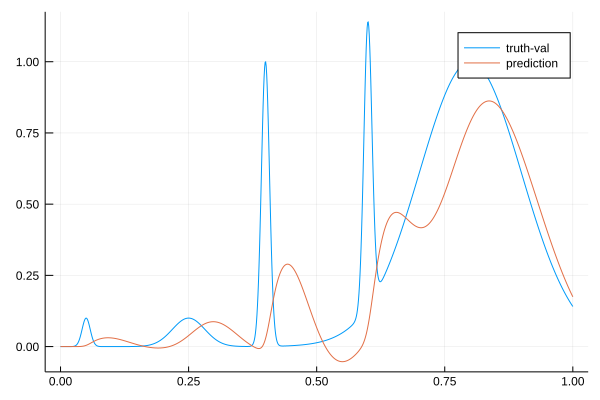

127.13338455746758 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.529013495958836
  28.72105832194752 
   4.58275813357601 
  31.60464462771489 
 -24.2157161317309  
   0.1              

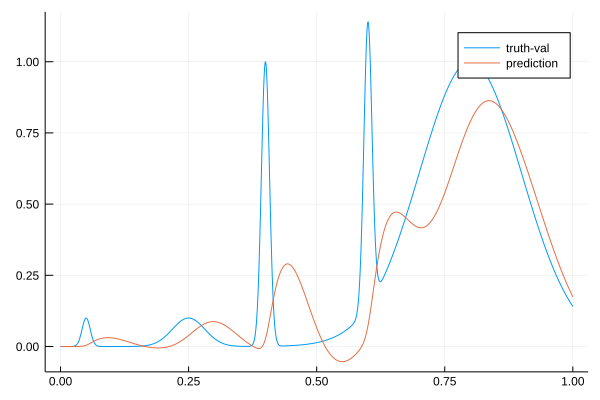

127.07943030037961 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.566118950141167
  28.78128983773462 
   4.532553384943299
  31.669696328942667
 -24.2562184686925  
   0.1              

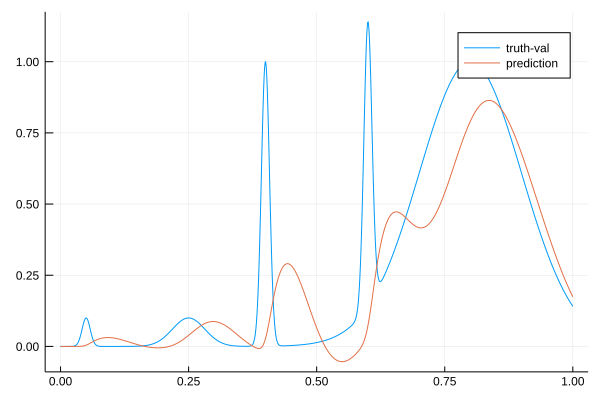

127.02394313008193 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.595736990816302
  28.842498902544634
   4.482452524432502
  31.735145621037663
 -24.296992526614233
   0.1              

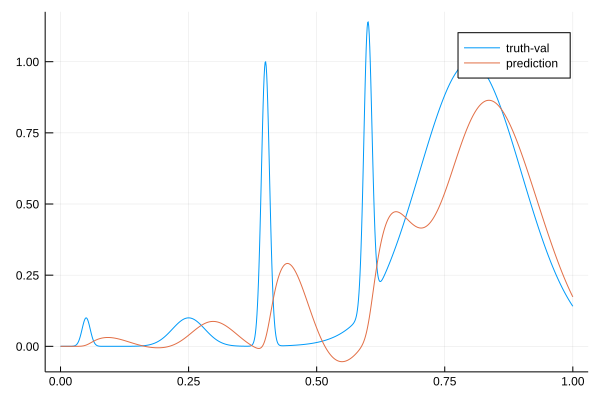

126.96705589522516 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.619254171024746
  28.90472451031374 
   4.432407230843914
  31.801145950437114
 -24.337992597735337
   0.1              

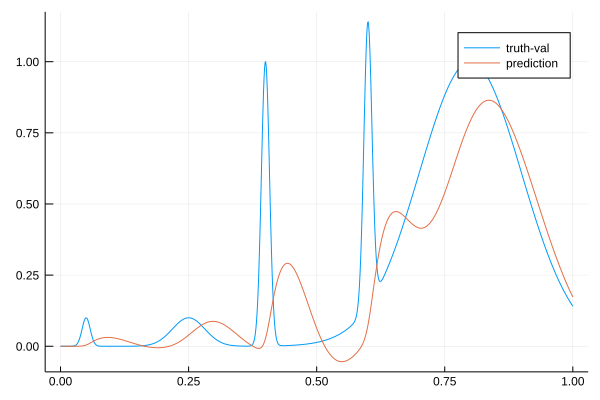

126.90879949021152 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.637939256004913
  28.968001556976255
   4.382375659400669
  31.8678368899269  
 -24.37917441704922 
   0.1              

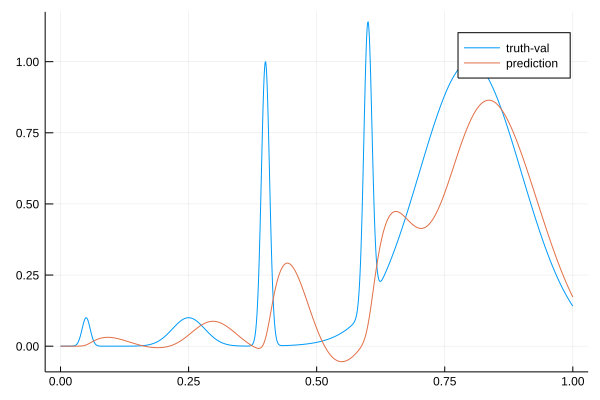

126.85063049574043 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.652954042927703
  29.032361510230228
   4.332321208043736
  31.935345583604352
 -24.42049548776012 
   0.1              

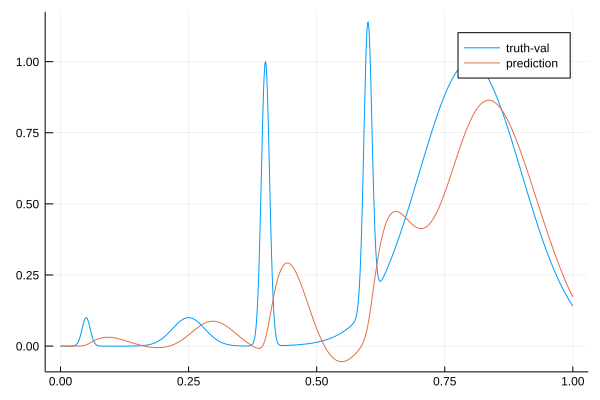

126.7925666109883 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.665629717365686
  29.0974318467857  
   4.282170925134244
  32.003396361619494
 -24.462007007020258
   0.1              

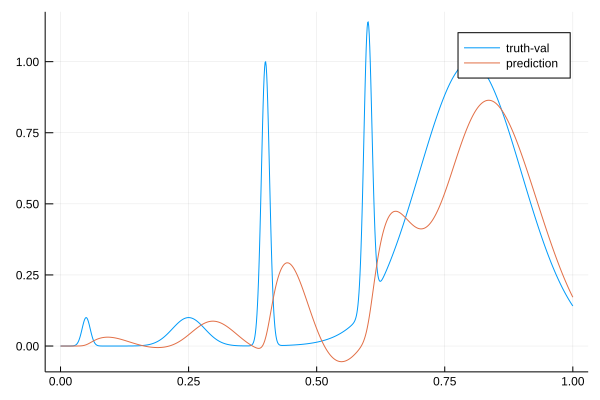

126.73551725552441 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  25.692839078224814 
  29.16206160481363  
   4.2312005369523895
  32.072158664055294 
 -24.503430380027236 
   0.1               

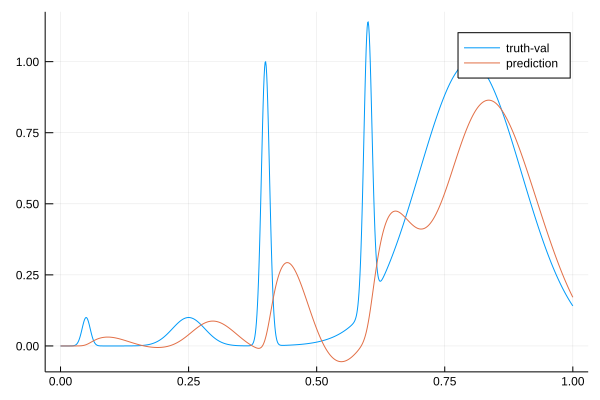

126.67369460410066 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.733807255857084
  29.22626252078237 
   4.17944693770143 
  32.14158695257242 
 -24.544822404038182
   0.1              

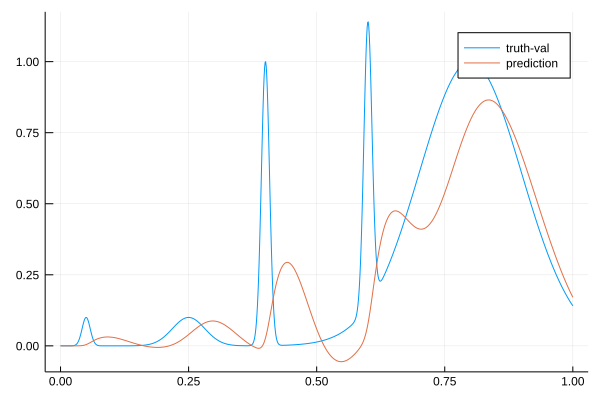

126.60863676252315 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.787770299460238
  29.290221112231155
   4.12693929473915 
  32.211816824605094
 -24.58616578242489 
   0.1              

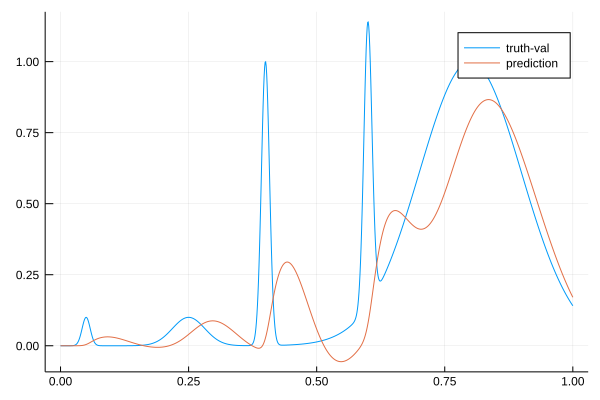

126.54613115040917 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.838402839122946
  29.35533835591288 
   4.074401942801713
  32.28296256437938 
 -24.627673411316565
   0.1              

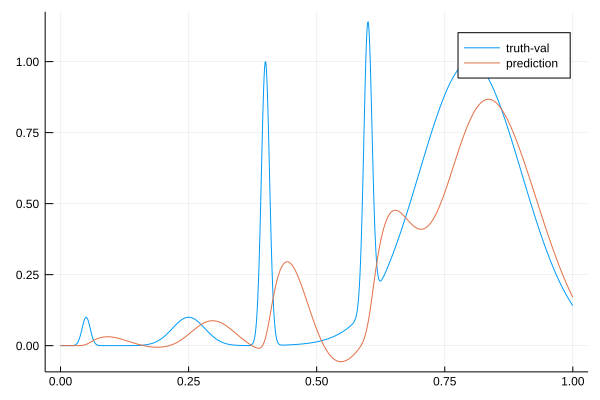

126.48218684860457 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  25.887004862141076
  29.42124486525322 
   4.02174365513231 
  32.35474917226151 
 -24.669399930582028
   0.1              

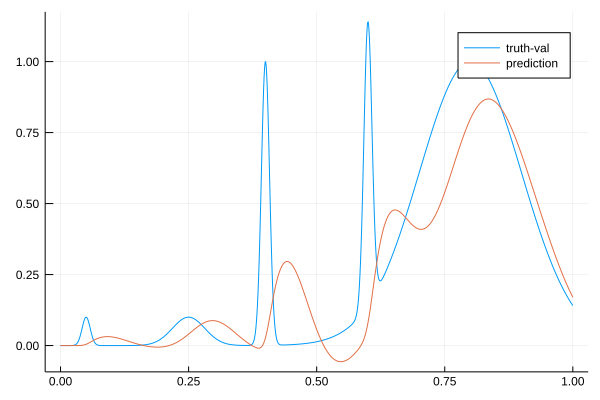

126.41659749903691 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  25.934493226149144 
  29.4880139266986   
   3.9689234343032327
  32.42732555886346  
 -24.71130046453941  
   0.1               

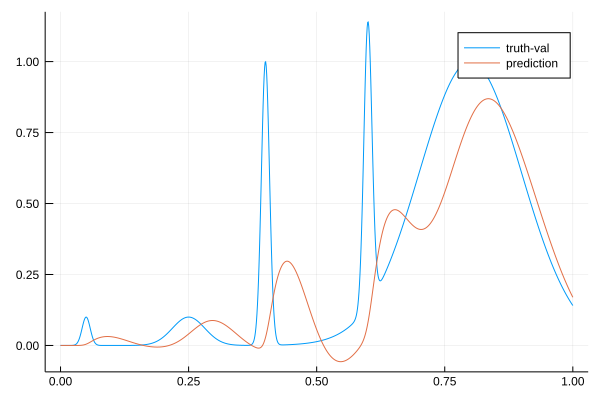

126.34979386084343 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  25.981711817774457 
  29.555712534348313 
   3.9159038004575337
  32.50082801477314  
 -24.753332514509342 
   0.1               

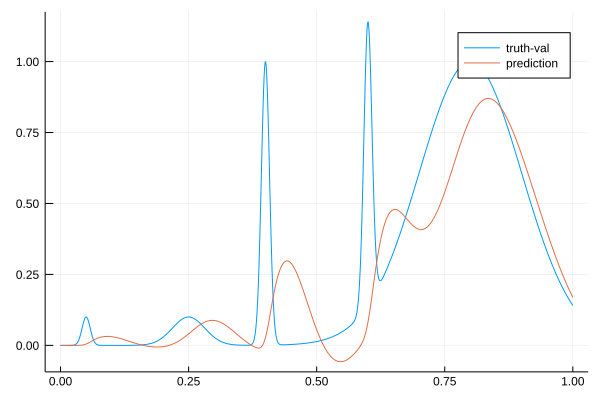

126.28136139141604 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  26.01182134479673 
  29.625615798715078
   3.863365921741491
  32.57522953496005 
 -24.79574734200459 
   0.1              

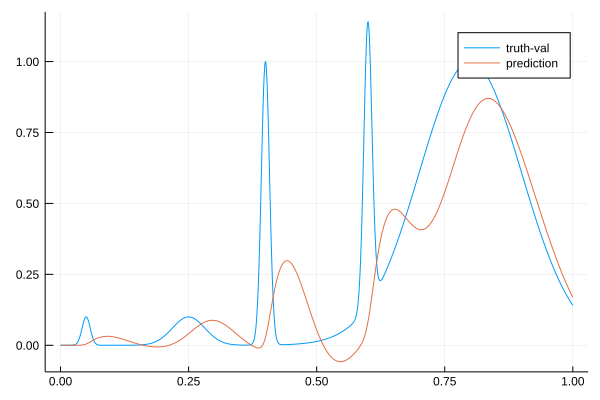

126.21561398333245 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  26.04367266719526 
  29.695890853925373
   3.810453872838802
  32.65014668866054 
 -24.838402914172093
   0.1              

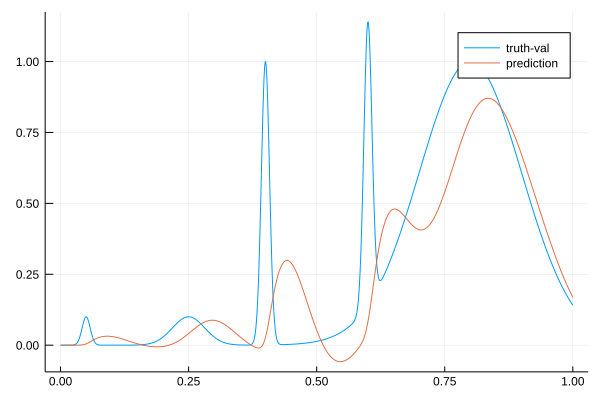

126.14588202567423 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  26.0778493210222  
  29.766658632004127
   3.757156399210643
  32.72574988386952 
 -24.881245458229852
   0.1              

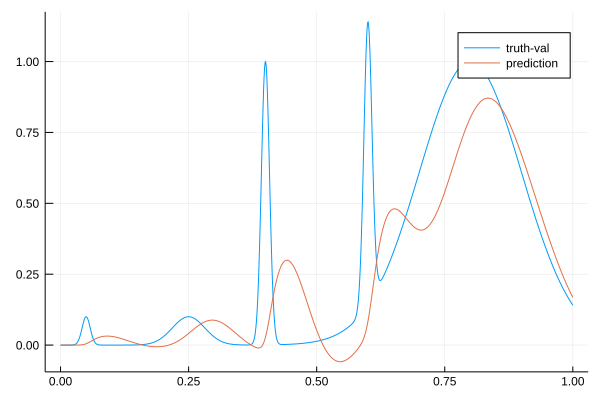

126.07414699002767 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  26.114913696805306
  29.838026782632497
   3.703460450711814
  32.80219390208826 
 -24.924222804290615
   0.1              

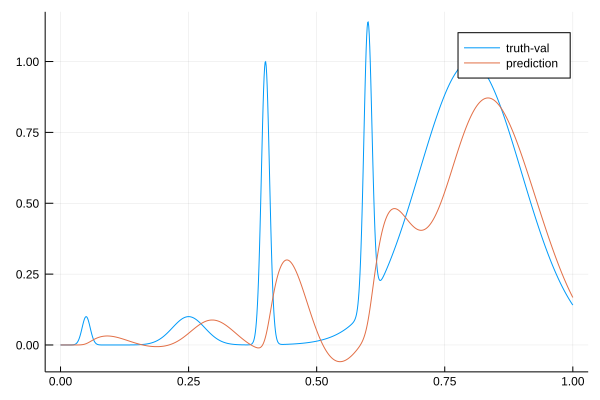

126.00188850408938 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  26.155386592825373
  29.910091282534204
   3.649350866208477
  32.879617973659904
 -24.967285669010852
   0.1              

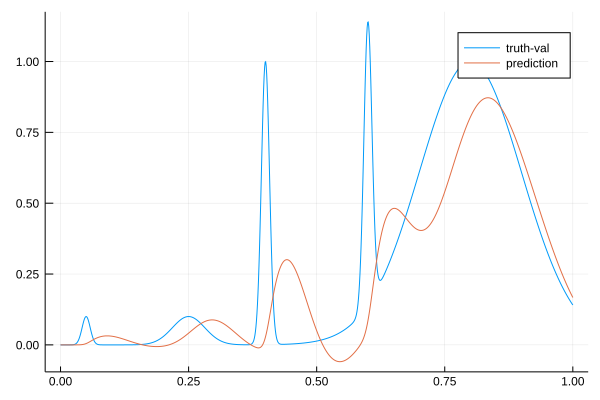

125.92259515412879 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  26.183709012699303
  29.984143959697263
   3.595533242676373
  32.95811751203084 
 -25.010616801826917
   0.1              

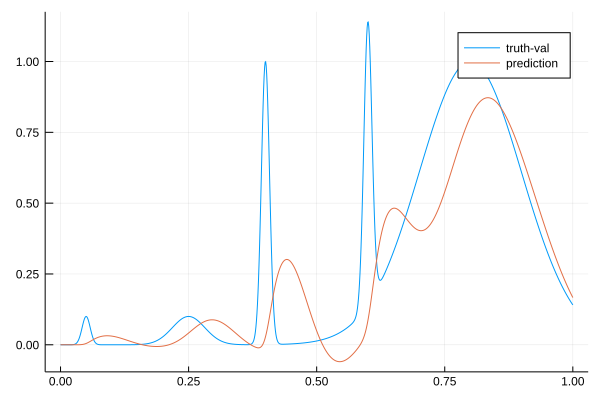

125.84911691190484 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  26.21829865347673 
  30.058488650689164
   3.541160630323853
  33.03740892781651 
 -25.054029582703524
   0.1              

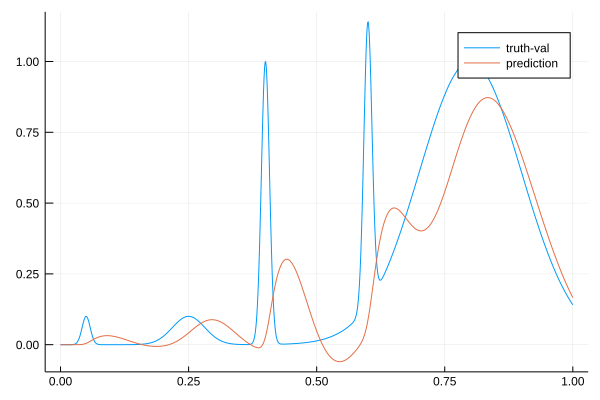

125.77248216644003 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  26.259374873890405 
  30.133138273489763 
   3.4862299958871503
  33.11752207828689  
 -25.097538053541825 
   0.1               

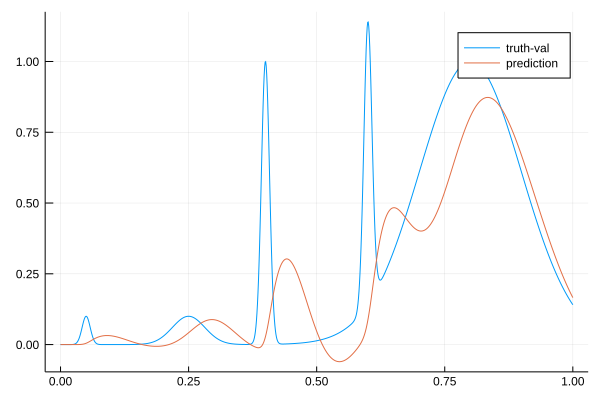

125.69345756425125 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  26.307135234569053
  30.208227533083967
   3.430737123317339
  33.198610250124375
 -25.14109325559962 
   0.1              

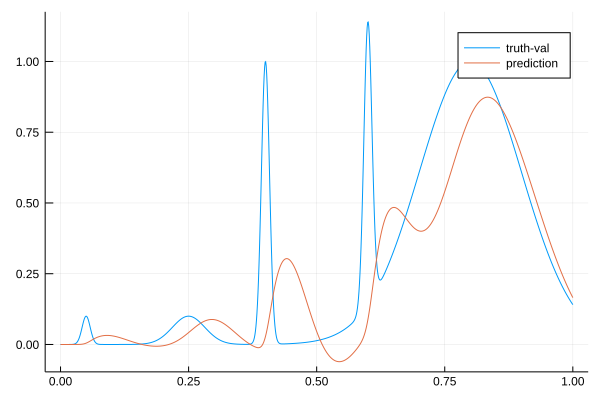

125.61356155008636 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  26.361791698107897
  30.283834840033613
   3.374673480586697
  33.280770365050074
 -25.184663748305745
   0.1              

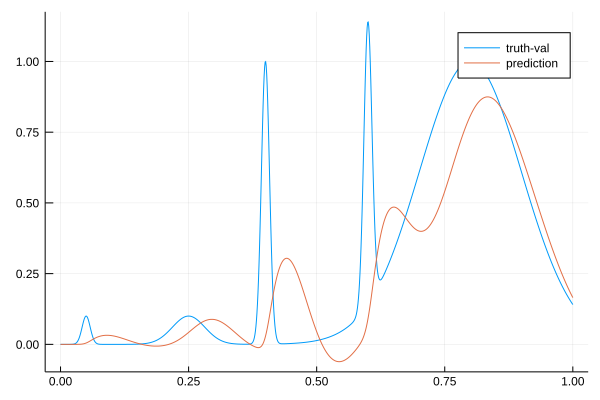

125.53307087519103 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  26.407829557125662 
  30.360927789732962 
   3.3187116752708214
  33.363764691832316 
 -25.228506486875446 
   0.1               

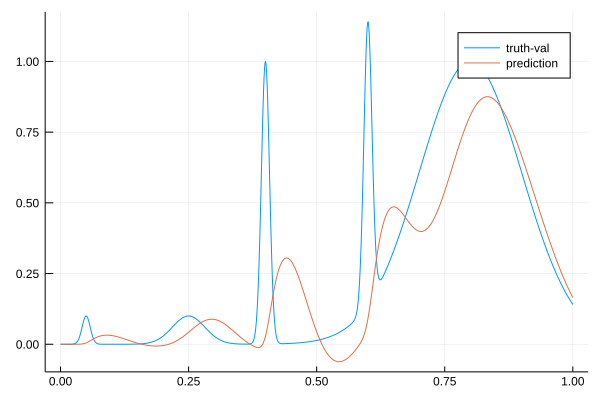

125.45293596497548 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  26.447012232646514
  30.43941040949227 
   3.262774575725449
  33.44763594716507 
 -25.272610601658833
   0.1              

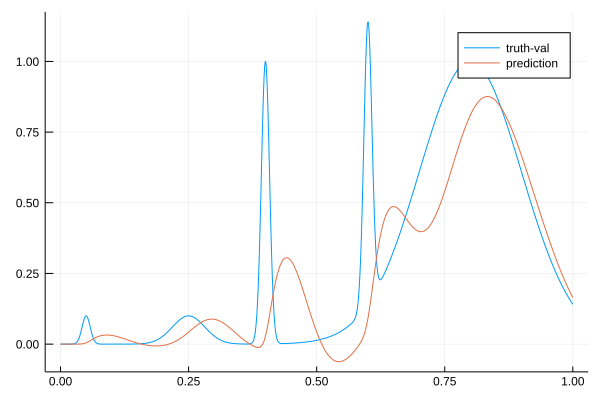

125.36942563889687 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  26.474652488086452 
  30.519202241472115 
   3.2068032623964786
  33.53193789314107  
 -25.31709628616382  
   0.1               

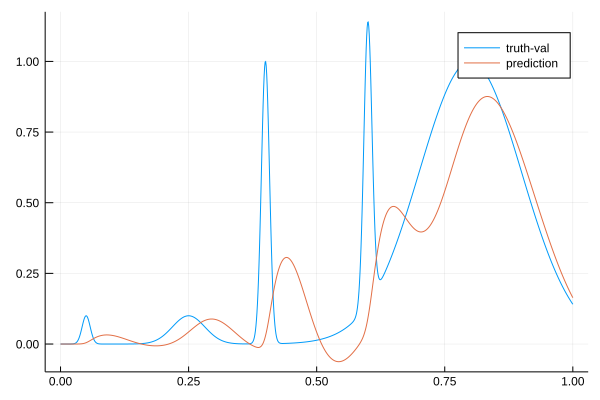

125.28671180986635 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  26.508906562205755
  30.59907476254076 
   3.150012779830638
  33.61683637062986 
 -25.361680017318218
   0.1              

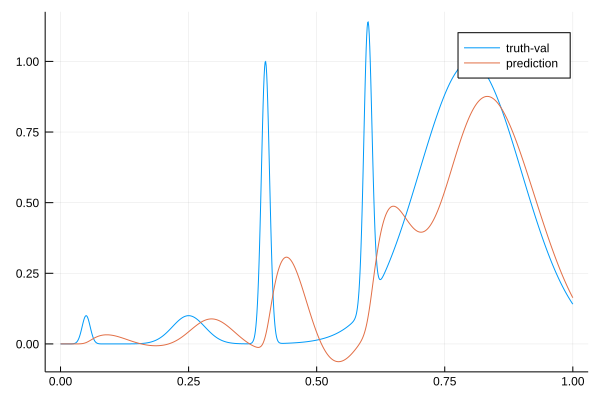

125.20372288490044 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  26.55031701762149  
  30.678730421620756 
   3.0923790206626895
  33.70206837185014  
 -25.40641454502606  
   0.1               

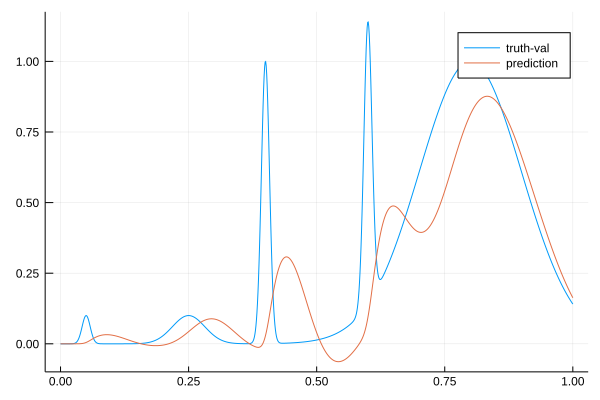

125.11913024885985 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  26.607750274657267
  30.757696842970795
   3.03368987784706 
  33.78786050673309 
 -25.450894070306454
   0.1              

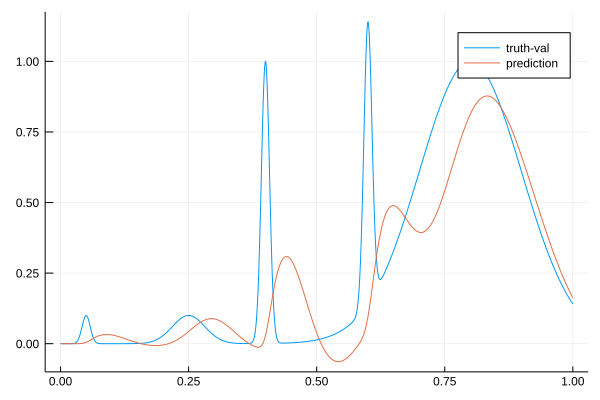

125.03299796617517 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  26.664747128788   
  30.83738002909476 
   2.974705877007637
  33.87434135267437 
 -25.495345323502605
   0.1              

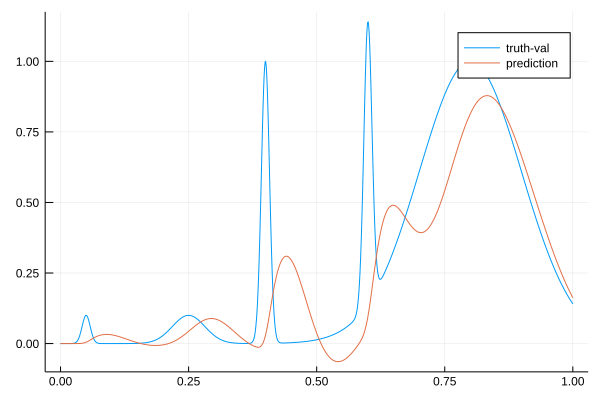

124.94675212738568 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  26.72230125555195  
  30.91788537265905  
   2.9153815421991496
  33.96169698972921  
 -25.53972059471369  
   0.1               

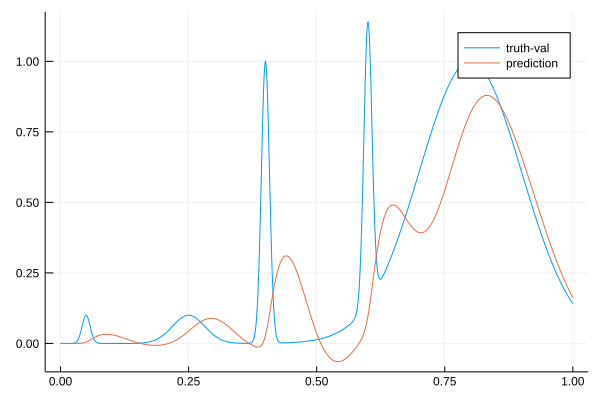

124.85870440406897 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  26.779781192588054 
  30.999294592248315 
   2.8556764016608693
  34.0499606569673   
 -25.584046568073127 
   0.1               

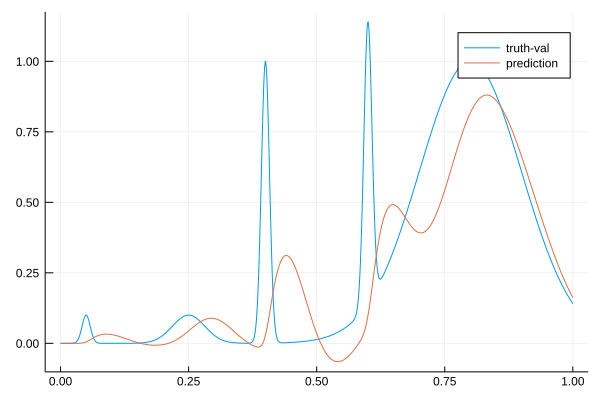

124.76909900529827 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  26.83840914468119 
  31.08127797076314 
   2.795506763357814
  34.13889024375098 
 -25.628376398455586
   0.1              

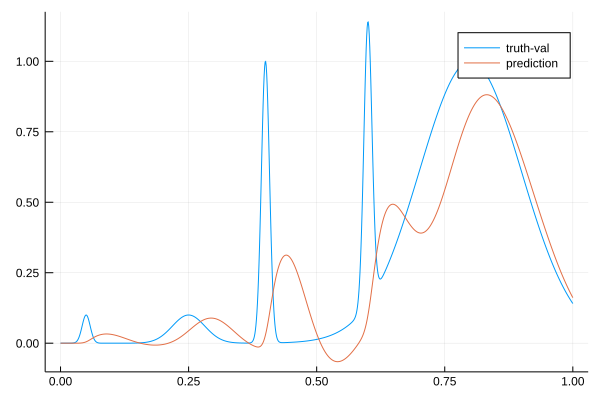

124.67748752238235 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  26.899064196896393 
  31.16384311193475  
   2.7348371996800513
  34.2285622228074   
 -25.67271783405921  
   0.1               

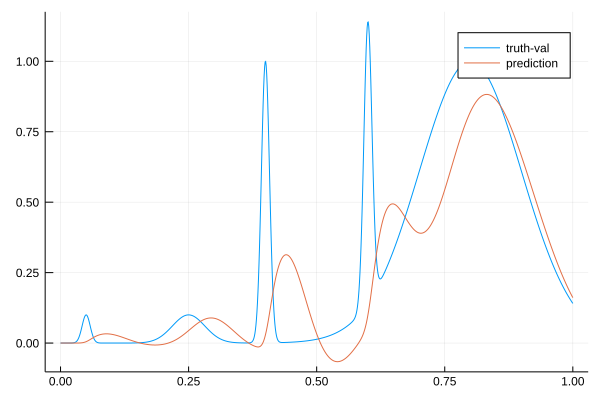

124.58295501644339 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  26.946479803102758 
  31.248403208852974 
   2.6743799283423733
  34.31923520508351  
 -25.717188426129926 
   0.1               

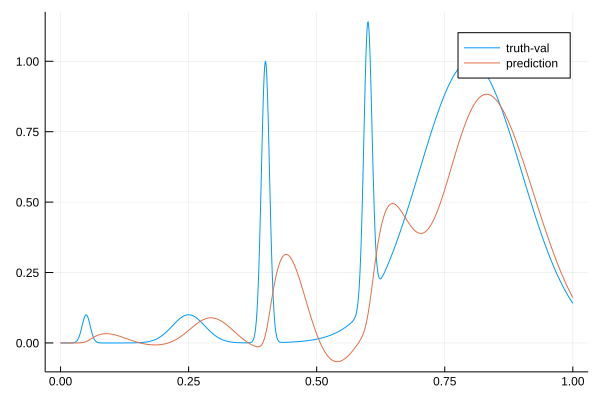

124.48783448324157 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  26.983034928758993 
  31.334937160606906 
   2.6140380031950317
  34.41107668442712  
 -25.76170909239603  
   0.1               

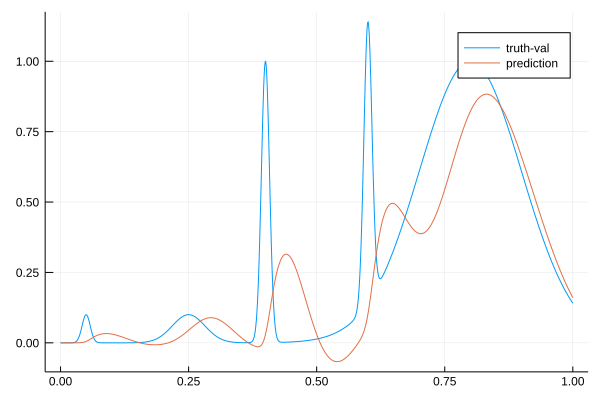

124.39145228255927 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  27.02719806266979 
  31.42155025196934 
   2.552934207829016
  34.50358330758122 
 -25.806217017541243
   0.1              

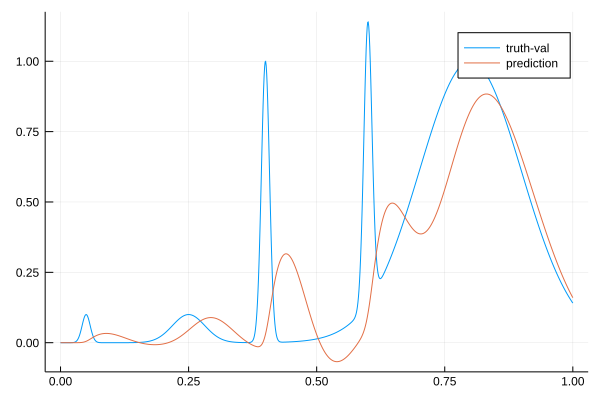

124.29234143343024 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  27.079264722132283
  31.508415412552377
   2.491067201652232
  34.5969547528616  
 -25.85064726507488 
   0.1              

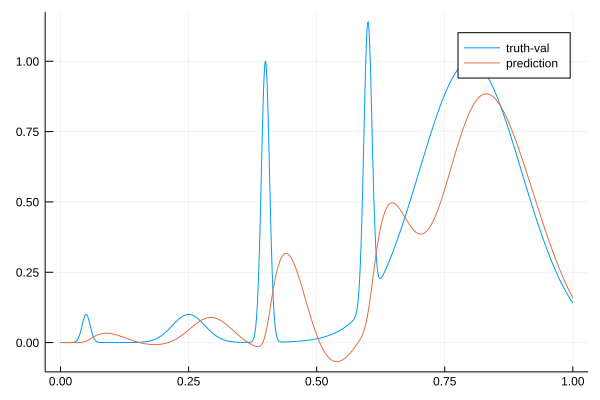

124.19003387275158 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  27.13950953040759  
  31.595690436332106 
   2.4284306136197142
  34.691373882499    
 -25.894940090464633 
   0.1               

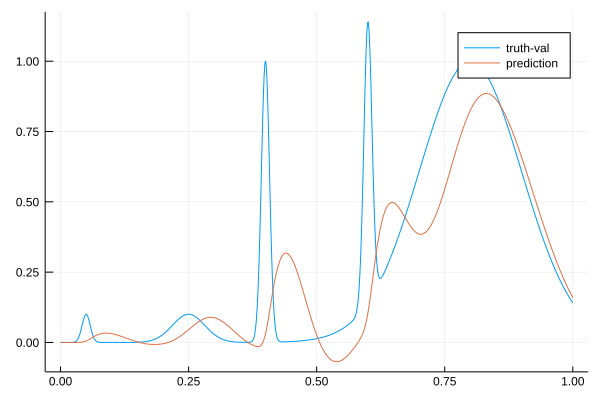

124.08806343748486 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  27.192304751740334
  31.68482162649965 
   2.365761637367467
  34.7871005632369  
 -25.939199377734198
   0.1              

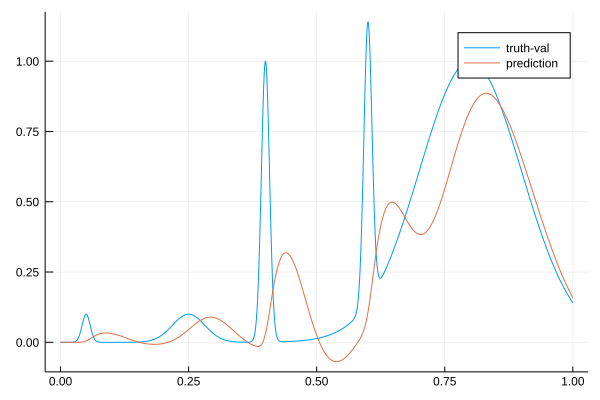

123.98402326049917 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  27.239780040569187
  31.775226214429402
   2.302930010197069
  34.88370464847709 
 -25.983537761707595
   0.1              

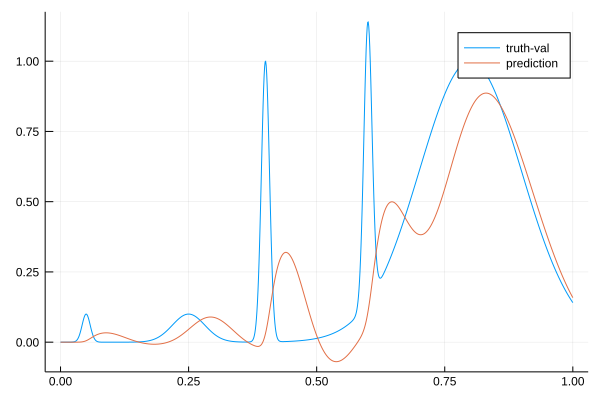

123.8766742721531 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  27.299500012834756 
  31.865653139123527 
   2.2391176953192695
  34.98127533751594  
 -26.027717761441046 
   0.1               

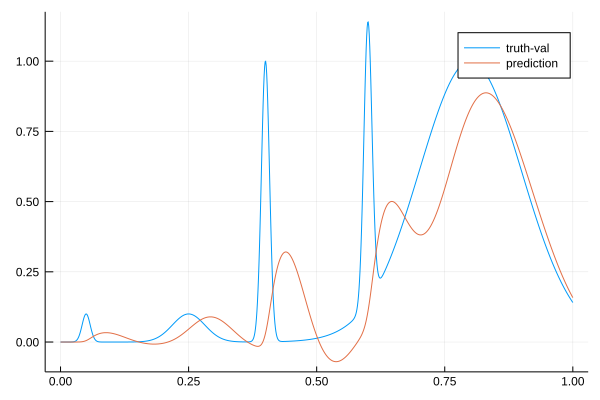

123.76562151656607 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  27.355561736634968
  31.957597877439017
   2.17508168140749 
  35.08009935694138 
 -26.07182841867936 
   0.1              

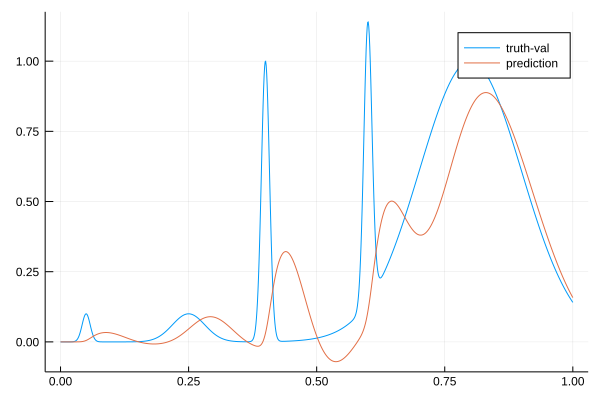

123.65567501282973 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  27.409784887163614 
  32.05055732395305  
   2.1107022118706444
  35.17980290417365  
 -26.115965650652033 
   0.1               

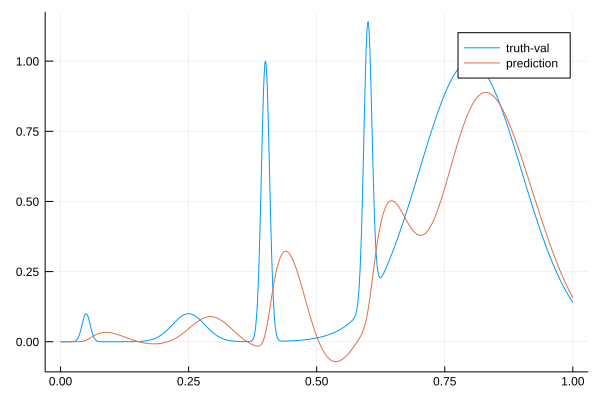

123.54323741472552 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  27.463585812923807
  32.144572318259385
   2.045921102269245
  35.28053717957597 
 -26.160058050773834
   0.1              

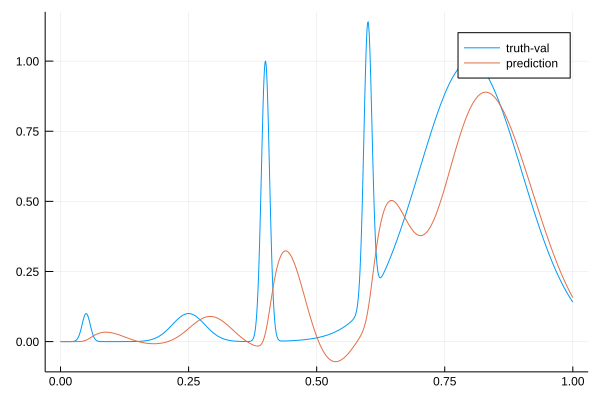

123.42749379976907 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  27.533921257918035 
  32.238405496963686 
   1.9799323480079485
  35.38236372366036  
 -26.203887283553662 
   0.1               

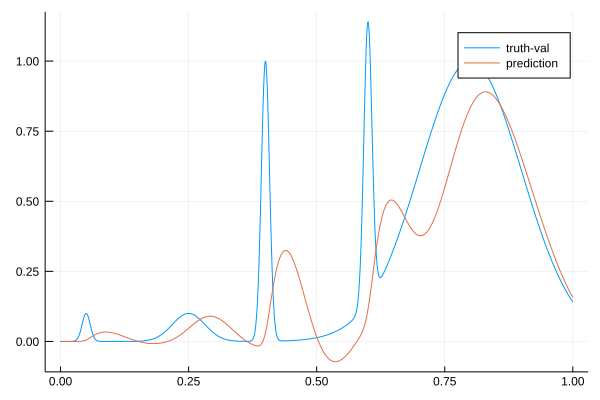

123.31013971614726 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  27.60316974350142  
  32.33362223105372  
   1.9135103169063759
  35.48549987595852  
 -26.24758812158044  
   0.1               

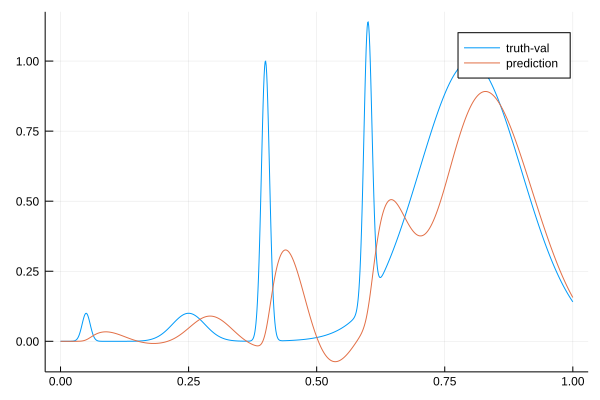

123.19144209168901 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  27.67295907894467  
  32.42969154056216  
   1.8465452141219858
  35.58952841853328  
 -26.291273398637134 
   0.1               

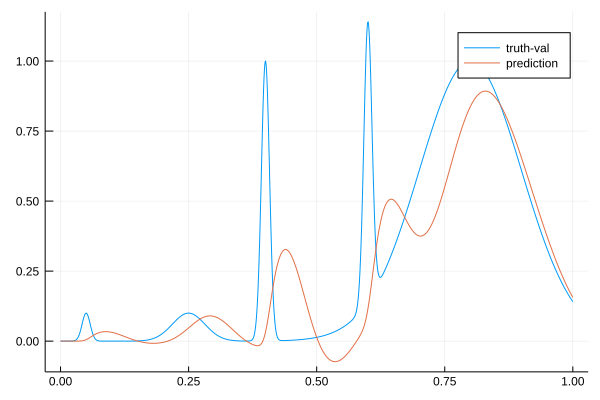

123.07096341343275 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  27.74412461415123  
  32.526723197275395 
   1.7789860303255758
  35.694625282321226 
 -26.334861793965263 
   0.1               

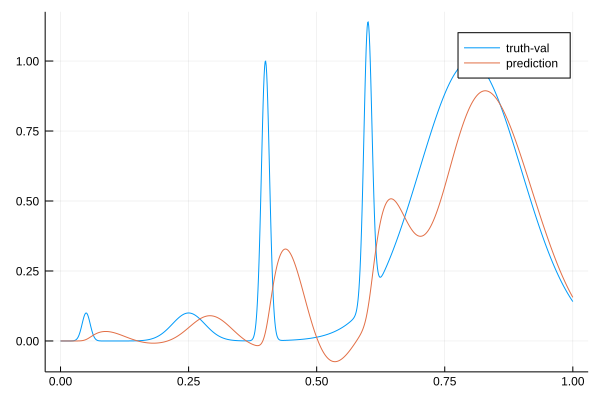

122.94864369118369 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  27.814115631991367
  32.62479743865026 
   1.710786461804812
  35.80067439489246 
 -26.378290953447078
   0.1              

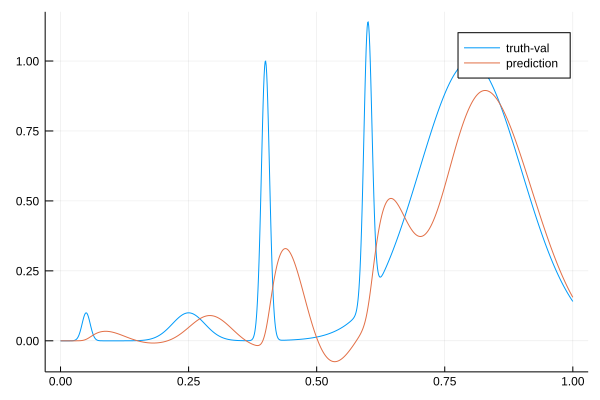

122.83056504909746 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  27.87793347162408  
  32.72381892019828  
   1.6419149701710543
  35.90719580539624  
 -26.421799240346797 
   0.1               

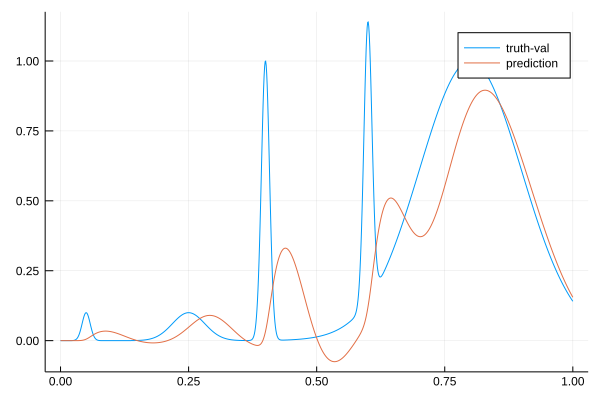

122.71146600067142 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  27.93019663132055  
  32.82399551165671  
   1.5727995834291275
  36.013997638343575 
 -26.465249442100035 
   0.1               

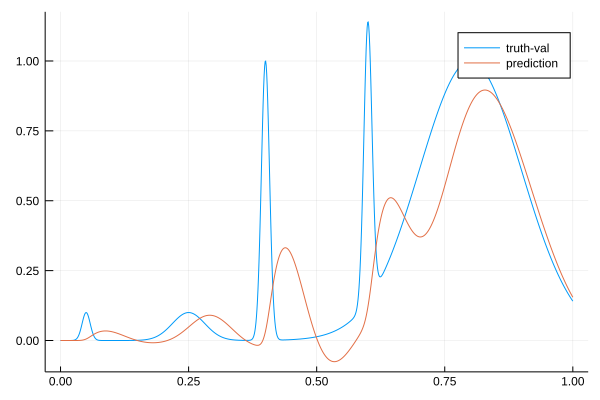

122.58840358201674 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  27.989380840415034 
  32.924060796401164 
   1.5026032786462138
  36.121198334456984 
 -26.50843316602416  
   0.1               

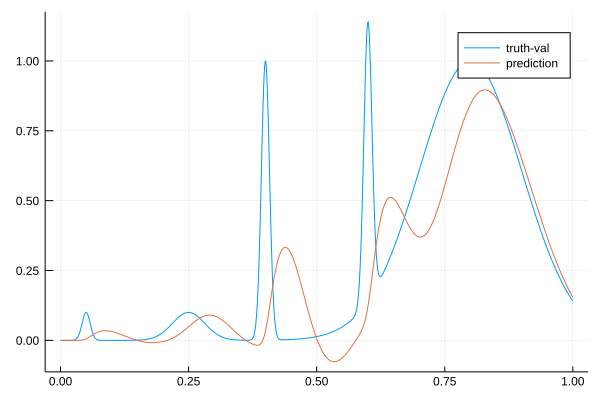

122.46354426106818 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  28.05614297823082  
  33.024100597319865 
   1.4313245395608258
  36.228936047317816 
 -26.55134246393395  
   0.1               

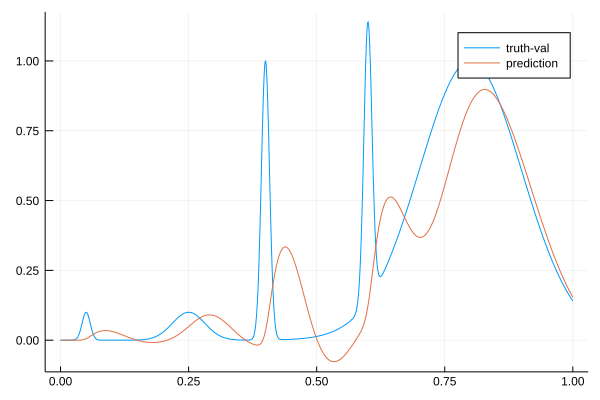

122.33862202892287 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  28.131289464636108 
  33.12382247793471  
   1.3589131457521069
  36.336976098856084 
 -26.594033016667577 
   0.1               

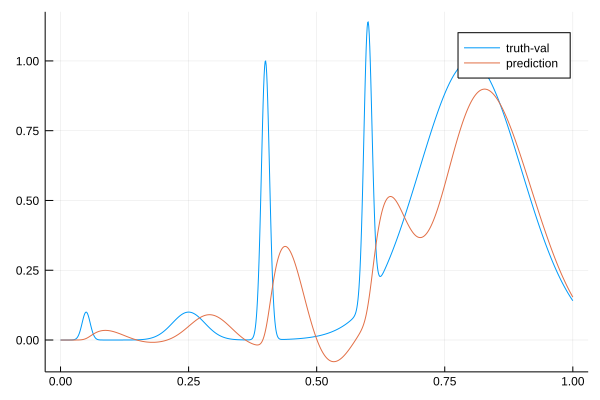

122.20945062164543 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  28.199587761944628 
  33.22479189105201  
   1.2861320474203743
  36.44574356523828  
 -26.636527192551213 
   0.1               

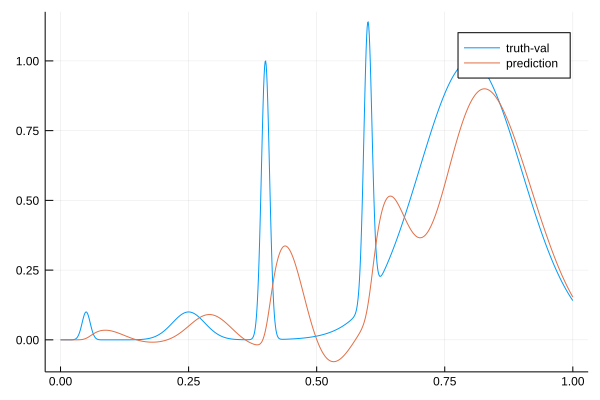

122.07752564571351 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  28.263179871696188 
  33.326959130373105 
   1.2129035612193313
  36.55535278703819  
 -26.67880051773578  
   0.1               

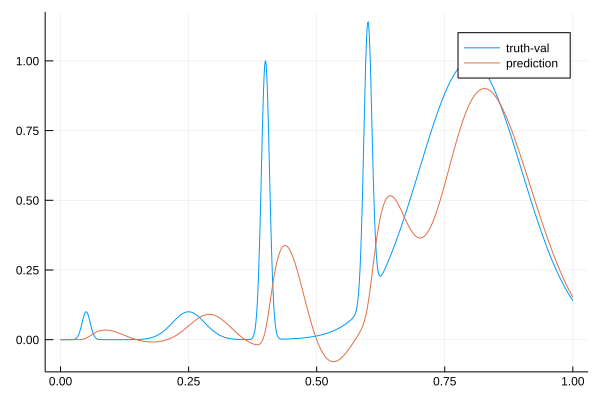

121.94482185158833 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  28.3240203822792   
  33.430383958607266 
   1.1391602537516743
  36.66601445547436  
 -26.720761015550025 
   0.1               

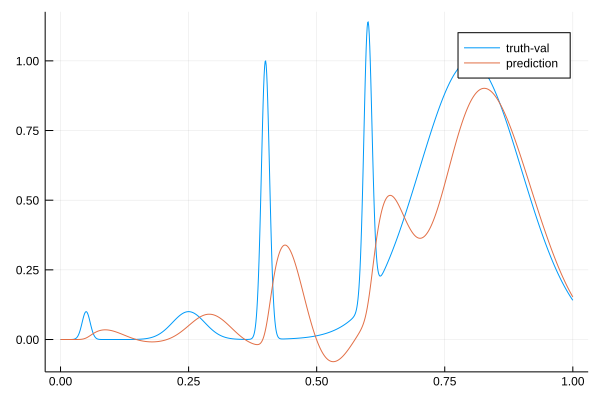

121.81007194379347 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  28.38410579147584  
  33.53463478428837  
   1.0647921050058407
  36.77743973508264  
 -26.762455723759235 
   0.1               

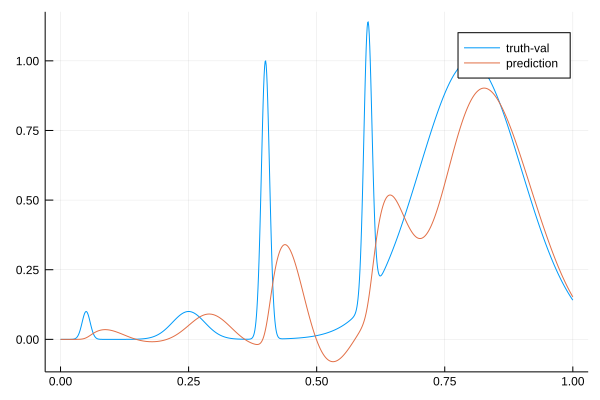

121.67285473807006 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  28.443499593514083 
  33.63984400982596  
   0.9897510269720803
  36.88976855409548  
 -26.803852791977672 
   0.1               

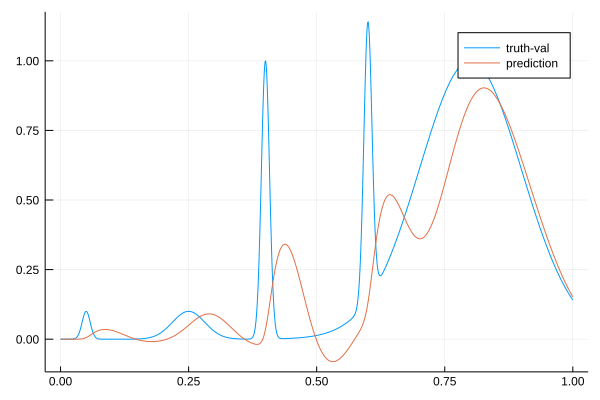

121.5313440717412 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  28.519424326928622
  33.74462607976535 
   0.913222519157493
  37.00290920611714 
 -26.844850908232825
   0.1              

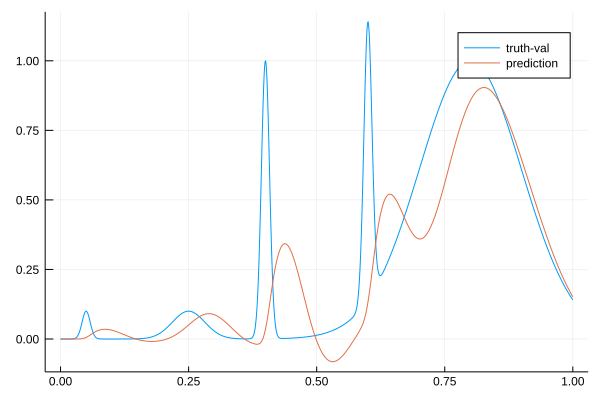

121.38975283441044 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  28.596399988147294
  33.85007744130323 
   0.835947360443735
  37.116786235863884
 -26.88557628279043 
   0.1              

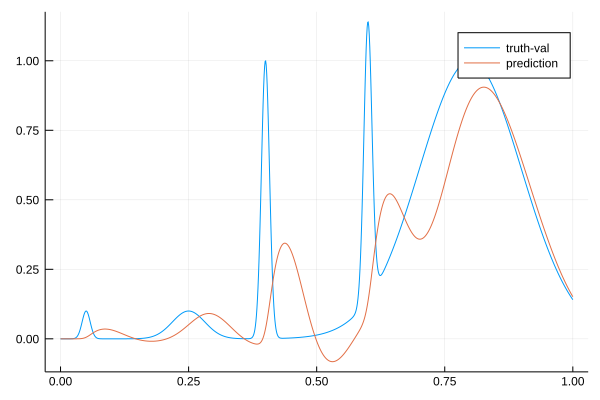

121.24465465959243 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  28.67589525068802 
  33.956308114122784
   0.757873731741254
  37.23162271714305 
 -26.925933165526615
   0.1              

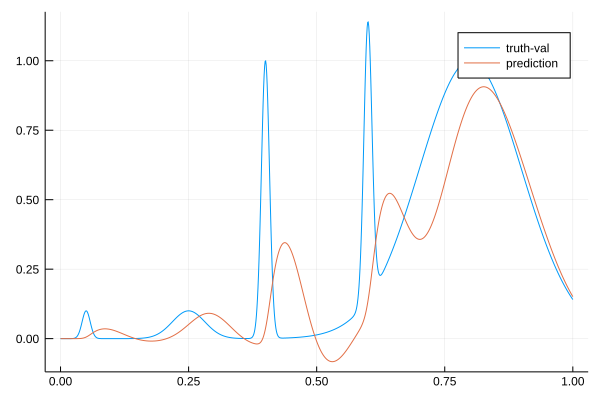

121.09562954036288 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  28.759263124220897 
  34.06331097171777  
   0.6789497859759814
  37.34751348455544  
 -26.965898404562047 
   0.1               

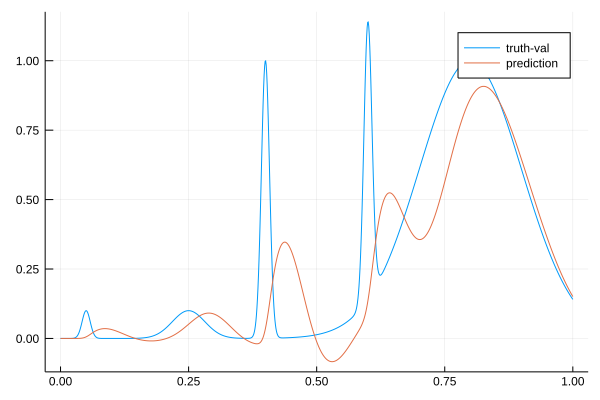

120.94598312787781 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  28.847735634037033 
  34.17118347740393  
   0.5991267985718075
  37.464650785689635 
 -27.005381334861514 
   0.1               

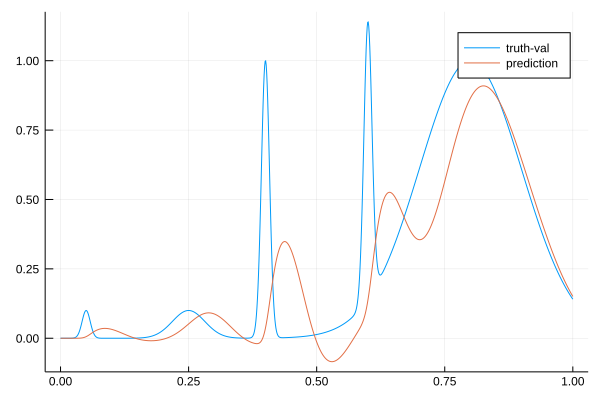

120.79483288262199 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  28.935093705014708 
  34.28011037956228  
   0.5188224253057296
  37.58274640199875  
 -27.0442636707007   
   0.1               

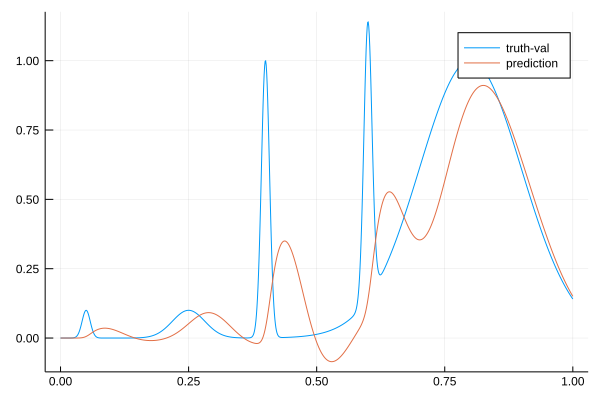

120.64130002313637 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  29.023129071904776 
  34.39005271947486  
   0.4379426252385064
  37.70189595176988  
 -27.08253848356942  
   0.1               

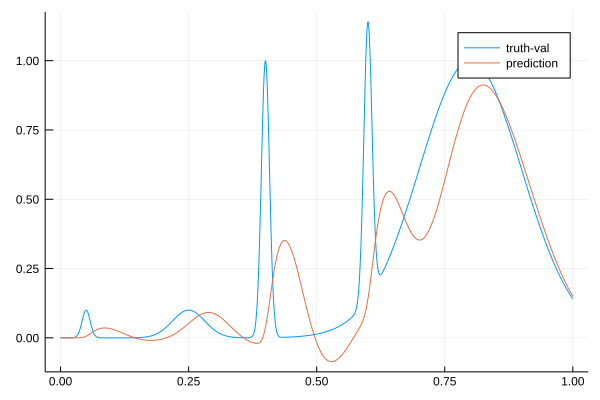

120.48283358747828 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  29.11346116505014  
  34.501078757640734 
   0.3564019083455099
  37.822290606983934 
 -27.120130064242165 
   0.1               

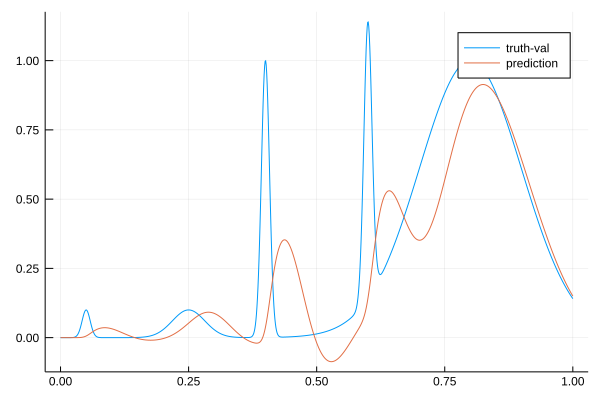

120.32442536163778 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  29.191985640787767 
  34.61412679600462  
   0.2748477615307975
  37.94382875184644  
 -27.15715334781187  
   0.1               

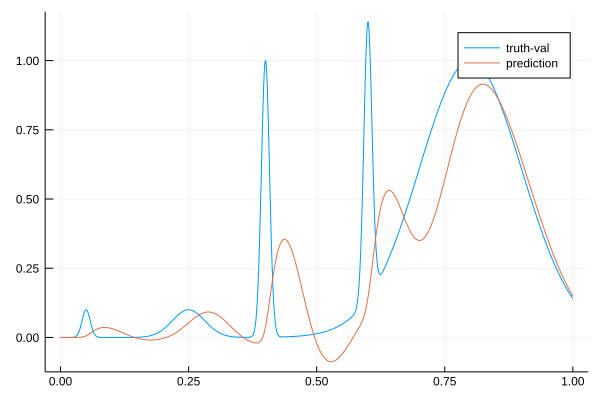

120.16165500058243 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0                
   0.001              
   0.001              
  29.261678682412665  
  34.729048664396714  
   0.19313848732149685
  38.066585858746784  
 -27.193585143002668  
   0.1                

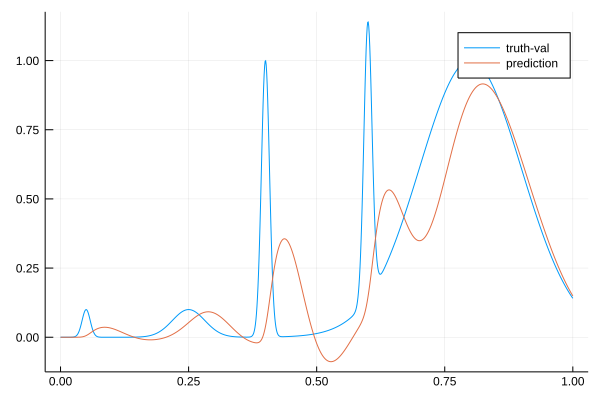

119.99713756915149 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0                
   0.001              
   0.001              
  29.32372457454784   
  34.84584960929803   
   0.11115425120588596
  38.19066004828919   
 -27.22939304736289   
   0.1                

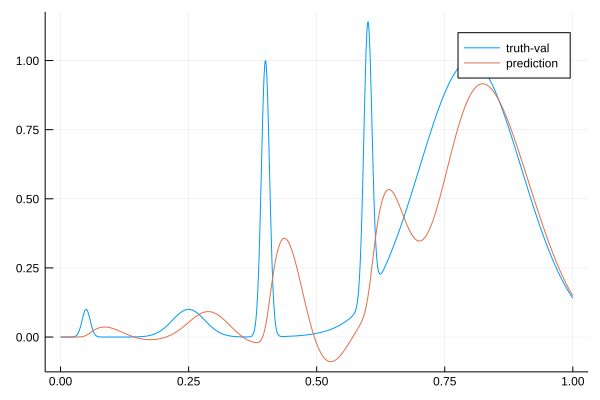

119.8299034394868 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0                
   0.001              
   0.001              
  29.396715857429232  
  34.96265411258131   
   0.02795759697850267
  38.315530947683186  
 -27.26458250202956   
   0.1                

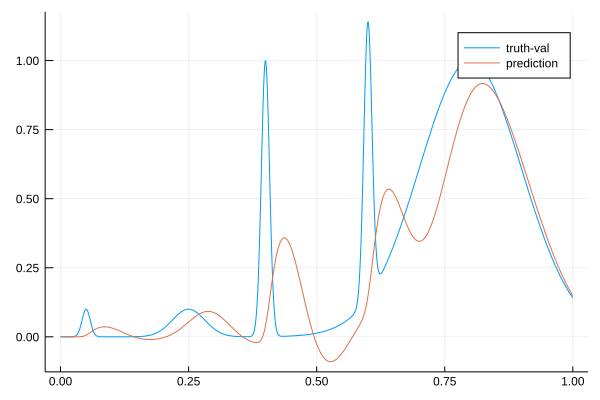

119.65862341076922 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0                
   0.001              
   0.001              
  29.48132321234956   
  35.07946636029525   
  -0.05647296310233102
  38.441255906546594  
 -27.299149906238725  
   0.1                

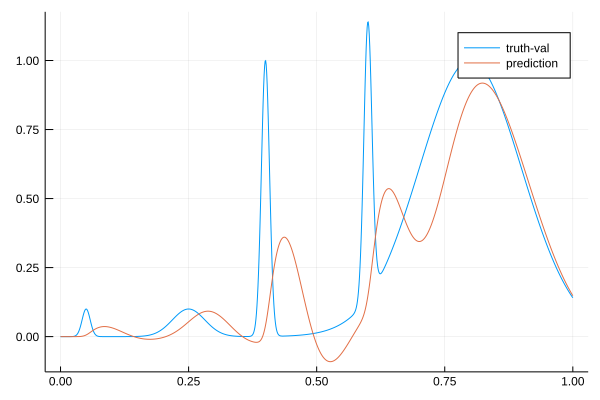

119.48279255779595 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0                
   0.001              
   0.001              
  29.57811741809901   
  35.196435601196555  
  -0.14216366617382603
  38.568034387087515  
 -27.333006594753073  
   0.1                

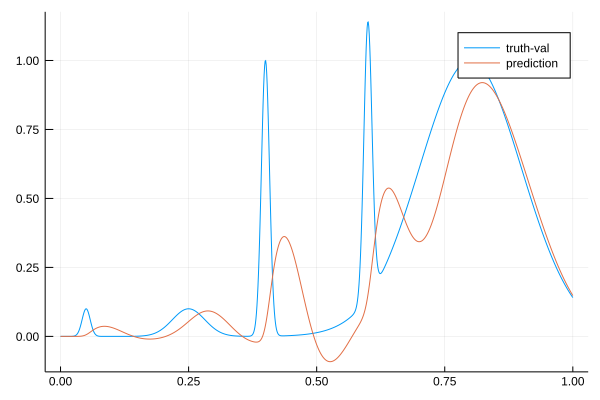

119.30598462917719 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  29.672381553790885 
  35.315083651003796 
  -0.2283704765275823
  38.69628989107885  
 -27.36607961538762  
   0.1               

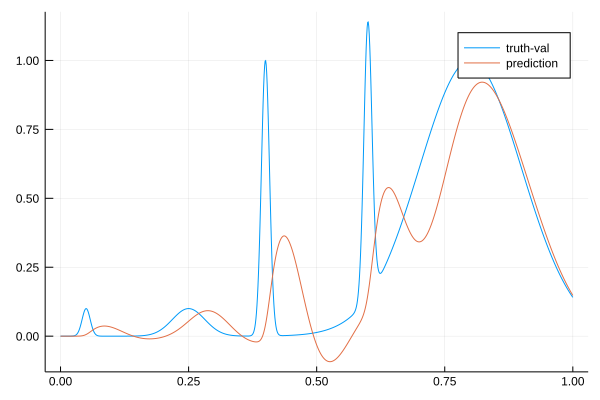

119.12795210591956 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  29.766536289696127 
  35.43478652433711  
  -0.3152579206533167
  38.82557012641767  
 -27.398499517616436 
   0.1               

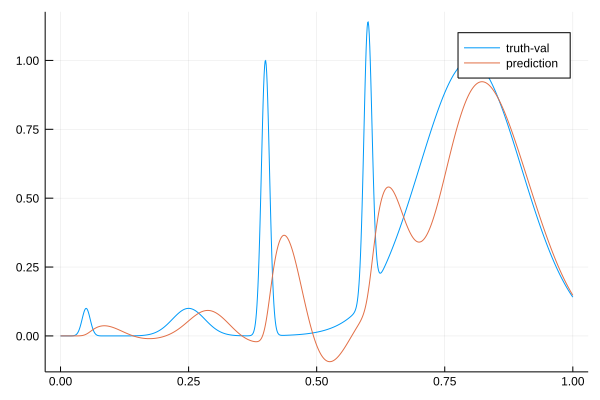

118.94777735082161 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  29.855960199688933 
  35.555599157397815 
  -0.4028921572887564
  38.95558624743382  
 -27.43047030369143  
   0.1               

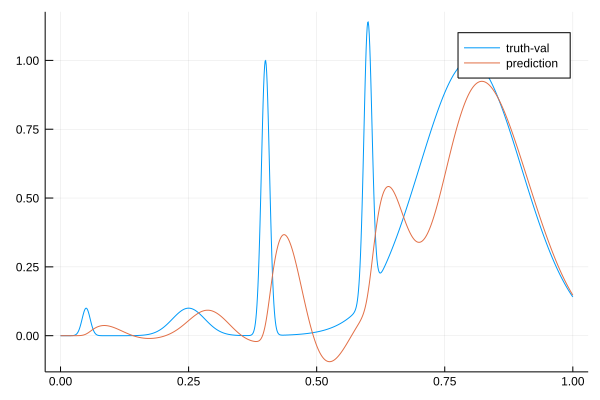

118.76542437935785 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0                
   0.001              
   0.001              
  29.92723481188126   
  35.678935200379776  
  -0.49057587637310474
  39.08680245038489   
 -27.46186919097672   
   0.1                

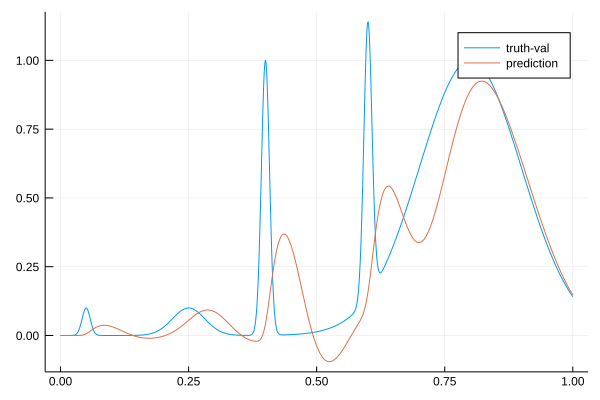

118.58409981574319 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  30.008063525767323 
  35.8018625515838   
  -0.5795576262807541
  39.21828515230276  
 -27.492628231414404 
   0.1               

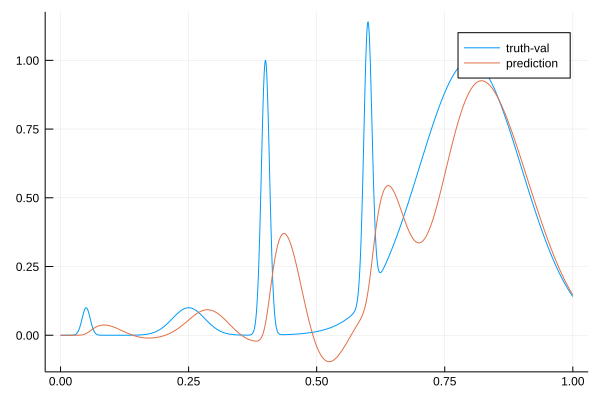

118.39812020437364 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  30.099408331547682 
  35.92454779976029  
  -0.6698629312574882
  39.35027804893609  
 -27.522648416538207 
   0.1               

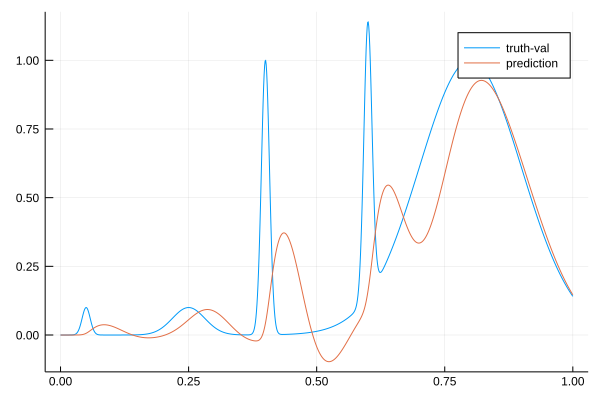

118.20914602852716 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  30.202123087987292 
  36.04713842109782  
  -0.7615228591011003
  39.482999800712946 
 -27.55183767194985  
   0.1               

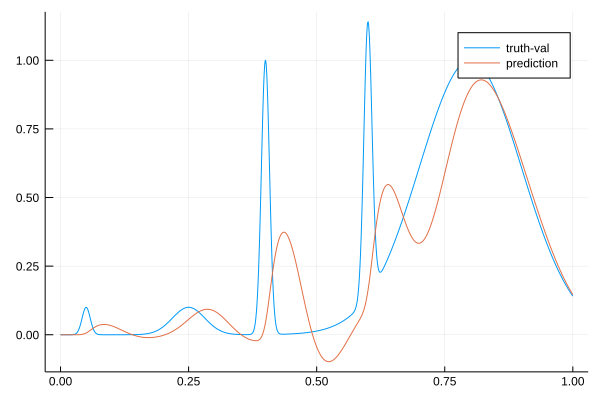

118.02163522127164 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  30.302100709940053 
  36.17056732436982  
  -0.8538535101227009
  39.61632523435928  
 -27.580301210682514 
   0.1               

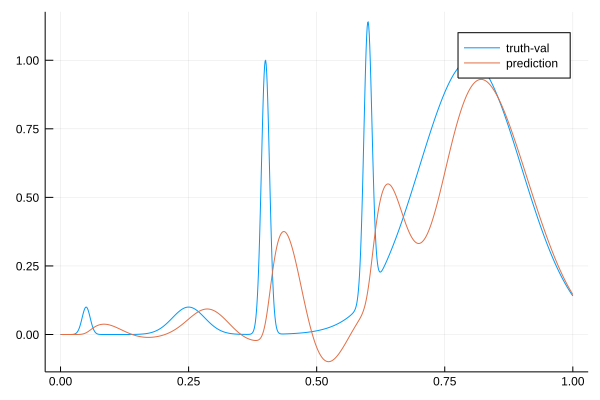

117.82922569549527 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  30.400249337319327 
  36.294915538191056 
  -0.9469578124654444
  39.75040457434869  
 -27.607997858136066 
   0.1               

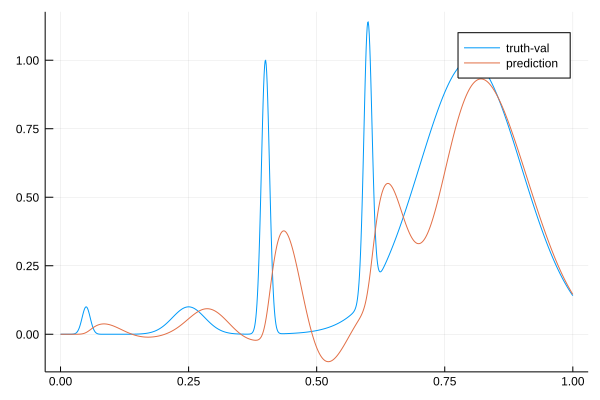

117.6308861565297 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  30.498890240145574 
  36.42019867862496  
  -1.0409313954347899
  39.885426426062736 
 -27.63482720960243  
   0.1               

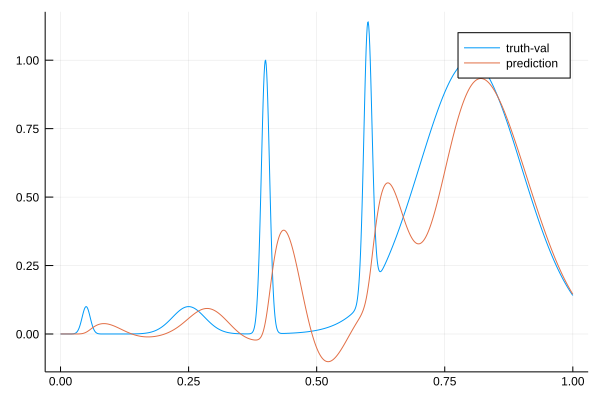

117.43459711244888 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  30.600367861220082 
  36.54582023260547  
  -1.1359202065026188
  40.02096218928959  
 -27.660918864203115 
   0.1               

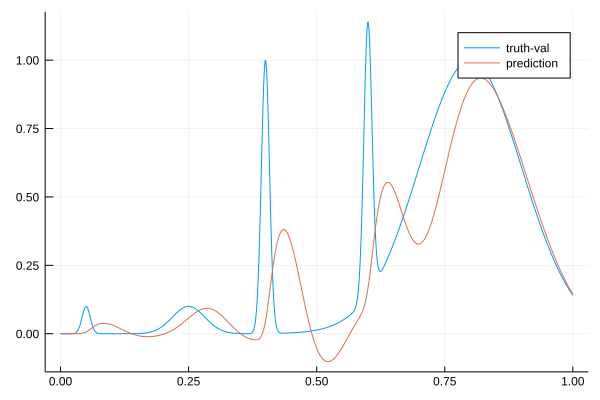

117.23349515522419 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  30.691103008458825 
  36.67325561551255  
  -1.2312193785360386
  40.15750358966381  
 -27.686116175943333 
   0.1               

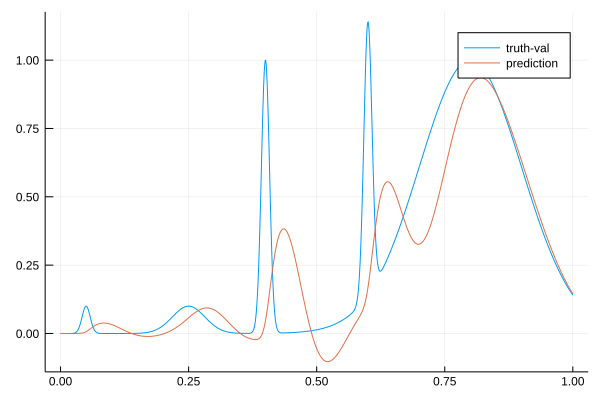

117.02815165678803 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  30.774448940304843 
  36.8024039933942   
  -1.3269724553496303
  40.29519845266758  
 -27.710319460018304 
   0.1               

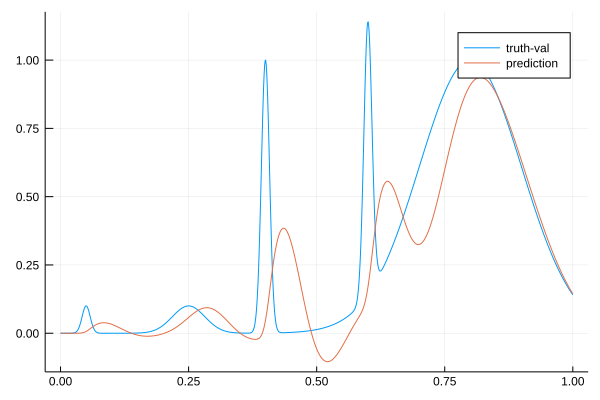

116.82252446777515 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  30.868797870097257 
  36.93161637596016  
  -1.4240845917039064
  40.43373860103522  
 -27.733589442783515 
   0.1               

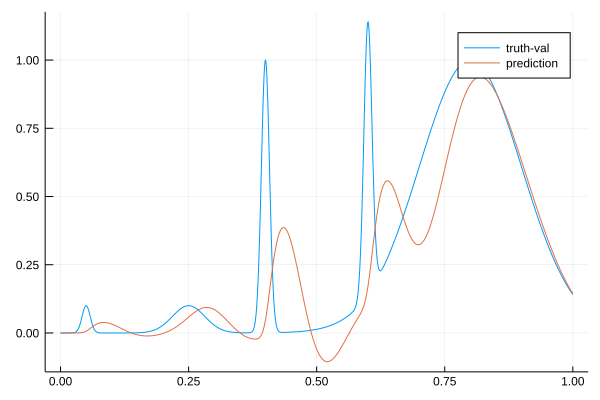

116.61262186401157 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  30.97535076673113 
  37.060492196480084
  -1.522651315898802
  40.572815856564105
 -27.755980094721075
   0.1              

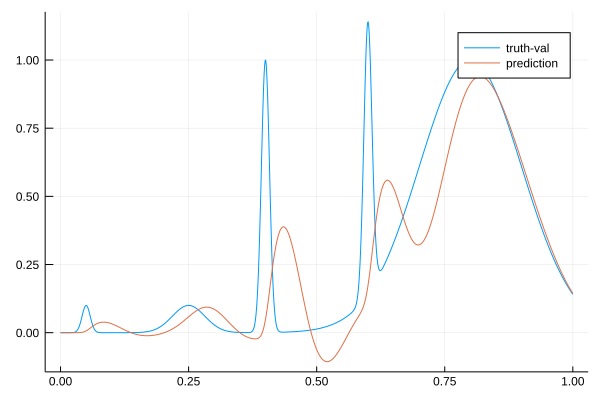

116.39940087941352 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  31.087421697905672 
  37.189736368560446 
  -1.6222016739998237
  40.71263541029217  
 -27.777186776858738 
   0.1               

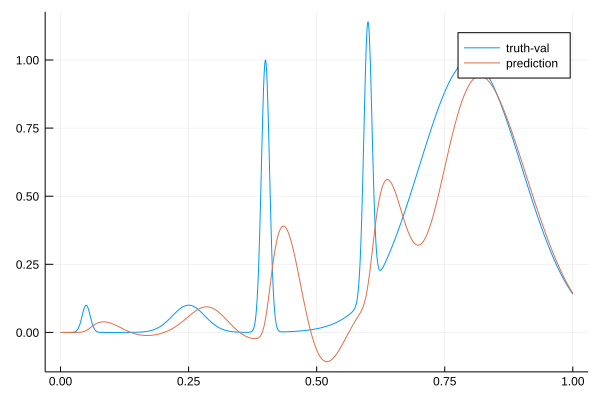

116.18619211886478 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  31.206714175297094 
  37.319243488478996 
  -1.7228333454180342
  40.85322133532153  
 -27.797223901420118 
   0.1               

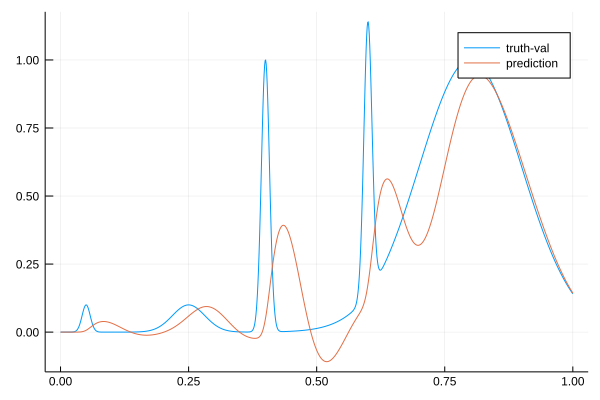

115.97366836563074 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  31.319974736084163 
  37.450000684414256 
  -1.8239174624447818
  40.99457346377491  
 -27.81607372524361  
   0.1               

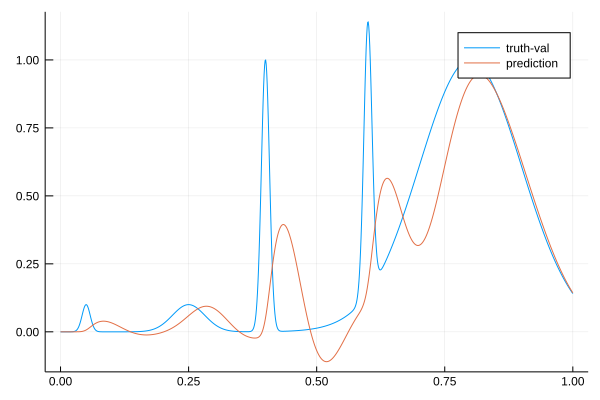

115.7559003592228 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  31.40896776971721  
  37.58336922341494  
  -1.9248163610571176
  41.13676538703515  
 -27.833707166559567 
   0.1               

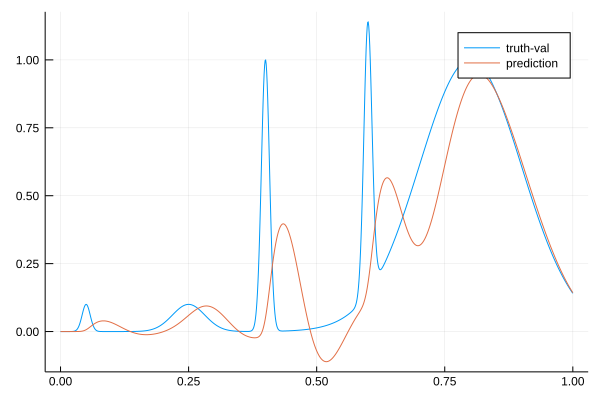

115.53823697100351 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  31.478693438214535
  37.71897737404706 
  -2.025737450796912
  41.27979183032887 
 -27.850128129716065
   0.1              

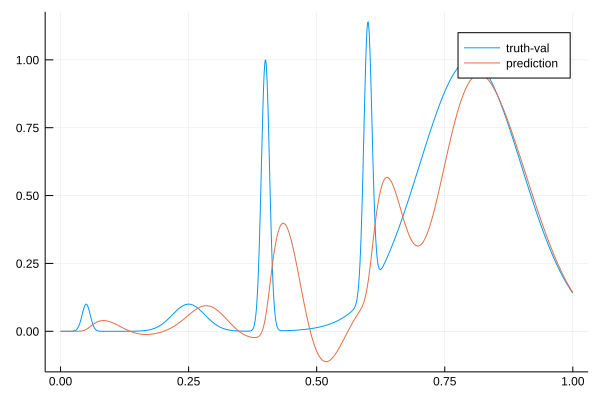

115.3208842216528 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  31.564364061267195 
  37.853283053151216 
  -2.1284634092894805
  41.422654444670165 
 -27.86563379354613  
   0.1               

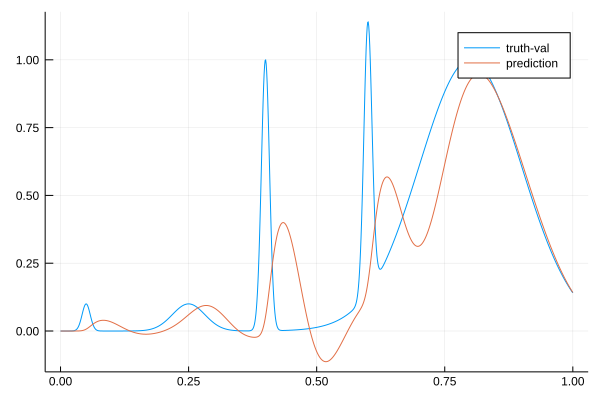

115.09693211690819 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  31.680388407386317
  37.98500444690638 
  -2.233747379721608
  41.56523151690705 
 -27.88026949696046 
   0.1              

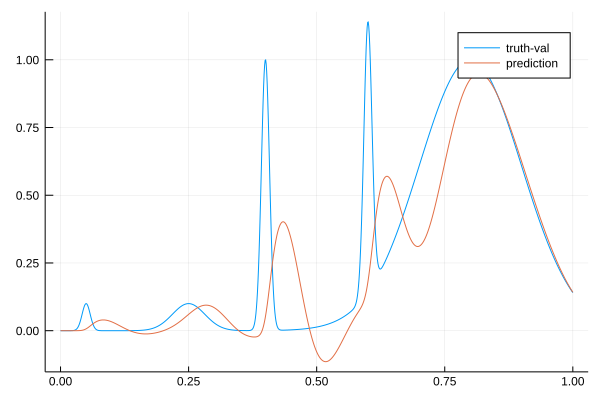

114.87163000862407 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  31.81156211003925 
  38.11577604120873 
  -2.340772988960948
  41.70799361816952 
 -27.89386944447969 
   0.1              

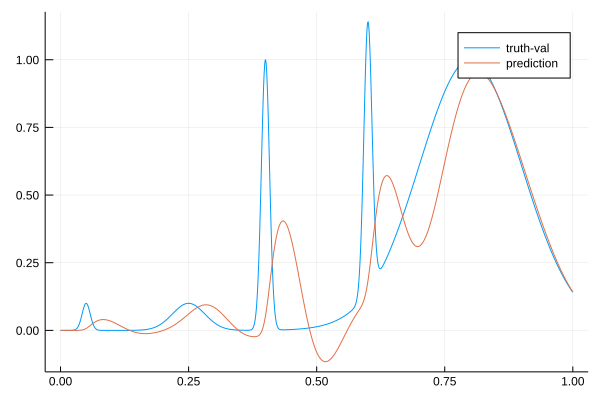

114.646354018183 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  31.930006595087253
  38.24806111701897 
  -2.448102439766982
  41.85127143454198 
 -27.90623709891474 
   0.1              

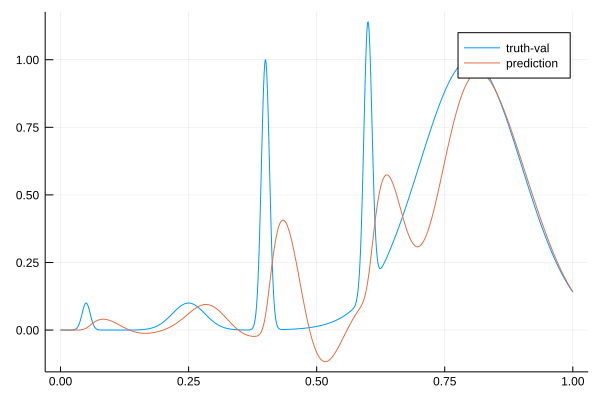

114.41663122432641 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  32.02423738564636 
  38.38314160499282 
  -2.555138377370579
  41.99553663779411 
 -27.917157310220386
   0.1              

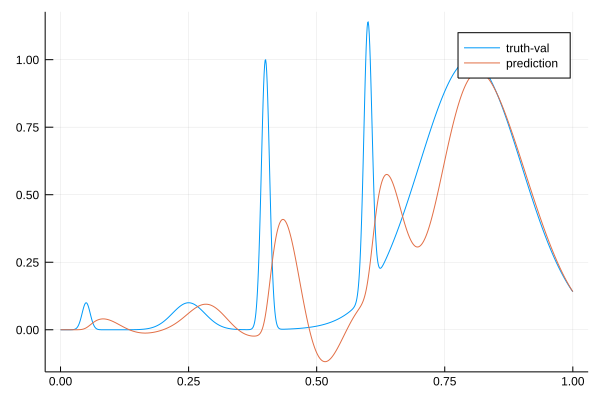

114.18749011118312 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  32.11408887085066  
  38.51919272548477  
  -2.6628887699191544
  42.14040916323703  
 -27.926790449176995 
   0.1               

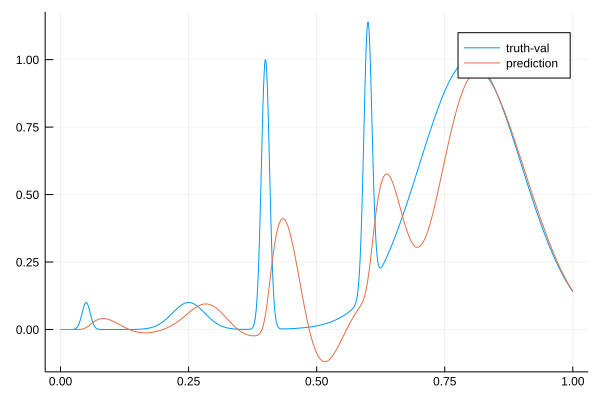

113.95922049002336 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  32.22363484136415  
  38.6537730326943   
  -2.7725017882697074
  42.28528272377046  
 -27.935175919109373 
   0.1               

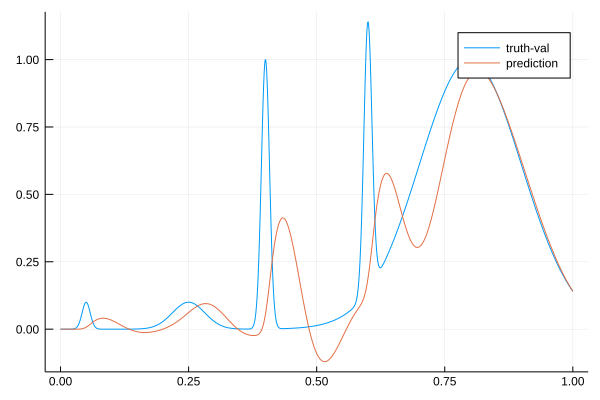

113.72674999107468 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  32.355001074548966
  38.78630273258572 
  -2.884051287859519
  42.42978890286883 
 -27.942507200573512
   0.1              

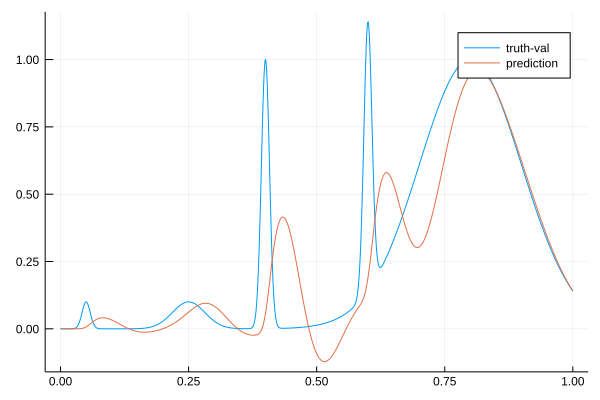

113.49381983257156 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  32.482637246829555
  38.91957060087677 
  -2.996039471267693
  42.57469886875694 
 -27.94851025635145 
   0.1              

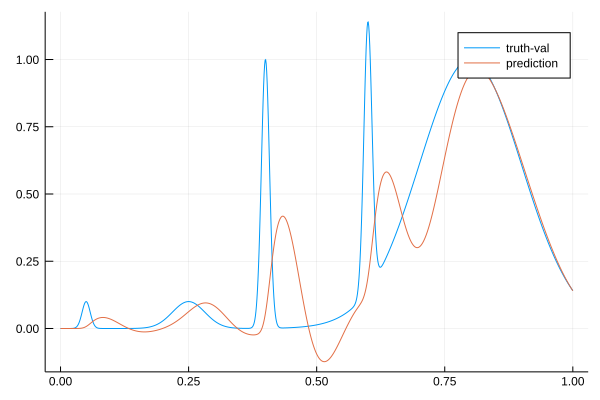

113.25924656447887 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  32.58056749299563 
  39.05616116433674 
  -3.107090739406865
  42.720698198891064
 -27.95293944469935 
   0.1              

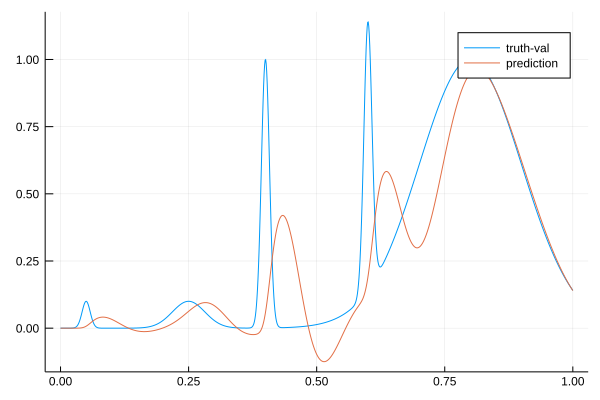

113.0278990388962 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  32.672066754133574
  39.19350642337315 
  -3.21836372664315 
  42.86692433960952 
 -27.956168784985746
   0.1              

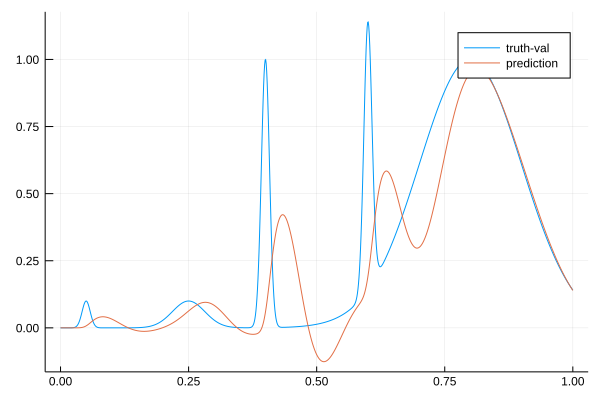

112.79703833595299 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  32.7731066296942   
  39.32965131697764  
  -3.3307750604486066
  43.01263676844444  
 -27.958864566521886 
   0.1               

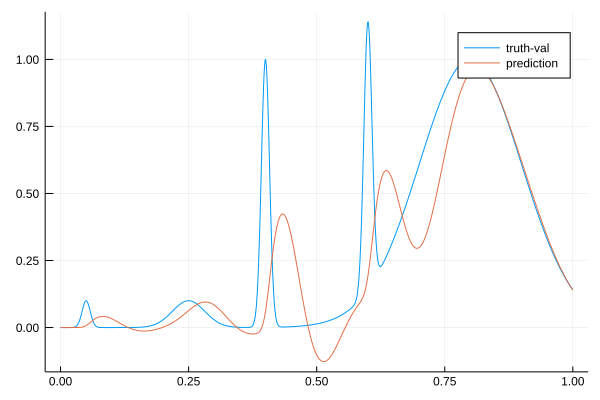

112.56062097847827 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  32.90062936144456  
  39.46290957119688  
  -3.4451808993693054
  43.15754478411324  
 -27.961215767034517 
   0.1               

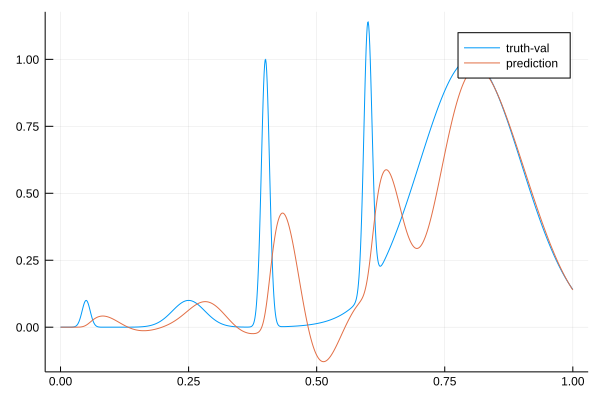

112.33171525255413 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  33.029626605294105
  39.59570207167553 
  -3.560167951193516
  43.302054080510466
 -27.96289354475655 
   0.1              

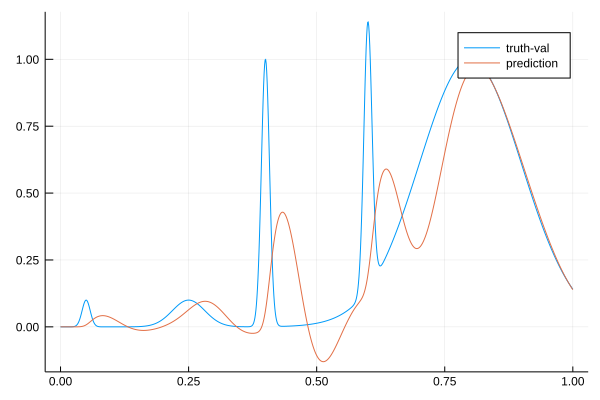

112.09984674339387 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  33.12094781007502  
  39.73208012308751  
  -3.6735881092383487
  43.44730252631734  
 -27.96331219898272  
   0.1               

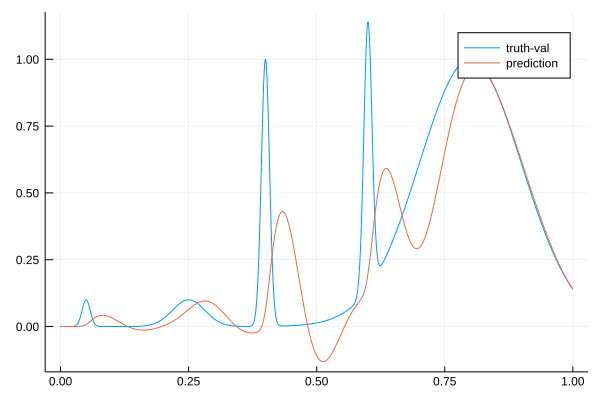

111.86978400746065 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  33.21557843167132  
  39.86814517918714  
  -3.7873978782345237
  43.59245210448569  
 -27.96299773404135  
   0.1               

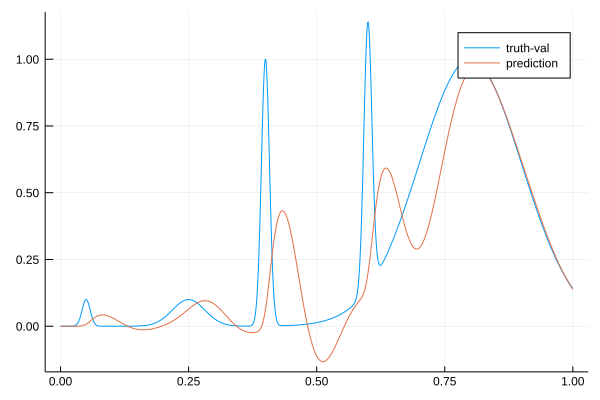

111.63965864273082 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  33.35575984563873 
  39.99908873243297 
  -3.904040851269437
  43.73634725516239 
 -27.962682771745087
   0.1              

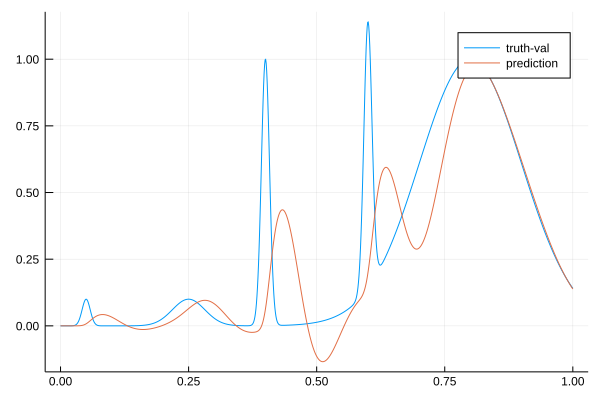

111.41316794712881 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  33.46844732373488 
  40.13254704923503 
  -4.019227926151229
  43.88054177985357 
 -27.961059379401874
   0.1              

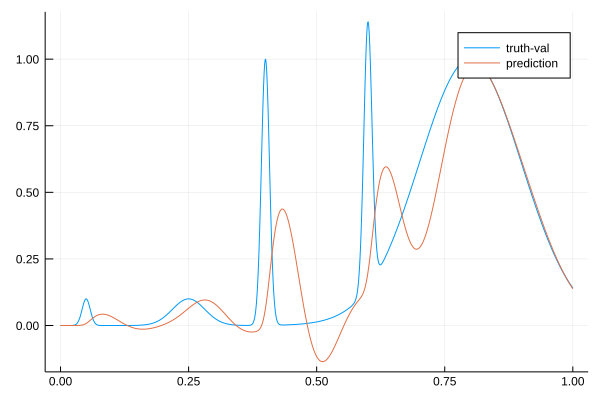

111.18911907800074 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  33.54710620263582 
  40.26935989604386 
  -4.13256754858094 
  44.025406324676794
 -27.957925815389974
   0.1              

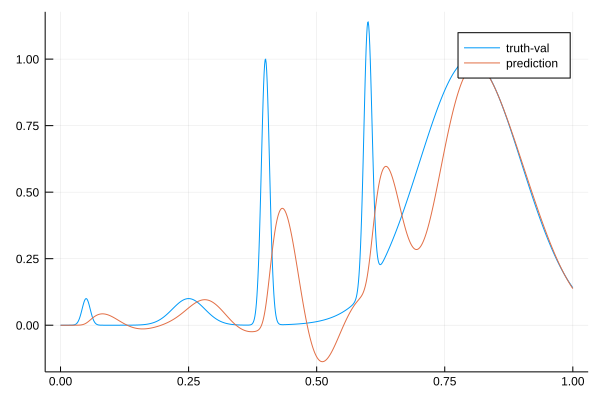

110.96855500919527 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  33.70685279158065 
  40.39503944452398 
  -4.251244650179969
  44.167239830138314
 -27.955845684877175
   0.1              

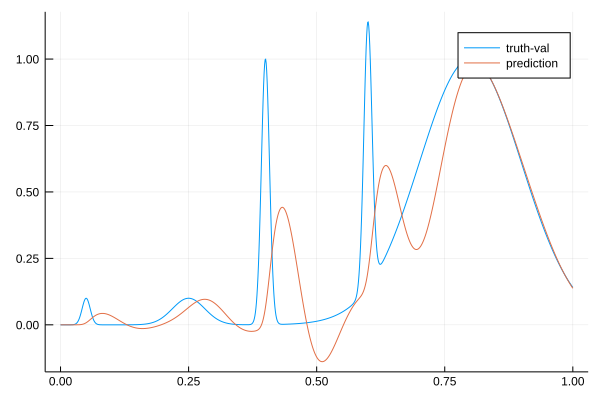

110.7760747404963 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  33.734757927031886
  40.535301701394246
  -4.36167162365505 
  44.31252281633503 
 -27.950714963665348
   0.1              

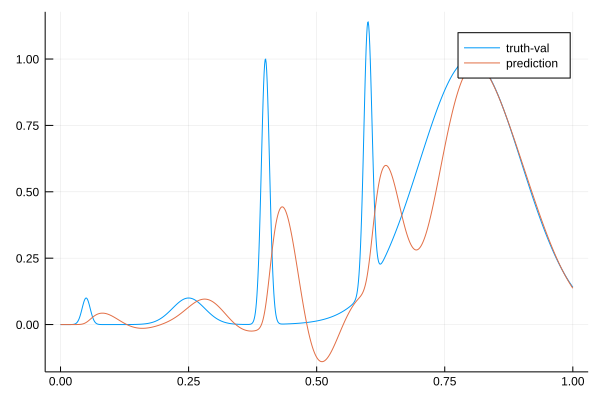

110.53678228035078 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  33.903732213448265
  40.64477701237898 
  -4.485598872928311
  44.449437372460686
 -27.95150279004085 
   0.1              

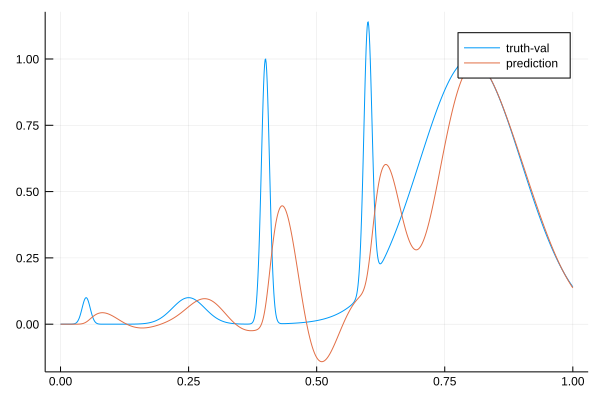

110.33116972020757 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  33.94783169422159  
  40.77649428854696  
  -4.5969243031976825
  44.5920196601718   
 -27.948122831387465 
   0.1               

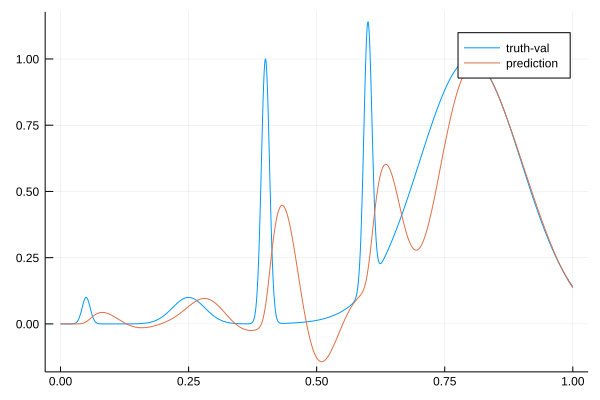

110.14662507235909 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.09883241172546 
  40.8772992119756  
  -4.721931392469923
  44.72622331473738 
 -27.95085938895013 
   0.1              

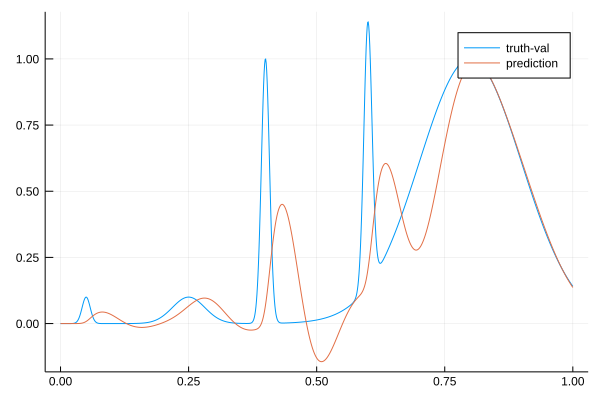

109.96664909845185 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.110991803919006
  41.010546038174546
  -4.827622208701877
  44.8685351179061  
 -27.94847851077919 
   0.1              

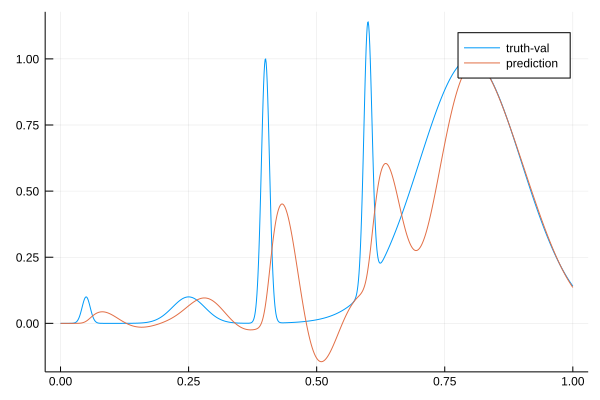

109.73167745417435 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.2397135050434  
  41.09960313456567 
  -4.951917155206265
  44.99870120608161 
 -27.956512427683197
   0.1              

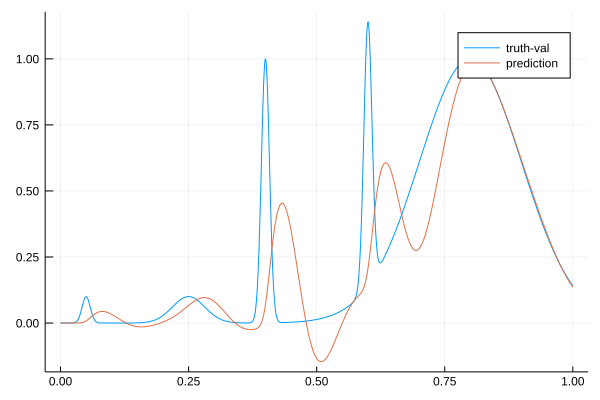

109.62603313714477 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.2608876784798  
  41.22291204967797 
  -5.055724898940749
  45.1377399762738  
 -27.958691289330726
   0.1              

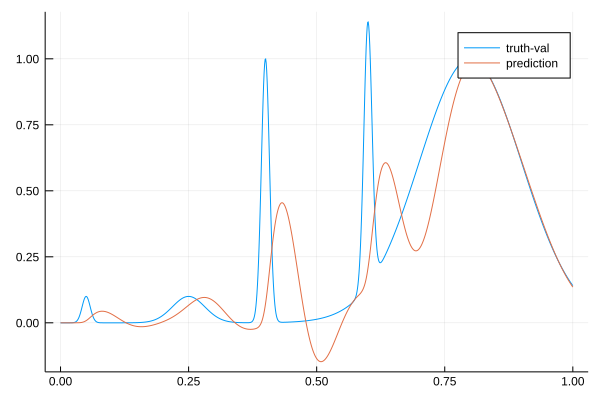

109.41420014911365 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.3838190776251  
  41.297529738593795
  -5.179753151849148
  45.262175728207744
 -27.97420537686041 
   0.1              

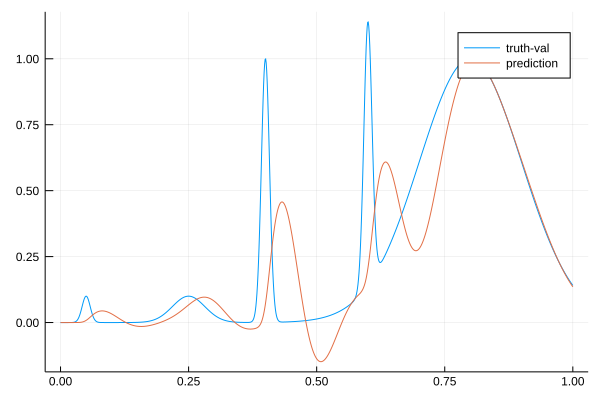

109.27001359843531 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.44095851860275 
  41.39561107511395 
  -5.287233061936387
  45.39049397121525 
 -27.990465613716754
   0.1              

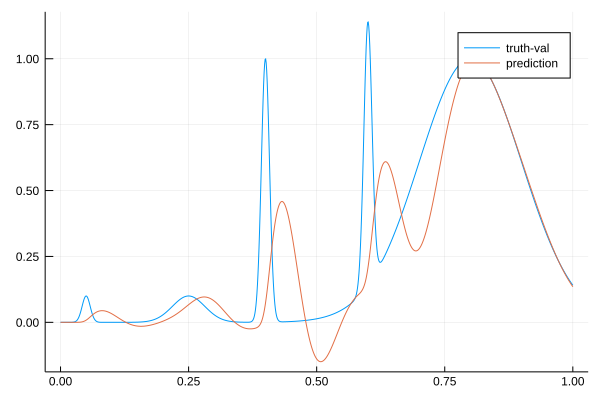

109.15274938683213 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.47560666066955 
  41.49985948109409 
  -5.386707249315488
  45.51765962121886 
 -28.01211080681745 
   0.1              

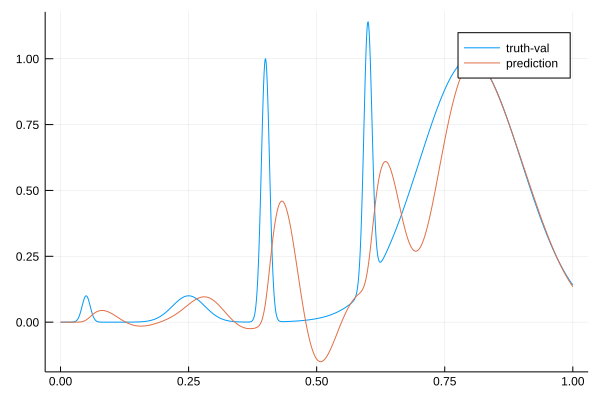

109.0221860536406 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.54680717884457 
  41.58398616474388 
  -5.491215427935765
  45.636386054333606
 -28.04524904666646 
   0.1              

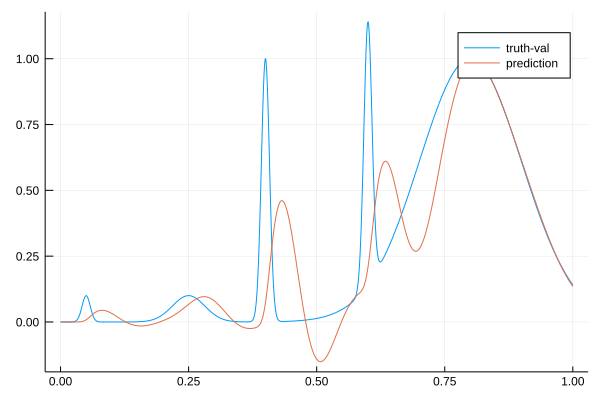

108.90985721087876 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.62348572988249 
  41.6623097158125  
  -5.593349958840957
  45.750702767979234
 -28.0873599107706  
   0.1              

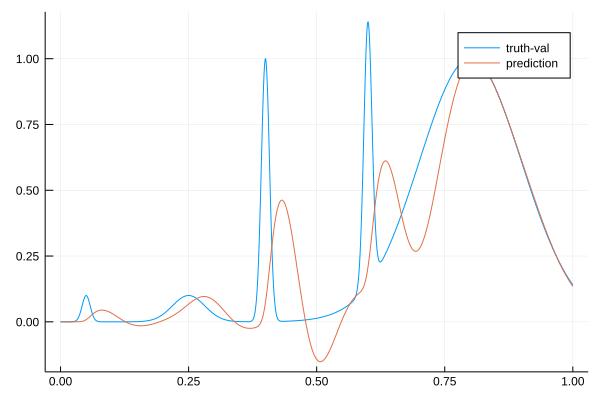

108.78929193036794 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.66855191074784 
  41.750960403031186
  -5.685089016127769
  45.86505492386388 
 -28.134544502380148
   0.1              

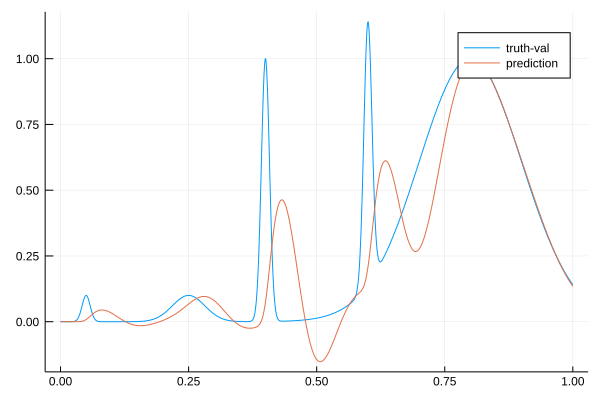

108.68007667352627 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.700437753315185
  41.842128609978786
  -5.770534128240107
  45.97734989135829 
 -28.188415961112508
   0.1              

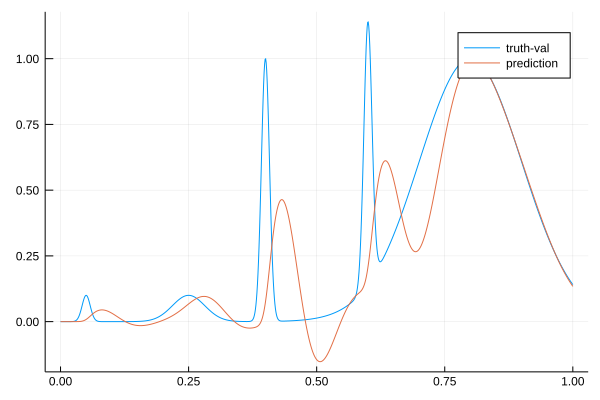

108.56588583234206 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.75380483083802 
  41.92034836203196 
  -5.857343370928069
  46.08337025647933 
 -28.252071590788887
   0.1              

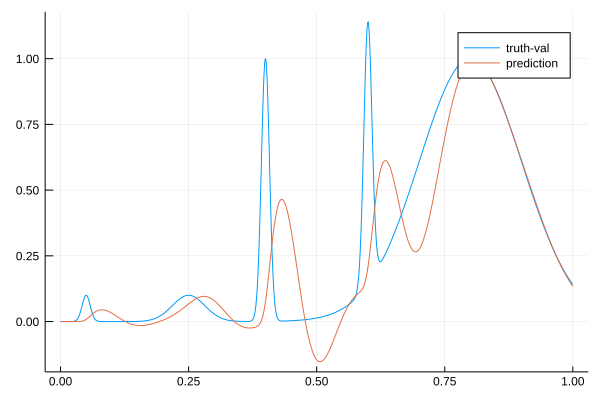

108.4548884937733 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.81843498072197 
  41.990179830935084
  -5.943442132848622
  46.184330922620454
 -28.324136428303458
   0.1              

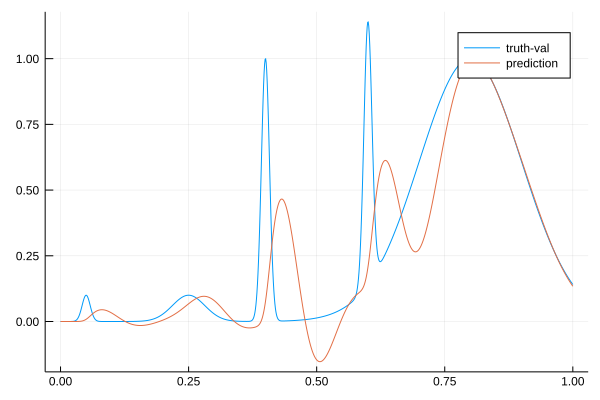

108.34388544662546 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.863937630898626
  42.06551180458127 
  -6.022240701420821
  46.28430794266549 
 -28.400858779136495
   0.1              

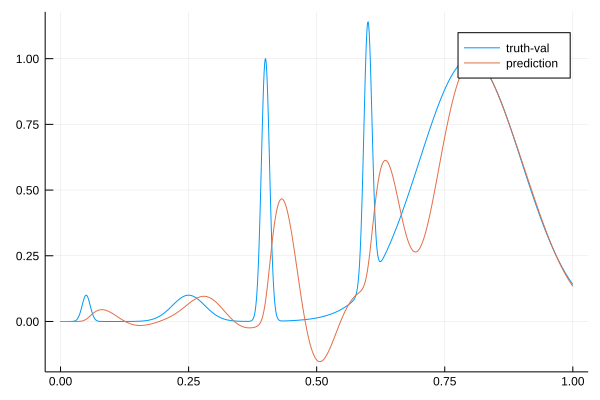

108.22923495810421 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.886727157447545
  42.148016024059764
  -6.093346969996298
  46.38388108927041 
 -28.481029904790372
   0.1              

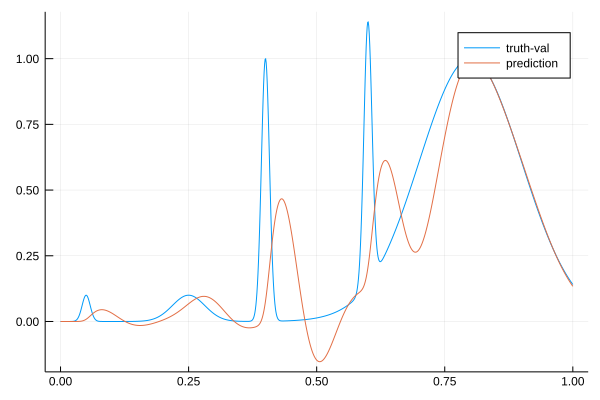

108.11983746264661 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  34.92012938021936 
  42.22324193472269 
  -6.164202633986666
  46.479328278011586
 -28.567620613349934
   0.1              

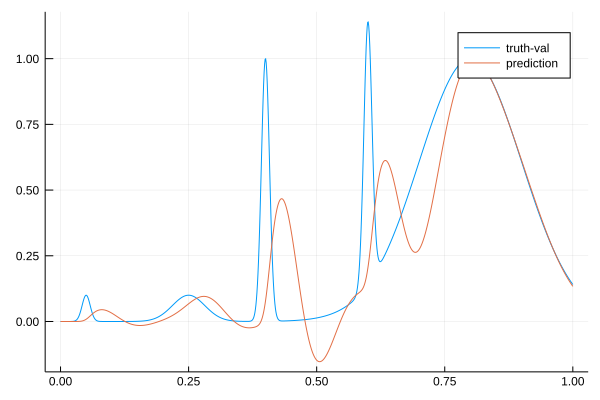

108.00582295897975 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0               
   0.001             
   0.001             
  34.97328123924241  
  42.28715623606244  
  -6.2373494813511785
  46.569725019899074 
 -28.66073797263777  
   0.1               

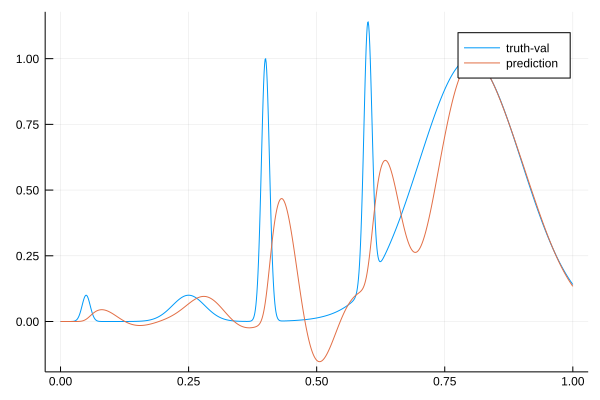

107.89967809987824 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.01496877642462 
  42.35352354413789 
  -6.306247493916477
  46.65852997444281 
 -28.75665352126216 
   0.1              

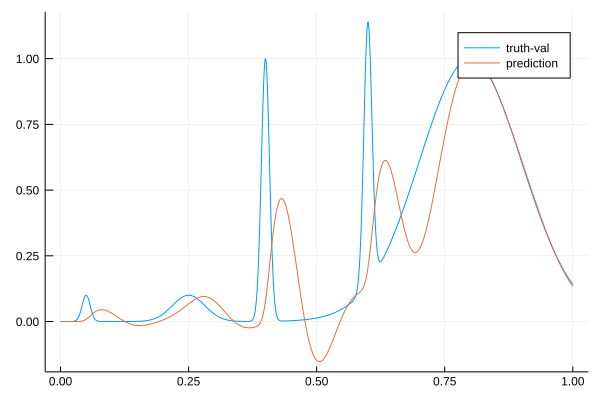

107.79093462767744 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.031987482609054
  42.428446615040635
  -6.368078689196029
  46.747683423766404
 -28.85341366801503 
   0.1              

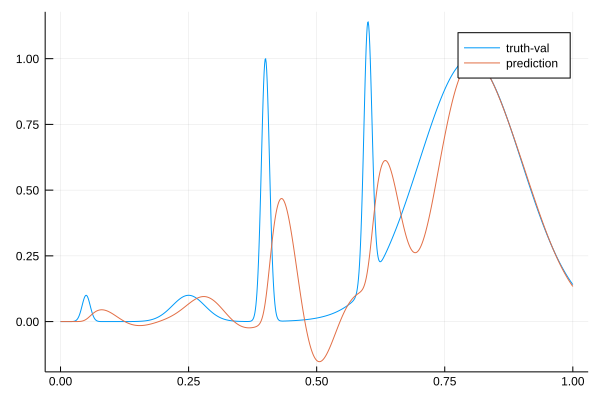

107.68721124144115 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.0626973870158  
  42.49497388596887 
  -6.431898643464768
  46.83267618137723 
 -28.953653580759546
   0.1              

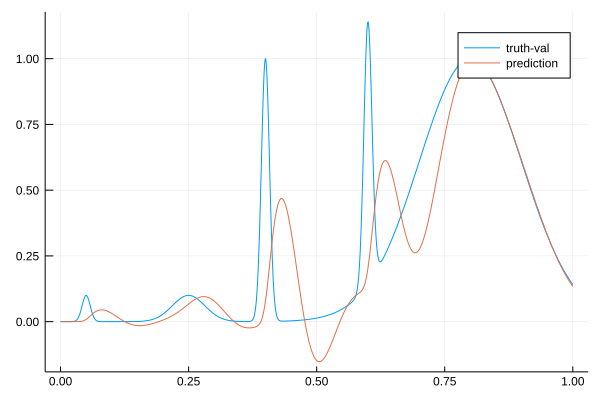

107.58524451937332 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.10330377498139 
  42.554773797176395
  -6.497136265718497
  46.91393744244221 
 -29.05667956842112 
   0.1              

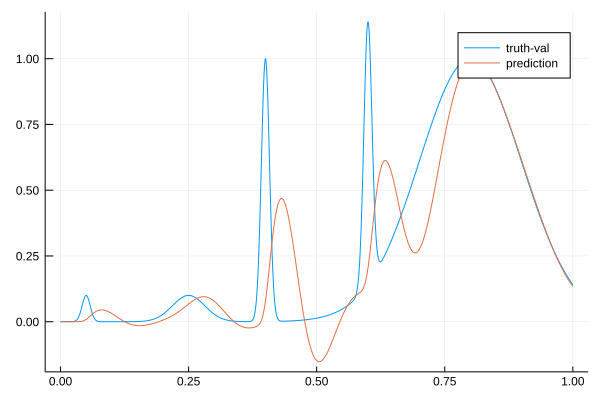

107.48680775985827 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.13063464143038 
  42.6187833101585  
  -6.558718825034499
  46.99486920673706 
 -29.158946987341736
   0.1              

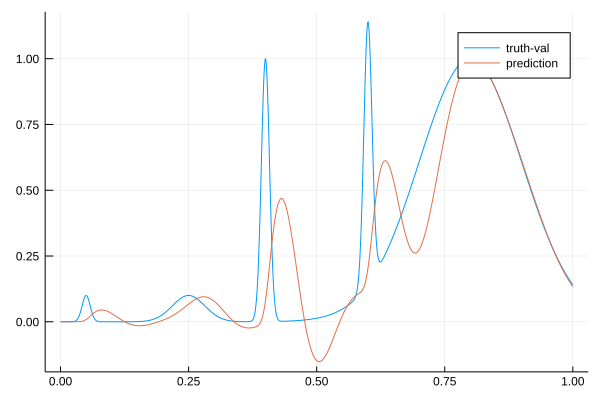

107.39238438537434 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.14917444545921 
  42.685224725593464
  -6.617712025421821
  47.07517675718876 
 -29.260055321641797
   0.1              

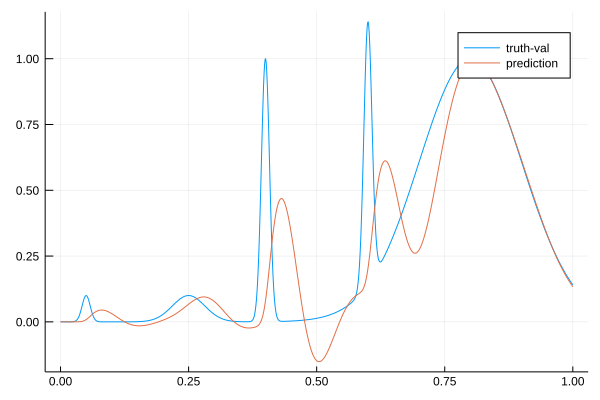

107.29964556740832 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.18000588993895 
  42.74473156582043 
  -6.67944108842644 
  47.15241504170786 
 -29.361512344098372
   0.1              

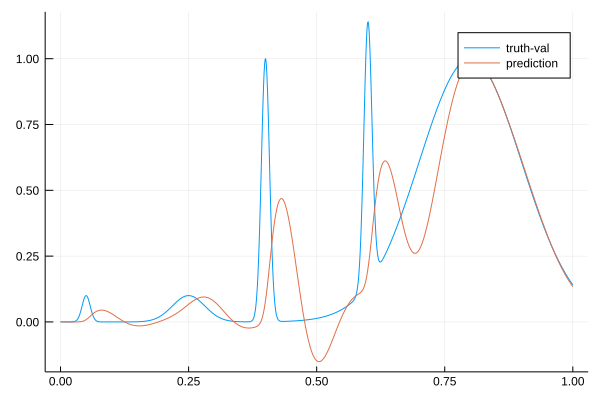

107.21252797613826 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.20894523157436 
  42.80410426972119 
  -6.740531905057903
  47.2287548523488  
 -29.461242753849977
   0.1              

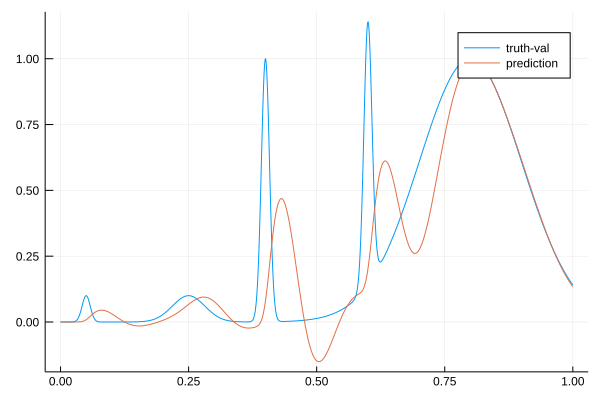

107.13311153063954 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.21882855441156 
  42.87107896743533 
  -6.797025698986954
  47.30640437486837 
 -29.557066755340138
   0.1              

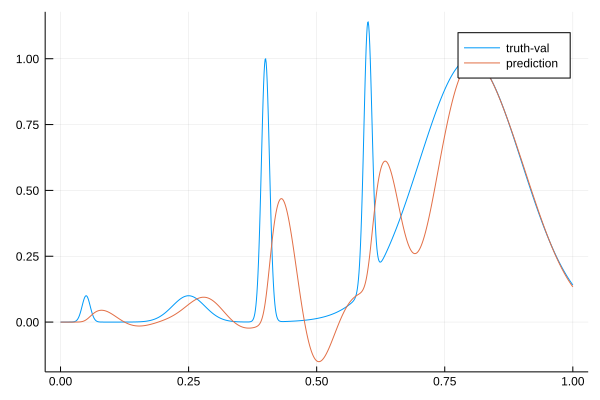

107.0746343760972 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.27053018061707 
  42.91745488772612 
  -6.864319907549592
  47.3774697539126  
 -29.65491316217553 
   0.1              

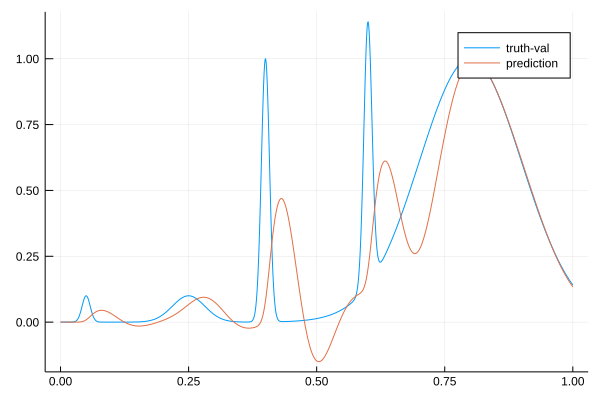

107.0419543759713 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.24381849972905 
  42.99949995400591 
  -6.911638773923532
  47.458776654479664
 -29.740184174004522
   0.1              

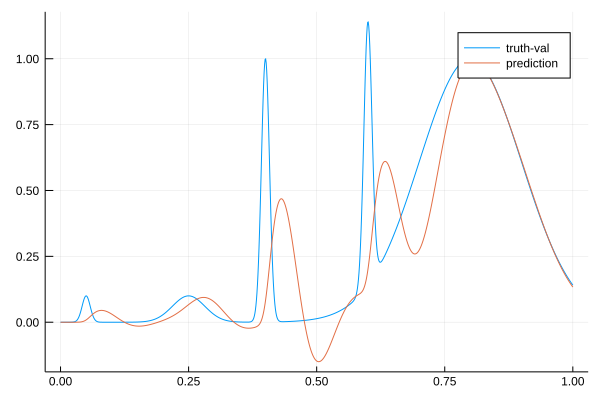

106.90707693173898 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.30745764198501 
  43.03415107710411 
  -6.984178146482786
  47.52613671670802 
 -29.832825927896952
   0.1              

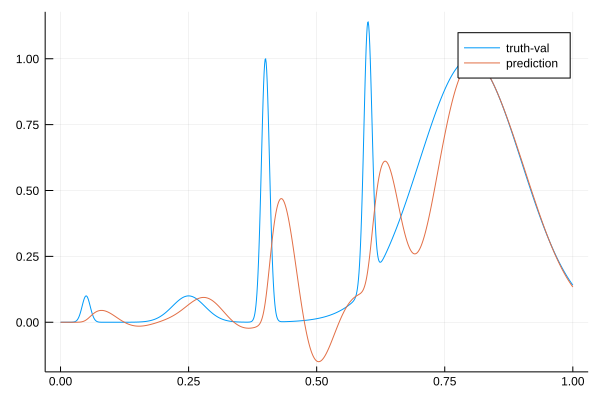

106.82445989950725 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.31001246187652 
  43.09999115929167 
  -7.039069745497326
  47.60303463572342 
 -29.913526335787033
   0.1              

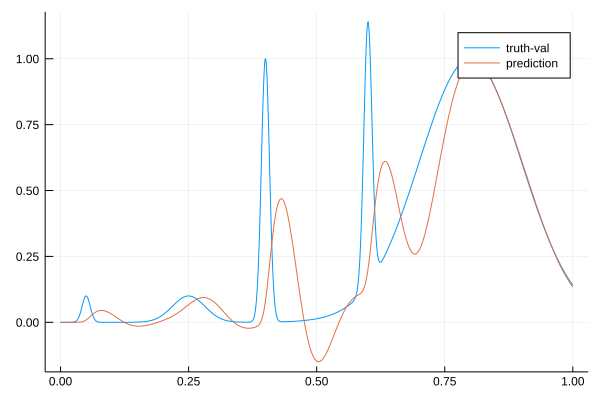

106.83165830321302 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.37357028135912 
  43.13086143376985 
  -7.113923578432951
  47.668677720785226
 -29.99833352686969 
   0.1              

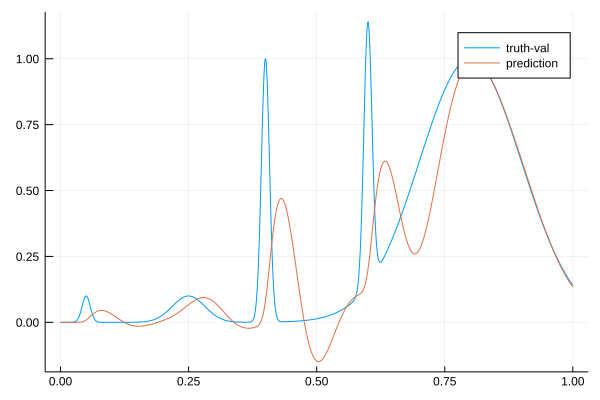

106.70166636216916 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.369287183096866
  43.19731861002454 
  -7.167252573488556
  47.74467047887267 
 -30.07195440063279 
   0.1              

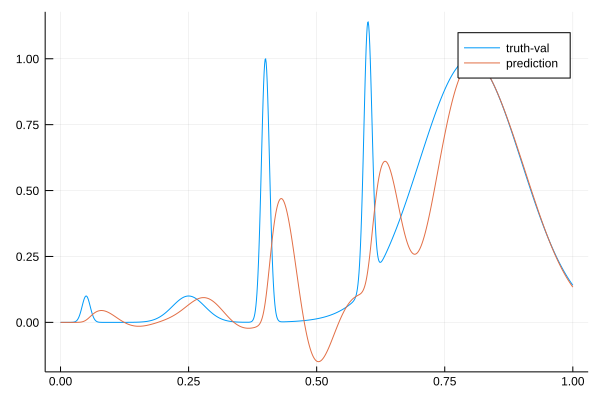

106.78260266228094 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.3241071807922  
  43.286422359617944
  -7.206802552107293
  47.827773588841964
 -30.135958797386017
   0.1              

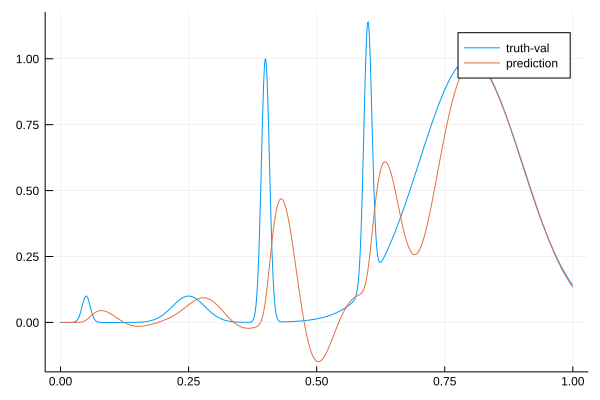

106.6278056456617 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.36638943539512 
  43.323619499749725
  -7.273288314879194
  47.89491037816402 
 -30.211789723375418
   0.1              

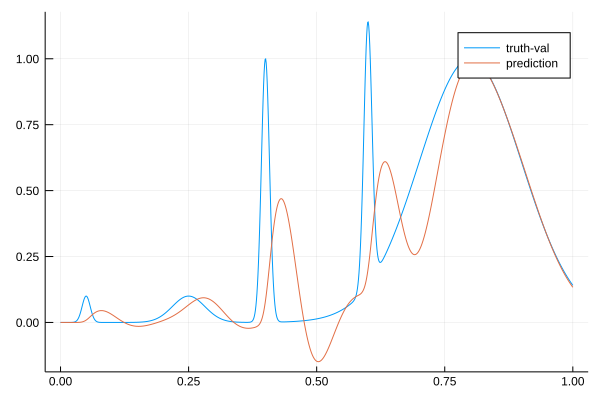

106.63070442769823 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.46691064232178 
  43.32273456128282 
  -7.36067154501343 
  47.94950393972095 
 -30.295189841268417
   0.1              

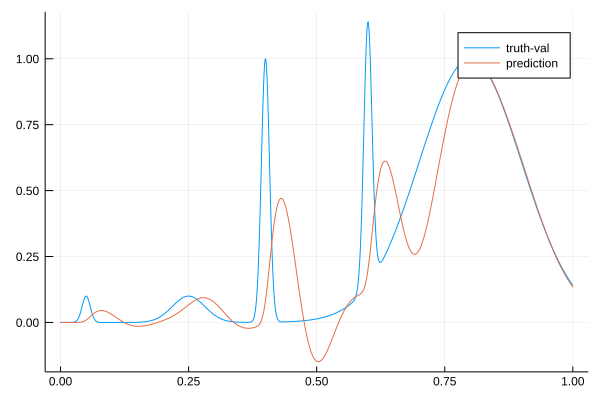

106.62548566137087 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.50134347722542 
  43.360766567577876
  -7.423571463756697
  48.01594194103829 
 -30.367429383761895
   0.1              

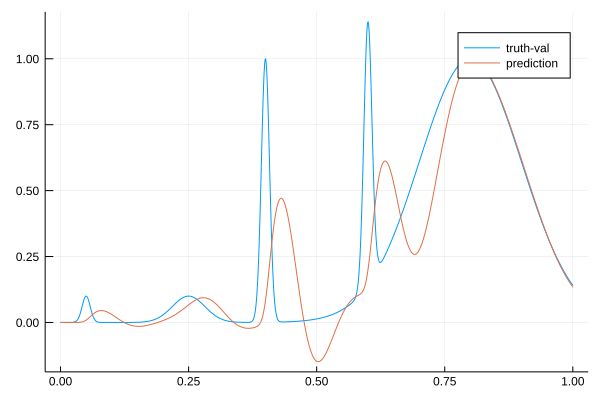

106.43421147386668 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.47696225248346 
  43.43429332399932 
  -7.463515335960341
  48.093418393141235
 -30.429367221933855
   0.1              

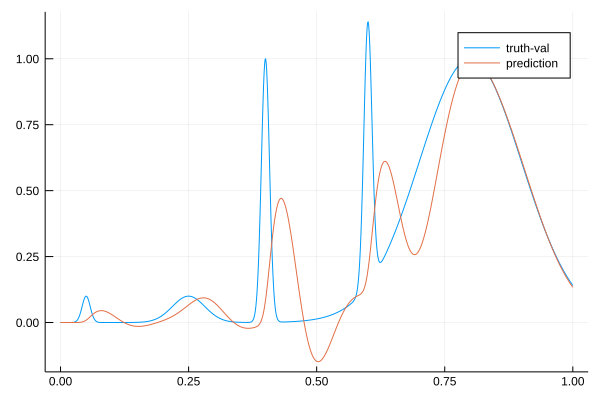

106.47479407639494 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.416832019509805
  43.530392922860266
  -7.488383492796307
  48.17857312134019 
 -30.48261844229194 
   0.1              

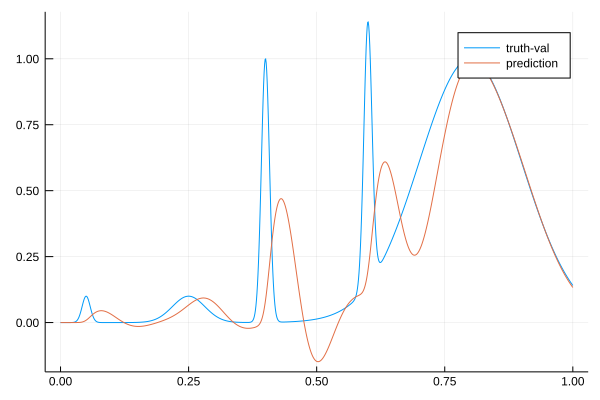

106.43066938458853 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.43125940965729 
  43.577895787747984
  -7.540093710872772
  48.247997548076114
 -30.54813697115952 
   0.1              

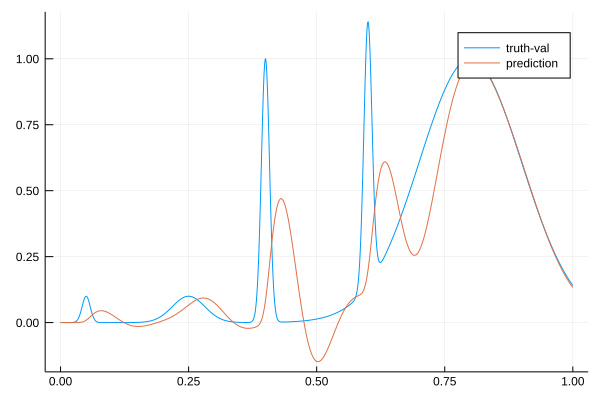

106.22419480266159 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.507440307833456
  43.58229525433927 
  -7.615544390102224
  48.30292201110982 
 -30.62495266062632 
   0.1              

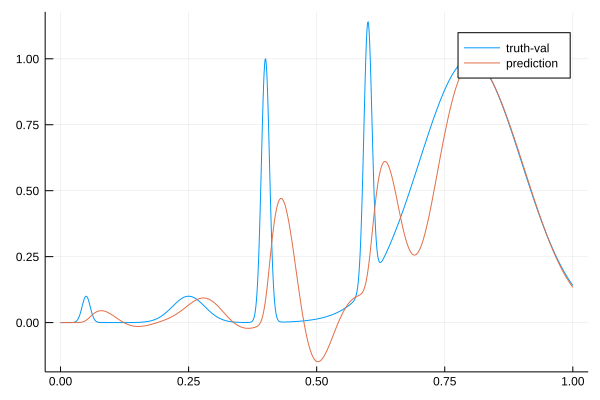

106.24095947678948 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.55579581351468 
  43.60581815181148 
  -7.678855132684219
  48.364724102610175
 -30.69287776430503 
   0.1              

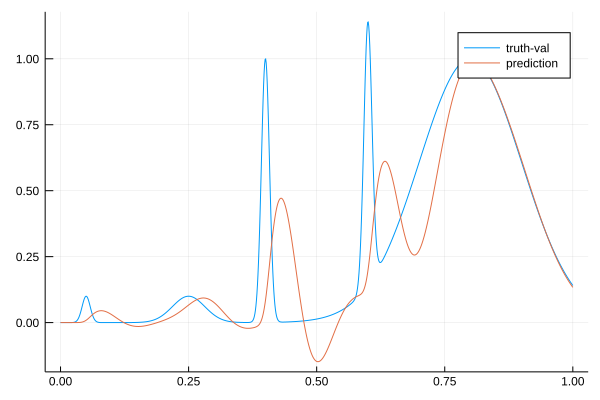

106.15899707645634 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.56339585917841 
  43.656601129585404
  -7.723960040723166
  48.435885987339375
 -30.75150748272625 
   0.1              

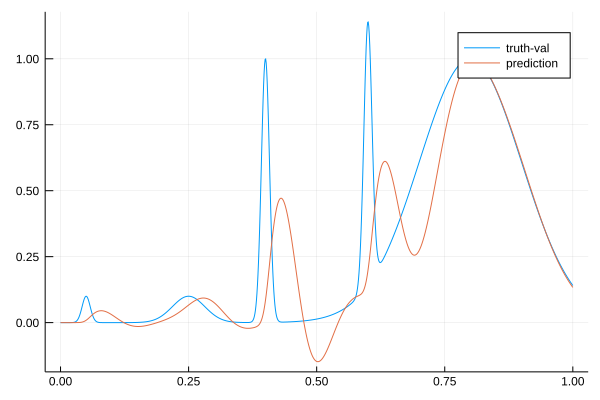

106.0889991669655 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.539468979769886
  43.72879236394203 
  -7.754517534502809
  48.51467538989402 
 -30.801997226981964
   0.1              

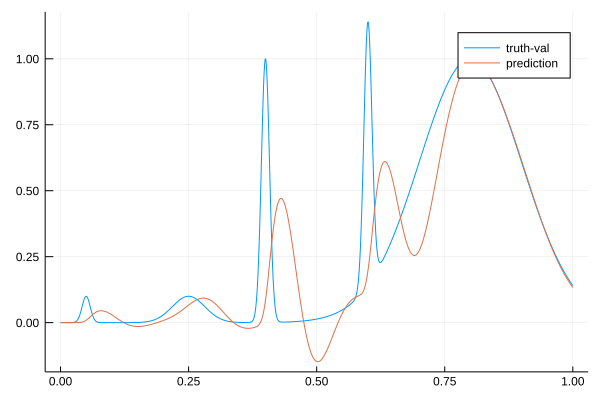

106.04837032212892 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.5555566969869  
  43.77280718370547 
  -7.802366160579796
  48.58335190653327 
 -30.857695609116437
   0.1              

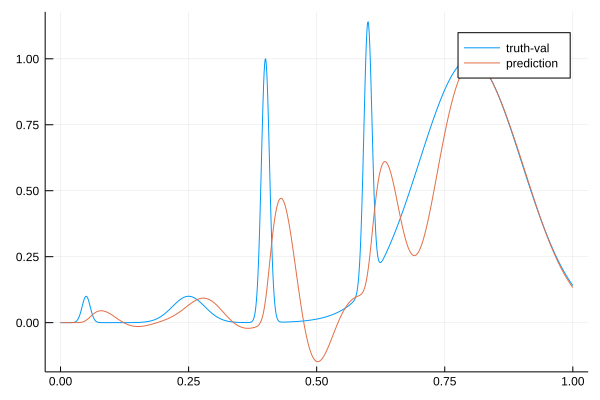

105.9911001635519 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.60813755311099 
  43.79031663383791 
  -7.866308011756387
  48.642225560262254
 -30.918752963244845
   0.1              

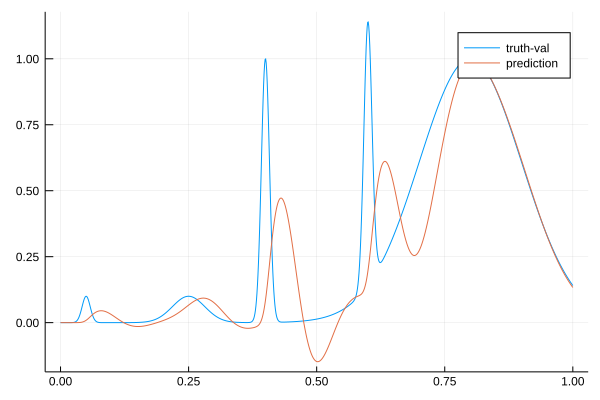

105.9627003561392 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.63522230680398 
  43.82544880230984 
  -7.917840879672527
  48.70724072703678 
 -30.972554875133874
   0.1              

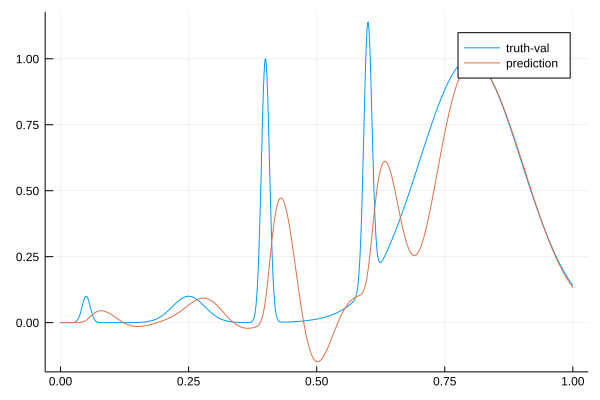

105.88640237664711 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.6341024083122  
  43.87995874085689 
  -7.955501342539083
  48.77898402827054 
 -31.01928530922497 
   0.1              

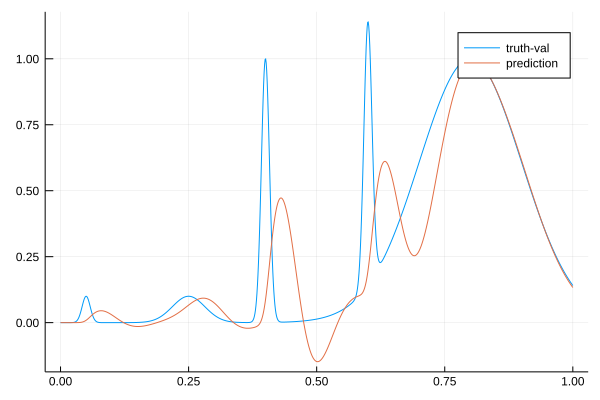

105.88702785408276 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.62506240903639 
  43.940149606479594
  -7.988732857909555
  48.85289951154837 
 -31.06167914045954 
   0.1              

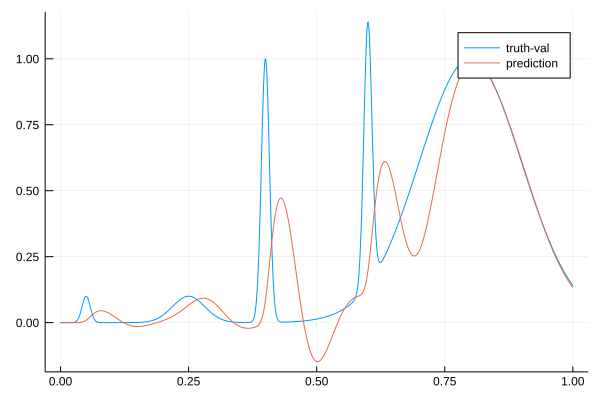

105.80822178153691 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.65785470662461 
  43.970156793717834
  -8.040230680611764
  48.91585398402914 
 -31.11175804095725 
   0.1              

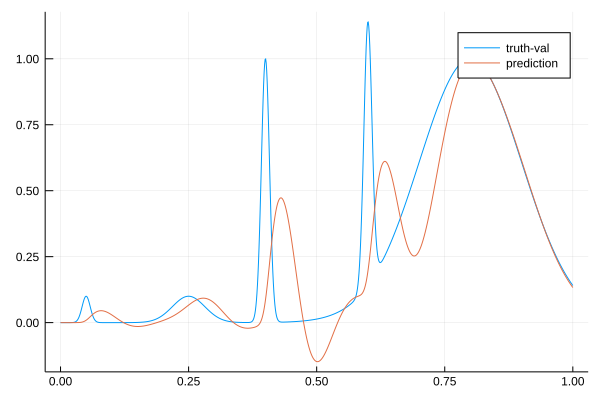

105.79066251193896 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.712303788931656
  43.9842599657837  
  -8.10141636579021 
  48.972864081190444
 -31.16438626281431 
   0.1              

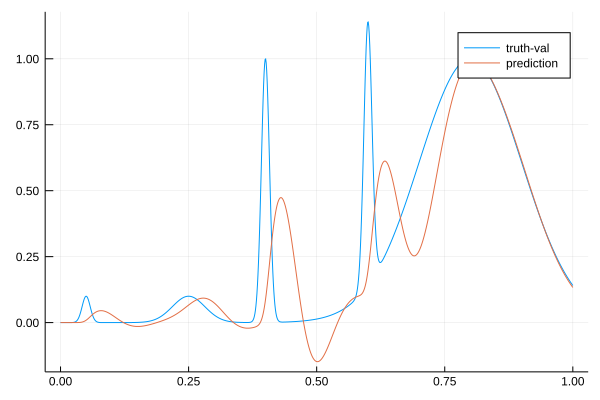

105.76174766646857 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.737545207850225
  44.01878850243004 
  -8.14788242833123 
  49.037009816595656
 -31.21032167351882 
   0.1              

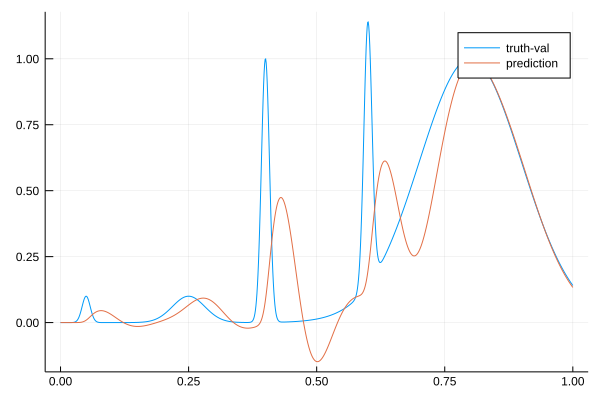

105.68171919107807 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.735007514956635
  44.07273683105021 
  -8.18020422637705 
  49.10798169158627 
 -31.250016064733753
   0.1              

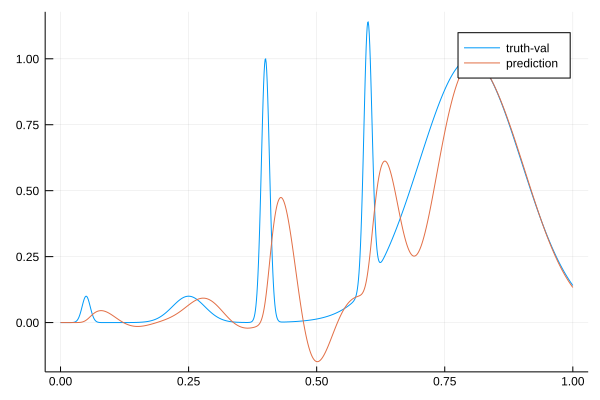

105.68359743021247 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.72274451172132 
  44.1337698983292  
  -8.207001312513357
  49.18169332727871 
 -31.285841446422037
   0.1              

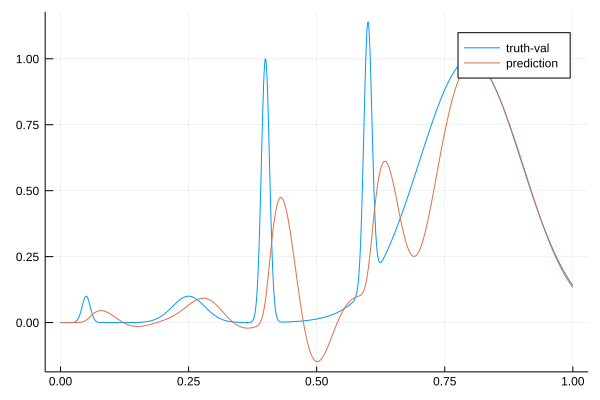

105.61990792574878 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.75183026516196 
  44.164655617636384
  -8.25217190547779 
  49.2444254900393  
 -31.330255062104268
   0.1              

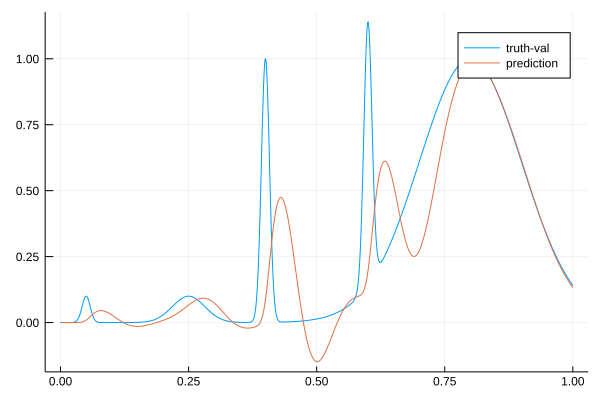

105.58212782465093 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.80845327644346 
  44.17502029627122 
  -8.309881499078418
  49.29947249052561 
 -31.379790819701622
   0.1              

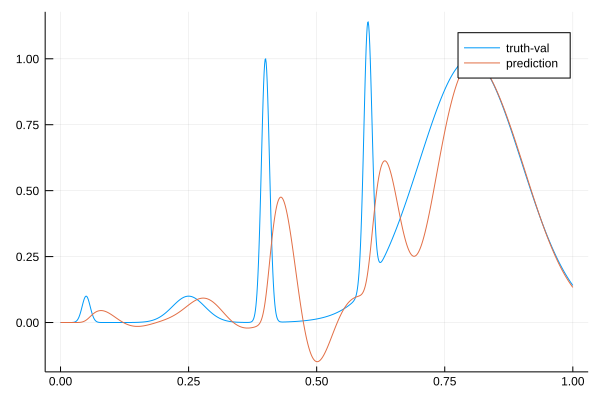

105.57092550320063 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.841688903699236
  44.202278220054346
  -8.355186682161799
  49.36068168384951 
 -31.423591485454924
   0.1              

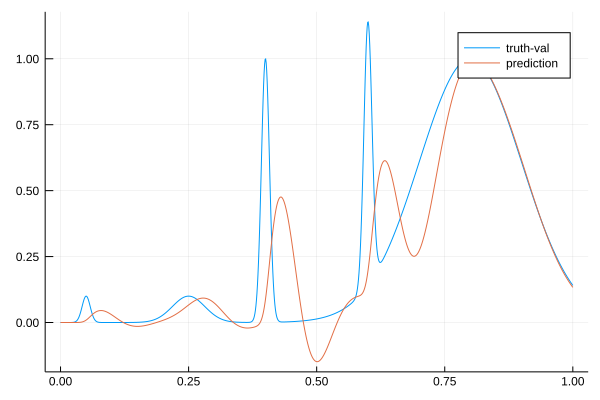

105.50219361080251 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.84658072085349 
  44.24973023247449 
  -8.385732560611897
  49.42909889680158 
 -31.461392568900596
   0.1              

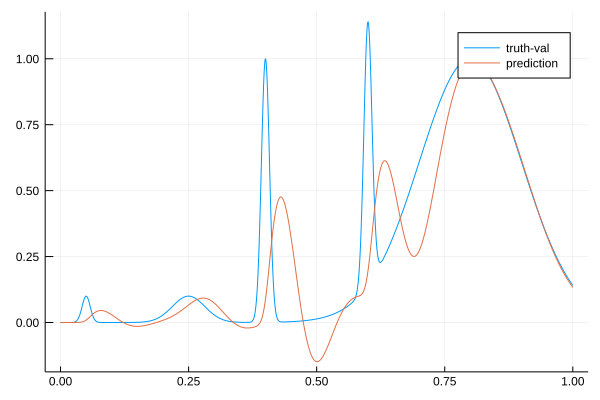

105.47204299279531 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.83584206463324 
  44.308254478126024
  -8.407602408607834
  49.501376197654665
 -31.49506842753903 
   0.1              

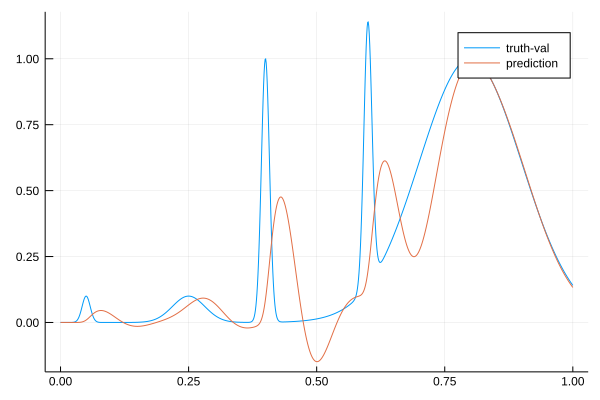

105.44370904348743 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.85420324981646 
  44.345078197192464
  -8.443141692025   
  49.565341282121   
 -31.53444864068807 
   0.1              

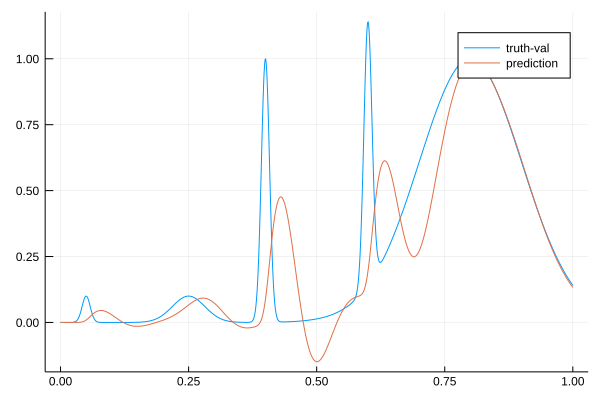

105.38744945914127 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.900348756754525
  44.36075696889023 
  -8.491676503978898
  49.62102646961945 
 -31.57977864269427 
   0.1              

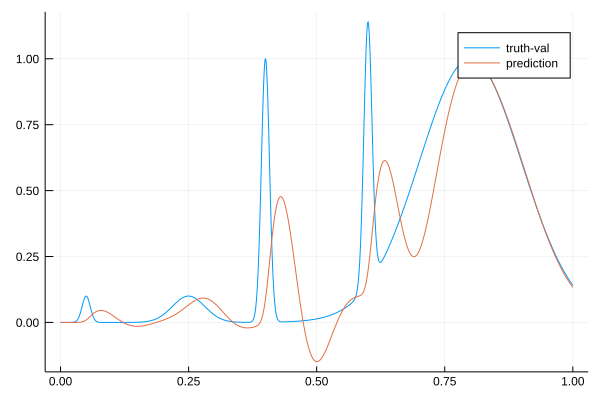

105.37345702463216 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.93588313740952 
  44.384089240892166
  -8.534295855961643
  49.679373995802685
 -31.621710599184542
   0.1              

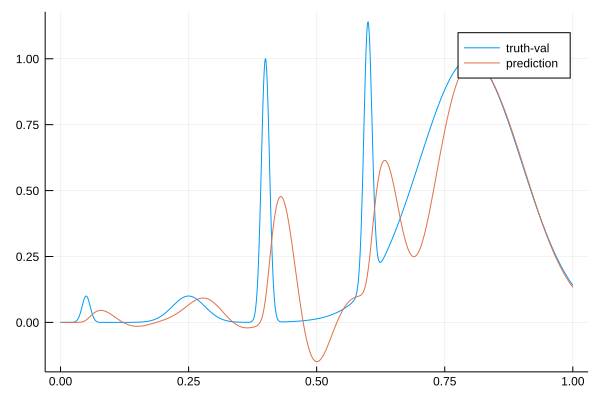

105.32933613649122 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.95019110876518 
  44.42270001712167 
  -8.565374690377592
  49.743140136603195
 -31.65889936853594 
   0.1              

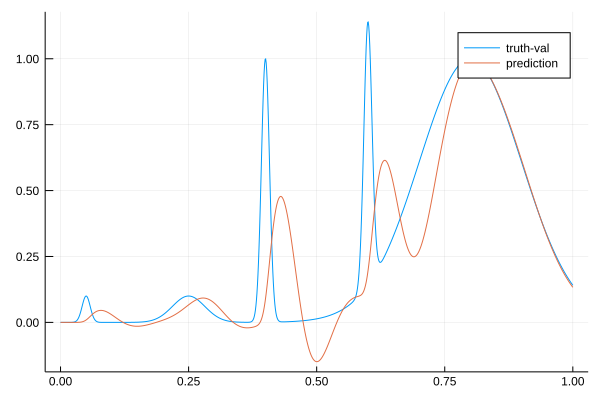

105.28896341122078 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.950505769306105
  44.47139313701898 
  -8.588776514089533
  49.81048306066548 
 -31.692444273559556
   0.1              

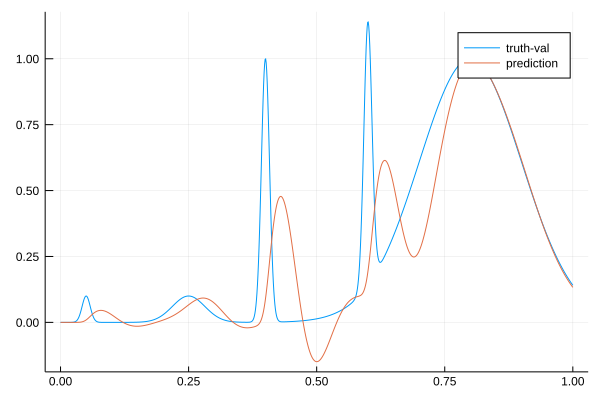

105.26897956652725 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.963759791959596
  44.51045590368307 
  -8.618187601561447
  49.87413680842586 
 -31.72782168495039 
   0.1              

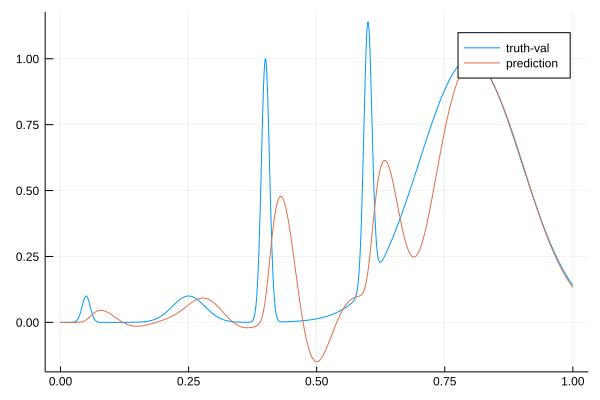

105.22252922490281 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  35.999861188276306
  44.53210270192413 
  -8.658488839910463
  49.93091648719193 
 -31.768202621864425
   0.1              

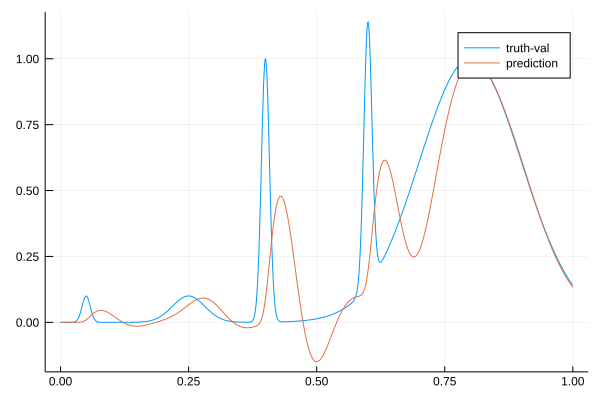

105.20049069223965 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.03414448487775 
  44.55497899585032 
  -8.697335375660124
  49.988004787156264
 -31.807354502505433
   0.1              

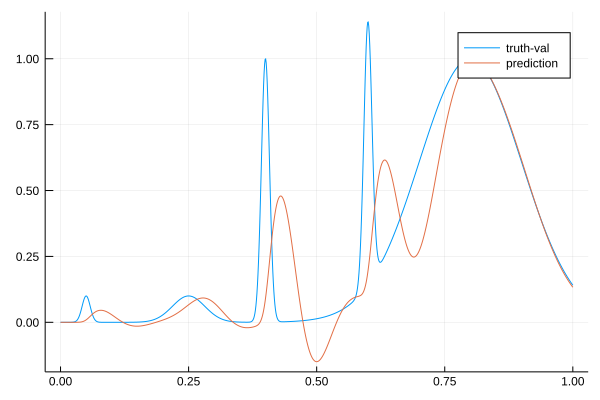

105.16758532442371 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.05368919681473 
  44.58860955216898 
  -8.727870648692766
  50.04896852915311 
 -31.84305332477997 
   0.1              

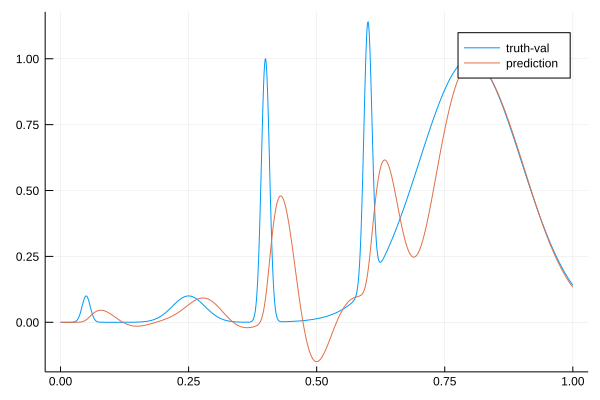

105.1317594626456 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.061668222520424
  44.63064669690785 
  -8.751840259443668
  50.112930615605606
 -31.875934751375386
   0.1              

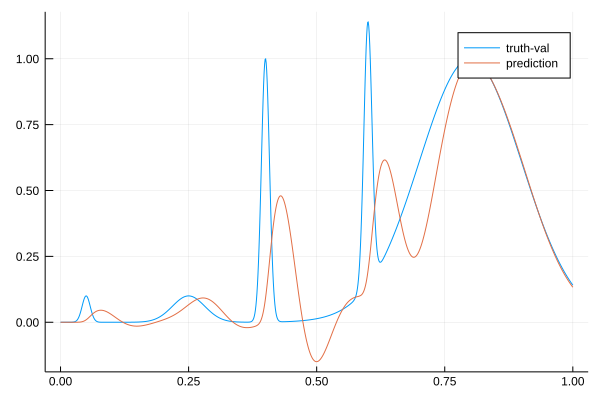

105.10805895690844 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.07611166859044 
  44.66783573701085 
  -8.778630637915972
  50.17498702125496 
 -31.909609873775562
   0.1              

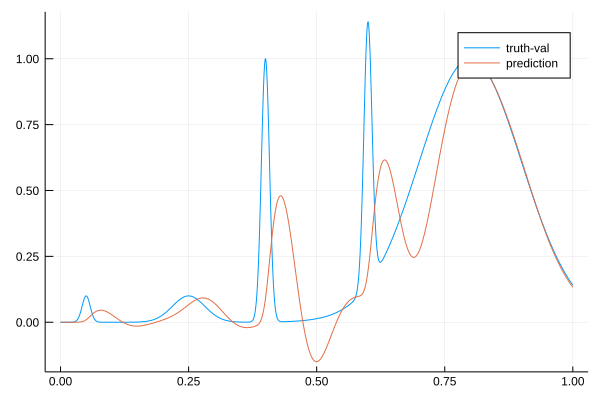

105.07139070554824 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.1063834776513  
  44.69312891914051 
  -8.81290720343253 
  50.23248265575161 
 -31.946576339470937
   0.1              

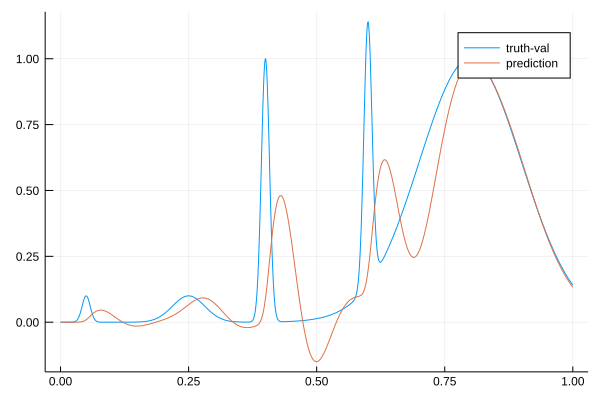

105.0458168142506 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.13929643946161 
  44.716224353262284
  -8.848206906475927
  50.288892150313366
 -31.983775659393242
   0.1              

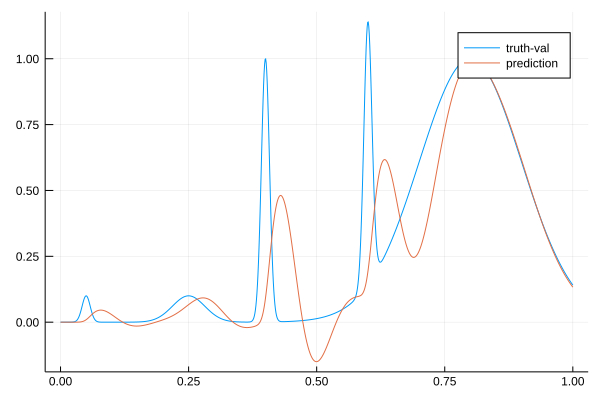

105.01728160497963 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.16160881285708 
  44.74701547010363 
  -8.877491916878393
  50.34799107882627 
 -32.01857316728496 
   0.1              

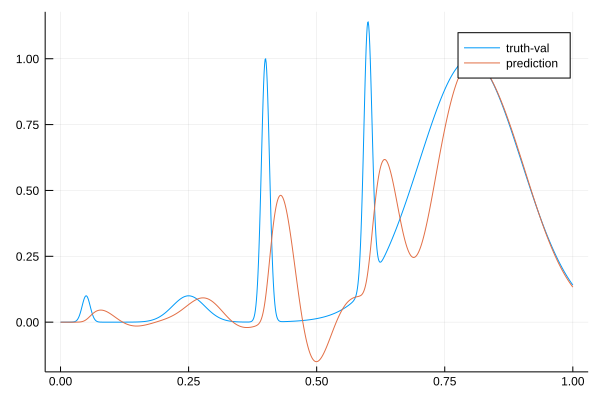

104.9863186809524 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.1744370154418  
  44.784340177022834
  -8.901457563203259
  50.40901941772382 
 -32.05139959850539 
   0.1              

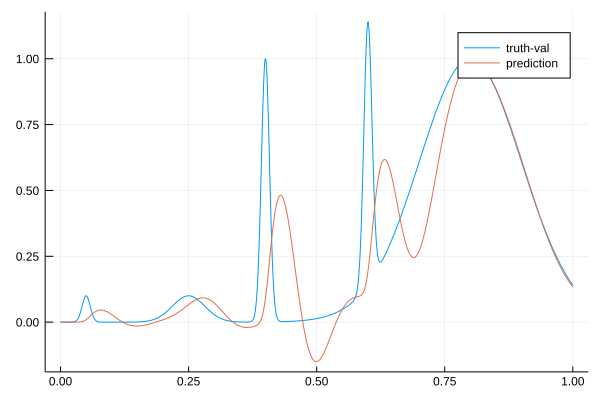

104.96284505971688 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.18913406985315 
  44.819905744623696
  -8.925936774131017
  50.46898156106773 
 -32.08451538850444 
   0.1              

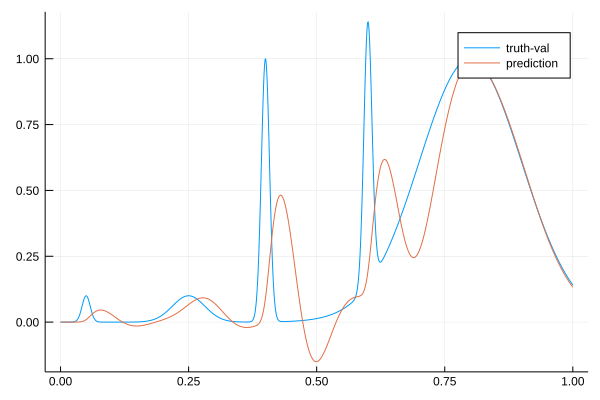

104.93391602318596 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.21353170484369 
  44.847839979882636
  -8.955134846858629
  50.525655384248886
 -32.11981740352636 
   0.1              

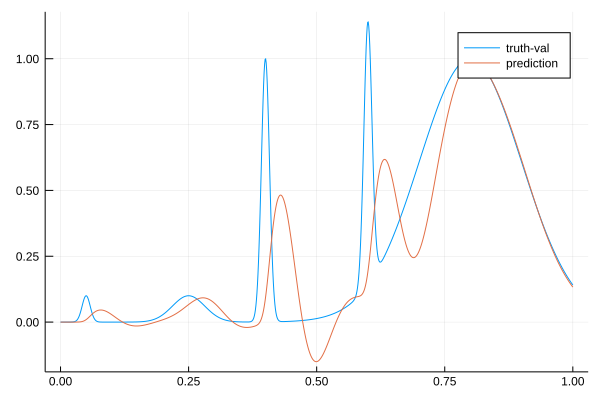

104.90684989410423 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.243520005820756
  44.871290408841034
  -8.986941070364876
  50.58030528453524 
 -32.156309857984766
   0.1              

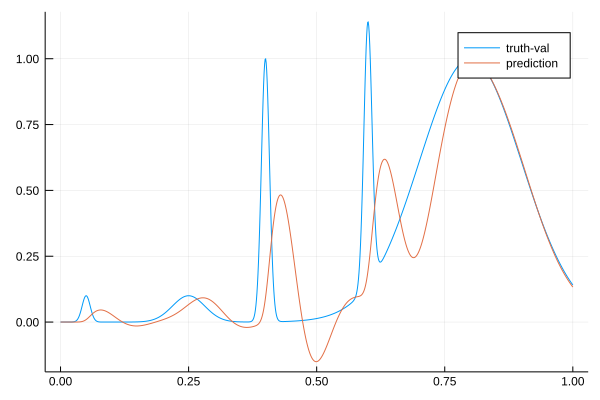

104.88332689347128 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.26882167547213 
  44.89779472315286 
  -9.015960667488722
  50.63563408391536 
 -32.19191895514225 
   0.1              

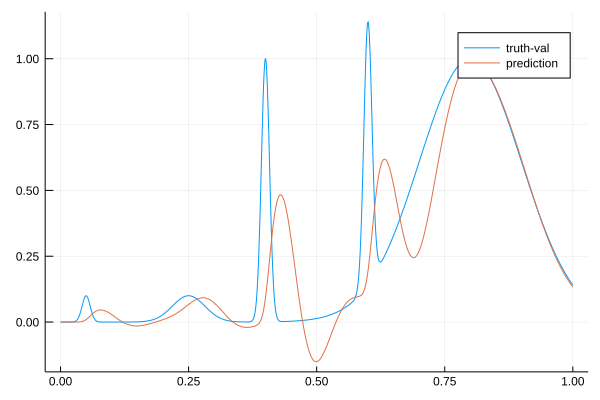

104.85616636992874 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.284988729474655
  44.93066420559621 
  -9.03983410018188 
  50.69290419724248 
 -32.22581966117975 
   0.1              

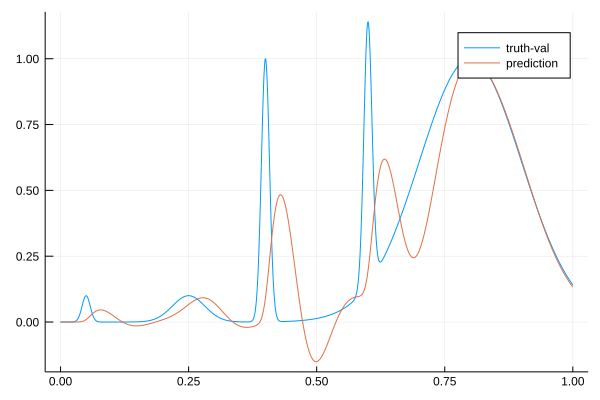

104.83283217635139 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.29851922752436 
  44.96504257870037 
  -9.062005295415256
  50.75025717727965 
 -32.25913887472253 
   0.1              

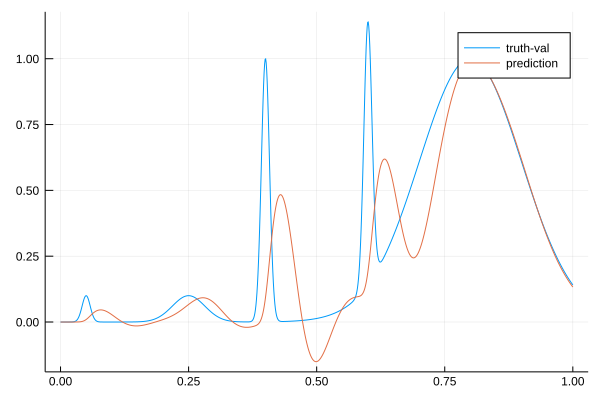

104.80902539363721 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.3183999490879  
  44.99431561358505 
  -9.087016462240712
  50.80529317691696 
 -32.29389241675642 
   0.1              

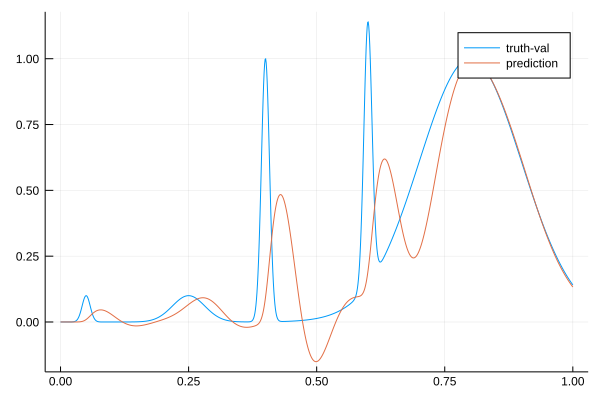

104.78277689833563 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.34562368490221 
  45.01776625689396 
  -9.1154557350361  
  50.857780526814246
 -32.33034775257197 
   0.1              

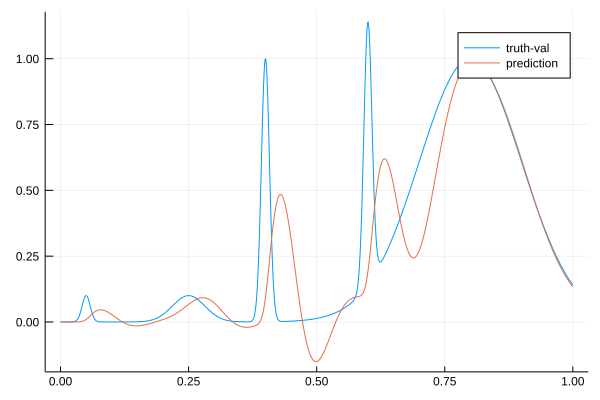

104.76016673039479 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.371414514683174
  45.04205358260353 
  -9.142700313544058
  50.91031715175014 
 -32.366477102201095
   0.1              

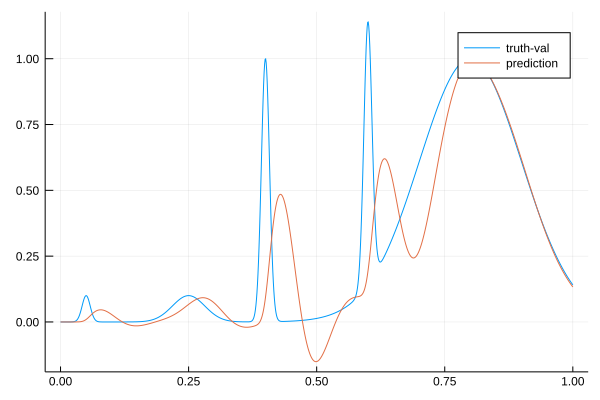

104.73598862060008 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.390417517249624
  45.07113440166132 
  -9.166216919609942
  50.96436334378651 
 -32.401177736088115
   0.1              

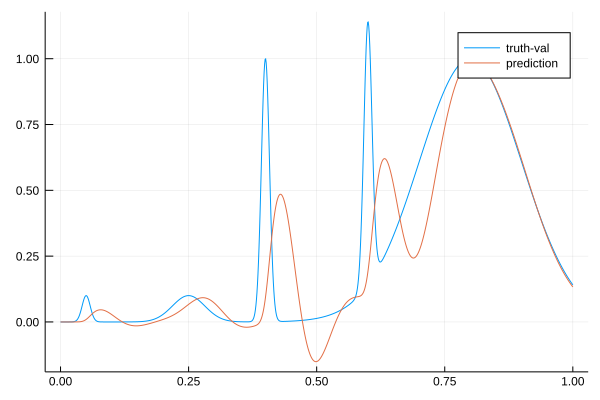

104.71217030374822 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.40550590166122 
  45.10275087570398 
  -9.187308882359297
  51.0189529654383  
 -32.435256279702934
   0.1              

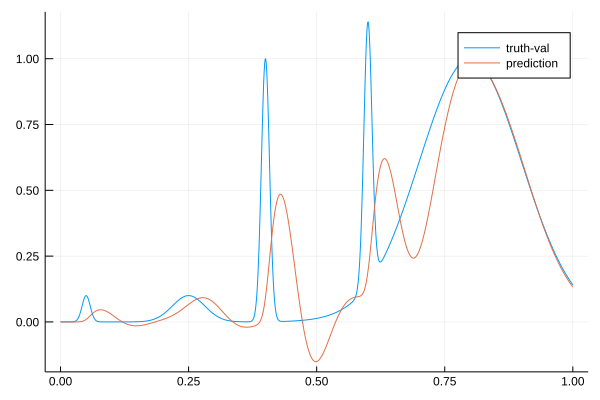

104.6902277900678 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.42210238483103 
  45.132929768725056
  -9.208892937548683
  51.07265876856526 
 -32.46962801552267 
   0.1              

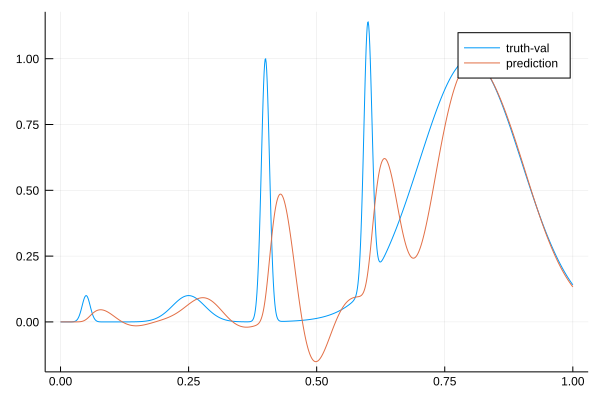

104.66688531997268 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.44333076159794 
  45.159358887113235
  -9.232672823530512
  51.124636522800095
 -32.505037917686124
   0.1              

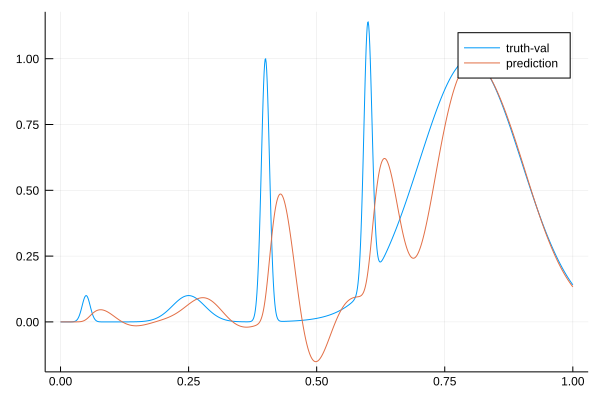

104.64353130484125 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.46713514287993 
  45.18362533629061 
  -9.257585281500408
  51.17553422025663 
 -32.54101733289617 
   0.1              

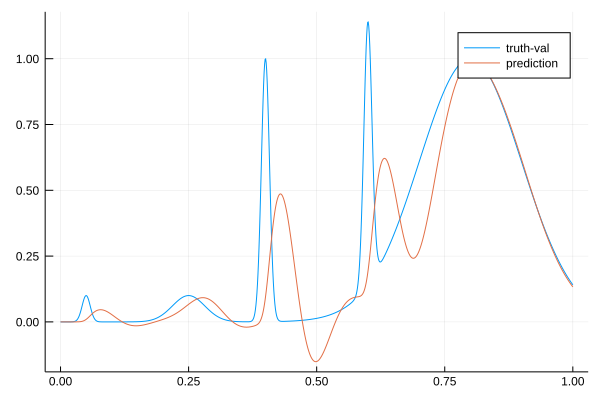

104.62108006841369 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.4900190290339  
  45.20839503262567 
  -9.281786849682343
  51.22640638952628 
 -32.57678151885441 
   0.1              

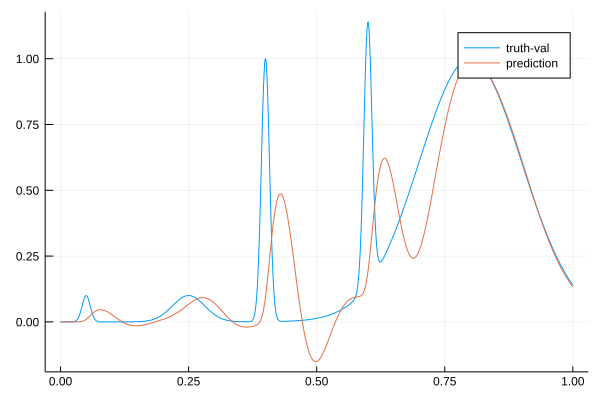

104.59835271682627 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.510450811756726
  45.23484884799804 
  -9.30447834066486 
  51.27773457627694 
 -32.612004136614836
   0.1              

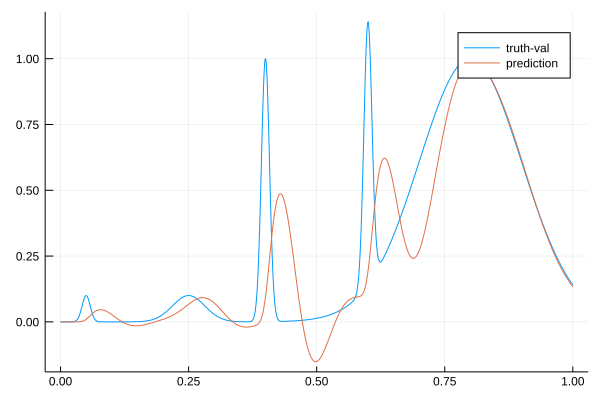

104.57557392891167 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.52704309072277 
  45.26404708996341 
  -9.324936854245726
  51.32994459277643 
 -32.646407518895465
   0.1              

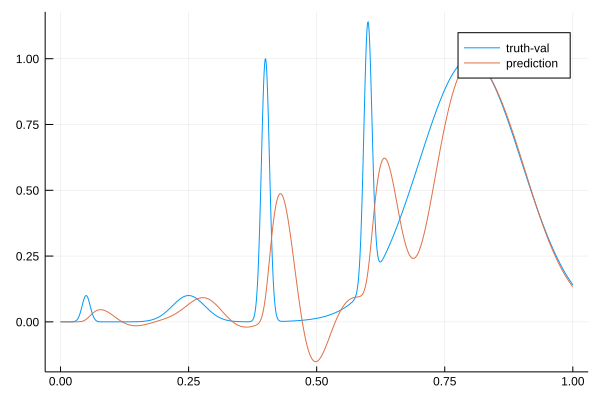

104.55483375927136 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.54344213673673 
  45.29301856069883 
  -9.345182418050388
  51.38167220915483 
 -32.681041451810515
   0.1              

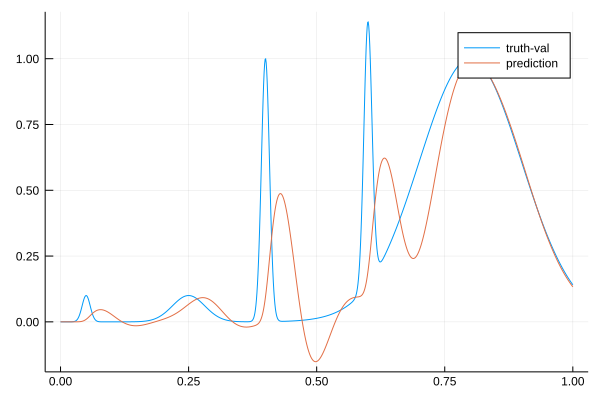

104.53395555490529 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.56359852303469 
  45.31855139928148 
  -9.367097378276089
  51.431458172001854
 -32.71700251101344 
   0.1              

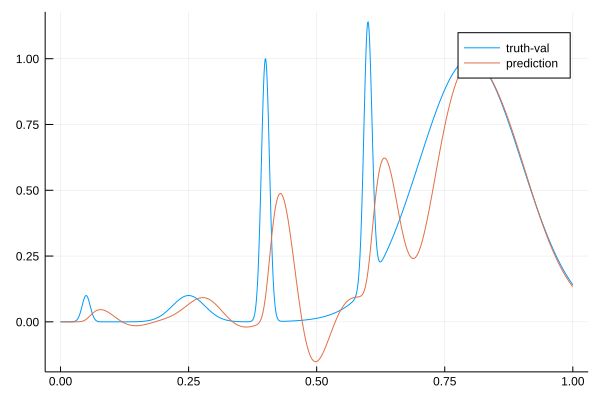

104.51320633263353 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.58552582122507 
  45.34221403700559 
  -9.389656279096116
  51.479974738737496
 -32.753795322813176
   0.1              

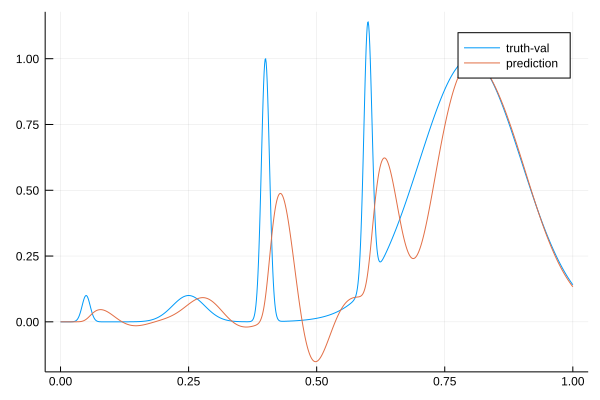

104.49326306204588 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.606825084908415
  45.365808318613645
  -9.411902756538678
  51.52790808341143 
 -32.79082964437253 
   0.1              

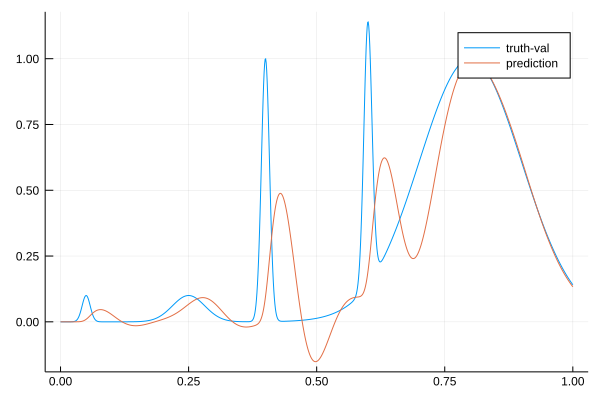

104.47286063414754 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.6242663178533  
  45.3918179862924  
  -9.432098006087028
  51.57626406934556 
 -32.82737605281091 
   0.1              

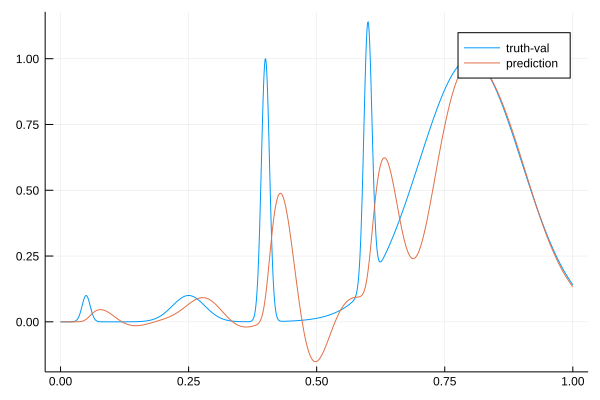

104.45248728734414 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.63990670459722 
  45.41876875867747 
  -9.451342353892308
  51.624549022873886
 -32.86384883192005 
   0.1              

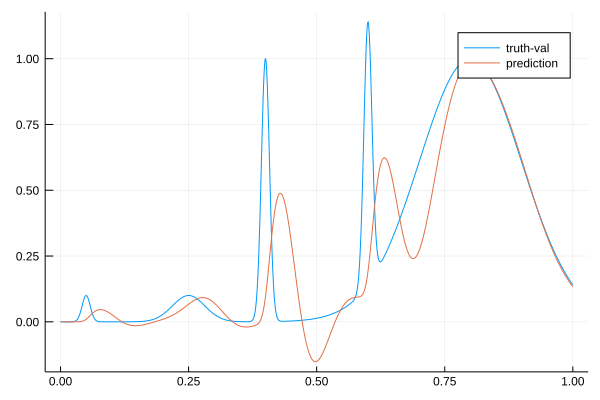

104.43254857030824 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.65619798610116 
  45.44491554478952 
  -9.470647006920972
  51.67219200050277 
 -32.900802157600936
   0.1              

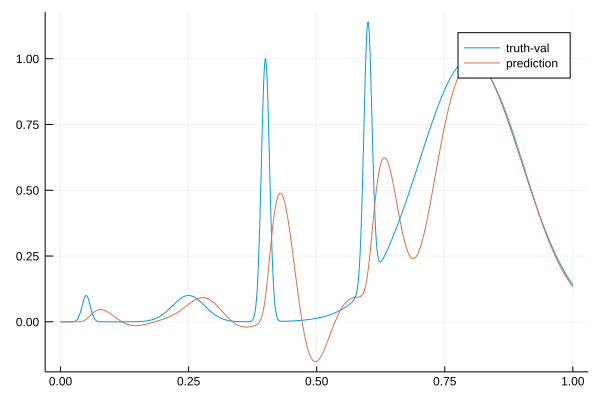

104.4130601368006 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.673093719927564
  45.47033796142707 
  -9.49001267252625 
  51.71926763997255 
 -32.93820758567164 
   0.1              

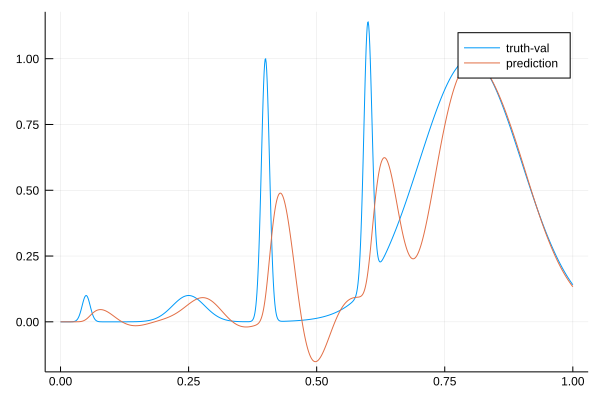

104.39349925702635 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.69214278030049 
  45.49368625455723 
  -9.510328862193145
  51.765083156821596
 -32.97660470333634 
   0.1              

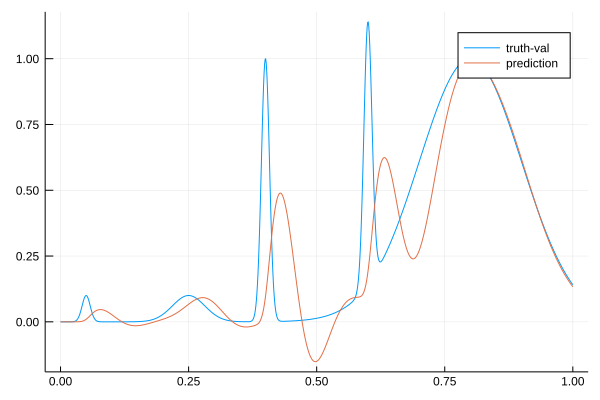

104.37421198927092 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.71149662235877 
  45.51641161541089 
  -9.530619677393316
  51.81025169843168 
 -33.01552637161073 
   0.1              

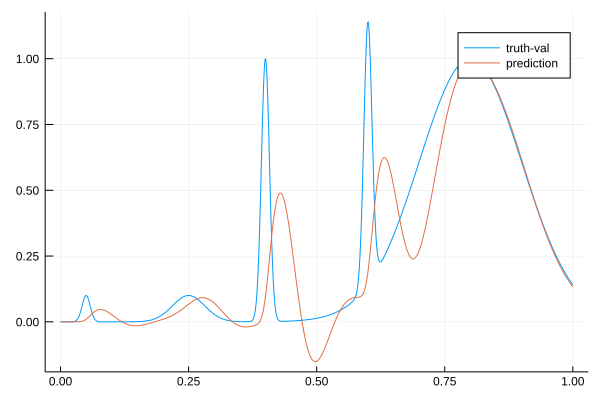

104.3550149043052 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.72947994335592 
  45.53982722640914 
  -9.549996485940154
  51.855326805094315
 -33.054557787449845
   0.1              

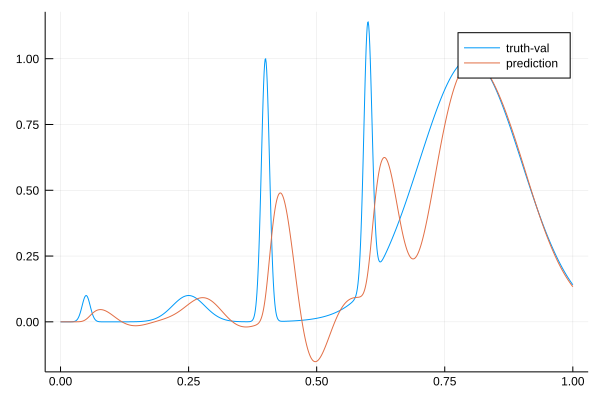

104.33549772522802 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.74457446208931 
  45.56511703480391 
  -9.567652376324185
  51.90080333254167 
 -33.09333763454198 
   0.1              

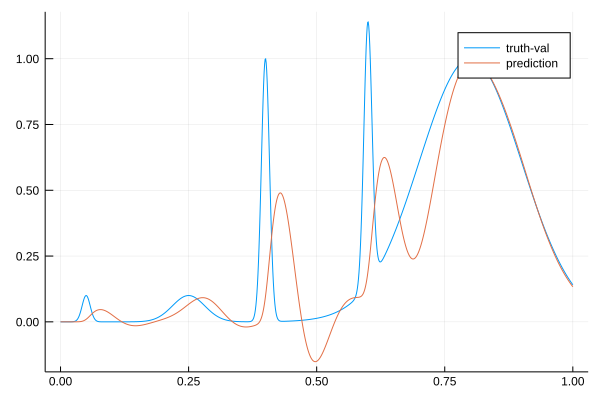

104.31611205504997 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.75874744508208 
  45.5908573494006  
  -9.584651509763798
  51.946191285615654
 -33.132268392915876
   0.1              

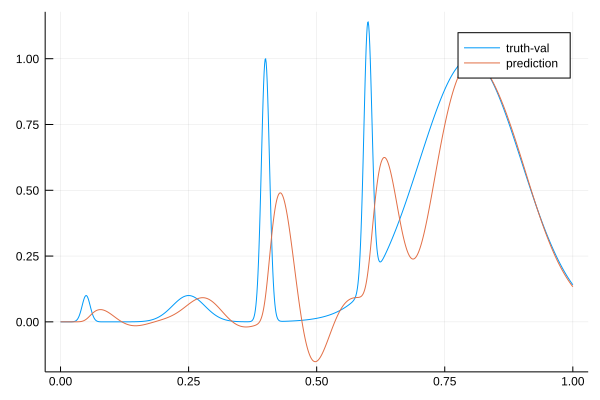

104.29677464912434 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.7737678017537  
  45.61576487158256 
  -9.601948352292945
  51.991046763166096
 -33.17172811530224 
   0.1              

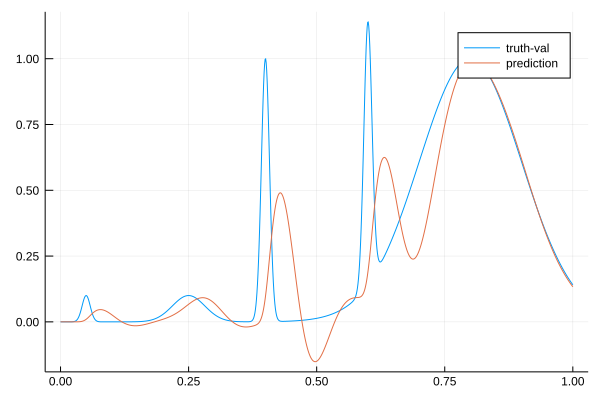

104.27736789346103 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.78956585807215 
  45.63992820210933 
  -9.619510803291332
  52.0354392655922  
 -33.21168220478158 
   0.1              

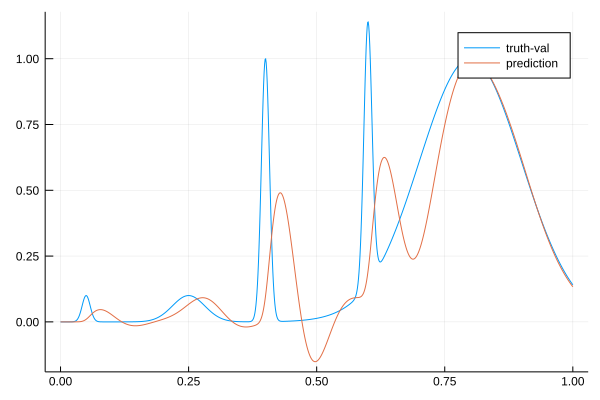

104.25766634186147 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.807737574005245
  45.66218709099484 
  -9.63819311504393 
  52.07896703205073 
 -33.252481207690415
   0.1              

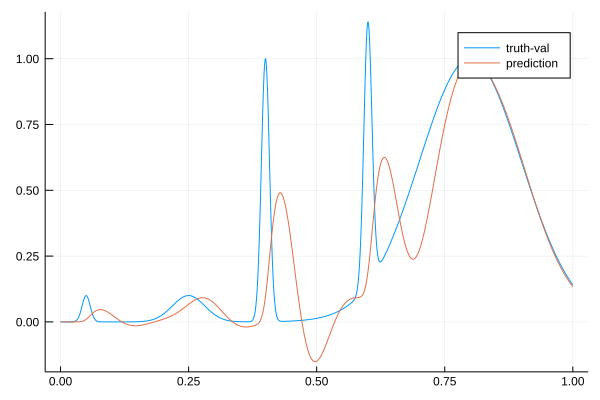

104.23818202588757 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.826400196444496
  45.68398669472942 
  -9.656990165865693
  52.12220886300783 
 -33.29366216389317 
   0.1              

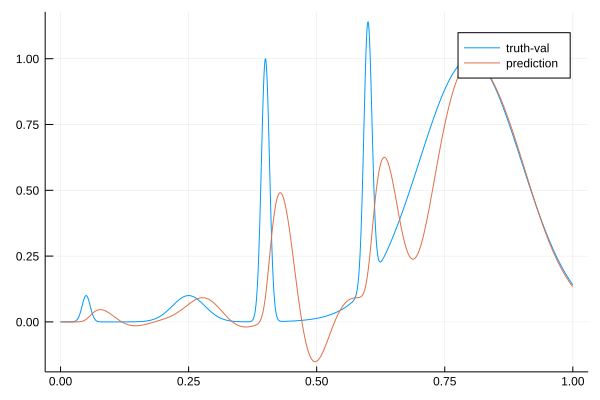

104.21912607413049 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.84384794253863 
  45.7066343380987  
  -9.67498757782811 
  52.165686925859625
 -33.33481446259615 
   0.1              

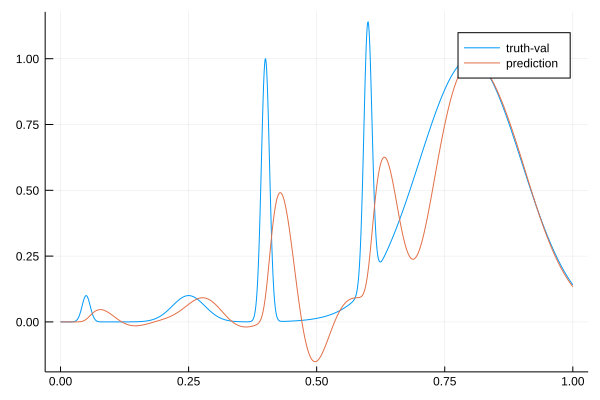

104.19986904565155 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.85847817755789 
  45.73112100038859 
  -9.69136615536844 
  52.209573617029086
 -33.375770225324125
   0.1              

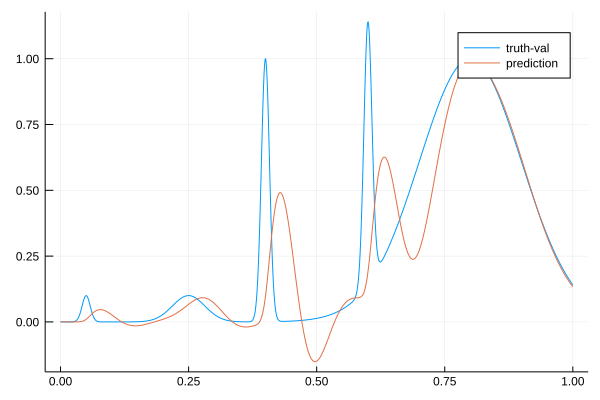

104.18056845694142 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.872257948864146
  45.756025775562804
  -9.707177557695404
  52.25338305034511 
 -33.41693257521191 
   0.1              

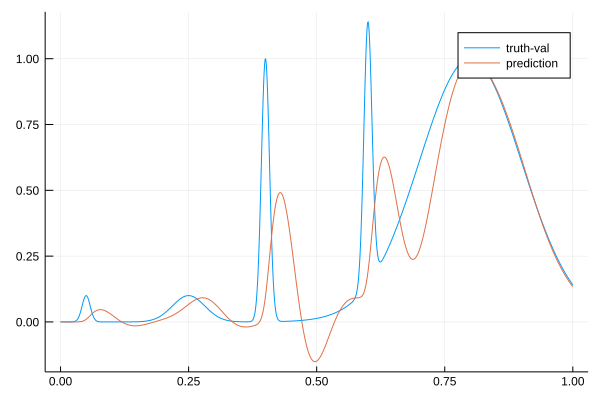

104.16138598685542 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.886956000320026
  45.7800683484912  
  -9.723364966563922
  52.29667568594695 
 -33.458679117199125
   0.1              

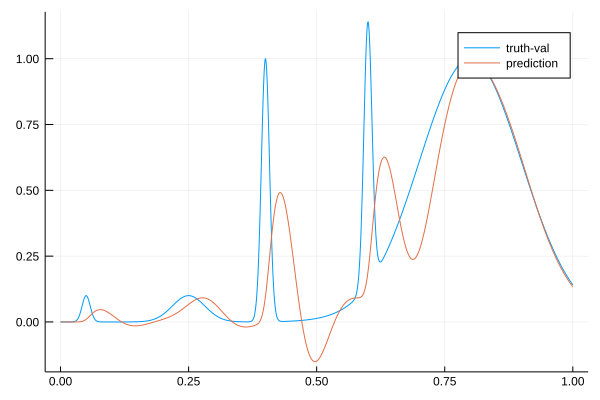

104.14207472009682 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.9024928930891  
  45.803345810130665
  -9.73988141373227 
  52.33952509537493 
 -33.50096718288459 
   0.1              

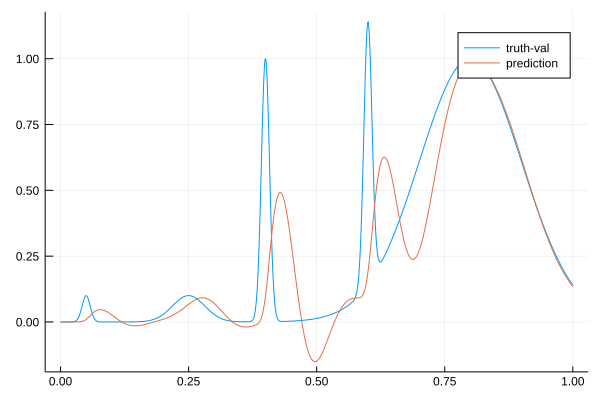

104.12266017063784 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.91879635175848 
  45.82594807377352 
  -9.756682456605166
  52.38200033361511 
 -33.54375481157642 
   0.1              

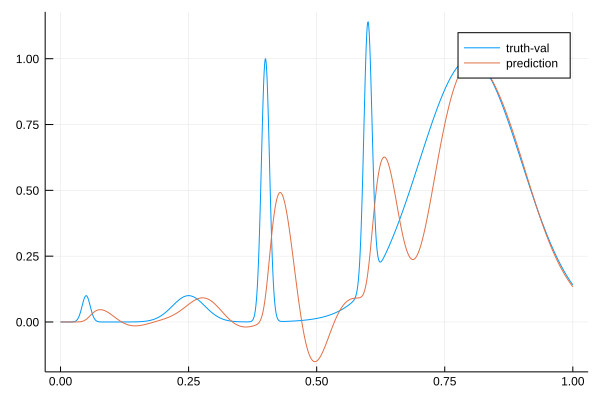

104.10332347428321 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.935800616478204
  45.84795832642704 
  -9.773726154378505
  52.4241660742977  
 -33.58700108014347 
   0.1              

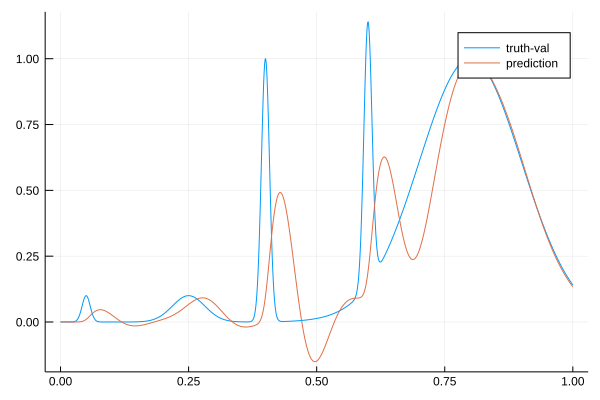

104.0841257223049 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.95176739533209 
  45.87070474838105 
  -9.79007563004027 
  52.46654843609515 
 -33.630283342665486
   0.1              

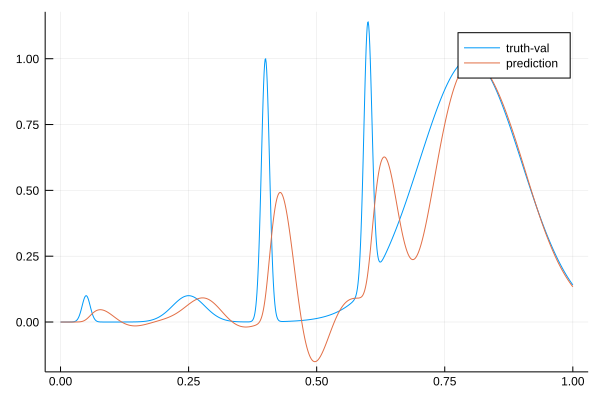

104.06543498464771 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.96684426241442 
  45.89373650778848 
  -9.805861548031395
  52.508648807314394
 -33.6738155587498  
   0.1              

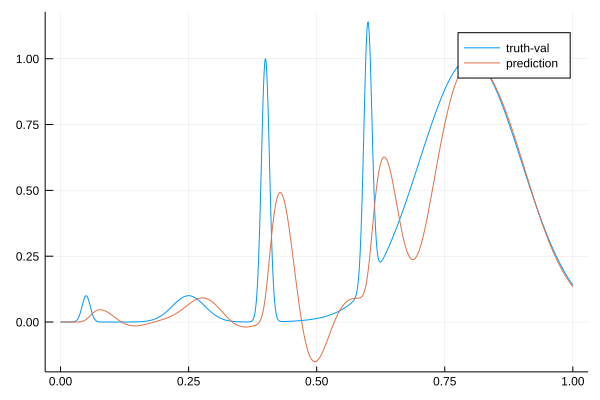

104.04649770040473 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.98112730899516 
  45.917042241824   
  -9.821123759693874
  52.55052203490109 
 -33.71758383038809 
   0.1              

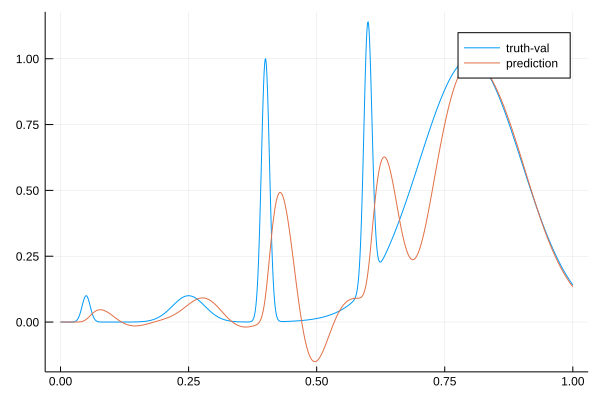

104.02767497350126 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  36.99470294410536 
  45.940611541742186
  -9.835897271833417
  52.592217177223276
 -33.76157708408804 
   0.1              

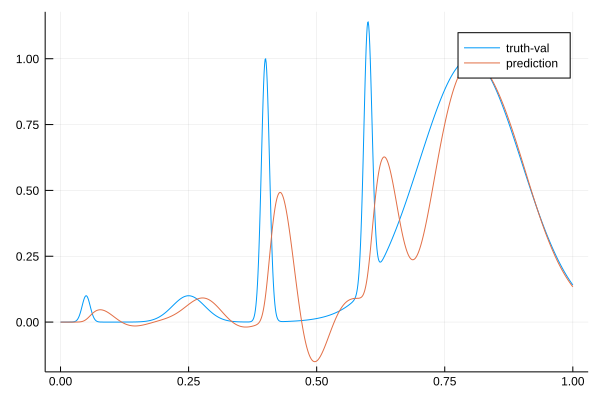

104.00927331103436 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.007648997318526
  45.96443427526341 
  -9.850213808672427
  52.63377739670051 
 -33.80578675113635 
   0.1              

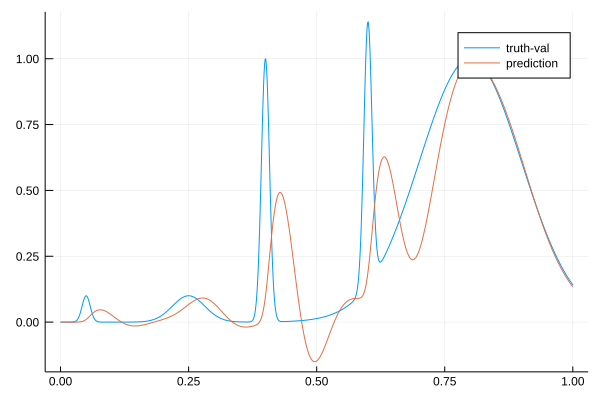

103.99119612623356 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.02179639688969 
  45.986998043044174
  -9.865027926863656
  52.67449705253459 
 -33.850585697240774
   0.1              

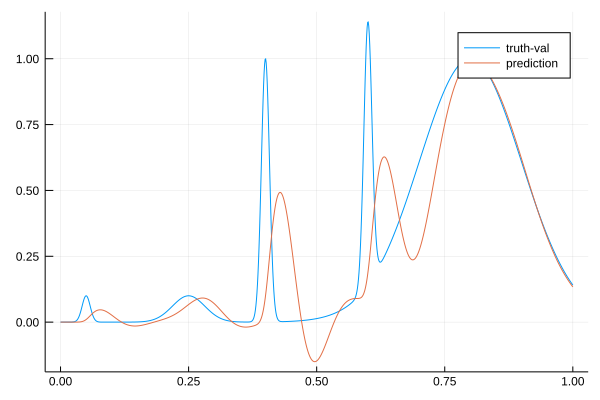

103.97297685136853 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.03703318921136 
  46.00844654835088 
  -9.880270598580944
  52.71448874964973 
 -33.89592679761467 
   0.1              

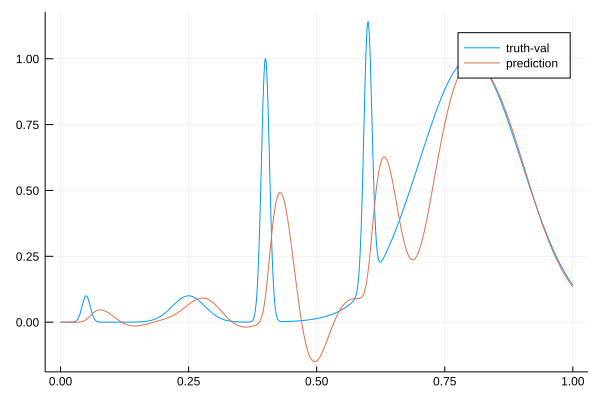

103.95497386571174 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.05325785153985 
  46.02887879893264 
  -9.895877601309325
  52.75381265077999 
 -33.94178023507039 
   0.1              

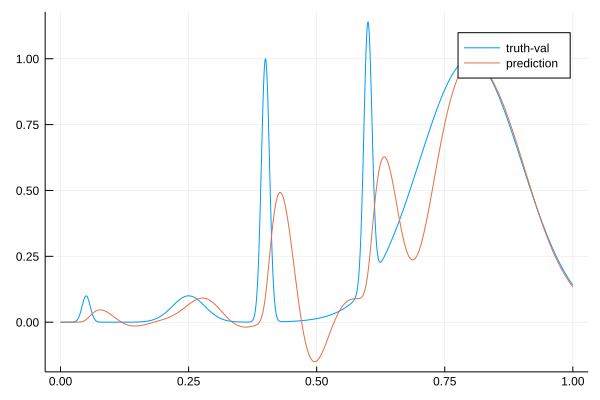

103.93702864236322 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.06868813972342 
  46.049677133398625
  -9.910884923151881
  52.79303536018303 
 -33.98770879372919 
   0.1              

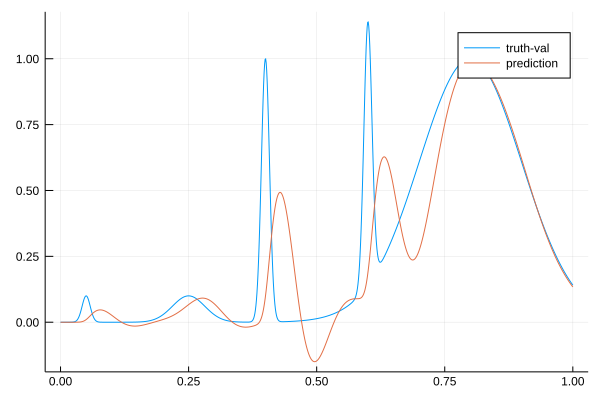

103.91898333876448 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.08340655062    
  46.070830084120345
  -9.925326202691696
  52.8322014312179  
 -34.03370874165912 
   0.1              

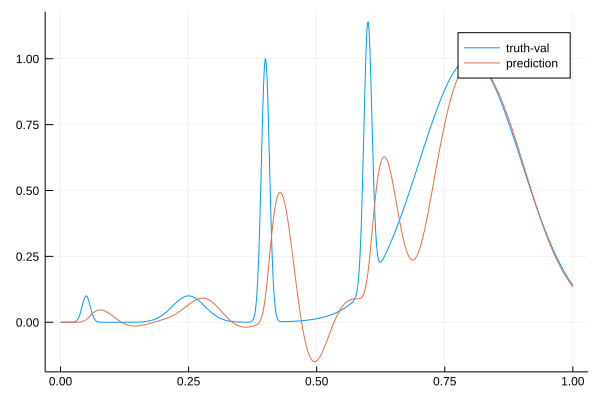

103.9013935448337 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.09643204655353 
  46.09300849864561 
  -9.938584713790952
  52.871502784813636
 -34.079405097884276
   0.1              

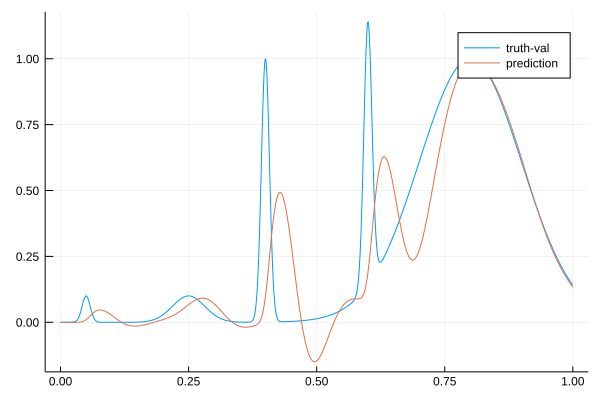

103.88385900594307 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.10963561905495 
  46.11487122919603 
  -9.951664210495942
  52.91049216566286 
 -34.125219130001   
   0.1              

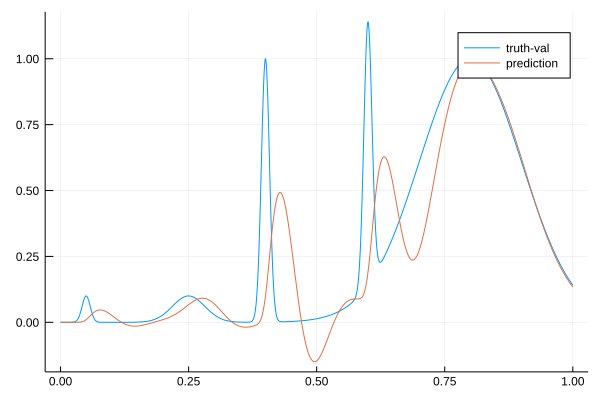

103.8663206281531 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.12300399813319 
  46.13647081611824 
  -9.964558097939861
  52.94923071602012 
 -34.17114967102791 
   0.1              

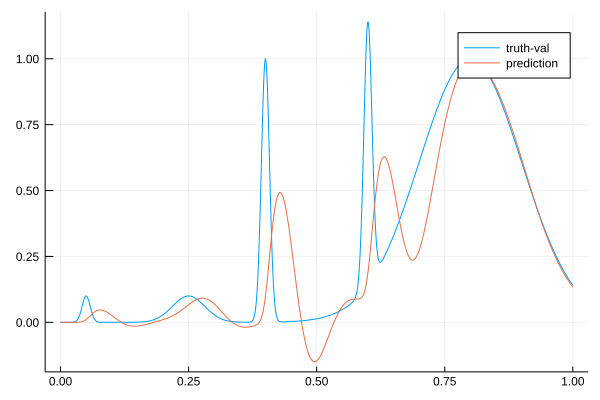

103.84876661256537 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.13652494667676 
  46.15785519854027 
  -9.97725971160875 
  52.98777410171344 
 -34.217194990004934
   0.1              

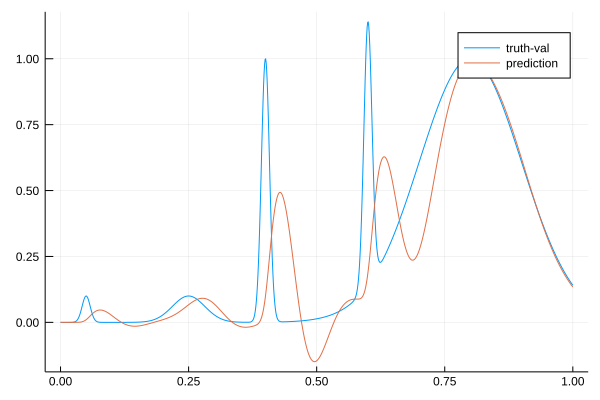

103.8311858476036 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.15018720452881 
  46.17906806363807 
  -9.989762427156055
  53.02617294347615 
 -34.26335301302767 
   0.1              

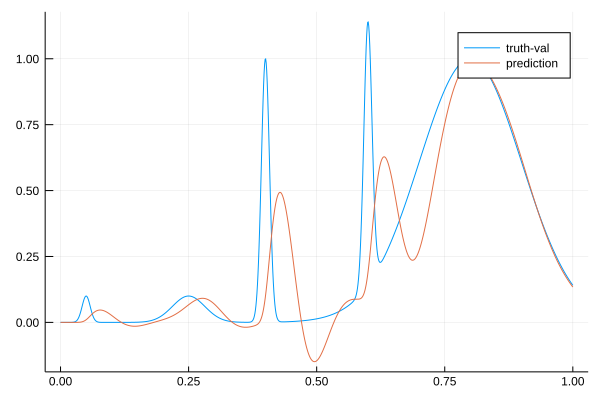

103.81356877598782 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.16398043489542 
  46.200149170202316
 -10.002059751497718
  53.06447321539784 
 -34.309621508746176
   0.1              

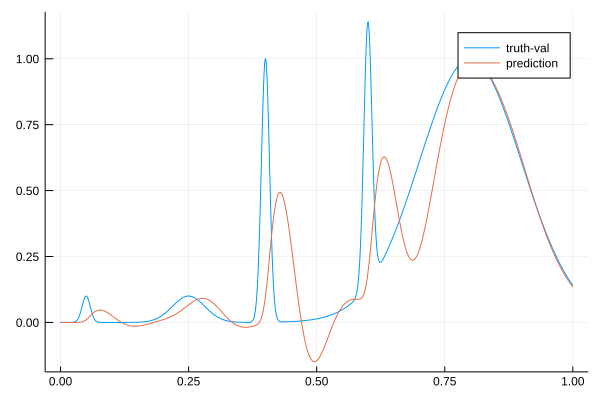

103.79586963853934 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.177895172140246
  46.221134649150116
 -10.014145396814305
  53.10271661335149 
 -34.35599824265857 
   0.1              

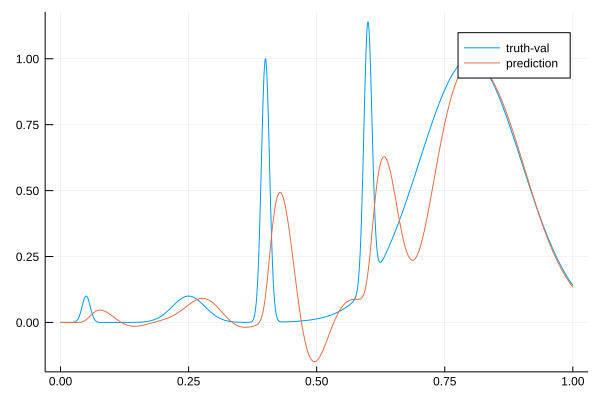

103.77809438904666 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.191922809252446
  46.24205728912259 
 -10.026013370792496
  53.140940931792116
 -34.40248108320572 
   0.1              

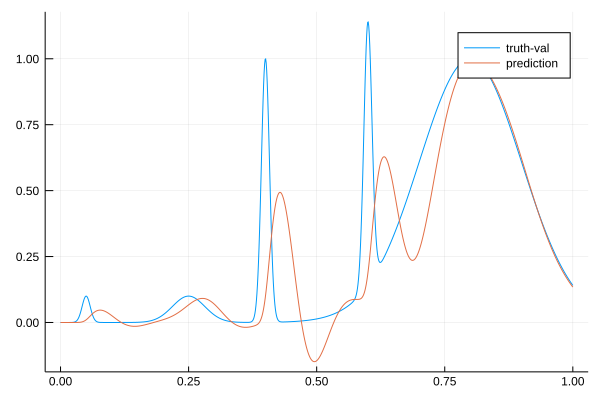

103.76060297030938 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.20605553885854 
  46.26294679037383 
 -10.037658027415471
  53.17918036453572 
 -34.44906811749716 
   0.1              

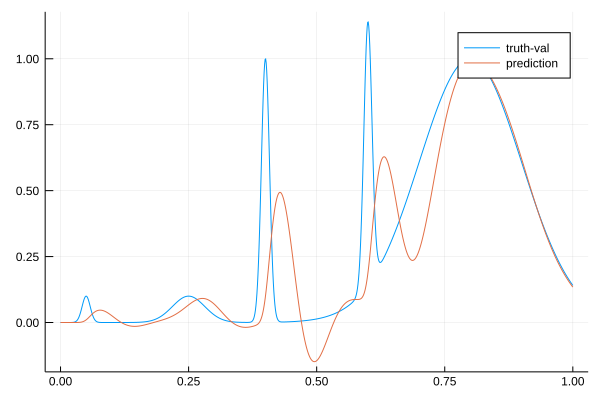

103.7431059461777 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.2202313897803  
  46.28364434080228 
 -10.04908469468545 
  53.217178498563385
 -34.495942185118906
   0.1              

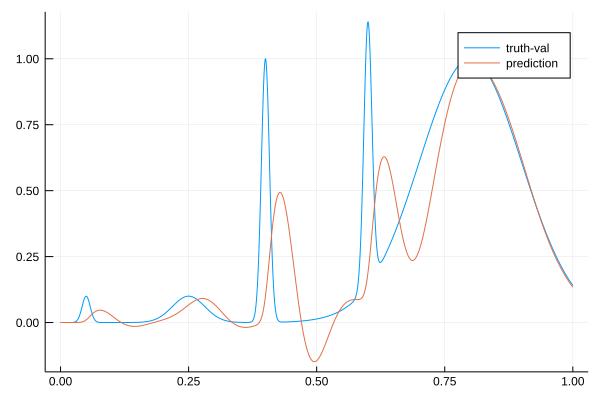

103.7255747775275 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.23444874939569 
  46.30419381236608 
 -10.060286488259198
  53.25499300374623 
 -34.543083243501364
   0.1              

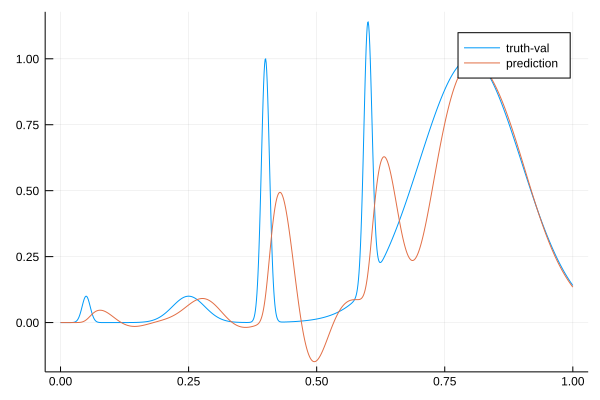

103.70801843508804 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.24870589096249 
  46.3246352347681  
 -10.071256436749392
  53.292676284217414
 -34.59047286185524 
   0.1              

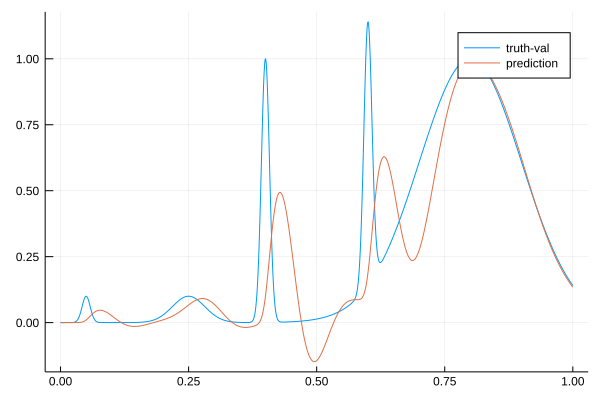

103.69032388044812 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.26300102379276 
  46.34500506481029 
 -10.08198761159907 
  53.33027587768253 
 -34.638094217793096
   0.1              

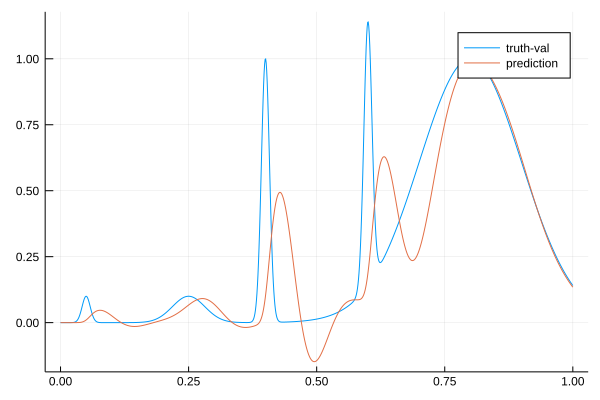

103.67228375014776 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.275616656833336
  46.36660273509696 
 -10.09155380614995 
  53.36829379199217 
 -34.68554682635313 
   0.1              

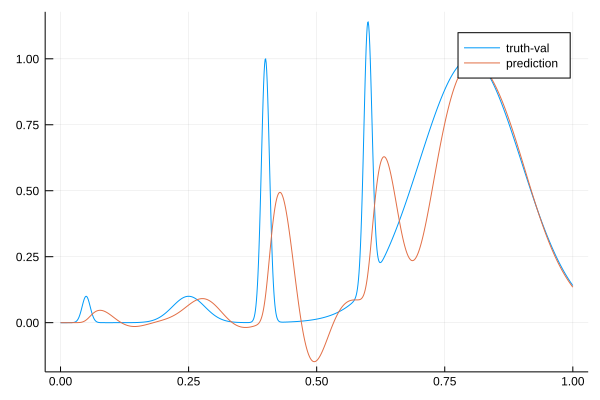

103.65432613919356 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.288438279214205
  46.38806295693873 
 -10.100961791143817
  53.40626086280243 
 -34.73324642329182 
   0.1              

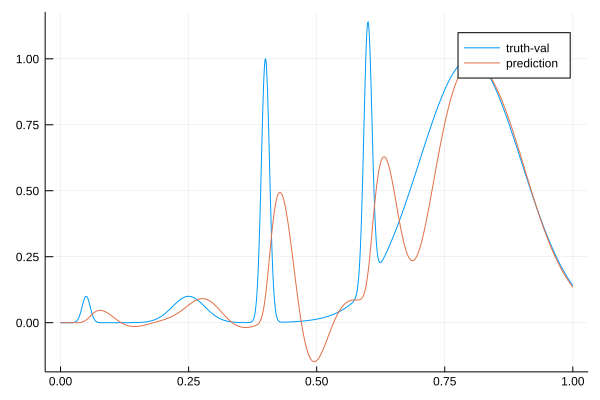

103.63633692601218 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.301448344144795
  46.40942265472154 
 -10.110198488799911
  53.44421381764798 
 -34.781181663031674
   0.1              

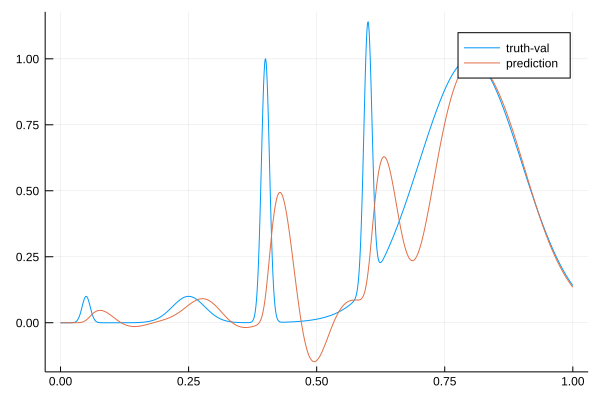

103.61829001345895 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.31463550213712 
  46.430671826747435
 -10.119251858066054
  53.48213128237075 
 -34.829395372511875
   0.1              

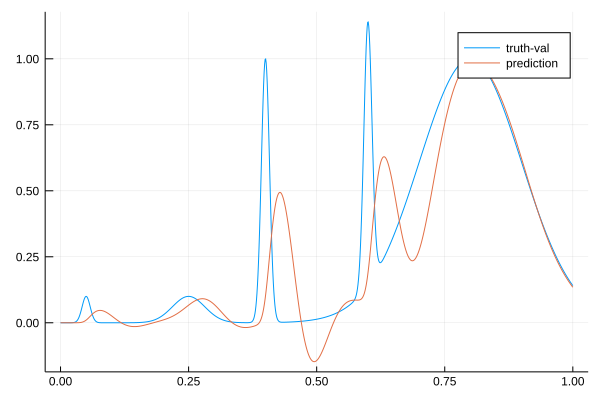

103.60044884894457 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.3279846971888  
  46.45184559604605 
 -10.128110185940645
  53.5200493245155  
 -34.87787233512651 
   0.1              

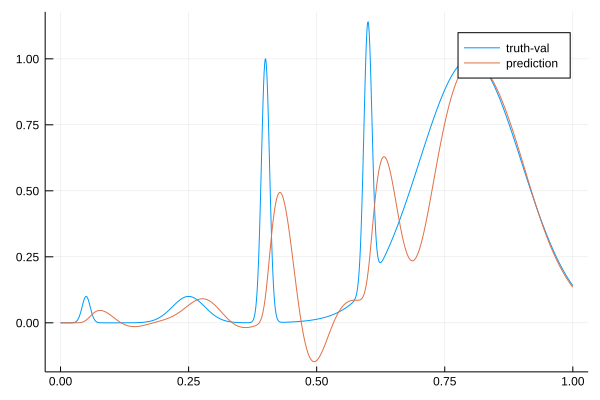

103.5824658905746 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.34160988509217 
  46.4729101752352  
 -10.136777594817342
  53.558004517138784
 -34.92641823954712 
   0.1              

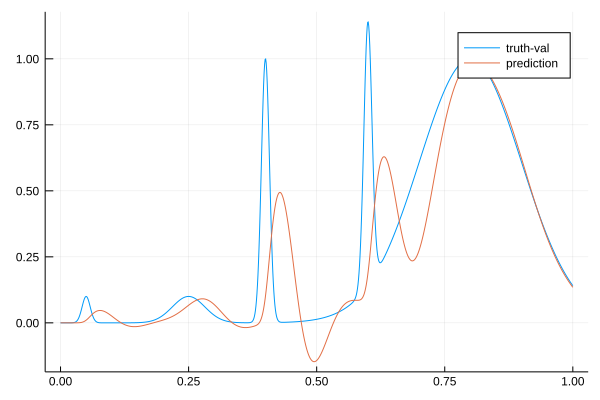

103.56401064126977 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.355485898412674
  46.49390064726046 
 -10.145242313486564
  53.5960255483573  
 -34.97503921848486 
   0.1              

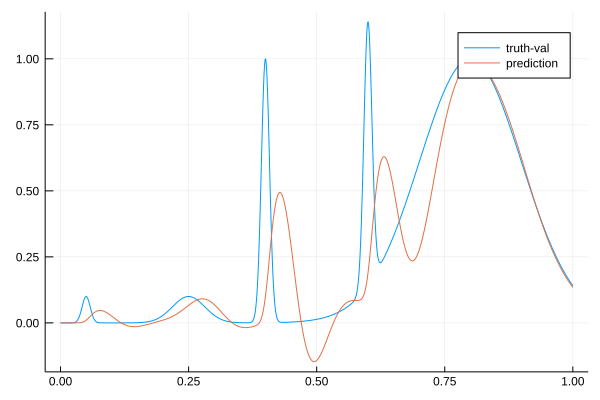

103.54584843157082 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.37130787559545 
  46.5135826737922  
 -10.154411638515631
  53.633682790879725
 -35.02413644211729 
   0.1              

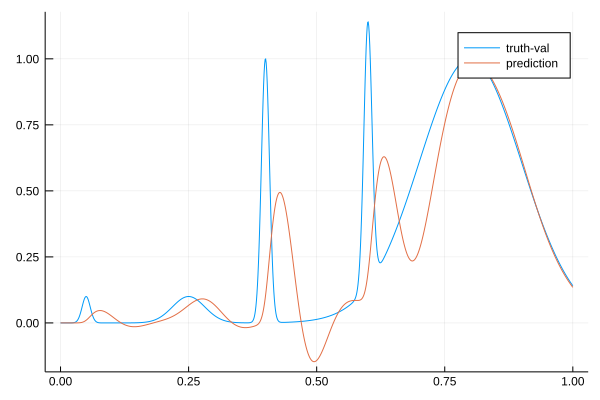

103.52763560510631 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0             
   0.001           
   0.001           
  37.38716639105329
  46.5333796931047 
 -10.16326417569287
  53.67150425461672
 -35.07327361471056
   0.1             

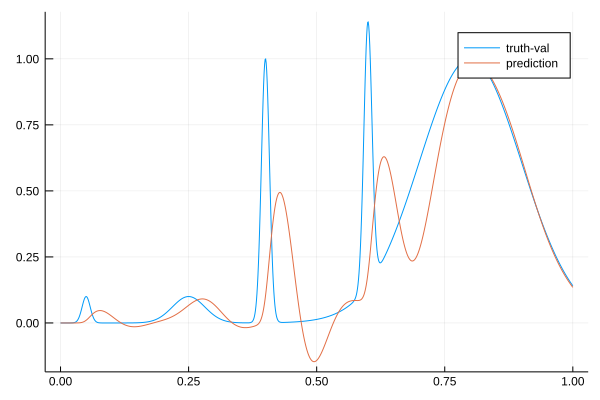

103.50925565275615 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.40243468193617 
  46.55372006769483 
 -10.171758634549255
  53.70961165925085 
 -35.12228834143582 
   0.1              

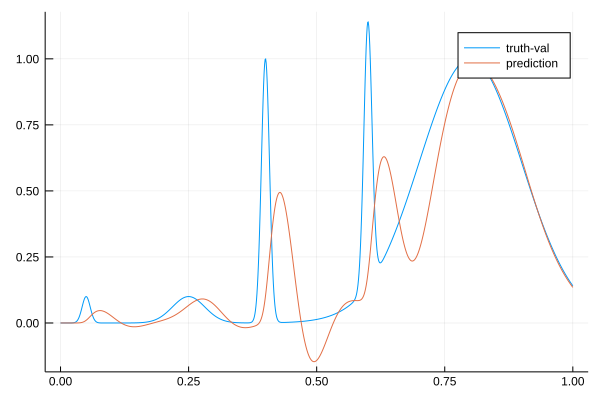

103.49107755025683 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.41717264116516 
  46.5745767377223  
 -10.179897854143448
  53.74801170822013 
 -35.17120238368092 
   0.1              

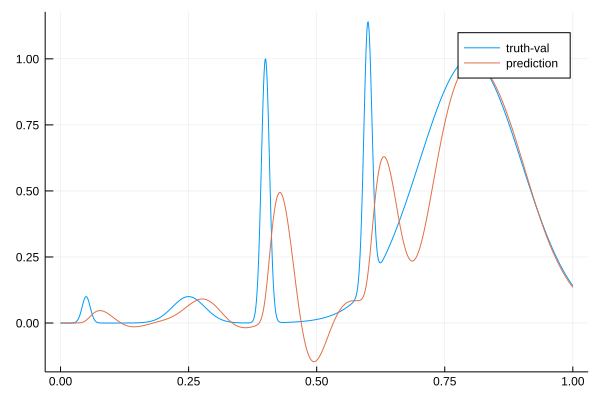

103.47324022159411 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.43147248899179 
  46.59552617174288 
 -10.187765476284378
  53.78620763162497 
 -35.220251129646805
   0.1              

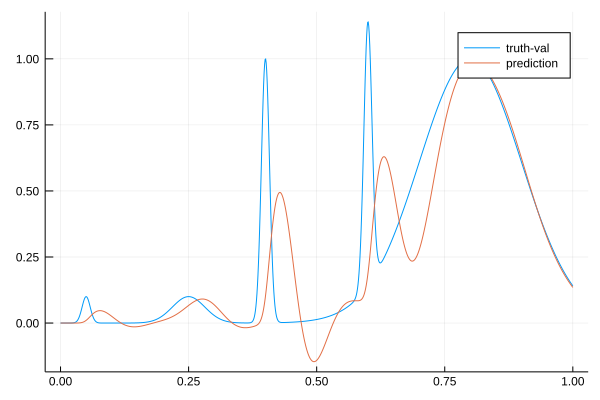

103.45555561588858 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.445378967047816
  46.616584893644   
 -10.19535650790064 
  53.82425347725391 
 -35.26943381400039 
   0.1              

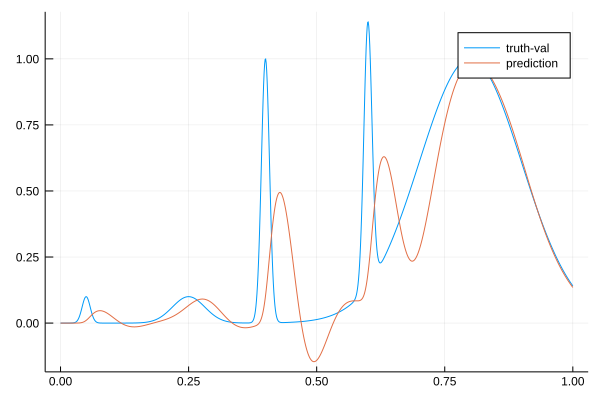

103.43790694038073 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.4588785012252  
  46.63758600086435 
 -10.202677038762884
  53.86191821601242 
 -35.31893194362186 
   0.1              

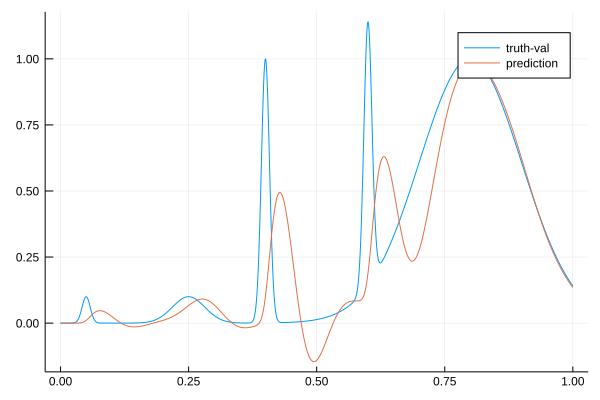

103.4202973149804 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.47201219826029 
  46.658561784904926
 -10.209720895614735
  53.89927431607642 
 -35.36872720522661 
   0.1              

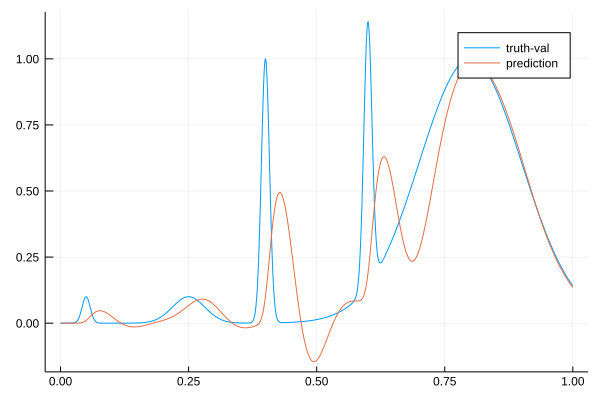

103.40247132888378 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.48654347787893 
  46.67827436862389 
 -10.217404368790056
  53.93593641904447 
 -35.41919958868262 
   0.1              

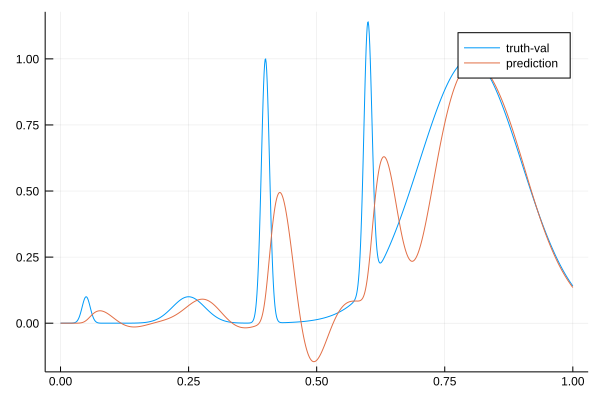

103.38461316938422 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.500606326302886
  46.69814689287079 
 -10.224704264564469
  53.972463093495456
 -35.46989223599808 
   0.1              

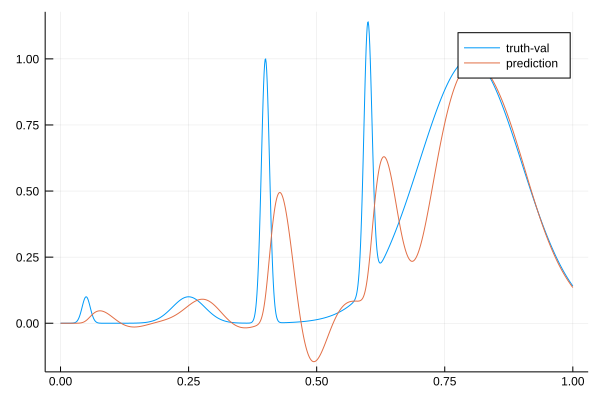

103.36667395040813 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.51424648999359 
  46.718193693314525
 -10.23162133818373 
  54.008906125457614
 -35.52079118313341 
   0.1              

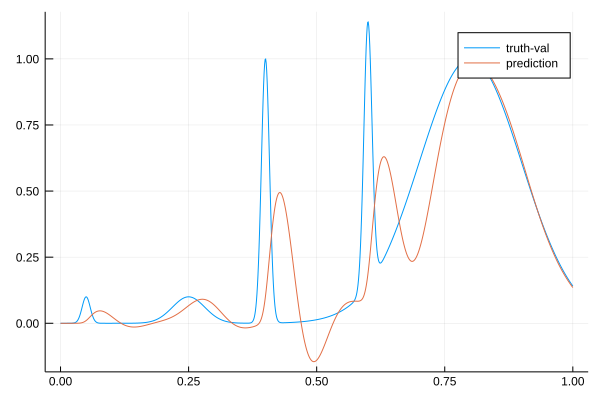

103.3486845990626 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.52750547638713 
  46.73839364452251 
 -10.238156804622234
  54.04526723989756 
 -35.571902508860006
   0.1              

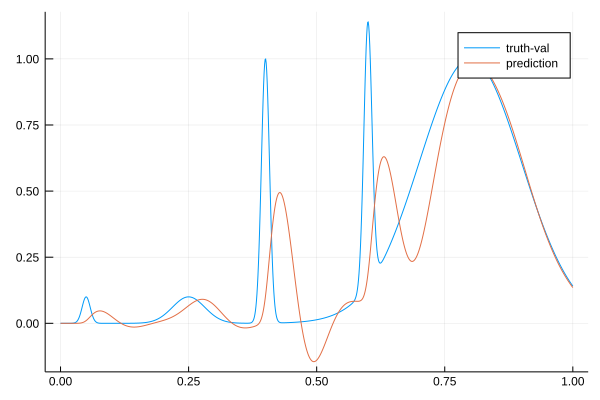

103.33052089194312 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.542151610964815
  46.75749313513674 
 -10.245236350123424
  54.08114376449995 
 -35.62361081978522 
   0.1              

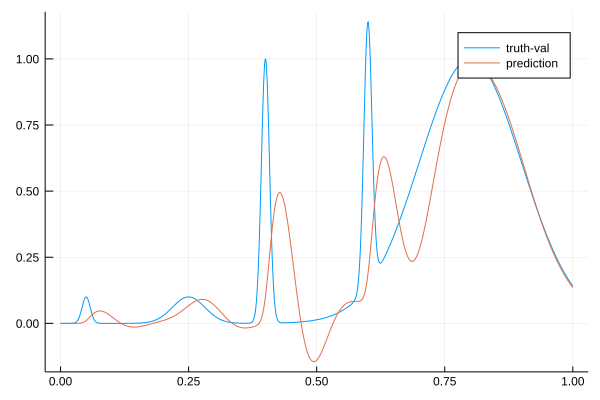

103.3123024758364 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.55631455359596 
  46.77690199905096 
 -10.251840578687386
  54.117073094918595
 -35.675464751318046
   0.1              

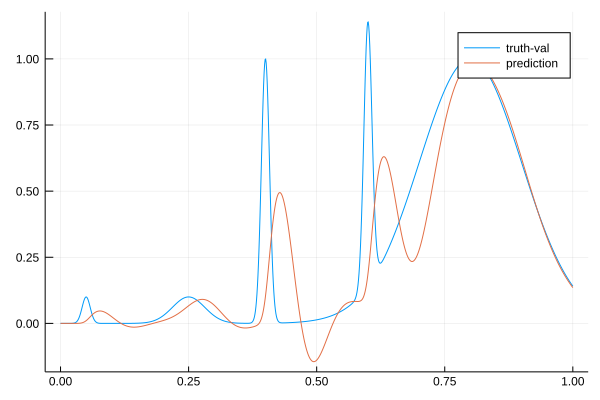

103.29406850154213 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.57004080518962 
  46.796621439958386
 -10.257976728418583
  54.15308998231486 
 -35.72745578948056 
   0.1              

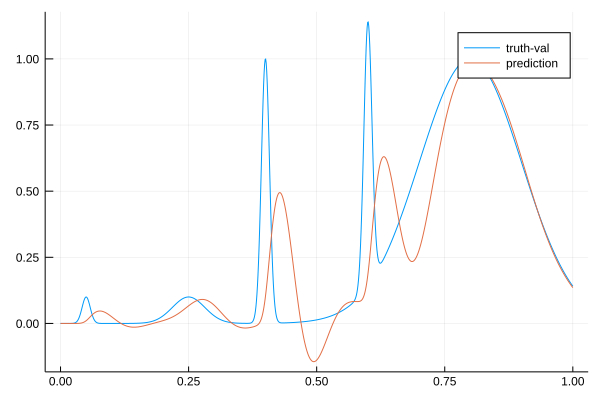

103.27597120665435 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.583496948625076
  46.81658603129836 
 -10.263666547085377
  54.18922623120015 
 -35.77940593858068 
   0.1              

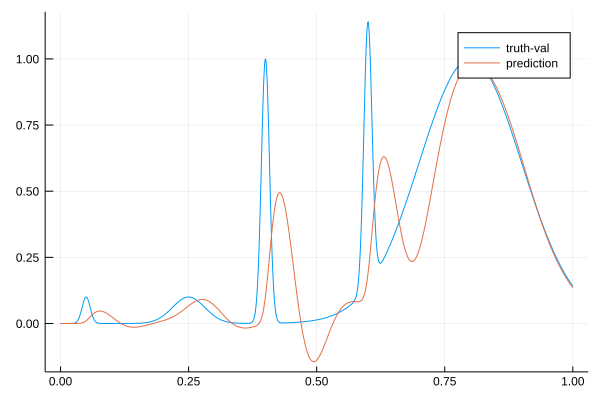

103.2578428867779 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.596708718506015
  46.83680145360819 
 -10.268915336101426
  54.22550766582916 
 -35.831329092500624
   0.1              

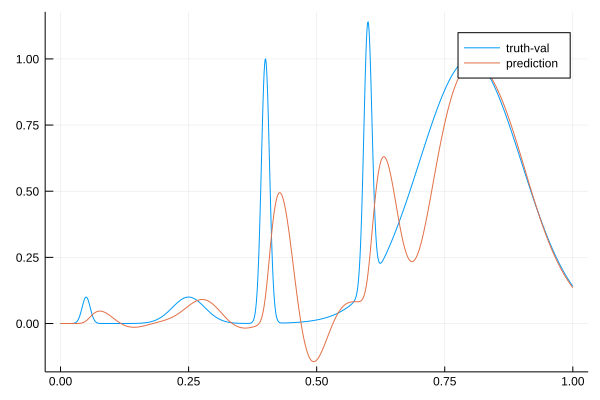

103.23965635545797 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.61081341705943 
  46.856420007691064
 -10.274614579278417
  54.26162040254817 
 -35.883463108849796
   0.1              

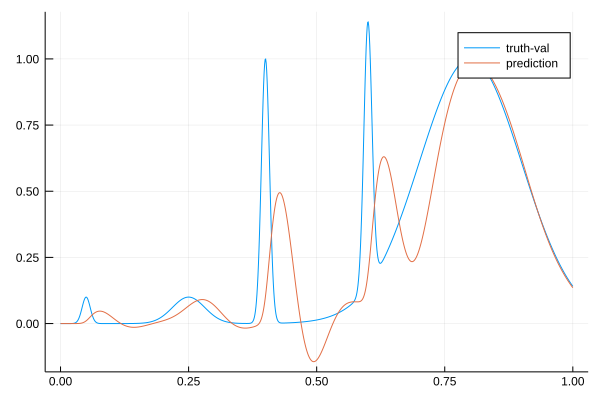

103.2214250279627 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.625721758233546
  46.87553234957419 
 -10.28068026977039 
  54.29762108941491 
 -35.93579447517937 
   0.1              

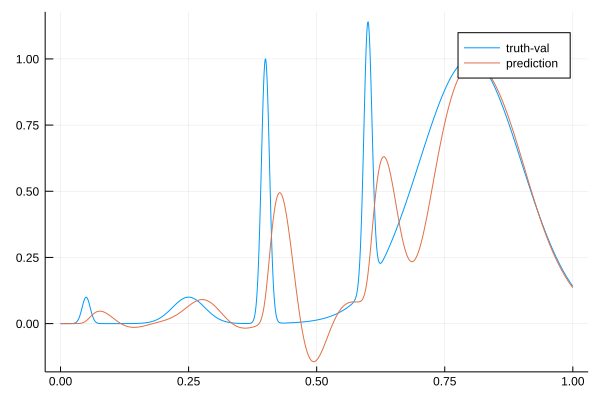

103.20302176290083 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.63961411879785 
  46.89549013608037 
 -10.286105877826815
  54.334005793276454
 -35.98791304418123 
   0.1              

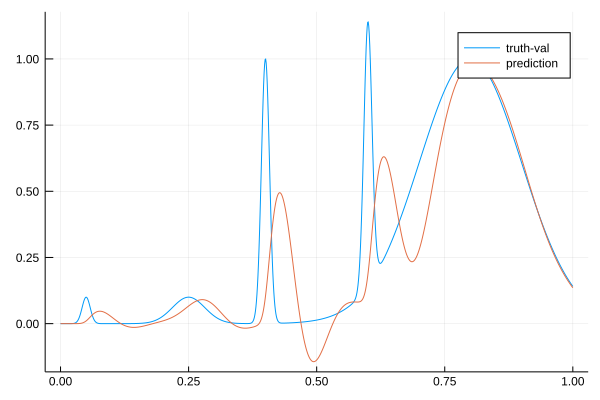

103.18454657535236 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.652589997464474
  46.91624016386102 
 -10.29091566118992 
  54.37077473919278 
 -36.03984882437453 
   0.1              

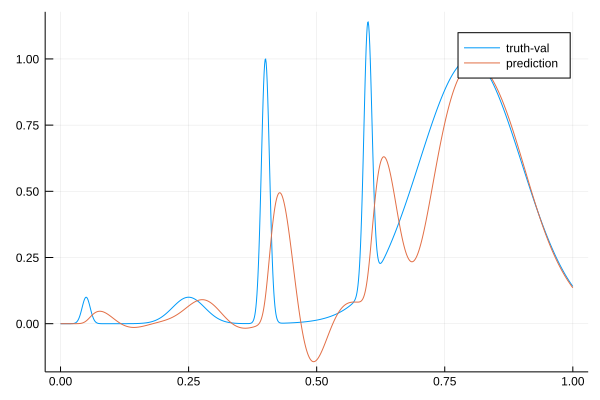

103.16596107853351 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.66648072314233 
  46.93646413401513 
 -10.296064014794446
  54.40748410706201 
 -36.09202728957687 
   0.1              

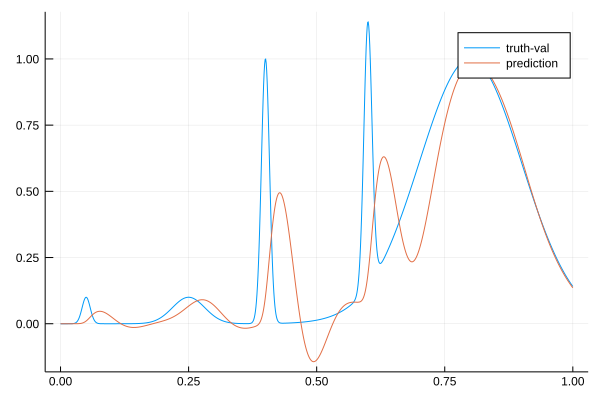

103.14721374531608 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0             
   0.001           
   0.001           
  37.68119561247814
  46.95624452038739
 -10.30147924462444
  54.44417857370631
 -36.1444335811282 
   0.1             

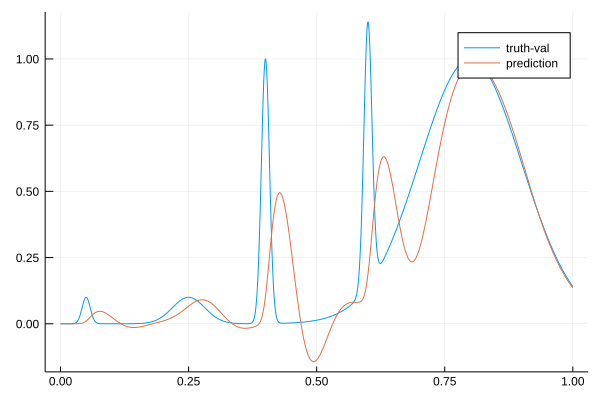

103.1283086472505 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.69665275776251 
  46.97565675936948 
 -10.307095955572477
  54.480899712628485
 -36.197052172333684
   0.1              

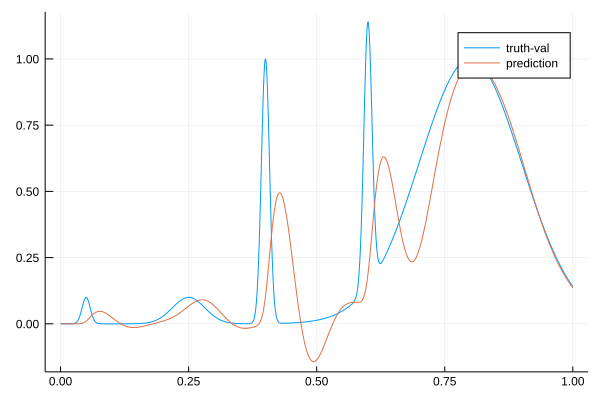

103.10937355628012 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.712778203981166
  46.994769763587186
 -10.312854554744169
  54.51768608662567 
 -36.2498673056351  
   0.1              

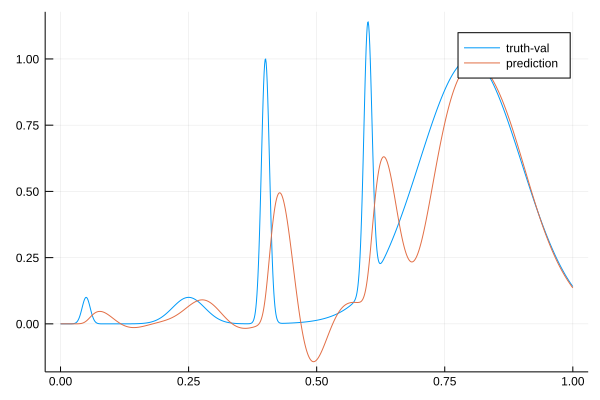

103.09040296672528 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.72776037689338 
  47.01491532103568 
 -10.317767276687514
  54.55501243628272 
 -36.30246898541902 
   0.1              

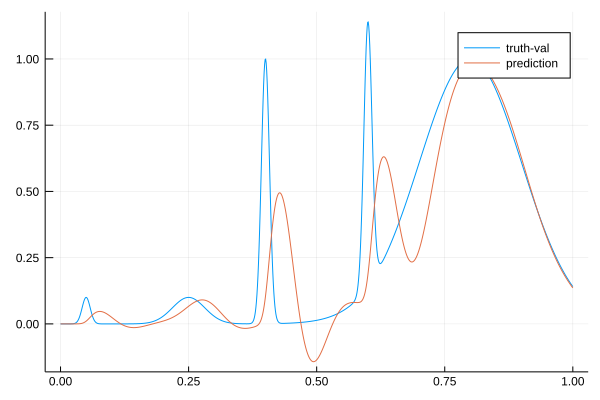

103.07132999803719 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.741659044052646
  47.035845672358164
 -10.321889868426954
  54.592594237524644
 -36.35506520354172 
   0.1              

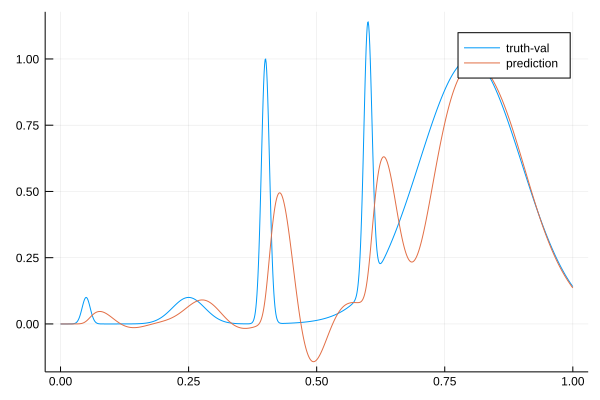

103.05226539205854 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.75570989705543 
  47.056660418978915
 -10.326154287401604
  54.63011797184025 
 -36.407888070902466
   0.1              

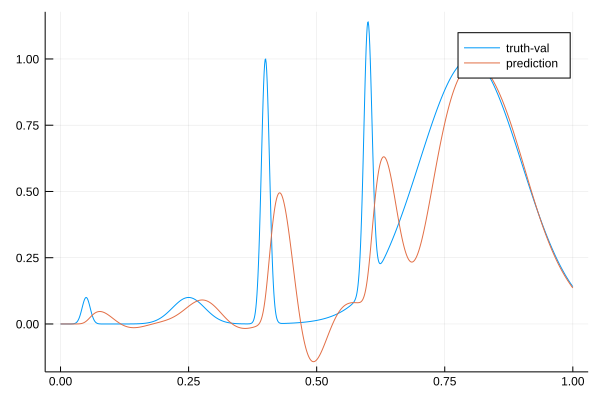

103.03306918281437 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.76989803959676 
  47.07740185116613 
 -10.330508490628358
  54.667628837809424
 -36.46092543871004 
   0.1              

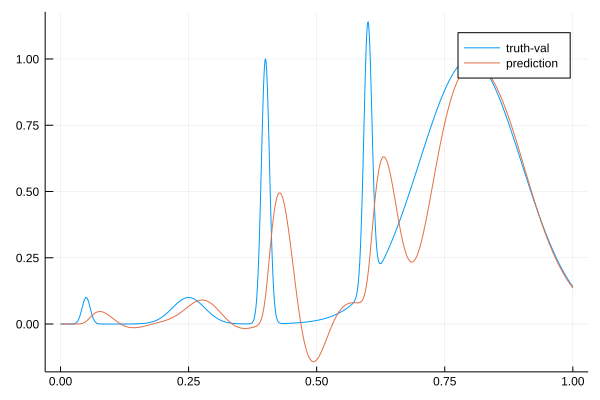

103.01421702760302 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.78421001101537 
  47.09810851857945 
 -10.334905206518808
  54.705168083086996
 -36.51416549488149 
   0.1              

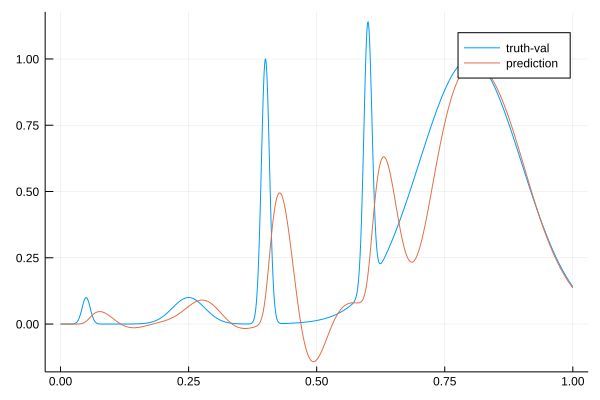

102.9958261291899 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.799412662962546
  47.11815624956935 
 -10.339592701683769
  54.74245540647178 
 -36.567434002821685
   0.1              

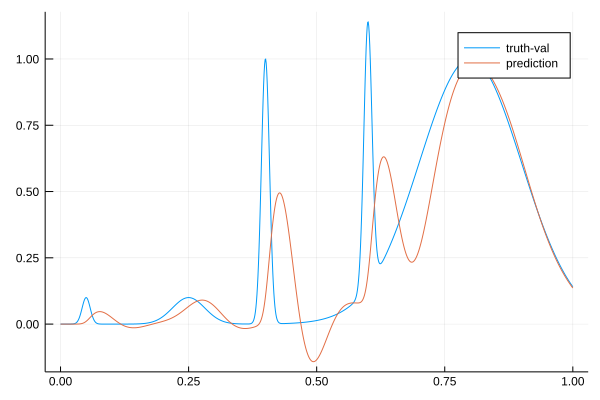

102.97734014272011 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.81541710203159 
  47.13764259517484 
 -10.344502775483557
  54.77955661593828 
 -36.620735647133486
   0.1              

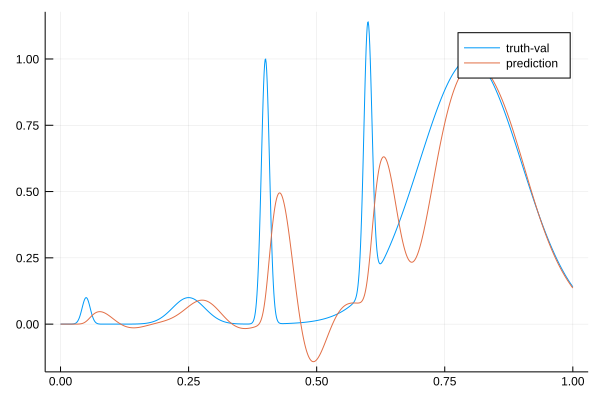

102.95875805329773 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.8321430159289  
  47.156656464648655
 -10.349573263661975
  54.81653216565643 
 -36.67407245411508 
   0.1              

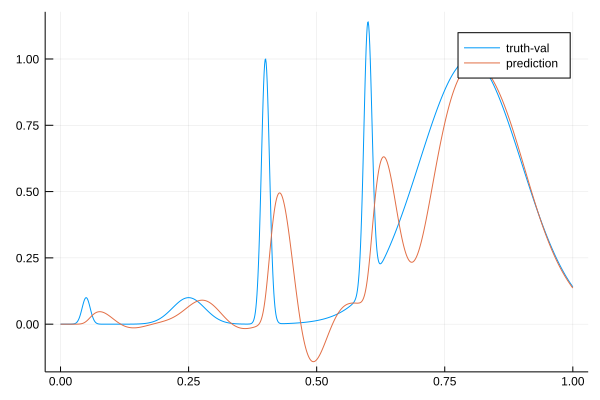

102.94032164255862 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.84951787214617 
  47.17527880582196 
 -10.354747562660377
  54.85343748334976 
 -36.727444441829036
   0.1              

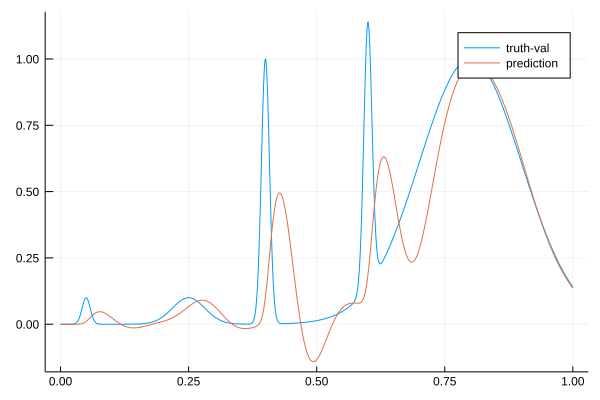

102.92172901050267 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.86572311807368 
  47.194852332793914
 -10.3590355914987  
  54.890755607226424
 -36.780457769315504
   0.1              

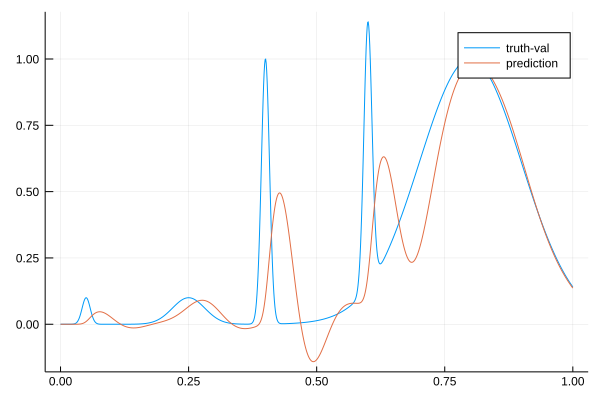

102.90295253976377 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.88026034224411 
  47.21573011179753 
 -10.362442051713552
  54.92859950642696 
 -36.83297851371089 
   0.1              

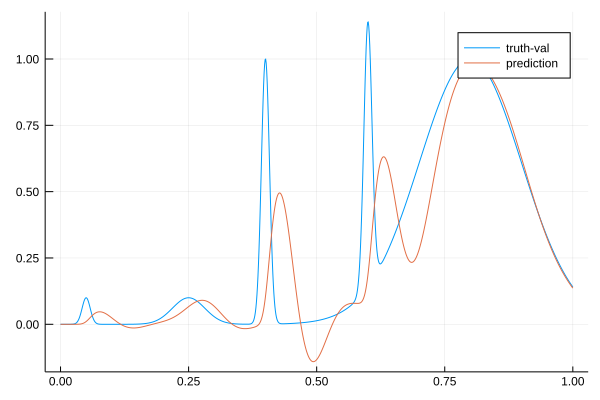

102.88415340273055 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.89329467784545 
  47.23781207603776 
 -10.365017269198047
  54.96695405991661 
 -36.88506759957441 
   0.1              

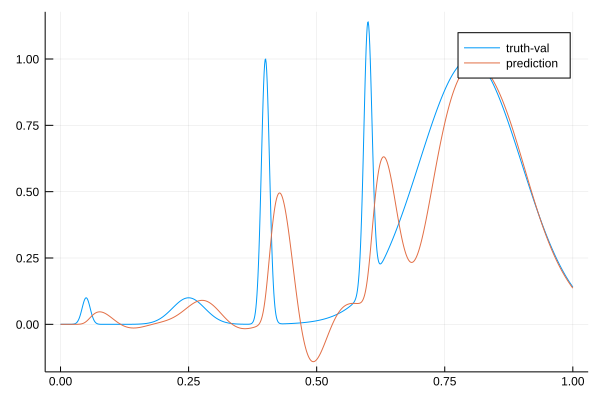

102.86514687523439 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.9067319219479  
  47.25973725842595 
 -10.367748880750336
  55.005372915988374
 -36.93717662510994 
   0.1              

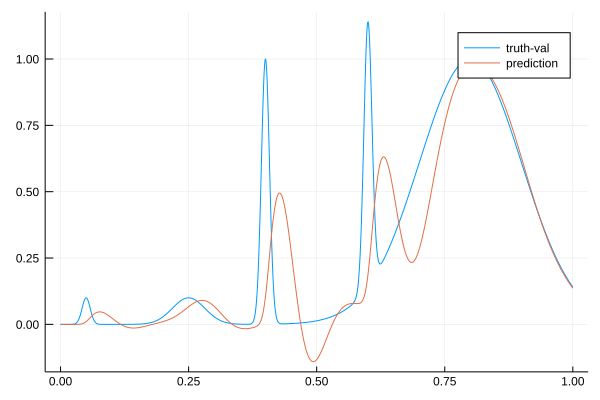

102.84610215049803 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.92053379844242 
  47.28154869292086 
 -10.370587003365303
  55.043885519088484
 -36.98931897353079 
   0.1              

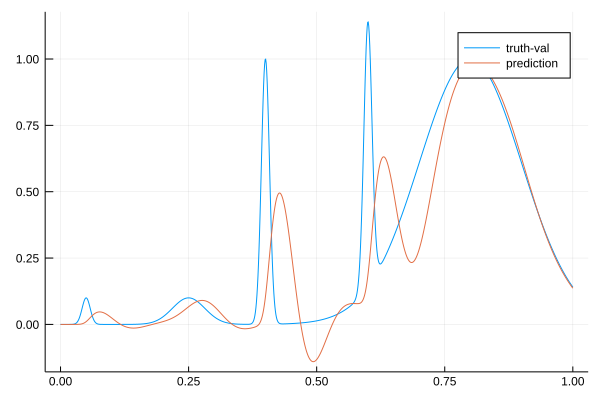

102.82698506720322 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.93466583939523 
  47.3032854420298  
 -10.373486652562814
  55.08251875523819 
 -37.04150589426315 
   0.1              

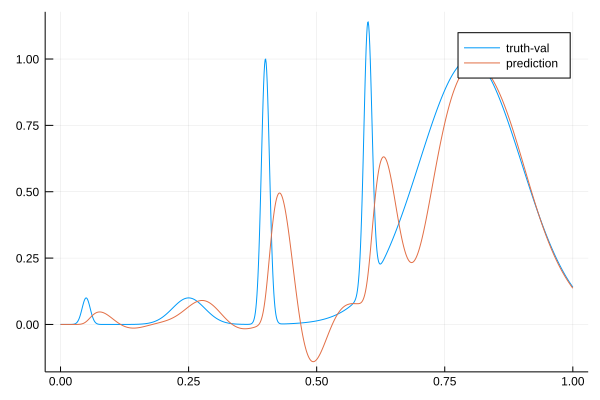

102.80775520544476 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.949097045512325
  47.32498292361451 
 -10.376407290165844
  55.121297142936065
 -37.093746915886015
   0.1              

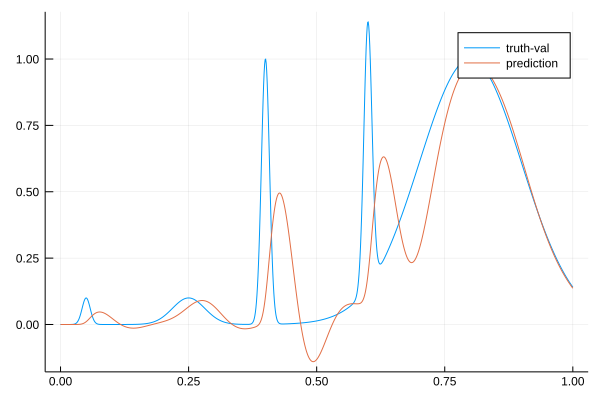

102.7885789122562 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.963799589386504
  47.34667320929316 
 -10.379312428611373
  55.160243016963584
 -37.14605019107956 
   0.1              

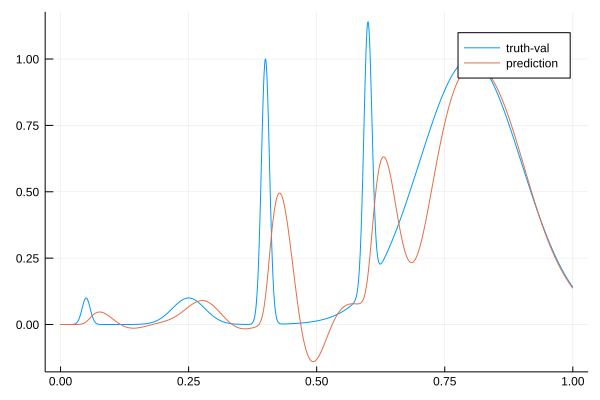

102.76996657274488 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.97878733360658 
  47.36798745542493 
 -10.382251690063425
  55.19888238811702 
 -37.1986398802734  
   0.1              

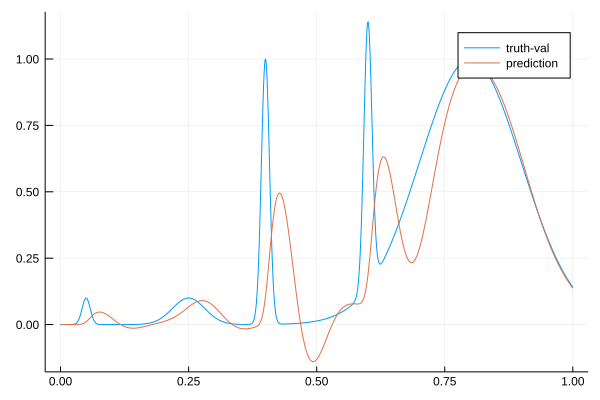

102.7511388255887 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  37.995786610362416
  47.38772887676292 
 -10.386121749810869
  55.23686004800854 
 -37.25189633564026 
   0.1              

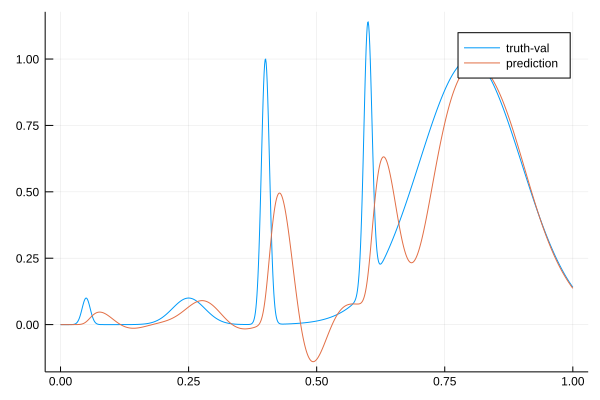

102.73251373154946 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.01471700104603 
  47.40602346030577 
 -10.390806482076284
  55.27428543640316 
 -37.30559869020677 
   0.1              

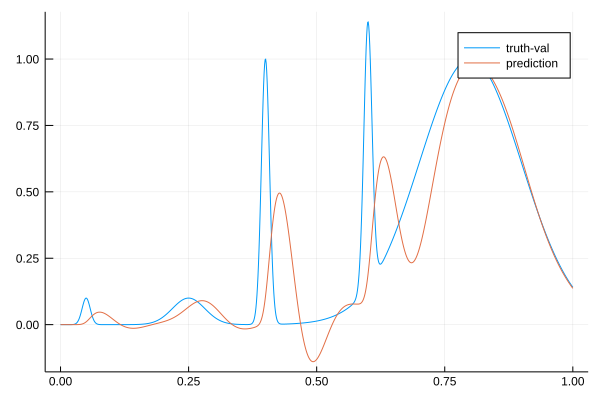

102.71390898508193 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.033579234147474
  47.42414351300425 
 -10.395258063518629
  55.31142093474047 
 -37.359480408145345
   0.1              

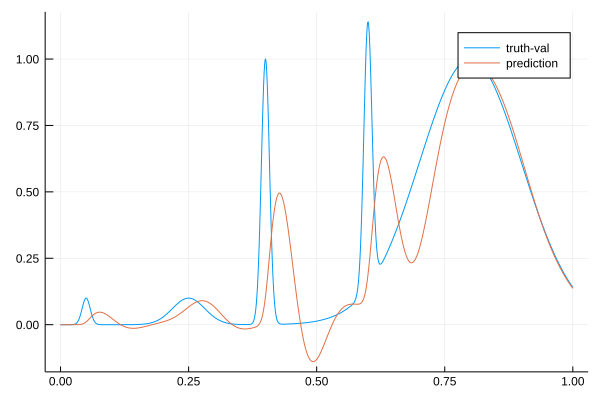

102.6954564900492 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.051769860221185
  47.44255832678576 
 -10.399413138727503
  55.348457612377366
 -37.413344689374235
   0.1              

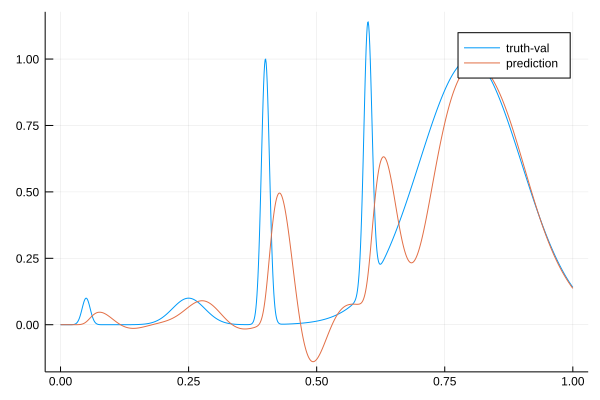

102.67692838237026 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.06935362456804 
  47.461275314944615
 -10.40325907403862 
  55.38545071894485 
 -37.467193847622376
   0.1              

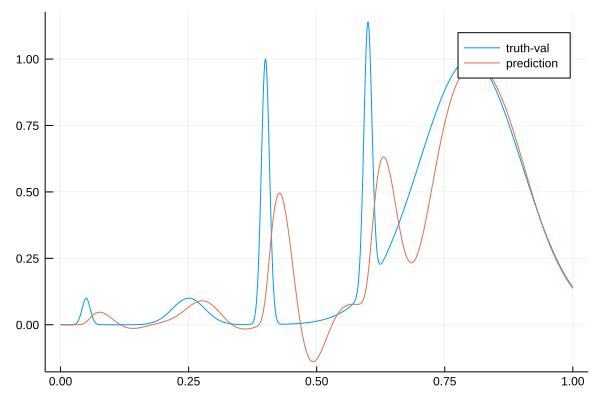

102.6583505890145 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.086389096250194
  47.480300496784466
 -10.406784906399306
  55.422449298432966
 -37.52103107462913 
   0.1              

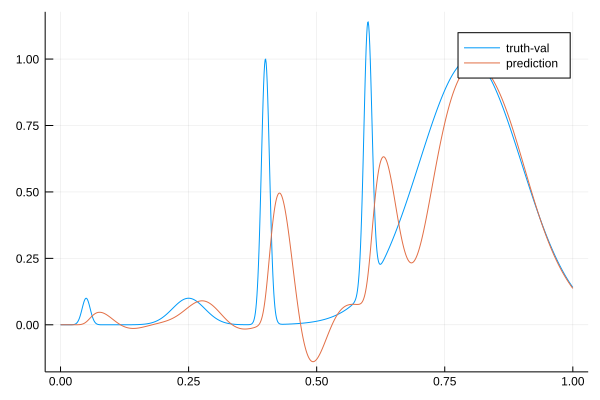

102.63977141826638 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.10292953230979 
  47.499604833172434
 -10.409981837638115
  55.45945276869346 
 -37.5748786916298  
   0.1              

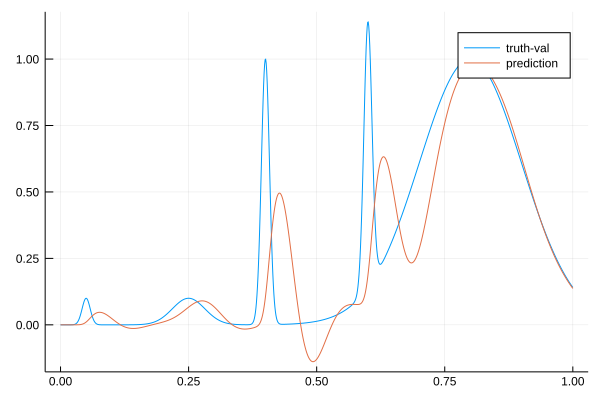

102.62089397679493 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.11725644804248 
  47.52046240675583 
 -10.411895771217166
  55.49692336480159 
 -37.62835178771717 
   0.1              

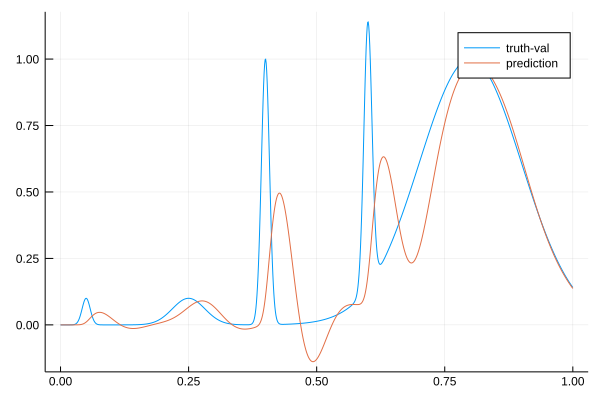

102.60197223750772 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.13135600264869 
  47.54148304507191 
 -10.413562062236704
  55.534434762375064
 -37.68188603990105 
   0.1              

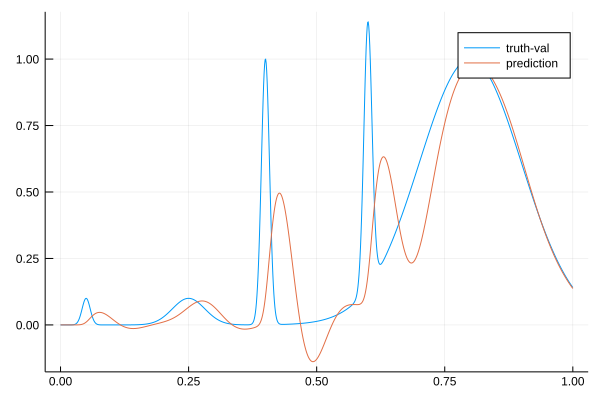

102.58292110371261 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.145251111082715
  47.562681360458946
 -10.414967682727205
  55.572022125531525
 -37.735486344186924
   0.1              

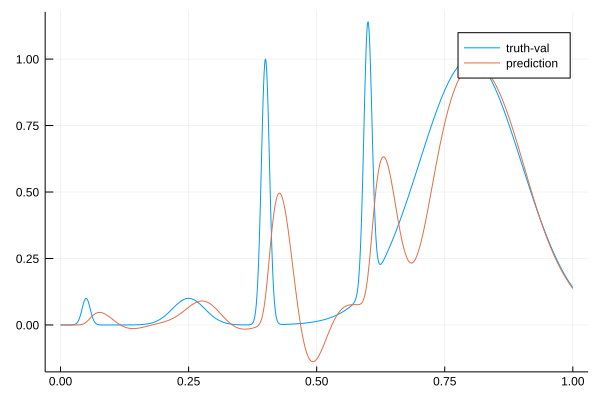

102.56373214518088 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.1589626489775  
  47.58407013387203 
 -10.416101190543165
  55.60971676230168 
 -37.78915771583066 
   0.1              

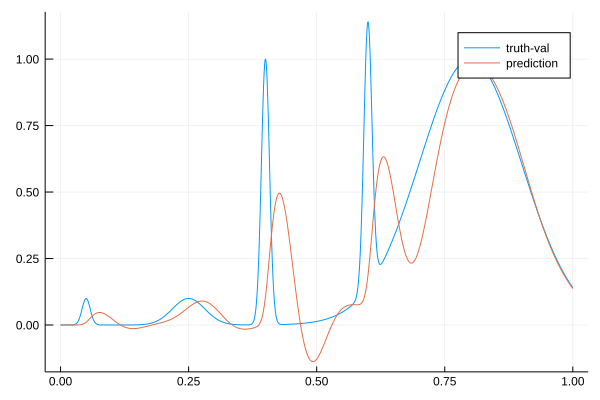

102.54438625618386 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.171906570241276
  47.60607334899707 
 -10.416908626464197
  55.64766385880361 
 -37.84272540066681 
   0.1              

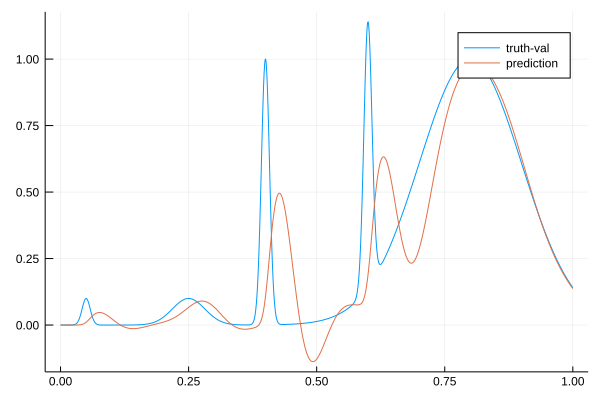

102.52492410035543 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.18416000825638 
  47.62865924261534 
 -10.417386176731924
  55.68587592534429 
 -37.896213639531204
   0.1              

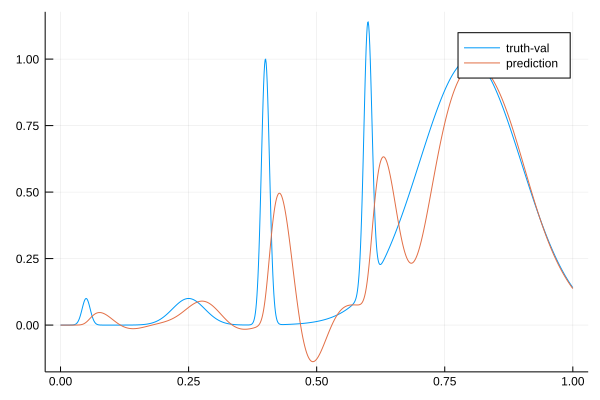

102.50587780247636 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.1981613657086  
  47.65012279653484 
 -10.418517984520967
  55.723832280397986
 -37.950218301086046
   0.1              

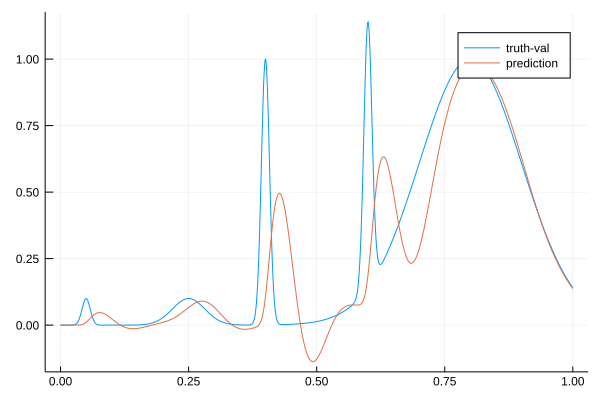

102.48676112620589 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.21325082748457 
  47.67095978220378 
 -10.420171020015692
  55.76171857177896 
 -38.00436278768992 
   0.1              

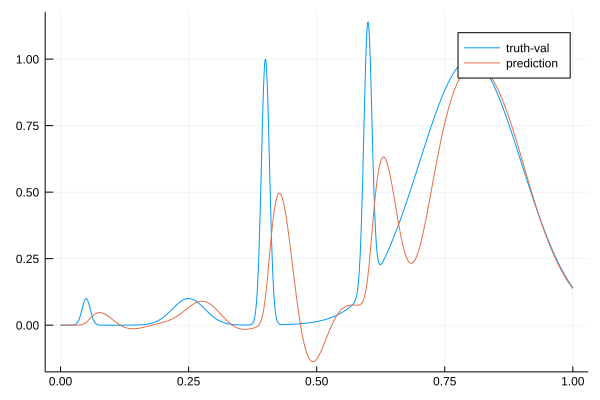

102.46748351827573 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.22932114523767 
  47.691264624177705
 -10.422255574305444
  55.799583051393206
 -38.05864151523147 
   0.1              

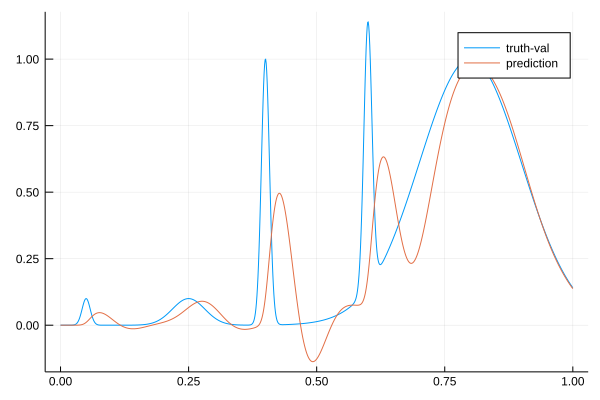

102.44805327894358 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.24627555664962 
  47.71112344138172 
 -10.424690199803537
  55.83747043898113 
 -38.11304705181028 
   0.1              

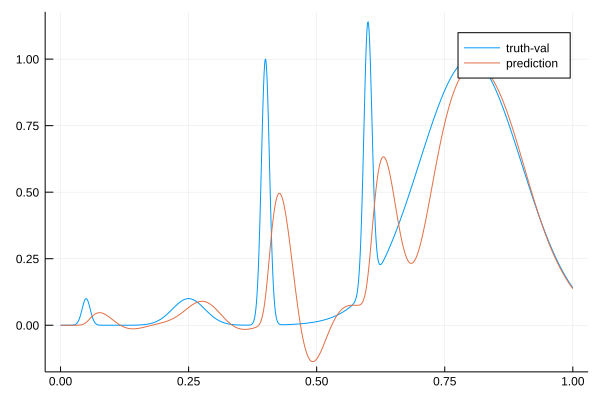

102.4284699596133 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.264026781773346
  47.73061470171321 
 -10.427400996067705
  55.875422070788254
 -38.167570695517355
   0.1              

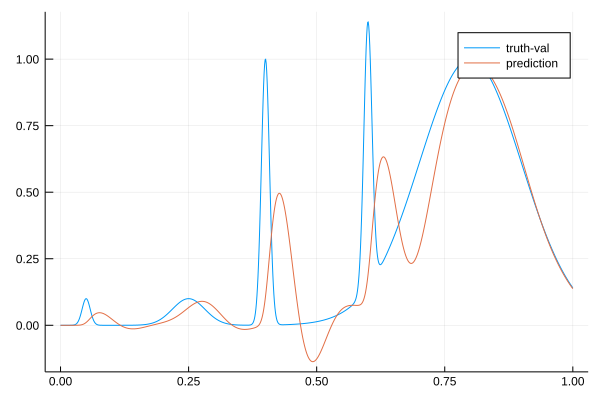

102.40883030080532 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.28249612488379 
  47.74980982966922 
 -10.430320965471124
  55.91347606176126 
 -38.22220295554989 
   0.1              

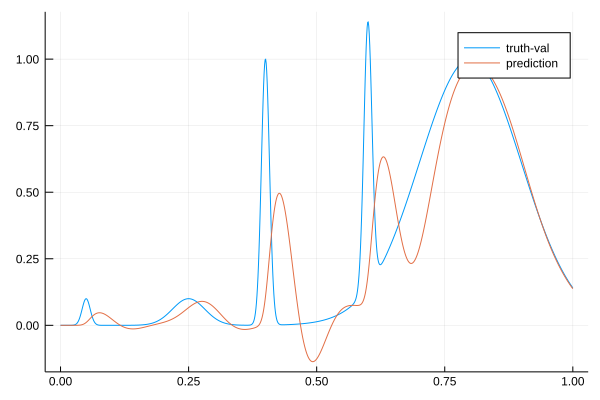

102.38911005501916 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.2998442251708  
  47.770034452016304
 -10.4324447421879  
  55.9520752126931  
 -38.27654487248903 
   0.1              

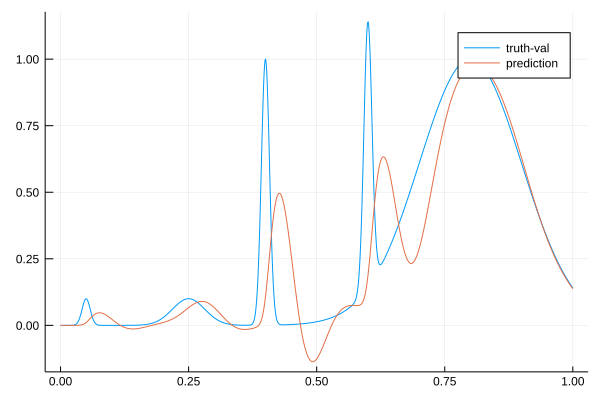

102.36915736196221 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.31558512459105 
  47.79163024450344 
 -10.433768861901429
  55.99132547059276 
 -38.33044988999877 
   0.1              

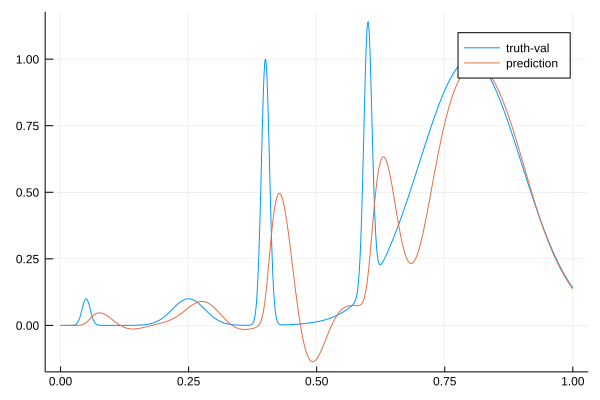

102.34922628306816 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.33164986423146 
  47.81323209648626 
 -10.435281936834468
  56.030795696787855
 -38.38436002461861 
   0.1              

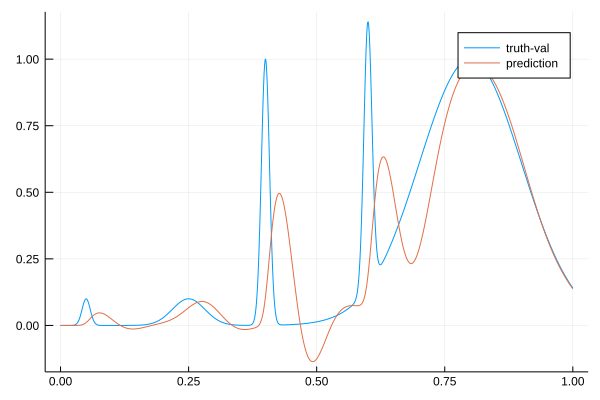

102.32928555219563 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.348008353165895
  47.8348708839885  
 -10.436929463475332
  56.07050484702617 
 -38.43828385163453 
   0.1              

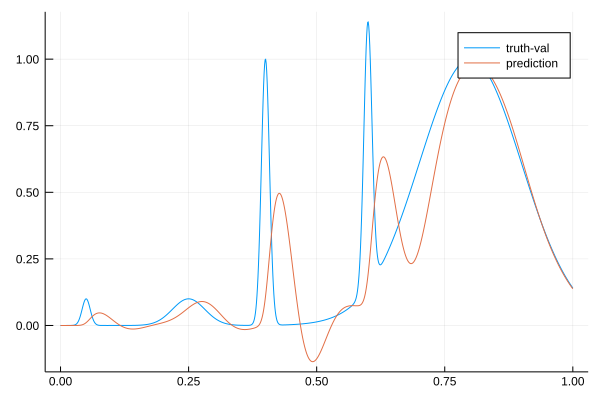

102.30927363235136 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0             
   0.001           
   0.001           
  38.36458211475594
  47.85640978902011
 -10.43867285112294
  56.1102201696358 
 -38.49239906032584
   0.1             

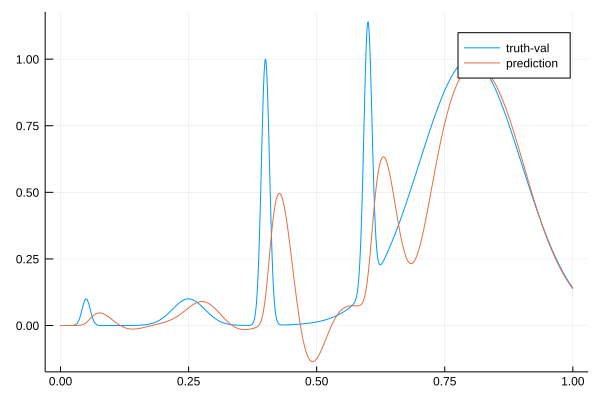

102.28911212203988 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.38135181372833 
  47.87789133707301 
 -10.440466640461562
  56.14998339337053 
 -38.54669451650583 
   0.1              

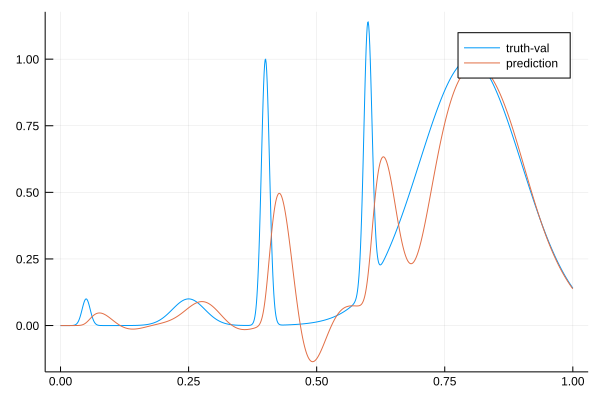

102.26903218511407 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.398300069183044
  47.899354133321395
 -10.44226965334124 
  56.1898324765762  
 -38.60115953096049 
   0.1              

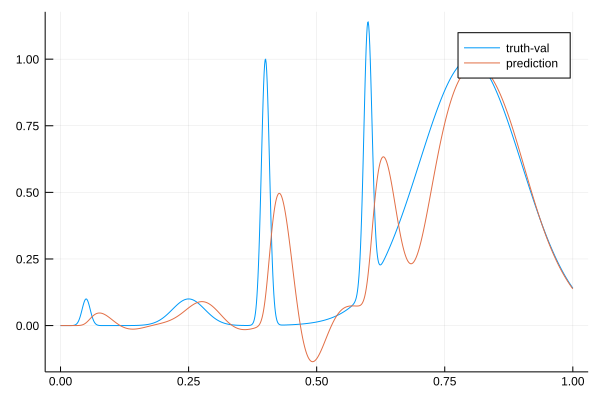

102.2489007654843 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.41552528224004 
  47.920774453478415
 -10.444058114048401
  56.229804934950906
 -38.655632773997   
   0.1              

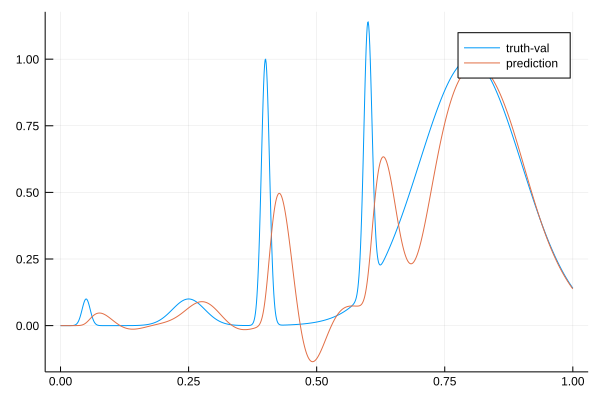

102.22858370741362 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.43300203929222 
  47.942189357375334
 -10.445797217284346
  56.26993105594585 
 -38.710120774501476
   0.1              

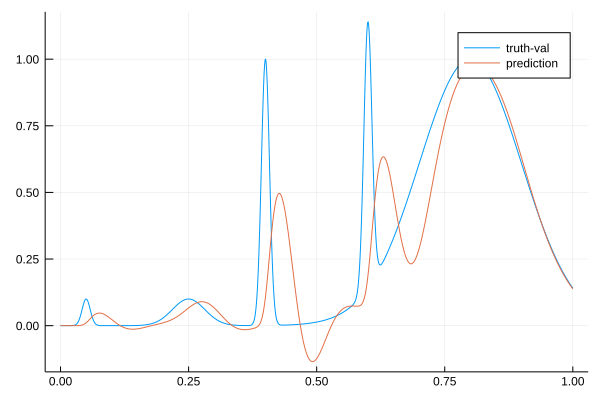

102.20815347690184 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.45070766741871 
  47.963632219503175
 -10.447455811759829
  56.31023821577669 
 -38.764629241121554
   0.1              

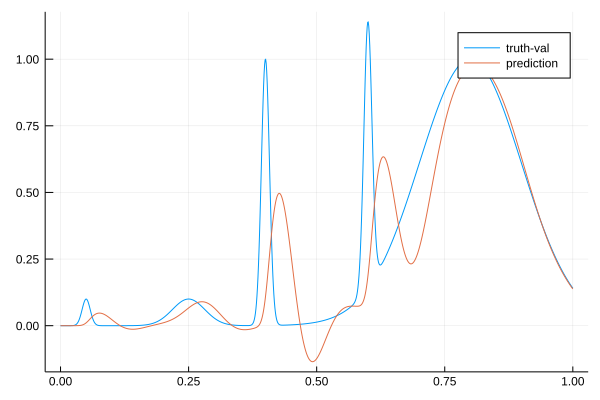

102.18764934333413 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.468030197393745
  47.98554111903447 
 -10.448962495852369
  56.35086933245952 
 -38.818981834721534
   0.1              

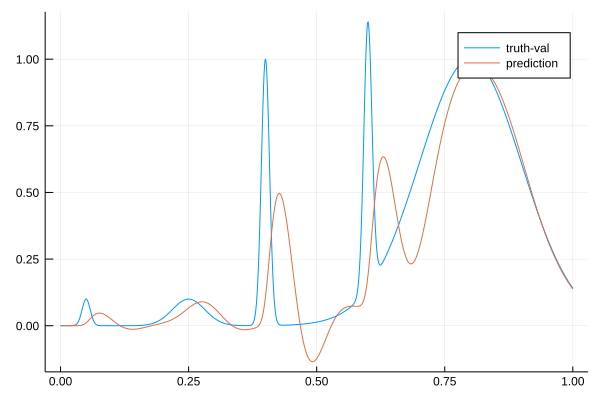

102.16696360742219 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.48501021923975 
  48.007902158087916
 -10.450297151581324
  56.39183431296511 
 -38.87320228414326 
   0.1              

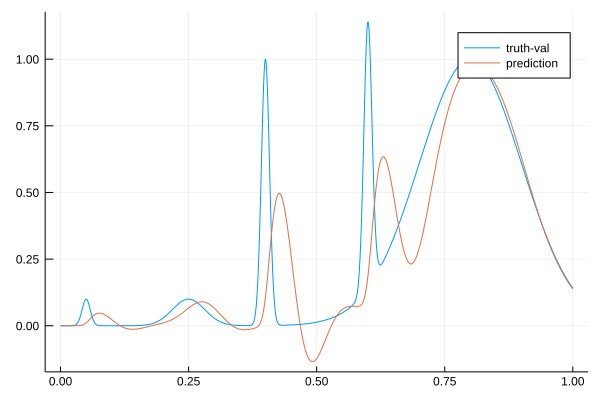

102.14611736483525 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.501684822136504
  48.03070203130345 
 -10.451442614058452
  56.43314138245687 
 -38.927313179819954
   0.1              

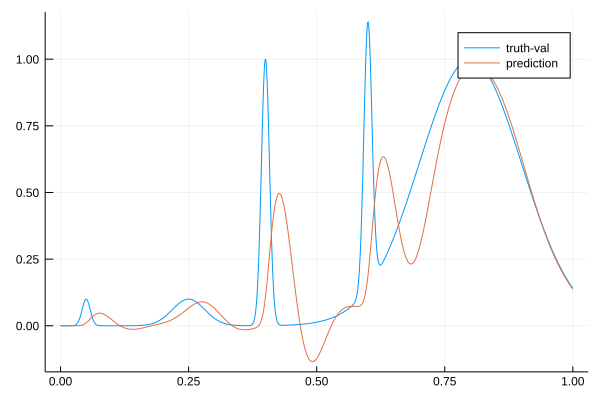

102.12510748098421 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.51808788674245 
  48.05392802764603 
 -10.452384275443455
  56.47479729185784 
 -38.98133607107796 
   0.1              

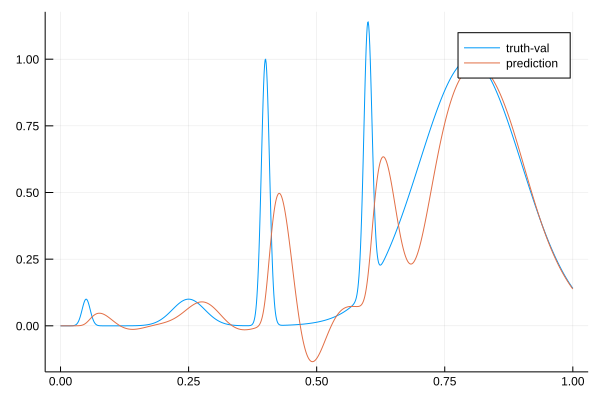

102.10480384762424 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.534915808728734
  48.07695996135141 
 -10.453398028415622
  56.51648139074334 
 -39.03529364050824 
   0.1              

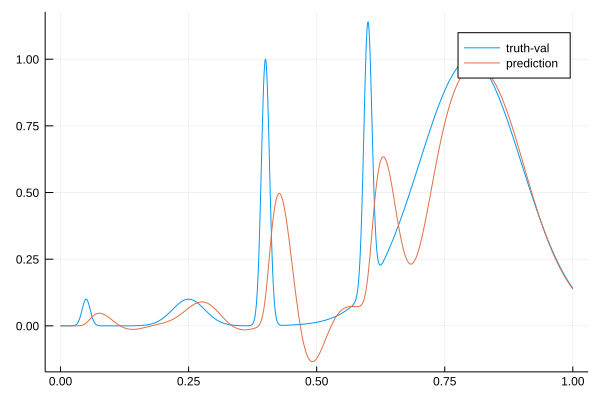

102.08439156551913 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.55213015592198 
  48.09984727078081 
 -10.45444426048592 
  56.5582309147722  
 -39.089203890324534
   0.1              

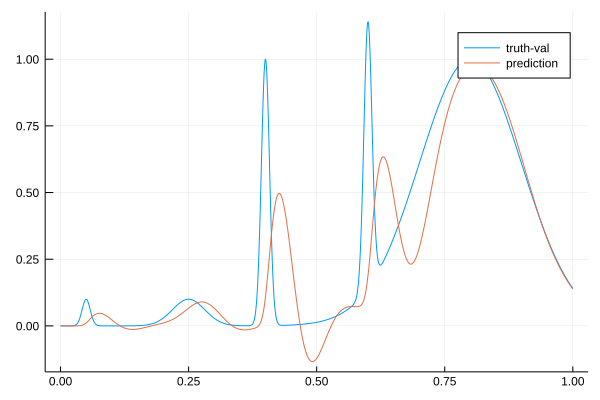

102.06385734392724 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0             
   0.001           
   0.001           
  38.56969640463014
  48.12263466325478
 -10.45548732789893
  56.60007965390164
 -39.14308243602095
   0.1             

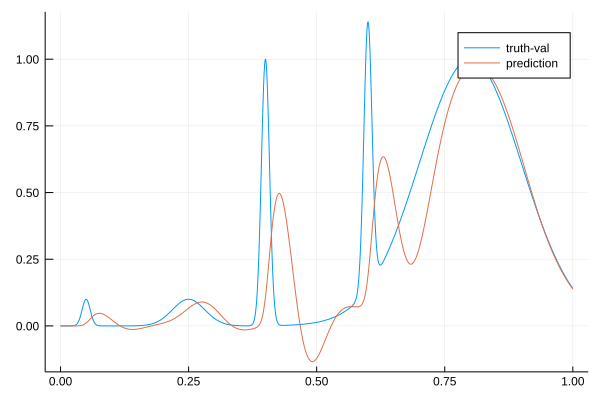

102.04354622061658 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.58758357955975 
  48.14536252556819 
 -10.456495205542858
  56.64205823527921 
 -39.196942905209774
   0.1              

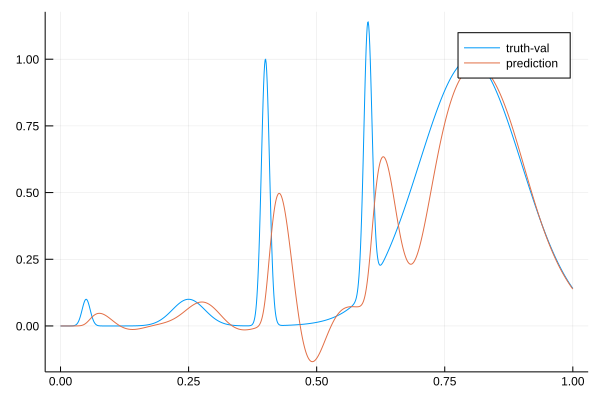

102.02381627785954 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.60591495113758 
  48.16761334774933 
 -10.457537023646736
  56.68371201350464 
 -39.25086926109622 
   0.1              

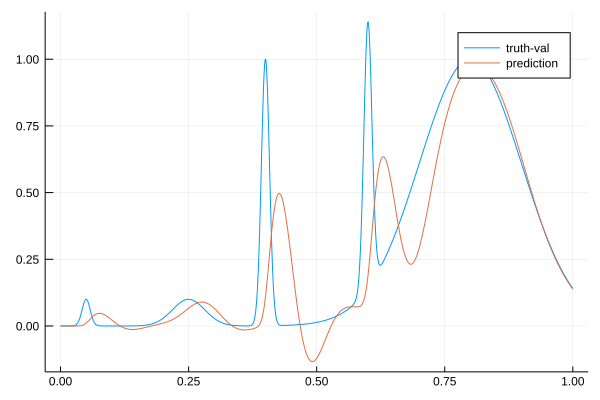

102.00370429820828 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.62464957263009 
  48.18946554410474 
 -10.458576458943273
  56.72511419402116 
 -39.304864941080695
   0.1              

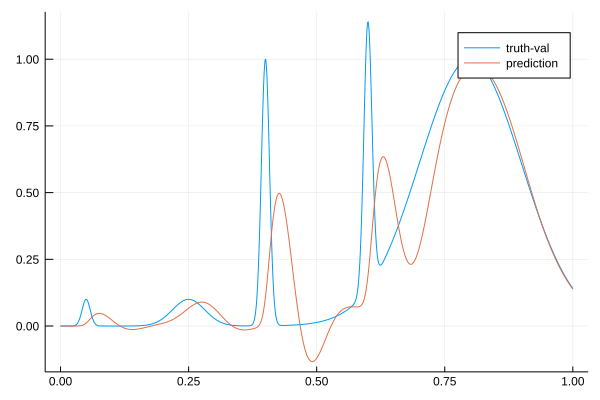

101.98399327412724 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.6431643861048  
  48.21139545274639 
 -10.459536465694924
  56.76644931172619 
 -39.35874984968944 
   0.1              

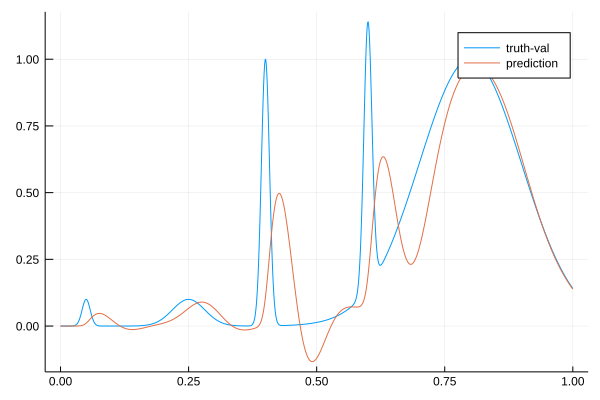

101.96440184362996 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.66143339354049 
  48.233266234909195
 -10.460401592548303
  56.80752265848739 
 -39.41271064478313 
   0.1              

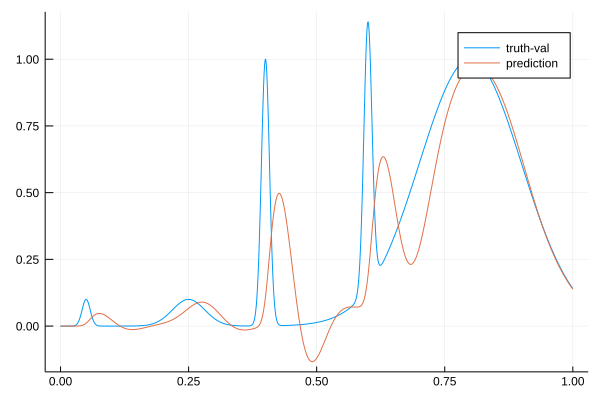

101.94468896654014 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.681257750004626
  48.253866672313194
 -10.462091830469372
  56.84801642901267 
 -39.4671320320299  
   0.1              

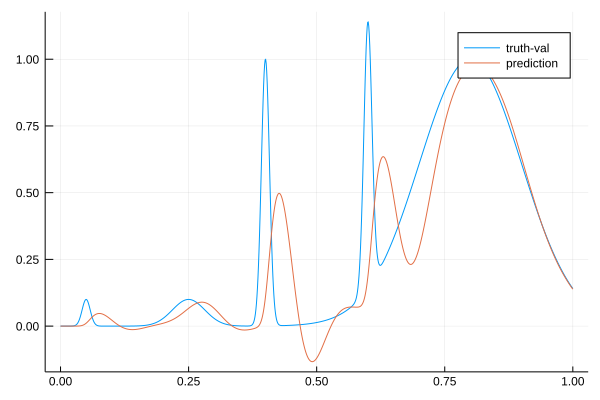

101.92497628970585 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.700710605472956
  48.27460723848701 
 -10.463544839550002
  56.88841916144822 
 -39.52158745108006 
   0.1              

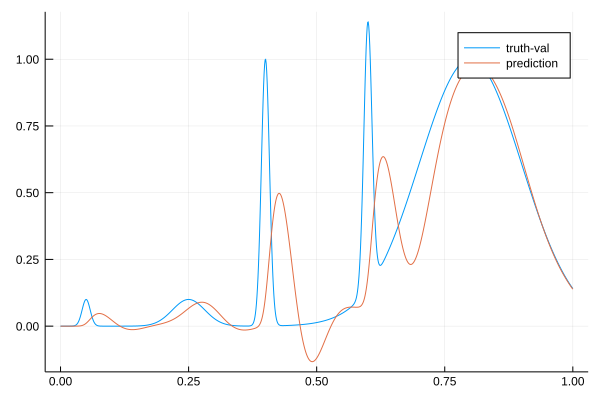

101.90517742325576 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.719830968246725
  48.295474688755   
 -10.464748900656673
  56.928740824565686
 -39.57609592998223 
   0.1              

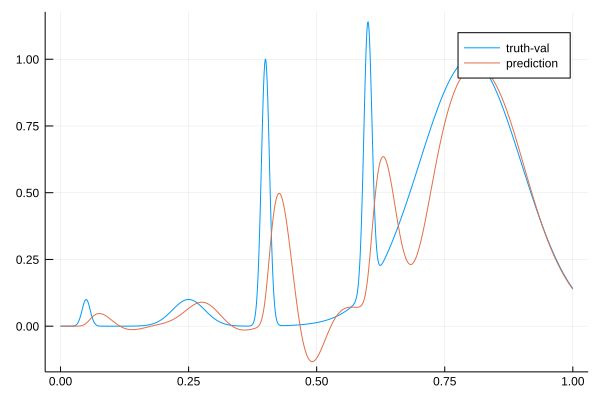

101.88542093912042 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.73865386380993 
  48.316490692597725
 -10.465692941708967
  56.969033662919394
 -39.63065633841562 
   0.1              

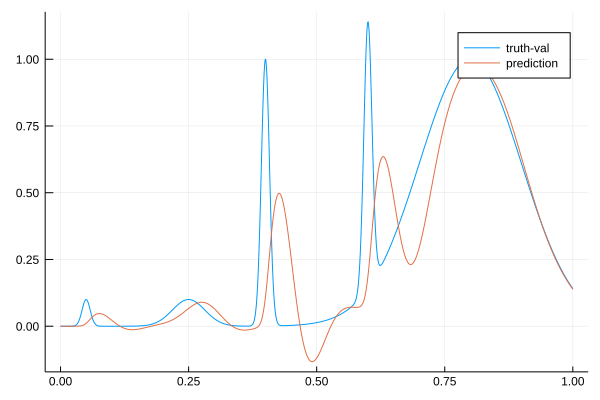

101.86554083351173 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.75663170937707 
  48.3380753498545  
 -10.466325071643821
  57.00946136328381 
 -39.68508722345993 
   0.1              

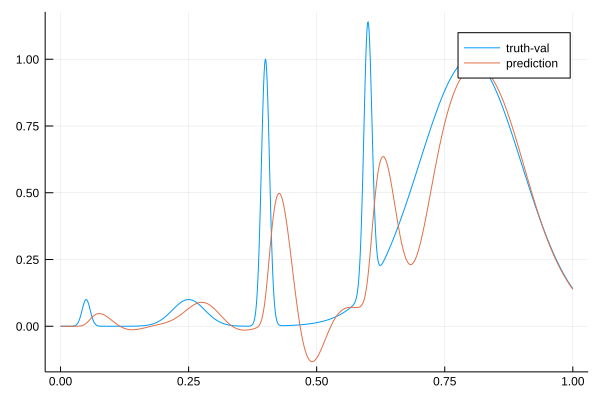

101.84552547713695 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.77385062076466 
  48.36020554287363 
 -10.466641259619049
  57.05005358411785 
 -39.73940757107749 
   0.1              

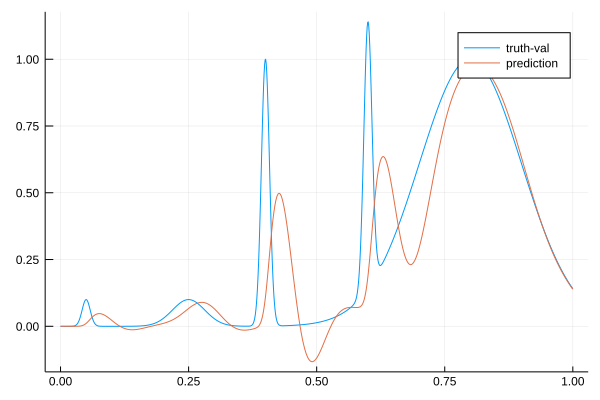

101.82538298491532 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.79038865489607 
  48.38285949367585 
 -10.466638783322015
  57.09083611791432 
 -39.793636018875354
   0.1              

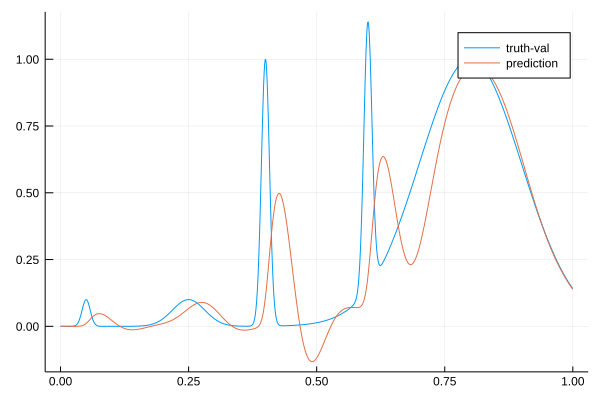

101.80544045970537 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.80631658530882 
  48.40601667880935 
 -10.466316054123043
  57.131831319564746
 -39.84779081896823 
   0.1              

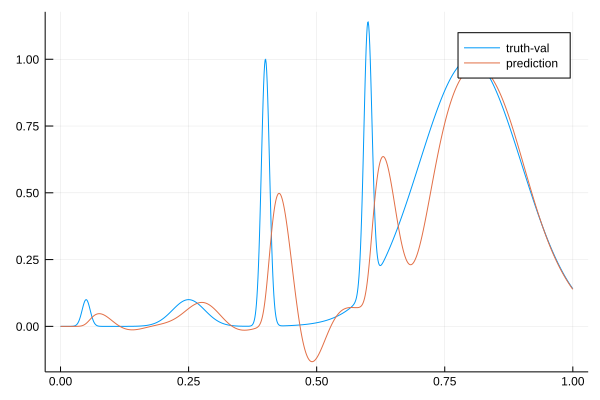

101.78551525847466 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.823587058878665
  48.42835637926329 
 -10.46663201981379 
  57.17268477380935 
 -39.90212455472773 
   0.1              

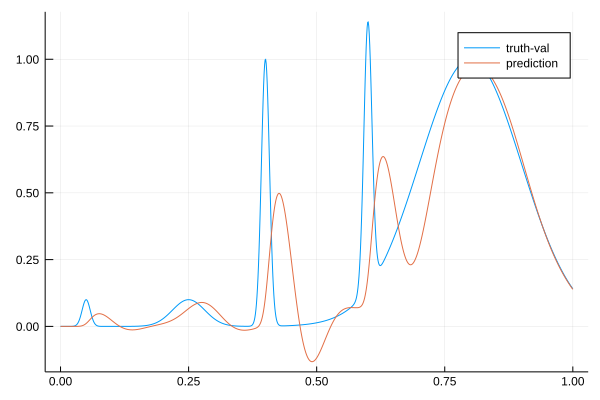

101.76536469335967 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.84207012322602 
  48.449992134738395
 -10.467489901998903
  57.213453210417114
 -39.95662673274942 
   0.1              

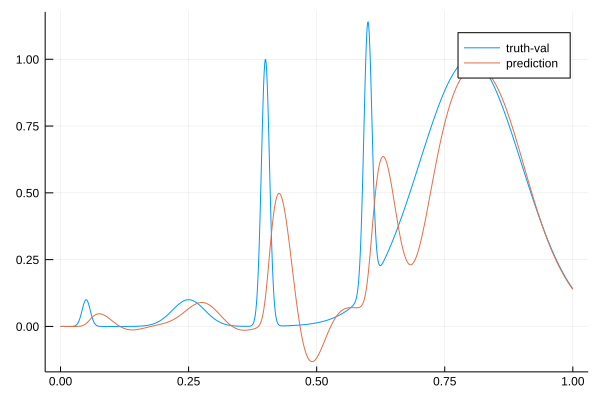

101.74549406681432 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.86164857899376 
  48.47102734806452 
 -10.468801836494476
  57.254189072438486
 -40.011285182408464
   0.1              

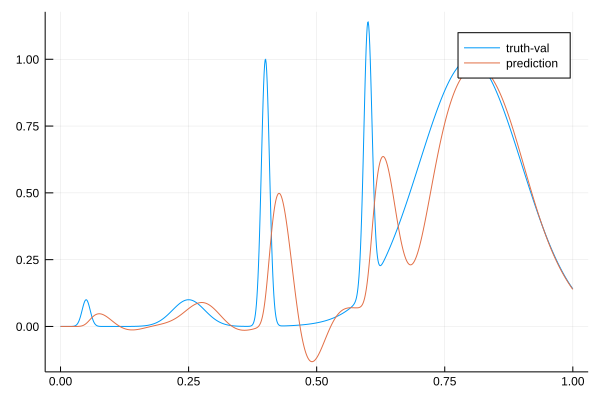

101.72580573043653 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.880947363421186
  48.49209865285738 
 -10.47040897805814 
  57.29476381509225 
 -40.0659935626126  
   0.1              

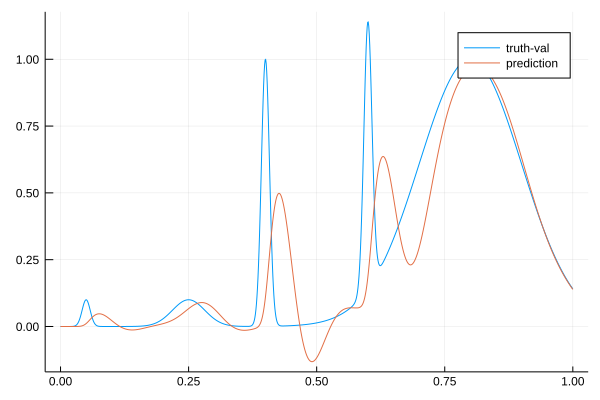

101.70616585621897 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.89999640758526 
  48.513237209029725
 -10.472246979005375
  57.335238243736384
 -40.120748593571584
   0.1              

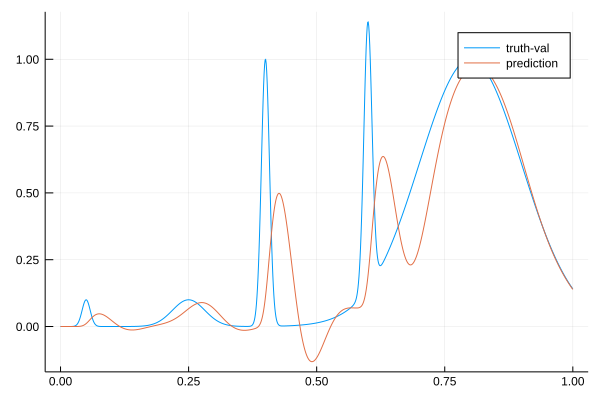

101.68607538522411 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.917040688034916
  48.53571640372665 
 -10.473309179568133
  57.376041754293375
 -40.17516984439579 
   0.1              

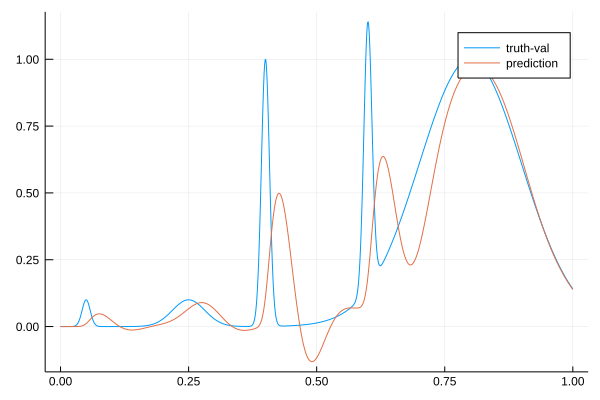

101.66597855135191 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.93406440233927 
  48.55819067142808 
 -10.474587898937672
  57.41681002240419 
 -40.229672713963794
   0.1              

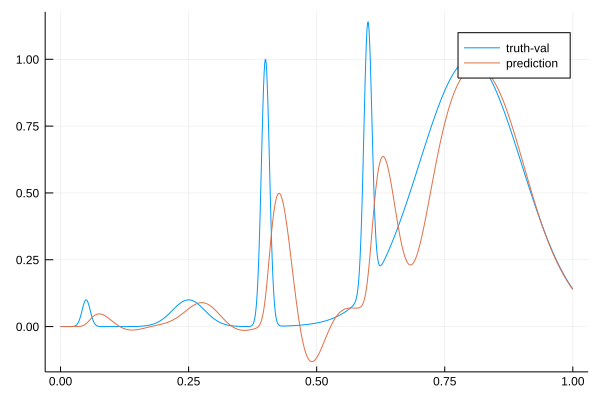

101.64580831744198 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.951072855763115
  48.58069356033946 
 -10.476028284050432
  57.45758981968485 
 -40.284253457328774
   0.1              

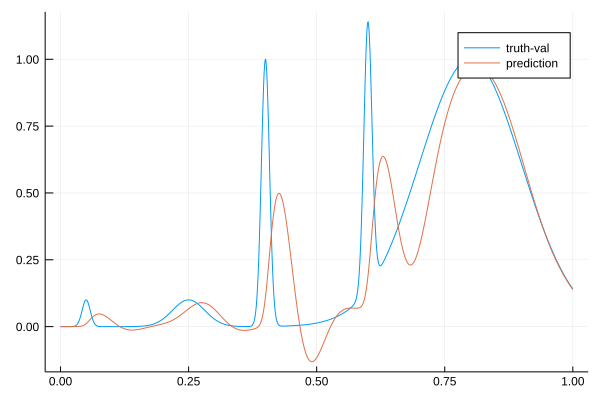

101.62557086153542 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.968070901211405
  48.60325542234262 
 -10.477580914670428
  57.49842345553104 
 -40.33890817285404 
   0.1              

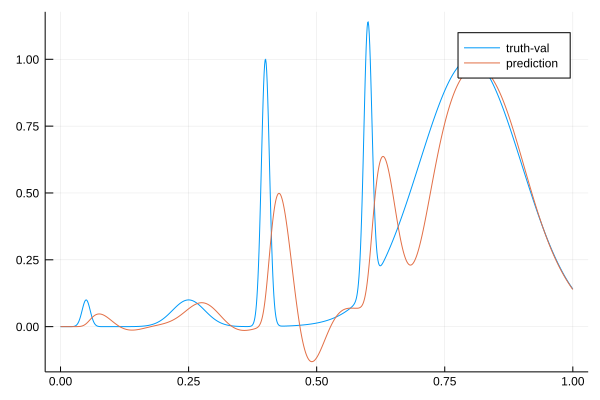

101.6055035352373 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  38.985013342542246
  48.62574685787969 
 -10.479211518115491
  57.539113764235964
 -40.39379640841543 
   0.1              

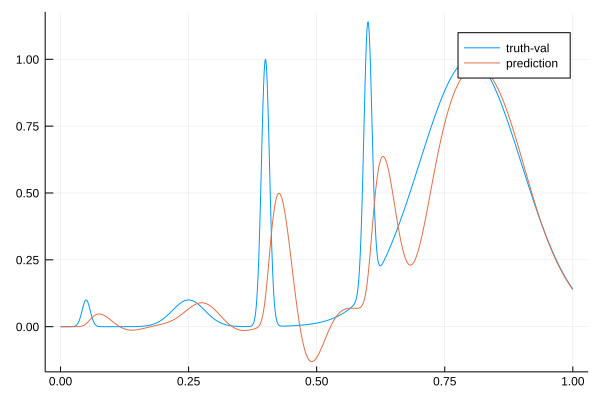

101.58541476543259 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.0013429335968  
  48.648600817826136
 -10.480839052086639
  57.57983367171518 
 -40.448718919876754
   0.1              

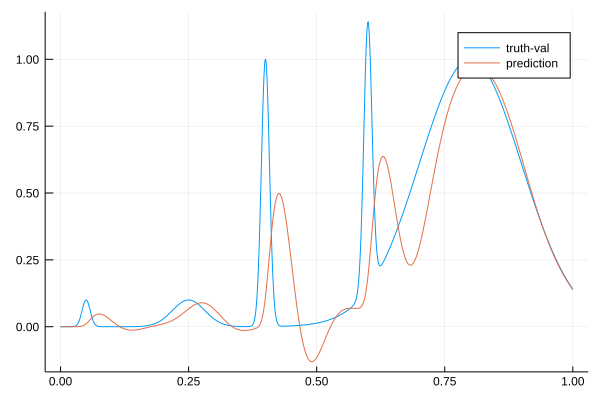

101.56542573795826 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.01723130412531 
  48.67176264388215 
 -10.482442765035225
  57.62063097048725 
 -40.503533244223085
   0.1              

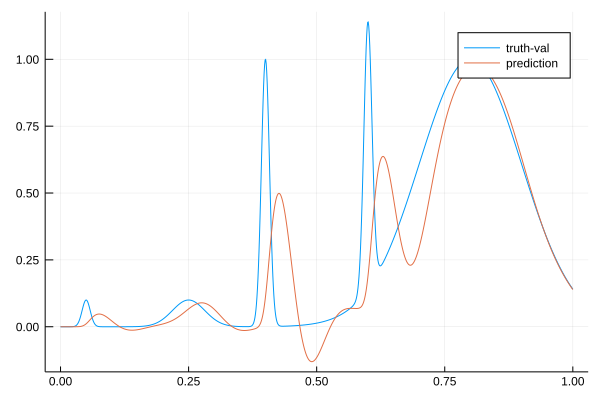

101.54531990199999 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.032725426039725
  48.695235096012304
 -10.483991823122503
  57.66154147221176 
 -40.55825454020716 
   0.1              

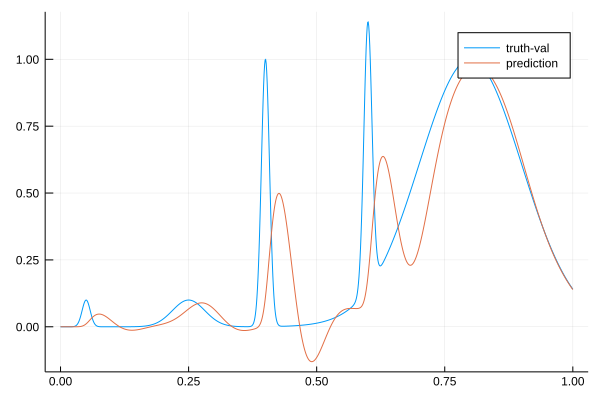

101.52507905892396 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.0478679100968  
  48.71902024003001 
 -10.485458938579038
  57.70259706665809 
 -40.61289699053814 
   0.1              

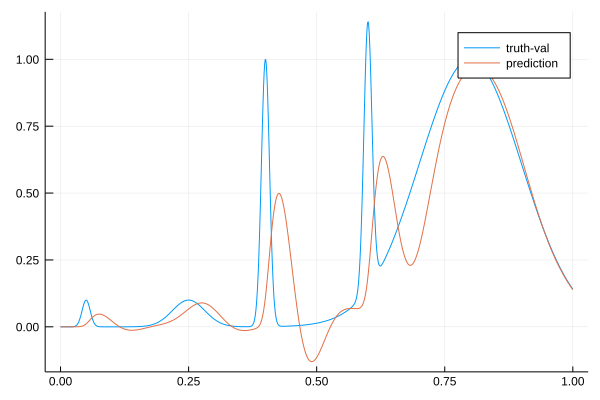

101.50468508962298 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.062697451181684
  48.74311951388747 
 -10.486820018285016
  57.74382611556243 
 -40.66747392961126 
   0.1              

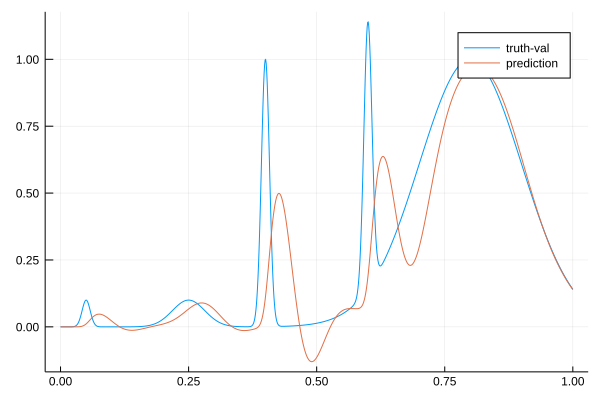

101.48412970383662 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.07724922663341 
  48.76753378697575 
 -10.488053839101713
  57.78525380498379 
 -40.72199794801398 
   0.1              

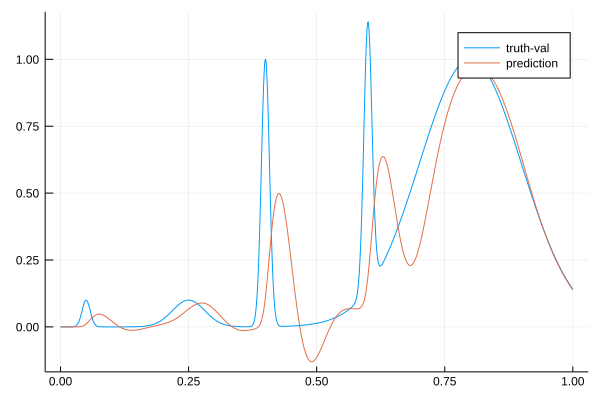

101.46337922691909 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0             
   0.001           
   0.001           
  39.09155524788153
  48.79226341598949
 -10.48914175529931
  57.82690246094034
 -40.77648098546209
   0.1             

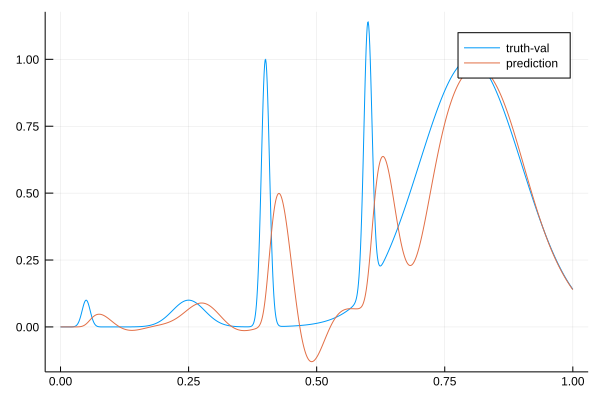

101.4428832885075 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.10564454187122 
  48.817308577071195
 -10.490067015761161
  57.868792101939135
 -40.83093441263143 
   0.1              

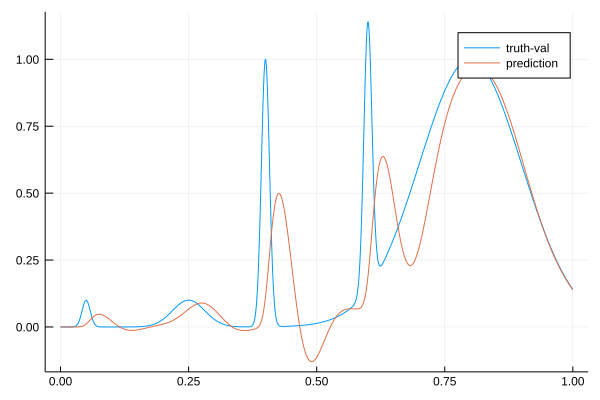

101.42204488060855 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.12132656210766 
  48.841433444674166
 -10.491760685872162
  57.91057930611137 
 -40.885742290818065
   0.1              

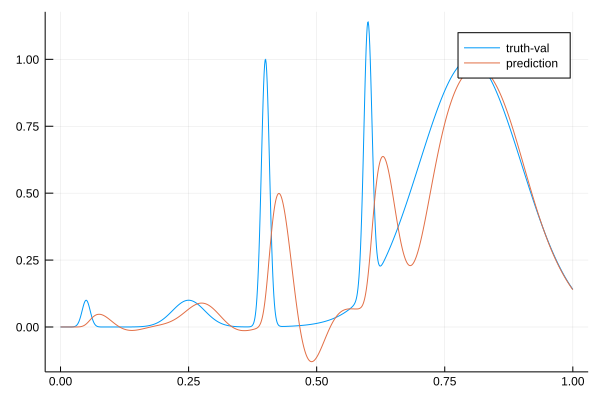

101.40103265839149 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.13844819968742 
  48.86476222712088 
 -10.494115138652214
  57.95231825513953 
 -40.9408728130157  
   0.1              

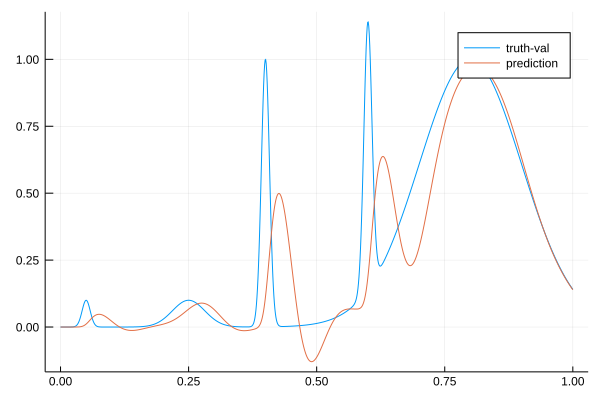

101.3798001373464 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.15687126466334 
  48.887408314401554
 -10.49703251119007 
  57.99405948426665 
 -40.99629438931932 
   0.1              

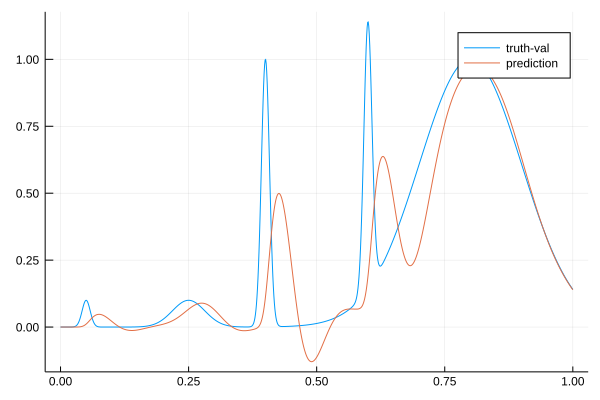

101.35846435035212 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.17647115059217 
  48.90947487159232 
 -10.500424020442855
  58.03584971986938 
 -41.05197602536772 
   0.1              

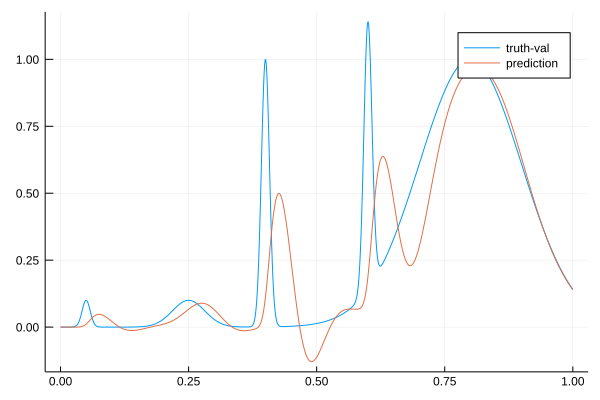

101.33717838471367 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.19724120011285 
  48.931004873717   
 -10.504221500776156
  58.07773940937943 
 -41.10774833771274 
   0.1              

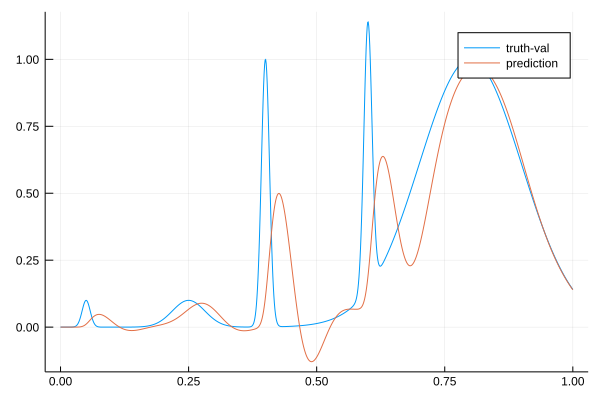

101.31603891796323 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.21850871284063 
  48.95247645701565 
 -10.50831147623361 
  58.119879365831935
 -41.16341943404735 
   0.1              

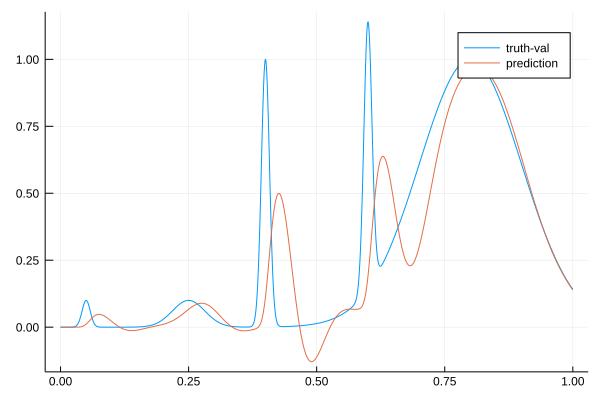

101.29553086257178 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0             
   0.001           
   0.001           
  39.23848164390379
  48.97477074540214
 -10.51176970352275
  58.16217047452927
 -41.21884621455235
   0.1             

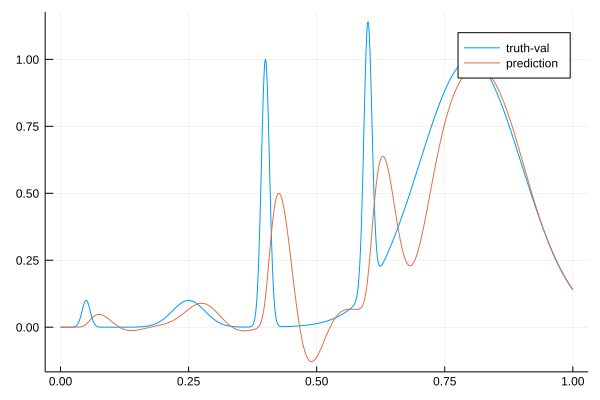

101.27485092681928 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.25729180324101 
  48.99784217739301 
 -10.514625196875865
  58.204644548943214
 -41.27405073239253 
   0.1              

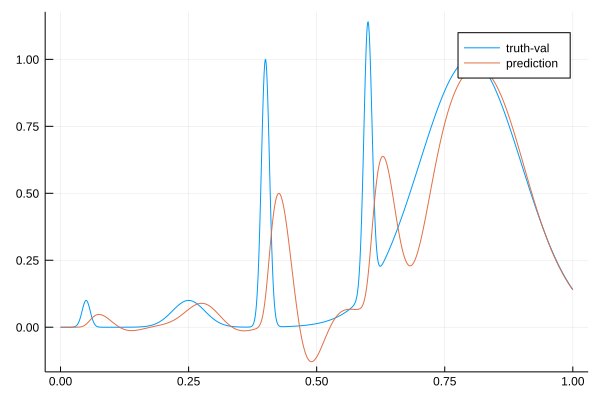

101.25409761705691 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.27505853371095 
  49.021648379841224
 -10.516905274618049
  58.24732894538645 
 -41.329055220029446
   0.1              

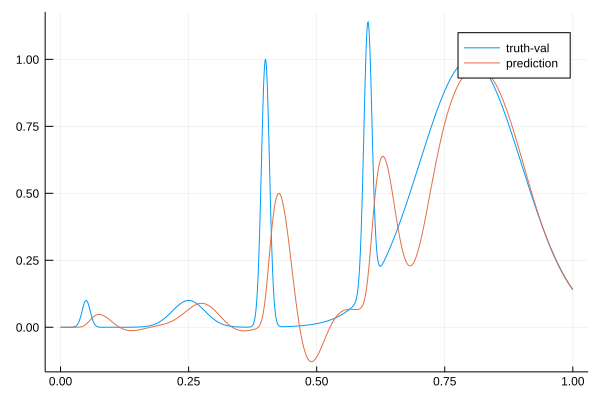

101.23362578573551 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.291841027693366
  49.045997486366204
 -10.518645719797197
  58.290019309746256
 -41.38404211695895 
   0.1              

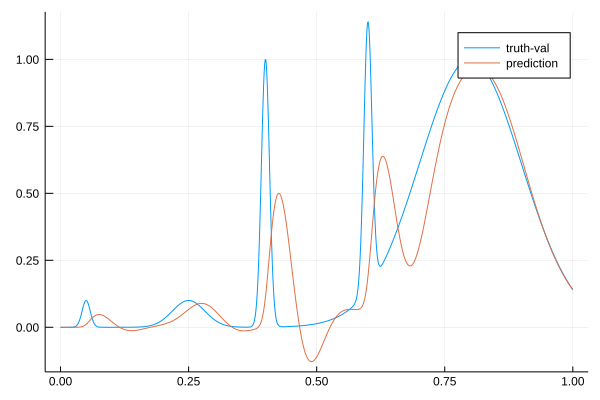

101.21368871867493 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.3084111784401  
  49.07024862253288 
 -10.520167647607469
  58.33242468553331 
 -41.43902320483994 
   0.1              

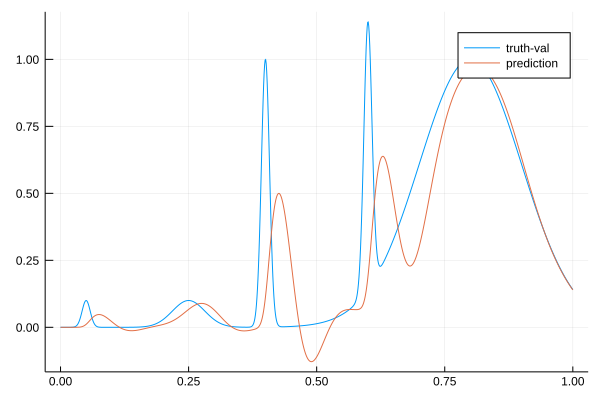

101.19378444658953 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0             
   0.001           
   0.001           
  39.32602964570161
  49.09359384970042
 -10.5223736586389 
  58.37437482384252
 -41.49419485776513
   0.1             

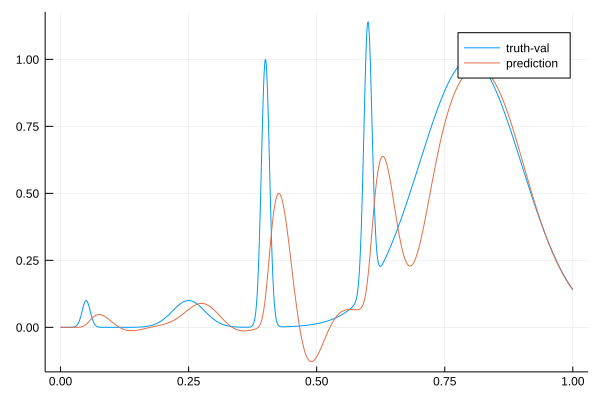

101.17376843713765 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.344596657331735
  49.116124124327904
 -10.525164679748046
  58.415917956782124
 -41.549557468129656
   0.1              

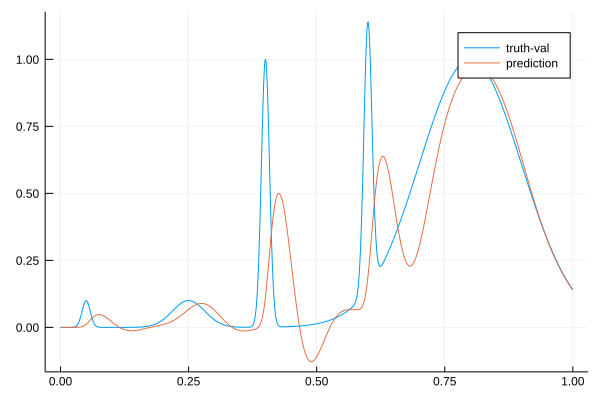

101.15375334056839 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.364021843183004
  49.13795631231416 
 -10.528450012296997
  58.45714171455992 
 -41.60508959209723 
   0.1              

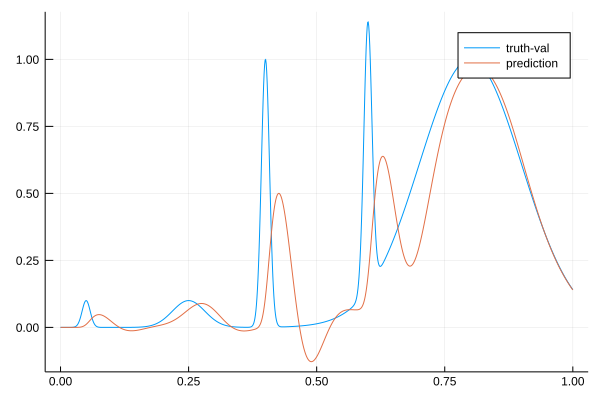

101.13371452192251 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.38243254804718 
  49.16042982268442 
 -10.531196259845915
  58.49847648724781 
 -41.660403853250706
   0.1              

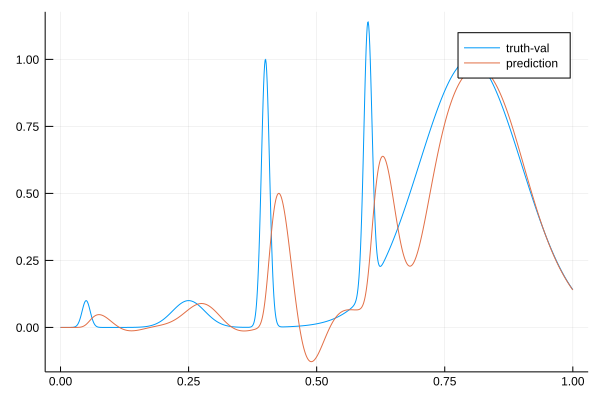

101.11379715768287 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.39993278211519 
  49.183516693549265
 -10.533423785673204
  58.539957549746966
 -41.71551970760296 
   0.1              

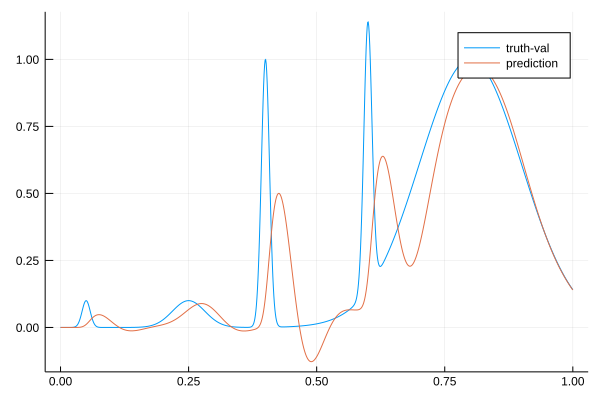

101.09384467648914 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.416173559959205
  49.20751857642904 
 -10.535128002122608
  58.581731581931834
 -41.770146585668215
   0.1              

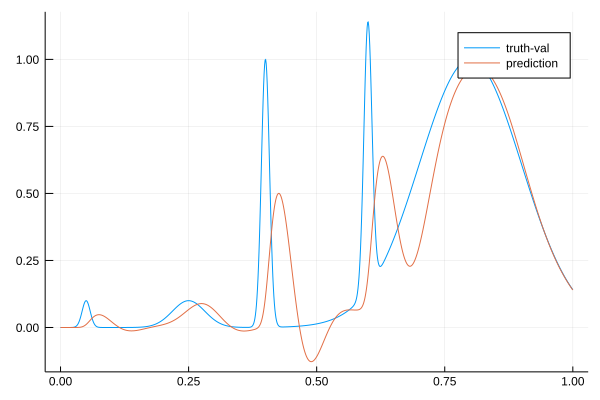

101.07394260644276 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.43307718580449 
  49.23114550551465 
 -10.537281976910165
  58.62346463508436 
 -41.82470042205689 
   0.1              

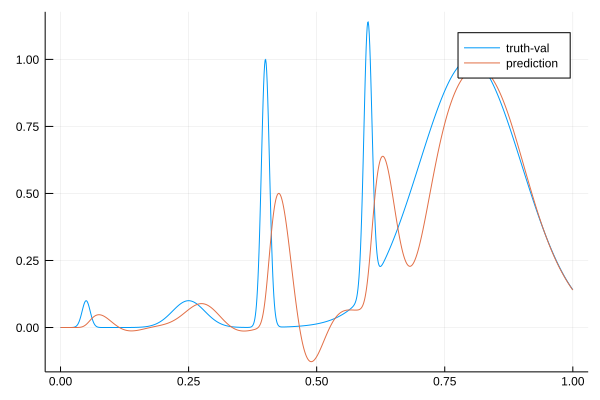

101.05393829524742 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.450582319602525
  49.254468681216494
 -10.539810280865781
  58.665205553066805
 -41.87918943425537 
   0.1              

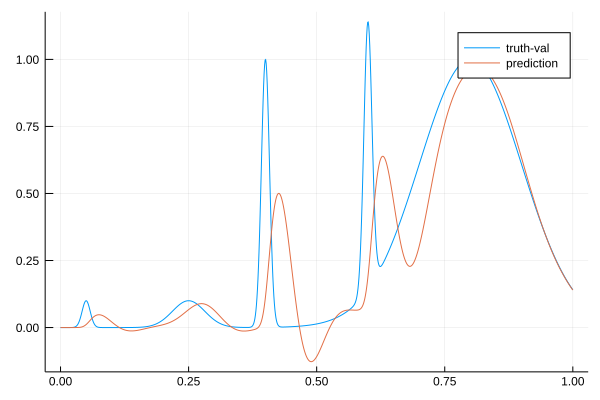

101.03382665235213 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.46863376514805 
  49.27755259117447 
 -10.542644940301985
  58.70699877972842 
 -41.93361979120145 
   0.1              

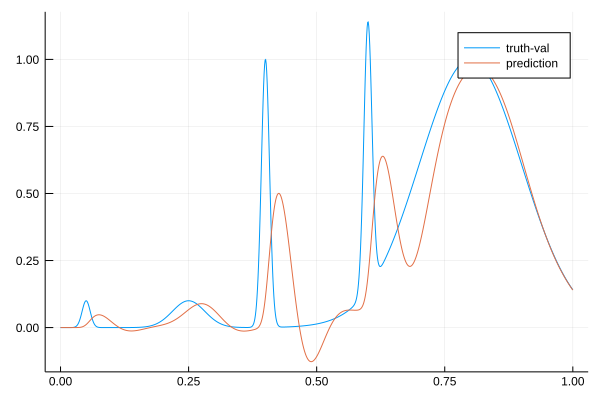

101.01360257455698 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.487181881012376
  49.300455604825906
 -10.545724741394952
  58.748884715418484
 -41.98799604926609 
   0.1              

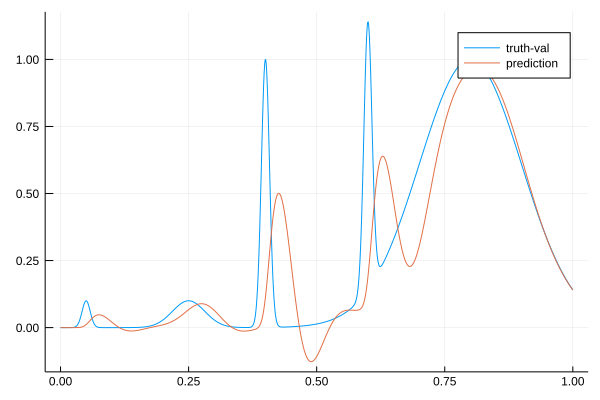

100.99326066107521 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.506182049195026
  49.323230515842326
 -10.54899460129729 
  58.79090004669244 
 -42.04232152060743 
   0.1              

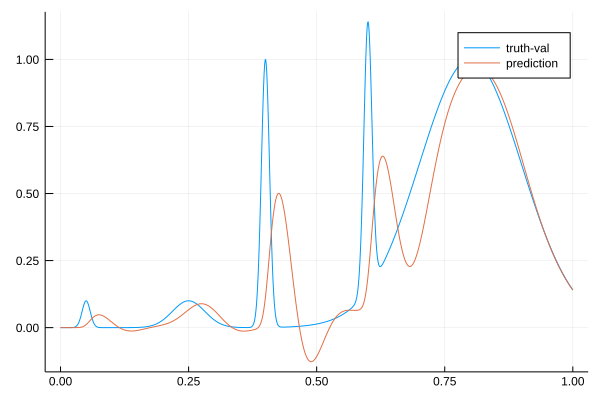

100.97294381377057 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.52559419602996 
  49.345925037038   
 -10.552404999536668
  58.83307805129487 
 -42.09659858283114 
   0.1              

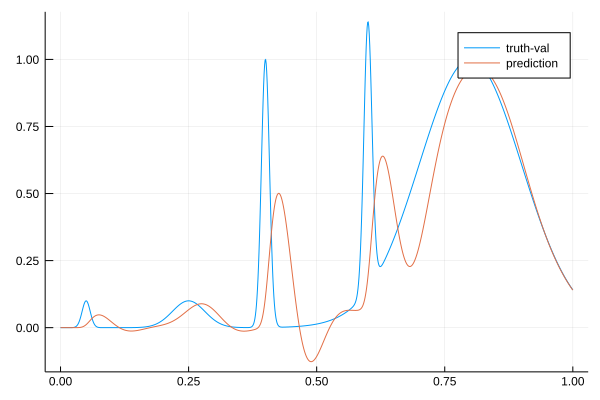

100.9523860199415 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.543045395132495
  49.37018494128398 
 -10.554922556846053
  58.875898054222816
 -42.15029640193519 
   0.1              

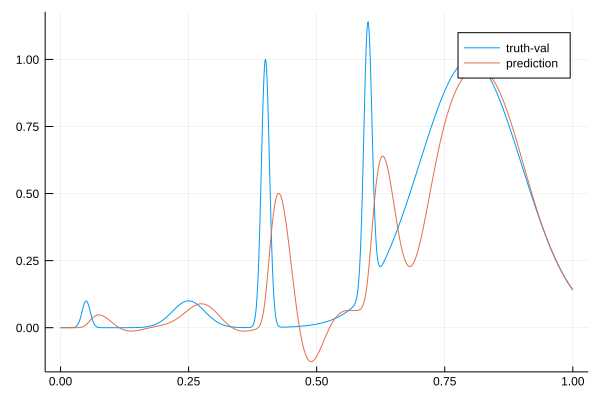

100.9317562098471 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.56053292139786 
  49.39465703240023 
 -10.557561518948189
  58.91899672775994 
 -42.20383517751781 
   0.1              

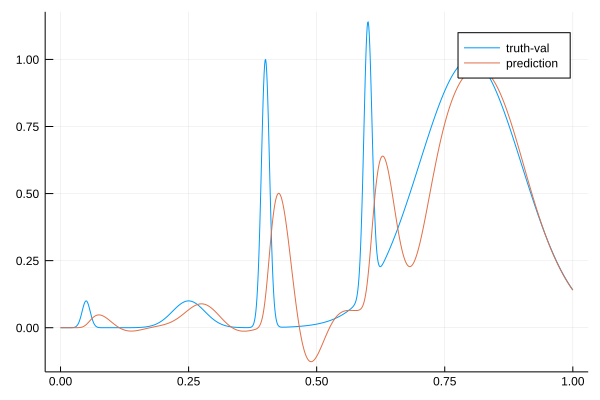

100.91105642884581 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0             
   0.001           
   0.001           
  39.57805905596548
  49.41935324689288
 -10.56028164352676
  58.9623905184251 
 -42.25723233075071
   0.1             

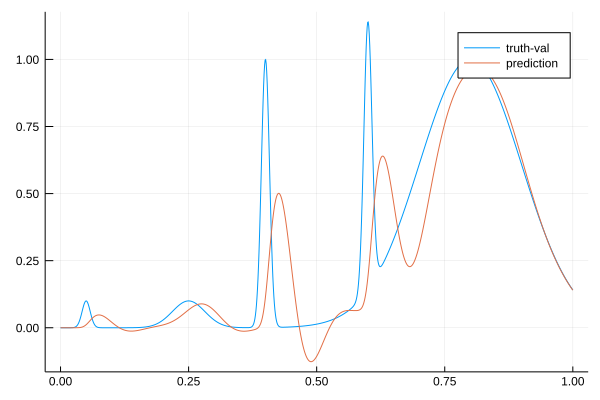

100.89048503725107 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.59557821931554 
  49.4441349419906  
 -10.563057198282593
  59.00587254068523 
 -42.310660870867665
   0.1              

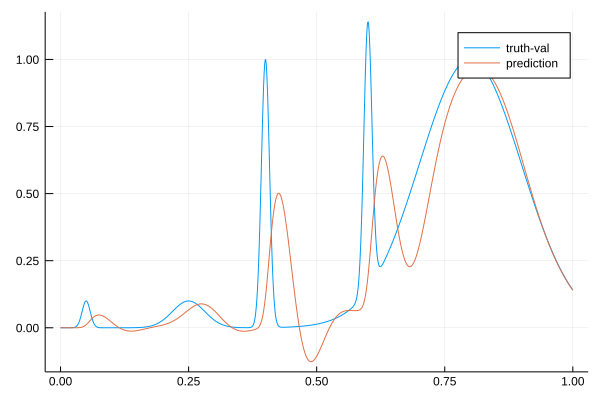

100.86994576154297 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.61319911490981 
  49.46897969973262 
 -10.565866856451466
  59.04948788650163 
 -42.36398546793168 
   0.1              

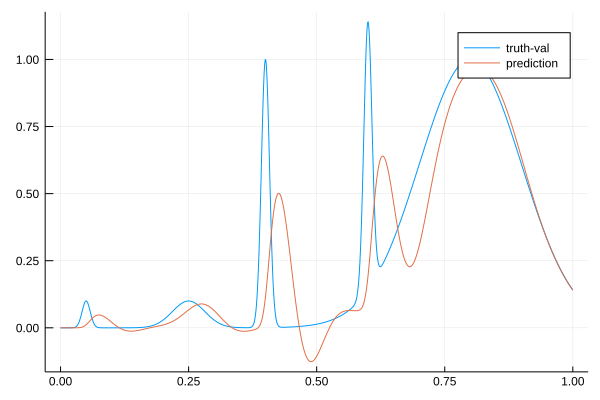

100.84928593725468 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.630917815596106
  49.493914207970455
 -10.568679848108262
  59.093267558196324
 -42.417218919990596
   0.1              

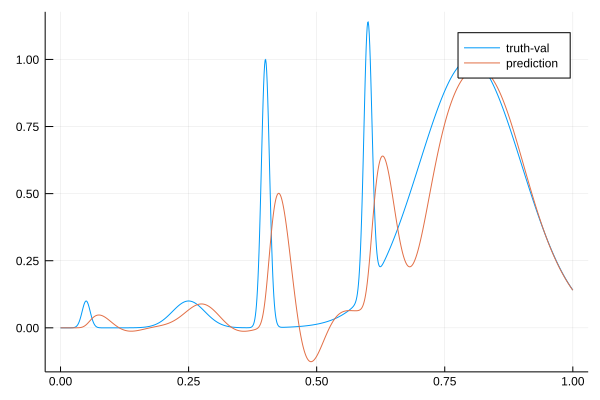

100.82849595265228 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.64873099357967 
  49.51896239590974 
 -10.571468750550554
  59.137239434391304
 -42.47037279151529 
   0.1              

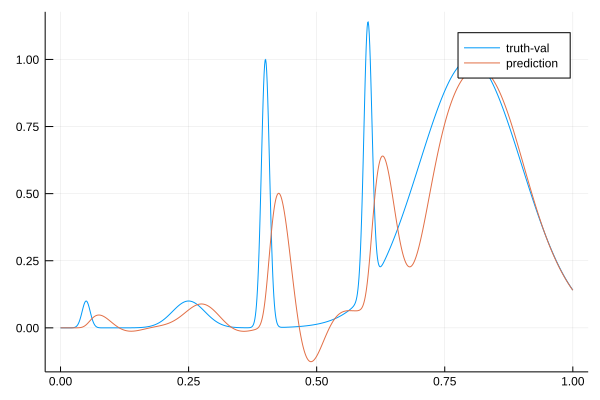

100.80756668374067 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.66663587321114 
  49.5441456912335  
 -10.574209170097065
  59.181428566318914
 -42.52345761075423 
   0.1              

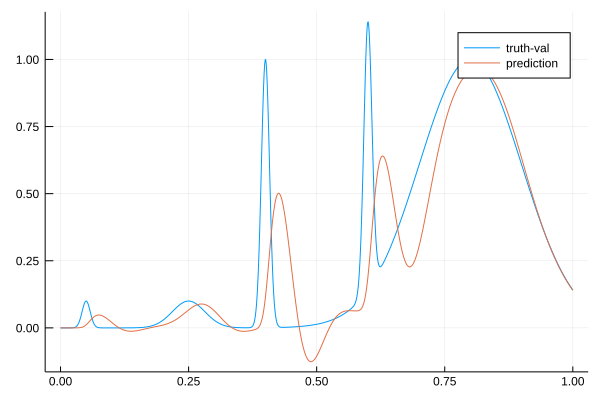

100.78648942180594 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.68463018756386 
  49.56948325423802 
 -10.576879453749148
  59.225857447390034
 -42.57648303731691 
   0.1              

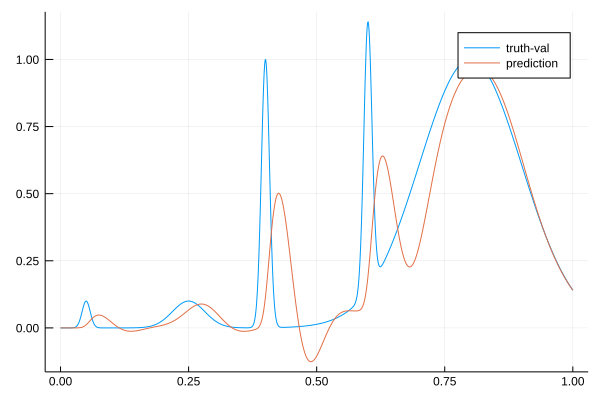

100.76525582324915 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0             
   0.001           
   0.001           
  39.70271213851806
  49.59499219120222
 -10.57946042790532
  59.27054625865   
 -42.62945800395487
   0.1             

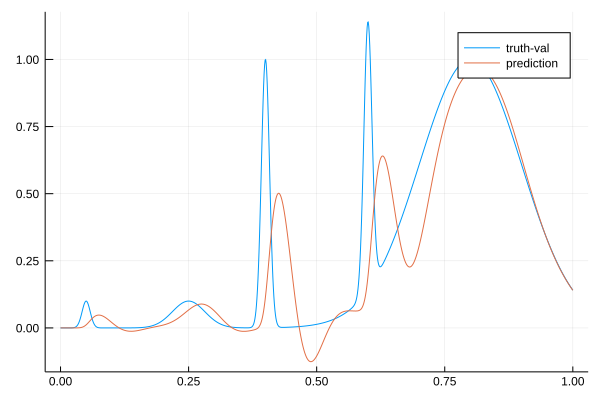

100.74362477763374 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.720880360028325
  49.62068774888735 
 -10.581935161448618
  59.3155130923133  
 -42.68239083596857 
   0.1              

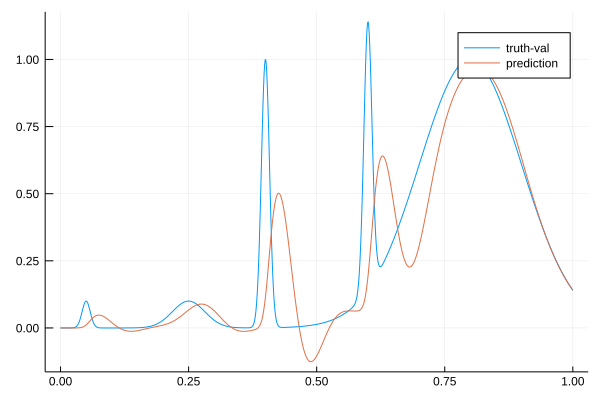

100.7221019810797 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.738599838420164
  49.64695006585484 
 -10.584255311905642
  59.36087714341671 
 -42.73512029982441 
   0.1              

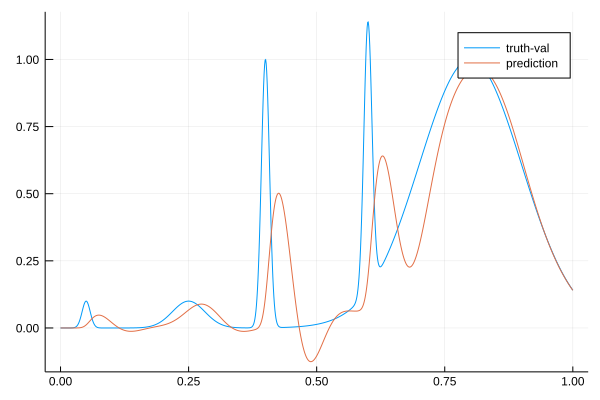

100.70040309816027 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.755922931107705
  49.673754420365505
 -10.58641150121017 
  59.40664222034831 
 -42.787671568185836
   0.1              

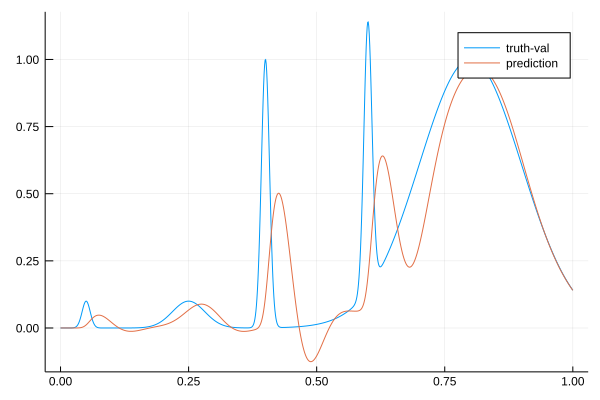

100.67846598083605 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.77343217740367 
  49.700711252259424
 -10.588430295474511
  59.45270863811407 
 -42.840237303285136
   0.1              

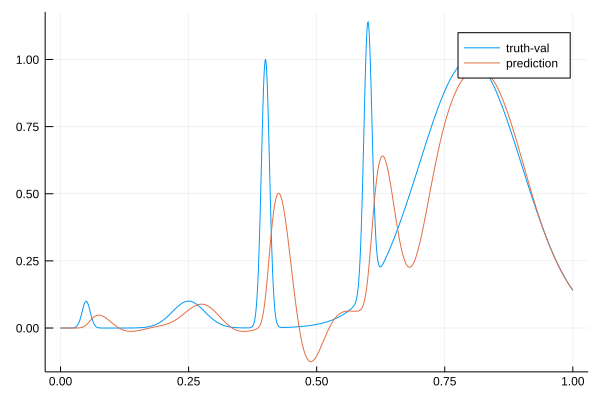

100.65680695766223 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.79111784258075 
  49.727836277731264
 -10.590301686882434
  59.49908933949616 
 -42.892822187179924
   0.1              

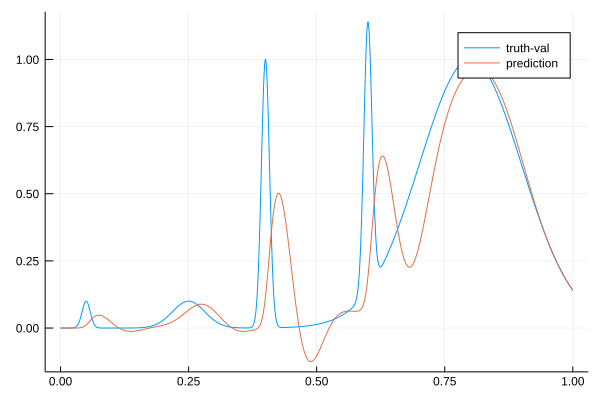

100.63538226313803 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.81022357895557 
  49.753955997444336
 -10.59294898515301 
  59.54514098828253 
 -42.945933386133504
   0.1              

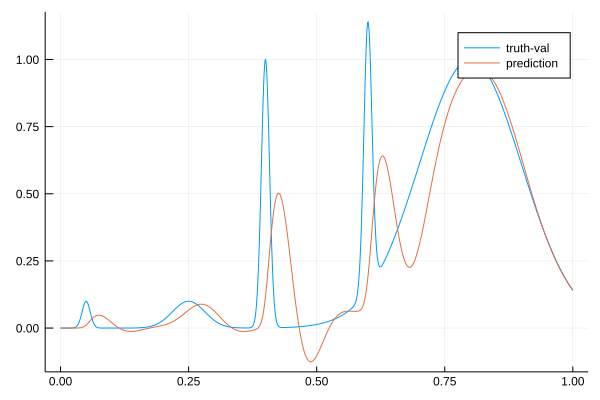

100.61382442762482 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.8307163178077  
  49.77915669118085 
 -10.596281966479033
  59.59095041340529 
 -42.999389750650465
   0.1              

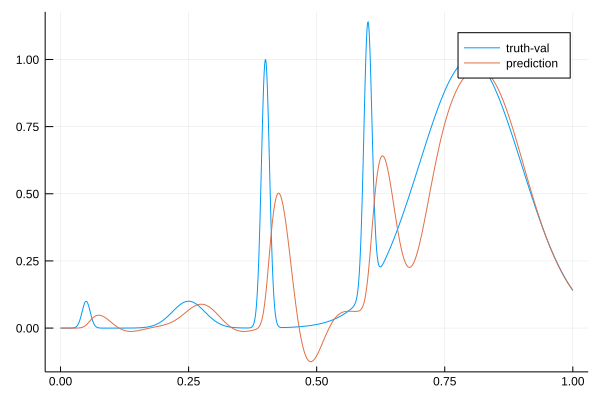

100.59307680421244 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.851930513466726
  49.80393068227353 
 -10.600172099749344
  59.63669036083602 
 -43.05298813995377 
   0.1              

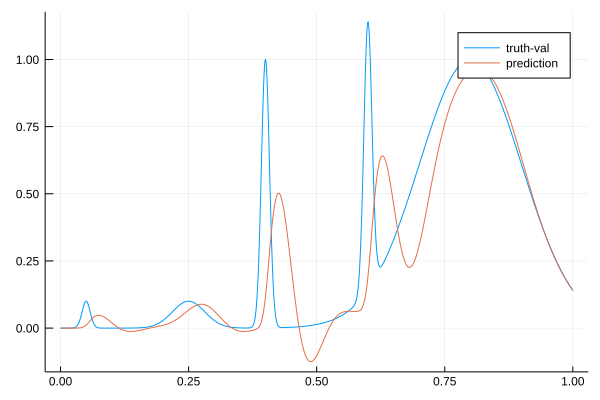

100.57224020826688 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.873794423155445
  49.827810882223346
 -10.604636891682047
  59.681723831666105
 -43.107092891265154
   0.1              

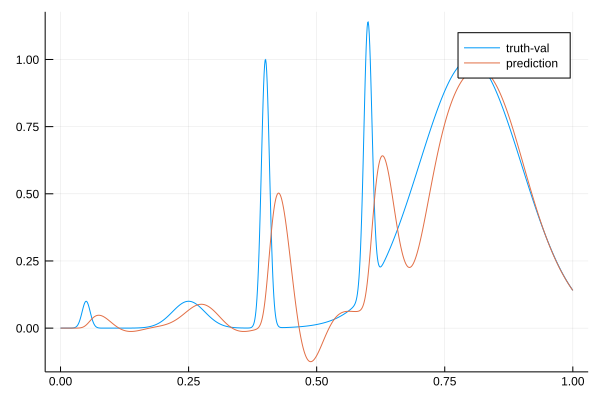

100.55157292359193 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.896249916959285
  49.85092225961027 
 -10.609591974469701
  59.72616976141013 
 -43.16164921795837 
   0.1              

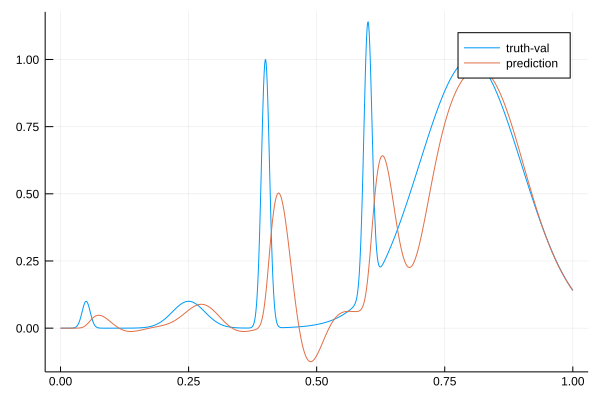

100.53098551626137 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.91744456185518 
  49.87459875707184 
 -10.614007978245608
  59.770462825029774
 -43.2162524357456  
   0.1              

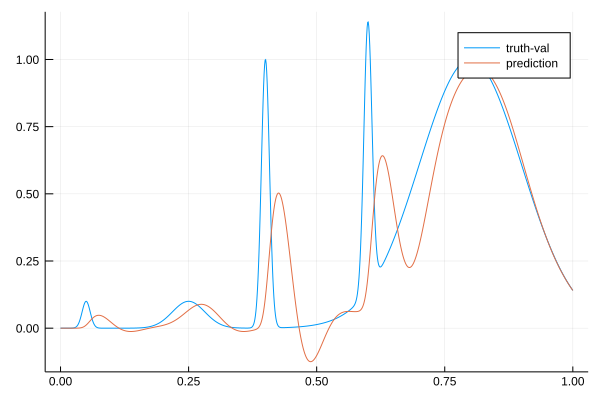

100.51023209896994 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.93698064973931 
  49.89918221830548 
 -10.617876508405992
  59.81476659991337 
 -43.27072670204392 
   0.1              

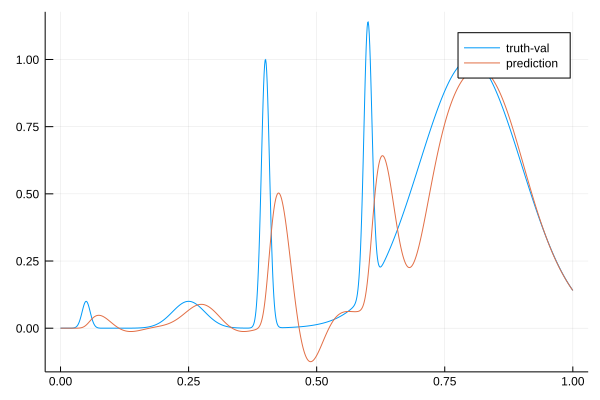

100.48935587964554 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.9550287336946  
  49.924584182653525
 -10.621224347449099
  59.85908461671515 
 -43.32510106770908 
   0.1              

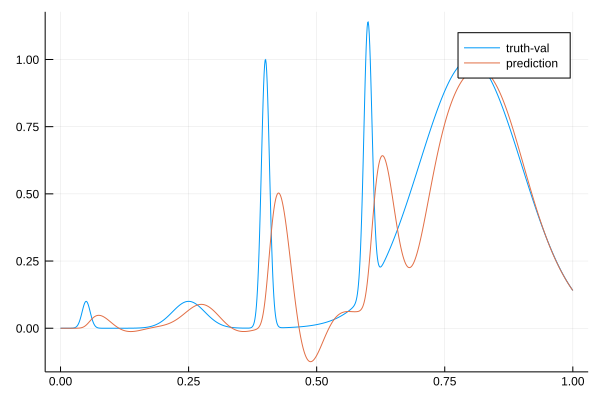

100.46829041713492 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.9717425758052  
  49.95075806344466 
 -10.6240756802611  
  59.90346185652571 
 -43.379384323374595
   0.1              

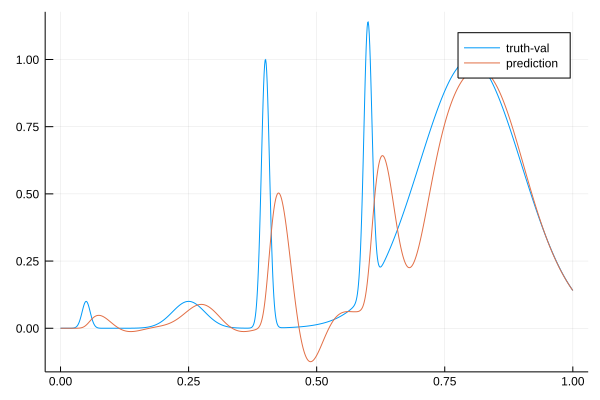

100.44722744923956 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  39.98726112357982 
  49.977660979457866
 -10.62645301875569 
  59.94793798405795 
 -43.433586117303804
   0.1              

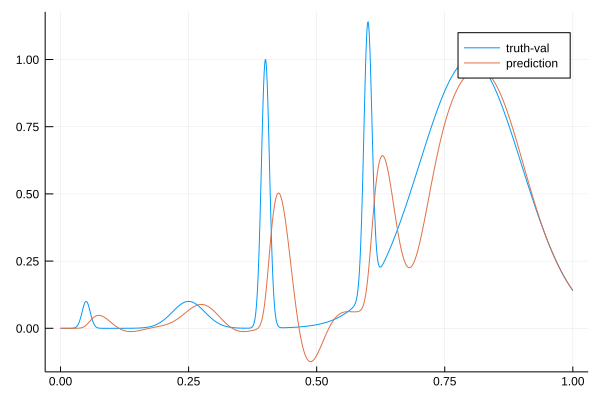

100.42622331421666 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.00351295235514 
  50.00403526022974 
 -10.629330699053819
  59.99222506951794 
 -43.48806657811555 
   0.1              

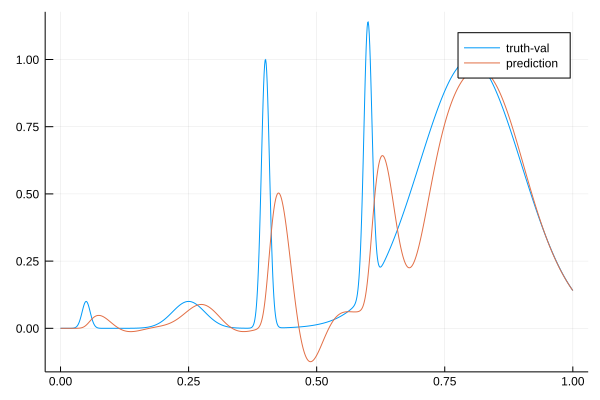

100.40509178562398 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.02043225144807 
  50.02996790391788 
 -10.632632222055314
  60.03638845589948 
 -43.54279723406526 
   0.1              

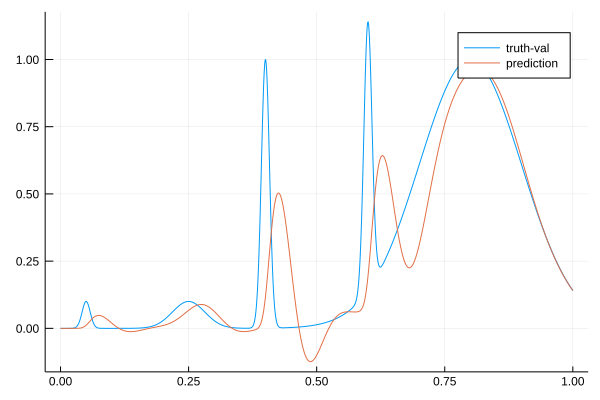

100.3840852199576 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.03796498759274 
  50.055499158433896
 -10.636288331501591
  60.08044256924877 
 -43.59779864952101 
   0.1              

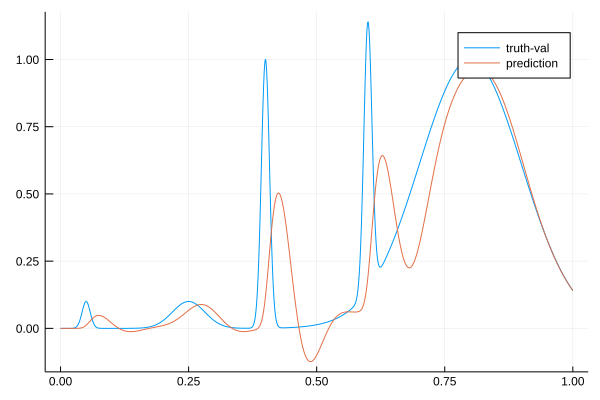

100.36373309061642 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.05682734742985 
  50.080027053321984
 -10.640555031793733
  60.124111401272735
 -43.65292397657725 
   0.1              

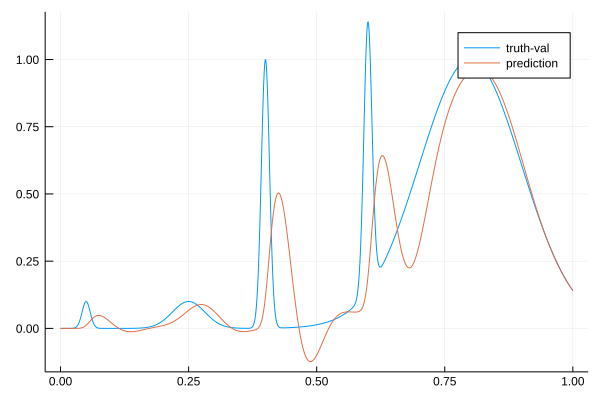

100.34329152908212 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.07689330584881 
  50.103687009710626
 -10.645343551258204
  60.1674809658046  
 -43.70815546510346 
   0.1              

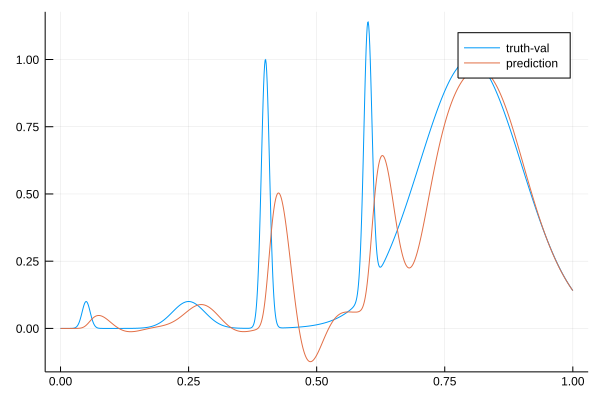

100.32284274952991 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.097527445828504
  50.12695772189708 
 -10.650541403567658
  60.21072674280005 
 -43.76331200301745 
   0.1              

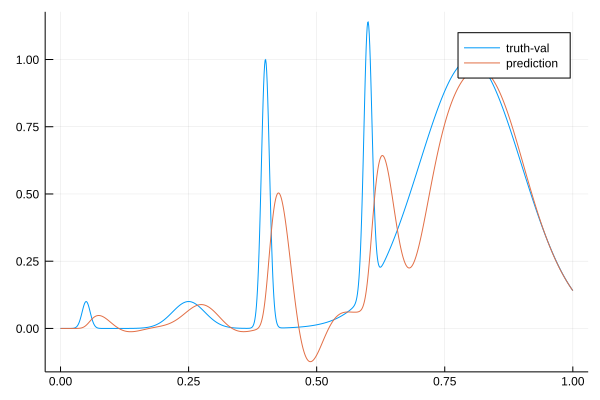

100.302372670064 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.11867904662243 
  50.149914796158065
 -10.656079097415166
  60.25390983508559 
 -43.81839216853911 
   0.1              

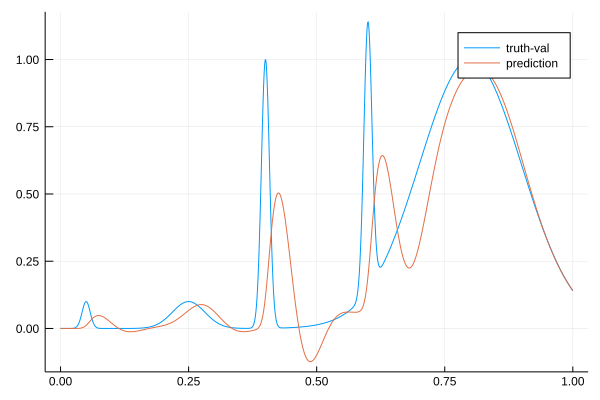

100.28212152304877 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.13849560559473 
  50.17384461122636 
 -10.660937454882061
  60.297404237719185
 -43.87304737430893 
   0.1              

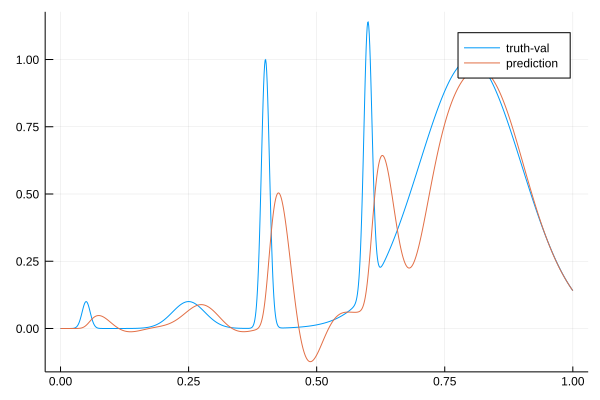

100.26183513986086 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.15655450662424 
  50.19889152346189 
 -10.665135169864463
  60.34110850561949 
 -43.92730479723523 
   0.1              

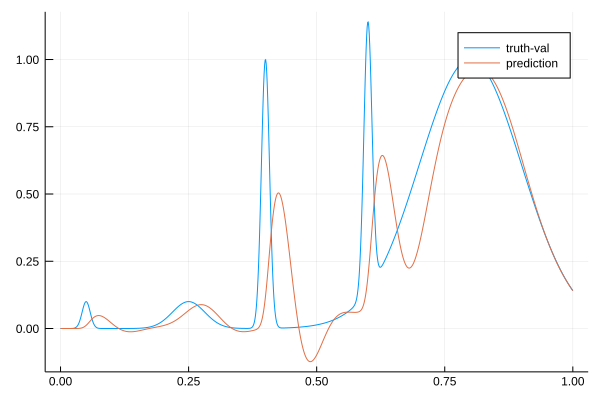

100.24138946990277 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.17281586257336 
  50.22512028396701 
 -10.668698112692528
  60.38507760796845 
 -43.981137627034016
   0.1              

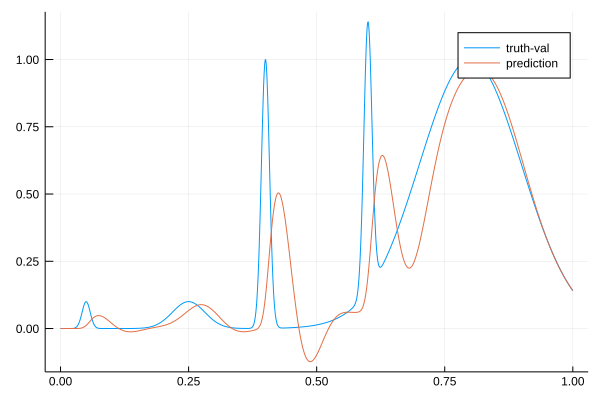

100.2210050207877 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.189273709938895
  50.25123043408483 
 -10.672620717464758
  60.429013828738334
 -44.03493223666823 
   0.1              

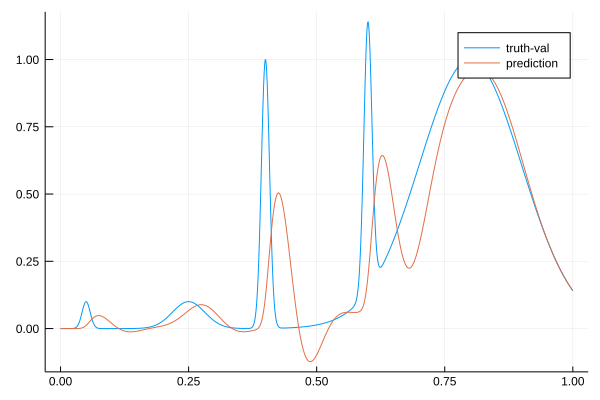

100.20052246266994 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.20591526200134 
  50.27726845582599 
 -10.676841210253883
  60.472966910457856
 -44.08869013521344 
   0.1              

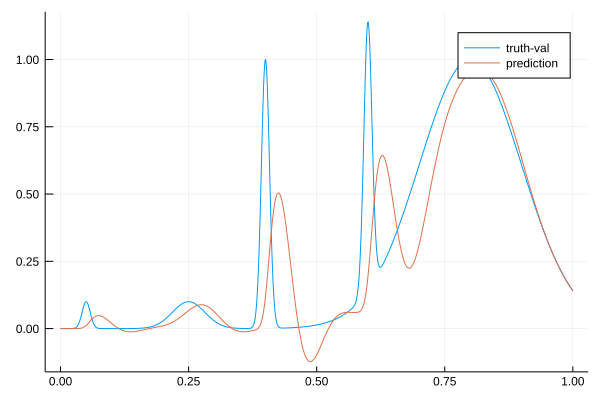

100.17994596687333 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.222729120996306
  50.30327633796743 
 -10.681304039408717
  60.51698184389732 
 -44.14241200941263 
   0.1              

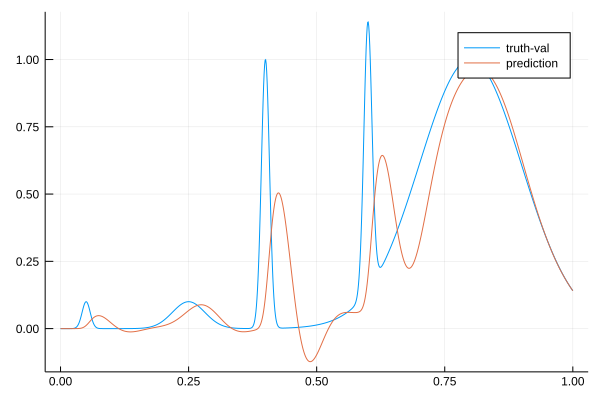

100.15926811835436 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.23948077608762 
  50.32943536592659 
 -10.685947092451466
  60.561129096297904
 -44.19603429287709 
   0.1              

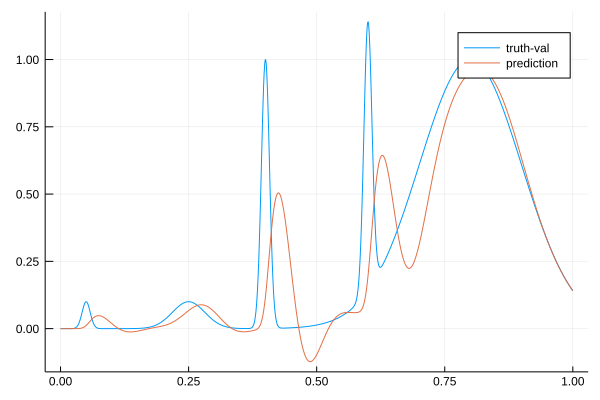

100.13861096023182 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.25618348065098 
  50.355765447571386
 -10.690726872760226
  60.60544238574531 
 -44.24956338571039 
   0.1              

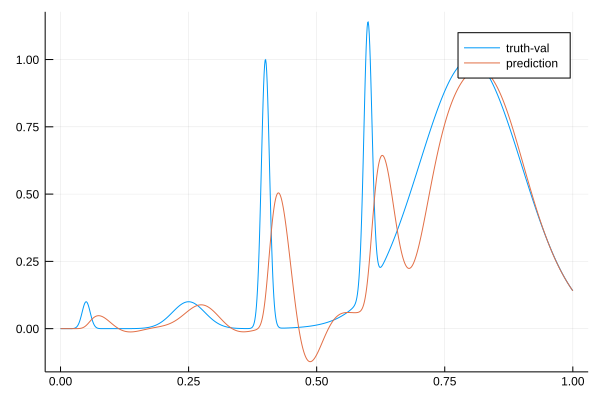

100.1178691423668 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.27294576200741 
  50.38224027826191 
 -10.69561576839964 
  60.649961080243955
 -44.302879769814005
   0.1              

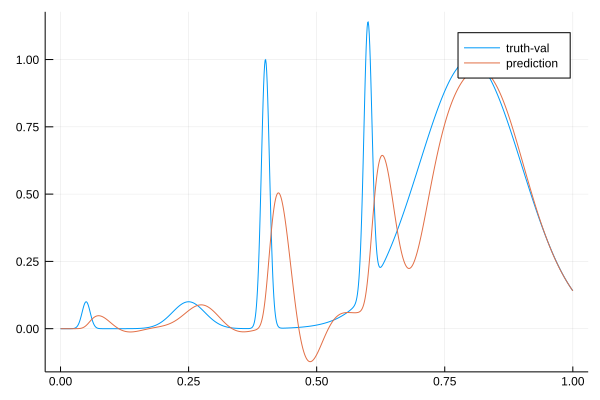

100.09701511680966 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.289540241792984
  50.40902596317196 
 -10.70056580297575 
  60.69474133036316 
 -44.35593717811353 
   0.1              

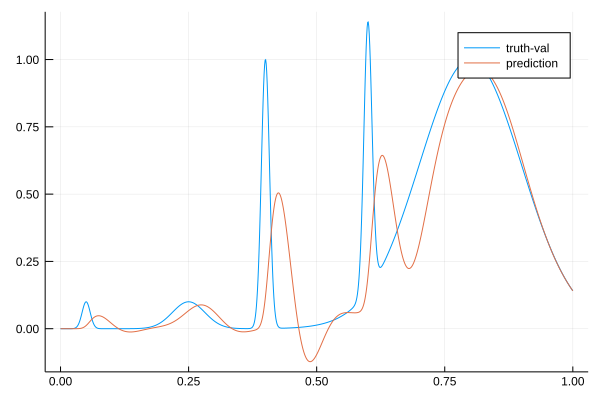

100.07604737142645 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.305991226527745
  50.43612569921748 
 -10.705546495629234
  60.73980319261121 
 -44.40875916832376 
   0.1              

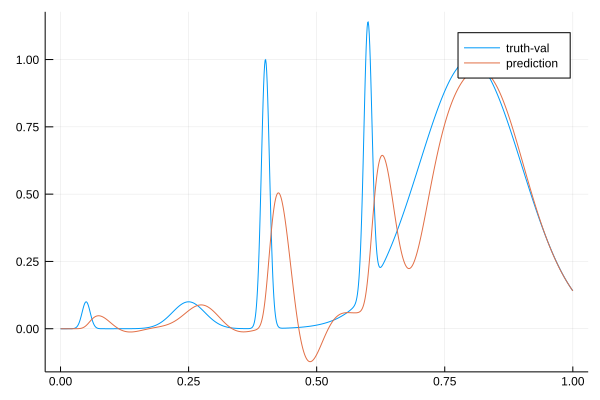

100.05495463026419 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.32232089708309 
  50.46354208313937 
 -10.710530890386094
  60.7851645228705  
 -44.461367462294525
   0.1              

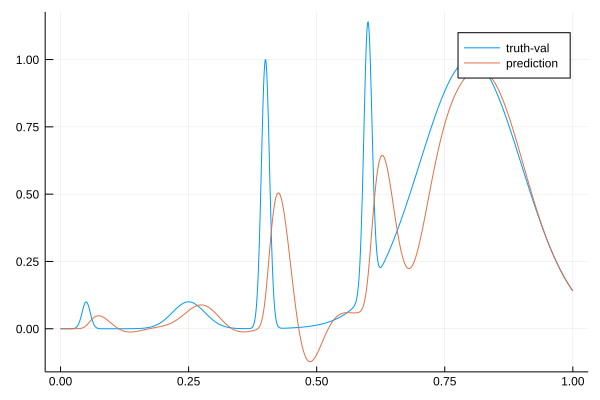

100.03371971908997 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.33854953988359 
  50.491277150265695
 -10.715495241316157
  60.830841181605   
 -44.513782147547346
   0.1              

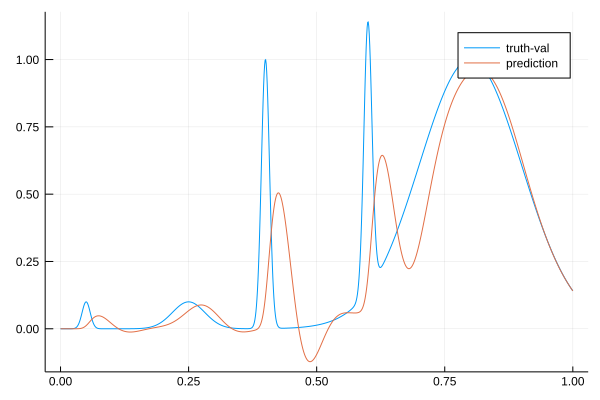

100.01232698726814 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0             
   0.001           
   0.001           
  40.35469574629454
  50.51933244144205
 -10.72041869154662
  60.87684725283245
 -44.56602184118417
   0.1             

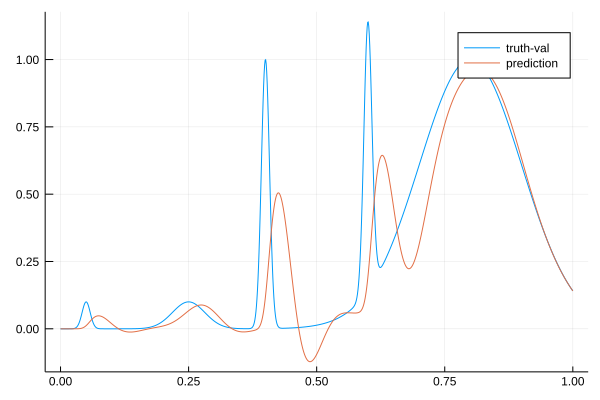

99.99080762476946 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.370776585657936
  50.54770907057962 
 -10.725282968809518
  60.923195246038944
 -44.61810383689658 
   0.1              

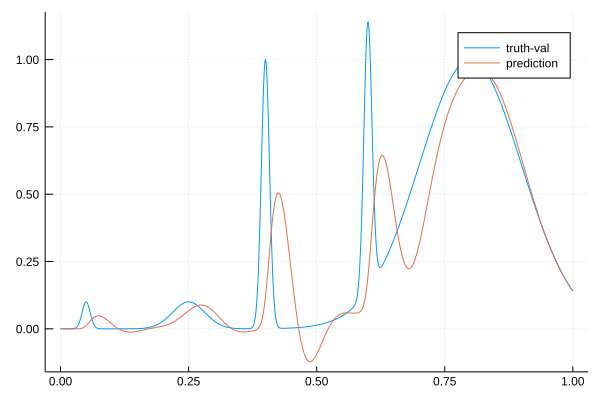

99.96952778629283 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.38732568167178 
  50.57605703805479 
 -10.730104312675495
  60.969802359713235
 -44.67020314126551 
   0.1              

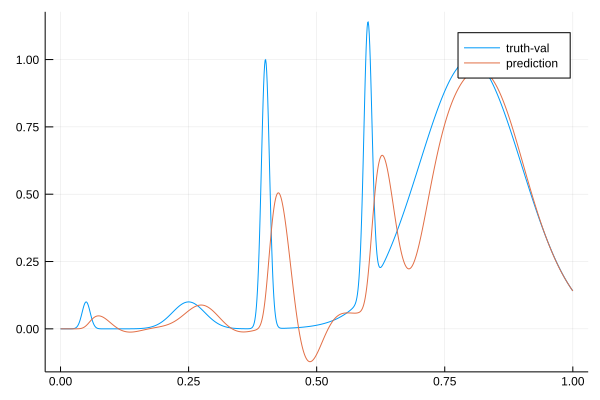

99.94776792760169 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.406300537518064
  50.60291289120131 
 -10.735842606931595
  61.0161426278808  
 -44.72287148644253 
   0.1              

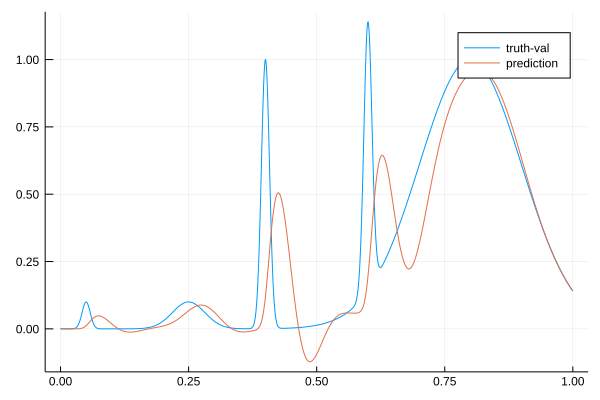

99.92595889619969 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.42723980105363 
  50.6286065177885  
 -10.742371420046807
  61.06232141554594 
 -44.77598325310016 
   0.1              

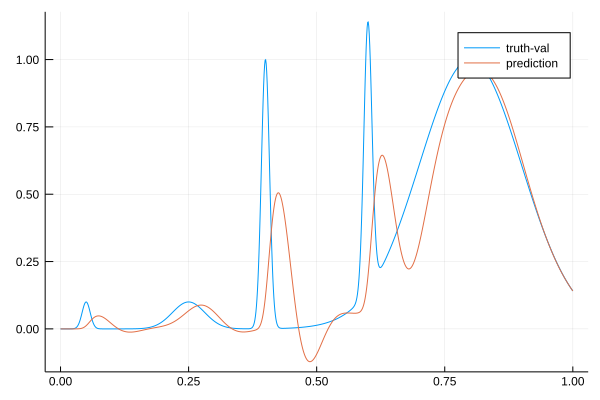

99.90442306805107 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.449723371540614
  50.65343915971762 
 -10.749576442324972
  61.10843561286293 
 -44.82942133808662 
   0.1              

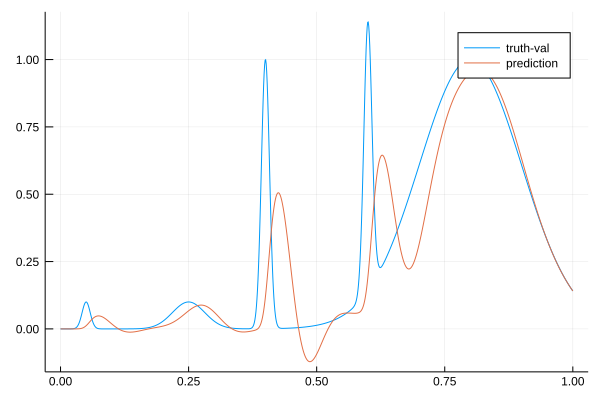

99.88356403280754 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.47107826158917 
  50.678849479623494
 -10.756456120220637
  61.15450438407465 
 -44.88280763038221 
   0.1              

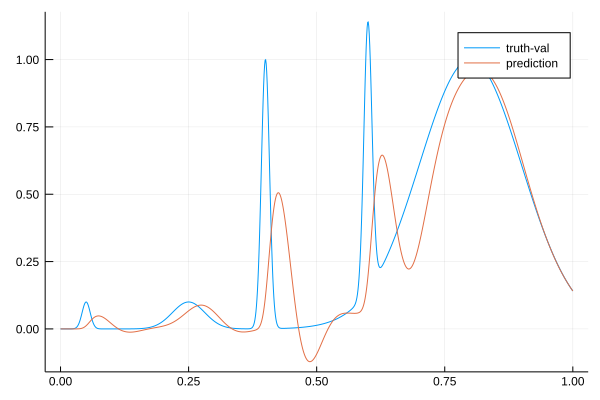

99.86277332066203 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.49151859704414 
  50.70477396488095 
 -10.763029180073044
  61.2005907152331  
 -44.93601685071461 
   0.1              

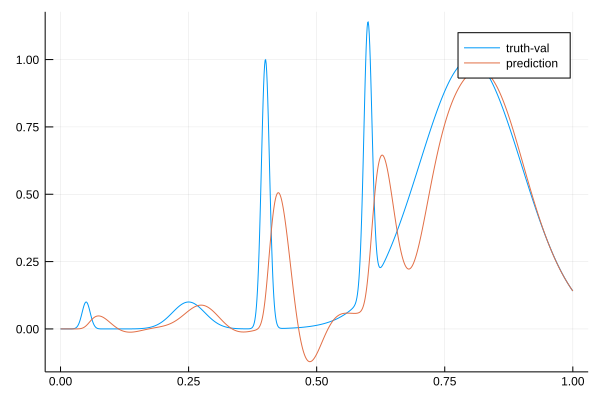

99.84181487952692 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.51089954585673 
  50.73135325898078 
 -10.769289216292444
  61.2467739685782  
 -44.98899285819465 
   0.1              

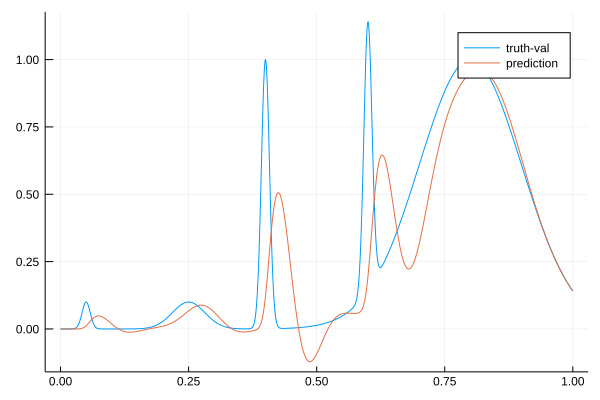

99.82066296665434 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.528575107582   
  50.75906117061699 
 -10.775200172025096
  61.29321672119634 
 -45.04152963648604 
   0.1              

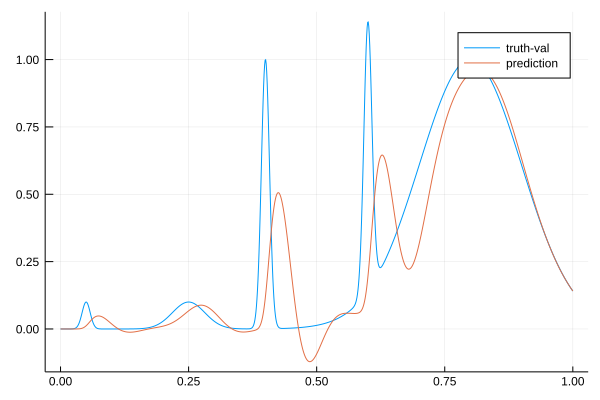

99.79938585226388 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.5447228939703  
  50.787786166163514
 -10.780774632873781
  61.33989802194671 
 -45.093688170841425
   0.1              

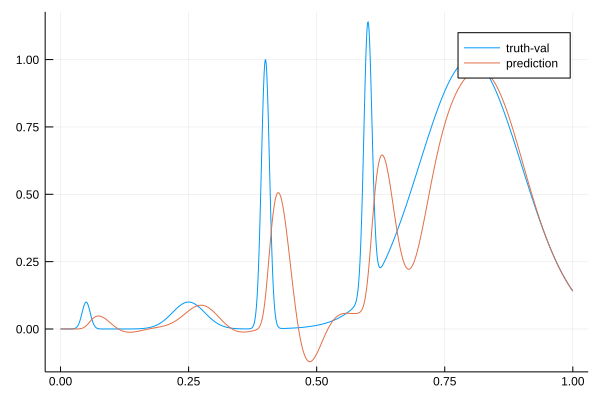

99.77838279920377 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.560014852897076
  50.81711604690648 
 -10.786055417550413
  61.38674954822559 
 -45.14566128445811 
   0.1              

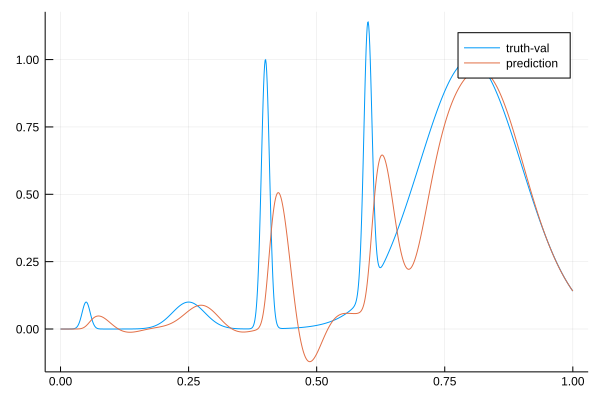

99.75723259214367 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.57660927958428 
  50.84565767200804 
 -10.792020892704787
  61.43346540940767 
 -45.19787265220839 
   0.1              

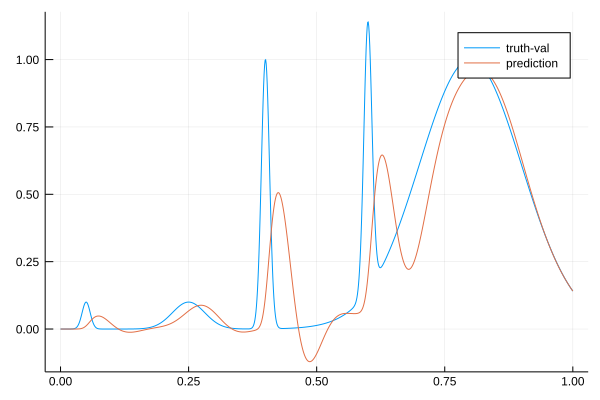

99.73589494640994 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.5943860874758  
  50.87352402820317 
 -10.798581331218926
  61.480106693905974
 -45.25029615100844 
   0.1              

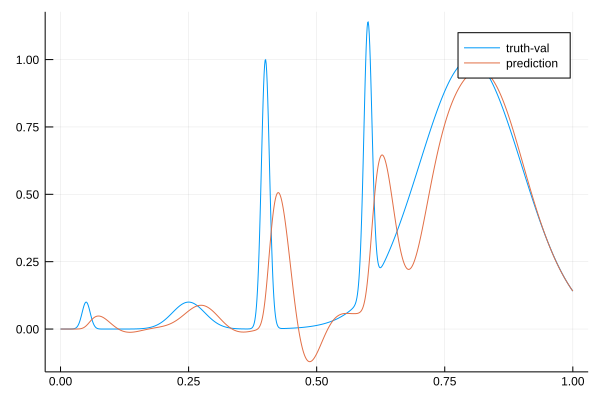

99.7143669837781 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.61323711383104 
  50.90081744958672 
 -10.805655654299345
  61.526729097334346
 -45.302906245214906
   0.1              

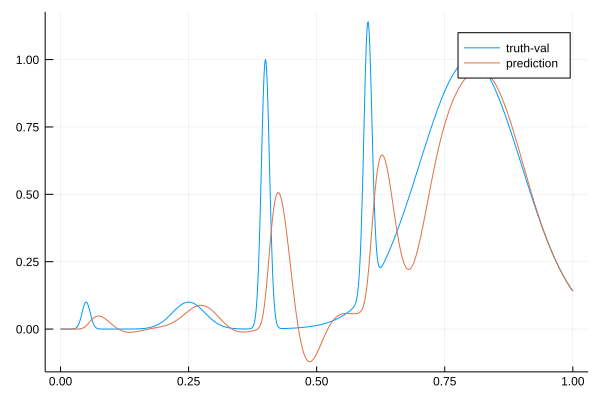

99.69268346330328 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.63306495750606 
  50.92763061381947 
 -10.813170619677061
  61.57338339036312 
 -45.35567821375068 
   0.1              

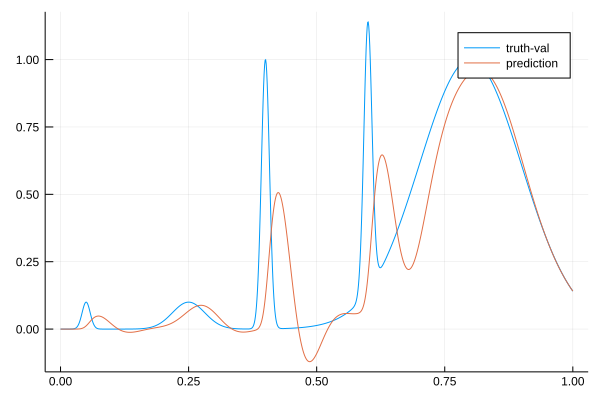

99.67096756002984 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.6535336197625  
  50.954206304458765
 -10.821047279290335
  61.620149138034584
 -45.40851990993429 
   0.1              

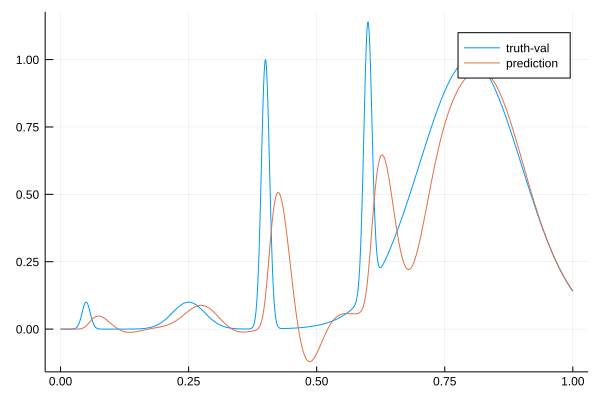

99.64929774613246 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.67429182107925 
  50.980625102133274
 -10.829224613781752
  61.666894287089995
 -45.46149350366314 
   0.1              

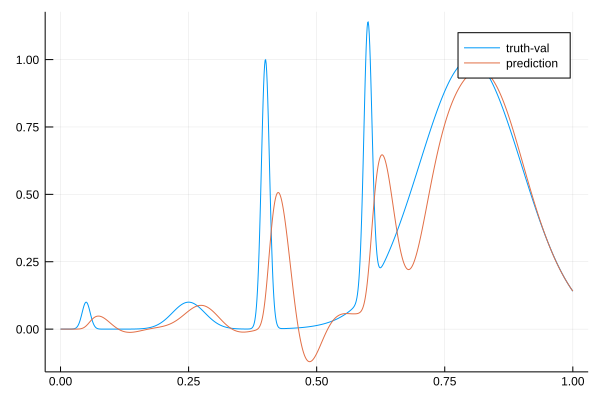

99.62752008876062 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.69531986825743 
  51.00694009302588 
 -10.837650050257354
  61.71367172995859 
 -45.51457670542336 
   0.1              

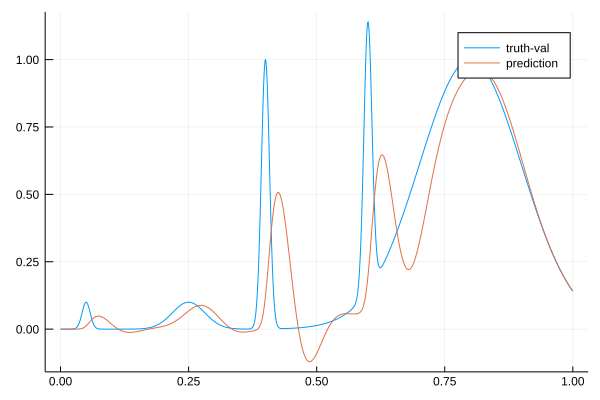

99.60578709920895 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.71582918139234 
  51.03370976174641 
 -10.846231136557241
  61.760654317116   
 -45.567523488721335
   0.1              

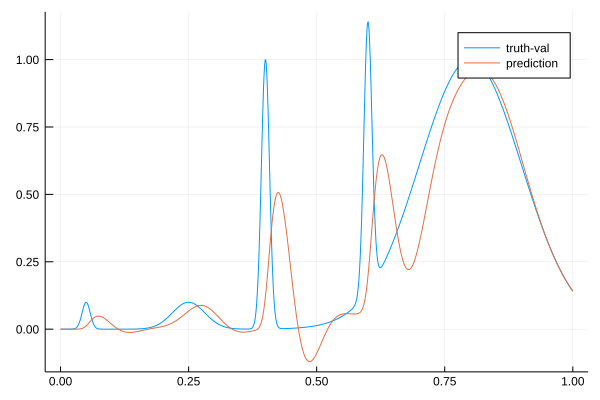

99.58403856764545 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.73597326385064 
  51.06088354539689 
 -10.854940784121556
  61.80788042076493 
 -45.62021870699467 
   0.1              

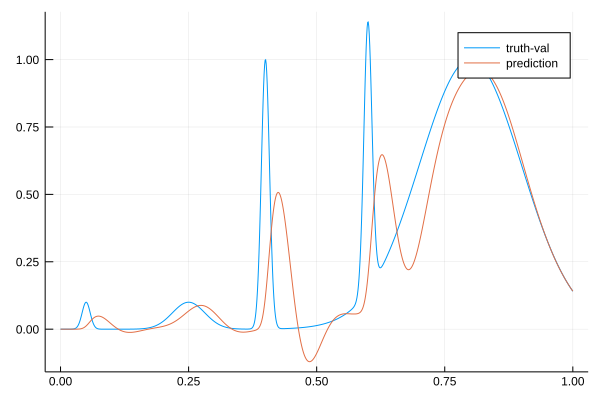

99.56208351893648 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.75371172727189 
  51.089833995420975
 -10.862769178622338
  61.85570885621083 
 -45.67227470412875 
   0.1              

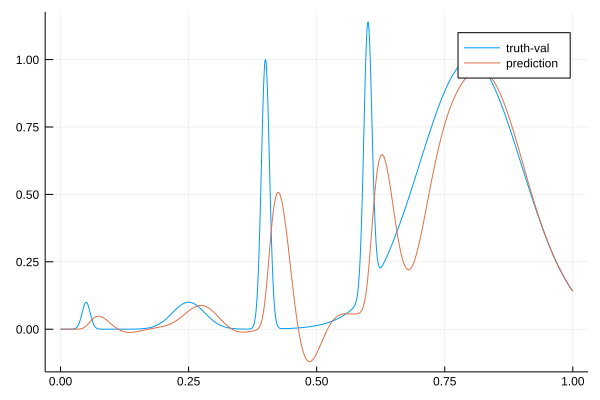

99.53996785523023 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.771116366430206
  51.11921218209329 
 -10.870744855610821
  61.90383066337971 
 -45.72408362327354 
   0.1              

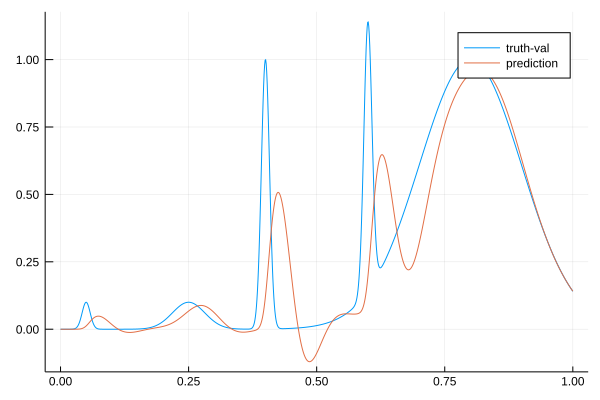

99.51821719643776 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.78874452389268 
  51.14866529300678 
 -10.878865361593496
  61.95217515964298 
 -45.77582043586436 
   0.1              

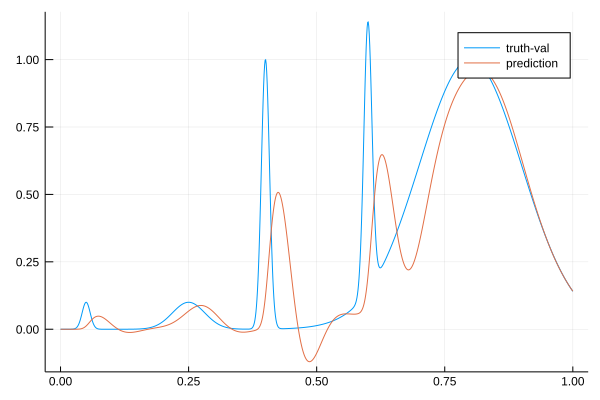

99.49679538263413 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.807523043842245
  51.17740928275803 
 -10.887425513871948
  62.0003806013087  
 -45.82758087246816 
   0.1              

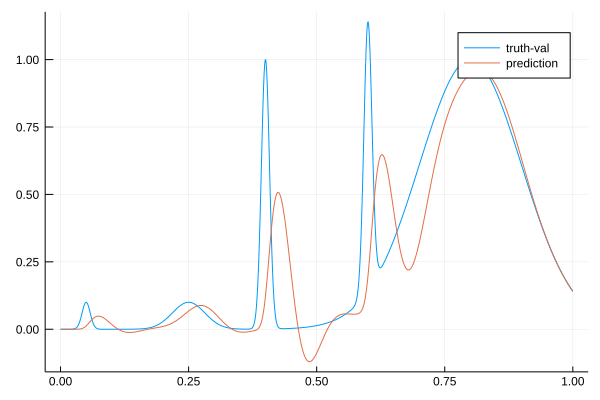

99.47524439886794 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.8273477042286  
  51.20555012985551 
 -10.896361450035803
  62.048509681127946
 -45.879357517318844
   0.1              

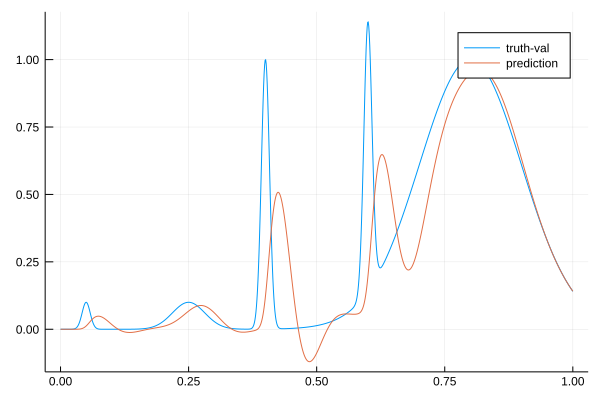

99.45359374163026 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.84786144752627 
  51.233352011957436
 -10.90560233968535 
  62.09665460173224 
 -45.93107058135871 
   0.1              

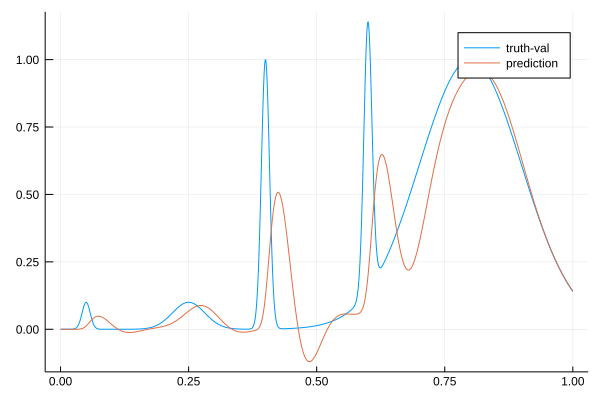

99.43181832971838 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.869005863618206
  51.26088480234564 
 -10.915097518993894
  62.144863360652046
 -45.98271905921283 
   0.1              

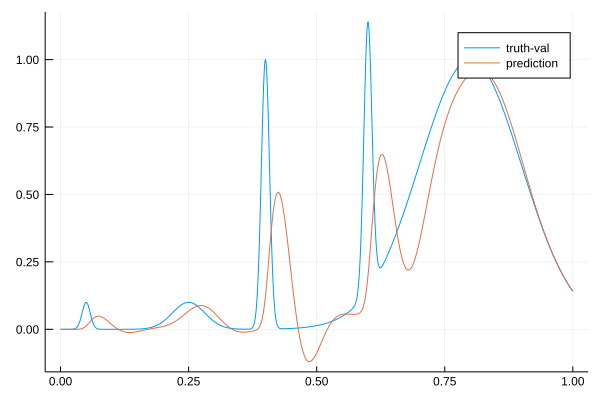

99.40992867961732 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.89046027324562 
  51.288383094473666
 -10.924788156966684
  62.19321533900555 
 -46.0342284198901  
   0.1              

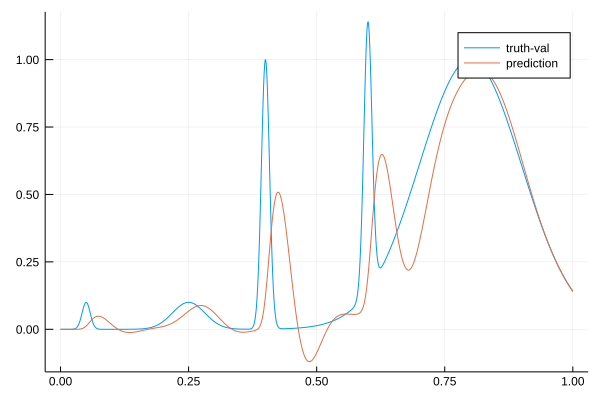

99.38798550073747 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.91168915935222 
  51.3162329444167  
 -10.934601498193361
  62.24183612184517 
 -46.08545084801734 
   0.1              

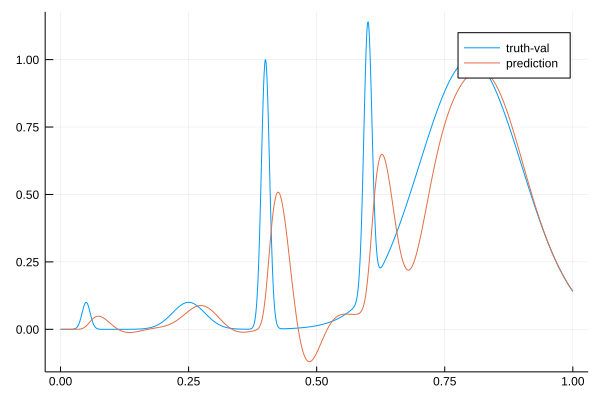

99.36599075307218 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.93085347942892 
  51.34550300294246 
 -10.943550726738488
  62.29084057345042 
 -46.13622301310826 
   0.1              

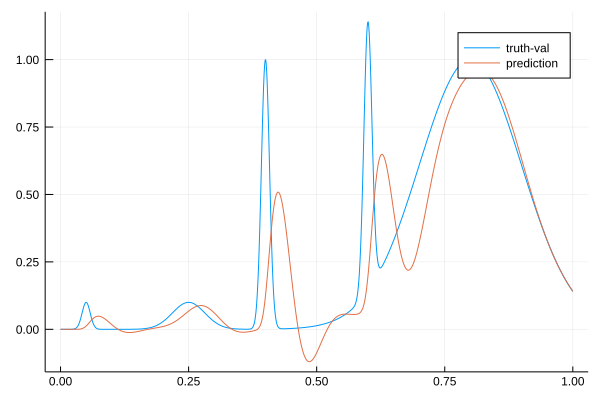

99.34386139870588 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.94999793349433 
  51.37487986586978 
 -10.952667904391275
  62.33994594744987 
 -46.18691491097377 
   0.1              

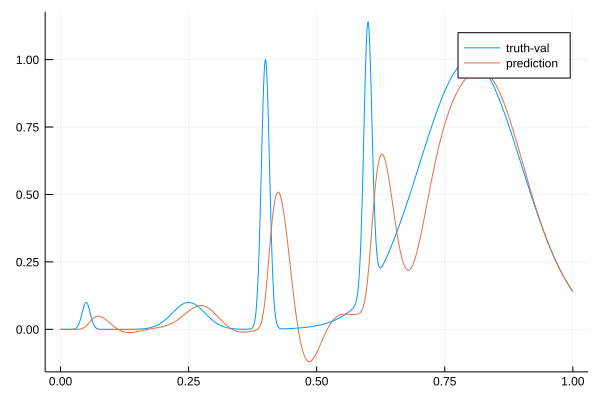

99.32169043253988 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.969135332015995
  51.40438865156646 
 -10.961917383627883
  62.38919157079371 
 -46.23752980194536 
   0.1              

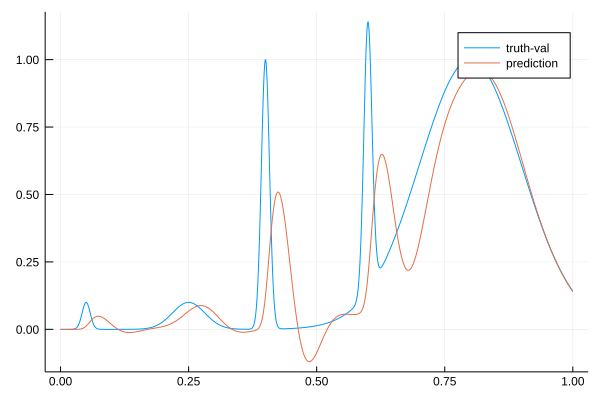

99.29962243007375 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  40.98836864047422 
  51.434008911970594
 -10.971278193012282
  62.438619514889744
 -46.28795408420611 
   0.1              

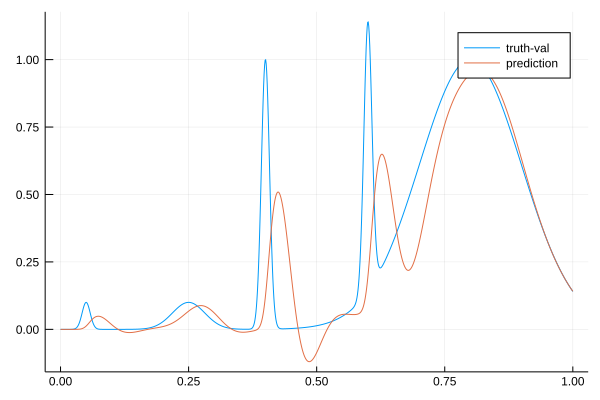

99.27744661557135 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.008215362436964
  51.46341869495584 
 -10.98075464371666 
  62.48817107661629 
 -46.33835538595575 
   0.1              

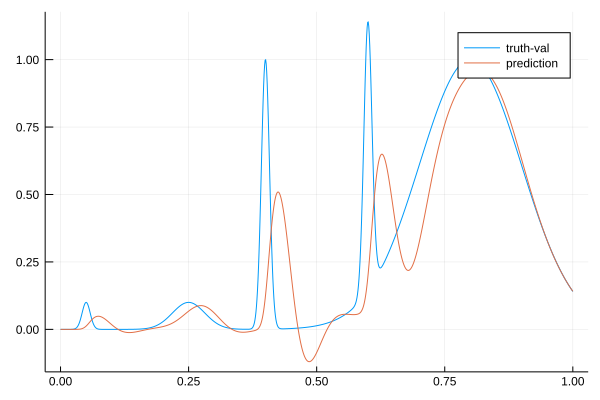

99.25514423787298 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.02862582679293 
  51.492674363131044
 -10.990316978359397
  62.53788307782021 
 -46.38873117828436 
   0.1              

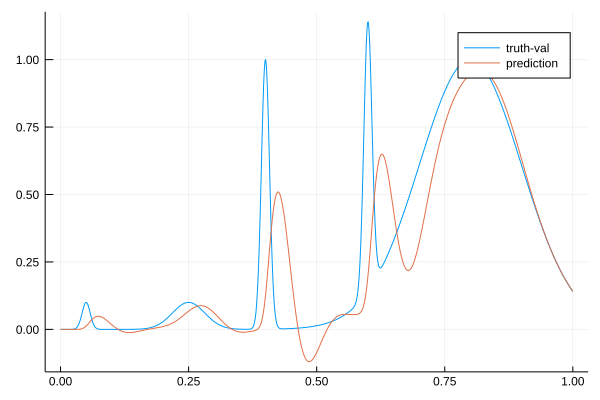

99.232805836965 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.04955539291759 
  51.52182681437362 
 -10.999938472436238
  62.58778885265284 
 -46.439078760874416
   0.1              

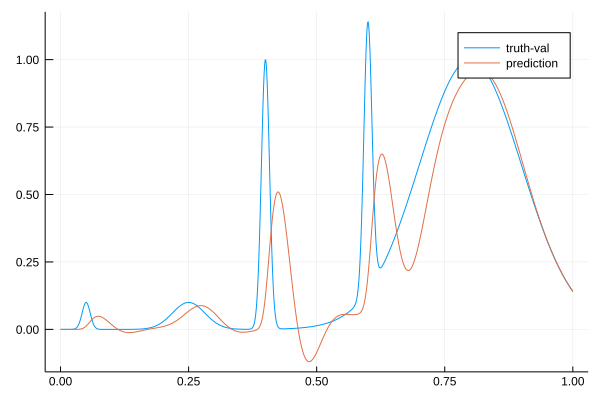

99.211144508321 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.070731421541666
  51.550697948310805
 -11.009674641633799
  62.63749018988208 
 -46.489552600957985
   0.1              

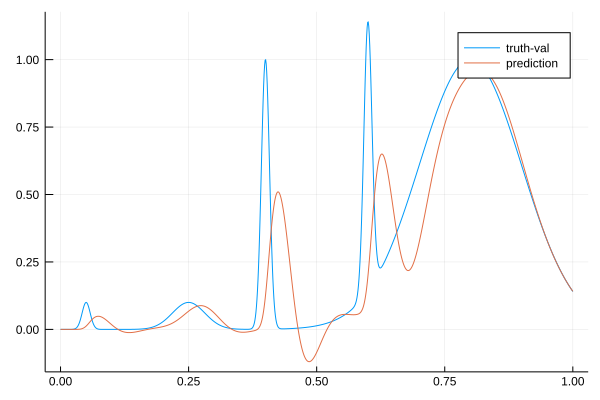

99.18935852293755 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.09214009829719 
  51.579351987792826
 -11.019495579911696
  62.68705732030262 
 -46.54013436759362 
   0.1              

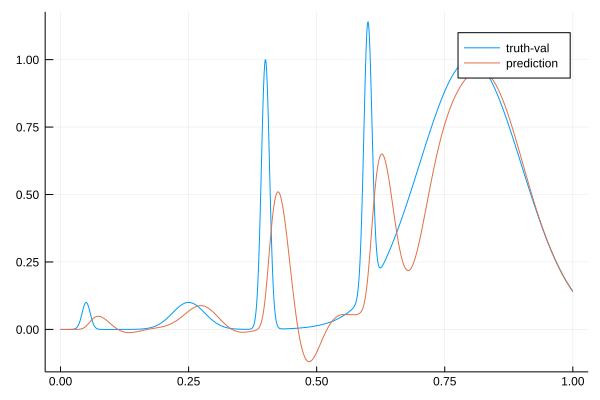

99.16750567005481 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.113768997323255
  51.607847012048424
 -11.029374153764426
  62.736553747155746
 -46.59080680632417 
   0.1              

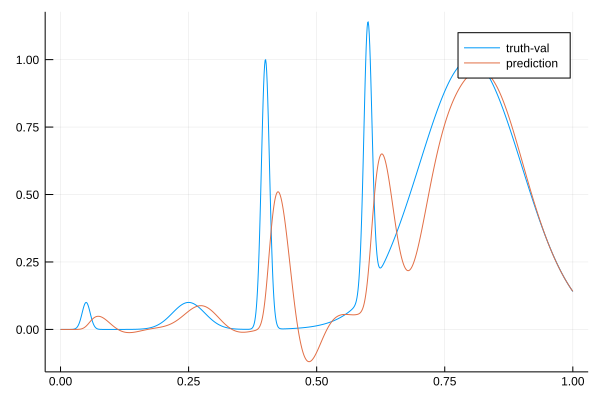

99.14550186204602 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.13349254351982 
  51.63758759805702 
 -11.038303805128772
  62.786321902267744
 -46.64117238330771 
   0.1              

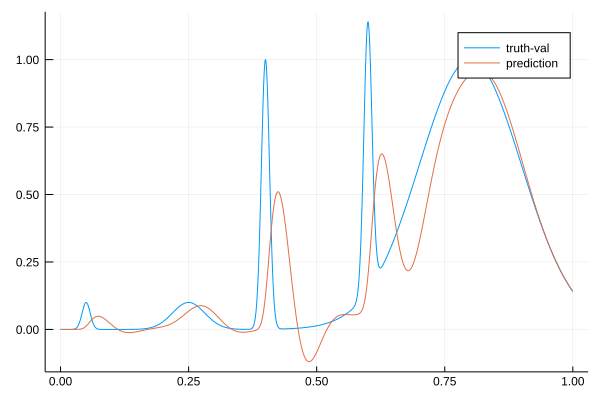

99.12350333398962 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.15334650372531 
  51.667277955056406
 -11.047329215323536
  62.83609466032337 
 -46.69158387663854 
   0.1              

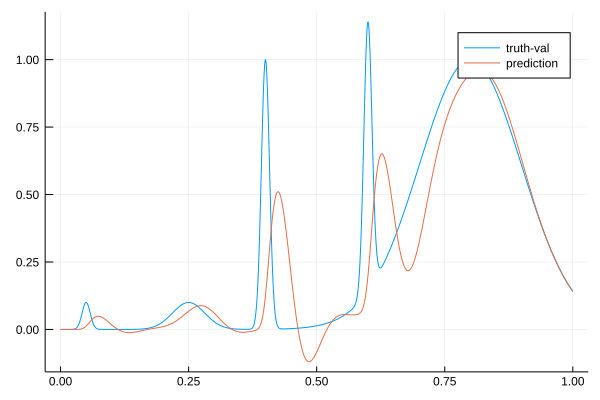

99.10162801751197 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.17328719637546 
  51.69681851342883 
 -11.056433138462506
  62.88572089794142 
 -46.742175655534886
   0.1              

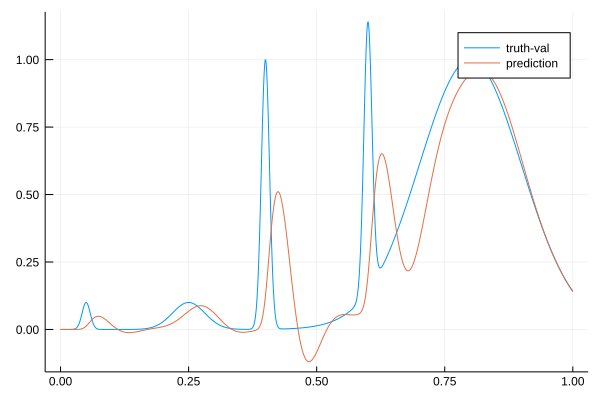

99.07963374682305 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.19331682883858 
  51.72626087161739 
 -11.065589231915096
  62.9352656506273  
 -46.792924517450764
   0.1              

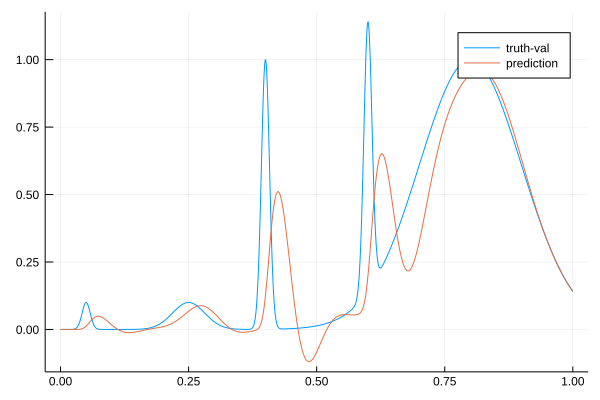

99.05751371509854 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.213437428122226
  51.75565164362989 
 -11.074773617886361
  62.98478763914417 
 -46.84380897398561 
   0.1              

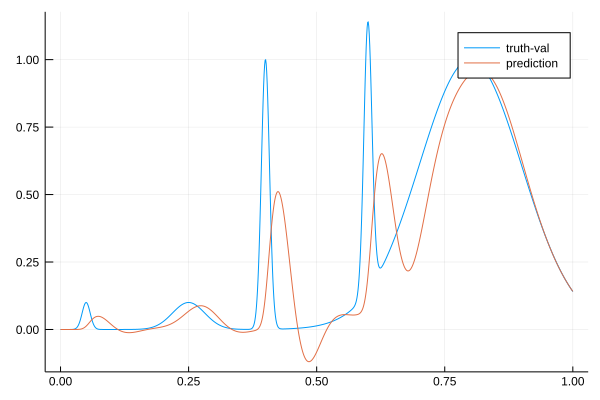

99.03521947434923 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.23365088167855 
  51.78503292963863 
 -11.08396468923841 
  63.034339879884676
 -46.89480920655421 
   0.1              

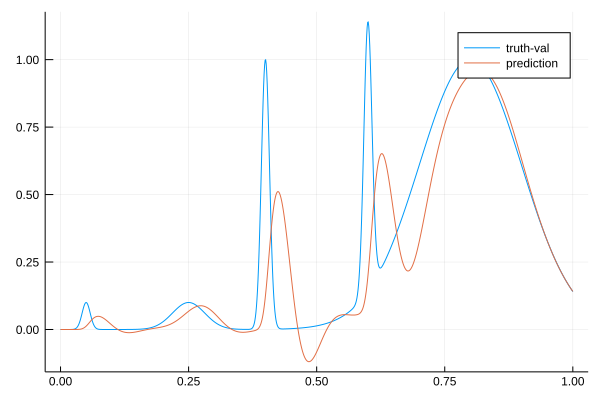

99.01282509741444 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.253958983761144
  51.8144427283561  
 -11.093142872026785
  63.08397022685049 
 -46.94590699463088 
   0.1              

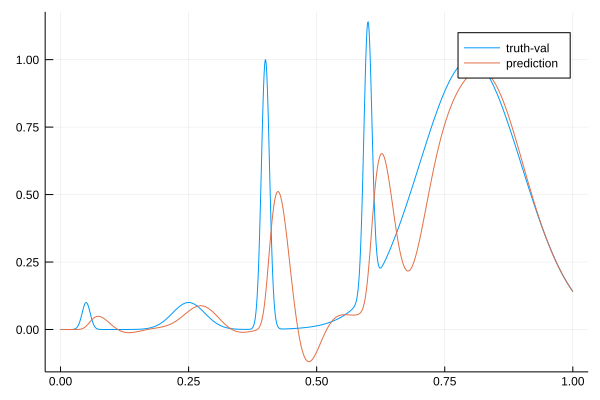

98.99045844622233 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.27445308412916 
  51.843871531752534
 -11.102301452226124
  63.13372640587916 
 -46.996972752567416
   0.1              

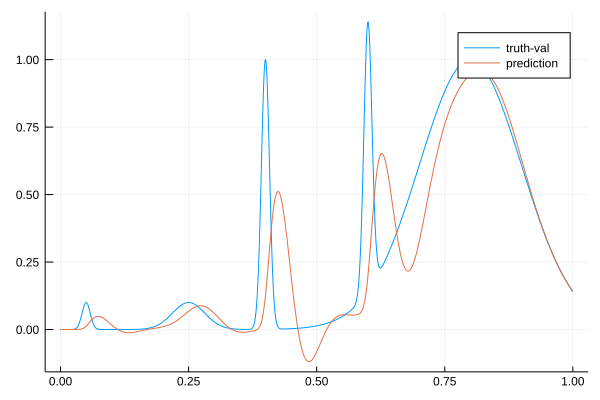

98.96795455740015 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.29512584256368 
  51.87335416562288 
 -11.111423598436662
  63.18364629848525 
 -47.048003255009654
   0.1              

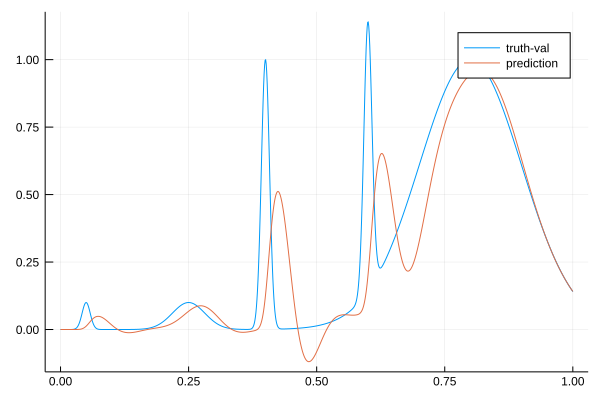

98.9453002542675 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.31597079959411 
  51.902921995485606
 -11.120494290549885
  63.233764060393895
 -47.09899554464481 
   0.1              

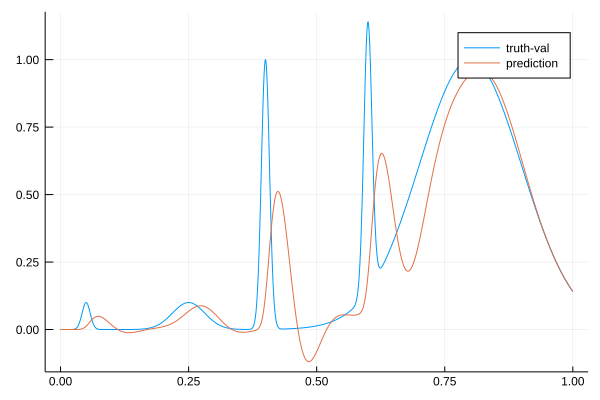

98.9224944991021 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.33698230179114 
  51.932603259803294
 -11.129500146692205
  63.28411048578409 
 -47.1499469736327  
   0.1              

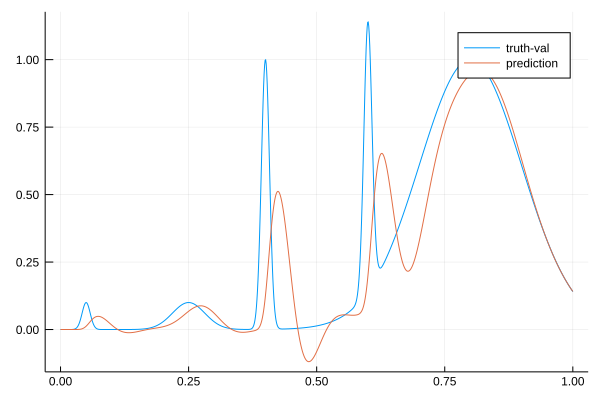

98.899529037335 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.358155433111044
  51.96242337309202 
 -11.138429289226268
  63.33471333818309 
 -47.200855228141904
   0.1              

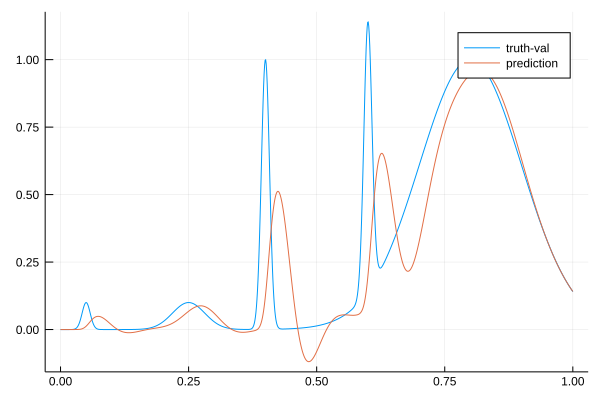

98.87637339328775 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.380013431032744
  51.99205221937471 
 -11.147309104424858
  63.38550739556138 
 -47.25187137793664 
   0.1              

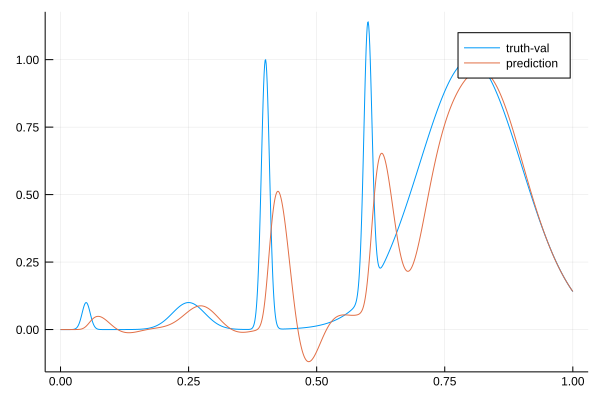

98.85305532458081 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.402500279089125
  52.02154568211608 
 -11.156126432627454
  63.43652455173963 
 -47.30297777543037 
   0.1              

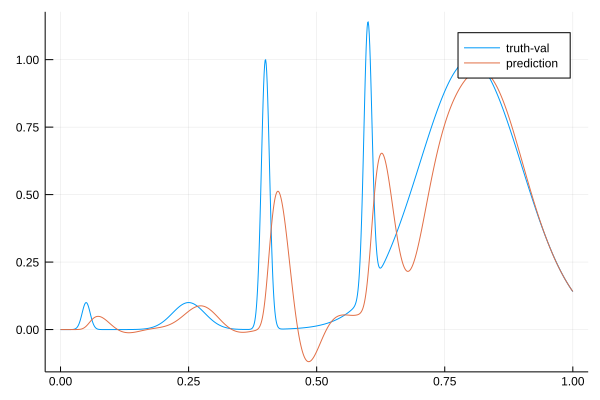

98.82987047325646 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.42475221362683 
  52.05149017893302 
 -11.1648163484592  
  63.487922580073615
 -47.35393024327429 
   0.1              

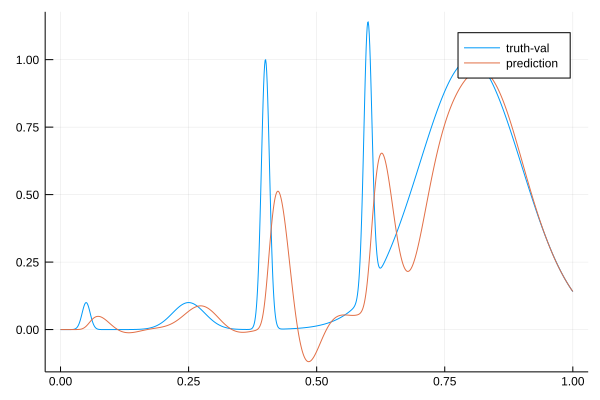

98.80645921169581 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.444919129232446
  52.08294468595759 
 -11.172410834292501
  63.53979961907813 
 -47.404558843865004
   0.1              

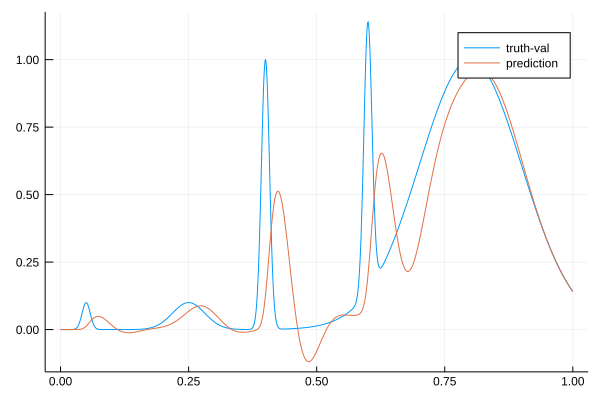

98.78293135165 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.46559357518601 
  52.11423572574153 
 -11.180013317799776
  63.59178575721282 
 -47.45536653247856 
   0.1              

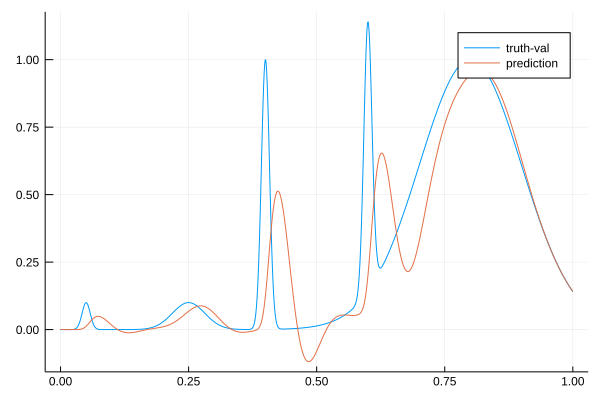

98.75923408608848 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.48702955299601 
  52.14519763490103 
 -11.187620966756286
  63.64384260305332 
 -47.506451748683155
   0.1              

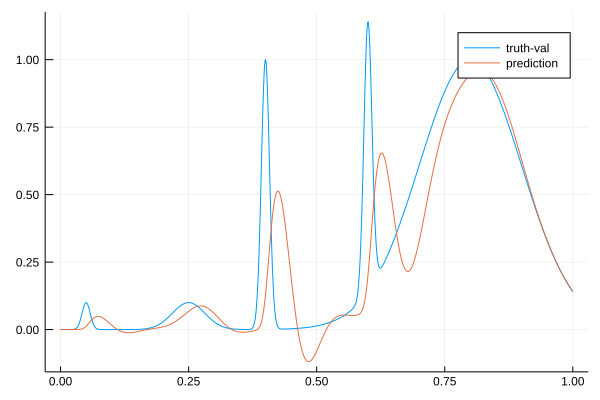

98.73533220808709 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.5091641413339  
  52.175900286519926
 -11.195215960441718
  63.69601471894675 
 -47.55778193548391 
   0.1              

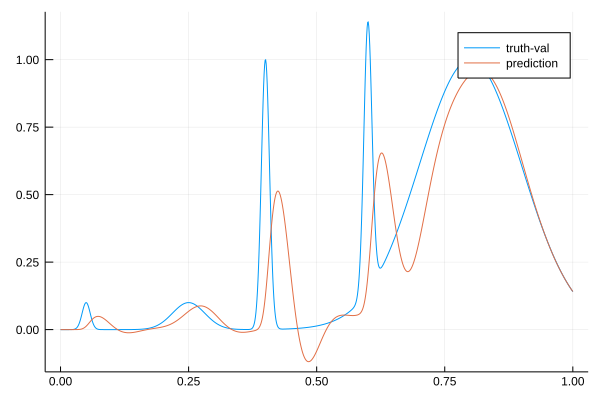

98.71123713690366 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.531654645201925
  52.20659018976691 
 -11.202766733129057
  63.74838152745099 
 -47.60925221857106 
   0.1              

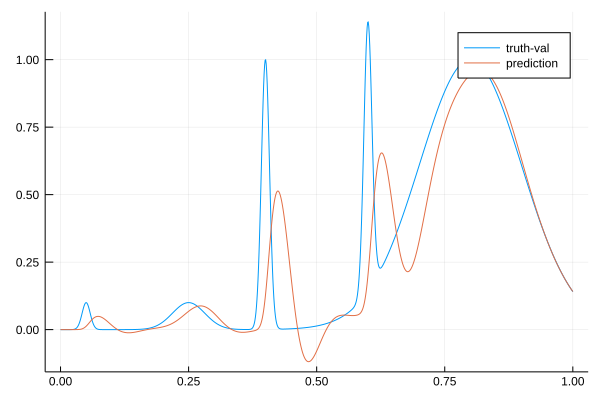

98.68699738561668 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.5544785515362  
  52.2373062689052  
 -11.210260068611628
  63.800975787589   
 -47.66084277082697 
   0.1              

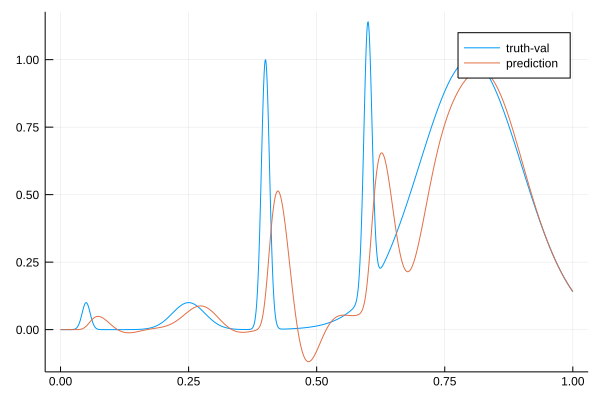

98.66267929611438 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.57770397998234 
  52.26803911163279 
 -11.217695885753363
  63.85382975816584 
 -47.7124262501504  
   0.1              

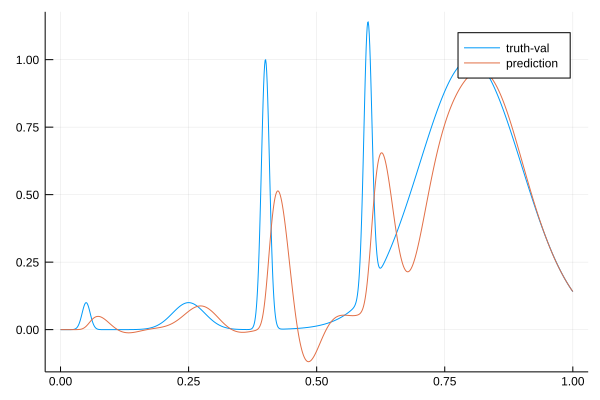

98.63816825882385 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.60130408466183 
  52.2988244595638  
 -11.225062445576777
  63.906969412048326
 -47.76399780448357 
   0.1              

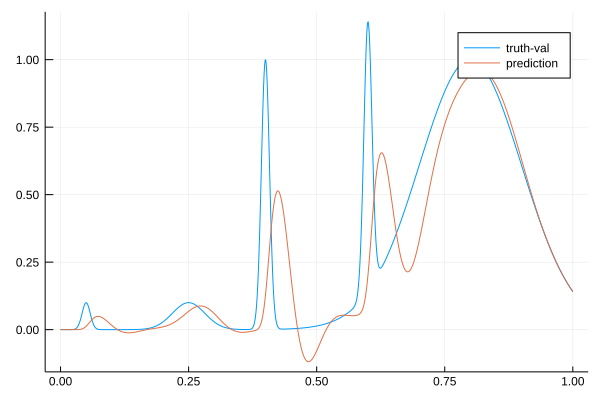

98.61415034157856 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.62525486872746 
  52.3296945666838  
 -11.232349319306671
  63.96041826527056 
 -47.81555302301788 
   0.1              

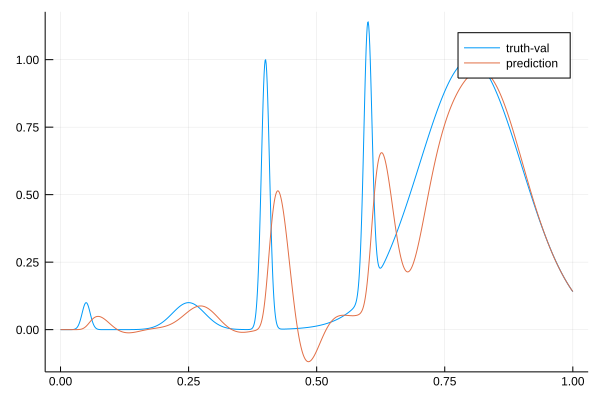

98.5901899068292 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.65021257647225 
  52.360019726567224
 -11.239873398774014
  64.01383147018313 
 -47.867120482724175
   0.1              

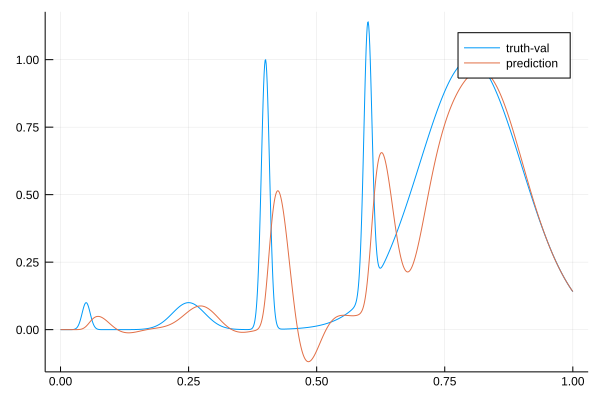

98.56626639973791 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.67579834311968 
  52.390078576149335
 -11.247578150171387
  64.06730421086306 
 -47.918617350708814
   0.1              

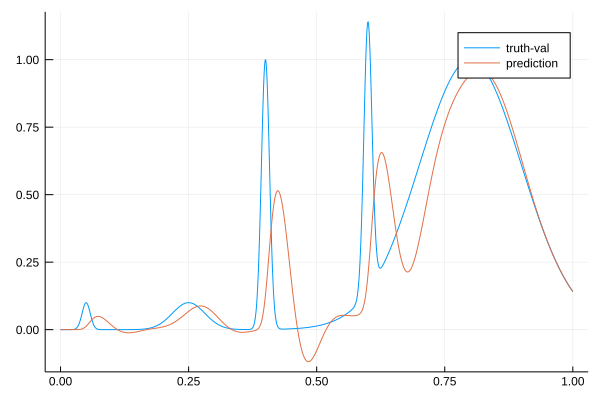

98.54326822795002 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.70139343264733 
  52.42014812886607 
 -11.255399657644547
  64.12077477165371 
 -47.97003419060569 
   0.1              

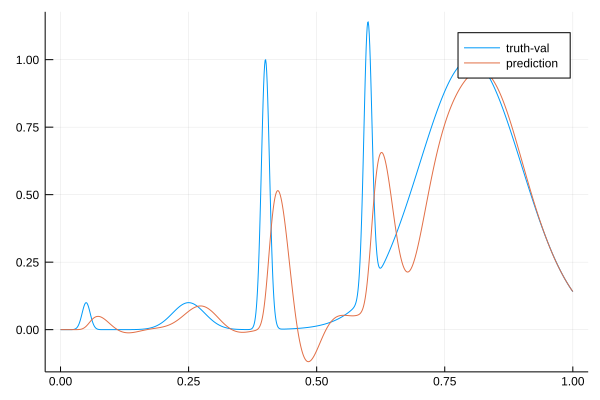

98.52043278201745 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.726754251211794
  52.450054044785205
 -11.263388669355281
  64.17387342102995 
 -48.0215301676824  
   0.1              

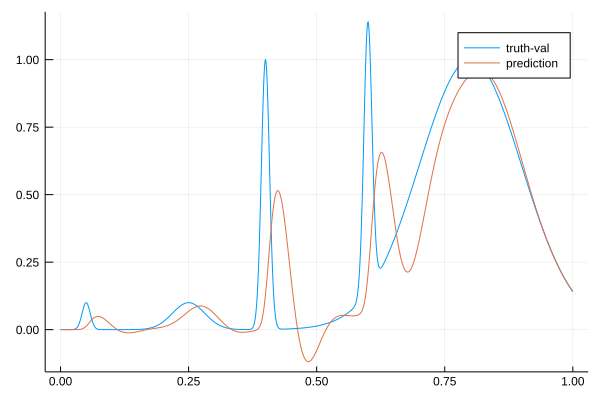

98.49736871974619 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.74976390061996 
  52.48124990751092 
 -11.270518715686546
  64.22700773181471 
 -48.07269708823053 
   0.1              

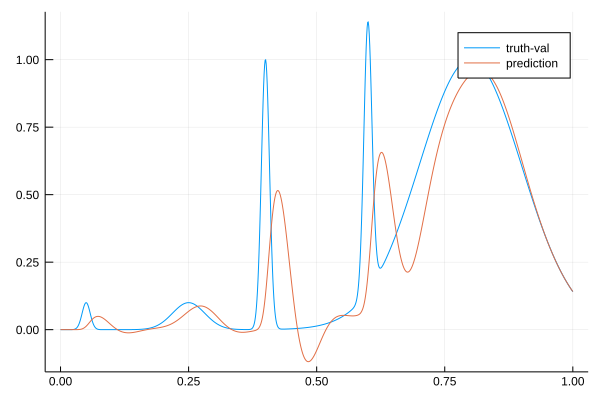

98.47422118355459 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.770667746319496
  52.51361030238864 
 -11.276858320338603
  64.28018360519829 
 -48.123584385991336
   0.1              

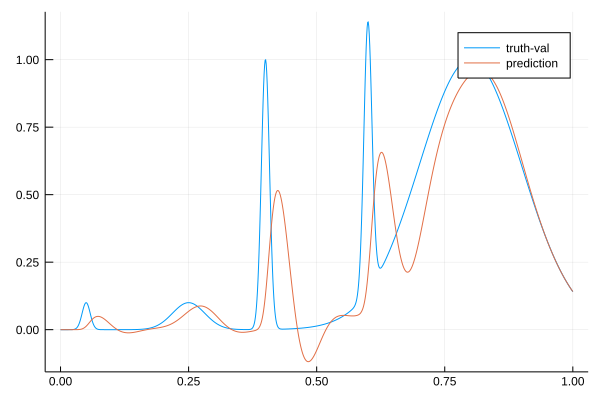

98.45114742281405 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.79183987413575 
  52.545658171545455
 -11.283461388009096
  64.33313077594117 
 -48.174611490772335
   0.1              

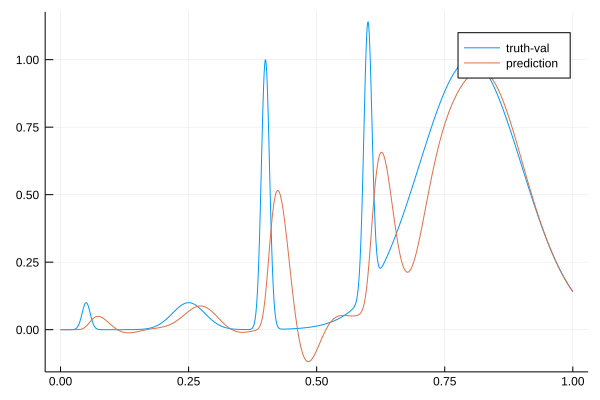

98.42796524217565 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.813796312765504
  52.577108759930574
 -11.290325065629641
  64.38583504537287 
 -48.2259112962128  
   0.1              

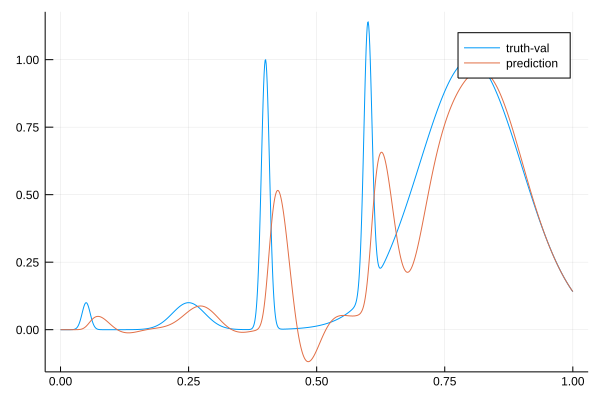

98.40464798749633 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.8364714738487  
  52.60805916825826 
 -11.297406239372151
  64.4383725277345  
 -48.27745183899214 
   0.1              

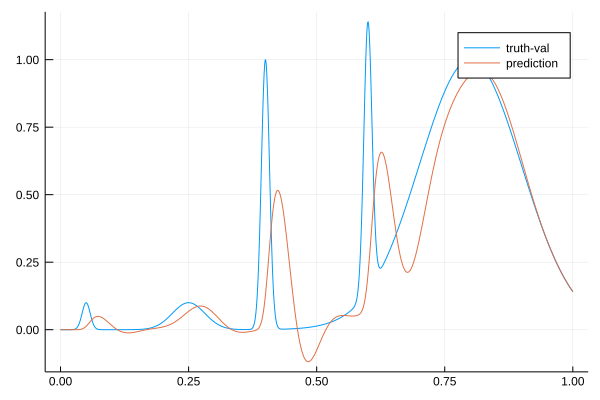

98.3811890598866 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.859806239528844
  52.638597137568986
 -11.304665774860654
  64.4908120448855  
 -48.32920307591535 
   0.1              

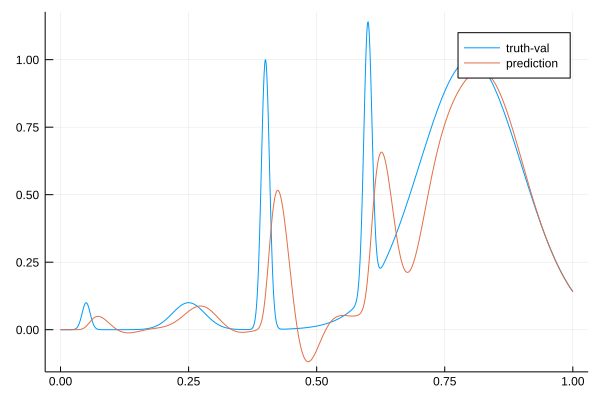

98.35760459637291 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.88374735144025 
  52.66880194506705 
 -11.312068188023662
  64.54321582633031 
 -48.381136888641976
   0.1              

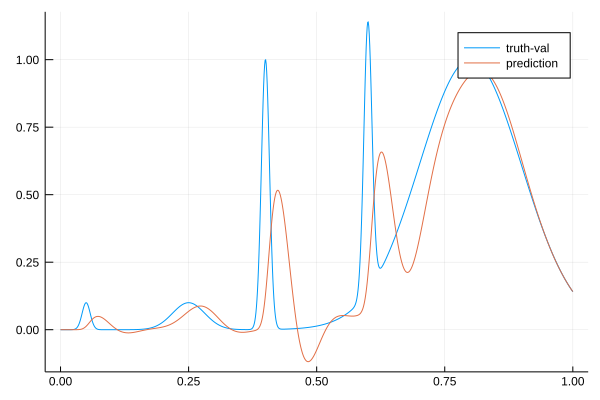

98.33398644845627 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.90794390816613 
  52.69893958611646 
 -11.319564651484136
  64.59568159232235 
 -48.43314923669937 
   0.1              

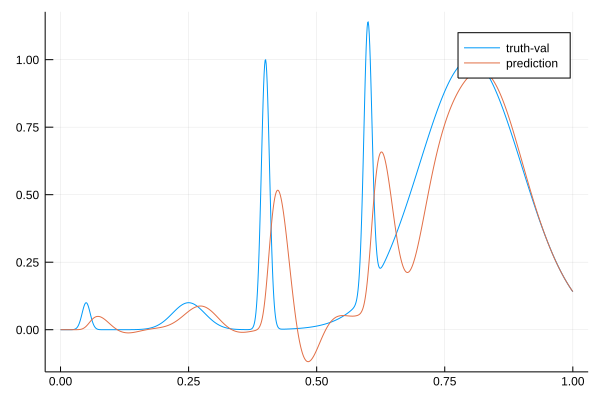

98.31024022719109 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.93246900973402 
  52.72900954237566 
 -11.327138635681091
  64.64825565284352 
 -48.48511867045    
   0.1              

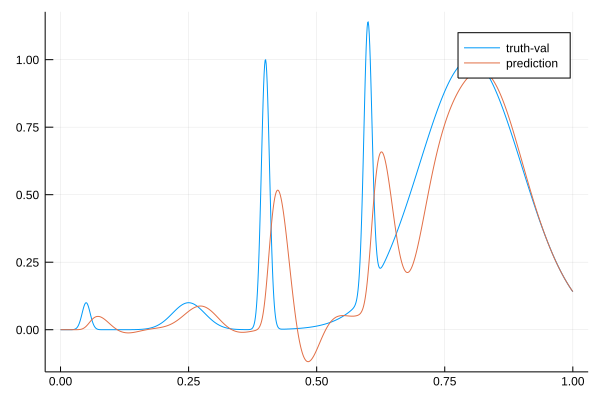

98.28666672896486 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.956771183358086
  52.75941029904627 
 -11.3347232972279  
  64.70106765523978 
 -48.53689243405633 
   0.1              

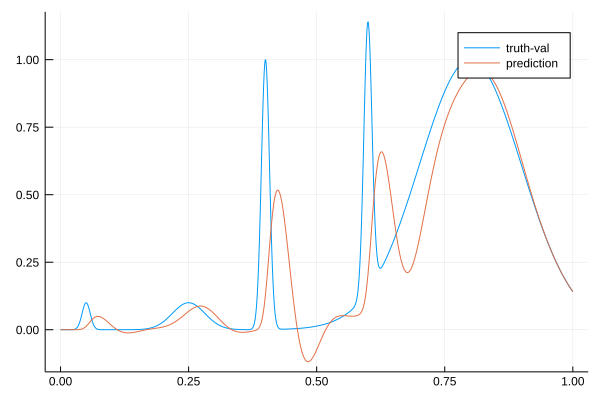

98.26295147835768 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  41.980537697013055
  52.79020496069535 
 -11.342293838745814
  64.7539933239589  
 -48.5885427616148  
   0.1              

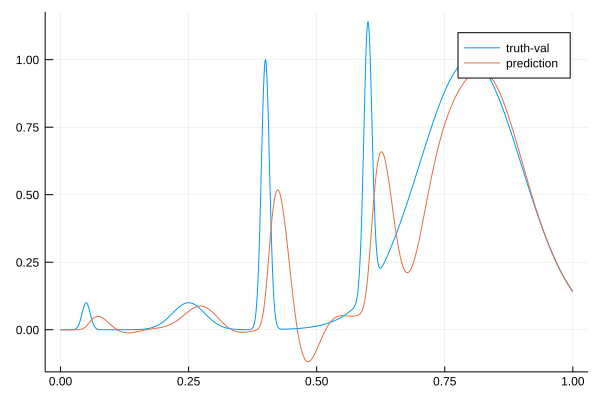

98.23907657673308 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  42.00383416112785 
  52.82139306820347 
 -11.349833974389215
  64.80707419403412 
 -48.64007502690401 
   0.1              

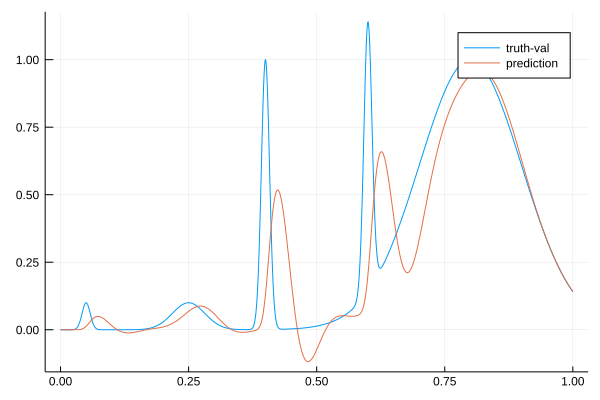

98.21503480210507 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  42.02671991645036 
  52.852974047085944
 -11.357329290195981
  64.86034758002917 
 -48.69149439603455 
   0.1              

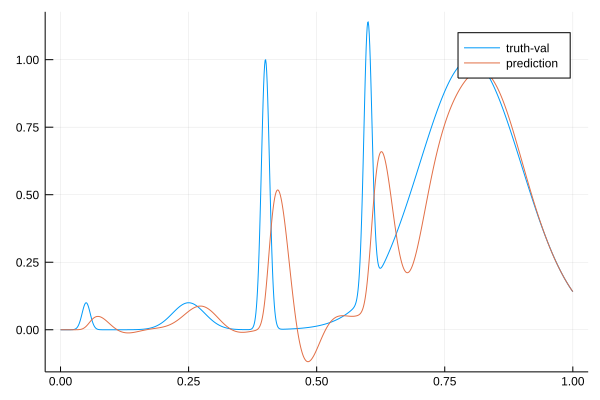

98.19071323014661 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  42.049248656577916
  52.88494724772651 
 -11.364767049705275
  64.9138470287763  
 -48.74280585364929 
   0.1              

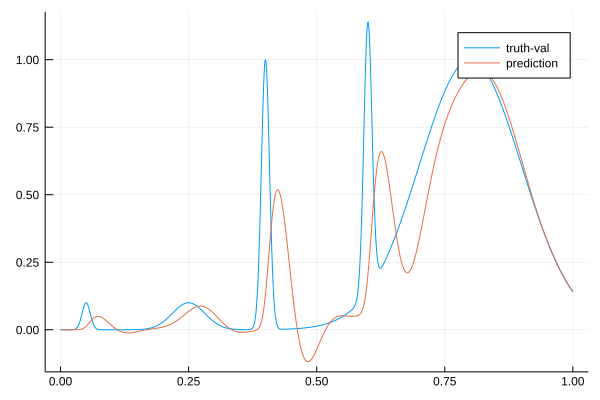

98.16640514089863 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  42.0714691285144  
  52.917311848122736
 -11.372136172018514
  64.96760265484247 
 -48.794014054086304
   0.1              

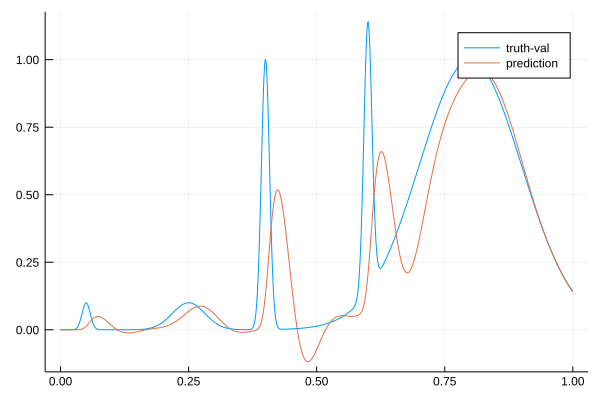

98.14194381795562 (tracked)

Tracked 9-element Array{Float64,1}:
  10.0              
   0.001            
   0.001            
  42.09395753055751 
  52.94971383809605 
 -11.379468736041426
  65.02155418591711 
 -48.84527160734915 
   0.1              

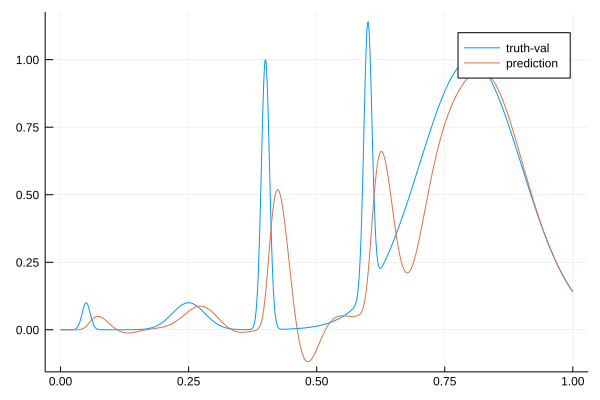

In [175]:
data = Iterators.repeated((), 1000)
opt = ADAM(0.1)
cb = function () #callback function to observe training
    display(loss_rd())
    display(pars)
  # using `remake` to re-create our `prob` with current parameters `p`
    pred = solve(remake(prob,p=Flux.data(pars)),Tsit5(),saveat=t)
    gtruth = map( (ti) -> eval_func(ti,false), t)
    plt = plot(t,gtruth,label="truth-val")
    plot!(plt,t,pred[1,:],label="prediction")
    display(plot(plt))
end

# Display the ODE with the initial parameter values.
cb()

Flux.train!(loss_rd, params, data, opt, cb = cb)